In [5]:
# electroscape@jupyterlab-08

# Define Files, Workbook-name, scenarios to look into, ...
INPUT_FILE = '0_input_parameters_opt_1_1_el_price_dev_D.xlsx'
#INPUT_FILE = '0_input_parameters_opt_1_1_el_price_dev.xlsx'

NAME_IPYNB = "0_0_Main_Optimizer.ipynb"

SCENARIO_LIST = ["Scenario_D_+5"] 

# If hh_no_min=25 and hh_no_max=50 -> model will look at hh 25-50 (next vm: 51-75, ...)
hh_no_min = 1 #Start at least at 1!
hh_no_max = 400

rerun = False   # set to true if kernel has died and same scenario is run -> don't create new folder
no_sol_found = False  # ==True if Gurobi does not find a solution - overwrite boundary with pv_max = 21 & batt_max = 0

dimensioning = False # = True if PV- and batt-size also subject to optimization

path_prefix = "/data"  # ONLY FOR jupyterlab-02: /homevol/..., else: /home/...

In [6]:
xls = pd.ExcelFile(INPUT_FILE)
print(xls.sheet_names)

Available scenarios in Excel:


NameError: name 'df_xls_scenarios_param' is not defined

In [10]:
sc_name = SCENARIO_DIRECTORY.split("Scenario_")[1].split("/")[0]
print(sc_name)  # Output: Proof


NameError: name 'SCENARIO_DIRECTORY' is not defined

In [258]:
scenario_folder = "PV_Size/Results/250615_0851-Scenario_Proof"
full_path = os.path.join("/data", scenario_folder)
print("Full path:", full_path)
print("Exists?", os.path.exists(full_path))

Full path: /data/PV_Size/Results/250615_0851-Scenario_Proof
Exists? False


In [259]:
base_folder = "/data/PV_Size/Results"
print("Available scenarios:")
print(os.listdir(base_folder))

Available scenarios:
[]


In [7]:
import os
print(os.path.exists("/data"))  # True if folder exists

True


In [8]:
# %%
# Import libraries
import numpy as np 
import pandas as pd
import matplotlib.pyplot as plt
import os.path
import time
import datetime
import pytz
import gurobipy as gp
import os
import shutil
import openpyxl
from pytz import reference
from gurobipy import GRB
from datetime import datetime
from datetime import timezone
import pathlib
from pathlib import Path
import csv

In [9]:
# Setup the common output folder
# ==============================
print("Setup the common output folder")

if rerun == False:
    time_now = datetime.now()
    s_time_postfix = str(time_now.year)[2:4] + str(time_now.month).zfill(2) + str(time_now.day).zfill(2) + "_" + str(time_now.hour).zfill(2) + str(time_now.minute).zfill(2)
    scenarios_considered = ""
    for scenario in SCENARIO_LIST:
        if scenario == SCENARIO_LIST[0]:
            scenarios_considered = scenario
        else:
            scenarios_considered += '_' + scenario

    output_path = "Results/"
    OUTPUT_DIRECTORY = output_path + s_time_postfix + "-" + scenarios_considered
    path = os.path.join(OUTPUT_DIRECTORY)
    os.mkdir(path)
    print("New folder created: " + str(OUTPUT_DIRECTORY))

else:
    path = "Results"
    files = os.listdir(path)
    try:
        files.remove("Timestamp.txt")
        files.remove(".ipynb_checkpoints")
    except:
        print(files)    
    paths = [os.path.join(path, path_prefix) for path_prefix in files]
    newest_folder = max(paths, key=os.path.getctime)
    print("Save in existing folder: " + str(newest_folder))

output_log_path = OUTPUT_DIRECTORY + "/output_log_" + scenarios_considered + "_hh_" + str(hh_no_min) + "_" + str(hh_no_max) + ".txt"

Setup the common output folder
New folder created: Results/250723_1121-Scenario_D_+5


In [10]:
GUROBI_SET_1 = 'set_env GUROBI_HOME=' + path_prefix + '/Gurobi/gurobi1001/linux64/'
GUROBI_SET_2 = 'set_env GRB_LICENSE_FILE=' + path_prefix + '/Gurobi/gurobi.lic'
get_ipython().magic(GUROBI_SET_1)
get_ipython().magic(GUROBI_SET_2)
print(os.environ.get('GUROBI_HOME'))
print(os.environ.get('GRB_LICENSE_FILE'))

env: GUROBI_HOME=/data/Gurobi/gurobi1001/linux64/
env: GRB_LICENSE_FILE=/data/Gurobi/gurobi.lic
/data/Gurobi/gurobi1001/linux64/
/data/Gurobi/gurobi.lic


/tmp/ipykernel_2564105/651452421.py:3: DeprecationWarning: `magic(...)` is deprecated since IPython 0.13 (warning added in 8.1), use run_line_magic(magic_name, parameter_s).
  get_ipython().magic(GUROBI_SET_1)
/tmp/ipykernel_2564105/651452421.py:4: DeprecationWarning: `magic(...)` is deprecated since IPython 0.13 (warning added in 8.1), use run_line_magic(magic_name, parameter_s).
  get_ipython().magic(GUROBI_SET_2)


In [228]:
#GUROBI_SET_1 = 'set_env GUROBI_HOME=' + path_prefix + '/Gurobi/gurobi1101/linux64/'
#GUROBI_SET_2 = 'set_env GRB_LICENSE_FILE=' + path_prefix + '/gurob/gurobi.lic'
#get_ipython().magic(GUROBI_SET_1)
#get_ipython().magic(GUROBI_SET_2)
#print(os.environ.get('GUROBI_HOME'))
#print(os.environ.get('GRB_LICENSE_FILE'))

In [11]:
# General constants
# -----------------
MONTHS_PER_YEAR = 12
DAYS_PER_YEAR = 365
DAYS_PER_WEEK = 7
HOURS_PER_DAY = 24
MINUTES_PER_HOUR = 60
SECONDS_PER_MINUTE = 60
HOURS_PER_YEAR = DAYS_PER_YEAR * HOURS_PER_DAY
MINUTES_PER_DAY = HOURS_PER_DAY * MINUTES_PER_HOUR
SECONDS_PER_HOUR = MINUTES_PER_HOUR * SECONDS_PER_MINUTE
SECONDS_PER_DAY = HOURS_PER_DAY * SECONDS_PER_HOUR
QUARTERS_PER_YEAR = 4

MONDAY = 0
TUESDAY = 1
WEDNESDAY = 2
THURSDAY = 3
FRIDAY = 4
SATURDAY = 5
SUNDAY = 6

daytostring_dict = {
  MONDAY: 'Monday',
  TUESDAY: 'Tuesday',
  WEDNESDAY: 'Wednesday',
  THURSDAY: 'Thursday',
  FRIDAY: 'Friday',
  SATURDAY: 'Saturday',
  SUNDAY: 'Sunday',
}

In [12]:
# %%
# Define functions
#######################################################################################################################
def logMessage(message, OUTPUT_DIRECTORY, ):
    print(message)
    f = open(output_log_path, "a+")
    f.write(str(datetime.now().strftime("%a, %d-%b-%Y %I:%M:%S")) + "\n" + str(message) + "\n\n")
    f.close()

#######################################################################################################################
def plotN(yN=[], x=[], title="", xlabel = "", ylabel="", labels=[], filename=""):
    plotxy = len(x) > 0
    fig, ax = plt.subplots()
    for i in range(len(yN)):
        if plotxy:
            ax.plot(x, yN[i], label=labels[i])
        else:
            ax.plot(yN[i], label=labels[i])
    ax.set_ylim(bottom=0)
    plt.title(title)
    plt.xlabel(xlabel)
    plt.ylabel(ylabel)
    if filename != "":
        plt.savefig(filename, bbox_inches='tight', dpi=300)
    plt.show(block=False)
    
#######################################################################################################################
def plot(x, title="", xlabel = "", ylabel="", filename=""):
    fig, ax = plt.subplots()
    ax.plot(x)
    plt.title(title)
    plt.xlabel(xlabel)
    plt.ylabel(ylabel)
    if filename != "":
        plt.savefig(filename, bbox_inches='tight', dpi=300)
    plt.show(block=False)

#######################################################################################################################
def plot2(x1, x2, title="", xlabel = "", ylabel="", labels=["",""], filename=""):
    fig, ax = plt.subplots()
    ax.plot(x1, label=labels[0])
    ax.plot(x2, label=labels[1])
    ax.set_ylim(bottom=0)
    plt.title(title)
    plt.xlabel(xlabel)
    plt.ylabel(ylabel)
    if filename != "":
        plt.savefig(filename, bbox_inches='tight', dpi=300)
    plt.show(block=False)

#######################################################################################################################
def plot3(x1, x2, x3, title="", xlabel = "", ylabel="", labels=["","",""], filename=""):
    fig, ax = plt.subplots()
    ax.plot(x1, label=labels[0])
    ax.plot(x2, label=labels[1])
    ax.plot(x3, label=labels[2])
    ax.set_ylim(bottom=0)
    plt.title(title)
    plt.xlabel(xlabel)
    plt.ylabel(ylabel)
    if filename != "":
        plt.savefig(filename, bbox_inches='tight', dpi=300)
    plt.show(block=False)

In [13]:
#######################################################################################################################
# Determine the optimal solar PV and battery capacity that maximises the 10 year NPV of an electricity customer. By 
# fixing the min and max PV and battery capacities, this function will also determine the optimal dispatch of the 
# battery for the customer's electricity tariff.  
#----------------------------------------------------------------------------------------------------------------------
# Debugging shortcut:
# i_df_timeseries = df_opt_exogenous_timeseries.copy(); i_static_param = PARAM.copy(); i_show_output = True
#######################################################################################################################
def optimisePVB_capacity_dispatch(i_df_timeseries, i_static_param, i_show_output):
    time_start = time.time()

    timestep_seconds = i_static_param['timestep_seconds']
    convert_energy_to_power = int(SECONDS_PER_HOUR / timestep_seconds)
    convert_power_to_energy = 1 / convert_energy_to_power
    M = 999999

    timesteps_per_year = int(HOURS_PER_YEAR * SECONDS_PER_HOUR / timestep_seconds)
    num_timesteps = len(i_df_timeseries)
    num_years = int(num_timesteps/timesteps_per_year)

    # Setup the exogeneous parameters (units are assumed to be in kWh or kW)
    # ----------------------------------------------------------------------
    # Discount factors
    for y in range(num_years):
        if y == 0:
            exo_discount_factor = np.repeat(1, timesteps_per_year)
        else:
            exo_discount_factor = np.append(exo_discount_factor, np.repeat((1+i_static_param['discount_rate'])**-y,timesteps_per_year))
    # Battery
    exo_batt_aging_cal_perstep = (timestep_seconds / SECONDS_PER_HOUR) / (HOURS_PER_YEAR * i_static_param['bess_eol_years'])

    # PV
    v_pv_aging_cal = np.linspace(1, 1-num_years*(1-i_static_param['pv_eol_capacity'])/i_static_param['pv_eol_years'], num_timesteps, False) - (1-i_static_param['pv_init_soh'])
    v_pv_aging_cal[v_pv_aging_cal < 0] = 0 # Ensure that once PV is EOL, it remains disabled
    exo_E_pv_unitgeneration = v_pv_aging_cal * i_df_timeseries['E_pvunitgeneration_kWh'] 

    # Prices
    exo_C_export = i_df_timeseries['C_tariff_export_$/kWh']
    exo_C_import = i_df_timeseries['C_tariff_import_$/kWh']

    # Existing load, exports and curtailed
    v_E_netload_kWh = i_df_timeseries['E_netload_kWh']
    exo_E_existing_load = np.where(v_E_netload_kWh >= 0, v_E_netload_kWh, 0)
    exo_E_existing_grid = np.clip(np.where(v_E_netload_kWh < 0, -v_E_netload_kWh, 0), 0, i_static_param['grid_feedin_max'] * convert_power_to_energy) # np.clip(a, a_min, a_max, out=None, **kwargs)
    exo_E_existing_curtail = np.clip(np.where(v_E_netload_kWh < 0, -v_E_netload_kWh, 0), i_static_param['grid_feedin_max'] * convert_power_to_energy, None) - i_static_param['grid_feedin_max'] * convert_power_to_energy

    # Existing electricity bill timeseries and demand series
    exo_C_existing_usage_bill = exo_E_existing_load * exo_C_import - exo_E_existing_grid * exo_C_export

    # Setup the optimsation model
    # ---------------------------
    model = gp.Model("mip1")
    if i_show_output:
        if model.Params.LogToConsole != 1:
            model.Params.LogToConsole = 1
        if model.Params.OutputFlag != 1:
            model.Params.OutputFlag = 1
        logMessage('[Setting up optimisation parameters]', OUTPUT_DIRECTORY)
    else:
        if model.Params.LogToConsole != 0:
            model.Params.LogToConsole = 0
        if model.Params.OutputFlag != 0:
            model.Params.OutputFlag = 0

    # Declare optimisation variables
    # ------------------------------
    # Setup the PV capacity (kWp) and search range 
    opt_P_pv_nomcapacity = model.addVar(lb = (i_static_param['pv_min_capacity']), vtype=GRB.CONTINUOUS, ub = (i_static_param['pv_max_capacity']), name = 'P_pv_nomcapacity')
    pv_start_capacity = 0
    if i_static_param['pv_min_capacity'] == i_static_param['pv_max_capacity']:
        pv_start_capacity = i_static_param['pv_min_capacity']
    else:
        pv_start_capacity = 0.5*(i_static_param['pv_max_capacity']-i_static_param['pv_min_capacity']) + i_static_param['pv_min_capacity']
    opt_P_pv_nomcapacity.start = pv_start_capacity

    # Setup the battery capacity (kWh) and search range
    opt_E_batt_nomcapacity = model.addVar(lb = (i_static_param['bess_min_capacity']), vtype=GRB.CONTINUOUS, ub = (i_static_param['bess_max_capacity']), name = 'E_batt_nomcapacity')
    batt_start_capacity = 0
    if i_static_param['bess_min_capacity'] == i_static_param['bess_max_capacity']:
        batt_start_capacity = i_static_param['bess_min_capacity']
    else:
        batt_start_capacity = 0.5*(i_static_param['bess_max_capacity']-i_static_param['bess_min_capacity']) + i_static_param['bess_min_capacity']
    opt_E_batt_nomcapacity.start = batt_start_capacity

    if i_show_output:
        logMessage("Starting with PV: {pv}, Battery: {batt}".format(pv = pv_start_capacity, batt = batt_start_capacity), OUTPUT_DIRECTORY)

    # PV energy flows
    opt_E_pv_generation = [model.addVar(lb = 0.0, vtype=GRB.CONTINUOUS, name = 'E_pv_generation_' + str(t)) for t in range(num_timesteps)]
    opt_E_pv_load = [model.addVar(lb = 0.0, vtype=GRB.CONTINUOUS, name = 'E_pv_load_' + str(t)) for t in range(num_timesteps)]  
    opt_E_pv_grid = [model.addVar(lb = 0.0, vtype=GRB.CONTINUOUS, name = 'E_pv_grid_' + str(t)) for t in range(num_timesteps)]  
    opt_E_pv_curtailed = [model.addVar(lb = 0.0, vtype=GRB.CONTINUOUS, name = 'E_pv_curtailed_' + str(t)) for t in range(num_timesteps)]
    opt_E_pv_batt = [model.addVar(lb = 0.0, vtype=GRB.CONTINUOUS, name = 'E_pv_batt_' + str(t)) for t in range(num_timesteps)]

    # Existing energy flows
    opt_E_existing_grid = [model.addVar(lb = 0.0, vtype=GRB.CONTINUOUS, name = 'E_existing_grid_' + str(t)) for t in range(num_timesteps)]  
    opt_E_existing_batt = [model.addVar(lb = 0.0, vtype=GRB.CONTINUOUS, name = 'E_existing_batt_' + str(t)) for t in range(num_timesteps) ]
    opt_E_existing_curtail = [model.addVar(lb = 0.0, vtype=GRB.CONTINUOUS, name = 'E_existing_curtail_' + str(t)) for t in range(num_timesteps)]

    # Grid energy flows 
    opt_E_grid_load = [model.addVar(lb = 0.0, vtype=GRB.CONTINUOUS, name = 'E_grid_load_' + str(t)) for t in range(num_timesteps)]
    opt_E_grid_batt = [model.addVar(lb = 0.0, vtype=GRB.CONTINUOUS, name = 'E_grid_batt_' + str(t)) for t in range(num_timesteps)]
    opt_P_grid_total = [model.addVar(lb = 0.0, vtype=GRB.CONTINUOUS, name = 'P_grid_total_' + str(t)) for t in range(num_timesteps)]  
    opt_B_sell_buy = [model.addVar(vtype=GRB.BINARY, name = 'B_sell_buy_' + str(t)) for t in range(num_timesteps)]

    # Battery energy flows 
    opt_E_batt_load = [model.addVar(lb = 0.0, vtype=GRB.CONTINUOUS, name = 'E_batt_load_' + str(t)) for t in range(num_timesteps)]
    opt_E_batt_grid = [model.addVar(lb = 0.0, vtype=GRB.CONTINUOUS, name = 'E_batt_grid_' + str(t)) for t in range(num_timesteps)]
    opt_E_batt_soc = [model.addVar(lb = 0.0, vtype=GRB.CONTINUOUS, name = 'E_batt_soc_' + str(t)) for t in range(num_timesteps)]
    opt_absP_batt = [model.addVar(vtype=GRB.CONTINUOUS, name = 'absP_batt_' + str(t)) for t in range(num_timesteps)]
    opt_E_batt_soh = [model.addVar(lb = 0.0, vtype=GRB.CONTINUOUS, name = 'E_batt_soh_' + str(t)) for t in range(num_timesteps)]
    opt_batt_aging_cyc = [model.addVar(lb = 0.0, vtype=GRB.CONTINUOUS, name = 'batt_aging_cyc_' + str(t)) for t in range(num_timesteps)]
    opt_B_batt_discharge = [model.addVar(vtype=GRB.BINARY, name = 'B_batt_discharge_' + str(t)) for t in range(num_timesteps)]        
    opt_B_batt_charge = [model.addVar(vtype=GRB.BINARY, name = 'B_batt_charge_' + str(t)) for t in range(num_timesteps)]


    # Setup the timeseries constraints
    # --------------------------------
    for t in range(num_timesteps):

        # Power balances
        model.addConstr(opt_E_pv_generation[t] == exo_E_pv_unitgeneration[t] * opt_P_pv_nomcapacity, '##E_pv_generation_setoutput_' + str(t))
        model.addConstr(opt_E_pv_generation[t] == opt_E_pv_load[t] + opt_E_pv_batt[t] + opt_E_pv_grid[t] + opt_E_pv_curtailed[t], '##E_pv_energy_balance_' + str(t))
        model.addConstr(opt_E_pv_load[t] + opt_E_batt_load[t] + opt_E_grid_load[t] == exo_E_existing_load[t], '##E_load_energy_balance_' + str(t)) 
        model.addConstr(opt_E_pv_load[t] == gp.min_([exo_E_existing_load[t], opt_E_pv_generation[t]]), '##Forced_pv_load_' + str(t))
        model.addConstr(opt_E_existing_batt[t] + opt_E_existing_grid[t] + opt_E_existing_curtail[t] == (exo_E_existing_grid[t] + exo_E_existing_curtail[t]), '##E_existing_energy_balance_' + str(t))

        # Respect the grid export (feed-in) eligibility limit
        model.addConstr(opt_E_pv_grid[t] + opt_E_batt_grid[t] + opt_E_existing_grid[t] <= (i_static_param['grid_feedin_max'] * convert_power_to_energy), '##E_grid_export_limit_' + str(t))

        # Manage the battery's state of charge
        if t == 0: # Start with an empty battery
            model.addConstr(opt_E_batt_soc[t] == 0 + i_static_param['bess_eff_charge'] * (opt_E_pv_batt[t] + opt_E_grid_batt[t] + opt_E_existing_batt[t]) - (opt_E_batt_load[t] + opt_E_batt_grid[t]) / i_static_param['bess_eff_discharge'],'##E_batt_operation_'+str(t))
        else:
            model.addConstr(opt_E_batt_soc[t] == opt_E_batt_soc[t-1] + i_static_param['bess_eff_charge'] * (opt_E_pv_batt[t] + opt_E_grid_batt[t] + opt_E_existing_batt[t]) - (opt_E_batt_load[t] + opt_E_batt_grid[t]) / i_static_param['bess_eff_discharge'],'##E_batt_operation_'+str(t))
            if t == (num_timesteps-1): # End with an empty battery
                model.addConstr(opt_E_batt_soc[t] == 0,'##E_batt_zeroend')

        # Consider battery aging (state of health)
        model.addConstr(opt_absP_batt[t] == opt_B_batt_charge[t] * i_static_param['bess_eff_charge'] * convert_energy_to_power * (opt_E_pv_batt[t] + opt_E_grid_batt[t] + opt_E_existing_batt[t]) + opt_B_batt_discharge[t] * convert_energy_to_power * (opt_E_batt_load[t] + opt_E_batt_grid[t]) / i_static_param['bess_eff_discharge'], "##abs_P_batt_" + str(t))
        if i_static_param['bess_eol_cycles'] > 0:
            model.addConstr(opt_batt_aging_cyc[t] == 0.5 * opt_absP_batt[t] * (timestep_seconds / 3600) / i_static_param['bess_eol_cycles'], "##batt_aging_cyc_" + str(t))
        else:
            model.addConstr(opt_batt_aging_cyc[t] == 0, "##batt_aging_cyc_" + str(t))
        if t == 0:
            model.addConstr(opt_E_batt_soh[t] == opt_E_batt_nomcapacity - (1 - i_static_param['bess_eol_capacity']) * (exo_batt_aging_cal_perstep * (opt_E_batt_nomcapacity) + opt_batt_aging_cyc[t]), "##batt_soh_" + str(t))
        else:
            model.addConstr(opt_E_batt_soh[t] == opt_E_batt_soh[t-1] - (1 - i_static_param['bess_eol_capacity']) * (exo_batt_aging_cal_perstep * (opt_E_batt_nomcapacity) + opt_batt_aging_cyc[t]), "##batt_soh_" + str(t))
        model.addConstr(opt_E_batt_soc[t] <= opt_E_batt_soh[t],'##SOC_max_'+str(t)) 

        # Ensure battery is within charge and discharge constraints, and cannot do both at the same time
        model.addConstr(opt_B_batt_charge[t] + opt_B_batt_discharge[t] <= 1.001 ,'##Mixed_integer_'+str(t))
        model.addConstr(opt_B_batt_charge[t] * (opt_E_batt_nomcapacity / i_static_param['bess_e2p_ratio']) >= (opt_E_pv_batt[t] + opt_E_grid_batt[t] + opt_E_existing_batt[t]) * convert_energy_to_power * i_static_param['bess_eff_charge'],'##Charging_max_A_'+str(t))
        model.addConstr(opt_B_batt_discharge[t] * (opt_E_batt_nomcapacity / i_static_param['bess_e2p_ratio']) >= (opt_E_batt_load[t] + opt_E_batt_grid[t]) * convert_energy_to_power / i_static_param['bess_eff_discharge'], '##Discharging_max_A_'+str(t)) 
        model.addConstr((opt_E_grid_batt[t] + opt_E_pv_batt[t] + opt_E_existing_batt[t]) * convert_energy_to_power * i_static_param['bess_eff_charge'] <= (opt_E_batt_nomcapacity / i_static_param['bess_e2p_ratio']), '##Charging_max_B_'+str(t))
        model.addConstr((opt_E_batt_load[t] + opt_E_batt_grid[t]) * convert_energy_to_power / i_static_param['bess_eff_discharge'] <= (opt_E_batt_nomcapacity / i_static_param['bess_e2p_ratio']), '##Discharging_max_B_'+str(t))

        # Grid interaction restriction (limited to only importing or exporting)
        model.addConstr((opt_E_pv_grid[t] + opt_E_batt_grid[t] + opt_E_existing_grid[t]) <= M * (1 - opt_B_sell_buy[t]) ,'##sell_buy_int_to_export_'+str(t)) 
        model.addConstr((opt_E_grid_load[t] + opt_E_grid_batt[t]) <= M * opt_B_sell_buy[t] ,'##sell_buy_int_to_import_'+str(t))

        # Determine the power drawn from the grid
        model.addConstr(opt_P_grid_total[t] == (opt_E_grid_load[t] + opt_E_grid_batt[t]) * convert_energy_to_power,'##P_grid_total'+str(t))  
        
        B_pv_build = 1
        if i_static_param['pv_min_capacity'] == i_static_param['pv_max_capacity'] == 0:
            B_pv_build = 0
        B_bess_build = 1
        if i_static_param['bess_min_capacity'] == i_static_param['bess_max_capacity'] == 0:
            B_bess_build = 0
            
    # Declare the objective function
    # -------------------------------
    obj_upfront_cost = B_pv_build*i_static_param['pv_fixed_cost']+opt_P_pv_nomcapacity * i_static_param['pv_cost_per_kW'] + B_bess_build*i_static_param['bess_fixed_cost'] + opt_E_batt_nomcapacity * i_static_param['bess_cost_per_kWh']
    obj_volume_savings_discounted = gp.quicksum((exo_C_existing_usage_bill[t] - (opt_E_grid_load[t]+opt_E_grid_batt[t])*exo_C_import[t] + (opt_E_pv_grid[t]+opt_E_batt_grid[t]+opt_E_existing_grid[t])*exo_C_export[t])*exo_discount_factor[t] for t in range(num_timesteps))
    obj_npv = obj_volume_savings_discounted - obj_upfront_cost

    model.setObjective(obj_npv, GRB.MAXIMIZE)
    model.update()

    # Optimise
    # --------
    if i_show_output:
        logMessage('[Run optimiser]', OUTPUT_DIRECTORY)
        logMessage('--------------------------------------------------------', OUTPUT_DIRECTORY)
    model.write("model_built.mps")
    model.optimize()

    time_end = time.time()
    time_str = str(round(time_end - time_start, 2)) + " seconds | " + \
                str(round((time_end - time_start)/SECONDS_PER_MINUTE, 2)) + " minutes | " + \
                str(round((time_end - time_start)/SECONDS_PER_HOUR, 2)) + " hours"

    # Solution is found
    # -----------------
    if model.SolCount > 0:

        model.write("output.sol")        
        slv_P_pv_nomcapacity = model.getVarByName('P_pv_nomcapacity').x + 0 # removing negative zeros
        slv_E_batt_nomcapacity = model.getVarByName('E_batt_nomcapacity').x + 0 # removing negative zeros
        if i_show_output:
            logMessage('--------------------------------------------------------', OUTPUT_DIRECTORY)
            logMessage('[Solution found] {time_str}'.format(time_str = time_str), OUTPUT_DIRECTORY)
            logMessage('Gurobi status: {s}'.format(s = model.getAttr(GRB.attr.Status)), OUTPUT_DIRECTORY)
            logMessage("PV capacity is {pv} kWp".format(pv = slv_P_pv_nomcapacity), OUTPUT_DIRECTORY)
            logMessage("BESS capacity is {batt_E} kWh / {batt_P:.2f} kW".format(batt_E = slv_E_batt_nomcapacity, batt_P = slv_E_batt_nomcapacity / i_static_param['bess_e2p_ratio']), OUTPUT_DIRECTORY)

        # Export the optimal solution
        # ---------------------------
        slv_E_pv_generation = []
        slv_E_pv_load = []
        slv_E_pv_grid = []
        slv_E_pv_curtailed = []
        slv_E_pv_batt = []
        slv_E_existing_grid = []
        slv_E_existing_curtail = []
        slv_E_existing_batt = []
        slv_E_grid_batt = []
        slv_E_batt_load = []
        slv_E_batt_grid = []
        slv_E_grid_load = []
        slv_E_batt_soc = []
        slv_E_batt_soh = []

        for t in range(num_timesteps):
            slv_E_pv_generation.append(model.getVarByName('E_pv_generation_'+str(t)).x)
            slv_E_pv_load.append(model.getVarByName('E_pv_load_'+str(t)).x)
            slv_E_pv_grid.append(model.getVarByName('E_pv_grid_'+str(t)).x)
            slv_E_pv_curtailed.append(model.getVarByName('E_pv_curtailed_'+str(t)).x)
            slv_E_pv_batt.append(model.getVarByName('E_pv_batt_'+str(t)).x)
            slv_E_existing_grid.append(model.getVarByName('E_existing_grid_'+str(t)).x)
            slv_E_existing_curtail.append(model.getVarByName('E_existing_curtail_'+str(t)).x)
            slv_E_existing_batt.append(model.getVarByName('E_existing_batt_'+str(t)).x)
            slv_E_grid_batt.append(model.getVarByName('E_grid_batt_'+str(t)).x)
            slv_E_batt_load.append(model.getVarByName('E_batt_load_'+str(t)).x)
            slv_E_batt_grid.append(model.getVarByName('E_batt_grid_'+str(t)).x)
            slv_E_grid_load.append(model.getVarByName('E_grid_load_'+str(t)).x)
            slv_E_batt_soc.append(model.getVarByName('E_batt_soc_'+str(t)).x)
            slv_E_batt_soh.append(model.getVarByName('E_batt_soh_'+str(t)).x)


        # Determine the residual energy flows (import/export/curtailed)
        v_residual_netload_kWh = (np.array(slv_E_grid_batt) + np.array(slv_E_grid_load) - np.array(slv_E_pv_grid) - np.array(slv_E_batt_grid) - np.array(slv_E_existing_grid))
        v_residual_curtail_kWh = (np.array(slv_E_pv_curtailed) + np.array(slv_E_existing_curtail))

        df_simulate = pd.DataFrame({'timestamp': i_df_timeseries['t'],
                                    'i_tf_retail': exo_C_import,
                                    'i_tf_export': exo_C_export,
                                    'i_E_hh_netload': v_E_netload_kWh,
                                    'discount_factor': exo_discount_factor,
                                    'E_pv_generation': slv_E_pv_generation,
                                    'E_pv_load': slv_E_pv_load,
                                    'E_pv_grid': slv_E_pv_grid,
                                    'E_pv_curtailed': slv_E_pv_curtailed,
                                    'P_pv_cap_soh': v_pv_aging_cal * slv_P_pv_nomcapacity,
                                    'E_pv_batt': slv_E_pv_batt,
                                    'E_existing_grid': slv_E_existing_grid,
                                    'E_existing_curtailed': slv_E_existing_curtail,
                                    'E_existing_batt': slv_E_existing_batt,
                                    'E_grid_batt': slv_E_grid_batt,
                                    'E_batt_load': slv_E_batt_load,
                                    'E_batt_grid': slv_E_batt_grid,
                                    'E_batt_soc': slv_E_batt_soc,
                                    'E_batt_soh': slv_E_batt_soh,                                
                                    'E_grid_load': slv_E_grid_load,
                                    'E_residual_netload': v_residual_netload_kWh,
                                    'E_residual_curtail': v_residual_curtail_kWh,
                                    })

        # Determine the NPV
        slv_volume_savings_discounted = sum(exo_discount_factor * (exo_C_existing_usage_bill - (np.array(slv_E_grid_load)+np.array(slv_E_grid_batt))*exo_C_import + (np.array(slv_E_pv_grid)+np.array(slv_E_batt_grid)+np.array(slv_E_existing_grid))*exo_C_export))
        B_pv_build = 0
        if slv_P_pv_nomcapacity > 0:
            B_pv_build = 1
        slv_upfront_cost = B_pv_build*i_static_param['pv_fixed_cost']+slv_P_pv_nomcapacity * i_static_param['pv_cost_per_kW'] + slv_E_batt_nomcapacity * i_static_param['bess_cost_per_kWh']
        slv_npv = slv_volume_savings_discounted - slv_upfront_cost

        c_oldbill_discounted = sum(exo_discount_factor * exo_C_existing_usage_bill)
        c_newbill_discounted = sum(exo_discount_factor * ((np.array(slv_E_grid_load)+np.array(slv_E_grid_batt))*exo_C_import - (np.array(slv_E_pv_grid)+np.array(slv_E_batt_grid)+np.array(slv_E_existing_grid))*exo_C_export))

        if i_show_output:
            logMessage("NPV: ${npv:,.2f}".format(npv = slv_npv), OUTPUT_DIRECTORY)
            logMessage("Baseline bill: ${oldbill:,.2f} (discounted {Y} yrs at {d}%)".format(Y = i_static_param['financial_horizon'], oldbill = c_oldbill_discounted, d = i_static_param['discount_rate']*100), OUTPUT_DIRECTORY)
            logMessage("Optimised bill: ${newbill:,.2f} (discounted {Y} yrs at {d}%)".format(Y = i_static_param['financial_horizon'], newbill = c_newbill_discounted, d = i_static_param['discount_rate']*100), OUTPUT_DIRECTORY)
            logMessage("Upfront cost: ${upfront:,.2f}".format(upfront = slv_upfront_cost), OUTPUT_DIRECTORY)

        outputs = {}
        outputs['P_pv_nomcapacity_kWp'] = slv_P_pv_nomcapacity
        outputs['E_batt_nomcapacity_kWh'] = slv_E_batt_nomcapacity
        outputs['NPV'] = slv_npv
        outputs['Baseline_bill'] = c_oldbill_discounted
        outputs['Optimised_bill'] = c_newbill_discounted
        outputs['Upfront_cost'] = slv_upfront_cost

    # No solution is found
    # --------------------
    else:
        df_simulate = pd.DataFrame()
        outputs = {}
        outputs['P_pv_nomcapacity_kWp'] = -1
        outputs['E_batt_nomcapacity_kWh'] = -1
        outputs['NPV'] = np.nan
        if i_show_output:
            logMessage('--------------------------------------------------------', OUTPUT_DIRECTORY)
            logMessage('[No solution found] {time_str}'.format(time_str = time_str), OUTPUT_DIRECTORY)

    return [df_simulate, outputs]

In [14]:
# Load the input data
print("Load the input data")
# -------------------
df_xls_scenarios_param = pd.read_excel(INPUT_FILE, sheet_name='Scenarios', engine='openpyxl', index_col=0)
df_xls_static_param = pd.read_excel(INPUT_FILE, sheet_name='Static', engine='openpyxl', index_col=0)
df_xls_datetime_ts = pd.read_excel(INPUT_FILE, sheet_name='DateTime', engine='openpyxl',index_col = 0)
df_xls_meter_ts = pd.read_excel(INPUT_FILE, sheet_name='Meter_TS', engine='openpyxl',index_col = 0)
df_xls_solar_ts = pd.read_excel(INPUT_FILE, sheet_name='Solar_TS', engine='openpyxl',index_col = 0)
df_xls_tariff_daily = pd.read_excel(INPUT_FILE, sheet_name='Tariff_daily', engine='openpyxl',index_col = 0)
print("Done")

Load the input data
Done


In [129]:
import os 
os.system("export GRB_LICENSE_FILE='/home/ubuntu/gurob/gurobi.lic'")

0

Setup the common static parameters of the analysis
Save away all the exogenous parameters used: dataframes
Save the code used in the project run
Setup output_log.txt
Process scenario
Create the output directory for this scenario


/tmp/ipykernel_2564105/2604713397.py:128: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_scalingfactors.loc[i]['Tariff_Import'] = (1+scaling_factor_tariff)**(i-BASELINE_YEAR)
/tmp/ipykernel_2564105/2604713397.py:129: FutureWarning: Chained

Start optimization - household: 1/100 of Scenario_D_+5 - profile: pc3032_nmi1556854887 (250723_1121)
Scenario parameters

{'financial_horizon': 10, 'discount_rate': np.float64(0.06), 'grid_feedin_max': np.float64(5.0), 'pv_eol_capacity': np.float64(0.8), 'pv_eol_years': np.float64(25.0), 'pv_init_soh': np.float64(1.0), 'bess_e2p_ratio': np.float64(2.4), 'bess_roundtrip_eff': np.float64(0.88), 'bess_eol_years': np.float64(10.0), 'bess_eol_capacity': np.float64(0.7), 'bess_eol_cycles': np.float64(10000.0), 'bess_init_soh': np.float64(1.0), 'bess_eff_charge': np.float64(0.938083151964686), 'bess_eff_discharge': np.float64(0.938083151964686), 'scenario_name': 'Scenario_D_+5', 'scenario_set': 'SurfCoast', 'scenario_subset': 'JJP_open', 'year_start': 2022, 'datetime_name': 'DateTime1', 'meter_name': 'pc3032_nmi1556854887', 'solar_name': 'MELB', 'tariff_name_import_wkday': '3_Im_wkday', 'tariff_name_export_wkday': '3_Ex_wkday', 'tariff_name_import_wkend': '3_Im_wkend', 'tariff_name_export_wke

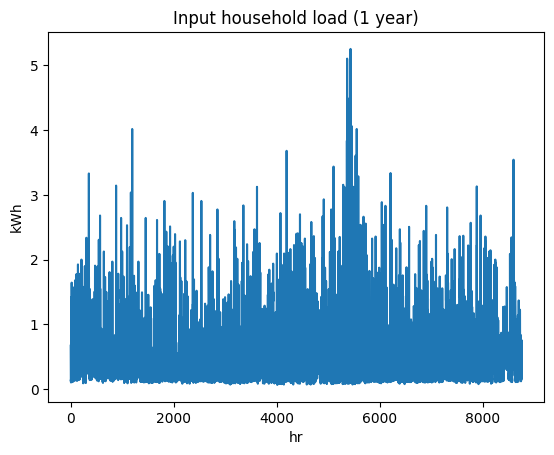

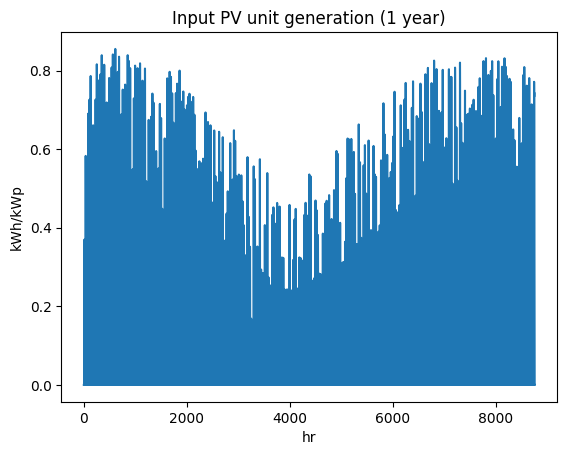

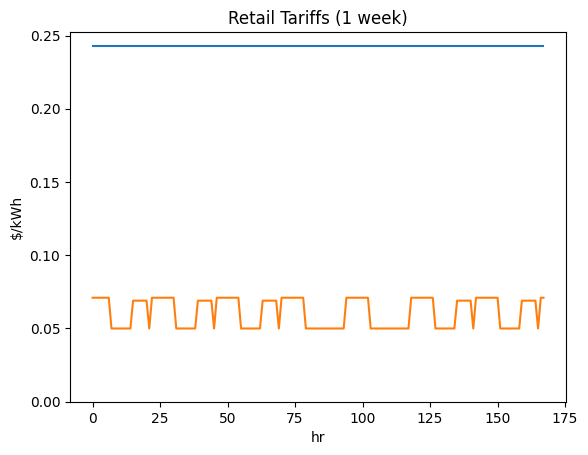

---- Optimising with PV: 1 - 20 kWp, Batt: 0 kWh. Determining PV capacity and dispatch.


************************************ Modell: PV > 1 kWp & BATT > 1 kWh ************************************
{'financial_horizon': 10, 'discount_rate': np.float64(0.06), 'grid_feedin_max': np.float64(5.0), 'pv_eol_capacity': np.float64(0.8), 'pv_eol_years': np.float64(25.0), 'pv_init_soh': np.float64(1.0), 'bess_e2p_ratio': np.float64(2.4), 'bess_roundtrip_eff': np.float64(0.88), 'bess_eol_years': np.float64(10.0), 'bess_eol_capacity': np.float64(0.7), 'bess_eol_cycles': np.float64(10000.0), 'bess_init_soh': np.float64(1.0), 'bess_eff_charge': np.float64(0.938083151964686), 'bess_eff_discharge': np.float64(0.938083151964686), 'scenario_name': 'Scenario_D_+5', 'scenario_set': 'SurfCoast', 'scenario_subset': 'JJP_open', 'year_start': 2022, 'datetime_name': 'DateTime1', 'meter_name': 'pc3032_nmi1556854887', 'solar_name': 'MELB', 'tariff_name_import_wkday': '3_Im_wkday', 'tariff_name_export_wkday': '3_

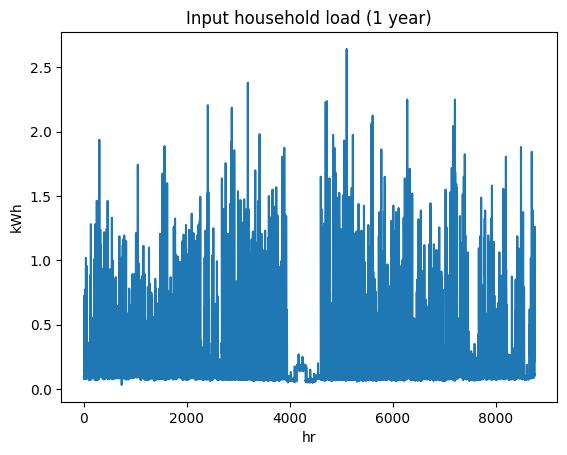

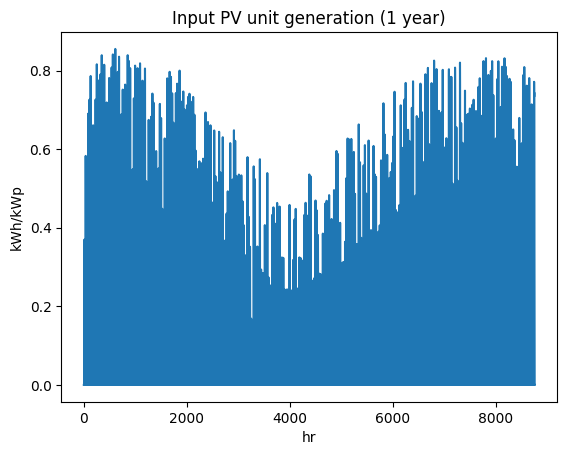

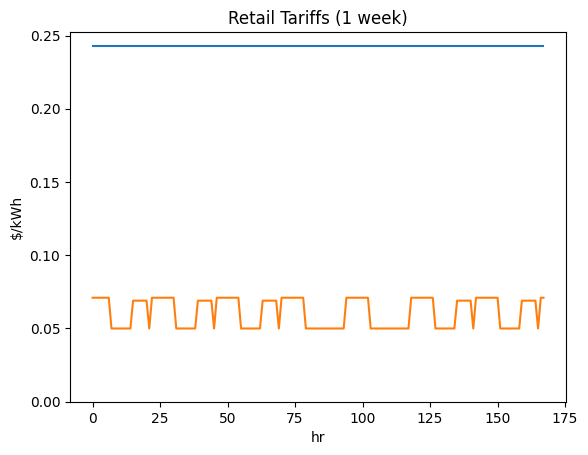

---- Optimising with PV: 1 - 20 kWp, Batt: 0 kWh. Determining PV capacity and dispatch.


************************************ Modell: PV > 1 kWp & BATT > 1 kWh ************************************
{'financial_horizon': 10, 'discount_rate': np.float64(0.06), 'grid_feedin_max': np.float64(5.0), 'pv_eol_capacity': np.float64(0.8), 'pv_eol_years': np.float64(25.0), 'pv_init_soh': np.float64(1.0), 'bess_e2p_ratio': np.float64(2.4), 'bess_roundtrip_eff': np.float64(0.88), 'bess_eol_years': np.float64(10.0), 'bess_eol_capacity': np.float64(0.7), 'bess_eol_cycles': np.float64(10000.0), 'bess_init_soh': np.float64(1.0), 'bess_eff_charge': np.float64(0.938083151964686), 'bess_eff_discharge': np.float64(0.938083151964686), 'scenario_name': 'Scenario_D_+5', 'scenario_set': 'SurfCoast', 'scenario_subset': 'JJP_open', 'year_start': 2022, 'datetime_name': 'DateTime1', 'meter_name': 'pc3016_nmi1544956794', 'solar_name': 'MELB', 'tariff_name_import_wkday': '3_Im_wkday', 'tariff_name_export_wkday': '3_

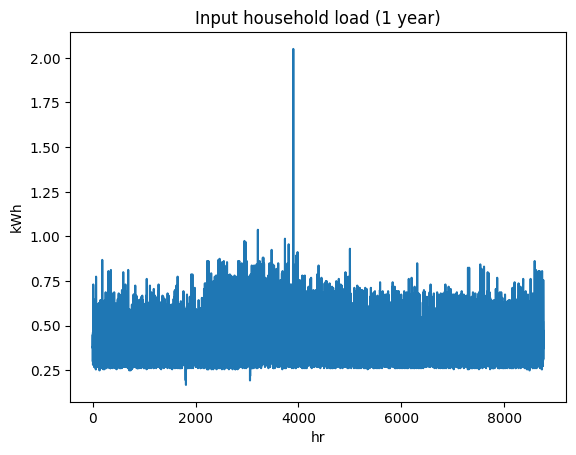

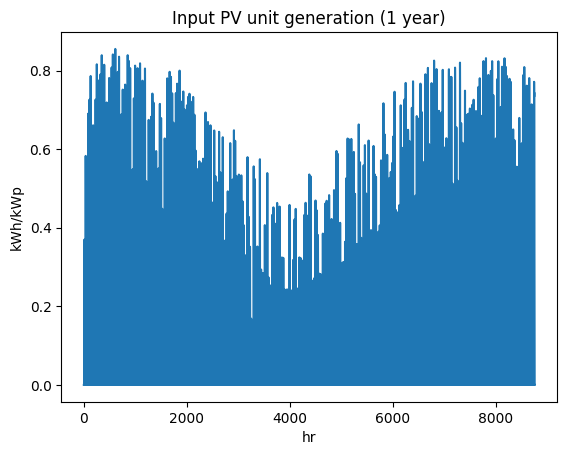

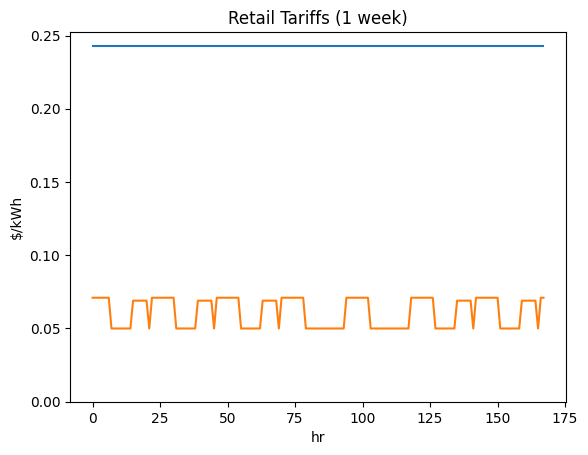

---- Optimising with PV: 1 - 20 kWp, Batt: 0 kWh. Determining PV capacity and dispatch.


************************************ Modell: PV > 1 kWp & BATT > 1 kWh ************************************
{'financial_horizon': 10, 'discount_rate': np.float64(0.06), 'grid_feedin_max': np.float64(5.0), 'pv_eol_capacity': np.float64(0.8), 'pv_eol_years': np.float64(25.0), 'pv_init_soh': np.float64(1.0), 'bess_e2p_ratio': np.float64(2.4), 'bess_roundtrip_eff': np.float64(0.88), 'bess_eol_years': np.float64(10.0), 'bess_eol_capacity': np.float64(0.7), 'bess_eol_cycles': np.float64(10000.0), 'bess_init_soh': np.float64(1.0), 'bess_eff_charge': np.float64(0.938083151964686), 'bess_eff_discharge': np.float64(0.938083151964686), 'scenario_name': 'Scenario_D_+5', 'scenario_set': 'SurfCoast', 'scenario_subset': 'JJP_open', 'year_start': 2022, 'datetime_name': 'DateTime1', 'meter_name': 'pc3039_nmi4677620677', 'solar_name': 'MELB', 'tariff_name_import_wkday': '3_Im_wkday', 'tariff_name_export_wkday': '3_

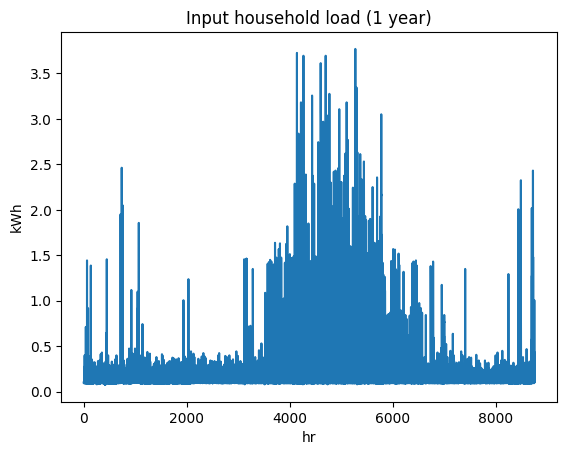

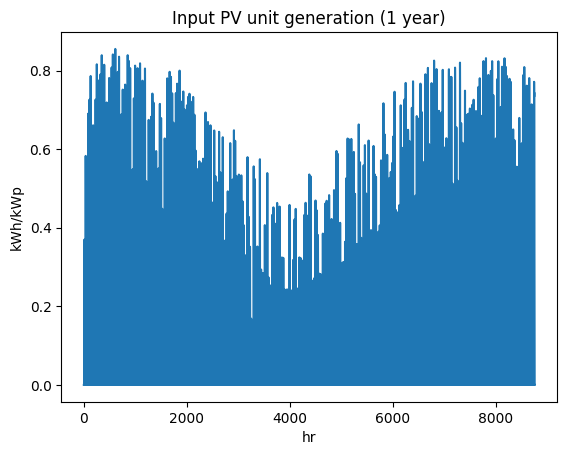

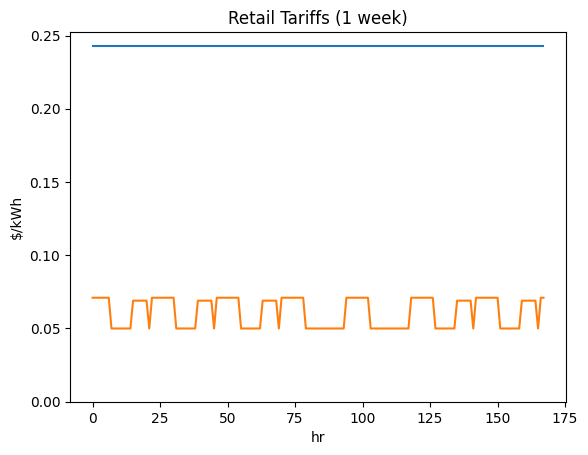

---- Optimising with PV: 1 - 20 kWp, Batt: 0 kWh. Determining PV capacity and dispatch.


************************************ Modell: PV > 1 kWp & BATT > 1 kWh ************************************
{'financial_horizon': 10, 'discount_rate': np.float64(0.06), 'grid_feedin_max': np.float64(5.0), 'pv_eol_capacity': np.float64(0.8), 'pv_eol_years': np.float64(25.0), 'pv_init_soh': np.float64(1.0), 'bess_e2p_ratio': np.float64(2.4), 'bess_roundtrip_eff': np.float64(0.88), 'bess_eol_years': np.float64(10.0), 'bess_eol_capacity': np.float64(0.7), 'bess_eol_cycles': np.float64(10000.0), 'bess_init_soh': np.float64(1.0), 'bess_eff_charge': np.float64(0.938083151964686), 'bess_eff_discharge': np.float64(0.938083151964686), 'scenario_name': 'Scenario_D_+5', 'scenario_set': 'SurfCoast', 'scenario_subset': 'JJP_open', 'year_start': 2022, 'datetime_name': 'DateTime1', 'meter_name': 'pc3032_nmi8006940484', 'solar_name': 'MELB', 'tariff_name_import_wkday': '3_Im_wkday', 'tariff_name_export_wkday': '3_

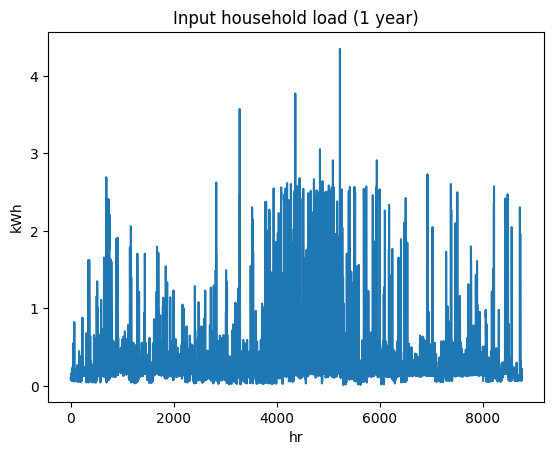

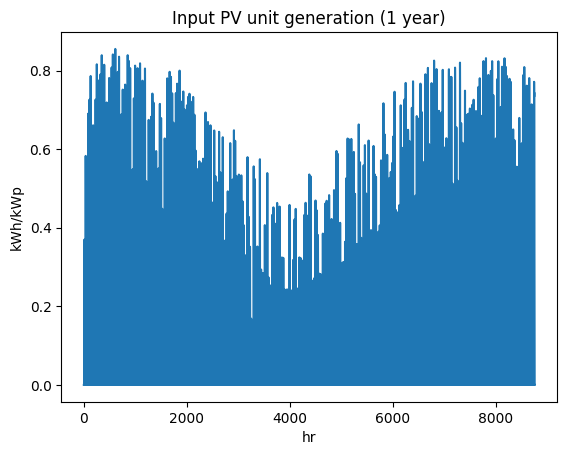

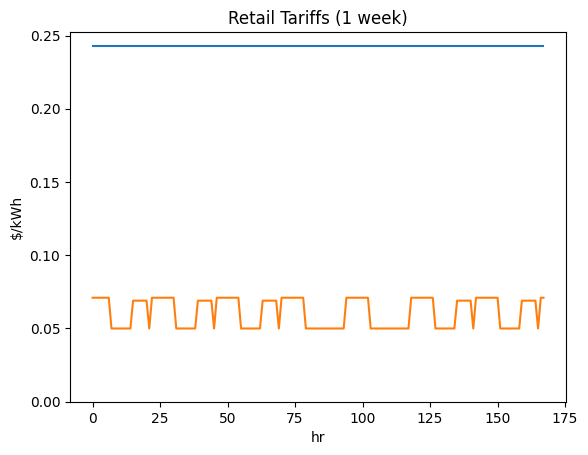

---- Optimising with PV: 1 - 20 kWp, Batt: 0 kWh. Determining PV capacity and dispatch.


************************************ Modell: PV > 1 kWp & BATT > 1 kWh ************************************
{'financial_horizon': 10, 'discount_rate': np.float64(0.06), 'grid_feedin_max': np.float64(5.0), 'pv_eol_capacity': np.float64(0.8), 'pv_eol_years': np.float64(25.0), 'pv_init_soh': np.float64(1.0), 'bess_e2p_ratio': np.float64(2.4), 'bess_roundtrip_eff': np.float64(0.88), 'bess_eol_years': np.float64(10.0), 'bess_eol_capacity': np.float64(0.7), 'bess_eol_cycles': np.float64(10000.0), 'bess_init_soh': np.float64(1.0), 'bess_eff_charge': np.float64(0.938083151964686), 'bess_eff_discharge': np.float64(0.938083151964686), 'scenario_name': 'Scenario_D_+5', 'scenario_set': 'SurfCoast', 'scenario_subset': 'JJP_open', 'year_start': 2022, 'datetime_name': 'DateTime1', 'meter_name': 'pc3072_nmi5940091774', 'solar_name': 'MELB', 'tariff_name_import_wkday': '3_Im_wkday', 'tariff_name_export_wkday': '3_

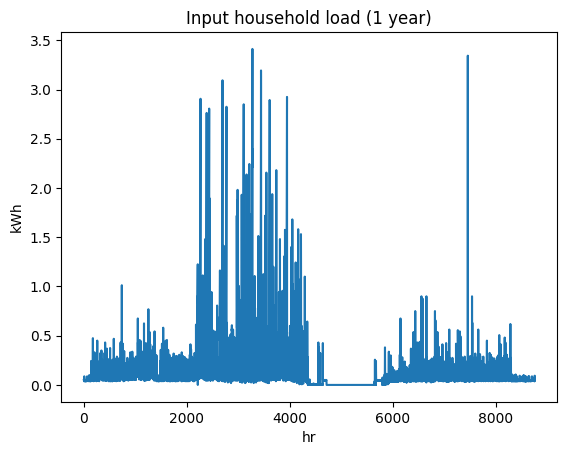

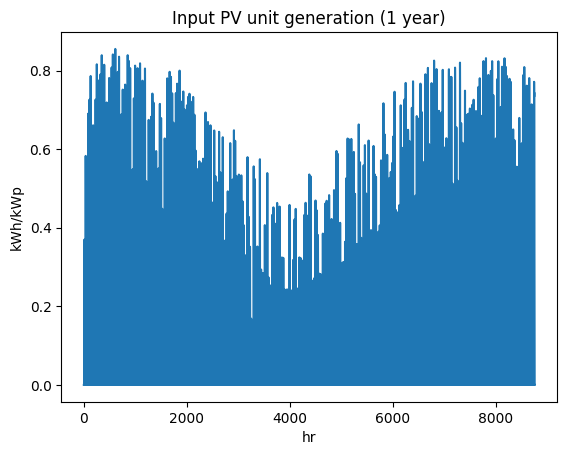

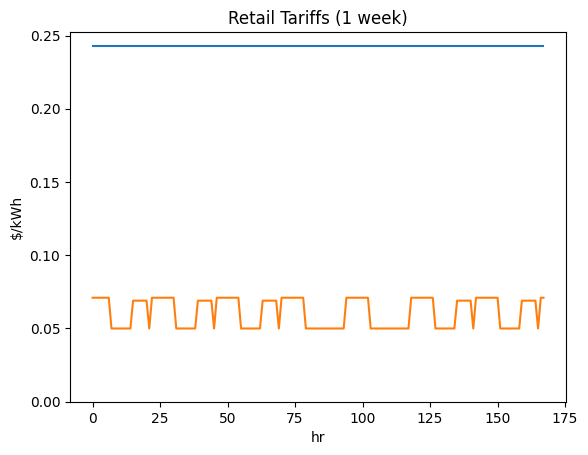

---- Optimising with PV: 1 - 20 kWp, Batt: 0 kWh. Determining PV capacity and dispatch.


************************************ Modell: PV > 1 kWp & BATT > 1 kWh ************************************
{'financial_horizon': 10, 'discount_rate': np.float64(0.06), 'grid_feedin_max': np.float64(5.0), 'pv_eol_capacity': np.float64(0.8), 'pv_eol_years': np.float64(25.0), 'pv_init_soh': np.float64(1.0), 'bess_e2p_ratio': np.float64(2.4), 'bess_roundtrip_eff': np.float64(0.88), 'bess_eol_years': np.float64(10.0), 'bess_eol_capacity': np.float64(0.7), 'bess_eol_cycles': np.float64(10000.0), 'bess_init_soh': np.float64(1.0), 'bess_eff_charge': np.float64(0.938083151964686), 'bess_eff_discharge': np.float64(0.938083151964686), 'scenario_name': 'Scenario_D_+5', 'scenario_set': 'SurfCoast', 'scenario_subset': 'JJP_open', 'year_start': 2022, 'datetime_name': 'DateTime1', 'meter_name': 'pc3072_nmi8788523814', 'solar_name': 'MELB', 'tariff_name_import_wkday': '3_Im_wkday', 'tariff_name_export_wkday': '3_

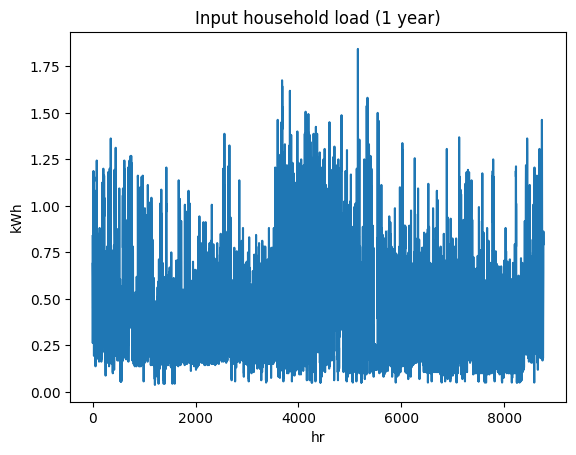

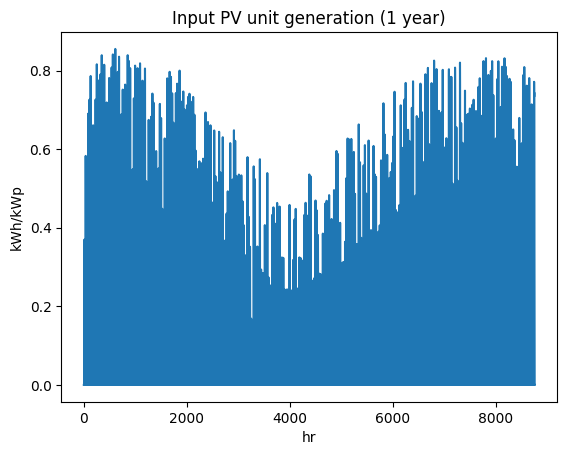

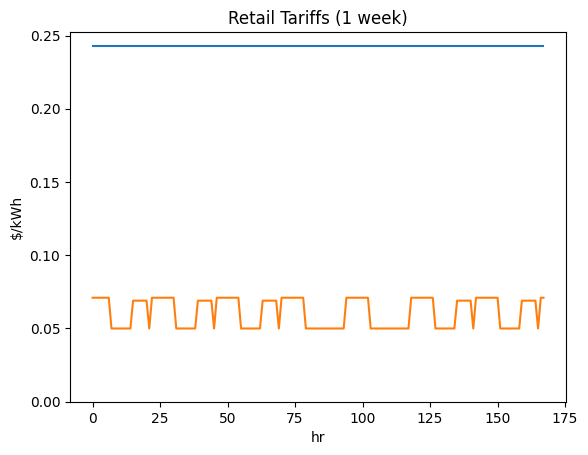

---- Optimising with PV: 1 - 20 kWp, Batt: 0 kWh. Determining PV capacity and dispatch.


************************************ Modell: PV > 1 kWp & BATT > 1 kWh ************************************
{'financial_horizon': 10, 'discount_rate': np.float64(0.06), 'grid_feedin_max': np.float64(5.0), 'pv_eol_capacity': np.float64(0.8), 'pv_eol_years': np.float64(25.0), 'pv_init_soh': np.float64(1.0), 'bess_e2p_ratio': np.float64(2.4), 'bess_roundtrip_eff': np.float64(0.88), 'bess_eol_years': np.float64(10.0), 'bess_eol_capacity': np.float64(0.7), 'bess_eol_cycles': np.float64(10000.0), 'bess_init_soh': np.float64(1.0), 'bess_eff_charge': np.float64(0.938083151964686), 'bess_eff_discharge': np.float64(0.938083151964686), 'scenario_name': 'Scenario_D_+5', 'scenario_set': 'SurfCoast', 'scenario_subset': 'JJP_open', 'year_start': 2022, 'datetime_name': 'DateTime1', 'meter_name': 'pc3039_nmi2204841506', 'solar_name': 'MELB', 'tariff_name_import_wkday': '3_Im_wkday', 'tariff_name_export_wkday': '3_

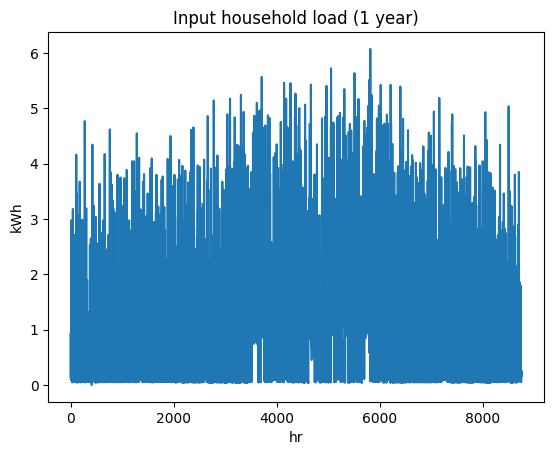

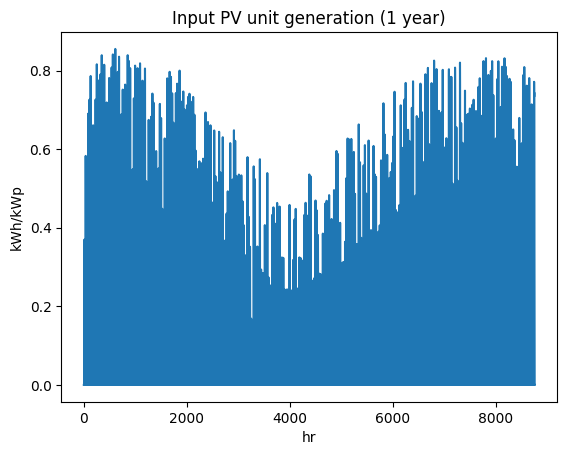

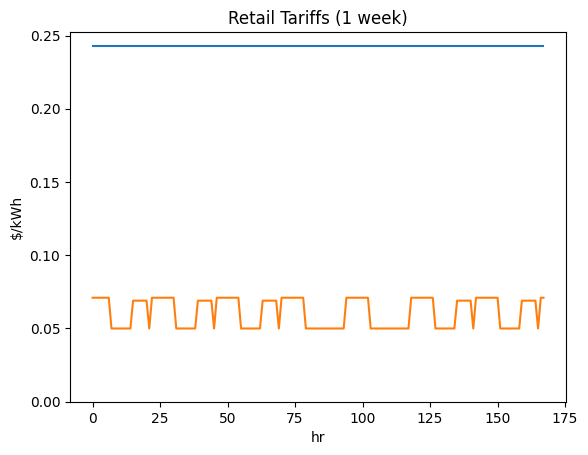

---- Optimising with PV: 1 - 20 kWp, Batt: 0 kWh. Determining PV capacity and dispatch.


************************************ Modell: PV > 1 kWp & BATT > 1 kWh ************************************
{'financial_horizon': 10, 'discount_rate': np.float64(0.06), 'grid_feedin_max': np.float64(5.0), 'pv_eol_capacity': np.float64(0.8), 'pv_eol_years': np.float64(25.0), 'pv_init_soh': np.float64(1.0), 'bess_e2p_ratio': np.float64(2.4), 'bess_roundtrip_eff': np.float64(0.88), 'bess_eol_years': np.float64(10.0), 'bess_eol_capacity': np.float64(0.7), 'bess_eol_cycles': np.float64(10000.0), 'bess_init_soh': np.float64(1.0), 'bess_eff_charge': np.float64(0.938083151964686), 'bess_eff_discharge': np.float64(0.938083151964686), 'scenario_name': 'Scenario_D_+5', 'scenario_set': 'SurfCoast', 'scenario_subset': 'JJP_open', 'year_start': 2022, 'datetime_name': 'DateTime1', 'meter_name': 'pc3013_nmi6603247038', 'solar_name': 'MELB', 'tariff_name_import_wkday': '3_Im_wkday', 'tariff_name_export_wkday': '3_

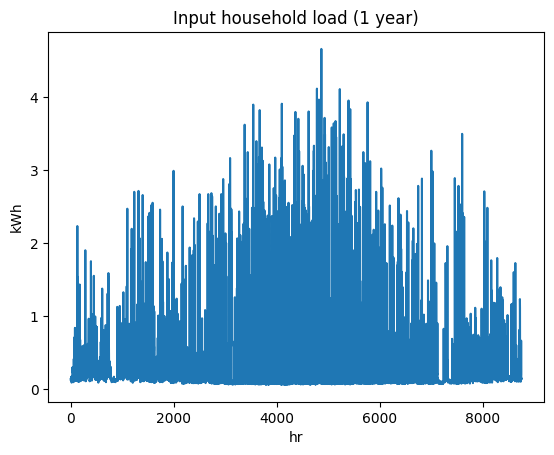

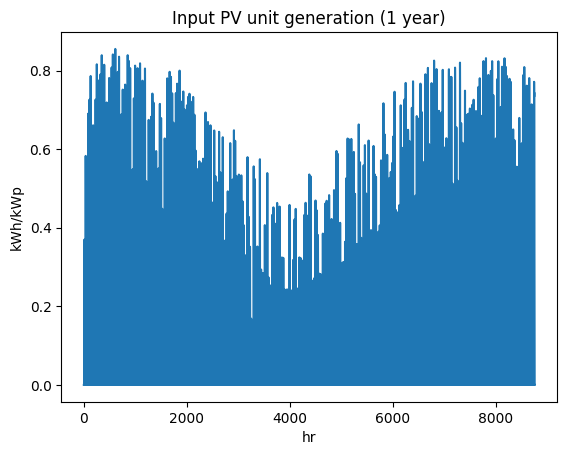

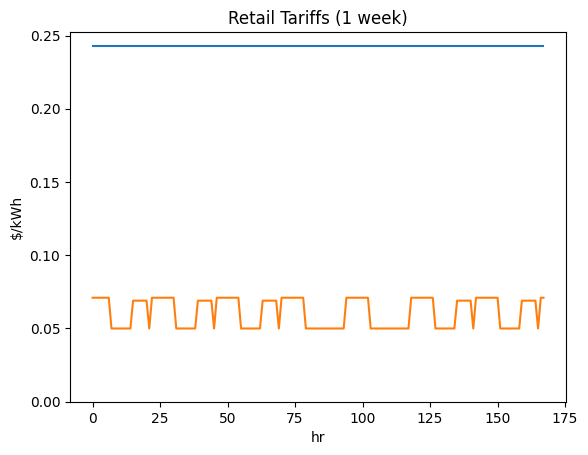

---- Optimising with PV: 1 - 20 kWp, Batt: 0 kWh. Determining PV capacity and dispatch.


************************************ Modell: PV > 1 kWp & BATT > 1 kWh ************************************
{'financial_horizon': 10, 'discount_rate': np.float64(0.06), 'grid_feedin_max': np.float64(5.0), 'pv_eol_capacity': np.float64(0.8), 'pv_eol_years': np.float64(25.0), 'pv_init_soh': np.float64(1.0), 'bess_e2p_ratio': np.float64(2.4), 'bess_roundtrip_eff': np.float64(0.88), 'bess_eol_years': np.float64(10.0), 'bess_eol_capacity': np.float64(0.7), 'bess_eol_cycles': np.float64(10000.0), 'bess_init_soh': np.float64(1.0), 'bess_eff_charge': np.float64(0.938083151964686), 'bess_eff_discharge': np.float64(0.938083151964686), 'scenario_name': 'Scenario_D_+5', 'scenario_set': 'SurfCoast', 'scenario_subset': 'JJP_open', 'year_start': 2022, 'datetime_name': 'DateTime1', 'meter_name': 'pc3032_nmi2362946596', 'solar_name': 'MELB', 'tariff_name_import_wkday': '3_Im_wkday', 'tariff_name_export_wkday': '3_

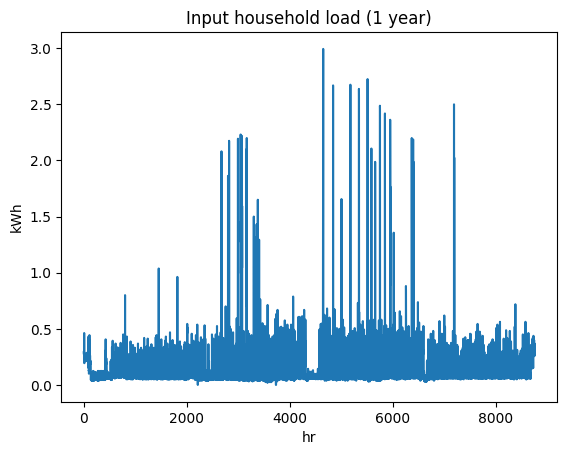

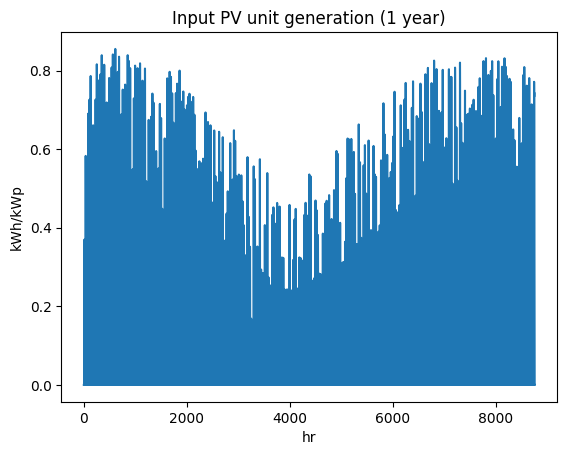

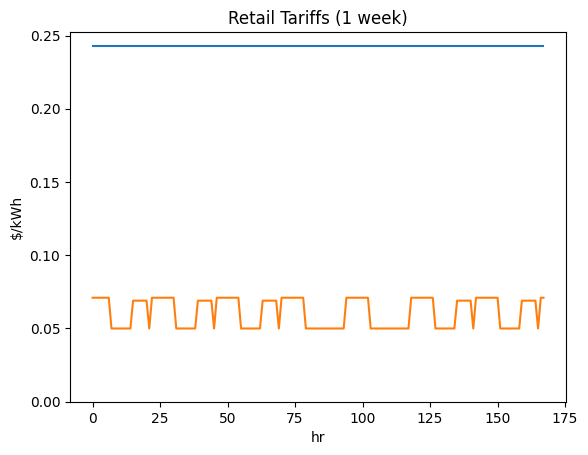

---- Optimising with PV: 1 - 20 kWp, Batt: 0 kWh. Determining PV capacity and dispatch.


************************************ Modell: PV > 1 kWp & BATT > 1 kWh ************************************
{'financial_horizon': 10, 'discount_rate': np.float64(0.06), 'grid_feedin_max': np.float64(5.0), 'pv_eol_capacity': np.float64(0.8), 'pv_eol_years': np.float64(25.0), 'pv_init_soh': np.float64(1.0), 'bess_e2p_ratio': np.float64(2.4), 'bess_roundtrip_eff': np.float64(0.88), 'bess_eol_years': np.float64(10.0), 'bess_eol_capacity': np.float64(0.7), 'bess_eol_cycles': np.float64(10000.0), 'bess_init_soh': np.float64(1.0), 'bess_eff_charge': np.float64(0.938083151964686), 'bess_eff_discharge': np.float64(0.938083151964686), 'scenario_name': 'Scenario_D_+5', 'scenario_set': 'SurfCoast', 'scenario_subset': 'JJP_open', 'year_start': 2022, 'datetime_name': 'DateTime1', 'meter_name': 'pc3072_nmi9816258293', 'solar_name': 'MELB', 'tariff_name_import_wkday': '3_Im_wkday', 'tariff_name_export_wkday': '3_

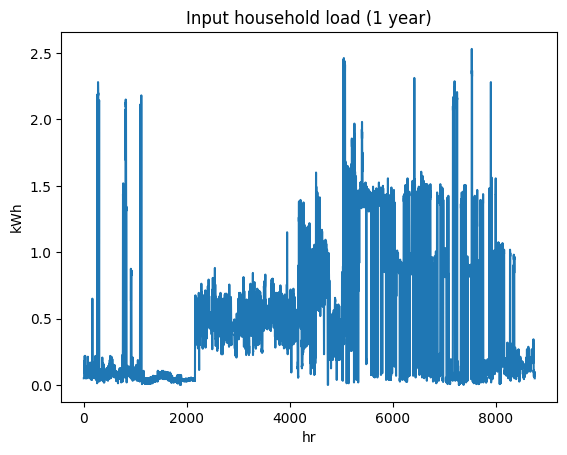

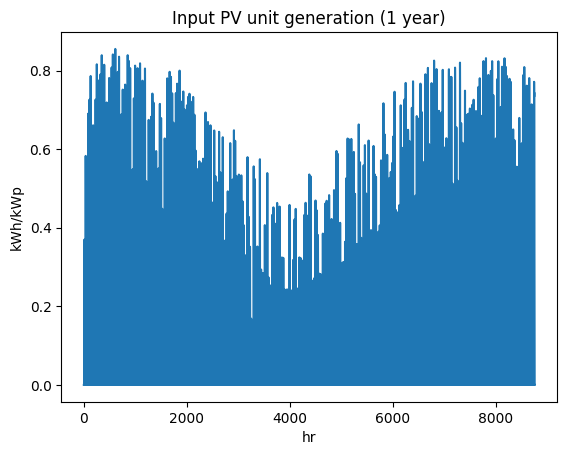

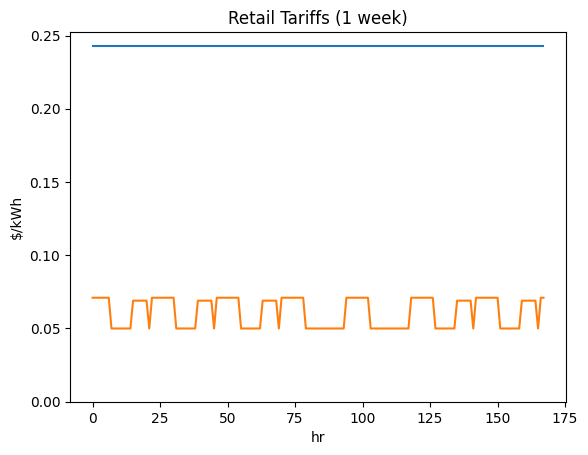

---- Optimising with PV: 1 - 20 kWp, Batt: 0 kWh. Determining PV capacity and dispatch.


************************************ Modell: PV > 1 kWp & BATT > 1 kWh ************************************
{'financial_horizon': 10, 'discount_rate': np.float64(0.06), 'grid_feedin_max': np.float64(5.0), 'pv_eol_capacity': np.float64(0.8), 'pv_eol_years': np.float64(25.0), 'pv_init_soh': np.float64(1.0), 'bess_e2p_ratio': np.float64(2.4), 'bess_roundtrip_eff': np.float64(0.88), 'bess_eol_years': np.float64(10.0), 'bess_eol_capacity': np.float64(0.7), 'bess_eol_cycles': np.float64(10000.0), 'bess_init_soh': np.float64(1.0), 'bess_eff_charge': np.float64(0.938083151964686), 'bess_eff_discharge': np.float64(0.938083151964686), 'scenario_name': 'Scenario_D_+5', 'scenario_set': 'SurfCoast', 'scenario_subset': 'JJP_open', 'year_start': 2022, 'datetime_name': 'DateTime1', 'meter_name': 'pc3072_nmi7170275390', 'solar_name': 'MELB', 'tariff_name_import_wkday': '3_Im_wkday', 'tariff_name_export_wkday': '3_

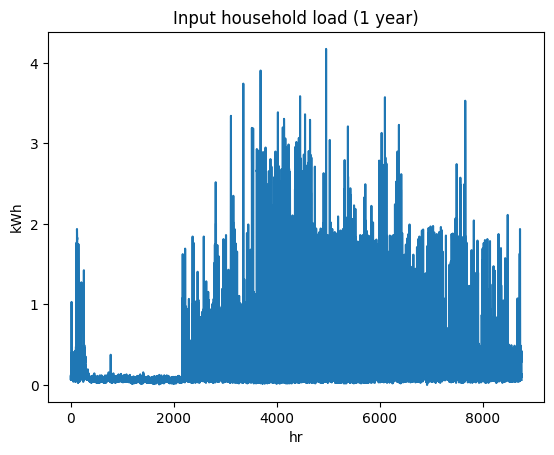

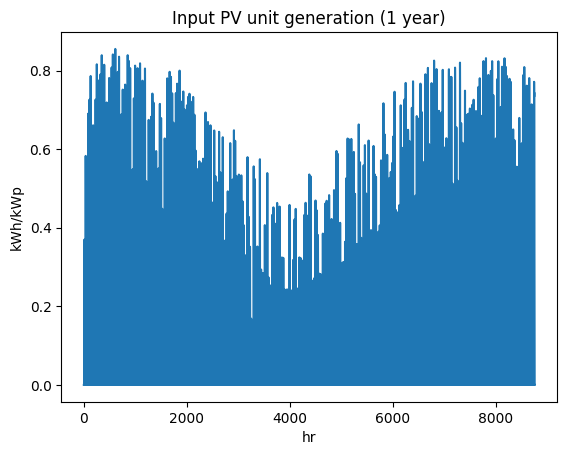

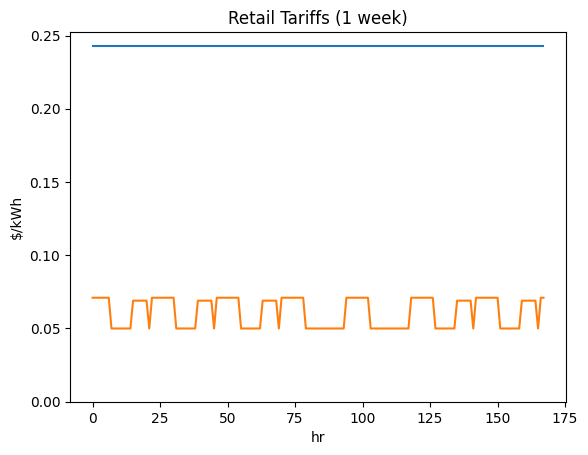

---- Optimising with PV: 1 - 20 kWp, Batt: 0 kWh. Determining PV capacity and dispatch.


************************************ Modell: PV > 1 kWp & BATT > 1 kWh ************************************
{'financial_horizon': 10, 'discount_rate': np.float64(0.06), 'grid_feedin_max': np.float64(5.0), 'pv_eol_capacity': np.float64(0.8), 'pv_eol_years': np.float64(25.0), 'pv_init_soh': np.float64(1.0), 'bess_e2p_ratio': np.float64(2.4), 'bess_roundtrip_eff': np.float64(0.88), 'bess_eol_years': np.float64(10.0), 'bess_eol_capacity': np.float64(0.7), 'bess_eol_cycles': np.float64(10000.0), 'bess_init_soh': np.float64(1.0), 'bess_eff_charge': np.float64(0.938083151964686), 'bess_eff_discharge': np.float64(0.938083151964686), 'scenario_name': 'Scenario_D_+5', 'scenario_set': 'SurfCoast', 'scenario_subset': 'JJP_open', 'year_start': 2022, 'datetime_name': 'DateTime1', 'meter_name': 'pc3016_nmi6663152845', 'solar_name': 'MELB', 'tariff_name_import_wkday': '3_Im_wkday', 'tariff_name_export_wkday': '3_

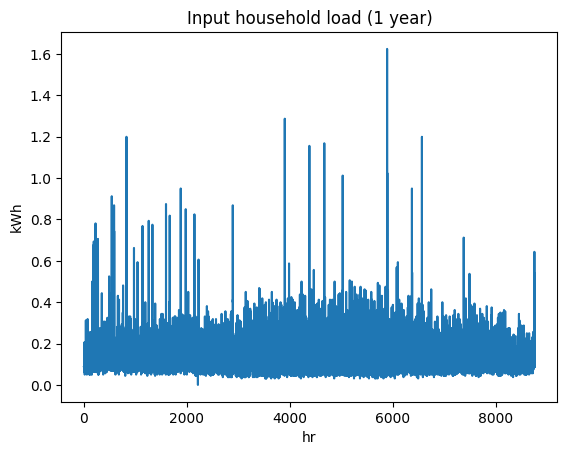

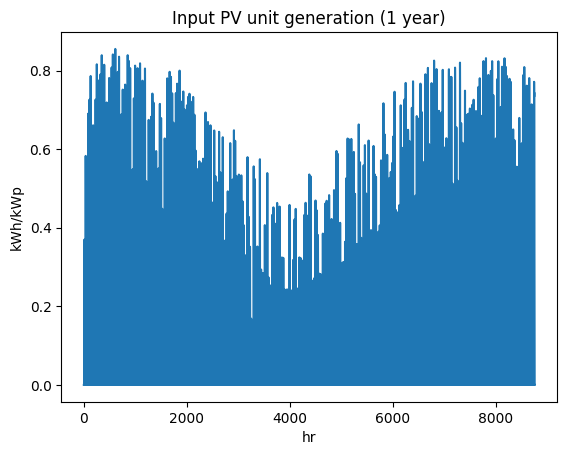

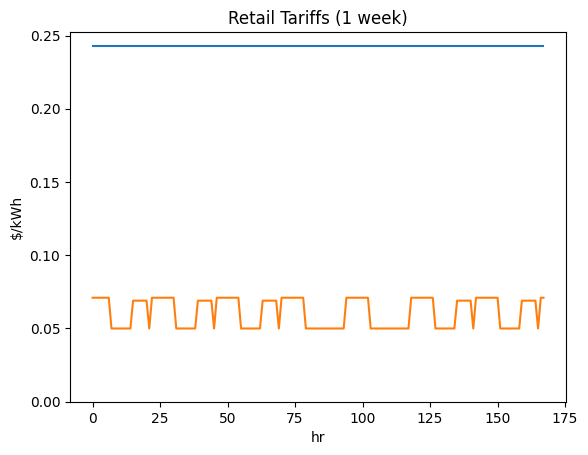

---- Optimising with PV: 1 - 20 kWp, Batt: 0 kWh. Determining PV capacity and dispatch.


************************************ Modell: PV > 1 kWp & BATT > 1 kWh ************************************
{'financial_horizon': 10, 'discount_rate': np.float64(0.06), 'grid_feedin_max': np.float64(5.0), 'pv_eol_capacity': np.float64(0.8), 'pv_eol_years': np.float64(25.0), 'pv_init_soh': np.float64(1.0), 'bess_e2p_ratio': np.float64(2.4), 'bess_roundtrip_eff': np.float64(0.88), 'bess_eol_years': np.float64(10.0), 'bess_eol_capacity': np.float64(0.7), 'bess_eol_cycles': np.float64(10000.0), 'bess_init_soh': np.float64(1.0), 'bess_eff_charge': np.float64(0.938083151964686), 'bess_eff_discharge': np.float64(0.938083151964686), 'scenario_name': 'Scenario_D_+5', 'scenario_set': 'SurfCoast', 'scenario_subset': 'JJP_open', 'year_start': 2022, 'datetime_name': 'DateTime1', 'meter_name': 'pc3072_nmi3741940389', 'solar_name': 'MELB', 'tariff_name_import_wkday': '3_Im_wkday', 'tariff_name_export_wkday': '3_

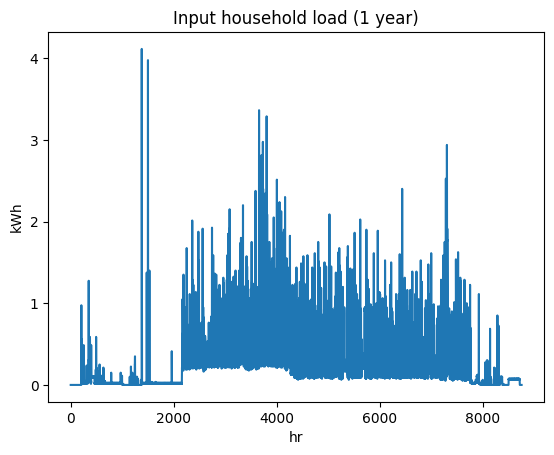

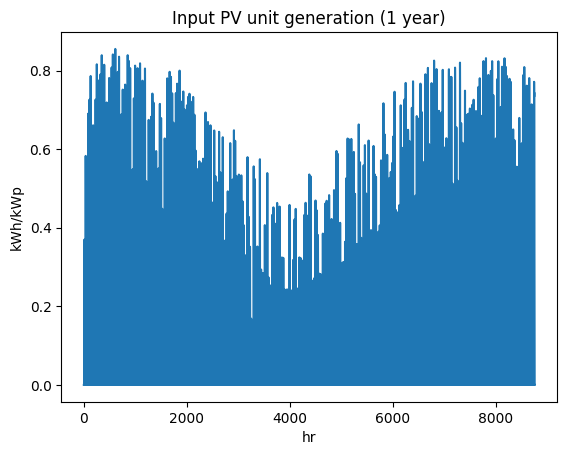

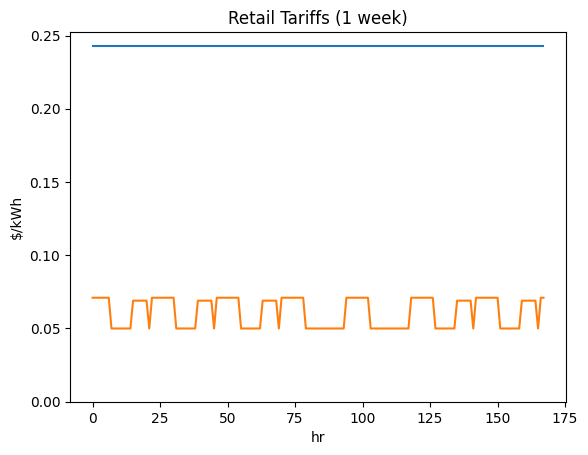

---- Optimising with PV: 1 - 20 kWp, Batt: 0 kWh. Determining PV capacity and dispatch.


************************************ Modell: PV > 1 kWp & BATT > 1 kWh ************************************
{'financial_horizon': 10, 'discount_rate': np.float64(0.06), 'grid_feedin_max': np.float64(5.0), 'pv_eol_capacity': np.float64(0.8), 'pv_eol_years': np.float64(25.0), 'pv_init_soh': np.float64(1.0), 'bess_e2p_ratio': np.float64(2.4), 'bess_roundtrip_eff': np.float64(0.88), 'bess_eol_years': np.float64(10.0), 'bess_eol_capacity': np.float64(0.7), 'bess_eol_cycles': np.float64(10000.0), 'bess_init_soh': np.float64(1.0), 'bess_eff_charge': np.float64(0.938083151964686), 'bess_eff_discharge': np.float64(0.938083151964686), 'scenario_name': 'Scenario_D_+5', 'scenario_set': 'SurfCoast', 'scenario_subset': 'JJP_open', 'year_start': 2022, 'datetime_name': 'DateTime1', 'meter_name': 'pc3072_nmi1185153789', 'solar_name': 'MELB', 'tariff_name_import_wkday': '3_Im_wkday', 'tariff_name_export_wkday': '3_

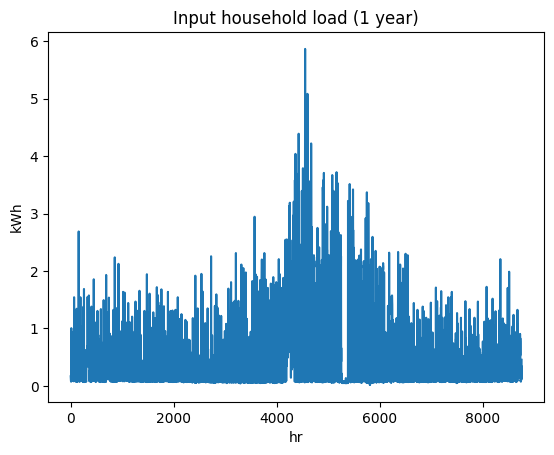

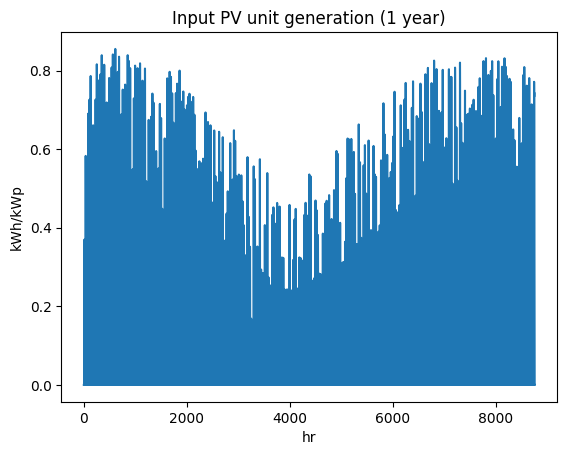

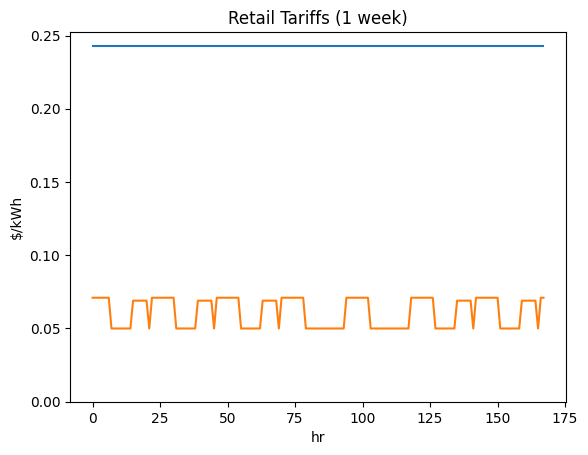

---- Optimising with PV: 1 - 20 kWp, Batt: 0 kWh. Determining PV capacity and dispatch.


************************************ Modell: PV > 1 kWp & BATT > 1 kWh ************************************
{'financial_horizon': 10, 'discount_rate': np.float64(0.06), 'grid_feedin_max': np.float64(5.0), 'pv_eol_capacity': np.float64(0.8), 'pv_eol_years': np.float64(25.0), 'pv_init_soh': np.float64(1.0), 'bess_e2p_ratio': np.float64(2.4), 'bess_roundtrip_eff': np.float64(0.88), 'bess_eol_years': np.float64(10.0), 'bess_eol_capacity': np.float64(0.7), 'bess_eol_cycles': np.float64(10000.0), 'bess_init_soh': np.float64(1.0), 'bess_eff_charge': np.float64(0.938083151964686), 'bess_eff_discharge': np.float64(0.938083151964686), 'scenario_name': 'Scenario_D_+5', 'scenario_set': 'SurfCoast', 'scenario_subset': 'JJP_open', 'year_start': 2022, 'datetime_name': 'DateTime1', 'meter_name': 'pc3072_nmi5231736070', 'solar_name': 'MELB', 'tariff_name_import_wkday': '3_Im_wkday', 'tariff_name_export_wkday': '3_

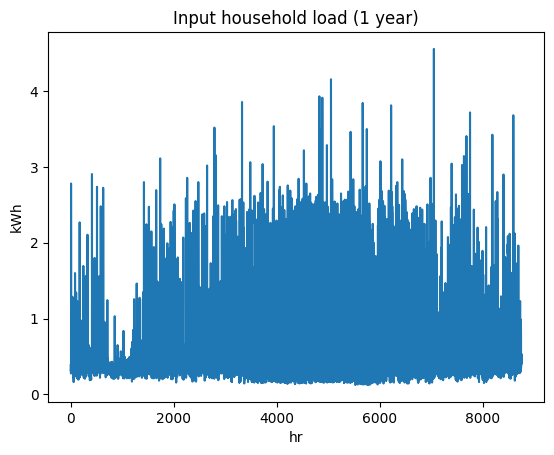

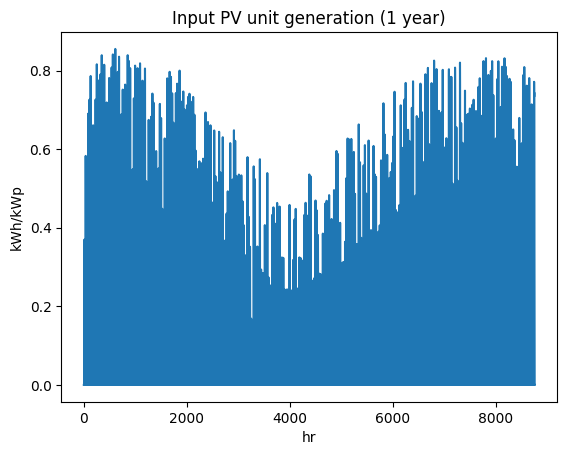

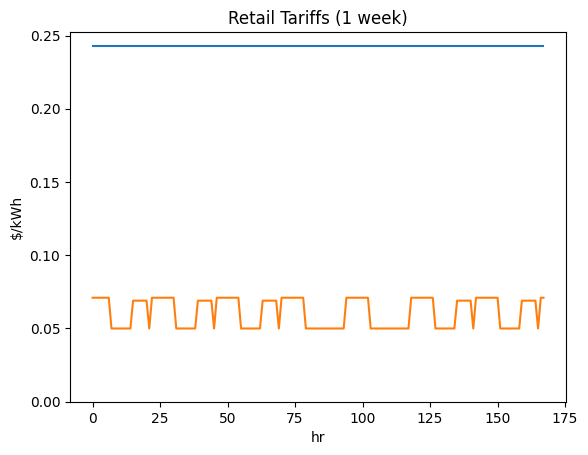

---- Optimising with PV: 1 - 20 kWp, Batt: 0 kWh. Determining PV capacity and dispatch.


************************************ Modell: PV > 1 kWp & BATT > 1 kWh ************************************
{'financial_horizon': 10, 'discount_rate': np.float64(0.06), 'grid_feedin_max': np.float64(5.0), 'pv_eol_capacity': np.float64(0.8), 'pv_eol_years': np.float64(25.0), 'pv_init_soh': np.float64(1.0), 'bess_e2p_ratio': np.float64(2.4), 'bess_roundtrip_eff': np.float64(0.88), 'bess_eol_years': np.float64(10.0), 'bess_eol_capacity': np.float64(0.7), 'bess_eol_cycles': np.float64(10000.0), 'bess_init_soh': np.float64(1.0), 'bess_eff_charge': np.float64(0.938083151964686), 'bess_eff_discharge': np.float64(0.938083151964686), 'scenario_name': 'Scenario_D_+5', 'scenario_set': 'SurfCoast', 'scenario_subset': 'JJP_open', 'year_start': 2022, 'datetime_name': 'DateTime1', 'meter_name': 'pc3072_nmi3786635254', 'solar_name': 'MELB', 'tariff_name_import_wkday': '3_Im_wkday', 'tariff_name_export_wkday': '3_

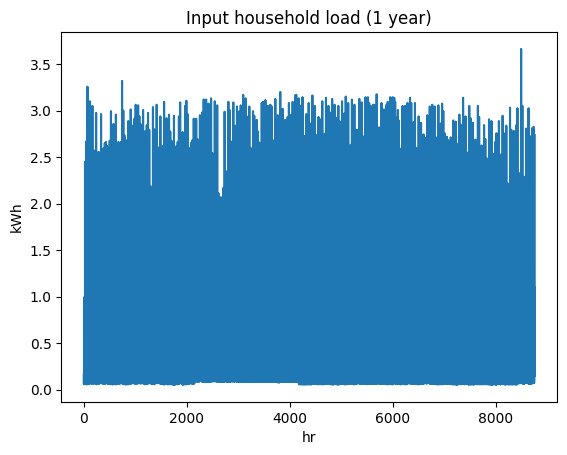

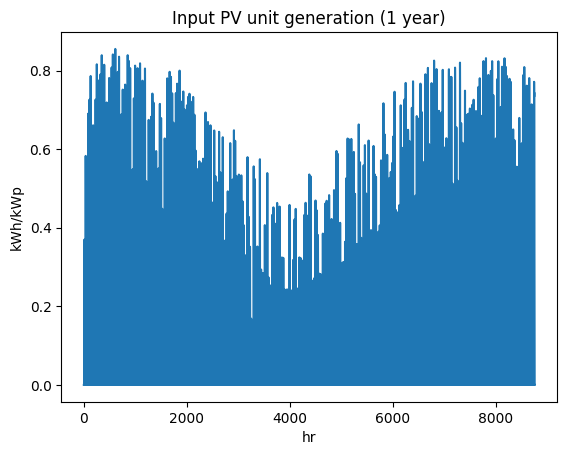

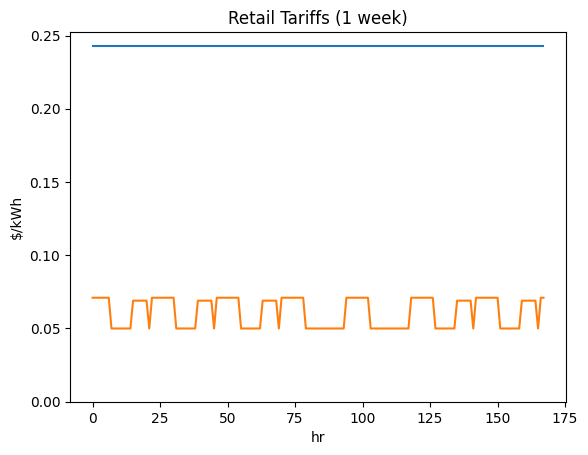

---- Optimising with PV: 1 - 20 kWp, Batt: 0 kWh. Determining PV capacity and dispatch.


************************************ Modell: PV > 1 kWp & BATT > 1 kWh ************************************
{'financial_horizon': 10, 'discount_rate': np.float64(0.06), 'grid_feedin_max': np.float64(5.0), 'pv_eol_capacity': np.float64(0.8), 'pv_eol_years': np.float64(25.0), 'pv_init_soh': np.float64(1.0), 'bess_e2p_ratio': np.float64(2.4), 'bess_roundtrip_eff': np.float64(0.88), 'bess_eol_years': np.float64(10.0), 'bess_eol_capacity': np.float64(0.7), 'bess_eol_cycles': np.float64(10000.0), 'bess_init_soh': np.float64(1.0), 'bess_eff_charge': np.float64(0.938083151964686), 'bess_eff_discharge': np.float64(0.938083151964686), 'scenario_name': 'Scenario_D_+5', 'scenario_set': 'SurfCoast', 'scenario_subset': 'JJP_open', 'year_start': 2022, 'datetime_name': 'DateTime1', 'meter_name': 'pc3039_nmi9523039165', 'solar_name': 'MELB', 'tariff_name_import_wkday': '3_Im_wkday', 'tariff_name_export_wkday': '3_

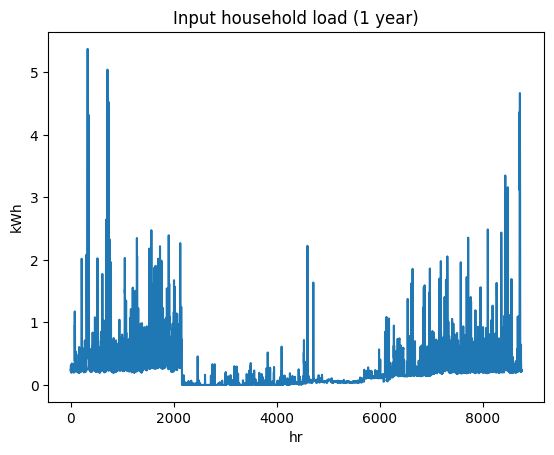

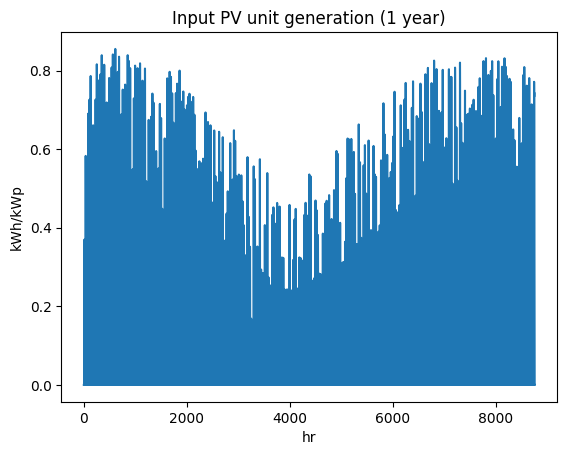

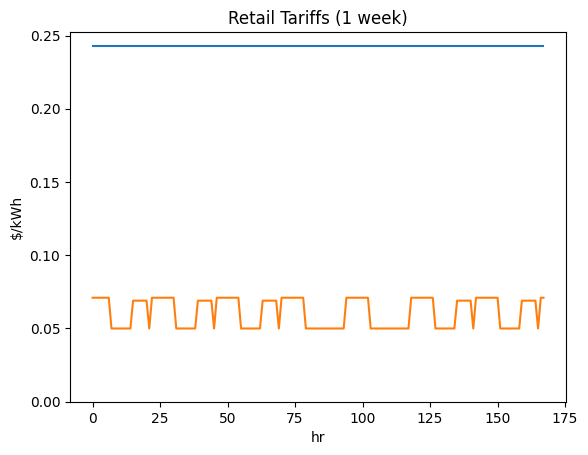

---- Optimising with PV: 1 - 20 kWp, Batt: 0 kWh. Determining PV capacity and dispatch.


************************************ Modell: PV > 1 kWp & BATT > 1 kWh ************************************
{'financial_horizon': 10, 'discount_rate': np.float64(0.06), 'grid_feedin_max': np.float64(5.0), 'pv_eol_capacity': np.float64(0.8), 'pv_eol_years': np.float64(25.0), 'pv_init_soh': np.float64(1.0), 'bess_e2p_ratio': np.float64(2.4), 'bess_roundtrip_eff': np.float64(0.88), 'bess_eol_years': np.float64(10.0), 'bess_eol_capacity': np.float64(0.7), 'bess_eol_cycles': np.float64(10000.0), 'bess_init_soh': np.float64(1.0), 'bess_eff_charge': np.float64(0.938083151964686), 'bess_eff_discharge': np.float64(0.938083151964686), 'scenario_name': 'Scenario_D_+5', 'scenario_set': 'SurfCoast', 'scenario_subset': 'JJP_open', 'year_start': 2022, 'datetime_name': 'DateTime1', 'meter_name': 'pc3072_nmi9904430846', 'solar_name': 'MELB', 'tariff_name_import_wkday': '3_Im_wkday', 'tariff_name_export_wkday': '3_

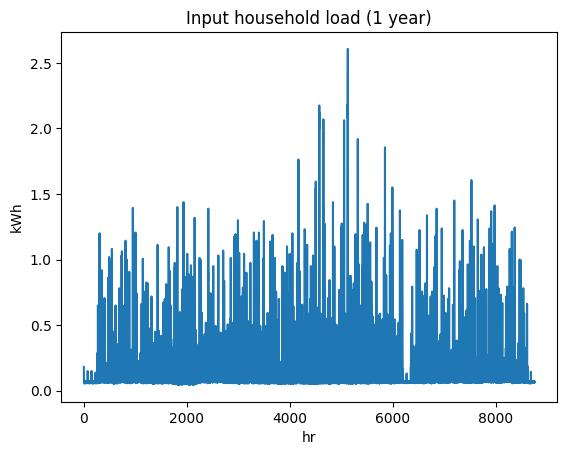

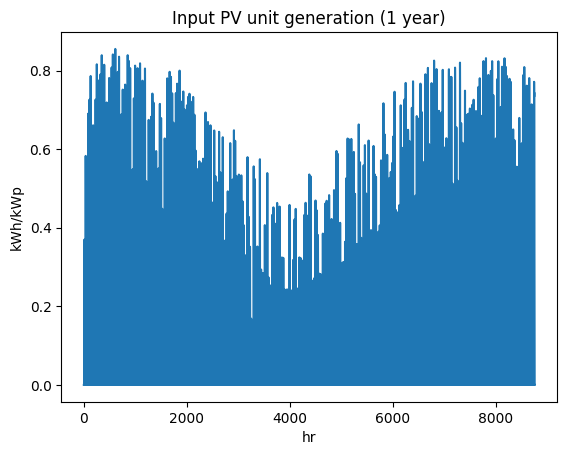

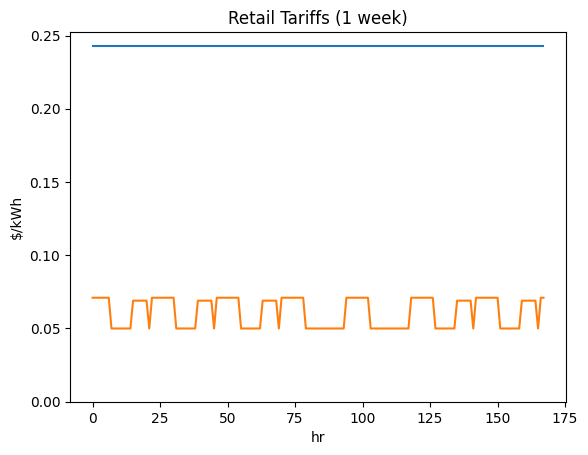

---- Optimising with PV: 1 - 20 kWp, Batt: 0 kWh. Determining PV capacity and dispatch.


************************************ Modell: PV > 1 kWp & BATT > 1 kWh ************************************
{'financial_horizon': 10, 'discount_rate': np.float64(0.06), 'grid_feedin_max': np.float64(5.0), 'pv_eol_capacity': np.float64(0.8), 'pv_eol_years': np.float64(25.0), 'pv_init_soh': np.float64(1.0), 'bess_e2p_ratio': np.float64(2.4), 'bess_roundtrip_eff': np.float64(0.88), 'bess_eol_years': np.float64(10.0), 'bess_eol_capacity': np.float64(0.7), 'bess_eol_cycles': np.float64(10000.0), 'bess_init_soh': np.float64(1.0), 'bess_eff_charge': np.float64(0.938083151964686), 'bess_eff_discharge': np.float64(0.938083151964686), 'scenario_name': 'Scenario_D_+5', 'scenario_set': 'SurfCoast', 'scenario_subset': 'JJP_open', 'year_start': 2022, 'datetime_name': 'DateTime1', 'meter_name': 'pc3032_nmi6297946024', 'solar_name': 'MELB', 'tariff_name_import_wkday': '3_Im_wkday', 'tariff_name_export_wkday': '3_

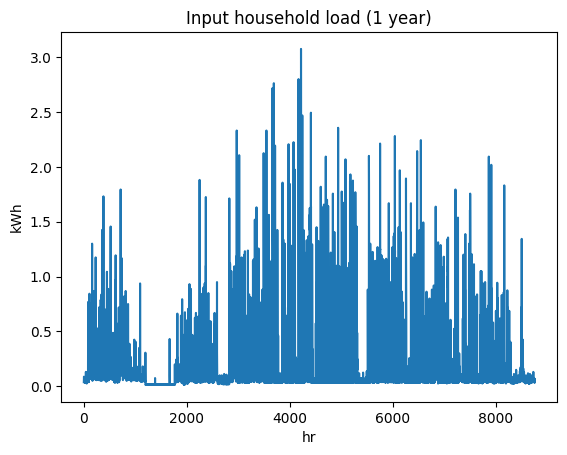

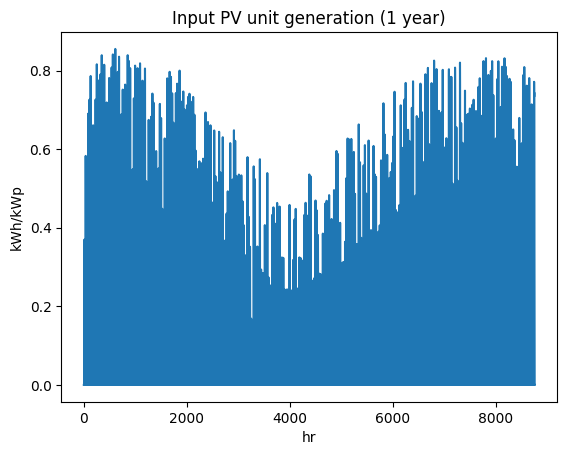

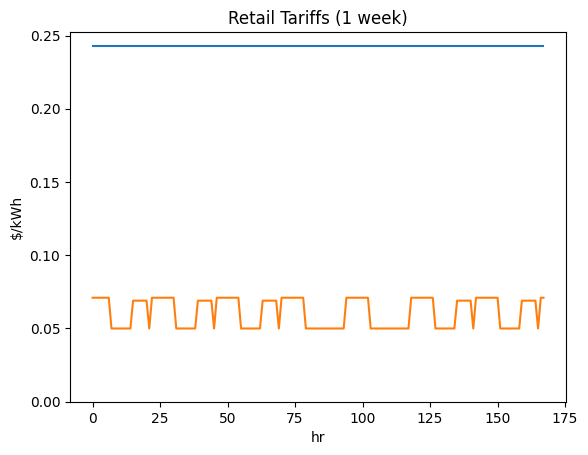

---- Optimising with PV: 1 - 20 kWp, Batt: 0 kWh. Determining PV capacity and dispatch.


************************************ Modell: PV > 1 kWp & BATT > 1 kWh ************************************
{'financial_horizon': 10, 'discount_rate': np.float64(0.06), 'grid_feedin_max': np.float64(5.0), 'pv_eol_capacity': np.float64(0.8), 'pv_eol_years': np.float64(25.0), 'pv_init_soh': np.float64(1.0), 'bess_e2p_ratio': np.float64(2.4), 'bess_roundtrip_eff': np.float64(0.88), 'bess_eol_years': np.float64(10.0), 'bess_eol_capacity': np.float64(0.7), 'bess_eol_cycles': np.float64(10000.0), 'bess_init_soh': np.float64(1.0), 'bess_eff_charge': np.float64(0.938083151964686), 'bess_eff_discharge': np.float64(0.938083151964686), 'scenario_name': 'Scenario_D_+5', 'scenario_set': 'SurfCoast', 'scenario_subset': 'JJP_open', 'year_start': 2022, 'datetime_name': 'DateTime1', 'meter_name': 'pc3031_nmi8606131576', 'solar_name': 'MELB', 'tariff_name_import_wkday': '3_Im_wkday', 'tariff_name_export_wkday': '3_

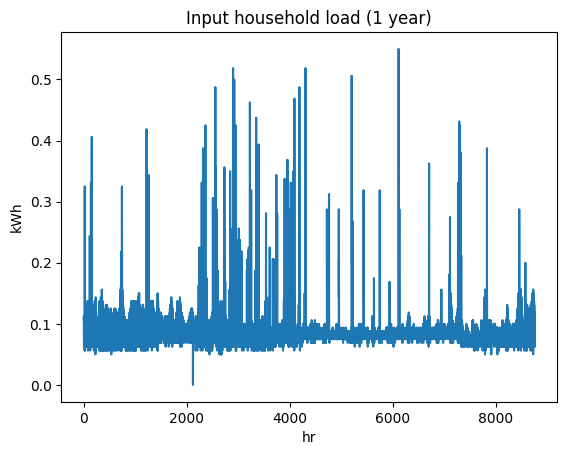

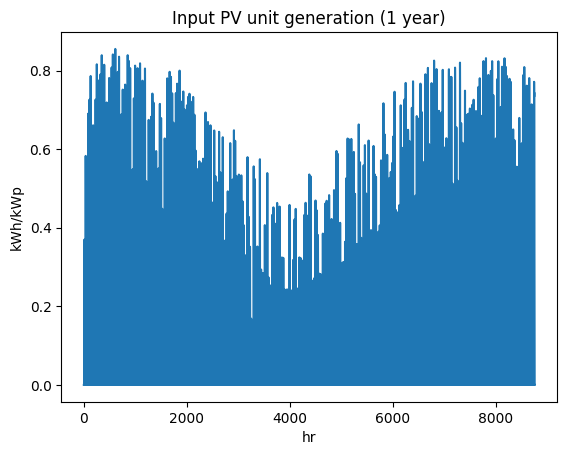

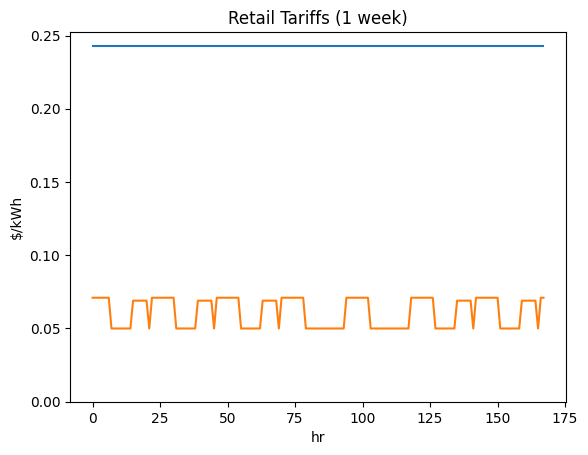

---- Optimising with PV: 1 - 20 kWp, Batt: 0 kWh. Determining PV capacity and dispatch.


************************************ Modell: PV > 1 kWp & BATT > 1 kWh ************************************
{'financial_horizon': 10, 'discount_rate': np.float64(0.06), 'grid_feedin_max': np.float64(5.0), 'pv_eol_capacity': np.float64(0.8), 'pv_eol_years': np.float64(25.0), 'pv_init_soh': np.float64(1.0), 'bess_e2p_ratio': np.float64(2.4), 'bess_roundtrip_eff': np.float64(0.88), 'bess_eol_years': np.float64(10.0), 'bess_eol_capacity': np.float64(0.7), 'bess_eol_cycles': np.float64(10000.0), 'bess_init_soh': np.float64(1.0), 'bess_eff_charge': np.float64(0.938083151964686), 'bess_eff_discharge': np.float64(0.938083151964686), 'scenario_name': 'Scenario_D_+5', 'scenario_set': 'SurfCoast', 'scenario_subset': 'JJP_open', 'year_start': 2022, 'datetime_name': 'DateTime1', 'meter_name': 'pc3012_nmi8290814095', 'solar_name': 'MELB', 'tariff_name_import_wkday': '3_Im_wkday', 'tariff_name_export_wkday': '3_

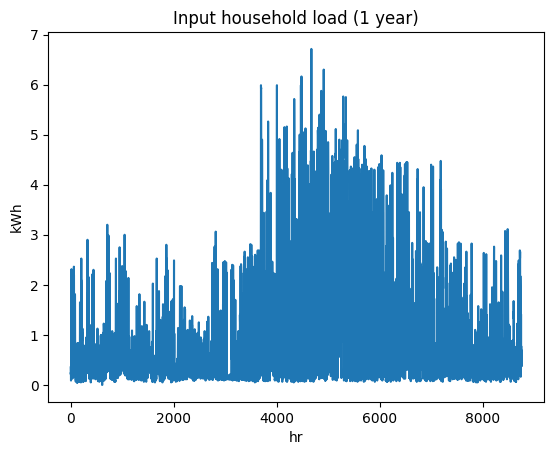

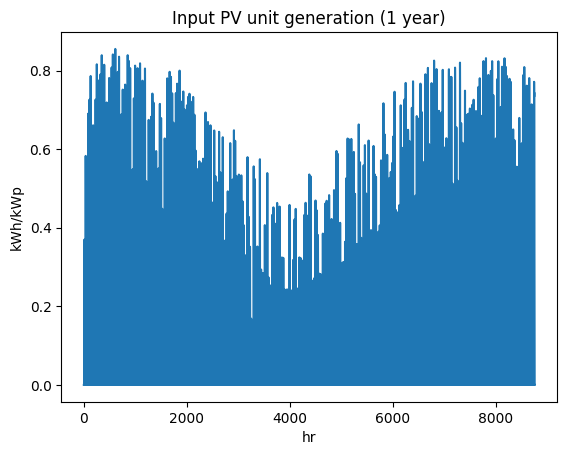

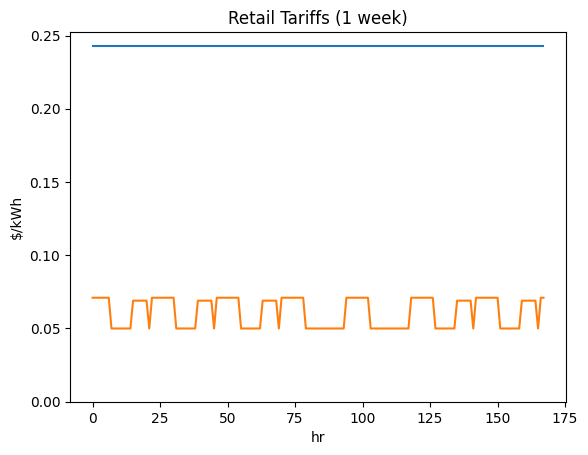

---- Optimising with PV: 1 - 20 kWp, Batt: 0 kWh. Determining PV capacity and dispatch.


************************************ Modell: PV > 1 kWp & BATT > 1 kWh ************************************
{'financial_horizon': 10, 'discount_rate': np.float64(0.06), 'grid_feedin_max': np.float64(5.0), 'pv_eol_capacity': np.float64(0.8), 'pv_eol_years': np.float64(25.0), 'pv_init_soh': np.float64(1.0), 'bess_e2p_ratio': np.float64(2.4), 'bess_roundtrip_eff': np.float64(0.88), 'bess_eol_years': np.float64(10.0), 'bess_eol_capacity': np.float64(0.7), 'bess_eol_cycles': np.float64(10000.0), 'bess_init_soh': np.float64(1.0), 'bess_eff_charge': np.float64(0.938083151964686), 'bess_eff_discharge': np.float64(0.938083151964686), 'scenario_name': 'Scenario_D_+5', 'scenario_set': 'SurfCoast', 'scenario_subset': 'JJP_open', 'year_start': 2022, 'datetime_name': 'DateTime1', 'meter_name': 'pc3012_nmi4082218402', 'solar_name': 'MELB', 'tariff_name_import_wkday': '3_Im_wkday', 'tariff_name_export_wkday': '3_

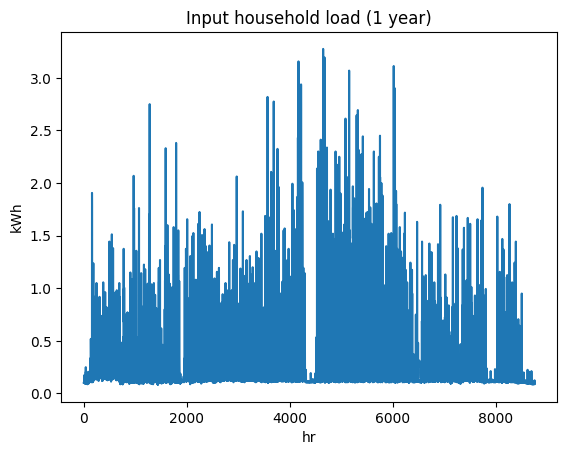

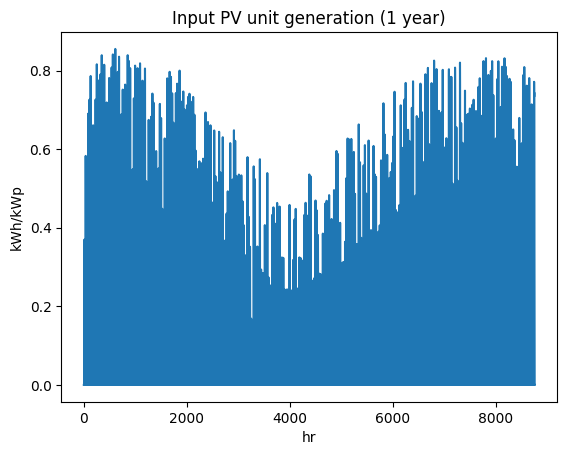

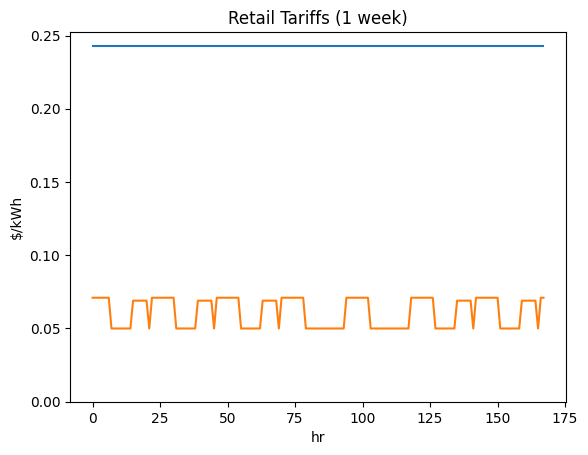

---- Optimising with PV: 1 - 20 kWp, Batt: 0 kWh. Determining PV capacity and dispatch.


************************************ Modell: PV > 1 kWp & BATT > 1 kWh ************************************
{'financial_horizon': 10, 'discount_rate': np.float64(0.06), 'grid_feedin_max': np.float64(5.0), 'pv_eol_capacity': np.float64(0.8), 'pv_eol_years': np.float64(25.0), 'pv_init_soh': np.float64(1.0), 'bess_e2p_ratio': np.float64(2.4), 'bess_roundtrip_eff': np.float64(0.88), 'bess_eol_years': np.float64(10.0), 'bess_eol_capacity': np.float64(0.7), 'bess_eol_cycles': np.float64(10000.0), 'bess_init_soh': np.float64(1.0), 'bess_eff_charge': np.float64(0.938083151964686), 'bess_eff_discharge': np.float64(0.938083151964686), 'scenario_name': 'Scenario_D_+5', 'scenario_set': 'SurfCoast', 'scenario_subset': 'JJP_open', 'year_start': 2022, 'datetime_name': 'DateTime1', 'meter_name': 'pc3012_nmi7472946033', 'solar_name': 'MELB', 'tariff_name_import_wkday': '3_Im_wkday', 'tariff_name_export_wkday': '3_

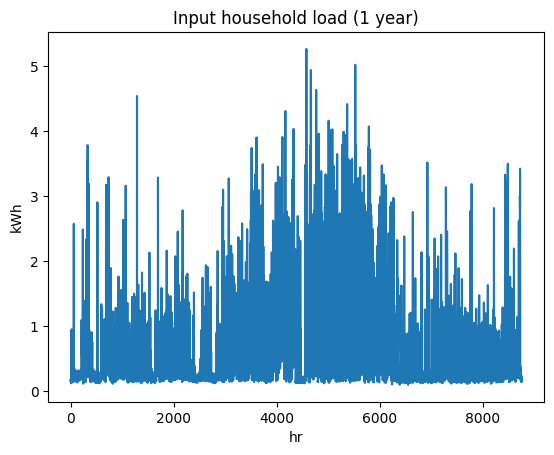

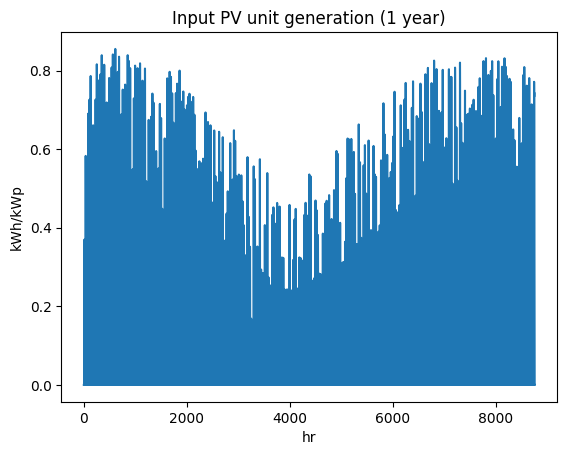

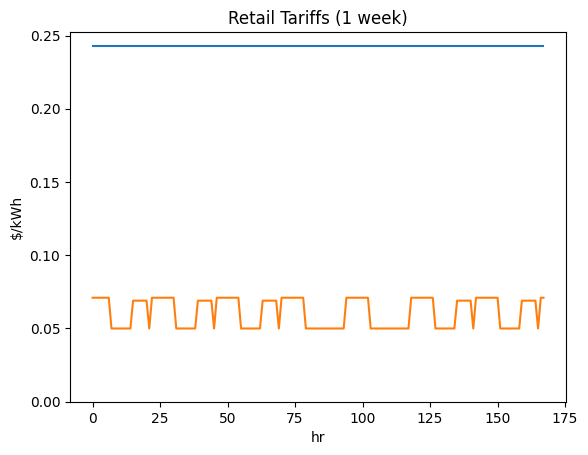

---- Optimising with PV: 1 - 20 kWp, Batt: 0 kWh. Determining PV capacity and dispatch.


************************************ Modell: PV > 1 kWp & BATT > 1 kWh ************************************
{'financial_horizon': 10, 'discount_rate': np.float64(0.06), 'grid_feedin_max': np.float64(5.0), 'pv_eol_capacity': np.float64(0.8), 'pv_eol_years': np.float64(25.0), 'pv_init_soh': np.float64(1.0), 'bess_e2p_ratio': np.float64(2.4), 'bess_roundtrip_eff': np.float64(0.88), 'bess_eol_years': np.float64(10.0), 'bess_eol_capacity': np.float64(0.7), 'bess_eol_cycles': np.float64(10000.0), 'bess_init_soh': np.float64(1.0), 'bess_eff_charge': np.float64(0.938083151964686), 'bess_eff_discharge': np.float64(0.938083151964686), 'scenario_name': 'Scenario_D_+5', 'scenario_set': 'SurfCoast', 'scenario_subset': 'JJP_open', 'year_start': 2022, 'datetime_name': 'DateTime1', 'meter_name': 'pc3058_nmi4942967454', 'solar_name': 'MELB', 'tariff_name_import_wkday': '3_Im_wkday', 'tariff_name_export_wkday': '3_

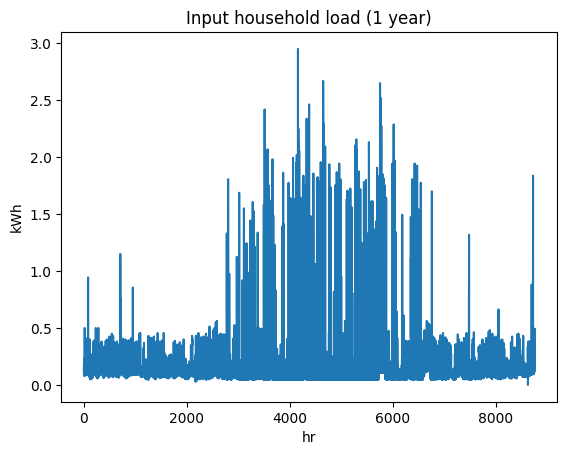

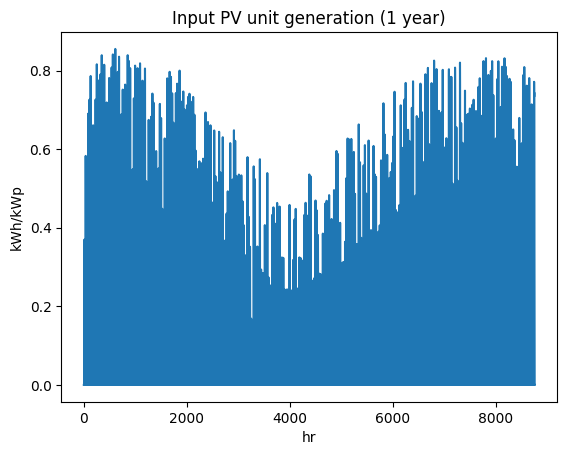

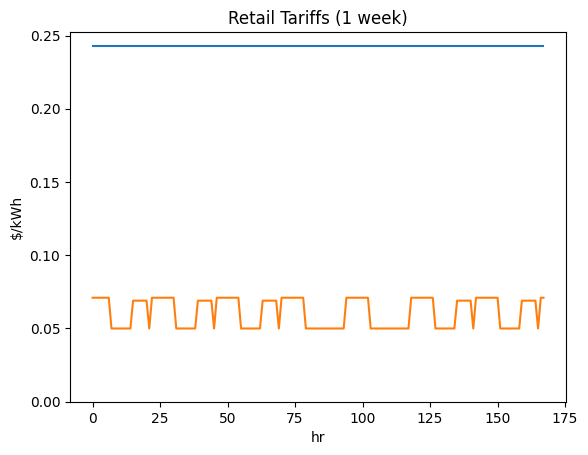

---- Optimising with PV: 1 - 20 kWp, Batt: 0 kWh. Determining PV capacity and dispatch.


************************************ Modell: PV > 1 kWp & BATT > 1 kWh ************************************
{'financial_horizon': 10, 'discount_rate': np.float64(0.06), 'grid_feedin_max': np.float64(5.0), 'pv_eol_capacity': np.float64(0.8), 'pv_eol_years': np.float64(25.0), 'pv_init_soh': np.float64(1.0), 'bess_e2p_ratio': np.float64(2.4), 'bess_roundtrip_eff': np.float64(0.88), 'bess_eol_years': np.float64(10.0), 'bess_eol_capacity': np.float64(0.7), 'bess_eol_cycles': np.float64(10000.0), 'bess_init_soh': np.float64(1.0), 'bess_eff_charge': np.float64(0.938083151964686), 'bess_eff_discharge': np.float64(0.938083151964686), 'scenario_name': 'Scenario_D_+5', 'scenario_set': 'SurfCoast', 'scenario_subset': 'JJP_open', 'year_start': 2022, 'datetime_name': 'DateTime1', 'meter_name': 'pc3058_nmi7583146704', 'solar_name': 'MELB', 'tariff_name_import_wkday': '3_Im_wkday', 'tariff_name_export_wkday': '3_

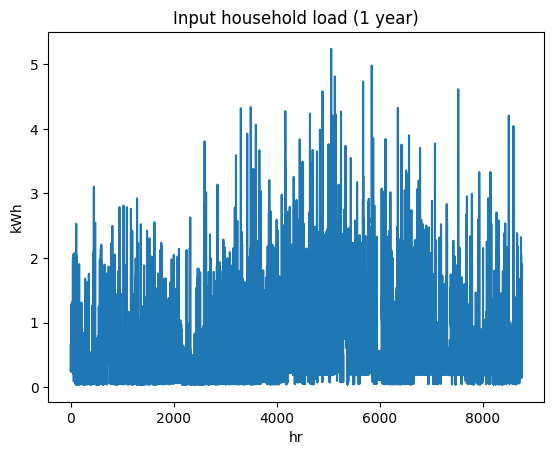

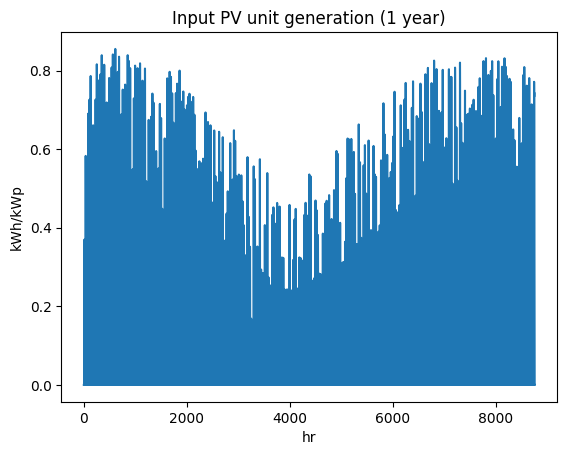

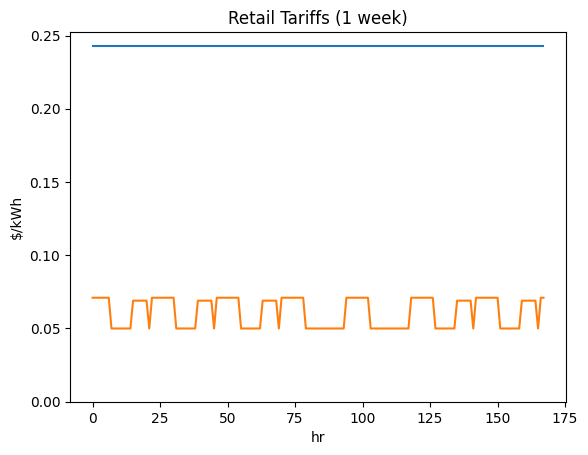

---- Optimising with PV: 1 - 20 kWp, Batt: 0 kWh. Determining PV capacity and dispatch.


************************************ Modell: PV > 1 kWp & BATT > 1 kWh ************************************
{'financial_horizon': 10, 'discount_rate': np.float64(0.06), 'grid_feedin_max': np.float64(5.0), 'pv_eol_capacity': np.float64(0.8), 'pv_eol_years': np.float64(25.0), 'pv_init_soh': np.float64(1.0), 'bess_e2p_ratio': np.float64(2.4), 'bess_roundtrip_eff': np.float64(0.88), 'bess_eol_years': np.float64(10.0), 'bess_eol_capacity': np.float64(0.7), 'bess_eol_cycles': np.float64(10000.0), 'bess_init_soh': np.float64(1.0), 'bess_eff_charge': np.float64(0.938083151964686), 'bess_eff_discharge': np.float64(0.938083151964686), 'scenario_name': 'Scenario_D_+5', 'scenario_set': 'SurfCoast', 'scenario_subset': 'JJP_open', 'year_start': 2022, 'datetime_name': 'DateTime1', 'meter_name': 'pc3058_nmi6818883022', 'solar_name': 'MELB', 'tariff_name_import_wkday': '3_Im_wkday', 'tariff_name_export_wkday': '3_

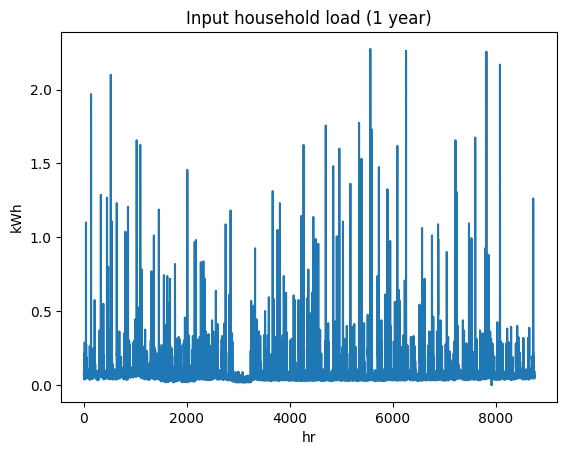

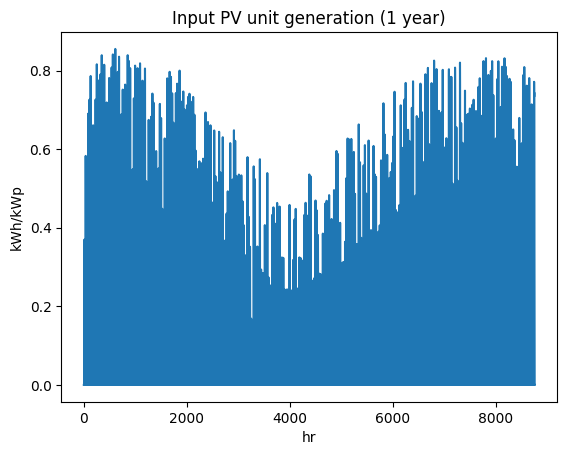

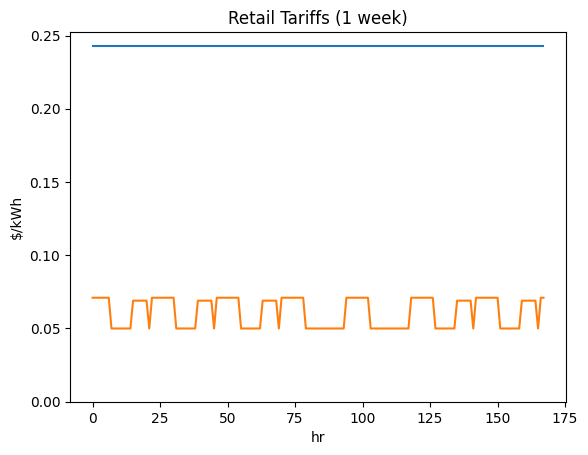

---- Optimising with PV: 1 - 20 kWp, Batt: 0 kWh. Determining PV capacity and dispatch.


************************************ Modell: PV > 1 kWp & BATT > 1 kWh ************************************
{'financial_horizon': 10, 'discount_rate': np.float64(0.06), 'grid_feedin_max': np.float64(5.0), 'pv_eol_capacity': np.float64(0.8), 'pv_eol_years': np.float64(25.0), 'pv_init_soh': np.float64(1.0), 'bess_e2p_ratio': np.float64(2.4), 'bess_roundtrip_eff': np.float64(0.88), 'bess_eol_years': np.float64(10.0), 'bess_eol_capacity': np.float64(0.7), 'bess_eol_cycles': np.float64(10000.0), 'bess_init_soh': np.float64(1.0), 'bess_eff_charge': np.float64(0.938083151964686), 'bess_eff_discharge': np.float64(0.938083151964686), 'scenario_name': 'Scenario_D_+5', 'scenario_set': 'SurfCoast', 'scenario_subset': 'JJP_open', 'year_start': 2022, 'datetime_name': 'DateTime1', 'meter_name': 'pc3058_nmi2823557968', 'solar_name': 'MELB', 'tariff_name_import_wkday': '3_Im_wkday', 'tariff_name_export_wkday': '3_

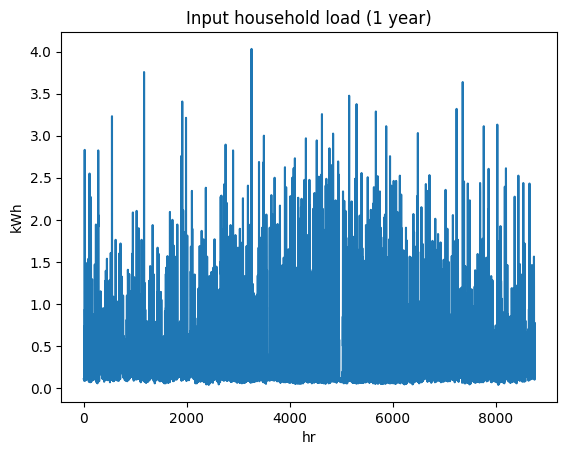

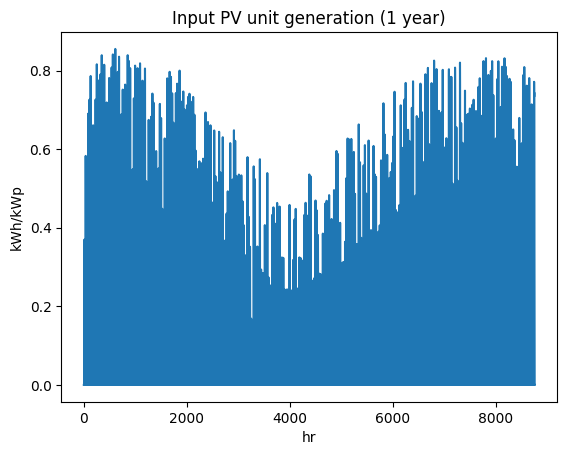

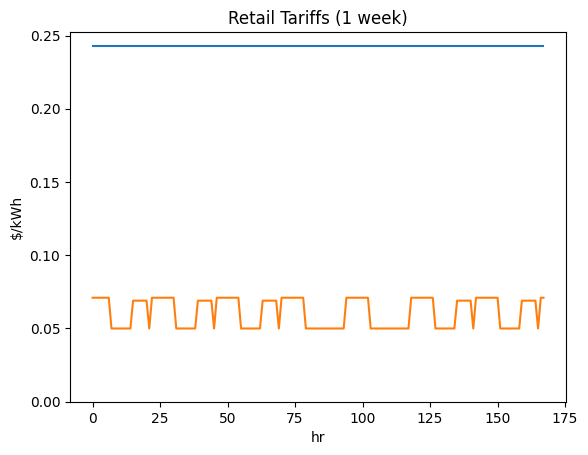

---- Optimising with PV: 1 - 20 kWp, Batt: 0 kWh. Determining PV capacity and dispatch.


************************************ Modell: PV > 1 kWp & BATT > 1 kWh ************************************
{'financial_horizon': 10, 'discount_rate': np.float64(0.06), 'grid_feedin_max': np.float64(5.0), 'pv_eol_capacity': np.float64(0.8), 'pv_eol_years': np.float64(25.0), 'pv_init_soh': np.float64(1.0), 'bess_e2p_ratio': np.float64(2.4), 'bess_roundtrip_eff': np.float64(0.88), 'bess_eol_years': np.float64(10.0), 'bess_eol_capacity': np.float64(0.7), 'bess_eol_cycles': np.float64(10000.0), 'bess_init_soh': np.float64(1.0), 'bess_eff_charge': np.float64(0.938083151964686), 'bess_eff_discharge': np.float64(0.938083151964686), 'scenario_name': 'Scenario_D_+5', 'scenario_set': 'SurfCoast', 'scenario_subset': 'JJP_open', 'year_start': 2022, 'datetime_name': 'DateTime1', 'meter_name': 'pc3058_nmi1101737949', 'solar_name': 'MELB', 'tariff_name_import_wkday': '3_Im_wkday', 'tariff_name_export_wkday': '3_

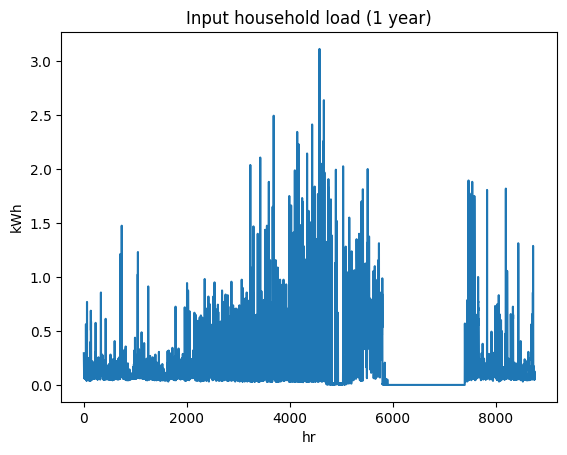

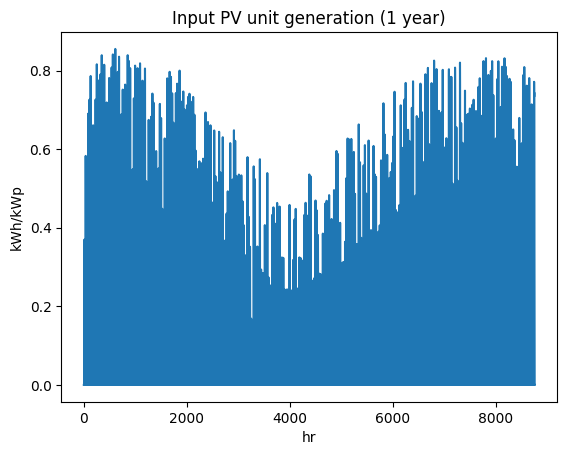

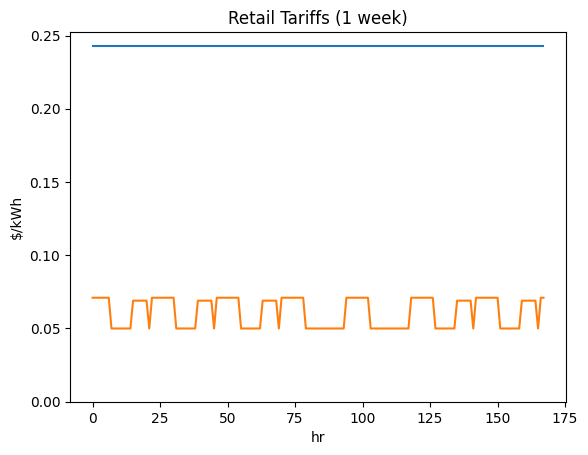

---- Optimising with PV: 1 - 20 kWp, Batt: 0 kWh. Determining PV capacity and dispatch.


************************************ Modell: PV > 1 kWp & BATT > 1 kWh ************************************
{'financial_horizon': 10, 'discount_rate': np.float64(0.06), 'grid_feedin_max': np.float64(5.0), 'pv_eol_capacity': np.float64(0.8), 'pv_eol_years': np.float64(25.0), 'pv_init_soh': np.float64(1.0), 'bess_e2p_ratio': np.float64(2.4), 'bess_roundtrip_eff': np.float64(0.88), 'bess_eol_years': np.float64(10.0), 'bess_eol_capacity': np.float64(0.7), 'bess_eol_cycles': np.float64(10000.0), 'bess_init_soh': np.float64(1.0), 'bess_eff_charge': np.float64(0.938083151964686), 'bess_eff_discharge': np.float64(0.938083151964686), 'scenario_name': 'Scenario_D_+5', 'scenario_set': 'SurfCoast', 'scenario_subset': 'JJP_open', 'year_start': 2022, 'datetime_name': 'DateTime1', 'meter_name': 'pc3058_nmi5882729846', 'solar_name': 'MELB', 'tariff_name_import_wkday': '3_Im_wkday', 'tariff_name_export_wkday': '3_

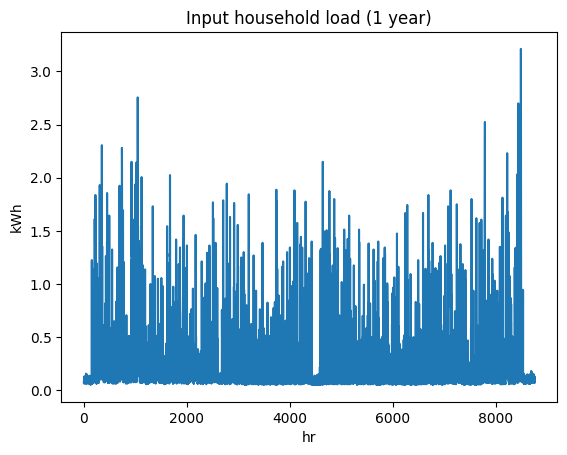

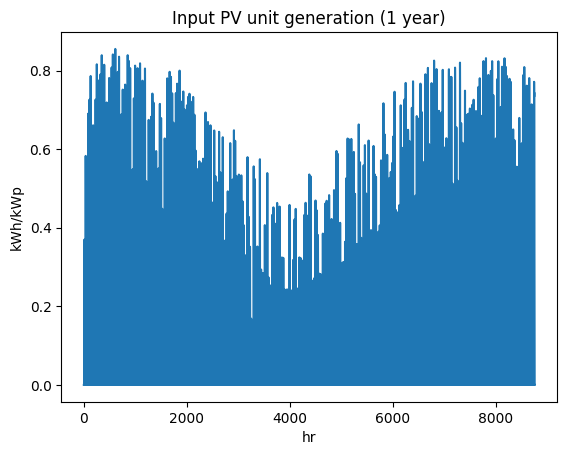

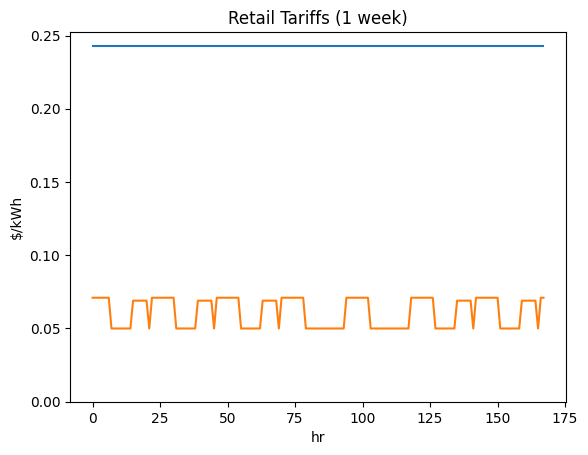

---- Optimising with PV: 1 - 20 kWp, Batt: 0 kWh. Determining PV capacity and dispatch.


************************************ Modell: PV > 1 kWp & BATT > 1 kWh ************************************
{'financial_horizon': 10, 'discount_rate': np.float64(0.06), 'grid_feedin_max': np.float64(5.0), 'pv_eol_capacity': np.float64(0.8), 'pv_eol_years': np.float64(25.0), 'pv_init_soh': np.float64(1.0), 'bess_e2p_ratio': np.float64(2.4), 'bess_roundtrip_eff': np.float64(0.88), 'bess_eol_years': np.float64(10.0), 'bess_eol_capacity': np.float64(0.7), 'bess_eol_cycles': np.float64(10000.0), 'bess_init_soh': np.float64(1.0), 'bess_eff_charge': np.float64(0.938083151964686), 'bess_eff_discharge': np.float64(0.938083151964686), 'scenario_name': 'Scenario_D_+5', 'scenario_set': 'SurfCoast', 'scenario_subset': 'JJP_open', 'year_start': 2022, 'datetime_name': 'DateTime1', 'meter_name': 'pc3058_nmi7164329794', 'solar_name': 'MELB', 'tariff_name_import_wkday': '3_Im_wkday', 'tariff_name_export_wkday': '3_

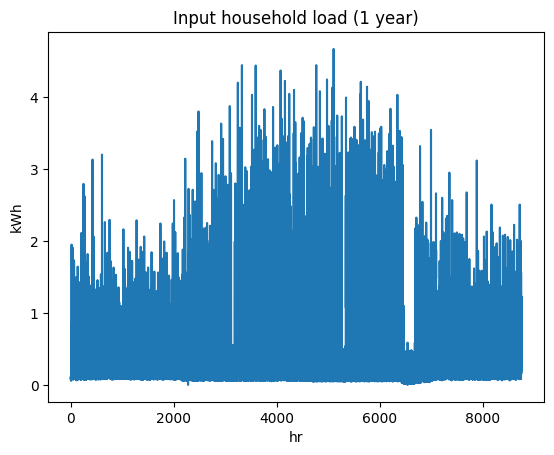

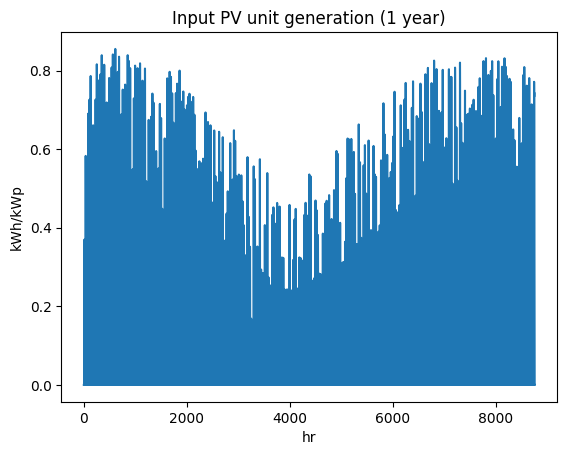

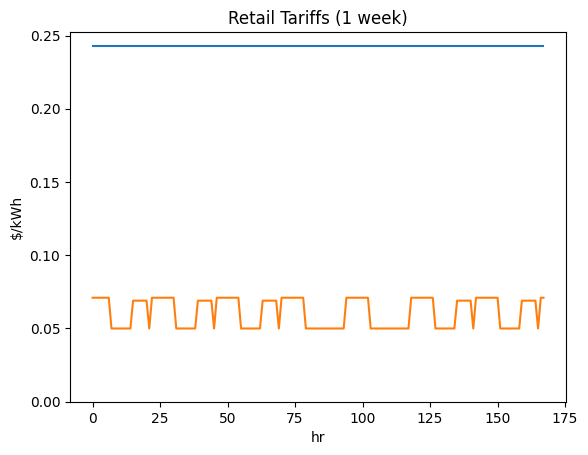

---- Optimising with PV: 1 - 20 kWp, Batt: 0 kWh. Determining PV capacity and dispatch.


************************************ Modell: PV > 1 kWp & BATT > 1 kWh ************************************
{'financial_horizon': 10, 'discount_rate': np.float64(0.06), 'grid_feedin_max': np.float64(5.0), 'pv_eol_capacity': np.float64(0.8), 'pv_eol_years': np.float64(25.0), 'pv_init_soh': np.float64(1.0), 'bess_e2p_ratio': np.float64(2.4), 'bess_roundtrip_eff': np.float64(0.88), 'bess_eol_years': np.float64(10.0), 'bess_eol_capacity': np.float64(0.7), 'bess_eol_cycles': np.float64(10000.0), 'bess_init_soh': np.float64(1.0), 'bess_eff_charge': np.float64(0.938083151964686), 'bess_eff_discharge': np.float64(0.938083151964686), 'scenario_name': 'Scenario_D_+5', 'scenario_set': 'SurfCoast', 'scenario_subset': 'JJP_open', 'year_start': 2022, 'datetime_name': 'DateTime1', 'meter_name': 'pc3058_nmi3895984770', 'solar_name': 'MELB', 'tariff_name_import_wkday': '3_Im_wkday', 'tariff_name_export_wkday': '3_

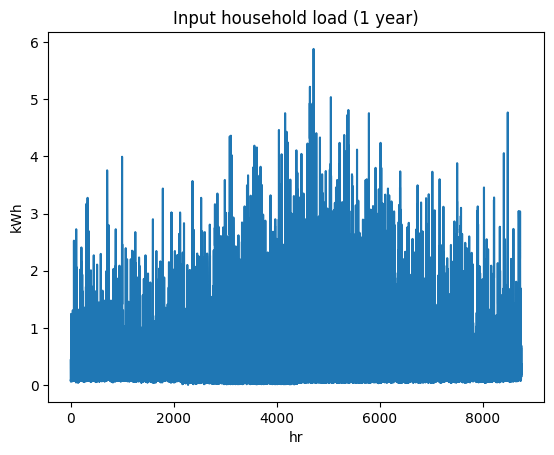

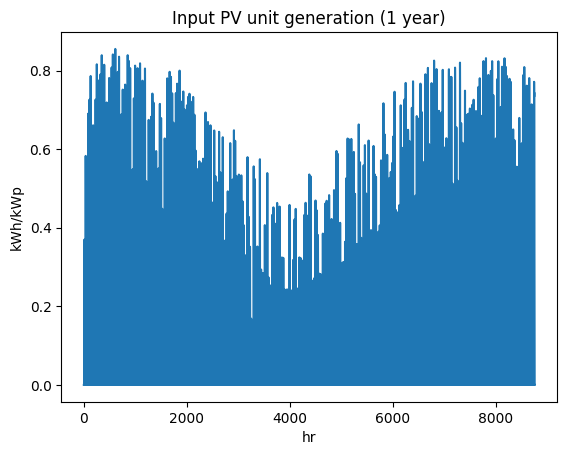

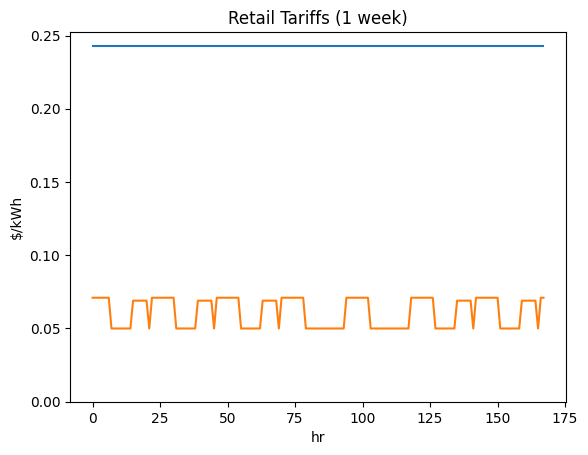

---- Optimising with PV: 1 - 20 kWp, Batt: 0 kWh. Determining PV capacity and dispatch.


************************************ Modell: PV > 1 kWp & BATT > 1 kWh ************************************
{'financial_horizon': 10, 'discount_rate': np.float64(0.06), 'grid_feedin_max': np.float64(5.0), 'pv_eol_capacity': np.float64(0.8), 'pv_eol_years': np.float64(25.0), 'pv_init_soh': np.float64(1.0), 'bess_e2p_ratio': np.float64(2.4), 'bess_roundtrip_eff': np.float64(0.88), 'bess_eol_years': np.float64(10.0), 'bess_eol_capacity': np.float64(0.7), 'bess_eol_cycles': np.float64(10000.0), 'bess_init_soh': np.float64(1.0), 'bess_eff_charge': np.float64(0.938083151964686), 'bess_eff_discharge': np.float64(0.938083151964686), 'scenario_name': 'Scenario_D_+5', 'scenario_set': 'SurfCoast', 'scenario_subset': 'JJP_open', 'year_start': 2022, 'datetime_name': 'DateTime1', 'meter_name': 'pc3058_nmi3099541524', 'solar_name': 'MELB', 'tariff_name_import_wkday': '3_Im_wkday', 'tariff_name_export_wkday': '3_

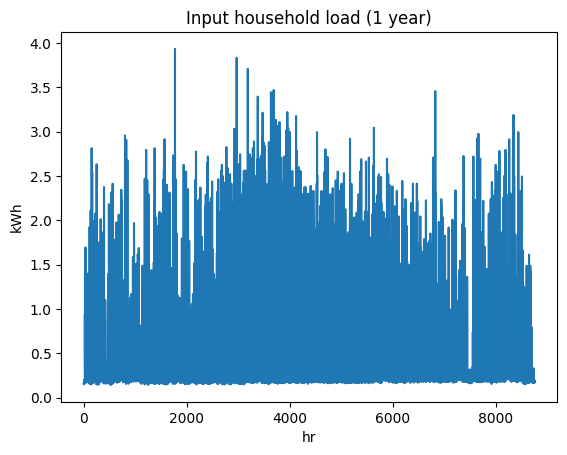

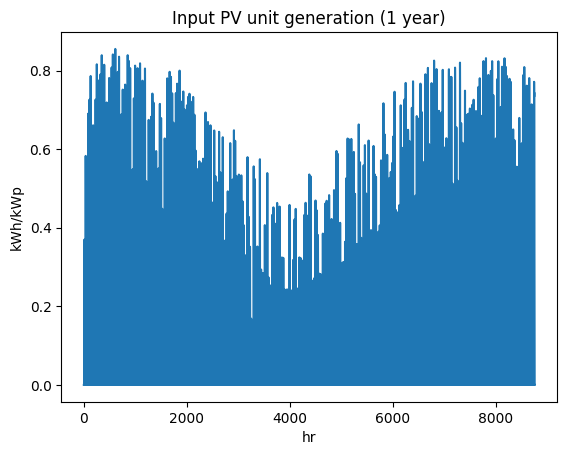

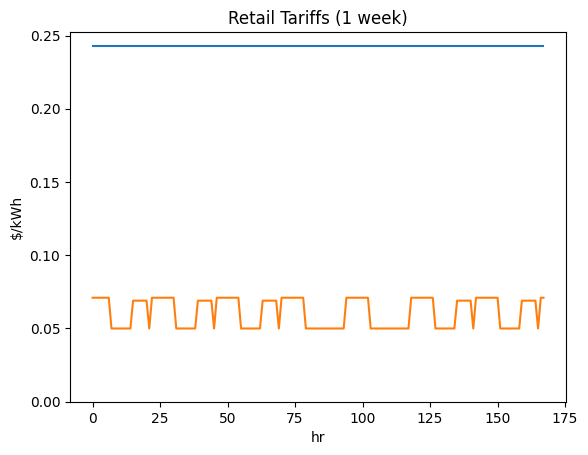

---- Optimising with PV: 1 - 20 kWp, Batt: 0 kWh. Determining PV capacity and dispatch.


************************************ Modell: PV > 1 kWp & BATT > 1 kWh ************************************
{'financial_horizon': 10, 'discount_rate': np.float64(0.06), 'grid_feedin_max': np.float64(5.0), 'pv_eol_capacity': np.float64(0.8), 'pv_eol_years': np.float64(25.0), 'pv_init_soh': np.float64(1.0), 'bess_e2p_ratio': np.float64(2.4), 'bess_roundtrip_eff': np.float64(0.88), 'bess_eol_years': np.float64(10.0), 'bess_eol_capacity': np.float64(0.7), 'bess_eol_cycles': np.float64(10000.0), 'bess_init_soh': np.float64(1.0), 'bess_eff_charge': np.float64(0.938083151964686), 'bess_eff_discharge': np.float64(0.938083151964686), 'scenario_name': 'Scenario_D_+5', 'scenario_set': 'SurfCoast', 'scenario_subset': 'JJP_open', 'year_start': 2022, 'datetime_name': 'DateTime1', 'meter_name': 'pc3058_nmi1865852063', 'solar_name': 'MELB', 'tariff_name_import_wkday': '3_Im_wkday', 'tariff_name_export_wkday': '3_

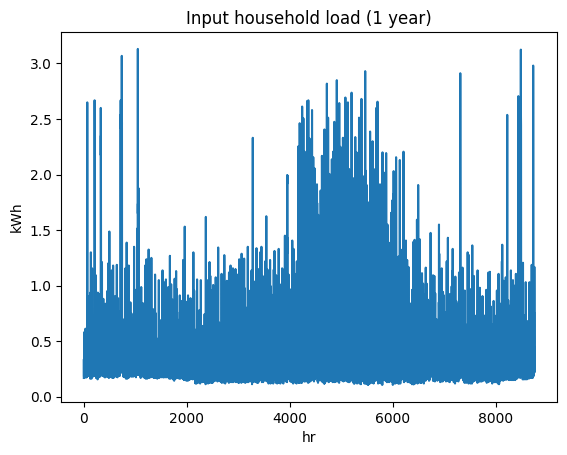

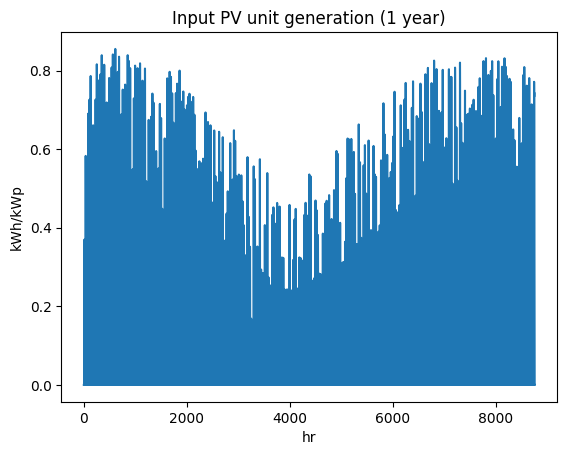

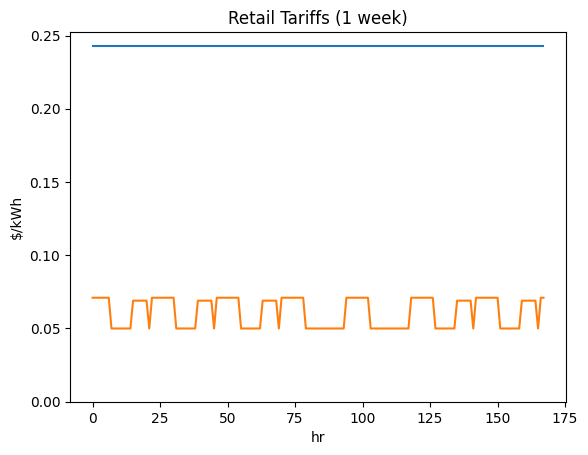

---- Optimising with PV: 1 - 20 kWp, Batt: 0 kWh. Determining PV capacity and dispatch.


************************************ Modell: PV > 1 kWp & BATT > 1 kWh ************************************
{'financial_horizon': 10, 'discount_rate': np.float64(0.06), 'grid_feedin_max': np.float64(5.0), 'pv_eol_capacity': np.float64(0.8), 'pv_eol_years': np.float64(25.0), 'pv_init_soh': np.float64(1.0), 'bess_e2p_ratio': np.float64(2.4), 'bess_roundtrip_eff': np.float64(0.88), 'bess_eol_years': np.float64(10.0), 'bess_eol_capacity': np.float64(0.7), 'bess_eol_cycles': np.float64(10000.0), 'bess_init_soh': np.float64(1.0), 'bess_eff_charge': np.float64(0.938083151964686), 'bess_eff_discharge': np.float64(0.938083151964686), 'scenario_name': 'Scenario_D_+5', 'scenario_set': 'SurfCoast', 'scenario_subset': 'JJP_open', 'year_start': 2022, 'datetime_name': 'DateTime1', 'meter_name': 'pc3058_nmi5666538429', 'solar_name': 'MELB', 'tariff_name_import_wkday': '3_Im_wkday', 'tariff_name_export_wkday': '3_

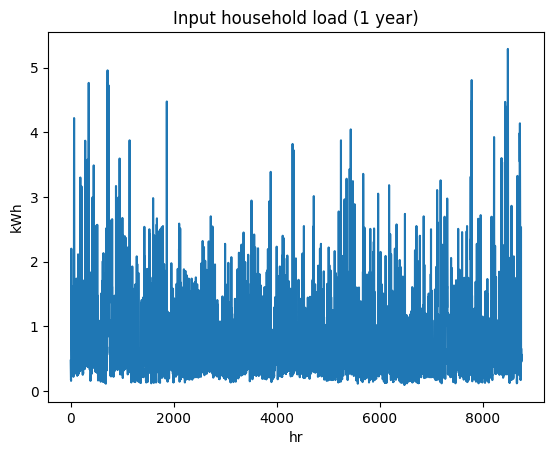

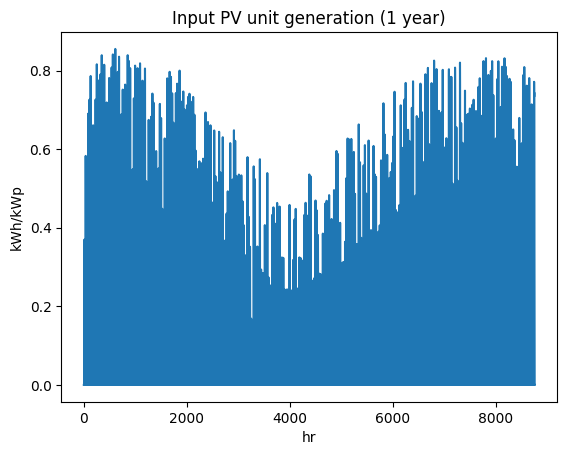

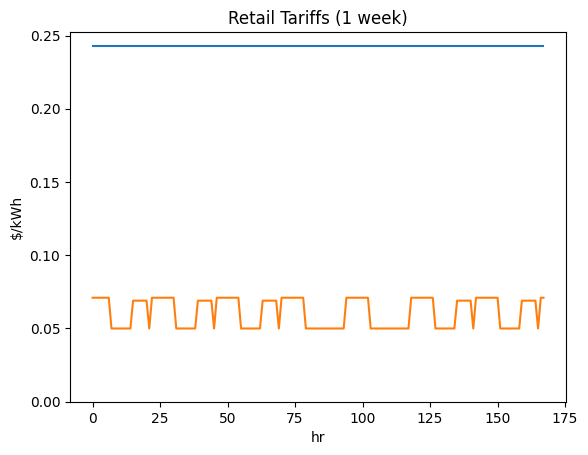

---- Optimising with PV: 1 - 20 kWp, Batt: 0 kWh. Determining PV capacity and dispatch.


************************************ Modell: PV > 1 kWp & BATT > 1 kWh ************************************
{'financial_horizon': 10, 'discount_rate': np.float64(0.06), 'grid_feedin_max': np.float64(5.0), 'pv_eol_capacity': np.float64(0.8), 'pv_eol_years': np.float64(25.0), 'pv_init_soh': np.float64(1.0), 'bess_e2p_ratio': np.float64(2.4), 'bess_roundtrip_eff': np.float64(0.88), 'bess_eol_years': np.float64(10.0), 'bess_eol_capacity': np.float64(0.7), 'bess_eol_cycles': np.float64(10000.0), 'bess_init_soh': np.float64(1.0), 'bess_eff_charge': np.float64(0.938083151964686), 'bess_eff_discharge': np.float64(0.938083151964686), 'scenario_name': 'Scenario_D_+5', 'scenario_set': 'SurfCoast', 'scenario_subset': 'JJP_open', 'year_start': 2022, 'datetime_name': 'DateTime1', 'meter_name': 'pc3058_nmi3473788160', 'solar_name': 'MELB', 'tariff_name_import_wkday': '3_Im_wkday', 'tariff_name_export_wkday': '3_

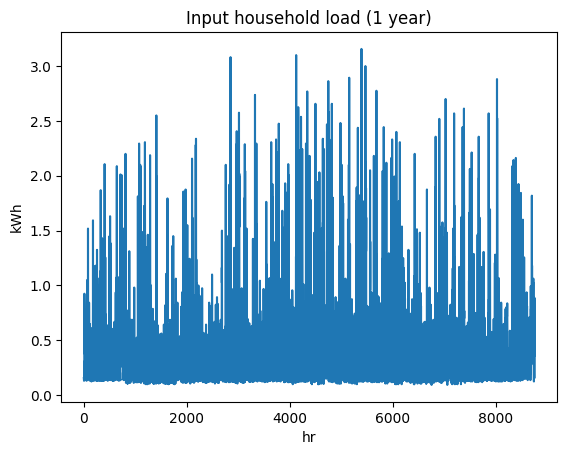

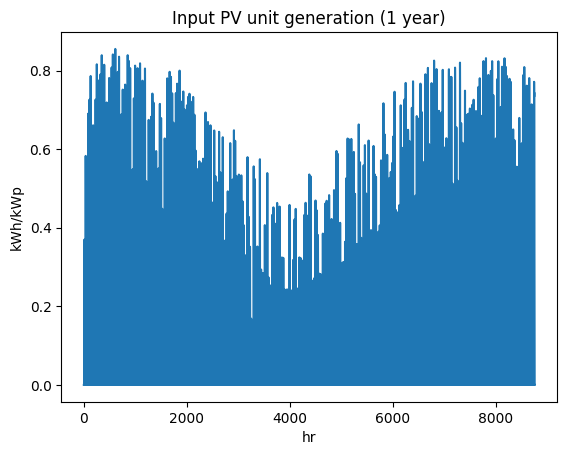

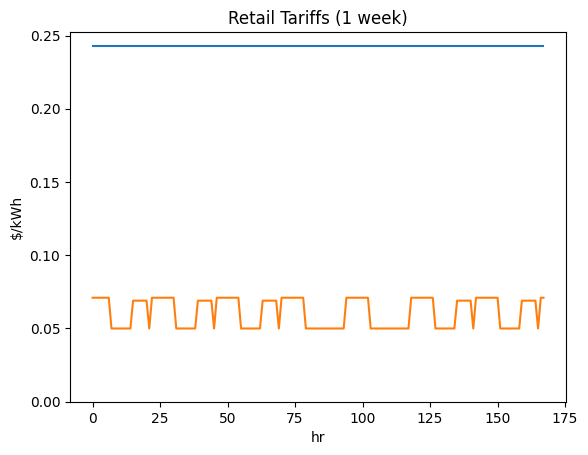

---- Optimising with PV: 1 - 20 kWp, Batt: 0 kWh. Determining PV capacity and dispatch.


************************************ Modell: PV > 1 kWp & BATT > 1 kWh ************************************
{'financial_horizon': 10, 'discount_rate': np.float64(0.06), 'grid_feedin_max': np.float64(5.0), 'pv_eol_capacity': np.float64(0.8), 'pv_eol_years': np.float64(25.0), 'pv_init_soh': np.float64(1.0), 'bess_e2p_ratio': np.float64(2.4), 'bess_roundtrip_eff': np.float64(0.88), 'bess_eol_years': np.float64(10.0), 'bess_eol_capacity': np.float64(0.7), 'bess_eol_cycles': np.float64(10000.0), 'bess_init_soh': np.float64(1.0), 'bess_eff_charge': np.float64(0.938083151964686), 'bess_eff_discharge': np.float64(0.938083151964686), 'scenario_name': 'Scenario_D_+5', 'scenario_set': 'SurfCoast', 'scenario_subset': 'JJP_open', 'year_start': 2022, 'datetime_name': 'DateTime1', 'meter_name': 'pc3058_nmi1444544531', 'solar_name': 'MELB', 'tariff_name_import_wkday': '3_Im_wkday', 'tariff_name_export_wkday': '3_

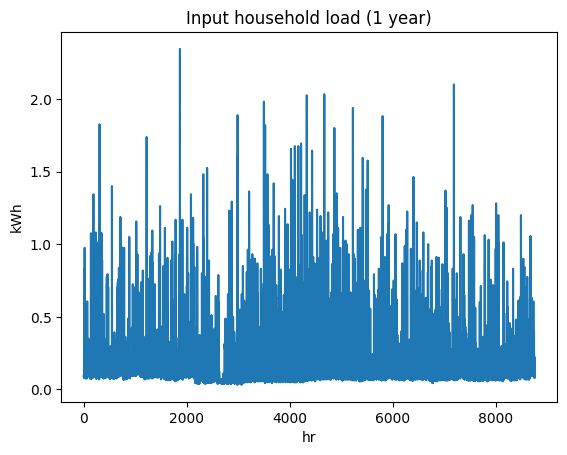

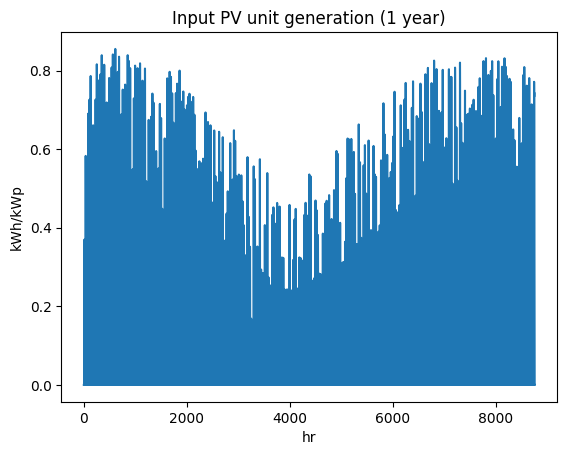

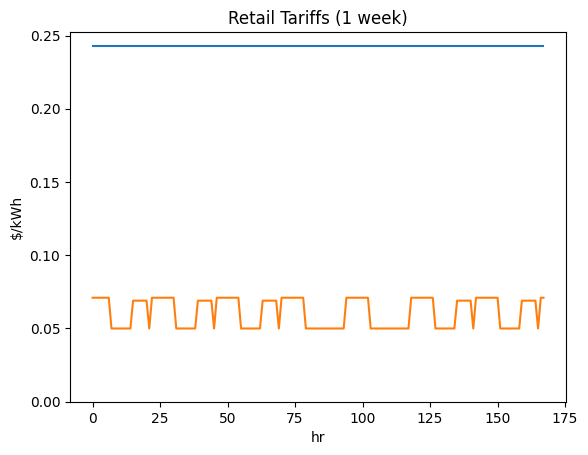

---- Optimising with PV: 1 - 20 kWp, Batt: 0 kWh. Determining PV capacity and dispatch.


************************************ Modell: PV > 1 kWp & BATT > 1 kWh ************************************
{'financial_horizon': 10, 'discount_rate': np.float64(0.06), 'grid_feedin_max': np.float64(5.0), 'pv_eol_capacity': np.float64(0.8), 'pv_eol_years': np.float64(25.0), 'pv_init_soh': np.float64(1.0), 'bess_e2p_ratio': np.float64(2.4), 'bess_roundtrip_eff': np.float64(0.88), 'bess_eol_years': np.float64(10.0), 'bess_eol_capacity': np.float64(0.7), 'bess_eol_cycles': np.float64(10000.0), 'bess_init_soh': np.float64(1.0), 'bess_eff_charge': np.float64(0.938083151964686), 'bess_eff_discharge': np.float64(0.938083151964686), 'scenario_name': 'Scenario_D_+5', 'scenario_set': 'SurfCoast', 'scenario_subset': 'JJP_open', 'year_start': 2022, 'datetime_name': 'DateTime1', 'meter_name': 'pc3012_nmi4361501705', 'solar_name': 'MELB', 'tariff_name_import_wkday': '3_Im_wkday', 'tariff_name_export_wkday': '3_

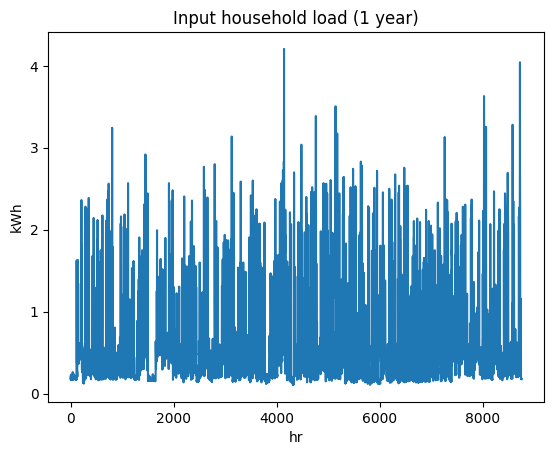

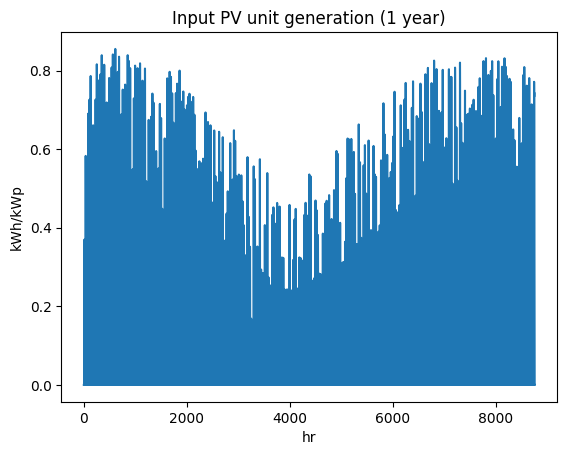

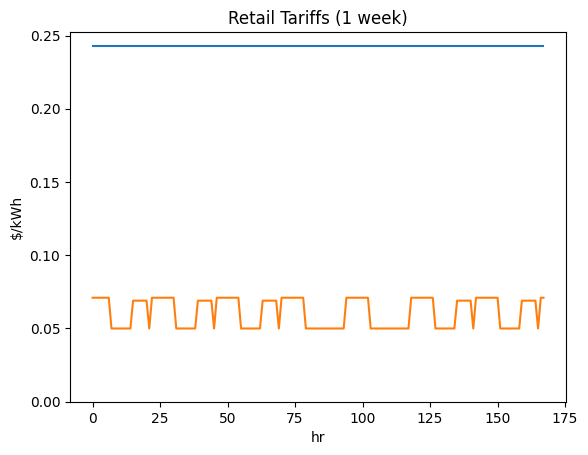

---- Optimising with PV: 1 - 20 kWp, Batt: 0 kWh. Determining PV capacity and dispatch.


************************************ Modell: PV > 1 kWp & BATT > 1 kWh ************************************
{'financial_horizon': 10, 'discount_rate': np.float64(0.06), 'grid_feedin_max': np.float64(5.0), 'pv_eol_capacity': np.float64(0.8), 'pv_eol_years': np.float64(25.0), 'pv_init_soh': np.float64(1.0), 'bess_e2p_ratio': np.float64(2.4), 'bess_roundtrip_eff': np.float64(0.88), 'bess_eol_years': np.float64(10.0), 'bess_eol_capacity': np.float64(0.7), 'bess_eol_cycles': np.float64(10000.0), 'bess_init_soh': np.float64(1.0), 'bess_eff_charge': np.float64(0.938083151964686), 'bess_eff_discharge': np.float64(0.938083151964686), 'scenario_name': 'Scenario_D_+5', 'scenario_set': 'SurfCoast', 'scenario_subset': 'JJP_open', 'year_start': 2022, 'datetime_name': 'DateTime1', 'meter_name': 'pc3058_nmi4462760048', 'solar_name': 'MELB', 'tariff_name_import_wkday': '3_Im_wkday', 'tariff_name_export_wkday': '3_

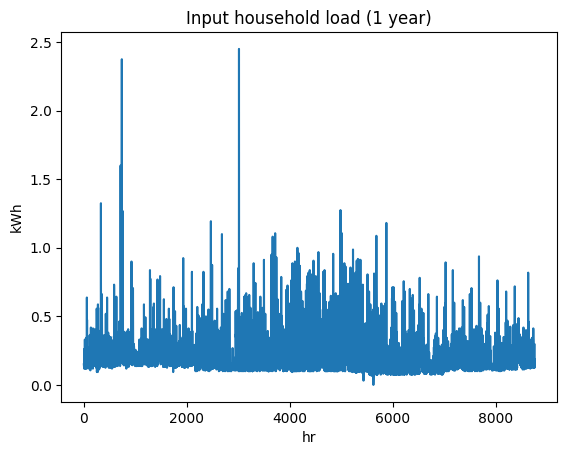

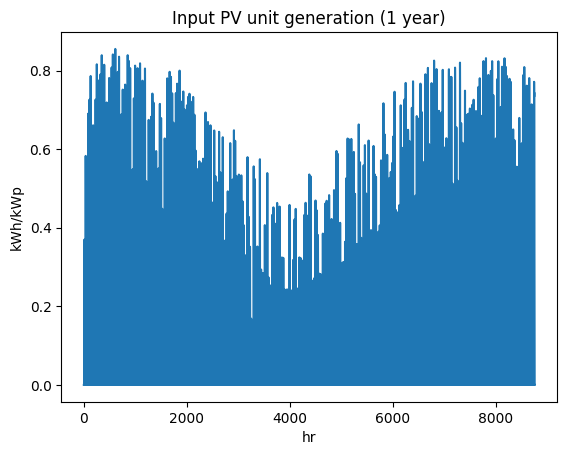

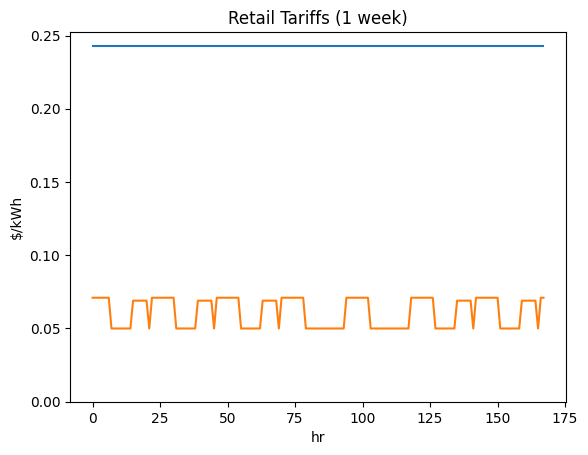

---- Optimising with PV: 1 - 20 kWp, Batt: 0 kWh. Determining PV capacity and dispatch.


************************************ Modell: PV > 1 kWp & BATT > 1 kWh ************************************
{'financial_horizon': 10, 'discount_rate': np.float64(0.06), 'grid_feedin_max': np.float64(5.0), 'pv_eol_capacity': np.float64(0.8), 'pv_eol_years': np.float64(25.0), 'pv_init_soh': np.float64(1.0), 'bess_e2p_ratio': np.float64(2.4), 'bess_roundtrip_eff': np.float64(0.88), 'bess_eol_years': np.float64(10.0), 'bess_eol_capacity': np.float64(0.7), 'bess_eol_cycles': np.float64(10000.0), 'bess_init_soh': np.float64(1.0), 'bess_eff_charge': np.float64(0.938083151964686), 'bess_eff_discharge': np.float64(0.938083151964686), 'scenario_name': 'Scenario_D_+5', 'scenario_set': 'SurfCoast', 'scenario_subset': 'JJP_open', 'year_start': 2022, 'datetime_name': 'DateTime1', 'meter_name': 'pc3081_nmi3914462783', 'solar_name': 'MELB', 'tariff_name_import_wkday': '3_Im_wkday', 'tariff_name_export_wkday': '3_

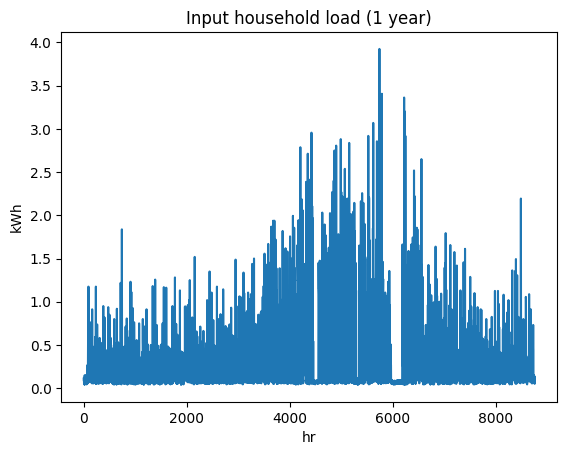

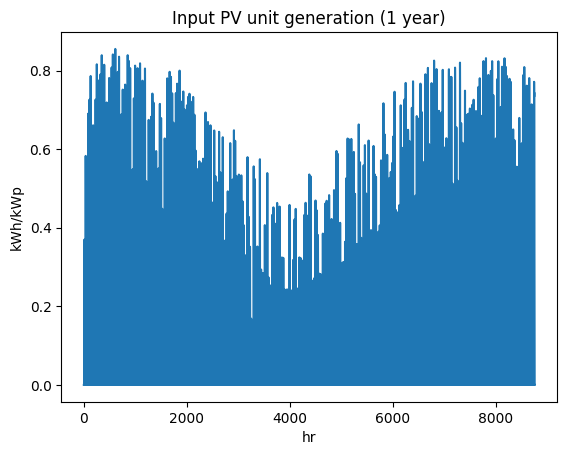

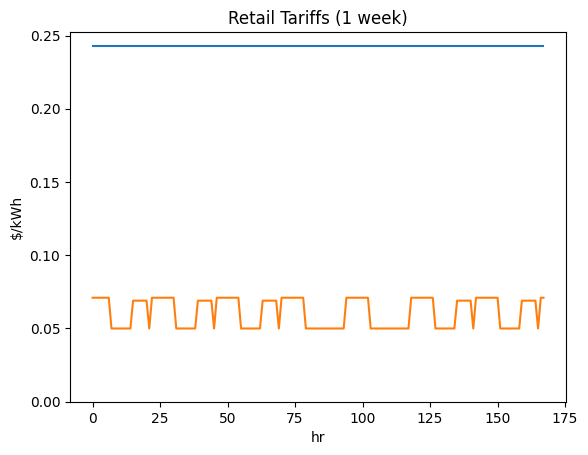

---- Optimising with PV: 1 - 20 kWp, Batt: 0 kWh. Determining PV capacity and dispatch.


************************************ Modell: PV > 1 kWp & BATT > 1 kWh ************************************
{'financial_horizon': 10, 'discount_rate': np.float64(0.06), 'grid_feedin_max': np.float64(5.0), 'pv_eol_capacity': np.float64(0.8), 'pv_eol_years': np.float64(25.0), 'pv_init_soh': np.float64(1.0), 'bess_e2p_ratio': np.float64(2.4), 'bess_roundtrip_eff': np.float64(0.88), 'bess_eol_years': np.float64(10.0), 'bess_eol_capacity': np.float64(0.7), 'bess_eol_cycles': np.float64(10000.0), 'bess_init_soh': np.float64(1.0), 'bess_eff_charge': np.float64(0.938083151964686), 'bess_eff_discharge': np.float64(0.938083151964686), 'scenario_name': 'Scenario_D_+5', 'scenario_set': 'SurfCoast', 'scenario_subset': 'JJP_open', 'year_start': 2022, 'datetime_name': 'DateTime1', 'meter_name': 'pc3058_nmi6140418617', 'solar_name': 'MELB', 'tariff_name_import_wkday': '3_Im_wkday', 'tariff_name_export_wkday': '3_

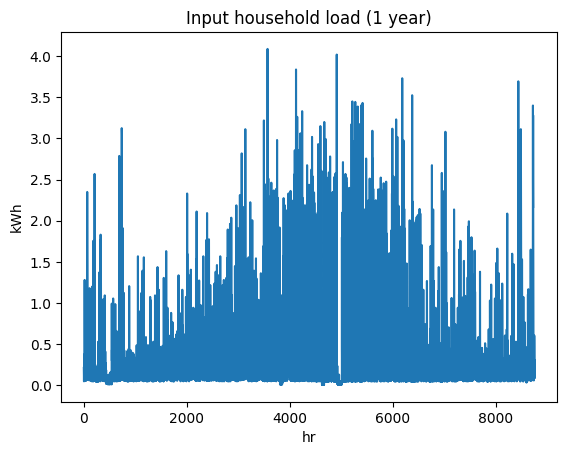

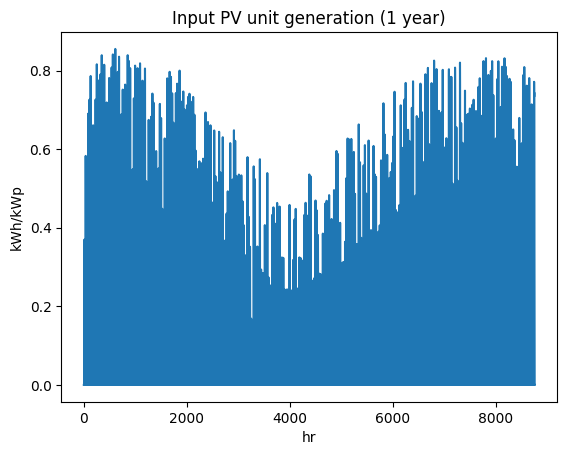

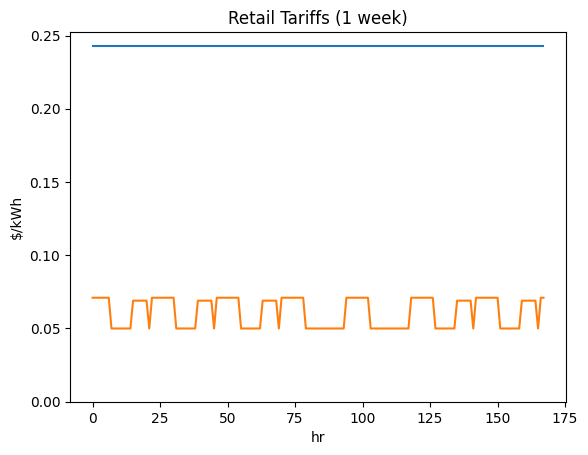

---- Optimising with PV: 1 - 20 kWp, Batt: 0 kWh. Determining PV capacity and dispatch.


************************************ Modell: PV > 1 kWp & BATT > 1 kWh ************************************
{'financial_horizon': 10, 'discount_rate': np.float64(0.06), 'grid_feedin_max': np.float64(5.0), 'pv_eol_capacity': np.float64(0.8), 'pv_eol_years': np.float64(25.0), 'pv_init_soh': np.float64(1.0), 'bess_e2p_ratio': np.float64(2.4), 'bess_roundtrip_eff': np.float64(0.88), 'bess_eol_years': np.float64(10.0), 'bess_eol_capacity': np.float64(0.7), 'bess_eol_cycles': np.float64(10000.0), 'bess_init_soh': np.float64(1.0), 'bess_eff_charge': np.float64(0.938083151964686), 'bess_eff_discharge': np.float64(0.938083151964686), 'scenario_name': 'Scenario_D_+5', 'scenario_set': 'SurfCoast', 'scenario_subset': 'JJP_open', 'year_start': 2022, 'datetime_name': 'DateTime1', 'meter_name': 'pc3058_nmi8545068251', 'solar_name': 'MELB', 'tariff_name_import_wkday': '3_Im_wkday', 'tariff_name_export_wkday': '3_

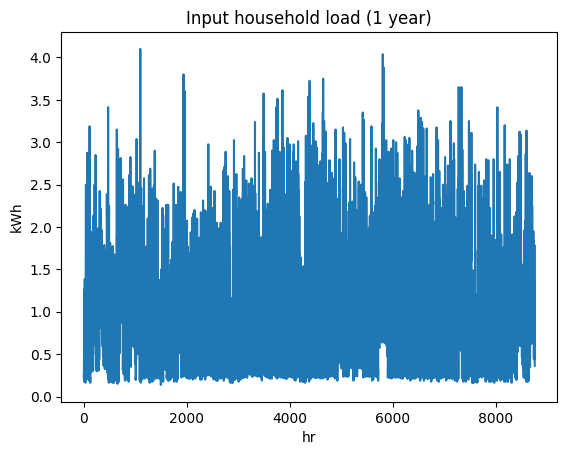

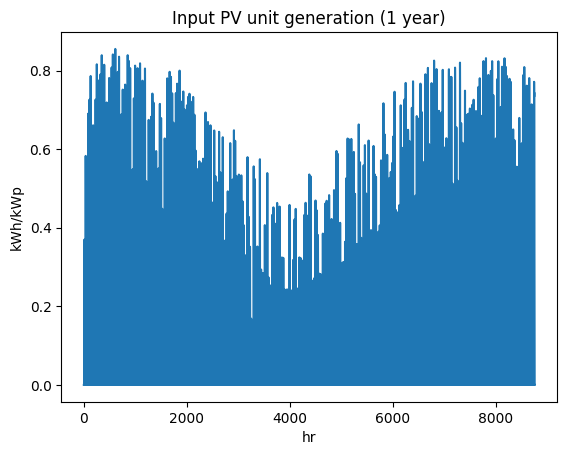

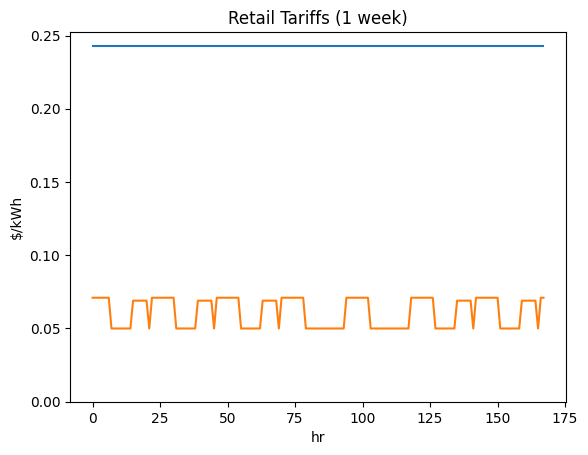

---- Optimising with PV: 1 - 20 kWp, Batt: 0 kWh. Determining PV capacity and dispatch.


************************************ Modell: PV > 1 kWp & BATT > 1 kWh ************************************
{'financial_horizon': 10, 'discount_rate': np.float64(0.06), 'grid_feedin_max': np.float64(5.0), 'pv_eol_capacity': np.float64(0.8), 'pv_eol_years': np.float64(25.0), 'pv_init_soh': np.float64(1.0), 'bess_e2p_ratio': np.float64(2.4), 'bess_roundtrip_eff': np.float64(0.88), 'bess_eol_years': np.float64(10.0), 'bess_eol_capacity': np.float64(0.7), 'bess_eol_cycles': np.float64(10000.0), 'bess_init_soh': np.float64(1.0), 'bess_eff_charge': np.float64(0.938083151964686), 'bess_eff_discharge': np.float64(0.938083151964686), 'scenario_name': 'Scenario_D_+5', 'scenario_set': 'SurfCoast', 'scenario_subset': 'JJP_open', 'year_start': 2022, 'datetime_name': 'DateTime1', 'meter_name': 'pc3084_nmi6353950609', 'solar_name': 'MELB', 'tariff_name_import_wkday': '3_Im_wkday', 'tariff_name_export_wkday': '3_

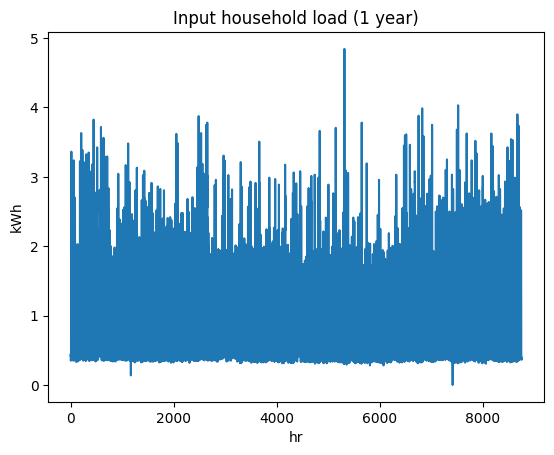

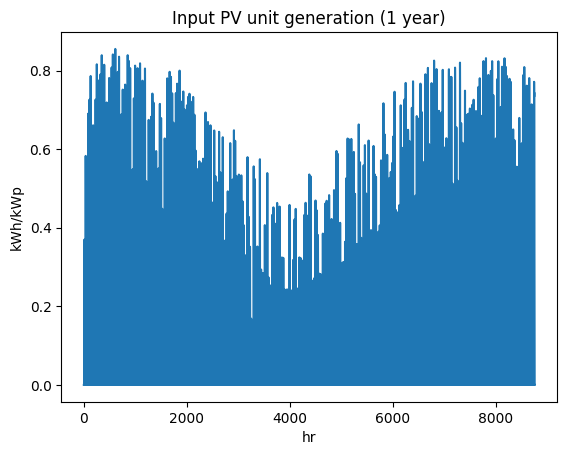

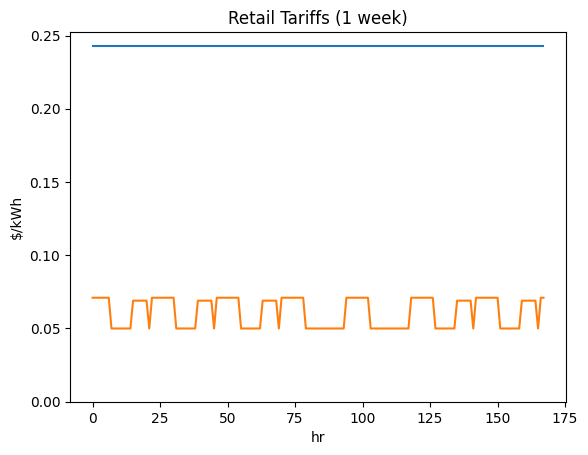

---- Optimising with PV: 1 - 20 kWp, Batt: 0 kWh. Determining PV capacity and dispatch.


************************************ Modell: PV > 1 kWp & BATT > 1 kWh ************************************
{'financial_horizon': 10, 'discount_rate': np.float64(0.06), 'grid_feedin_max': np.float64(5.0), 'pv_eol_capacity': np.float64(0.8), 'pv_eol_years': np.float64(25.0), 'pv_init_soh': np.float64(1.0), 'bess_e2p_ratio': np.float64(2.4), 'bess_roundtrip_eff': np.float64(0.88), 'bess_eol_years': np.float64(10.0), 'bess_eol_capacity': np.float64(0.7), 'bess_eol_cycles': np.float64(10000.0), 'bess_init_soh': np.float64(1.0), 'bess_eff_charge': np.float64(0.938083151964686), 'bess_eff_discharge': np.float64(0.938083151964686), 'scenario_name': 'Scenario_D_+5', 'scenario_set': 'SurfCoast', 'scenario_subset': 'JJP_open', 'year_start': 2022, 'datetime_name': 'DateTime1', 'meter_name': 'pc3016_nmi7780255184', 'solar_name': 'MELB', 'tariff_name_import_wkday': '3_Im_wkday', 'tariff_name_export_wkday': '3_

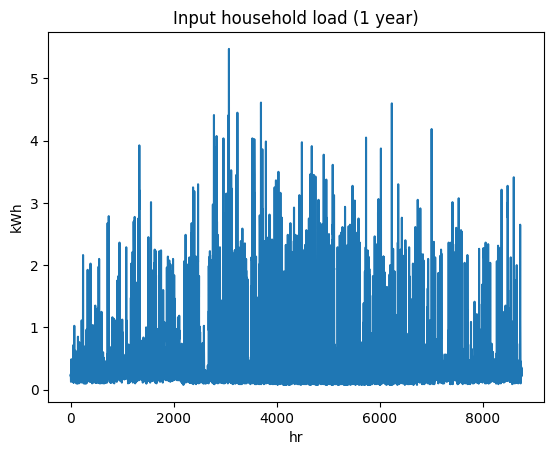

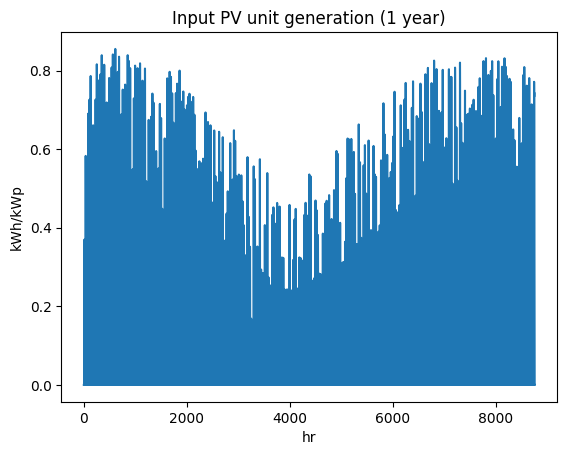

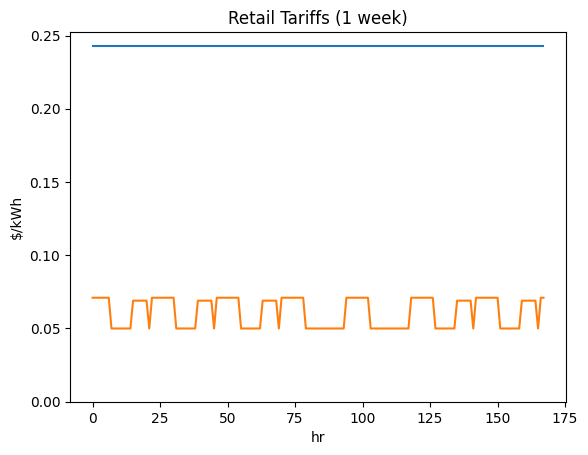

---- Optimising with PV: 1 - 20 kWp, Batt: 0 kWh. Determining PV capacity and dispatch.


************************************ Modell: PV > 1 kWp & BATT > 1 kWh ************************************
{'financial_horizon': 10, 'discount_rate': np.float64(0.06), 'grid_feedin_max': np.float64(5.0), 'pv_eol_capacity': np.float64(0.8), 'pv_eol_years': np.float64(25.0), 'pv_init_soh': np.float64(1.0), 'bess_e2p_ratio': np.float64(2.4), 'bess_roundtrip_eff': np.float64(0.88), 'bess_eol_years': np.float64(10.0), 'bess_eol_capacity': np.float64(0.7), 'bess_eol_cycles': np.float64(10000.0), 'bess_init_soh': np.float64(1.0), 'bess_eff_charge': np.float64(0.938083151964686), 'bess_eff_discharge': np.float64(0.938083151964686), 'scenario_name': 'Scenario_D_+5', 'scenario_set': 'SurfCoast', 'scenario_subset': 'JJP_open', 'year_start': 2022, 'datetime_name': 'DateTime1', 'meter_name': 'pc3072_nmi8685495988', 'solar_name': 'MELB', 'tariff_name_import_wkday': '3_Im_wkday', 'tariff_name_export_wkday': '3_

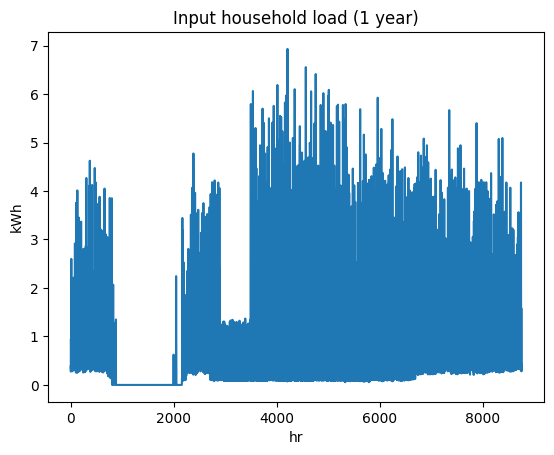

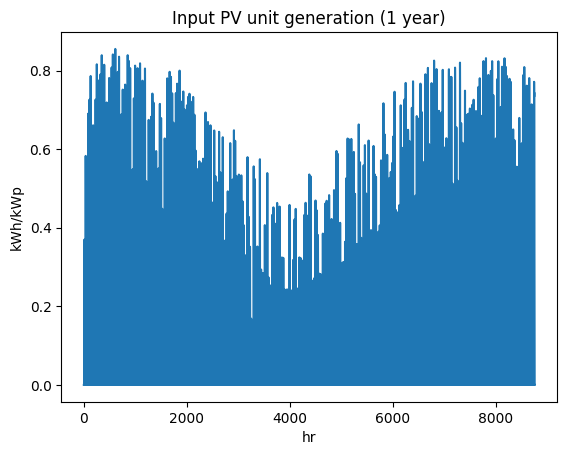

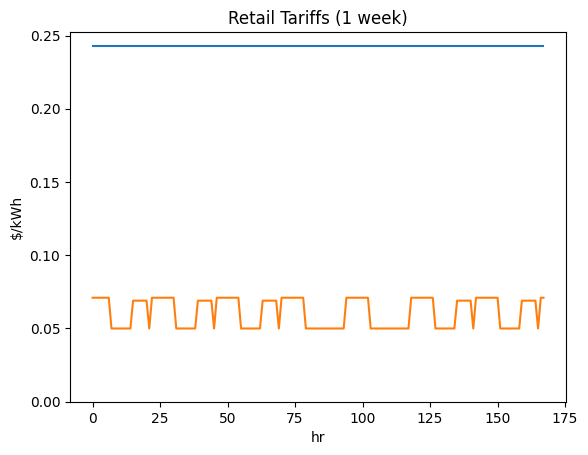

---- Optimising with PV: 1 - 20 kWp, Batt: 0 kWh. Determining PV capacity and dispatch.


************************************ Modell: PV > 1 kWp & BATT > 1 kWh ************************************
{'financial_horizon': 10, 'discount_rate': np.float64(0.06), 'grid_feedin_max': np.float64(5.0), 'pv_eol_capacity': np.float64(0.8), 'pv_eol_years': np.float64(25.0), 'pv_init_soh': np.float64(1.0), 'bess_e2p_ratio': np.float64(2.4), 'bess_roundtrip_eff': np.float64(0.88), 'bess_eol_years': np.float64(10.0), 'bess_eol_capacity': np.float64(0.7), 'bess_eol_cycles': np.float64(10000.0), 'bess_init_soh': np.float64(1.0), 'bess_eff_charge': np.float64(0.938083151964686), 'bess_eff_discharge': np.float64(0.938083151964686), 'scenario_name': 'Scenario_D_+5', 'scenario_set': 'SurfCoast', 'scenario_subset': 'JJP_open', 'year_start': 2022, 'datetime_name': 'DateTime1', 'meter_name': 'pc3012_nmi5889794697', 'solar_name': 'MELB', 'tariff_name_import_wkday': '3_Im_wkday', 'tariff_name_export_wkday': '3_

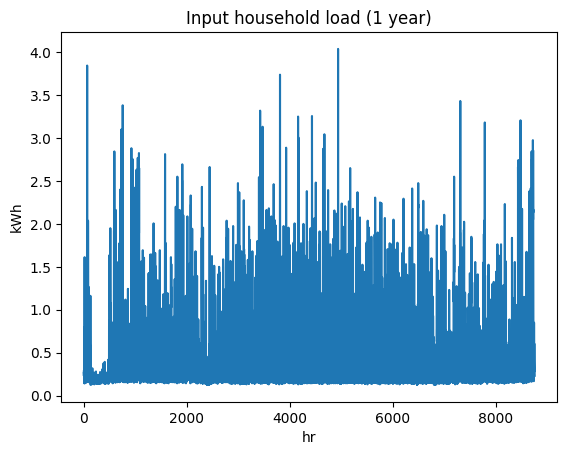

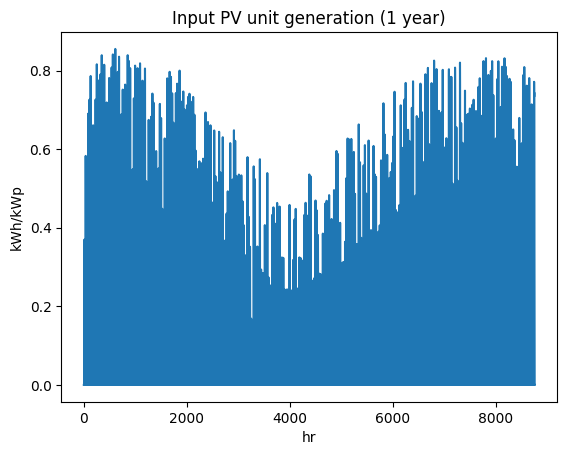

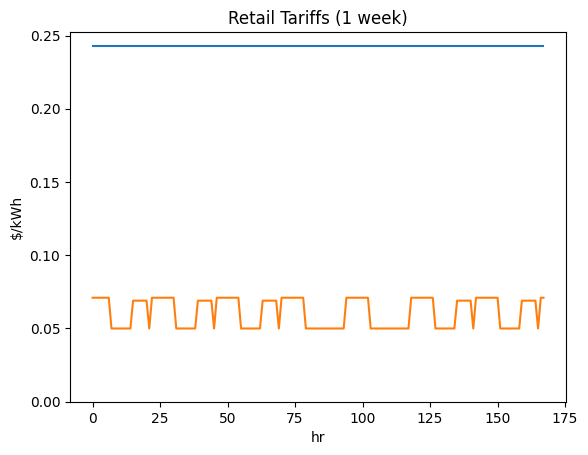

---- Optimising with PV: 1 - 20 kWp, Batt: 0 kWh. Determining PV capacity and dispatch.


************************************ Modell: PV > 1 kWp & BATT > 1 kWh ************************************
{'financial_horizon': 10, 'discount_rate': np.float64(0.06), 'grid_feedin_max': np.float64(5.0), 'pv_eol_capacity': np.float64(0.8), 'pv_eol_years': np.float64(25.0), 'pv_init_soh': np.float64(1.0), 'bess_e2p_ratio': np.float64(2.4), 'bess_roundtrip_eff': np.float64(0.88), 'bess_eol_years': np.float64(10.0), 'bess_eol_capacity': np.float64(0.7), 'bess_eol_cycles': np.float64(10000.0), 'bess_init_soh': np.float64(1.0), 'bess_eff_charge': np.float64(0.938083151964686), 'bess_eff_discharge': np.float64(0.938083151964686), 'scenario_name': 'Scenario_D_+5', 'scenario_set': 'SurfCoast', 'scenario_subset': 'JJP_open', 'year_start': 2022, 'datetime_name': 'DateTime1', 'meter_name': 'pc3040_nmi6983131861', 'solar_name': 'MELB', 'tariff_name_import_wkday': '3_Im_wkday', 'tariff_name_export_wkday': '3_

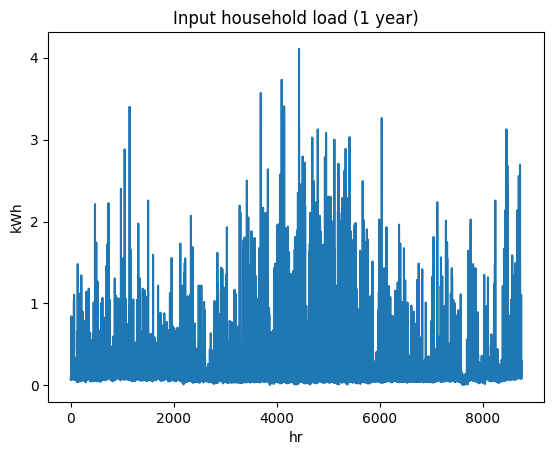

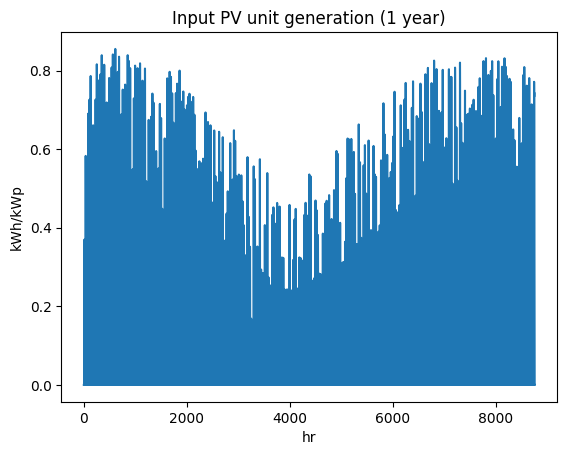

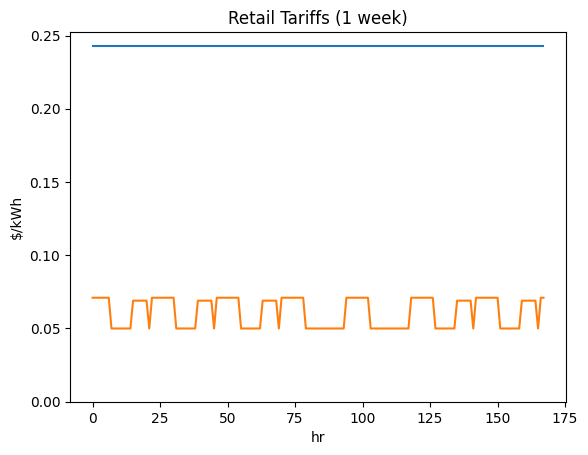

---- Optimising with PV: 1 - 20 kWp, Batt: 0 kWh. Determining PV capacity and dispatch.


************************************ Modell: PV > 1 kWp & BATT > 1 kWh ************************************
{'financial_horizon': 10, 'discount_rate': np.float64(0.06), 'grid_feedin_max': np.float64(5.0), 'pv_eol_capacity': np.float64(0.8), 'pv_eol_years': np.float64(25.0), 'pv_init_soh': np.float64(1.0), 'bess_e2p_ratio': np.float64(2.4), 'bess_roundtrip_eff': np.float64(0.88), 'bess_eol_years': np.float64(10.0), 'bess_eol_capacity': np.float64(0.7), 'bess_eol_cycles': np.float64(10000.0), 'bess_init_soh': np.float64(1.0), 'bess_eff_charge': np.float64(0.938083151964686), 'bess_eff_discharge': np.float64(0.938083151964686), 'scenario_name': 'Scenario_D_+5', 'scenario_set': 'SurfCoast', 'scenario_subset': 'JJP_open', 'year_start': 2022, 'datetime_name': 'DateTime1', 'meter_name': 'pc3040_nmi9768812791', 'solar_name': 'MELB', 'tariff_name_import_wkday': '3_Im_wkday', 'tariff_name_export_wkday': '3_

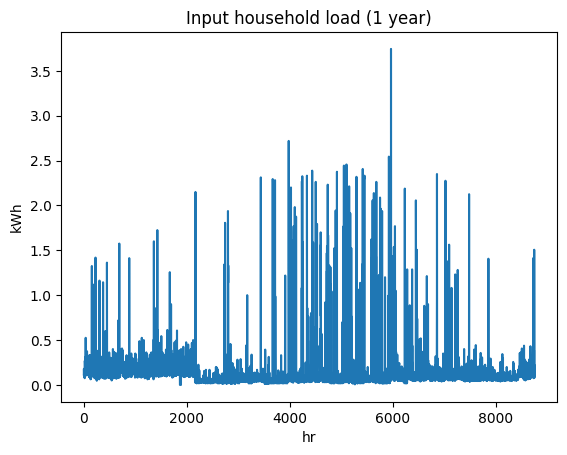

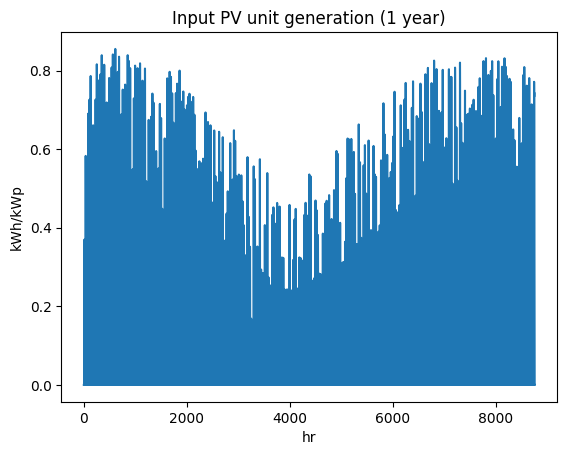

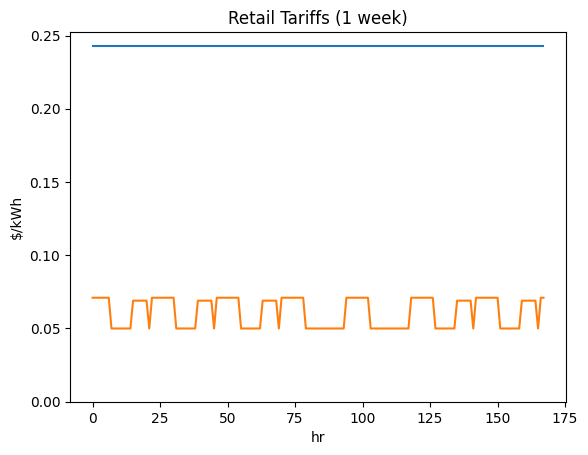

---- Optimising with PV: 1 - 20 kWp, Batt: 0 kWh. Determining PV capacity and dispatch.


************************************ Modell: PV > 1 kWp & BATT > 1 kWh ************************************
{'financial_horizon': 10, 'discount_rate': np.float64(0.06), 'grid_feedin_max': np.float64(5.0), 'pv_eol_capacity': np.float64(0.8), 'pv_eol_years': np.float64(25.0), 'pv_init_soh': np.float64(1.0), 'bess_e2p_ratio': np.float64(2.4), 'bess_roundtrip_eff': np.float64(0.88), 'bess_eol_years': np.float64(10.0), 'bess_eol_capacity': np.float64(0.7), 'bess_eol_cycles': np.float64(10000.0), 'bess_init_soh': np.float64(1.0), 'bess_eff_charge': np.float64(0.938083151964686), 'bess_eff_discharge': np.float64(0.938083151964686), 'scenario_name': 'Scenario_D_+5', 'scenario_set': 'SurfCoast', 'scenario_subset': 'JJP_open', 'year_start': 2022, 'datetime_name': 'DateTime1', 'meter_name': 'pc3072_nmi7754790233', 'solar_name': 'MELB', 'tariff_name_import_wkday': '3_Im_wkday', 'tariff_name_export_wkday': '3_

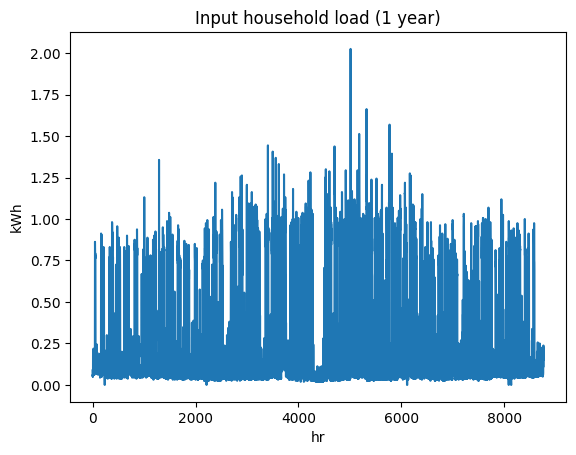

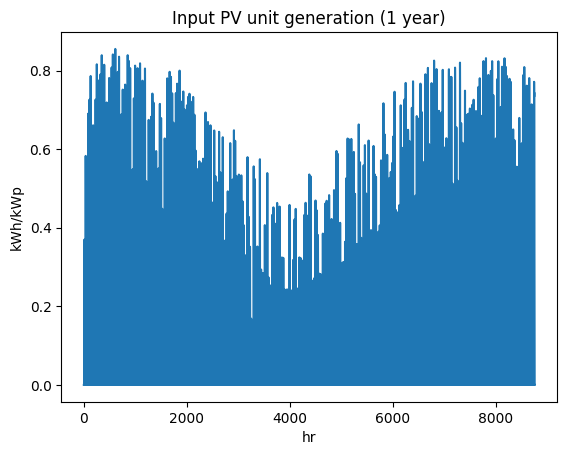

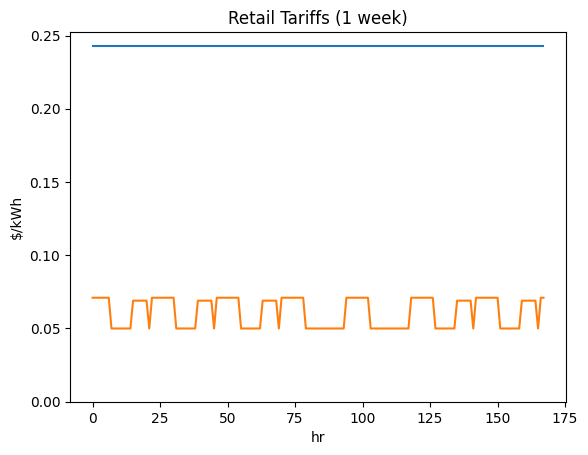

---- Optimising with PV: 1 - 20 kWp, Batt: 0 kWh. Determining PV capacity and dispatch.


************************************ Modell: PV > 1 kWp & BATT > 1 kWh ************************************
{'financial_horizon': 10, 'discount_rate': np.float64(0.06), 'grid_feedin_max': np.float64(5.0), 'pv_eol_capacity': np.float64(0.8), 'pv_eol_years': np.float64(25.0), 'pv_init_soh': np.float64(1.0), 'bess_e2p_ratio': np.float64(2.4), 'bess_roundtrip_eff': np.float64(0.88), 'bess_eol_years': np.float64(10.0), 'bess_eol_capacity': np.float64(0.7), 'bess_eol_cycles': np.float64(10000.0), 'bess_init_soh': np.float64(1.0), 'bess_eff_charge': np.float64(0.938083151964686), 'bess_eff_discharge': np.float64(0.938083151964686), 'scenario_name': 'Scenario_D_+5', 'scenario_set': 'SurfCoast', 'scenario_subset': 'JJP_open', 'year_start': 2022, 'datetime_name': 'DateTime1', 'meter_name': 'pc3072_nmi4828206010', 'solar_name': 'MELB', 'tariff_name_import_wkday': '3_Im_wkday', 'tariff_name_export_wkday': '3_

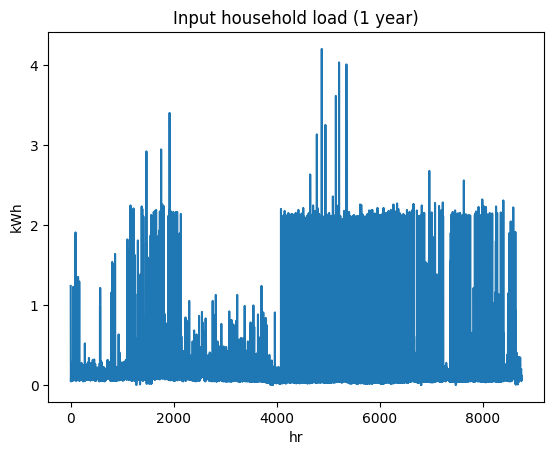

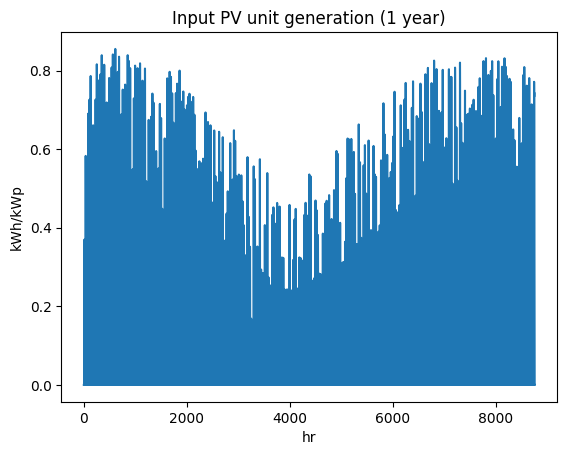

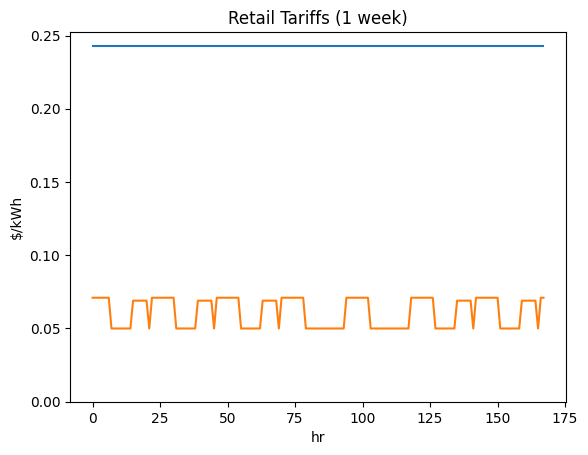

---- Optimising with PV: 1 - 20 kWp, Batt: 0 kWh. Determining PV capacity and dispatch.


************************************ Modell: PV > 1 kWp & BATT > 1 kWh ************************************
{'financial_horizon': 10, 'discount_rate': np.float64(0.06), 'grid_feedin_max': np.float64(5.0), 'pv_eol_capacity': np.float64(0.8), 'pv_eol_years': np.float64(25.0), 'pv_init_soh': np.float64(1.0), 'bess_e2p_ratio': np.float64(2.4), 'bess_roundtrip_eff': np.float64(0.88), 'bess_eol_years': np.float64(10.0), 'bess_eol_capacity': np.float64(0.7), 'bess_eol_cycles': np.float64(10000.0), 'bess_init_soh': np.float64(1.0), 'bess_eff_charge': np.float64(0.938083151964686), 'bess_eff_discharge': np.float64(0.938083151964686), 'scenario_name': 'Scenario_D_+5', 'scenario_set': 'SurfCoast', 'scenario_subset': 'JJP_open', 'year_start': 2022, 'datetime_name': 'DateTime1', 'meter_name': 'pc3072_nmi2190663002', 'solar_name': 'MELB', 'tariff_name_import_wkday': '3_Im_wkday', 'tariff_name_export_wkday': '3_

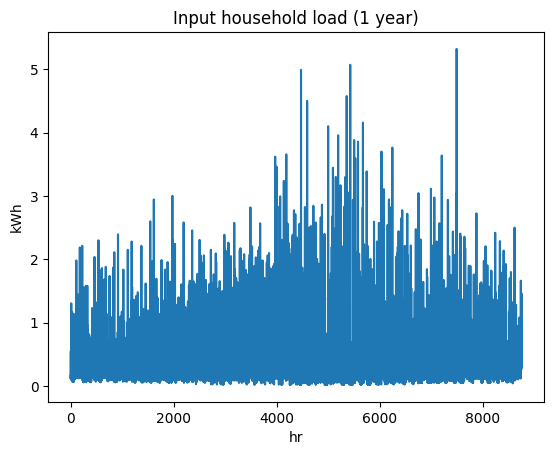

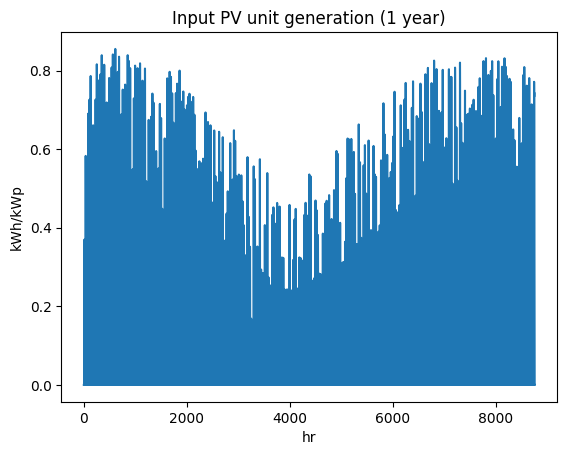

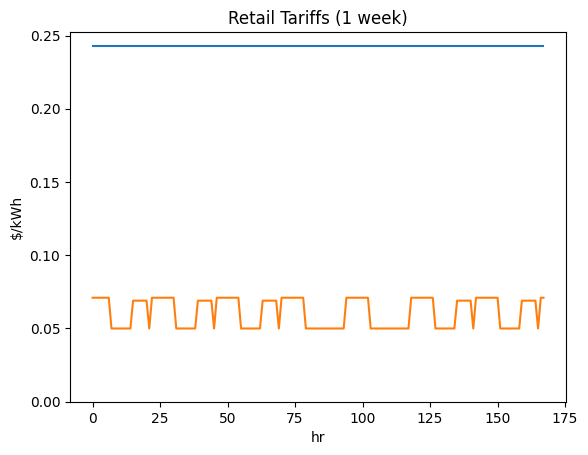

---- Optimising with PV: 1 - 20 kWp, Batt: 0 kWh. Determining PV capacity and dispatch.


************************************ Modell: PV > 1 kWp & BATT > 1 kWh ************************************
{'financial_horizon': 10, 'discount_rate': np.float64(0.06), 'grid_feedin_max': np.float64(5.0), 'pv_eol_capacity': np.float64(0.8), 'pv_eol_years': np.float64(25.0), 'pv_init_soh': np.float64(1.0), 'bess_e2p_ratio': np.float64(2.4), 'bess_roundtrip_eff': np.float64(0.88), 'bess_eol_years': np.float64(10.0), 'bess_eol_capacity': np.float64(0.7), 'bess_eol_cycles': np.float64(10000.0), 'bess_init_soh': np.float64(1.0), 'bess_eff_charge': np.float64(0.938083151964686), 'bess_eff_discharge': np.float64(0.938083151964686), 'scenario_name': 'Scenario_D_+5', 'scenario_set': 'SurfCoast', 'scenario_subset': 'JJP_open', 'year_start': 2022, 'datetime_name': 'DateTime1', 'meter_name': 'pc3012_nmi4253367930', 'solar_name': 'MELB', 'tariff_name_import_wkday': '3_Im_wkday', 'tariff_name_export_wkday': '3_

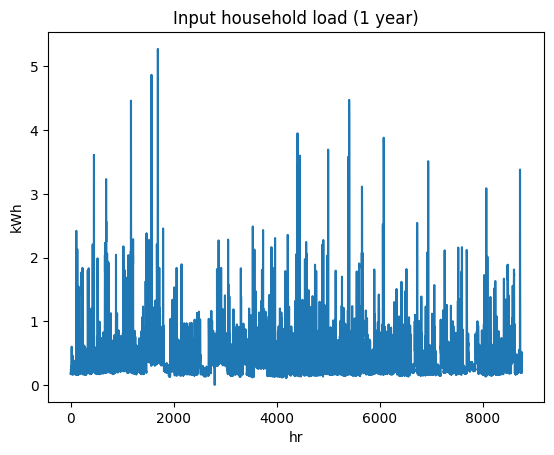

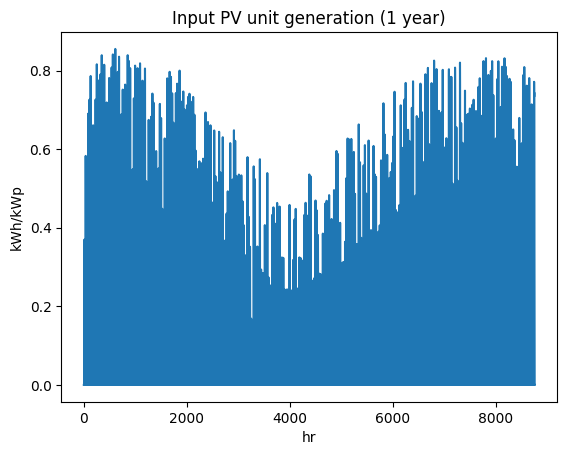

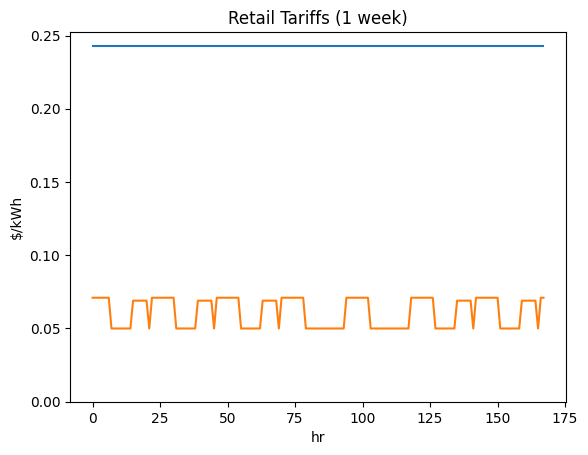

---- Optimising with PV: 1 - 20 kWp, Batt: 0 kWh. Determining PV capacity and dispatch.


************************************ Modell: PV > 1 kWp & BATT > 1 kWh ************************************
{'financial_horizon': 10, 'discount_rate': np.float64(0.06), 'grid_feedin_max': np.float64(5.0), 'pv_eol_capacity': np.float64(0.8), 'pv_eol_years': np.float64(25.0), 'pv_init_soh': np.float64(1.0), 'bess_e2p_ratio': np.float64(2.4), 'bess_roundtrip_eff': np.float64(0.88), 'bess_eol_years': np.float64(10.0), 'bess_eol_capacity': np.float64(0.7), 'bess_eol_cycles': np.float64(10000.0), 'bess_init_soh': np.float64(1.0), 'bess_eff_charge': np.float64(0.938083151964686), 'bess_eff_discharge': np.float64(0.938083151964686), 'scenario_name': 'Scenario_D_+5', 'scenario_set': 'SurfCoast', 'scenario_subset': 'JJP_open', 'year_start': 2022, 'datetime_name': 'DateTime1', 'meter_name': 'pc3012_nmi4189970338', 'solar_name': 'MELB', 'tariff_name_import_wkday': '3_Im_wkday', 'tariff_name_export_wkday': '3_

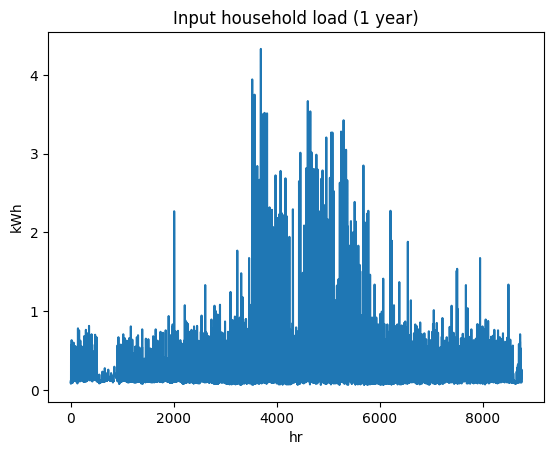

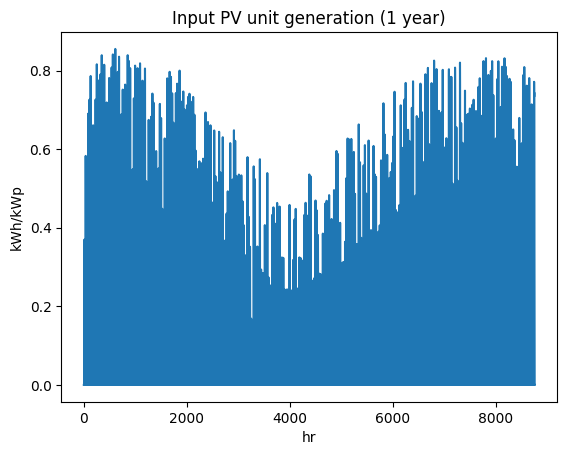

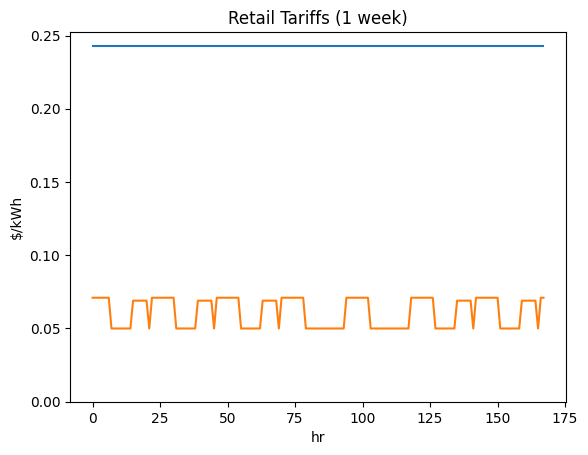

---- Optimising with PV: 1 - 20 kWp, Batt: 0 kWh. Determining PV capacity and dispatch.


************************************ Modell: PV > 1 kWp & BATT > 1 kWh ************************************
{'financial_horizon': 10, 'discount_rate': np.float64(0.06), 'grid_feedin_max': np.float64(5.0), 'pv_eol_capacity': np.float64(0.8), 'pv_eol_years': np.float64(25.0), 'pv_init_soh': np.float64(1.0), 'bess_e2p_ratio': np.float64(2.4), 'bess_roundtrip_eff': np.float64(0.88), 'bess_eol_years': np.float64(10.0), 'bess_eol_capacity': np.float64(0.7), 'bess_eol_cycles': np.float64(10000.0), 'bess_init_soh': np.float64(1.0), 'bess_eff_charge': np.float64(0.938083151964686), 'bess_eff_discharge': np.float64(0.938083151964686), 'scenario_name': 'Scenario_D_+5', 'scenario_set': 'SurfCoast', 'scenario_subset': 'JJP_open', 'year_start': 2022, 'datetime_name': 'DateTime1', 'meter_name': 'pc3012_nmi4935944855', 'solar_name': 'MELB', 'tariff_name_import_wkday': '3_Im_wkday', 'tariff_name_export_wkday': '3_

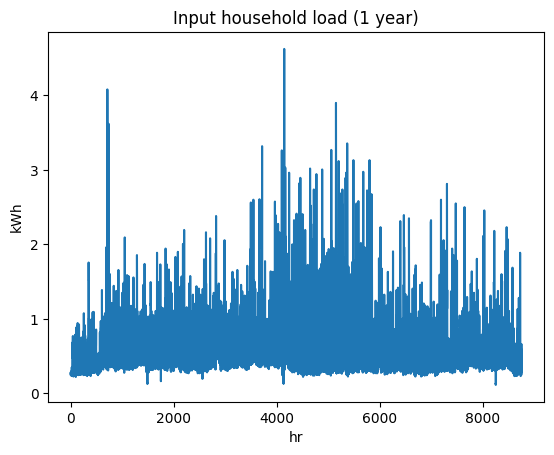

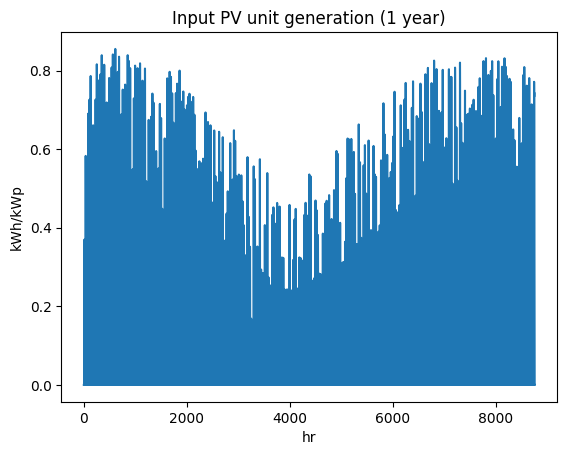

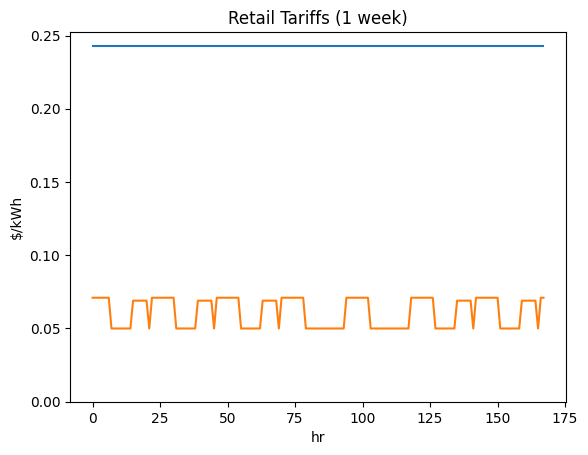

---- Optimising with PV: 1 - 20 kWp, Batt: 0 kWh. Determining PV capacity and dispatch.


************************************ Modell: PV > 1 kWp & BATT > 1 kWh ************************************
{'financial_horizon': 10, 'discount_rate': np.float64(0.06), 'grid_feedin_max': np.float64(5.0), 'pv_eol_capacity': np.float64(0.8), 'pv_eol_years': np.float64(25.0), 'pv_init_soh': np.float64(1.0), 'bess_e2p_ratio': np.float64(2.4), 'bess_roundtrip_eff': np.float64(0.88), 'bess_eol_years': np.float64(10.0), 'bess_eol_capacity': np.float64(0.7), 'bess_eol_cycles': np.float64(10000.0), 'bess_init_soh': np.float64(1.0), 'bess_eff_charge': np.float64(0.938083151964686), 'bess_eff_discharge': np.float64(0.938083151964686), 'scenario_name': 'Scenario_D_+5', 'scenario_set': 'SurfCoast', 'scenario_subset': 'JJP_open', 'year_start': 2022, 'datetime_name': 'DateTime1', 'meter_name': 'pc3012_nmi9544207364', 'solar_name': 'MELB', 'tariff_name_import_wkday': '3_Im_wkday', 'tariff_name_export_wkday': '3_

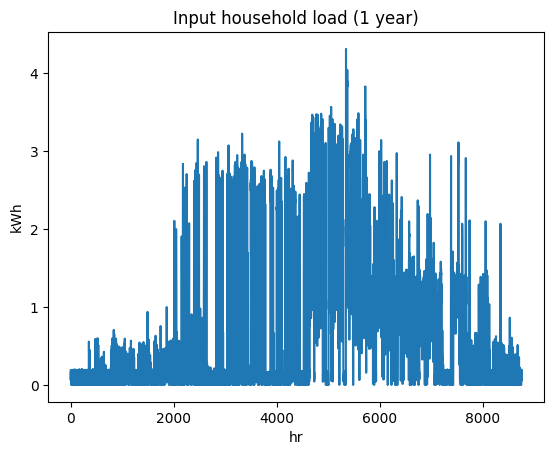

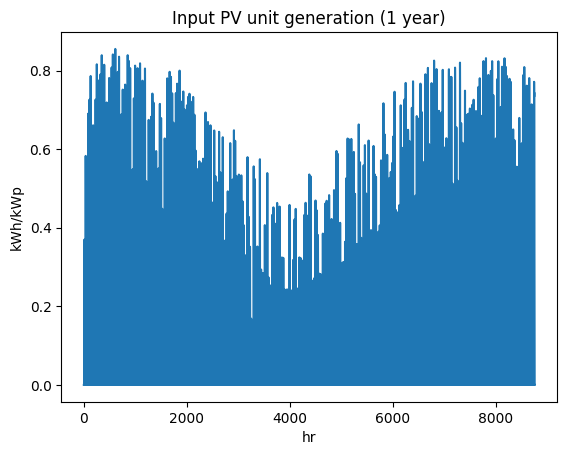

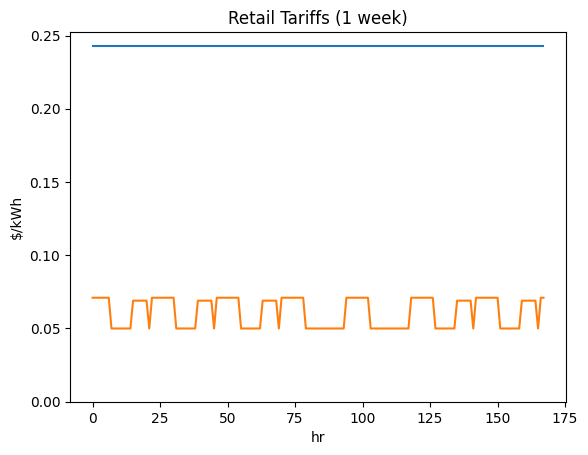

---- Optimising with PV: 1 - 20 kWp, Batt: 0 kWh. Determining PV capacity and dispatch.


************************************ Modell: PV > 1 kWp & BATT > 1 kWh ************************************
{'financial_horizon': 10, 'discount_rate': np.float64(0.06), 'grid_feedin_max': np.float64(5.0), 'pv_eol_capacity': np.float64(0.8), 'pv_eol_years': np.float64(25.0), 'pv_init_soh': np.float64(1.0), 'bess_e2p_ratio': np.float64(2.4), 'bess_roundtrip_eff': np.float64(0.88), 'bess_eol_years': np.float64(10.0), 'bess_eol_capacity': np.float64(0.7), 'bess_eol_cycles': np.float64(10000.0), 'bess_init_soh': np.float64(1.0), 'bess_eff_charge': np.float64(0.938083151964686), 'bess_eff_discharge': np.float64(0.938083151964686), 'scenario_name': 'Scenario_D_+5', 'scenario_set': 'SurfCoast', 'scenario_subset': 'JJP_open', 'year_start': 2022, 'datetime_name': 'DateTime1', 'meter_name': 'pc3012_nmi9138608449', 'solar_name': 'MELB', 'tariff_name_import_wkday': '3_Im_wkday', 'tariff_name_export_wkday': '3_

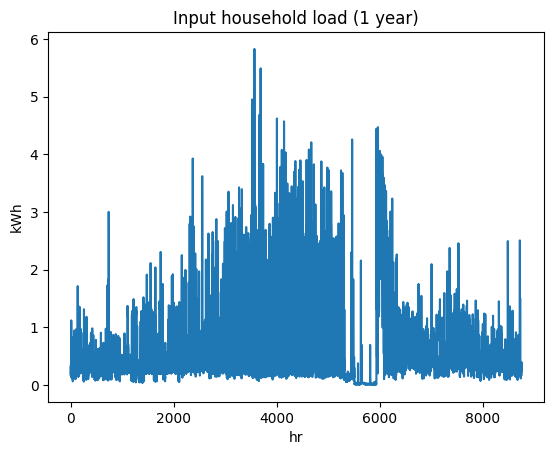

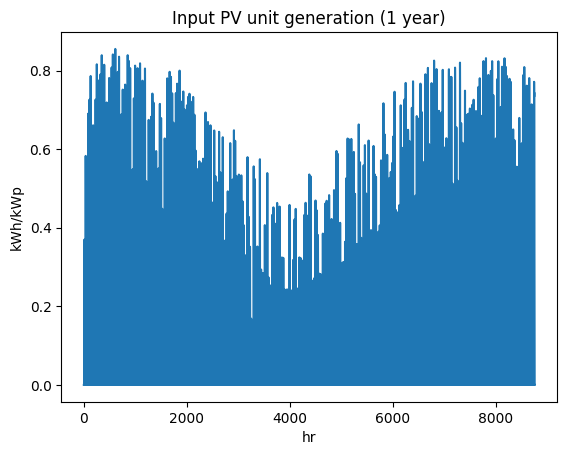

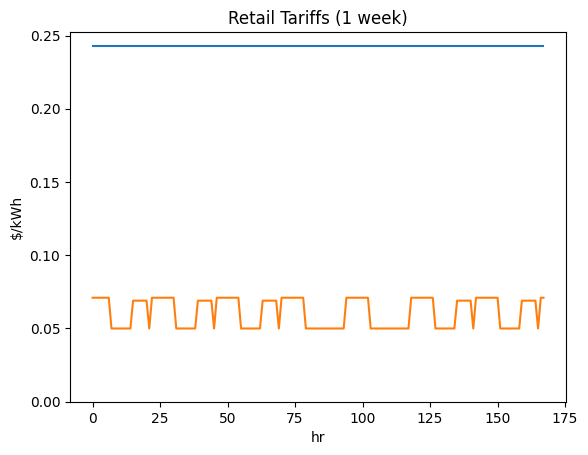

---- Optimising with PV: 1 - 20 kWp, Batt: 0 kWh. Determining PV capacity and dispatch.


************************************ Modell: PV > 1 kWp & BATT > 1 kWh ************************************
{'financial_horizon': 10, 'discount_rate': np.float64(0.06), 'grid_feedin_max': np.float64(5.0), 'pv_eol_capacity': np.float64(0.8), 'pv_eol_years': np.float64(25.0), 'pv_init_soh': np.float64(1.0), 'bess_e2p_ratio': np.float64(2.4), 'bess_roundtrip_eff': np.float64(0.88), 'bess_eol_years': np.float64(10.0), 'bess_eol_capacity': np.float64(0.7), 'bess_eol_cycles': np.float64(10000.0), 'bess_init_soh': np.float64(1.0), 'bess_eff_charge': np.float64(0.938083151964686), 'bess_eff_discharge': np.float64(0.938083151964686), 'scenario_name': 'Scenario_D_+5', 'scenario_set': 'SurfCoast', 'scenario_subset': 'JJP_open', 'year_start': 2022, 'datetime_name': 'DateTime1', 'meter_name': 'pc3012_nmi4392661387', 'solar_name': 'MELB', 'tariff_name_import_wkday': '3_Im_wkday', 'tariff_name_export_wkday': '3_

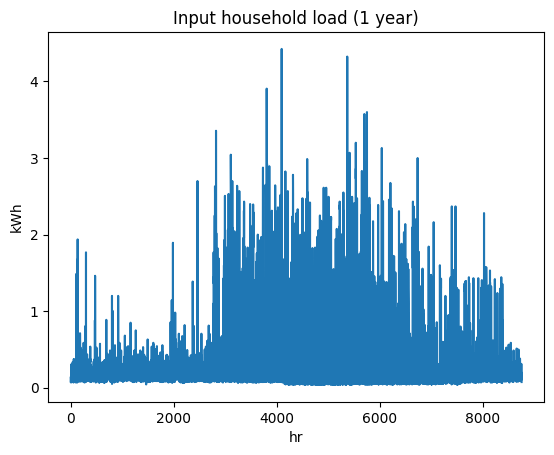

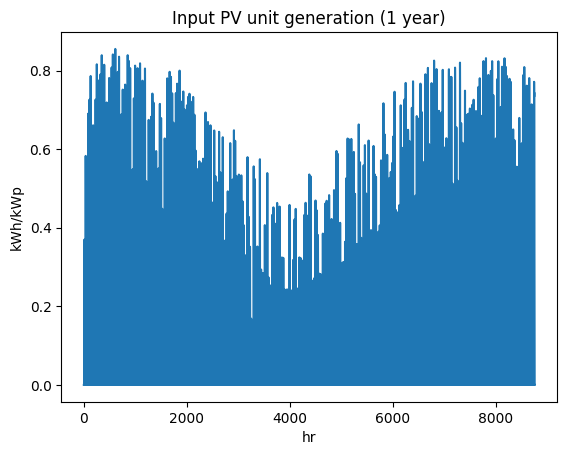

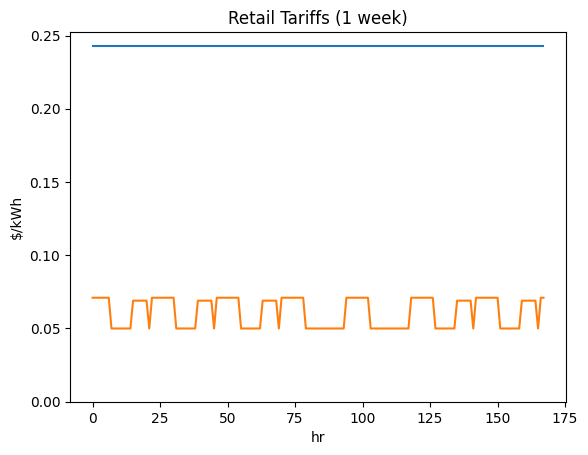

---- Optimising with PV: 1 - 20 kWp, Batt: 0 kWh. Determining PV capacity and dispatch.


************************************ Modell: PV > 1 kWp & BATT > 1 kWh ************************************
{'financial_horizon': 10, 'discount_rate': np.float64(0.06), 'grid_feedin_max': np.float64(5.0), 'pv_eol_capacity': np.float64(0.8), 'pv_eol_years': np.float64(25.0), 'pv_init_soh': np.float64(1.0), 'bess_e2p_ratio': np.float64(2.4), 'bess_roundtrip_eff': np.float64(0.88), 'bess_eol_years': np.float64(10.0), 'bess_eol_capacity': np.float64(0.7), 'bess_eol_cycles': np.float64(10000.0), 'bess_init_soh': np.float64(1.0), 'bess_eff_charge': np.float64(0.938083151964686), 'bess_eff_discharge': np.float64(0.938083151964686), 'scenario_name': 'Scenario_D_+5', 'scenario_set': 'SurfCoast', 'scenario_subset': 'JJP_open', 'year_start': 2022, 'datetime_name': 'DateTime1', 'meter_name': 'pc3012_nmi5332818427', 'solar_name': 'MELB', 'tariff_name_import_wkday': '3_Im_wkday', 'tariff_name_export_wkday': '3_

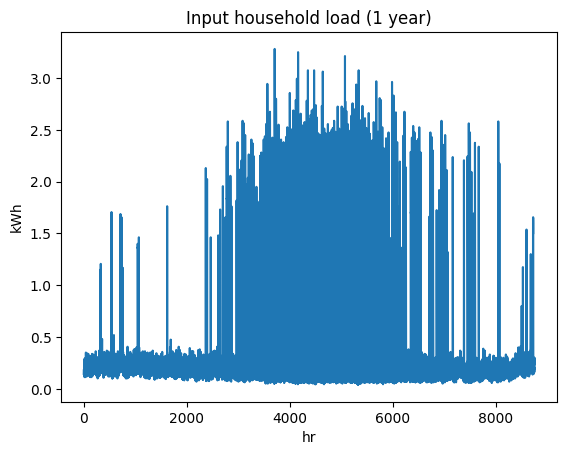

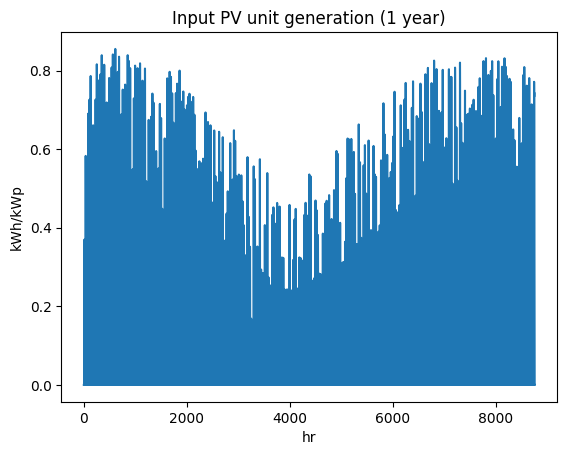

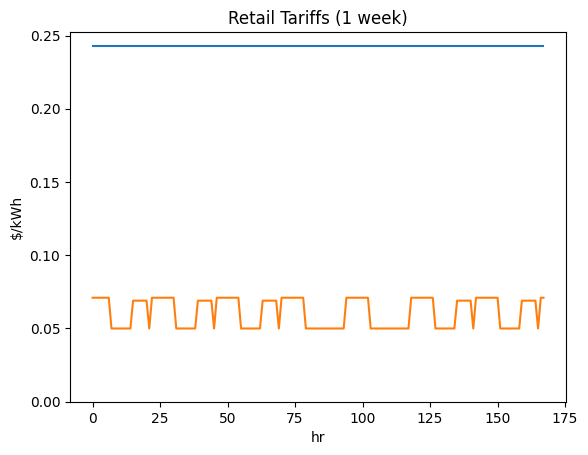

---- Optimising with PV: 1 - 20 kWp, Batt: 0 kWh. Determining PV capacity and dispatch.


************************************ Modell: PV > 1 kWp & BATT > 1 kWh ************************************
{'financial_horizon': 10, 'discount_rate': np.float64(0.06), 'grid_feedin_max': np.float64(5.0), 'pv_eol_capacity': np.float64(0.8), 'pv_eol_years': np.float64(25.0), 'pv_init_soh': np.float64(1.0), 'bess_e2p_ratio': np.float64(2.4), 'bess_roundtrip_eff': np.float64(0.88), 'bess_eol_years': np.float64(10.0), 'bess_eol_capacity': np.float64(0.7), 'bess_eol_cycles': np.float64(10000.0), 'bess_init_soh': np.float64(1.0), 'bess_eff_charge': np.float64(0.938083151964686), 'bess_eff_discharge': np.float64(0.938083151964686), 'scenario_name': 'Scenario_D_+5', 'scenario_set': 'SurfCoast', 'scenario_subset': 'JJP_open', 'year_start': 2022, 'datetime_name': 'DateTime1', 'meter_name': 'pc3012_nmi3927314526', 'solar_name': 'MELB', 'tariff_name_import_wkday': '3_Im_wkday', 'tariff_name_export_wkday': '3_

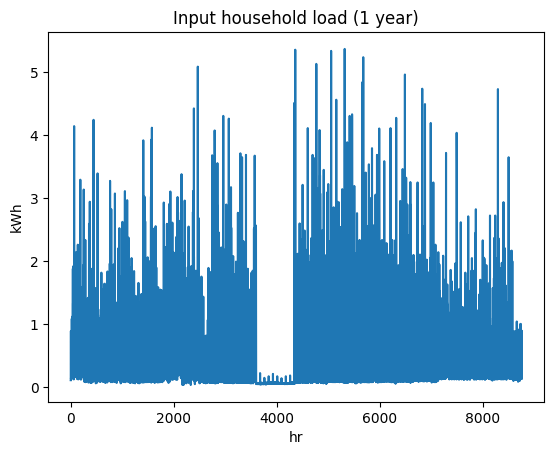

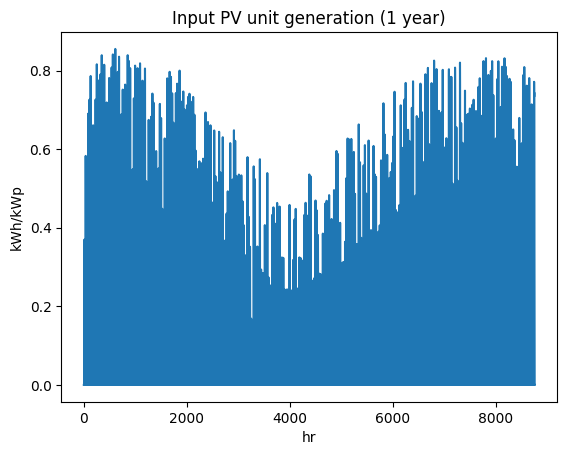

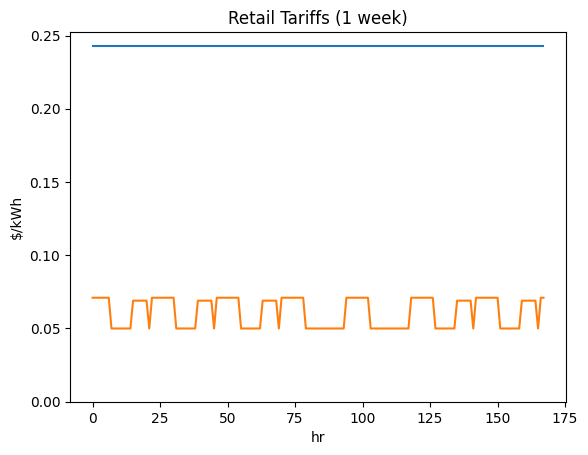

---- Optimising with PV: 1 - 20 kWp, Batt: 0 kWh. Determining PV capacity and dispatch.


************************************ Modell: PV > 1 kWp & BATT > 1 kWh ************************************
{'financial_horizon': 10, 'discount_rate': np.float64(0.06), 'grid_feedin_max': np.float64(5.0), 'pv_eol_capacity': np.float64(0.8), 'pv_eol_years': np.float64(25.0), 'pv_init_soh': np.float64(1.0), 'bess_e2p_ratio': np.float64(2.4), 'bess_roundtrip_eff': np.float64(0.88), 'bess_eol_years': np.float64(10.0), 'bess_eol_capacity': np.float64(0.7), 'bess_eol_cycles': np.float64(10000.0), 'bess_init_soh': np.float64(1.0), 'bess_eff_charge': np.float64(0.938083151964686), 'bess_eff_discharge': np.float64(0.938083151964686), 'scenario_name': 'Scenario_D_+5', 'scenario_set': 'SurfCoast', 'scenario_subset': 'JJP_open', 'year_start': 2022, 'datetime_name': 'DateTime1', 'meter_name': 'pc3012_nmi2268924645', 'solar_name': 'MELB', 'tariff_name_import_wkday': '3_Im_wkday', 'tariff_name_export_wkday': '3_

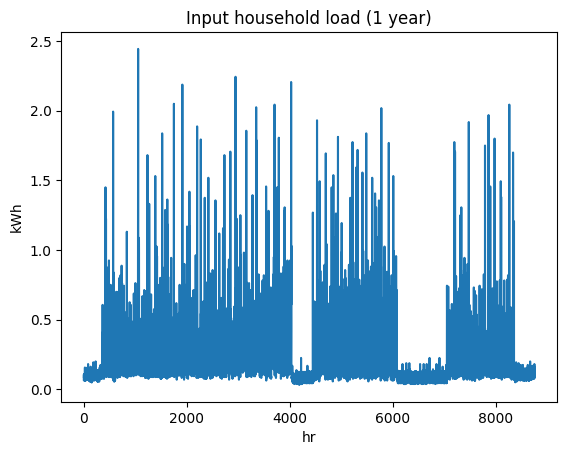

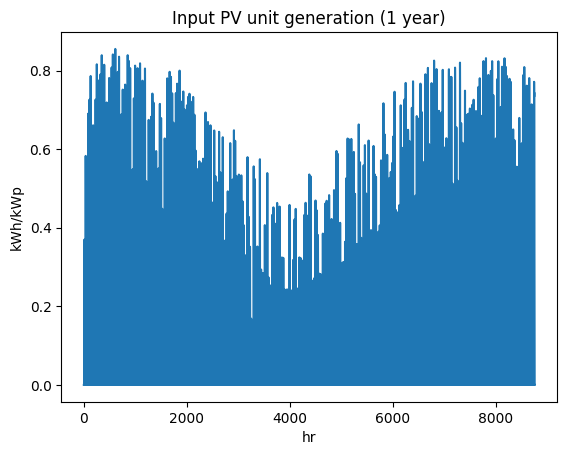

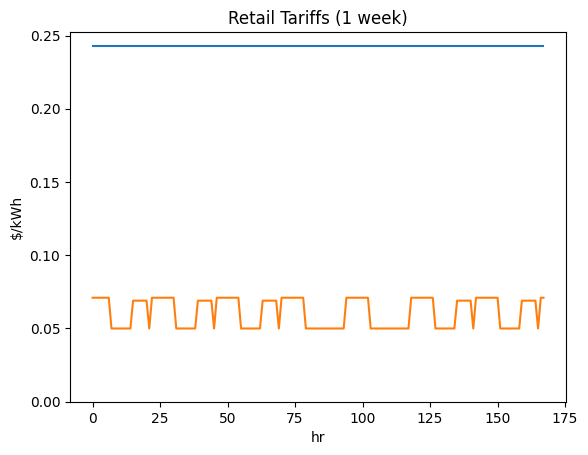

---- Optimising with PV: 1 - 20 kWp, Batt: 0 kWh. Determining PV capacity and dispatch.


************************************ Modell: PV > 1 kWp & BATT > 1 kWh ************************************
{'financial_horizon': 10, 'discount_rate': np.float64(0.06), 'grid_feedin_max': np.float64(5.0), 'pv_eol_capacity': np.float64(0.8), 'pv_eol_years': np.float64(25.0), 'pv_init_soh': np.float64(1.0), 'bess_e2p_ratio': np.float64(2.4), 'bess_roundtrip_eff': np.float64(0.88), 'bess_eol_years': np.float64(10.0), 'bess_eol_capacity': np.float64(0.7), 'bess_eol_cycles': np.float64(10000.0), 'bess_init_soh': np.float64(1.0), 'bess_eff_charge': np.float64(0.938083151964686), 'bess_eff_discharge': np.float64(0.938083151964686), 'scenario_name': 'Scenario_D_+5', 'scenario_set': 'SurfCoast', 'scenario_subset': 'JJP_open', 'year_start': 2022, 'datetime_name': 'DateTime1', 'meter_name': 'pc3012_nmi7764127461', 'solar_name': 'MELB', 'tariff_name_import_wkday': '3_Im_wkday', 'tariff_name_export_wkday': '3_

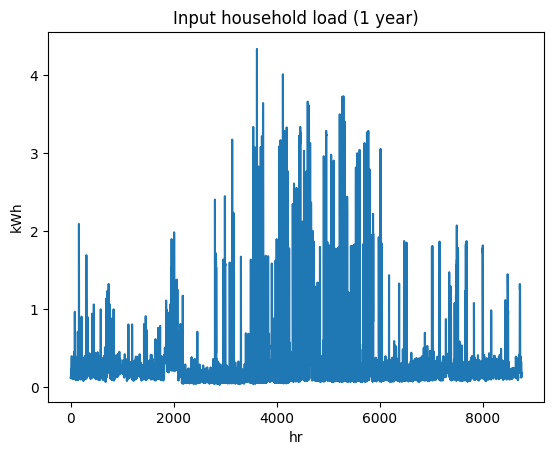

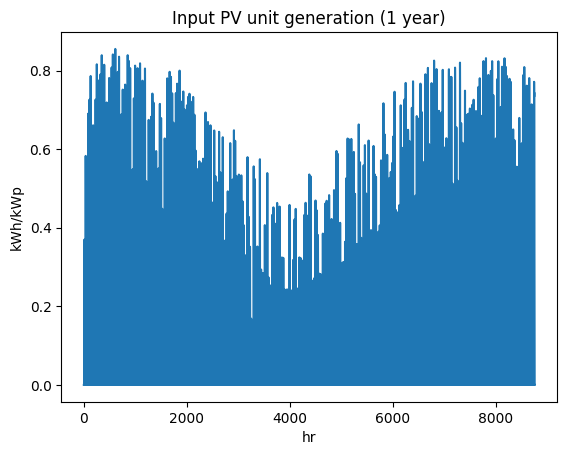

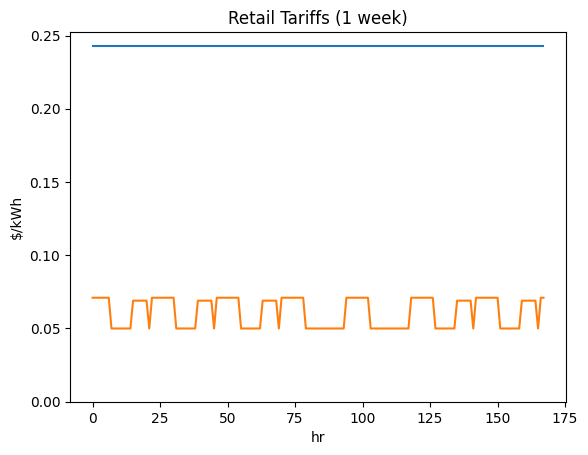

---- Optimising with PV: 1 - 20 kWp, Batt: 0 kWh. Determining PV capacity and dispatch.


************************************ Modell: PV > 1 kWp & BATT > 1 kWh ************************************
{'financial_horizon': 10, 'discount_rate': np.float64(0.06), 'grid_feedin_max': np.float64(5.0), 'pv_eol_capacity': np.float64(0.8), 'pv_eol_years': np.float64(25.0), 'pv_init_soh': np.float64(1.0), 'bess_e2p_ratio': np.float64(2.4), 'bess_roundtrip_eff': np.float64(0.88), 'bess_eol_years': np.float64(10.0), 'bess_eol_capacity': np.float64(0.7), 'bess_eol_cycles': np.float64(10000.0), 'bess_init_soh': np.float64(1.0), 'bess_eff_charge': np.float64(0.938083151964686), 'bess_eff_discharge': np.float64(0.938083151964686), 'scenario_name': 'Scenario_D_+5', 'scenario_set': 'SurfCoast', 'scenario_subset': 'JJP_open', 'year_start': 2022, 'datetime_name': 'DateTime1', 'meter_name': 'pc3012_nmi9699213614', 'solar_name': 'MELB', 'tariff_name_import_wkday': '3_Im_wkday', 'tariff_name_export_wkday': '3_

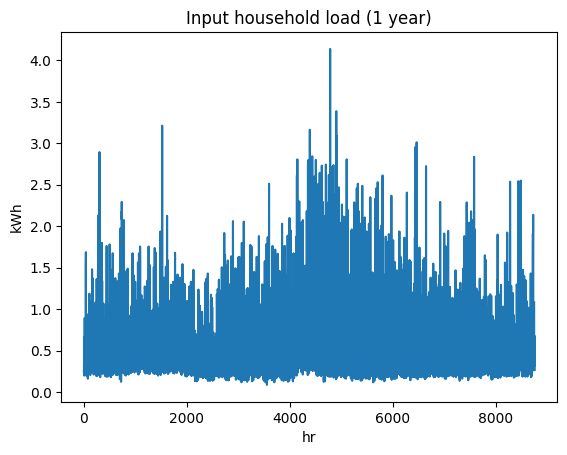

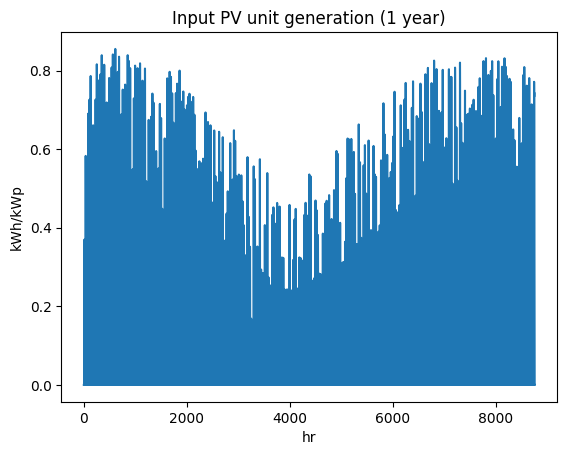

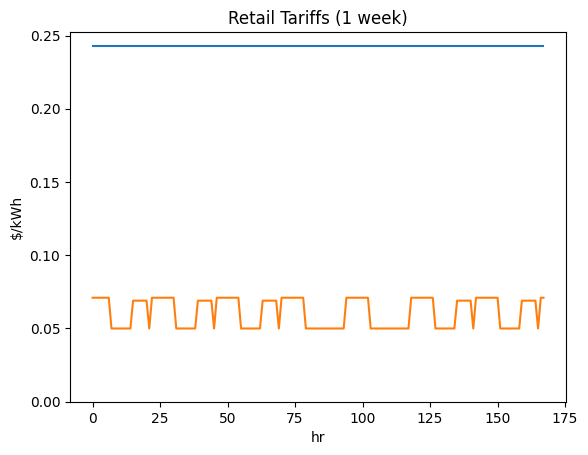

---- Optimising with PV: 1 - 20 kWp, Batt: 0 kWh. Determining PV capacity and dispatch.


************************************ Modell: PV > 1 kWp & BATT > 1 kWh ************************************
{'financial_horizon': 10, 'discount_rate': np.float64(0.06), 'grid_feedin_max': np.float64(5.0), 'pv_eol_capacity': np.float64(0.8), 'pv_eol_years': np.float64(25.0), 'pv_init_soh': np.float64(1.0), 'bess_e2p_ratio': np.float64(2.4), 'bess_roundtrip_eff': np.float64(0.88), 'bess_eol_years': np.float64(10.0), 'bess_eol_capacity': np.float64(0.7), 'bess_eol_cycles': np.float64(10000.0), 'bess_init_soh': np.float64(1.0), 'bess_eff_charge': np.float64(0.938083151964686), 'bess_eff_discharge': np.float64(0.938083151964686), 'scenario_name': 'Scenario_D_+5', 'scenario_set': 'SurfCoast', 'scenario_subset': 'JJP_open', 'year_start': 2022, 'datetime_name': 'DateTime1', 'meter_name': 'pc3011_nmi3373717842', 'solar_name': 'MELB', 'tariff_name_import_wkday': '3_Im_wkday', 'tariff_name_export_wkday': '3_

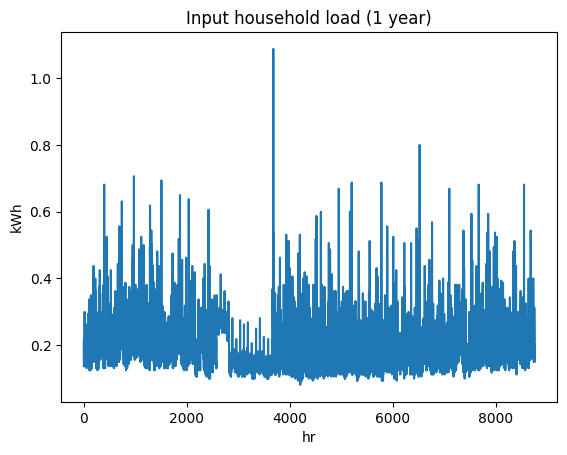

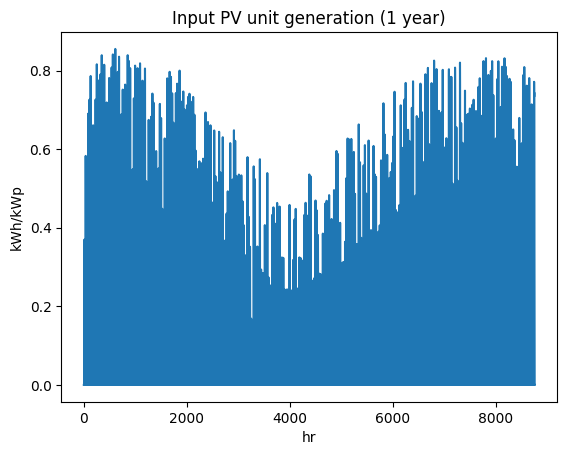

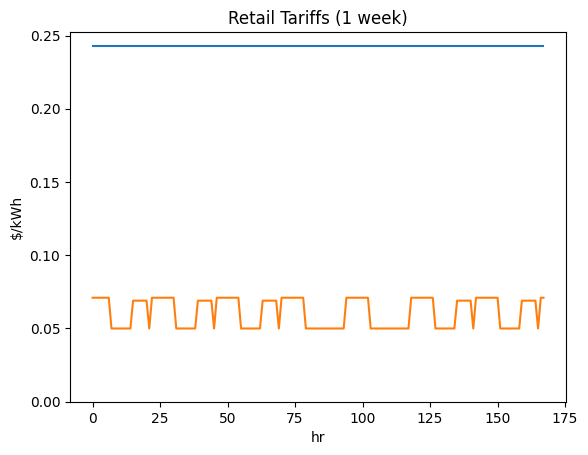

---- Optimising with PV: 1 - 20 kWp, Batt: 0 kWh. Determining PV capacity and dispatch.


************************************ Modell: PV > 1 kWp & BATT > 1 kWh ************************************
{'financial_horizon': 10, 'discount_rate': np.float64(0.06), 'grid_feedin_max': np.float64(5.0), 'pv_eol_capacity': np.float64(0.8), 'pv_eol_years': np.float64(25.0), 'pv_init_soh': np.float64(1.0), 'bess_e2p_ratio': np.float64(2.4), 'bess_roundtrip_eff': np.float64(0.88), 'bess_eol_years': np.float64(10.0), 'bess_eol_capacity': np.float64(0.7), 'bess_eol_cycles': np.float64(10000.0), 'bess_init_soh': np.float64(1.0), 'bess_eff_charge': np.float64(0.938083151964686), 'bess_eff_discharge': np.float64(0.938083151964686), 'scenario_name': 'Scenario_D_+5', 'scenario_set': 'SurfCoast', 'scenario_subset': 'JJP_open', 'year_start': 2022, 'datetime_name': 'DateTime1', 'meter_name': 'pc3012_nmi5500780639', 'solar_name': 'MELB', 'tariff_name_import_wkday': '3_Im_wkday', 'tariff_name_export_wkday': '3_

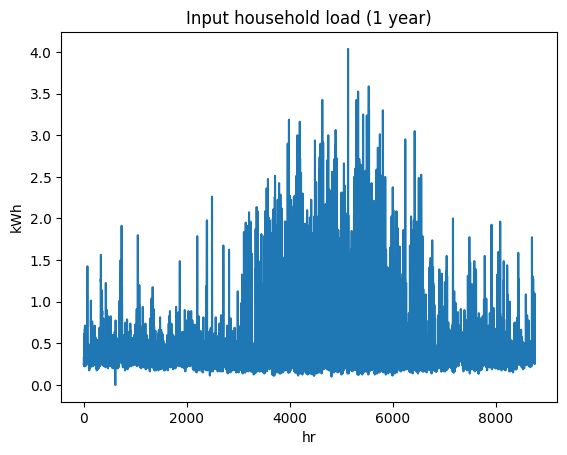

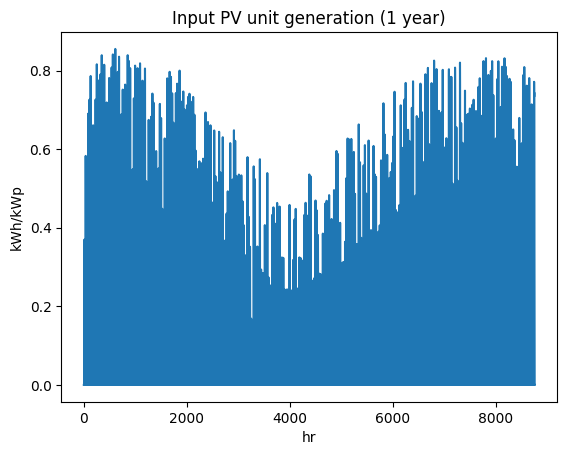

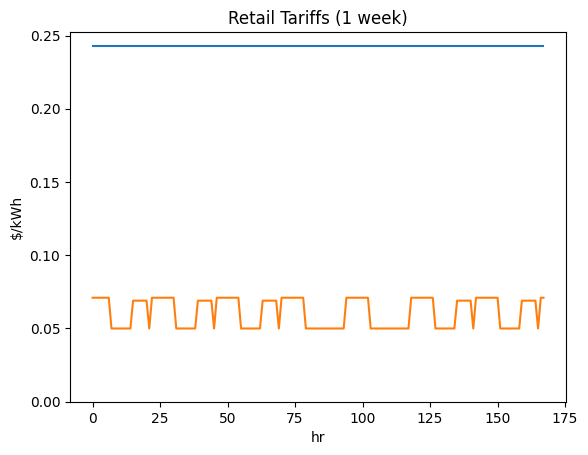

---- Optimising with PV: 1 - 20 kWp, Batt: 0 kWh. Determining PV capacity and dispatch.


************************************ Modell: PV > 1 kWp & BATT > 1 kWh ************************************
{'financial_horizon': 10, 'discount_rate': np.float64(0.06), 'grid_feedin_max': np.float64(5.0), 'pv_eol_capacity': np.float64(0.8), 'pv_eol_years': np.float64(25.0), 'pv_init_soh': np.float64(1.0), 'bess_e2p_ratio': np.float64(2.4), 'bess_roundtrip_eff': np.float64(0.88), 'bess_eol_years': np.float64(10.0), 'bess_eol_capacity': np.float64(0.7), 'bess_eol_cycles': np.float64(10000.0), 'bess_init_soh': np.float64(1.0), 'bess_eff_charge': np.float64(0.938083151964686), 'bess_eff_discharge': np.float64(0.938083151964686), 'scenario_name': 'Scenario_D_+5', 'scenario_set': 'SurfCoast', 'scenario_subset': 'JJP_open', 'year_start': 2022, 'datetime_name': 'DateTime1', 'meter_name': 'pc3032_nmi4593025919', 'solar_name': 'MELB', 'tariff_name_import_wkday': '3_Im_wkday', 'tariff_name_export_wkday': '3_

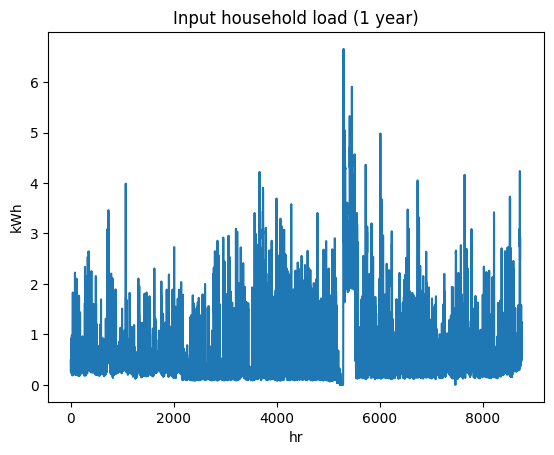

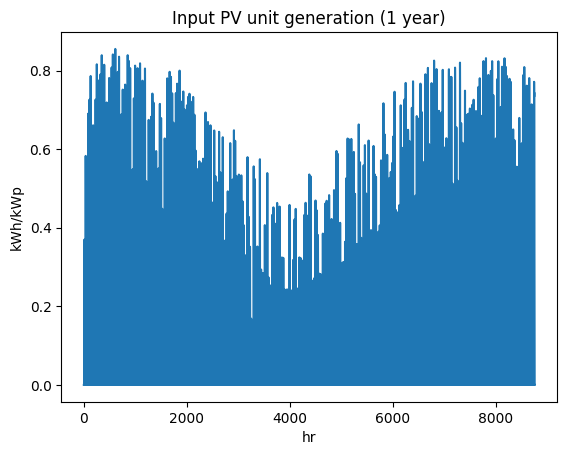

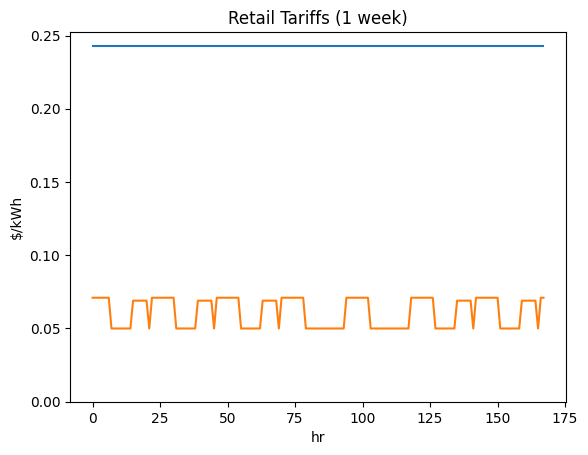

---- Optimising with PV: 1 - 20 kWp, Batt: 0 kWh. Determining PV capacity and dispatch.


************************************ Modell: PV > 1 kWp & BATT > 1 kWh ************************************
{'financial_horizon': 10, 'discount_rate': np.float64(0.06), 'grid_feedin_max': np.float64(5.0), 'pv_eol_capacity': np.float64(0.8), 'pv_eol_years': np.float64(25.0), 'pv_init_soh': np.float64(1.0), 'bess_e2p_ratio': np.float64(2.4), 'bess_roundtrip_eff': np.float64(0.88), 'bess_eol_years': np.float64(10.0), 'bess_eol_capacity': np.float64(0.7), 'bess_eol_cycles': np.float64(10000.0), 'bess_init_soh': np.float64(1.0), 'bess_eff_charge': np.float64(0.938083151964686), 'bess_eff_discharge': np.float64(0.938083151964686), 'scenario_name': 'Scenario_D_+5', 'scenario_set': 'SurfCoast', 'scenario_subset': 'JJP_open', 'year_start': 2022, 'datetime_name': 'DateTime1', 'meter_name': 'pc3011_nmi5766311423', 'solar_name': 'MELB', 'tariff_name_import_wkday': '3_Im_wkday', 'tariff_name_export_wkday': '3_

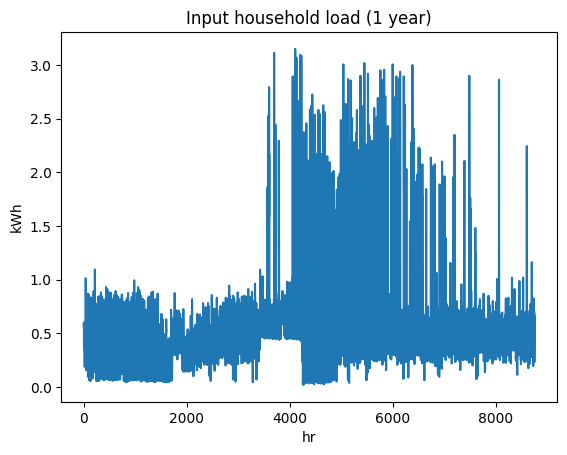

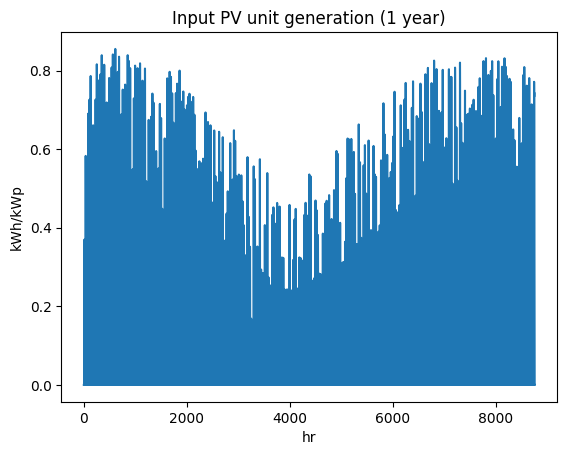

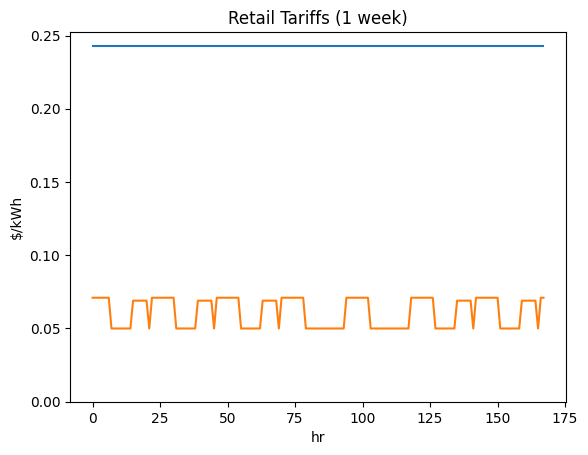

---- Optimising with PV: 1 - 20 kWp, Batt: 0 kWh. Determining PV capacity and dispatch.


************************************ Modell: PV > 1 kWp & BATT > 1 kWh ************************************
{'financial_horizon': 10, 'discount_rate': np.float64(0.06), 'grid_feedin_max': np.float64(5.0), 'pv_eol_capacity': np.float64(0.8), 'pv_eol_years': np.float64(25.0), 'pv_init_soh': np.float64(1.0), 'bess_e2p_ratio': np.float64(2.4), 'bess_roundtrip_eff': np.float64(0.88), 'bess_eol_years': np.float64(10.0), 'bess_eol_capacity': np.float64(0.7), 'bess_eol_cycles': np.float64(10000.0), 'bess_init_soh': np.float64(1.0), 'bess_eff_charge': np.float64(0.938083151964686), 'bess_eff_discharge': np.float64(0.938083151964686), 'scenario_name': 'Scenario_D_+5', 'scenario_set': 'SurfCoast', 'scenario_subset': 'JJP_open', 'year_start': 2022, 'datetime_name': 'DateTime1', 'meter_name': 'pc3011_nmi5791841324', 'solar_name': 'MELB', 'tariff_name_import_wkday': '3_Im_wkday', 'tariff_name_export_wkday': '3_

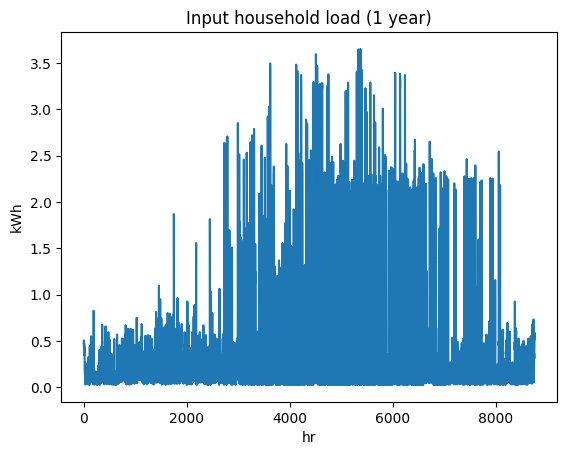

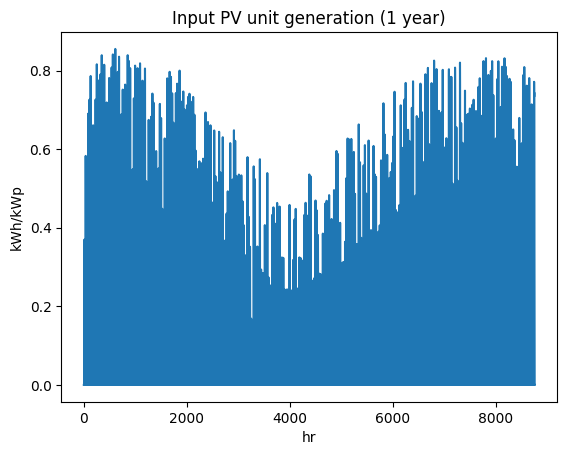

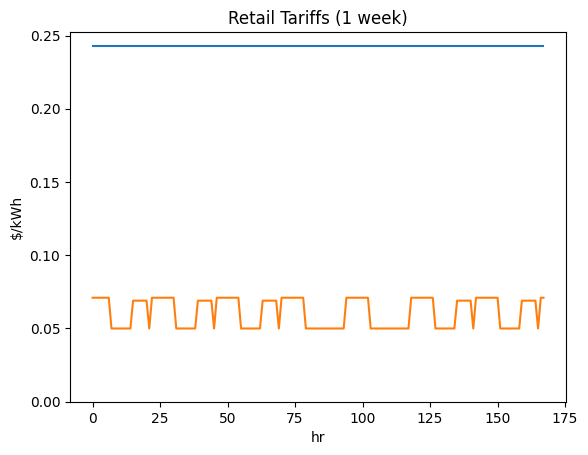

---- Optimising with PV: 1 - 20 kWp, Batt: 0 kWh. Determining PV capacity and dispatch.


************************************ Modell: PV > 1 kWp & BATT > 1 kWh ************************************
{'financial_horizon': 10, 'discount_rate': np.float64(0.06), 'grid_feedin_max': np.float64(5.0), 'pv_eol_capacity': np.float64(0.8), 'pv_eol_years': np.float64(25.0), 'pv_init_soh': np.float64(1.0), 'bess_e2p_ratio': np.float64(2.4), 'bess_roundtrip_eff': np.float64(0.88), 'bess_eol_years': np.float64(10.0), 'bess_eol_capacity': np.float64(0.7), 'bess_eol_cycles': np.float64(10000.0), 'bess_init_soh': np.float64(1.0), 'bess_eff_charge': np.float64(0.938083151964686), 'bess_eff_discharge': np.float64(0.938083151964686), 'scenario_name': 'Scenario_D_+5', 'scenario_set': 'SurfCoast', 'scenario_subset': 'JJP_open', 'year_start': 2022, 'datetime_name': 'DateTime1', 'meter_name': 'pc3011_nmi5414536377', 'solar_name': 'MELB', 'tariff_name_import_wkday': '3_Im_wkday', 'tariff_name_export_wkday': '3_

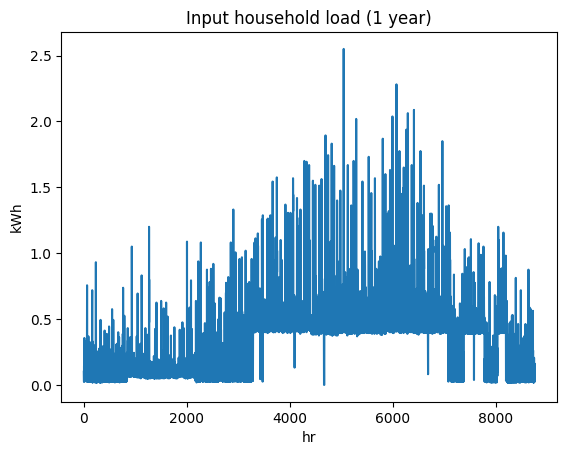

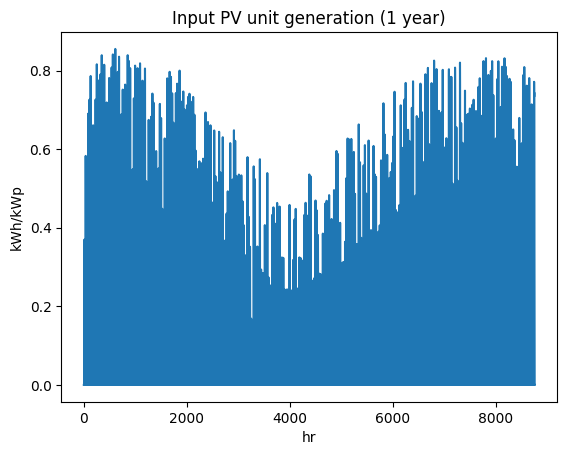

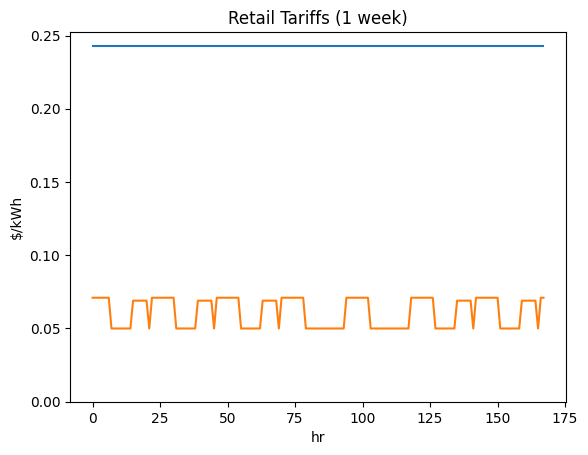

---- Optimising with PV: 1 - 20 kWp, Batt: 0 kWh. Determining PV capacity and dispatch.


************************************ Modell: PV > 1 kWp & BATT > 1 kWh ************************************
{'financial_horizon': 10, 'discount_rate': np.float64(0.06), 'grid_feedin_max': np.float64(5.0), 'pv_eol_capacity': np.float64(0.8), 'pv_eol_years': np.float64(25.0), 'pv_init_soh': np.float64(1.0), 'bess_e2p_ratio': np.float64(2.4), 'bess_roundtrip_eff': np.float64(0.88), 'bess_eol_years': np.float64(10.0), 'bess_eol_capacity': np.float64(0.7), 'bess_eol_cycles': np.float64(10000.0), 'bess_init_soh': np.float64(1.0), 'bess_eff_charge': np.float64(0.938083151964686), 'bess_eff_discharge': np.float64(0.938083151964686), 'scenario_name': 'Scenario_D_+5', 'scenario_set': 'SurfCoast', 'scenario_subset': 'JJP_open', 'year_start': 2022, 'datetime_name': 'DateTime1', 'meter_name': 'pc3011_nmi6609718013', 'solar_name': 'MELB', 'tariff_name_import_wkday': '3_Im_wkday', 'tariff_name_export_wkday': '3_

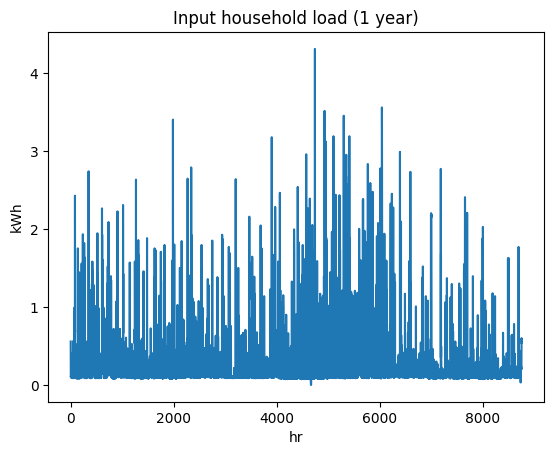

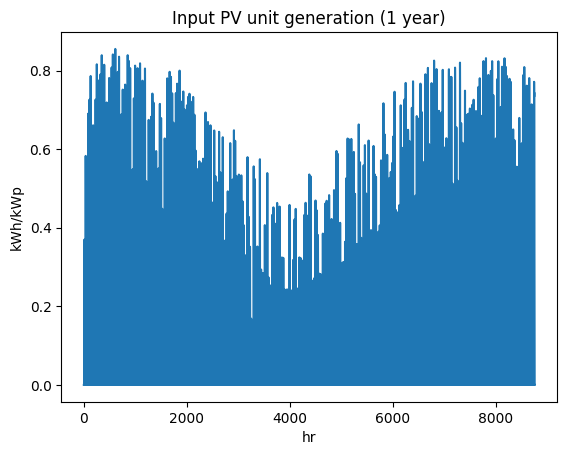

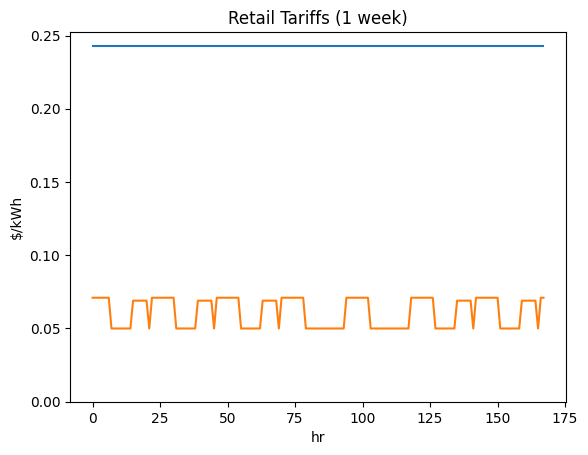

---- Optimising with PV: 1 - 20 kWp, Batt: 0 kWh. Determining PV capacity and dispatch.


************************************ Modell: PV > 1 kWp & BATT > 1 kWh ************************************
{'financial_horizon': 10, 'discount_rate': np.float64(0.06), 'grid_feedin_max': np.float64(5.0), 'pv_eol_capacity': np.float64(0.8), 'pv_eol_years': np.float64(25.0), 'pv_init_soh': np.float64(1.0), 'bess_e2p_ratio': np.float64(2.4), 'bess_roundtrip_eff': np.float64(0.88), 'bess_eol_years': np.float64(10.0), 'bess_eol_capacity': np.float64(0.7), 'bess_eol_cycles': np.float64(10000.0), 'bess_init_soh': np.float64(1.0), 'bess_eff_charge': np.float64(0.938083151964686), 'bess_eff_discharge': np.float64(0.938083151964686), 'scenario_name': 'Scenario_D_+5', 'scenario_set': 'SurfCoast', 'scenario_subset': 'JJP_open', 'year_start': 2022, 'datetime_name': 'DateTime1', 'meter_name': 'pc3011_nmi5090742284', 'solar_name': 'MELB', 'tariff_name_import_wkday': '3_Im_wkday', 'tariff_name_export_wkday': '3_

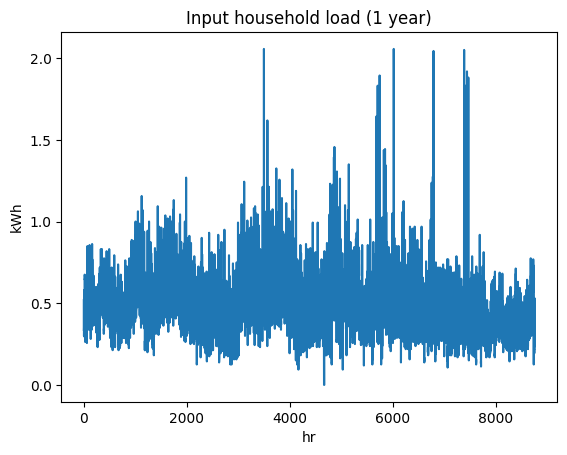

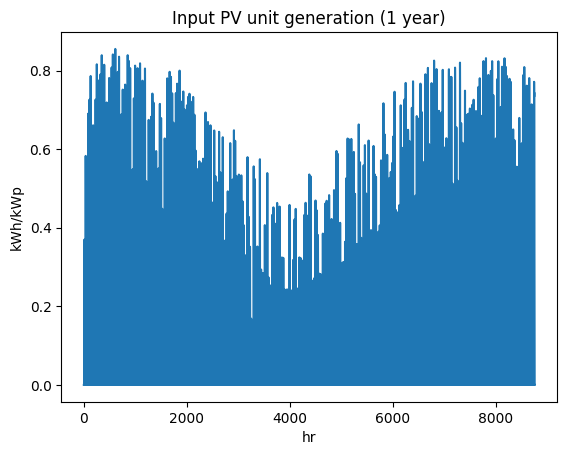

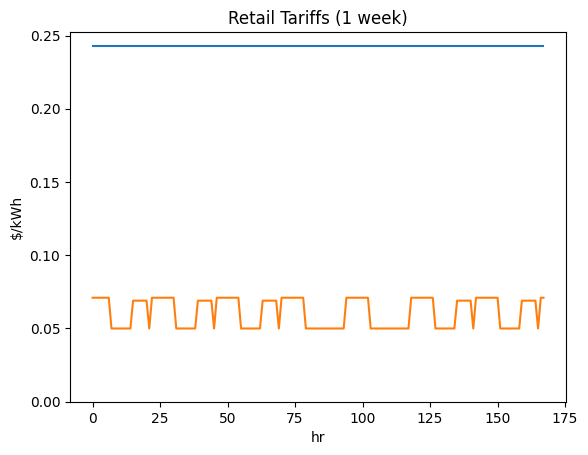

---- Optimising with PV: 1 - 20 kWp, Batt: 0 kWh. Determining PV capacity and dispatch.


************************************ Modell: PV > 1 kWp & BATT > 1 kWh ************************************
{'financial_horizon': 10, 'discount_rate': np.float64(0.06), 'grid_feedin_max': np.float64(5.0), 'pv_eol_capacity': np.float64(0.8), 'pv_eol_years': np.float64(25.0), 'pv_init_soh': np.float64(1.0), 'bess_e2p_ratio': np.float64(2.4), 'bess_roundtrip_eff': np.float64(0.88), 'bess_eol_years': np.float64(10.0), 'bess_eol_capacity': np.float64(0.7), 'bess_eol_cycles': np.float64(10000.0), 'bess_init_soh': np.float64(1.0), 'bess_eff_charge': np.float64(0.938083151964686), 'bess_eff_discharge': np.float64(0.938083151964686), 'scenario_name': 'Scenario_D_+5', 'scenario_set': 'SurfCoast', 'scenario_subset': 'JJP_open', 'year_start': 2022, 'datetime_name': 'DateTime1', 'meter_name': 'pc3011_nmi1442080338', 'solar_name': 'MELB', 'tariff_name_import_wkday': '3_Im_wkday', 'tariff_name_export_wkday': '3_

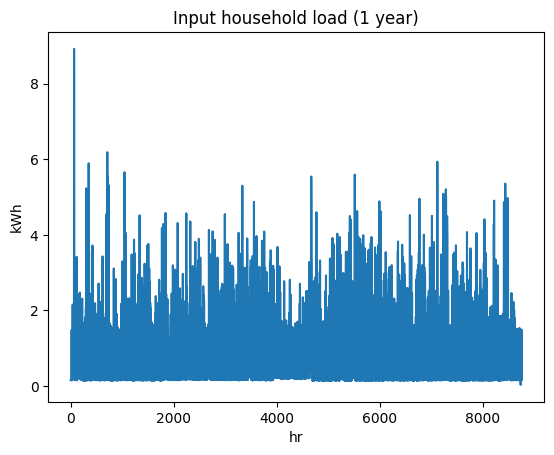

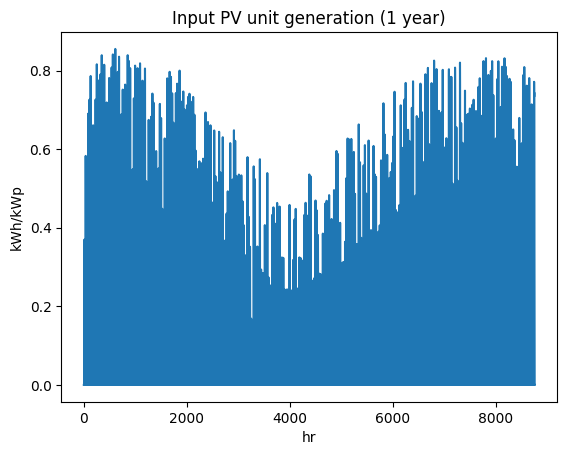

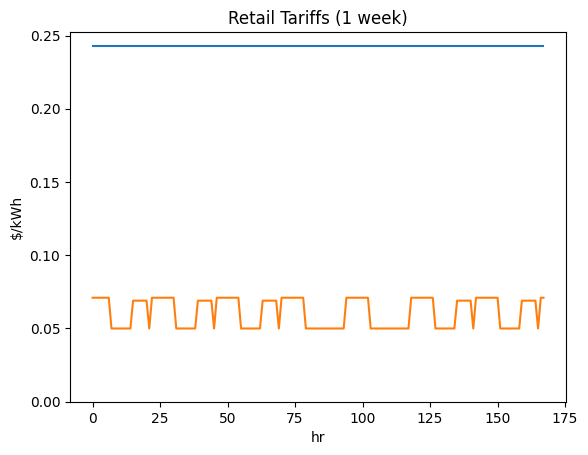

---- Optimising with PV: 1 - 20 kWp, Batt: 0 kWh. Determining PV capacity and dispatch.


************************************ Modell: PV > 1 kWp & BATT > 1 kWh ************************************
{'financial_horizon': 10, 'discount_rate': np.float64(0.06), 'grid_feedin_max': np.float64(5.0), 'pv_eol_capacity': np.float64(0.8), 'pv_eol_years': np.float64(25.0), 'pv_init_soh': np.float64(1.0), 'bess_e2p_ratio': np.float64(2.4), 'bess_roundtrip_eff': np.float64(0.88), 'bess_eol_years': np.float64(10.0), 'bess_eol_capacity': np.float64(0.7), 'bess_eol_cycles': np.float64(10000.0), 'bess_init_soh': np.float64(1.0), 'bess_eff_charge': np.float64(0.938083151964686), 'bess_eff_discharge': np.float64(0.938083151964686), 'scenario_name': 'Scenario_D_+5', 'scenario_set': 'SurfCoast', 'scenario_subset': 'JJP_open', 'year_start': 2022, 'datetime_name': 'DateTime1', 'meter_name': 'pc3011_nmi9223720959', 'solar_name': 'MELB', 'tariff_name_import_wkday': '3_Im_wkday', 'tariff_name_export_wkday': '3_

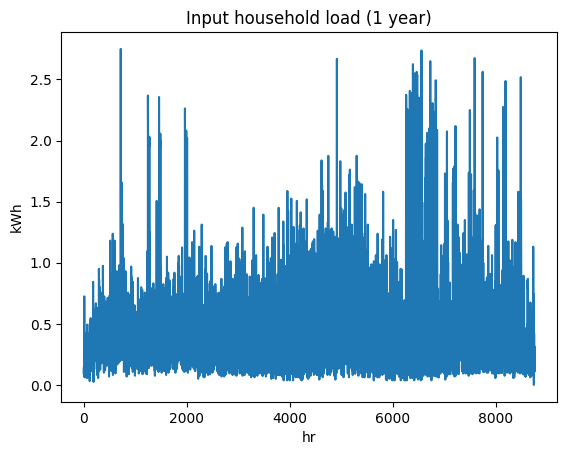

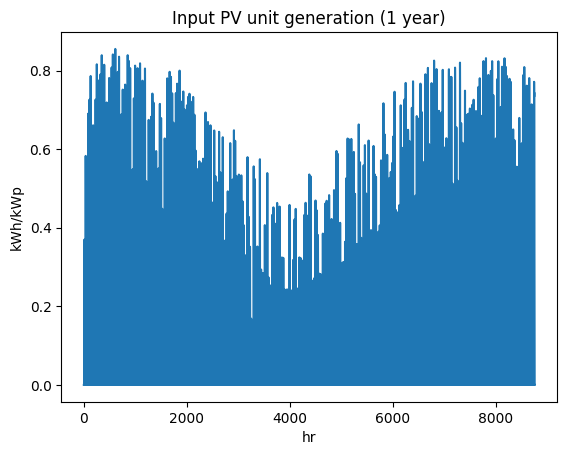

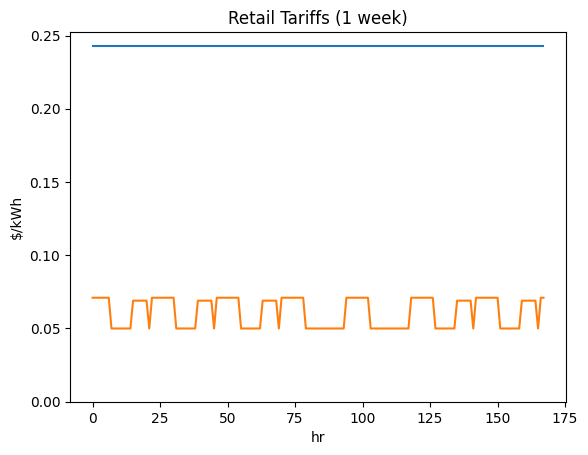

---- Optimising with PV: 1 - 20 kWp, Batt: 0 kWh. Determining PV capacity and dispatch.


************************************ Modell: PV > 1 kWp & BATT > 1 kWh ************************************
{'financial_horizon': 10, 'discount_rate': np.float64(0.06), 'grid_feedin_max': np.float64(5.0), 'pv_eol_capacity': np.float64(0.8), 'pv_eol_years': np.float64(25.0), 'pv_init_soh': np.float64(1.0), 'bess_e2p_ratio': np.float64(2.4), 'bess_roundtrip_eff': np.float64(0.88), 'bess_eol_years': np.float64(10.0), 'bess_eol_capacity': np.float64(0.7), 'bess_eol_cycles': np.float64(10000.0), 'bess_init_soh': np.float64(1.0), 'bess_eff_charge': np.float64(0.938083151964686), 'bess_eff_discharge': np.float64(0.938083151964686), 'scenario_name': 'Scenario_D_+5', 'scenario_set': 'SurfCoast', 'scenario_subset': 'JJP_open', 'year_start': 2022, 'datetime_name': 'DateTime1', 'meter_name': 'pc3011_nmi6525386399', 'solar_name': 'MELB', 'tariff_name_import_wkday': '3_Im_wkday', 'tariff_name_export_wkday': '3_

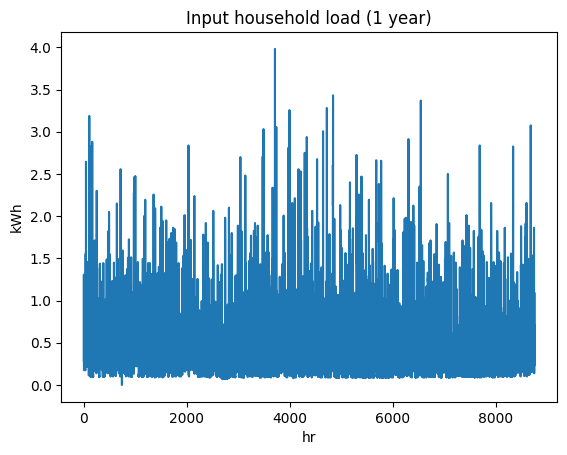

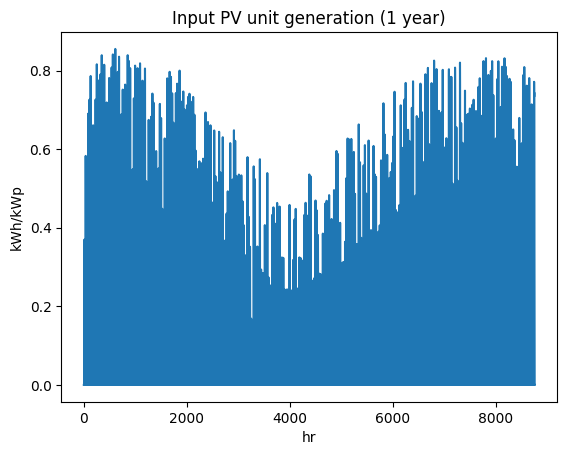

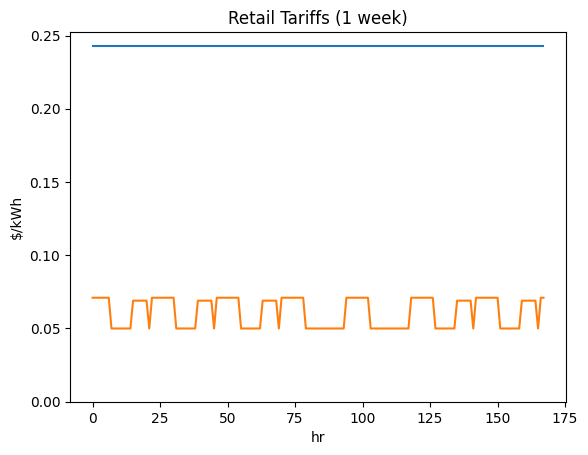

---- Optimising with PV: 1 - 20 kWp, Batt: 0 kWh. Determining PV capacity and dispatch.


************************************ Modell: PV > 1 kWp & BATT > 1 kWh ************************************
{'financial_horizon': 10, 'discount_rate': np.float64(0.06), 'grid_feedin_max': np.float64(5.0), 'pv_eol_capacity': np.float64(0.8), 'pv_eol_years': np.float64(25.0), 'pv_init_soh': np.float64(1.0), 'bess_e2p_ratio': np.float64(2.4), 'bess_roundtrip_eff': np.float64(0.88), 'bess_eol_years': np.float64(10.0), 'bess_eol_capacity': np.float64(0.7), 'bess_eol_cycles': np.float64(10000.0), 'bess_init_soh': np.float64(1.0), 'bess_eff_charge': np.float64(0.938083151964686), 'bess_eff_discharge': np.float64(0.938083151964686), 'scenario_name': 'Scenario_D_+5', 'scenario_set': 'SurfCoast', 'scenario_subset': 'JJP_open', 'year_start': 2022, 'datetime_name': 'DateTime1', 'meter_name': 'pc3011_nmi5074196585', 'solar_name': 'MELB', 'tariff_name_import_wkday': '3_Im_wkday', 'tariff_name_export_wkday': '3_

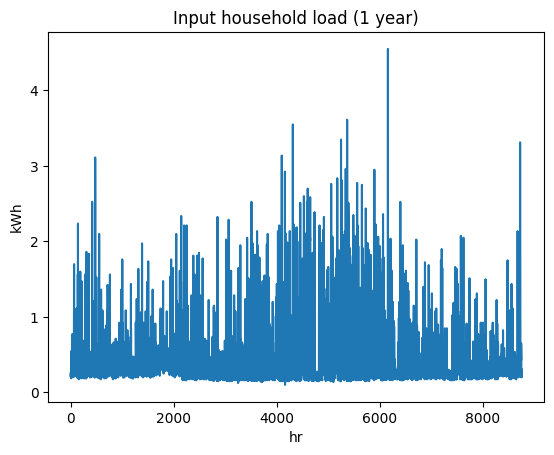

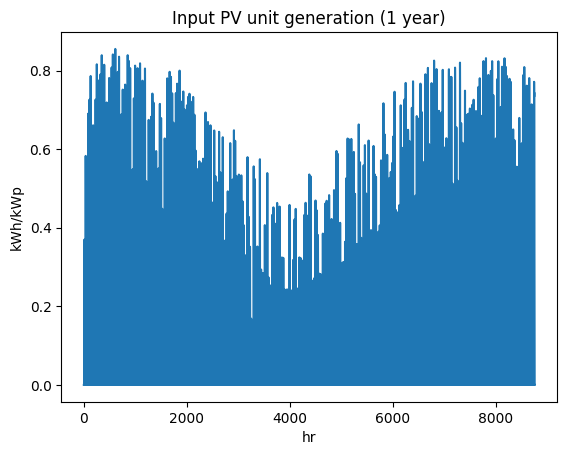

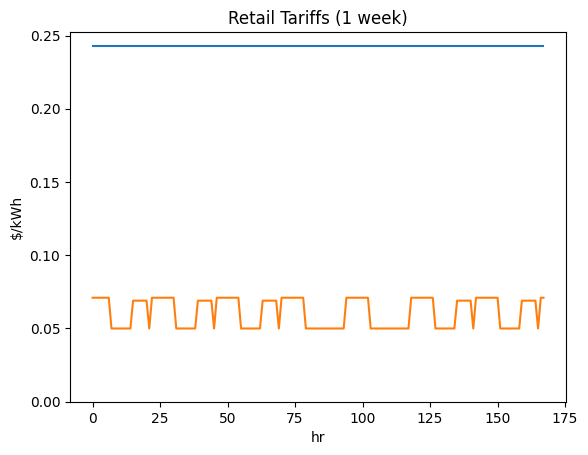

---- Optimising with PV: 1 - 20 kWp, Batt: 0 kWh. Determining PV capacity and dispatch.


************************************ Modell: PV > 1 kWp & BATT > 1 kWh ************************************
{'financial_horizon': 10, 'discount_rate': np.float64(0.06), 'grid_feedin_max': np.float64(5.0), 'pv_eol_capacity': np.float64(0.8), 'pv_eol_years': np.float64(25.0), 'pv_init_soh': np.float64(1.0), 'bess_e2p_ratio': np.float64(2.4), 'bess_roundtrip_eff': np.float64(0.88), 'bess_eol_years': np.float64(10.0), 'bess_eol_capacity': np.float64(0.7), 'bess_eol_cycles': np.float64(10000.0), 'bess_init_soh': np.float64(1.0), 'bess_eff_charge': np.float64(0.938083151964686), 'bess_eff_discharge': np.float64(0.938083151964686), 'scenario_name': 'Scenario_D_+5', 'scenario_set': 'SurfCoast', 'scenario_subset': 'JJP_open', 'year_start': 2022, 'datetime_name': 'DateTime1', 'meter_name': 'pc3011_nmi2494032773', 'solar_name': 'MELB', 'tariff_name_import_wkday': '3_Im_wkday', 'tariff_name_export_wkday': '3_

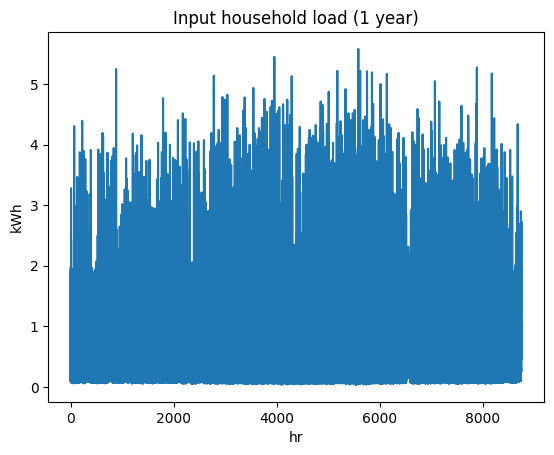

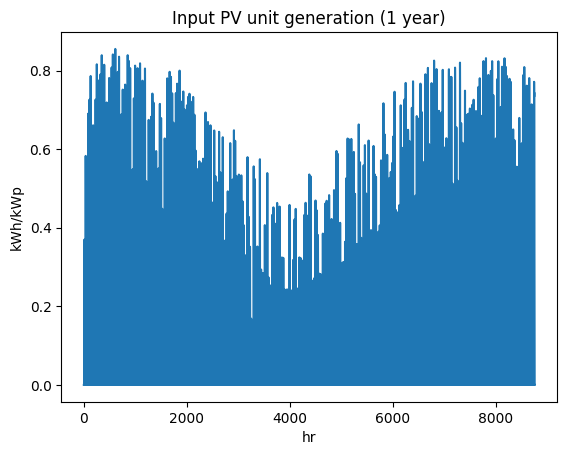

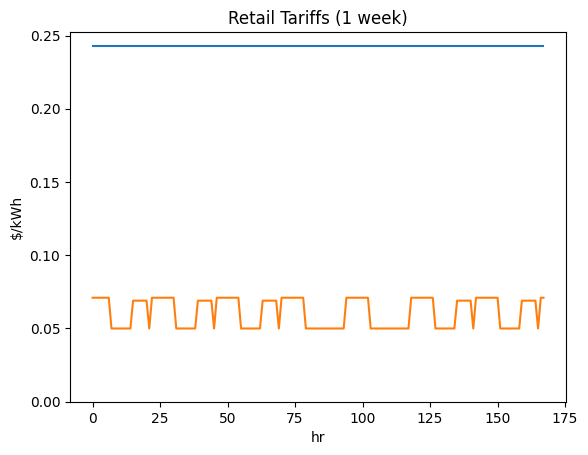

---- Optimising with PV: 1 - 20 kWp, Batt: 0 kWh. Determining PV capacity and dispatch.


************************************ Modell: PV > 1 kWp & BATT > 1 kWh ************************************
{'financial_horizon': 10, 'discount_rate': np.float64(0.06), 'grid_feedin_max': np.float64(5.0), 'pv_eol_capacity': np.float64(0.8), 'pv_eol_years': np.float64(25.0), 'pv_init_soh': np.float64(1.0), 'bess_e2p_ratio': np.float64(2.4), 'bess_roundtrip_eff': np.float64(0.88), 'bess_eol_years': np.float64(10.0), 'bess_eol_capacity': np.float64(0.7), 'bess_eol_cycles': np.float64(10000.0), 'bess_init_soh': np.float64(1.0), 'bess_eff_charge': np.float64(0.938083151964686), 'bess_eff_discharge': np.float64(0.938083151964686), 'scenario_name': 'Scenario_D_+5', 'scenario_set': 'SurfCoast', 'scenario_subset': 'JJP_open', 'year_start': 2022, 'datetime_name': 'DateTime1', 'meter_name': 'pc3013_nmi3281971873', 'solar_name': 'MELB', 'tariff_name_import_wkday': '3_Im_wkday', 'tariff_name_export_wkday': '3_

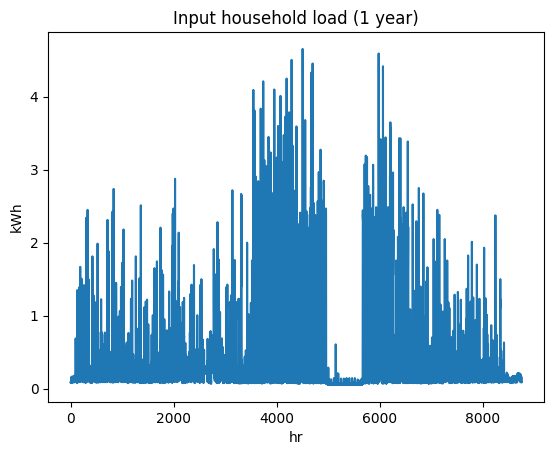

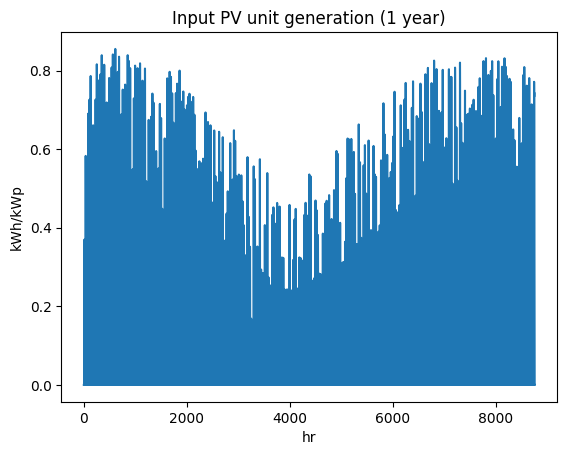

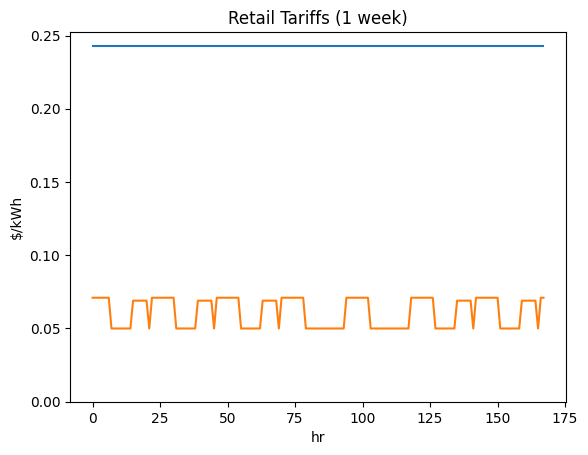

---- Optimising with PV: 1 - 20 kWp, Batt: 0 kWh. Determining PV capacity and dispatch.


************************************ Modell: PV > 1 kWp & BATT > 1 kWh ************************************
{'financial_horizon': 10, 'discount_rate': np.float64(0.06), 'grid_feedin_max': np.float64(5.0), 'pv_eol_capacity': np.float64(0.8), 'pv_eol_years': np.float64(25.0), 'pv_init_soh': np.float64(1.0), 'bess_e2p_ratio': np.float64(2.4), 'bess_roundtrip_eff': np.float64(0.88), 'bess_eol_years': np.float64(10.0), 'bess_eol_capacity': np.float64(0.7), 'bess_eol_cycles': np.float64(10000.0), 'bess_init_soh': np.float64(1.0), 'bess_eff_charge': np.float64(0.938083151964686), 'bess_eff_discharge': np.float64(0.938083151964686), 'scenario_name': 'Scenario_D_+5', 'scenario_set': 'SurfCoast', 'scenario_subset': 'JJP_open', 'year_start': 2022, 'datetime_name': 'DateTime1', 'meter_name': 'pc3013_nmi5278375246', 'solar_name': 'MELB', 'tariff_name_import_wkday': '3_Im_wkday', 'tariff_name_export_wkday': '3_

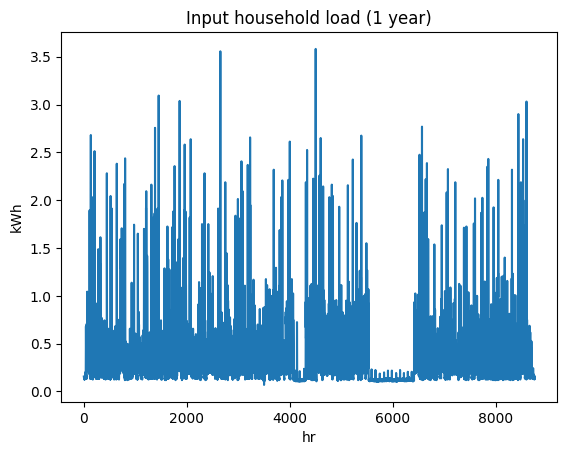

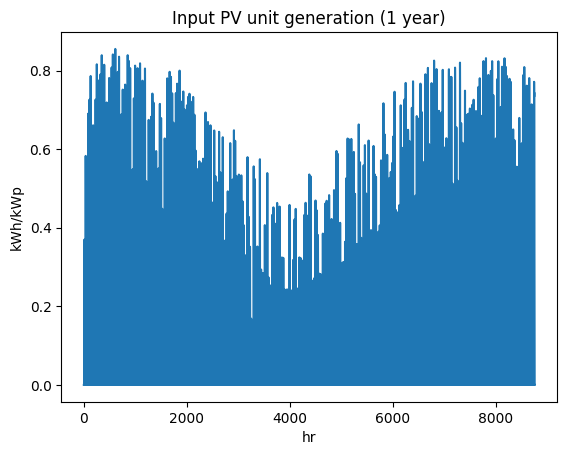

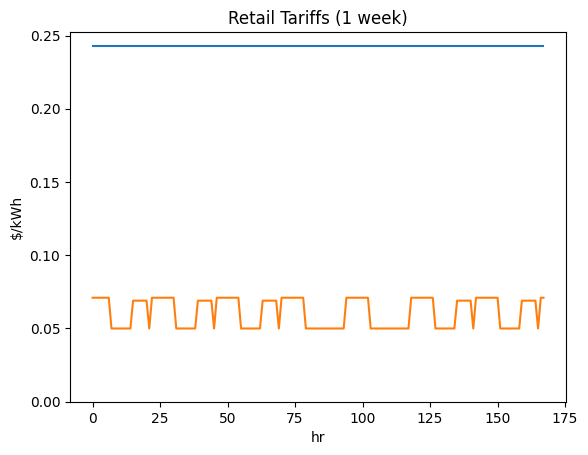

---- Optimising with PV: 1 - 20 kWp, Batt: 0 kWh. Determining PV capacity and dispatch.


************************************ Modell: PV > 1 kWp & BATT > 1 kWh ************************************
{'financial_horizon': 10, 'discount_rate': np.float64(0.06), 'grid_feedin_max': np.float64(5.0), 'pv_eol_capacity': np.float64(0.8), 'pv_eol_years': np.float64(25.0), 'pv_init_soh': np.float64(1.0), 'bess_e2p_ratio': np.float64(2.4), 'bess_roundtrip_eff': np.float64(0.88), 'bess_eol_years': np.float64(10.0), 'bess_eol_capacity': np.float64(0.7), 'bess_eol_cycles': np.float64(10000.0), 'bess_init_soh': np.float64(1.0), 'bess_eff_charge': np.float64(0.938083151964686), 'bess_eff_discharge': np.float64(0.938083151964686), 'scenario_name': 'Scenario_D_+5', 'scenario_set': 'SurfCoast', 'scenario_subset': 'JJP_open', 'year_start': 2022, 'datetime_name': 'DateTime1', 'meter_name': 'pc3013_nmi8002284805', 'solar_name': 'MELB', 'tariff_name_import_wkday': '3_Im_wkday', 'tariff_name_export_wkday': '3_

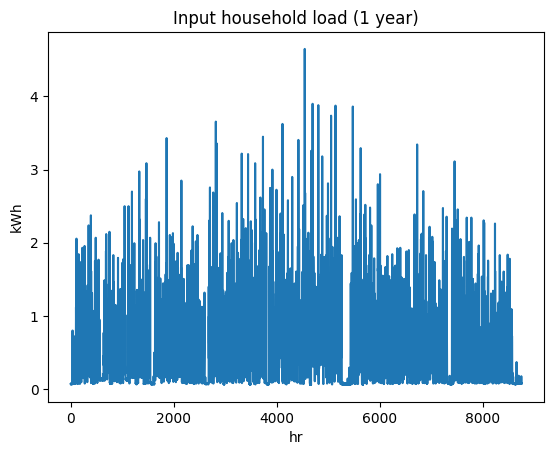

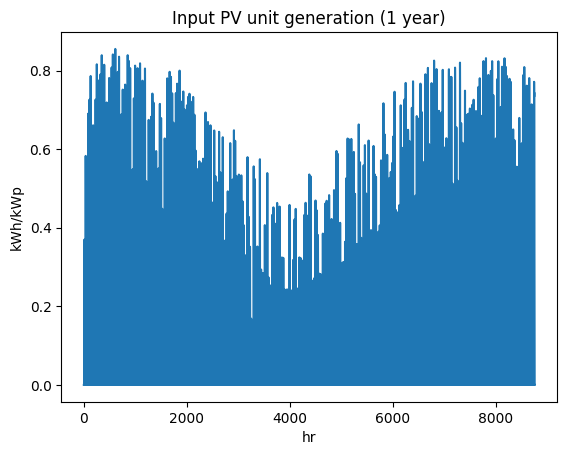

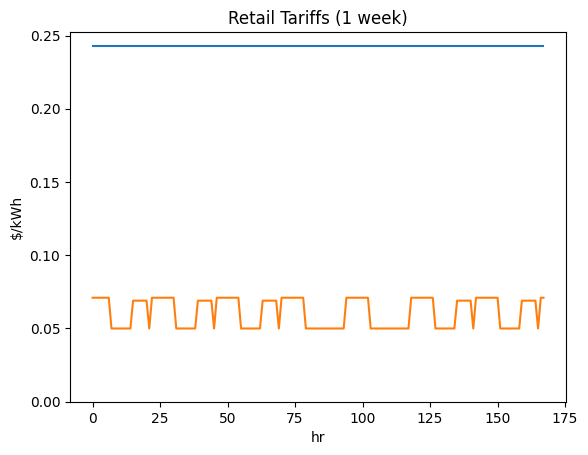

---- Optimising with PV: 1 - 20 kWp, Batt: 0 kWh. Determining PV capacity and dispatch.


************************************ Modell: PV > 1 kWp & BATT > 1 kWh ************************************
{'financial_horizon': 10, 'discount_rate': np.float64(0.06), 'grid_feedin_max': np.float64(5.0), 'pv_eol_capacity': np.float64(0.8), 'pv_eol_years': np.float64(25.0), 'pv_init_soh': np.float64(1.0), 'bess_e2p_ratio': np.float64(2.4), 'bess_roundtrip_eff': np.float64(0.88), 'bess_eol_years': np.float64(10.0), 'bess_eol_capacity': np.float64(0.7), 'bess_eol_cycles': np.float64(10000.0), 'bess_init_soh': np.float64(1.0), 'bess_eff_charge': np.float64(0.938083151964686), 'bess_eff_discharge': np.float64(0.938083151964686), 'scenario_name': 'Scenario_D_+5', 'scenario_set': 'SurfCoast', 'scenario_subset': 'JJP_open', 'year_start': 2022, 'datetime_name': 'DateTime1', 'meter_name': 'pc3012_nmi5731749469', 'solar_name': 'MELB', 'tariff_name_import_wkday': '3_Im_wkday', 'tariff_name_export_wkday': '3_

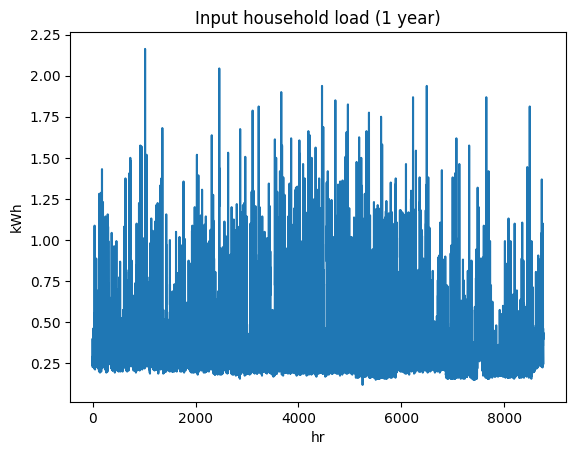

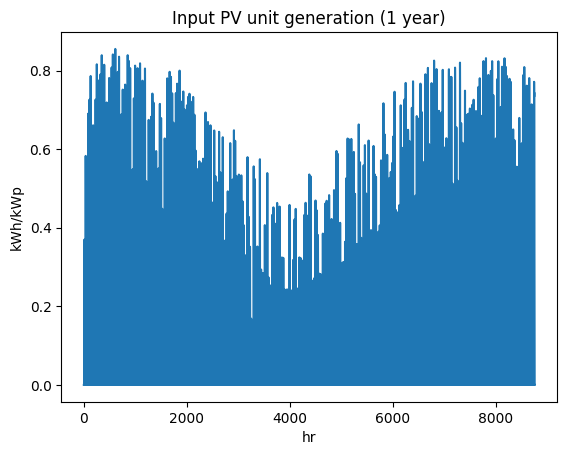

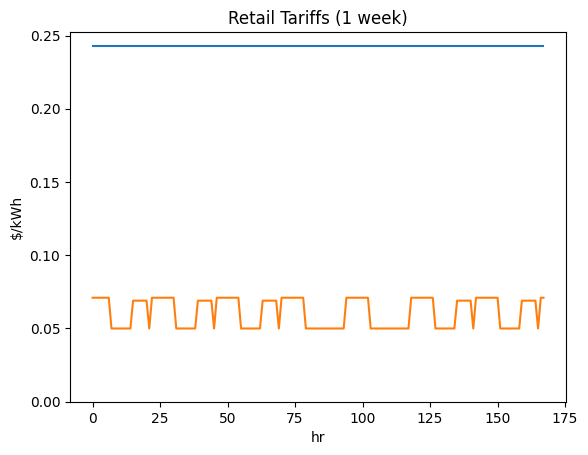

---- Optimising with PV: 1 - 20 kWp, Batt: 0 kWh. Determining PV capacity and dispatch.


************************************ Modell: PV > 1 kWp & BATT > 1 kWh ************************************
{'financial_horizon': 10, 'discount_rate': np.float64(0.06), 'grid_feedin_max': np.float64(5.0), 'pv_eol_capacity': np.float64(0.8), 'pv_eol_years': np.float64(25.0), 'pv_init_soh': np.float64(1.0), 'bess_e2p_ratio': np.float64(2.4), 'bess_roundtrip_eff': np.float64(0.88), 'bess_eol_years': np.float64(10.0), 'bess_eol_capacity': np.float64(0.7), 'bess_eol_cycles': np.float64(10000.0), 'bess_init_soh': np.float64(1.0), 'bess_eff_charge': np.float64(0.938083151964686), 'bess_eff_discharge': np.float64(0.938083151964686), 'scenario_name': 'Scenario_D_+5', 'scenario_set': 'SurfCoast', 'scenario_subset': 'JJP_open', 'year_start': 2022, 'datetime_name': 'DateTime1', 'meter_name': 'pc3013_nmi1147177192', 'solar_name': 'MELB', 'tariff_name_import_wkday': '3_Im_wkday', 'tariff_name_export_wkday': '3_

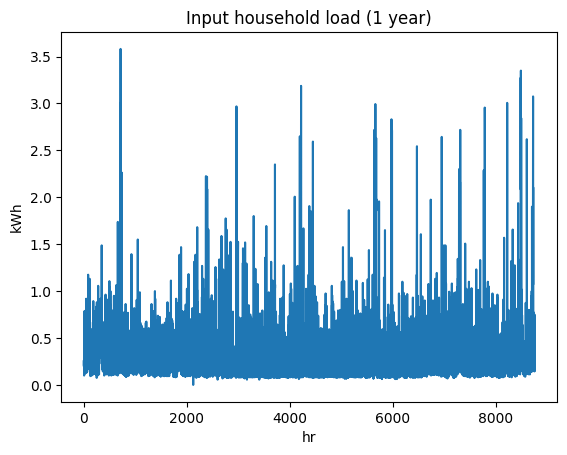

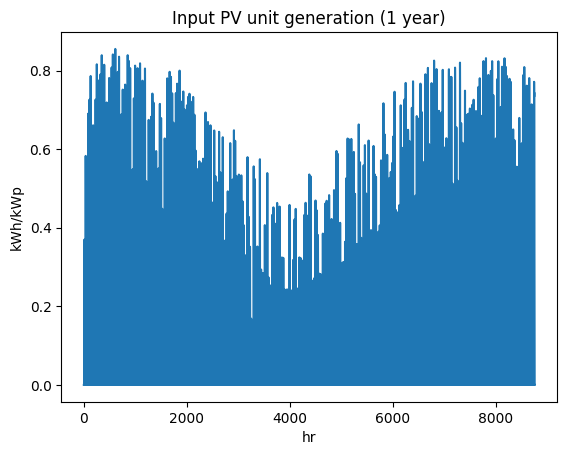

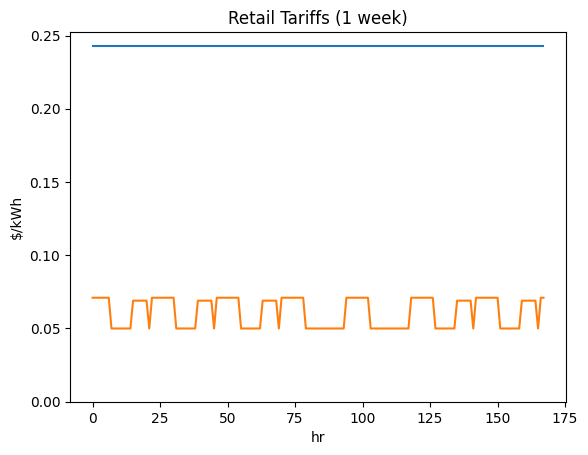

---- Optimising with PV: 1 - 20 kWp, Batt: 0 kWh. Determining PV capacity and dispatch.


************************************ Modell: PV > 1 kWp & BATT > 1 kWh ************************************
{'financial_horizon': 10, 'discount_rate': np.float64(0.06), 'grid_feedin_max': np.float64(5.0), 'pv_eol_capacity': np.float64(0.8), 'pv_eol_years': np.float64(25.0), 'pv_init_soh': np.float64(1.0), 'bess_e2p_ratio': np.float64(2.4), 'bess_roundtrip_eff': np.float64(0.88), 'bess_eol_years': np.float64(10.0), 'bess_eol_capacity': np.float64(0.7), 'bess_eol_cycles': np.float64(10000.0), 'bess_init_soh': np.float64(1.0), 'bess_eff_charge': np.float64(0.938083151964686), 'bess_eff_discharge': np.float64(0.938083151964686), 'scenario_name': 'Scenario_D_+5', 'scenario_set': 'SurfCoast', 'scenario_subset': 'JJP_open', 'year_start': 2022, 'datetime_name': 'DateTime1', 'meter_name': 'pc3012_nmi9599403489', 'solar_name': 'MELB', 'tariff_name_import_wkday': '3_Im_wkday', 'tariff_name_export_wkday': '3_

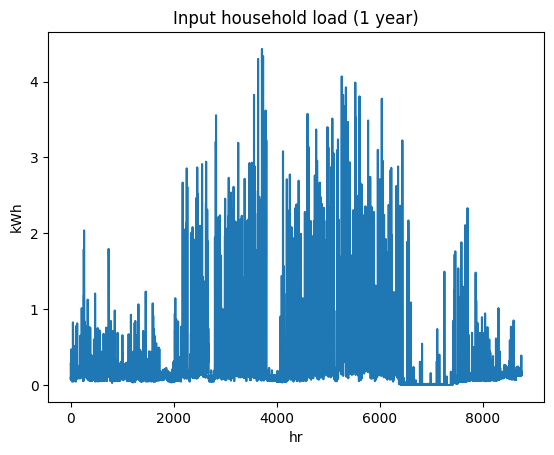

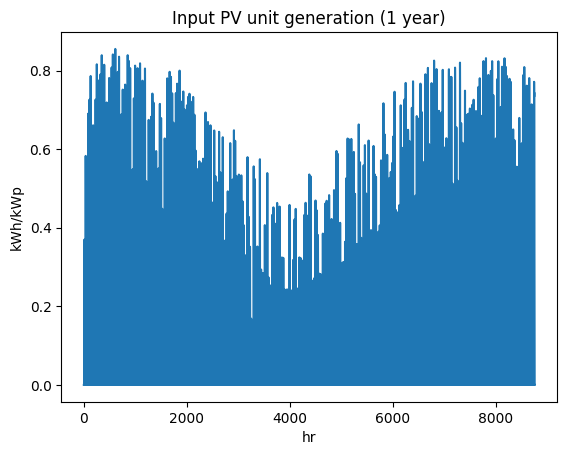

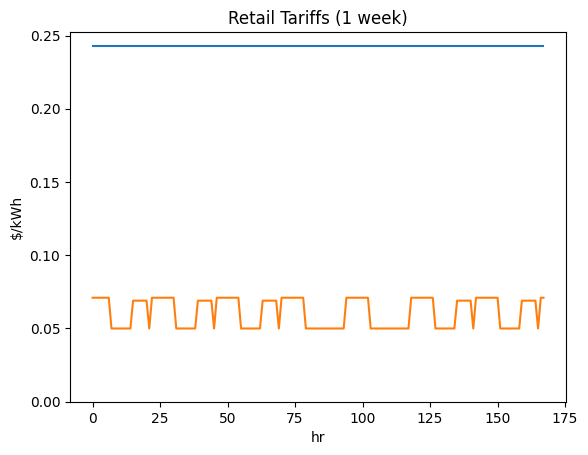

---- Optimising with PV: 1 - 20 kWp, Batt: 0 kWh. Determining PV capacity and dispatch.


************************************ Modell: PV > 1 kWp & BATT > 1 kWh ************************************
{'financial_horizon': 10, 'discount_rate': np.float64(0.06), 'grid_feedin_max': np.float64(5.0), 'pv_eol_capacity': np.float64(0.8), 'pv_eol_years': np.float64(25.0), 'pv_init_soh': np.float64(1.0), 'bess_e2p_ratio': np.float64(2.4), 'bess_roundtrip_eff': np.float64(0.88), 'bess_eol_years': np.float64(10.0), 'bess_eol_capacity': np.float64(0.7), 'bess_eol_cycles': np.float64(10000.0), 'bess_init_soh': np.float64(1.0), 'bess_eff_charge': np.float64(0.938083151964686), 'bess_eff_discharge': np.float64(0.938083151964686), 'scenario_name': 'Scenario_D_+5', 'scenario_set': 'SurfCoast', 'scenario_subset': 'JJP_open', 'year_start': 2022, 'datetime_name': 'DateTime1', 'meter_name': 'pc3013_nmi1115843201', 'solar_name': 'MELB', 'tariff_name_import_wkday': '3_Im_wkday', 'tariff_name_export_wkday': '3_

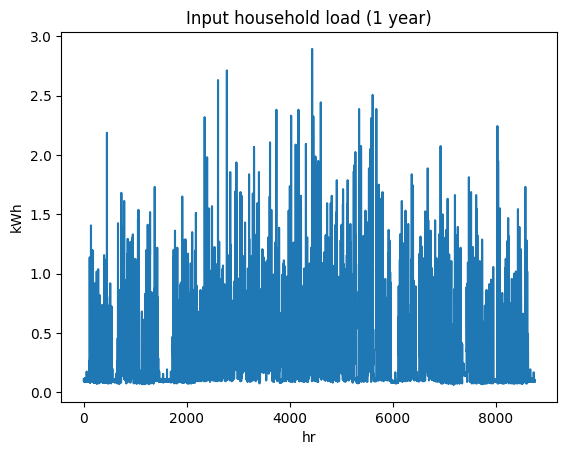

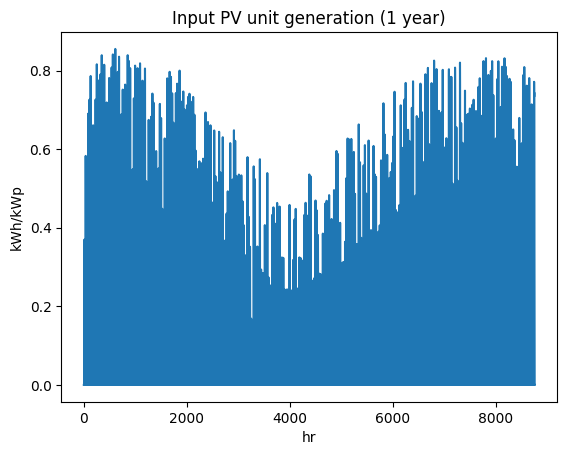

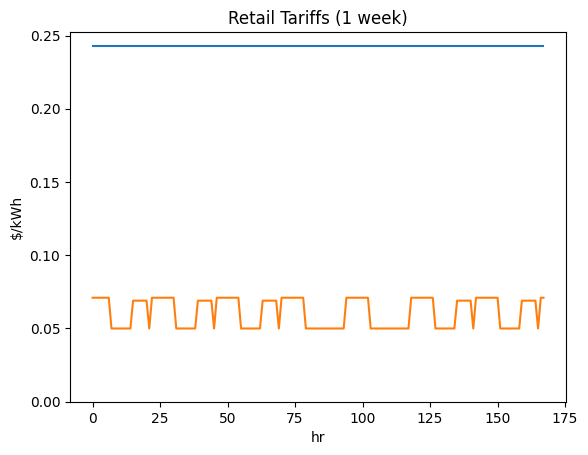

---- Optimising with PV: 1 - 20 kWp, Batt: 0 kWh. Determining PV capacity and dispatch.


************************************ Modell: PV > 1 kWp & BATT > 1 kWh ************************************
{'financial_horizon': 10, 'discount_rate': np.float64(0.06), 'grid_feedin_max': np.float64(5.0), 'pv_eol_capacity': np.float64(0.8), 'pv_eol_years': np.float64(25.0), 'pv_init_soh': np.float64(1.0), 'bess_e2p_ratio': np.float64(2.4), 'bess_roundtrip_eff': np.float64(0.88), 'bess_eol_years': np.float64(10.0), 'bess_eol_capacity': np.float64(0.7), 'bess_eol_cycles': np.float64(10000.0), 'bess_init_soh': np.float64(1.0), 'bess_eff_charge': np.float64(0.938083151964686), 'bess_eff_discharge': np.float64(0.938083151964686), 'scenario_name': 'Scenario_D_+5', 'scenario_set': 'SurfCoast', 'scenario_subset': 'JJP_open', 'year_start': 2022, 'datetime_name': 'DateTime1', 'meter_name': 'pc3013_nmi1679420304', 'solar_name': 'MELB', 'tariff_name_import_wkday': '3_Im_wkday', 'tariff_name_export_wkday': '3_

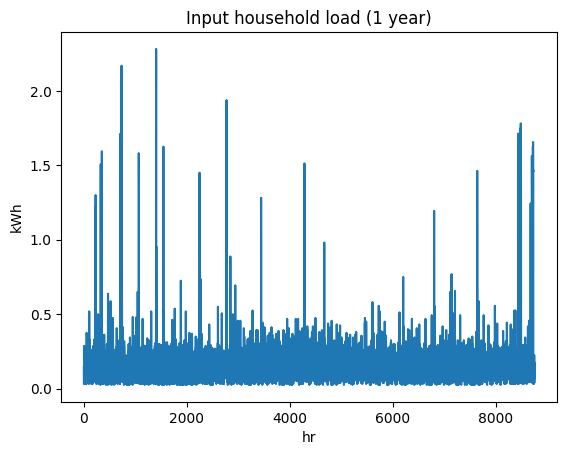

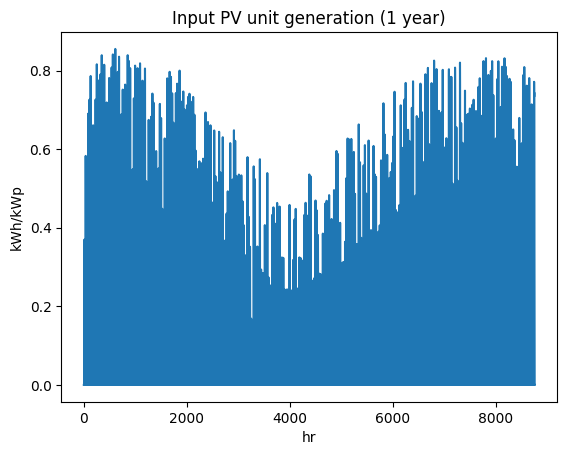

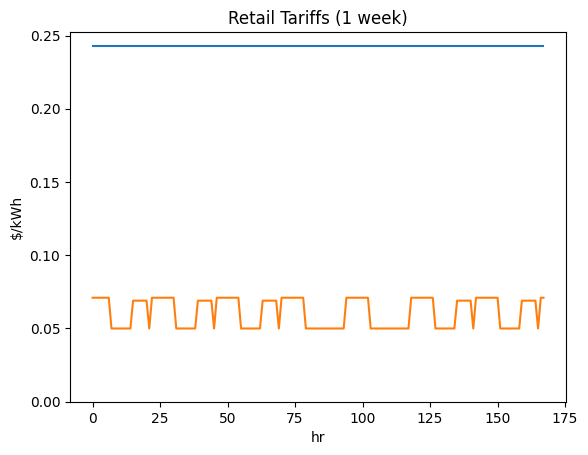

---- Optimising with PV: 1 - 20 kWp, Batt: 0 kWh. Determining PV capacity and dispatch.


************************************ Modell: PV > 1 kWp & BATT > 1 kWh ************************************
{'financial_horizon': 10, 'discount_rate': np.float64(0.06), 'grid_feedin_max': np.float64(5.0), 'pv_eol_capacity': np.float64(0.8), 'pv_eol_years': np.float64(25.0), 'pv_init_soh': np.float64(1.0), 'bess_e2p_ratio': np.float64(2.4), 'bess_roundtrip_eff': np.float64(0.88), 'bess_eol_years': np.float64(10.0), 'bess_eol_capacity': np.float64(0.7), 'bess_eol_cycles': np.float64(10000.0), 'bess_init_soh': np.float64(1.0), 'bess_eff_charge': np.float64(0.938083151964686), 'bess_eff_discharge': np.float64(0.938083151964686), 'scenario_name': 'Scenario_D_+5', 'scenario_set': 'SurfCoast', 'scenario_subset': 'JJP_open', 'year_start': 2022, 'datetime_name': 'DateTime1', 'meter_name': 'pc3012_nmi2447613895', 'solar_name': 'MELB', 'tariff_name_import_wkday': '3_Im_wkday', 'tariff_name_export_wkday': '3_

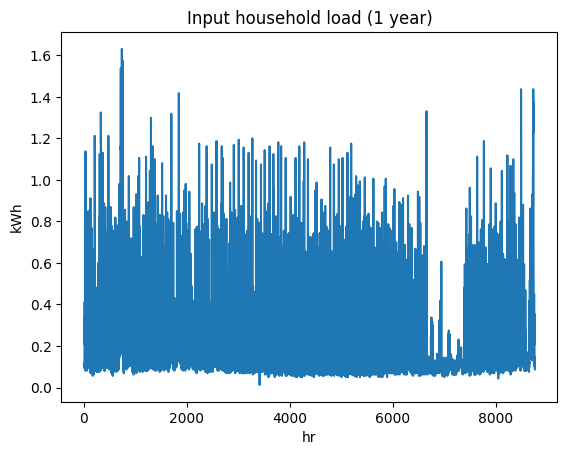

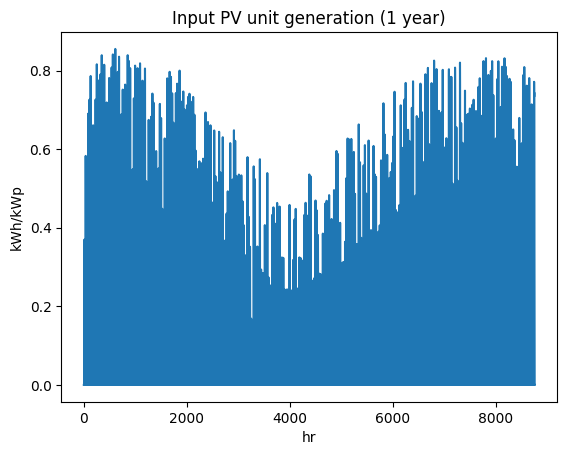

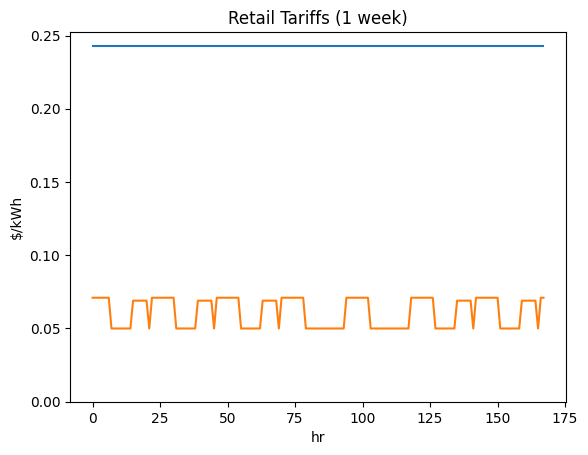

---- Optimising with PV: 1 - 20 kWp, Batt: 0 kWh. Determining PV capacity and dispatch.


************************************ Modell: PV > 1 kWp & BATT > 1 kWh ************************************
{'financial_horizon': 10, 'discount_rate': np.float64(0.06), 'grid_feedin_max': np.float64(5.0), 'pv_eol_capacity': np.float64(0.8), 'pv_eol_years': np.float64(25.0), 'pv_init_soh': np.float64(1.0), 'bess_e2p_ratio': np.float64(2.4), 'bess_roundtrip_eff': np.float64(0.88), 'bess_eol_years': np.float64(10.0), 'bess_eol_capacity': np.float64(0.7), 'bess_eol_cycles': np.float64(10000.0), 'bess_init_soh': np.float64(1.0), 'bess_eff_charge': np.float64(0.938083151964686), 'bess_eff_discharge': np.float64(0.938083151964686), 'scenario_name': 'Scenario_D_+5', 'scenario_set': 'SurfCoast', 'scenario_subset': 'JJP_open', 'year_start': 2022, 'datetime_name': 'DateTime1', 'meter_name': 'pc3012_nmi6692634881', 'solar_name': 'MELB', 'tariff_name_import_wkday': '3_Im_wkday', 'tariff_name_export_wkday': '3_

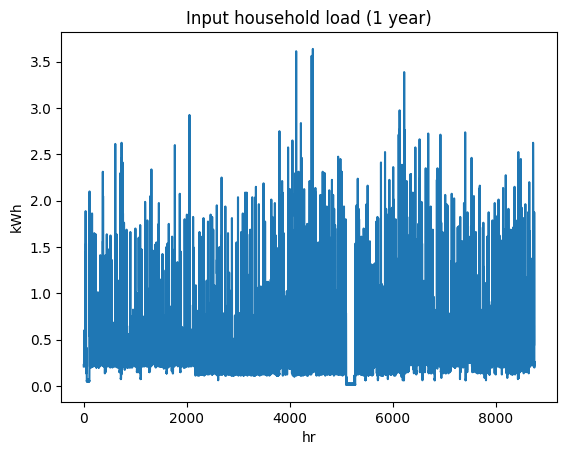

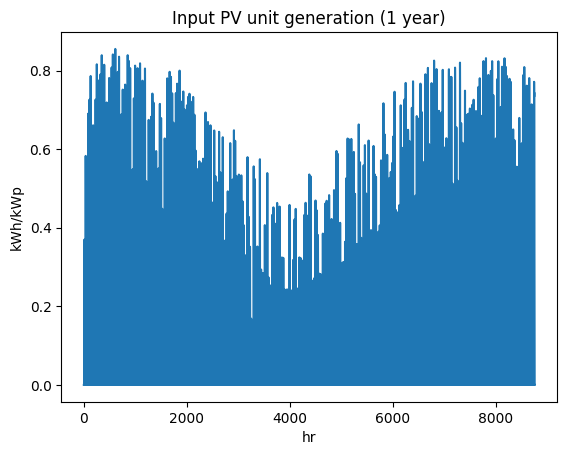

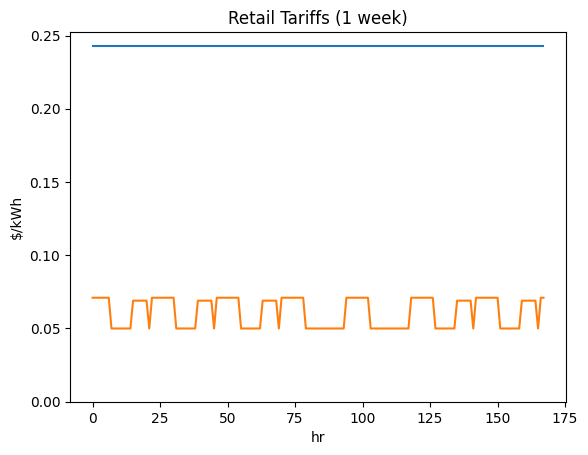

---- Optimising with PV: 1 - 20 kWp, Batt: 0 kWh. Determining PV capacity and dispatch.


************************************ Modell: PV > 1 kWp & BATT > 1 kWh ************************************
{'financial_horizon': 10, 'discount_rate': np.float64(0.06), 'grid_feedin_max': np.float64(5.0), 'pv_eol_capacity': np.float64(0.8), 'pv_eol_years': np.float64(25.0), 'pv_init_soh': np.float64(1.0), 'bess_e2p_ratio': np.float64(2.4), 'bess_roundtrip_eff': np.float64(0.88), 'bess_eol_years': np.float64(10.0), 'bess_eol_capacity': np.float64(0.7), 'bess_eol_cycles': np.float64(10000.0), 'bess_init_soh': np.float64(1.0), 'bess_eff_charge': np.float64(0.938083151964686), 'bess_eff_discharge': np.float64(0.938083151964686), 'scenario_name': 'Scenario_D_+5', 'scenario_set': 'SurfCoast', 'scenario_subset': 'JJP_open', 'year_start': 2022, 'datetime_name': 'DateTime1', 'meter_name': 'pc3013_nmi2909778296', 'solar_name': 'MELB', 'tariff_name_import_wkday': '3_Im_wkday', 'tariff_name_export_wkday': '3_

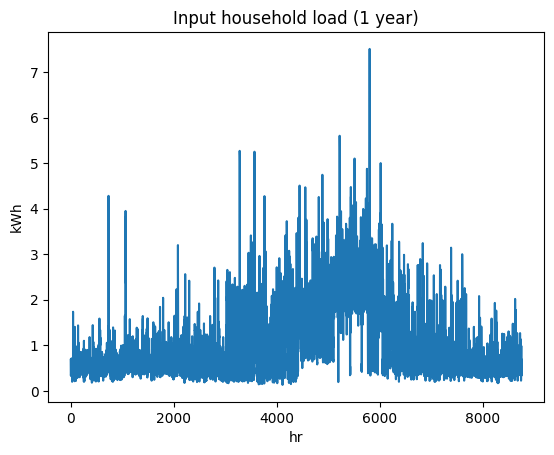

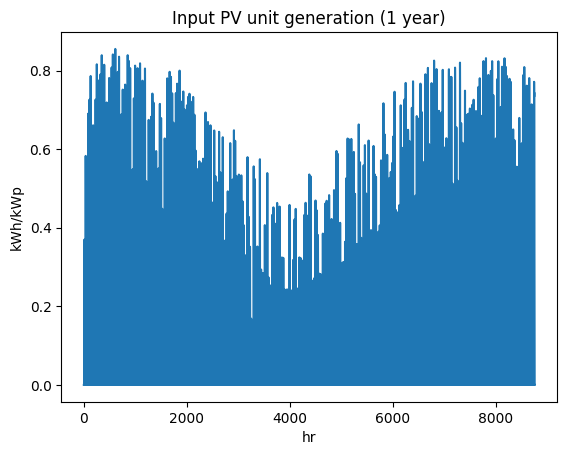

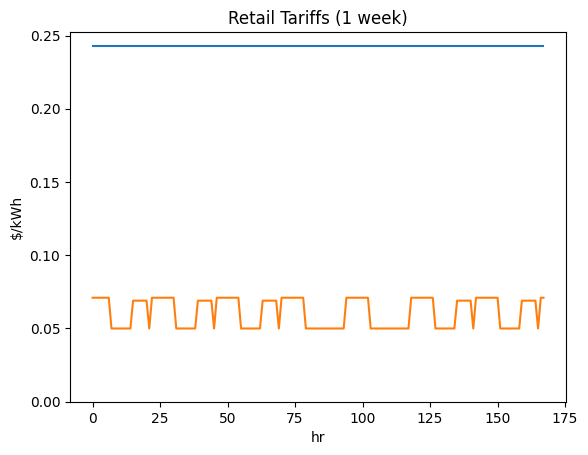

---- Optimising with PV: 1 - 20 kWp, Batt: 0 kWh. Determining PV capacity and dispatch.


************************************ Modell: PV > 1 kWp & BATT > 1 kWh ************************************
{'financial_horizon': 10, 'discount_rate': np.float64(0.06), 'grid_feedin_max': np.float64(5.0), 'pv_eol_capacity': np.float64(0.8), 'pv_eol_years': np.float64(25.0), 'pv_init_soh': np.float64(1.0), 'bess_e2p_ratio': np.float64(2.4), 'bess_roundtrip_eff': np.float64(0.88), 'bess_eol_years': np.float64(10.0), 'bess_eol_capacity': np.float64(0.7), 'bess_eol_cycles': np.float64(10000.0), 'bess_init_soh': np.float64(1.0), 'bess_eff_charge': np.float64(0.938083151964686), 'bess_eff_discharge': np.float64(0.938083151964686), 'scenario_name': 'Scenario_D_+5', 'scenario_set': 'SurfCoast', 'scenario_subset': 'JJP_open', 'year_start': 2022, 'datetime_name': 'DateTime1', 'meter_name': 'pc3013_nmi4390377056', 'solar_name': 'MELB', 'tariff_name_import_wkday': '3_Im_wkday', 'tariff_name_export_wkday': '3_

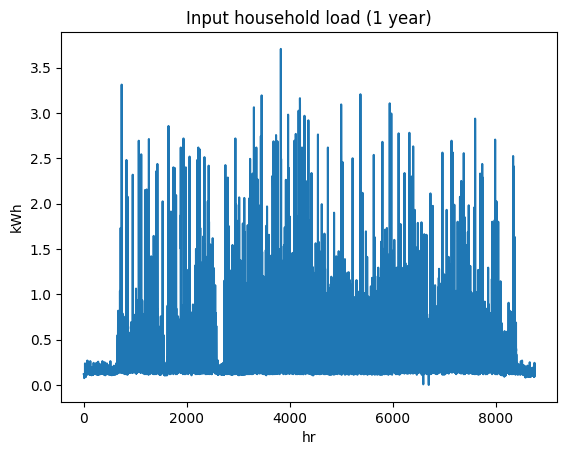

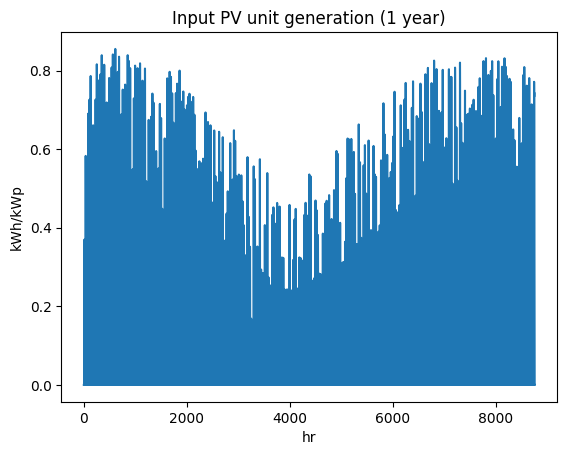

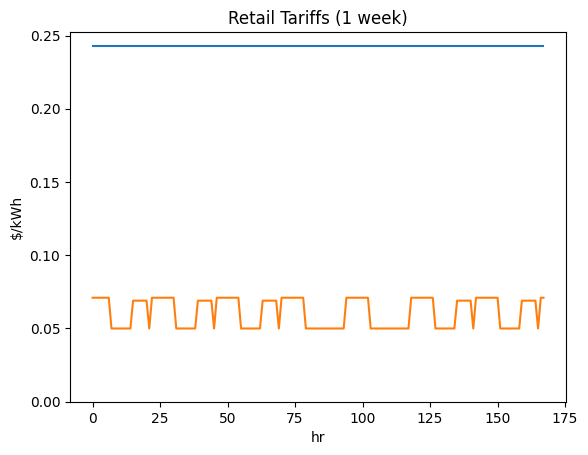

---- Optimising with PV: 1 - 20 kWp, Batt: 0 kWh. Determining PV capacity and dispatch.


************************************ Modell: PV > 1 kWp & BATT > 1 kWh ************************************
{'financial_horizon': 10, 'discount_rate': np.float64(0.06), 'grid_feedin_max': np.float64(5.0), 'pv_eol_capacity': np.float64(0.8), 'pv_eol_years': np.float64(25.0), 'pv_init_soh': np.float64(1.0), 'bess_e2p_ratio': np.float64(2.4), 'bess_roundtrip_eff': np.float64(0.88), 'bess_eol_years': np.float64(10.0), 'bess_eol_capacity': np.float64(0.7), 'bess_eol_cycles': np.float64(10000.0), 'bess_init_soh': np.float64(1.0), 'bess_eff_charge': np.float64(0.938083151964686), 'bess_eff_discharge': np.float64(0.938083151964686), 'scenario_name': 'Scenario_D_+5', 'scenario_set': 'SurfCoast', 'scenario_subset': 'JJP_open', 'year_start': 2022, 'datetime_name': 'DateTime1', 'meter_name': 'pc3012_nmi9004068093', 'solar_name': 'MELB', 'tariff_name_import_wkday': '3_Im_wkday', 'tariff_name_export_wkday': '3_

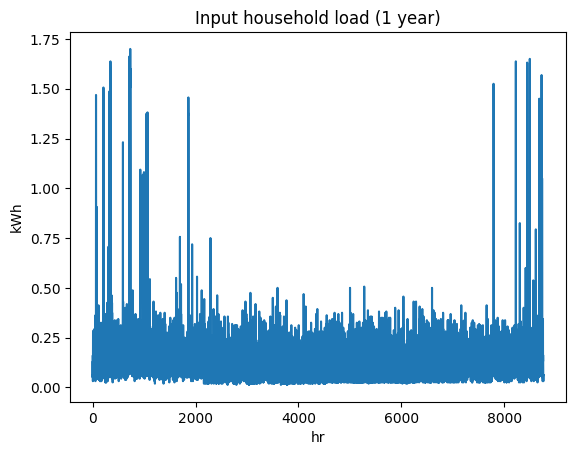

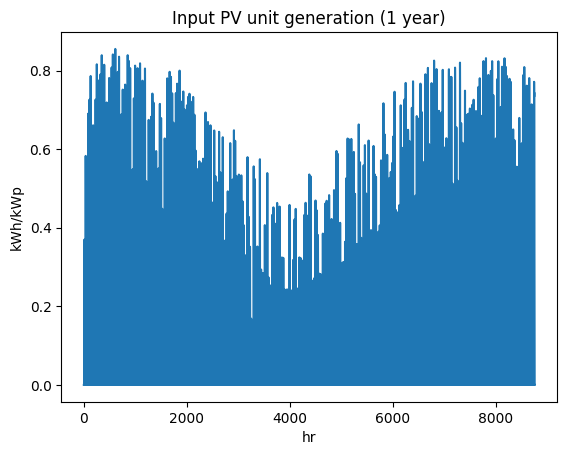

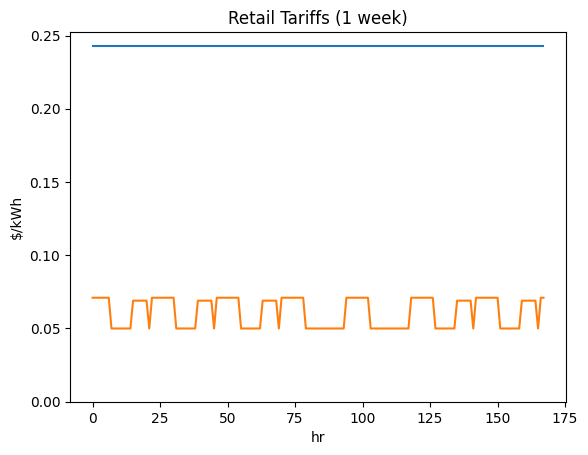

---- Optimising with PV: 1 - 20 kWp, Batt: 0 kWh. Determining PV capacity and dispatch.


************************************ Modell: PV > 1 kWp & BATT > 1 kWh ************************************
{'financial_horizon': 10, 'discount_rate': np.float64(0.06), 'grid_feedin_max': np.float64(5.0), 'pv_eol_capacity': np.float64(0.8), 'pv_eol_years': np.float64(25.0), 'pv_init_soh': np.float64(1.0), 'bess_e2p_ratio': np.float64(2.4), 'bess_roundtrip_eff': np.float64(0.88), 'bess_eol_years': np.float64(10.0), 'bess_eol_capacity': np.float64(0.7), 'bess_eol_cycles': np.float64(10000.0), 'bess_init_soh': np.float64(1.0), 'bess_eff_charge': np.float64(0.938083151964686), 'bess_eff_discharge': np.float64(0.938083151964686), 'scenario_name': 'Scenario_D_+5', 'scenario_set': 'SurfCoast', 'scenario_subset': 'JJP_open', 'year_start': 2022, 'datetime_name': 'DateTime1', 'meter_name': 'pc3012_nmi5664648151', 'solar_name': 'MELB', 'tariff_name_import_wkday': '3_Im_wkday', 'tariff_name_export_wkday': '3_

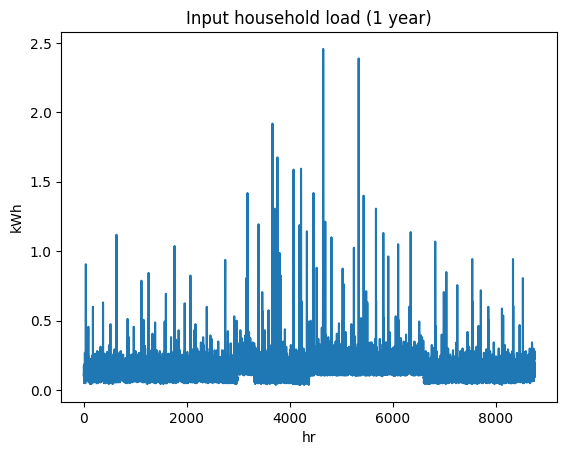

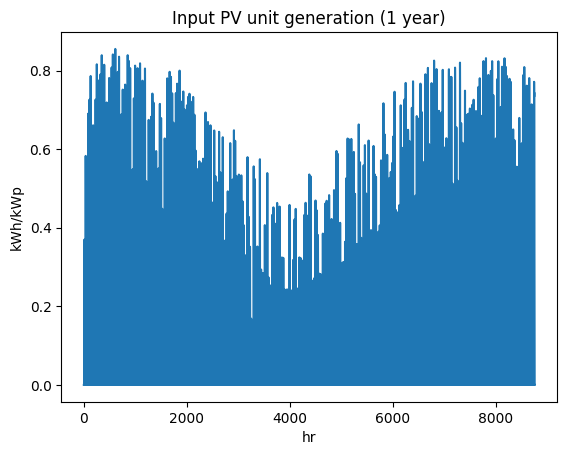

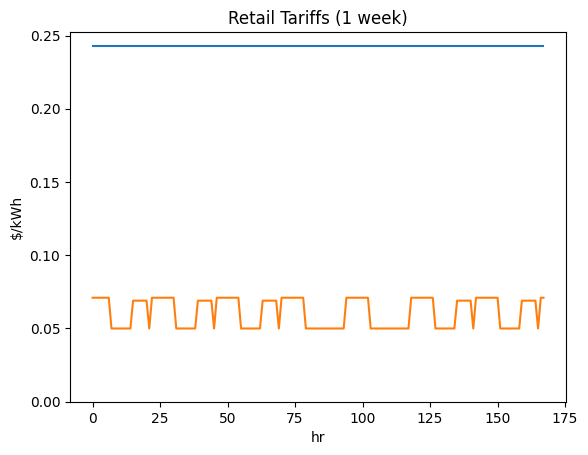

---- Optimising with PV: 1 - 20 kWp, Batt: 0 kWh. Determining PV capacity and dispatch.


************************************ Modell: PV > 1 kWp & BATT > 1 kWh ************************************
{'financial_horizon': 10, 'discount_rate': np.float64(0.06), 'grid_feedin_max': np.float64(5.0), 'pv_eol_capacity': np.float64(0.8), 'pv_eol_years': np.float64(25.0), 'pv_init_soh': np.float64(1.0), 'bess_e2p_ratio': np.float64(2.4), 'bess_roundtrip_eff': np.float64(0.88), 'bess_eol_years': np.float64(10.0), 'bess_eol_capacity': np.float64(0.7), 'bess_eol_cycles': np.float64(10000.0), 'bess_init_soh': np.float64(1.0), 'bess_eff_charge': np.float64(0.938083151964686), 'bess_eff_discharge': np.float64(0.938083151964686), 'scenario_name': 'Scenario_D_+5', 'scenario_set': 'SurfCoast', 'scenario_subset': 'JJP_open', 'year_start': 2022, 'datetime_name': 'DateTime1', 'meter_name': 'pc3012_nmi3495108131', 'solar_name': 'MELB', 'tariff_name_import_wkday': '3_Im_wkday', 'tariff_name_export_wkday': '3_

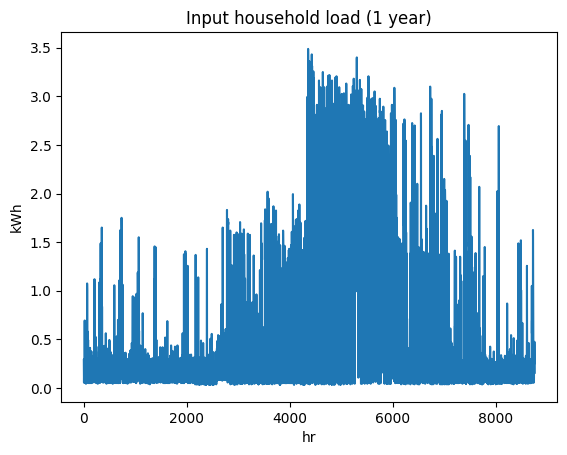

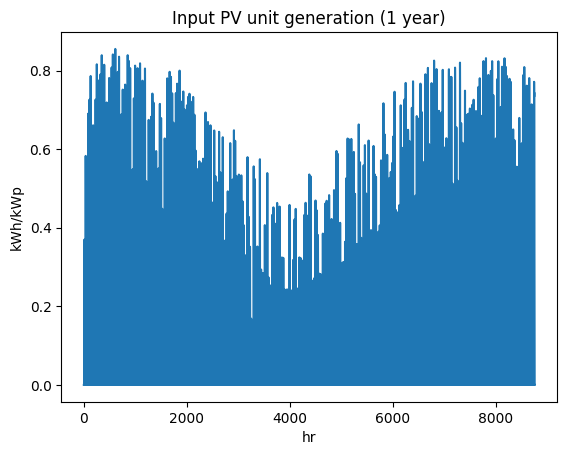

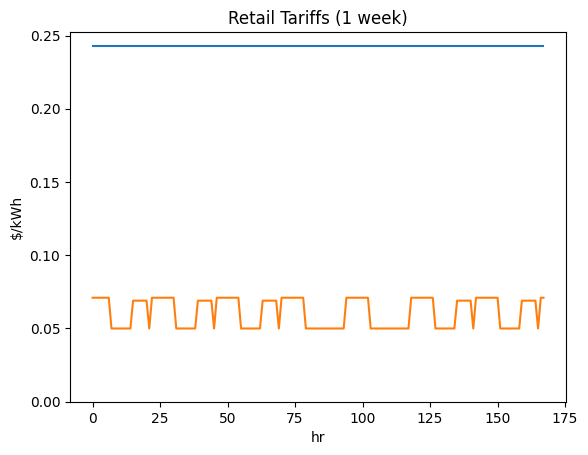

---- Optimising with PV: 1 - 20 kWp, Batt: 0 kWh. Determining PV capacity and dispatch.


************************************ Modell: PV > 1 kWp & BATT > 1 kWh ************************************
{'financial_horizon': 10, 'discount_rate': np.float64(0.06), 'grid_feedin_max': np.float64(5.0), 'pv_eol_capacity': np.float64(0.8), 'pv_eol_years': np.float64(25.0), 'pv_init_soh': np.float64(1.0), 'bess_e2p_ratio': np.float64(2.4), 'bess_roundtrip_eff': np.float64(0.88), 'bess_eol_years': np.float64(10.0), 'bess_eol_capacity': np.float64(0.7), 'bess_eol_cycles': np.float64(10000.0), 'bess_init_soh': np.float64(1.0), 'bess_eff_charge': np.float64(0.938083151964686), 'bess_eff_discharge': np.float64(0.938083151964686), 'scenario_name': 'Scenario_D_+5', 'scenario_set': 'SurfCoast', 'scenario_subset': 'JJP_open', 'year_start': 2022, 'datetime_name': 'DateTime1', 'meter_name': 'pc3012_nmi4431039620', 'solar_name': 'MELB', 'tariff_name_import_wkday': '3_Im_wkday', 'tariff_name_export_wkday': '3_

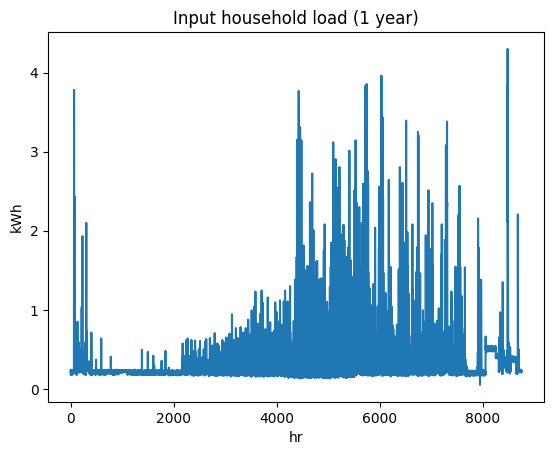

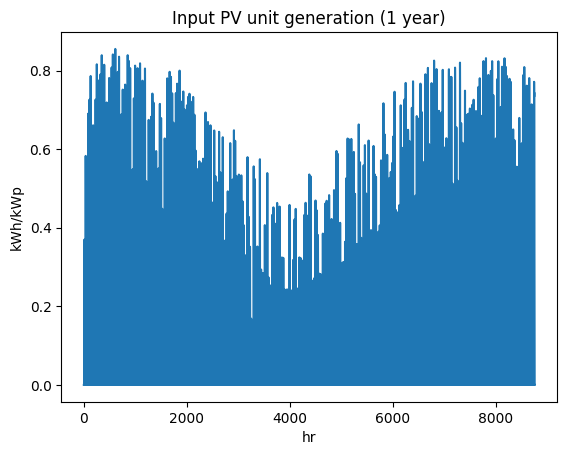

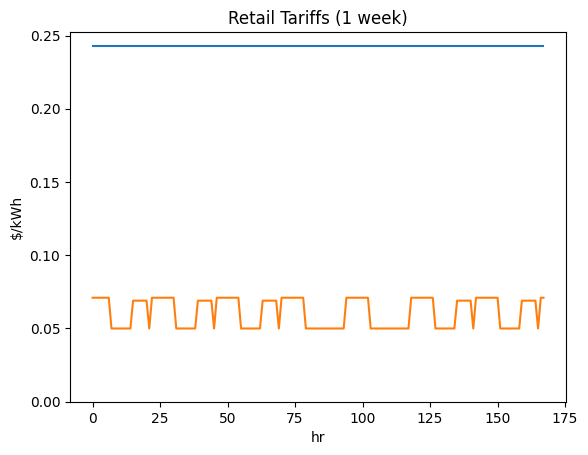

---- Optimising with PV: 1 - 20 kWp, Batt: 0 kWh. Determining PV capacity and dispatch.


************************************ Modell: PV > 1 kWp & BATT > 1 kWh ************************************
{'financial_horizon': 10, 'discount_rate': np.float64(0.06), 'grid_feedin_max': np.float64(5.0), 'pv_eol_capacity': np.float64(0.8), 'pv_eol_years': np.float64(25.0), 'pv_init_soh': np.float64(1.0), 'bess_e2p_ratio': np.float64(2.4), 'bess_roundtrip_eff': np.float64(0.88), 'bess_eol_years': np.float64(10.0), 'bess_eol_capacity': np.float64(0.7), 'bess_eol_cycles': np.float64(10000.0), 'bess_init_soh': np.float64(1.0), 'bess_eff_charge': np.float64(0.938083151964686), 'bess_eff_discharge': np.float64(0.938083151964686), 'scenario_name': 'Scenario_D_+5', 'scenario_set': 'SurfCoast', 'scenario_subset': 'JJP_open', 'year_start': 2022, 'datetime_name': 'DateTime1', 'meter_name': 'pc3012_nmi1083075838', 'solar_name': 'MELB', 'tariff_name_import_wkday': '3_Im_wkday', 'tariff_name_export_wkday': '3_

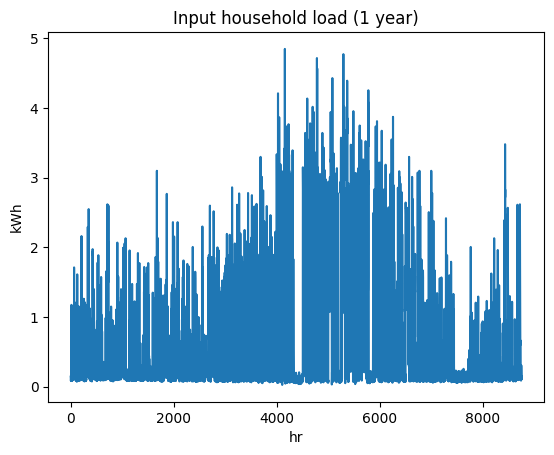

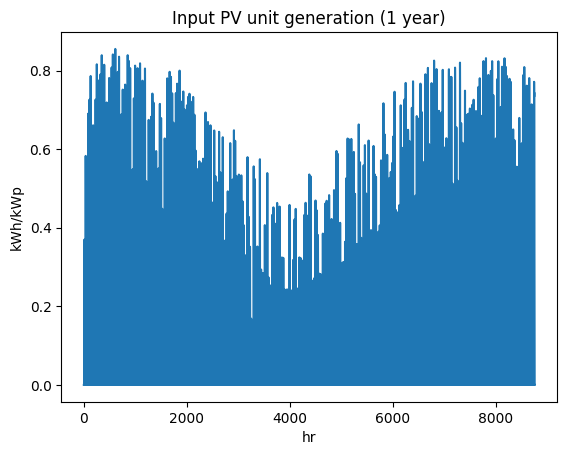

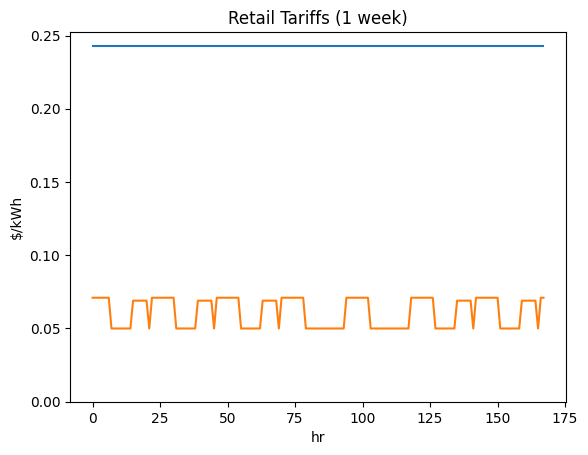

---- Optimising with PV: 1 - 20 kWp, Batt: 0 kWh. Determining PV capacity and dispatch.


************************************ Modell: PV > 1 kWp & BATT > 1 kWh ************************************
{'financial_horizon': 10, 'discount_rate': np.float64(0.06), 'grid_feedin_max': np.float64(5.0), 'pv_eol_capacity': np.float64(0.8), 'pv_eol_years': np.float64(25.0), 'pv_init_soh': np.float64(1.0), 'bess_e2p_ratio': np.float64(2.4), 'bess_roundtrip_eff': np.float64(0.88), 'bess_eol_years': np.float64(10.0), 'bess_eol_capacity': np.float64(0.7), 'bess_eol_cycles': np.float64(10000.0), 'bess_init_soh': np.float64(1.0), 'bess_eff_charge': np.float64(0.938083151964686), 'bess_eff_discharge': np.float64(0.938083151964686), 'scenario_name': 'Scenario_D_+5', 'scenario_set': 'SurfCoast', 'scenario_subset': 'JJP_open', 'year_start': 2022, 'datetime_name': 'DateTime1', 'meter_name': 'pc3012_nmi7257700318', 'solar_name': 'MELB', 'tariff_name_import_wkday': '3_Im_wkday', 'tariff_name_export_wkday': '3_

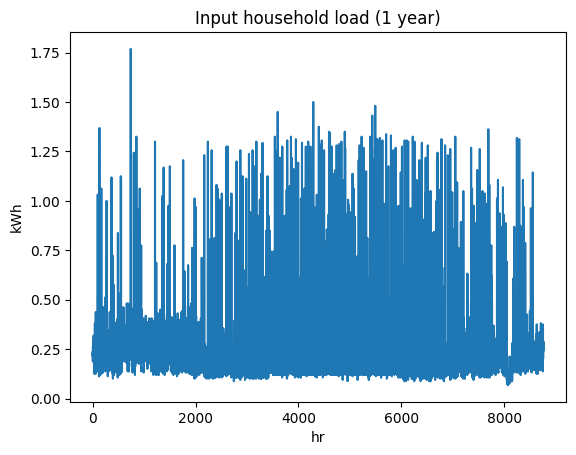

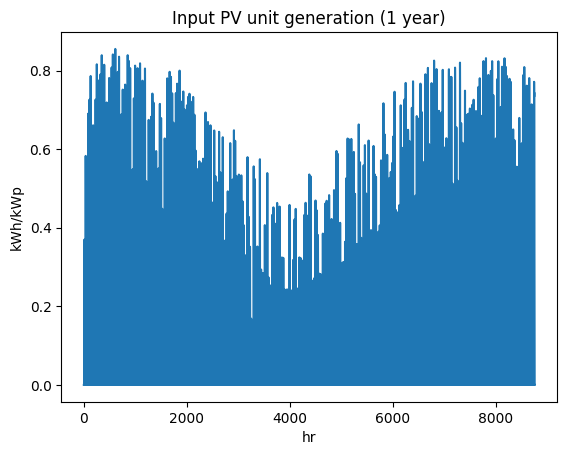

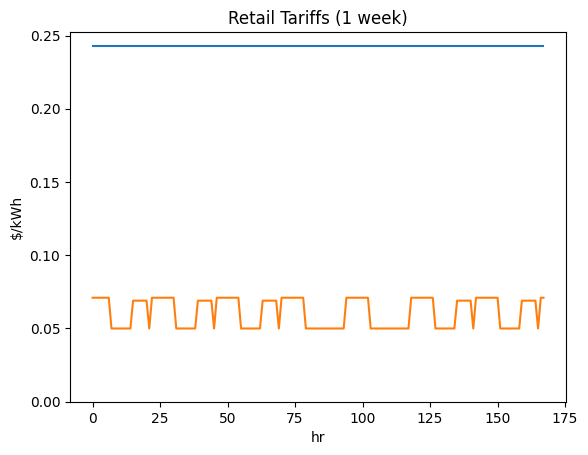

---- Optimising with PV: 1 - 20 kWp, Batt: 0 kWh. Determining PV capacity and dispatch.


************************************ Modell: PV > 1 kWp & BATT > 1 kWh ************************************
{'financial_horizon': 10, 'discount_rate': np.float64(0.06), 'grid_feedin_max': np.float64(5.0), 'pv_eol_capacity': np.float64(0.8), 'pv_eol_years': np.float64(25.0), 'pv_init_soh': np.float64(1.0), 'bess_e2p_ratio': np.float64(2.4), 'bess_roundtrip_eff': np.float64(0.88), 'bess_eol_years': np.float64(10.0), 'bess_eol_capacity': np.float64(0.7), 'bess_eol_cycles': np.float64(10000.0), 'bess_init_soh': np.float64(1.0), 'bess_eff_charge': np.float64(0.938083151964686), 'bess_eff_discharge': np.float64(0.938083151964686), 'scenario_name': 'Scenario_D_+5', 'scenario_set': 'SurfCoast', 'scenario_subset': 'JJP_open', 'year_start': 2022, 'datetime_name': 'DateTime1', 'meter_name': 'pc3012_nmi2122203204', 'solar_name': 'MELB', 'tariff_name_import_wkday': '3_Im_wkday', 'tariff_name_export_wkday': '3_

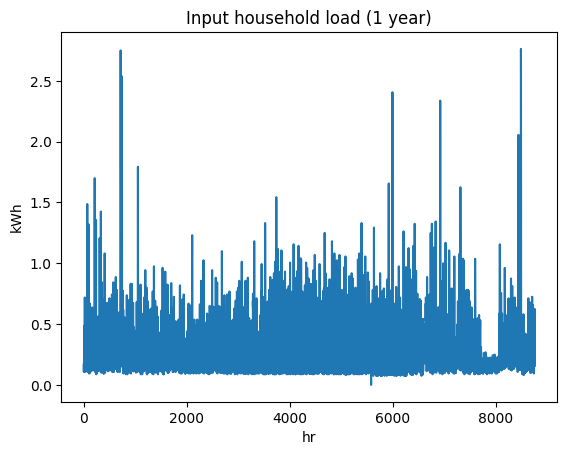

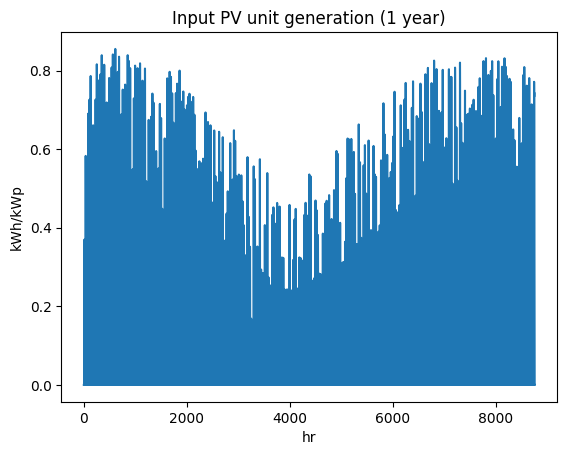

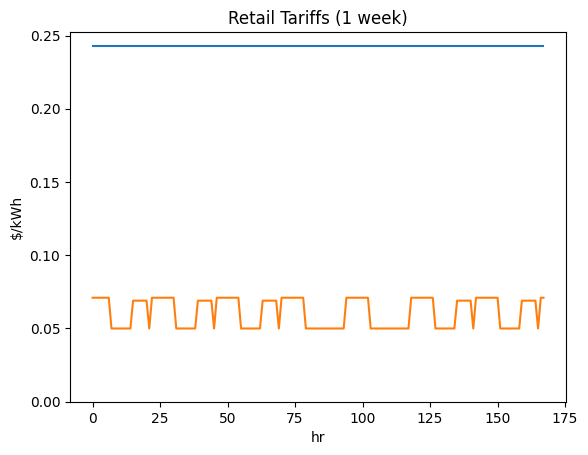

---- Optimising with PV: 1 - 20 kWp, Batt: 0 kWh. Determining PV capacity and dispatch.


************************************ Modell: PV > 1 kWp & BATT > 1 kWh ************************************
{'financial_horizon': 10, 'discount_rate': np.float64(0.06), 'grid_feedin_max': np.float64(5.0), 'pv_eol_capacity': np.float64(0.8), 'pv_eol_years': np.float64(25.0), 'pv_init_soh': np.float64(1.0), 'bess_e2p_ratio': np.float64(2.4), 'bess_roundtrip_eff': np.float64(0.88), 'bess_eol_years': np.float64(10.0), 'bess_eol_capacity': np.float64(0.7), 'bess_eol_cycles': np.float64(10000.0), 'bess_init_soh': np.float64(1.0), 'bess_eff_charge': np.float64(0.938083151964686), 'bess_eff_discharge': np.float64(0.938083151964686), 'scenario_name': 'Scenario_D_+5', 'scenario_set': 'SurfCoast', 'scenario_subset': 'JJP_open', 'year_start': 2022, 'datetime_name': 'DateTime1', 'meter_name': 'pc3012_nmi2936793068', 'solar_name': 'MELB', 'tariff_name_import_wkday': '3_Im_wkday', 'tariff_name_export_wkday': '3_

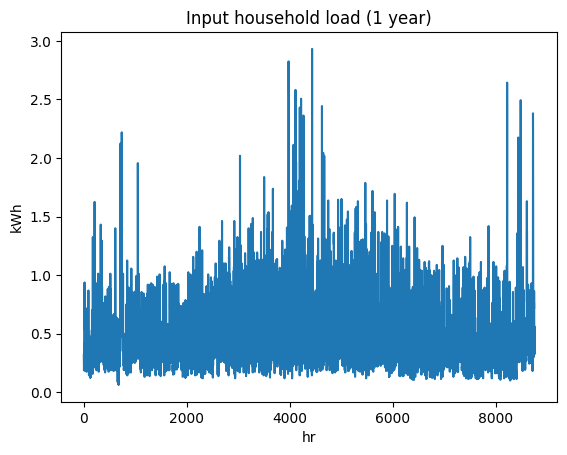

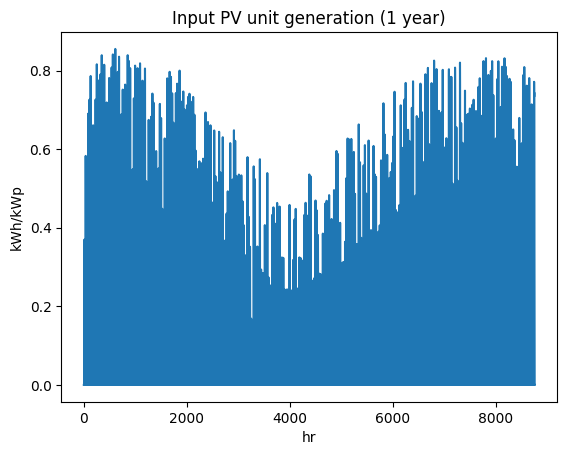

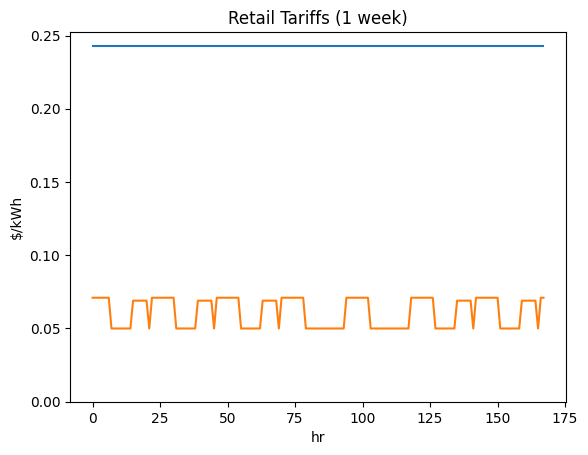

---- Optimising with PV: 1 - 20 kWp, Batt: 0 kWh. Determining PV capacity and dispatch.


************************************ Modell: PV > 1 kWp & BATT > 1 kWh ************************************
{'financial_horizon': 10, 'discount_rate': np.float64(0.06), 'grid_feedin_max': np.float64(5.0), 'pv_eol_capacity': np.float64(0.8), 'pv_eol_years': np.float64(25.0), 'pv_init_soh': np.float64(1.0), 'bess_e2p_ratio': np.float64(2.4), 'bess_roundtrip_eff': np.float64(0.88), 'bess_eol_years': np.float64(10.0), 'bess_eol_capacity': np.float64(0.7), 'bess_eol_cycles': np.float64(10000.0), 'bess_init_soh': np.float64(1.0), 'bess_eff_charge': np.float64(0.938083151964686), 'bess_eff_discharge': np.float64(0.938083151964686), 'scenario_name': 'Scenario_D_+5', 'scenario_set': 'SurfCoast', 'scenario_subset': 'JJP_open', 'year_start': 2022, 'datetime_name': 'DateTime1', 'meter_name': 'pc3012_nmi8931458587', 'solar_name': 'MELB', 'tariff_name_import_wkday': '3_Im_wkday', 'tariff_name_export_wkday': '3_

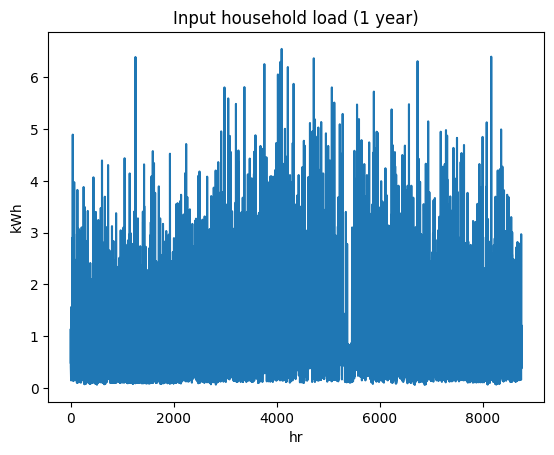

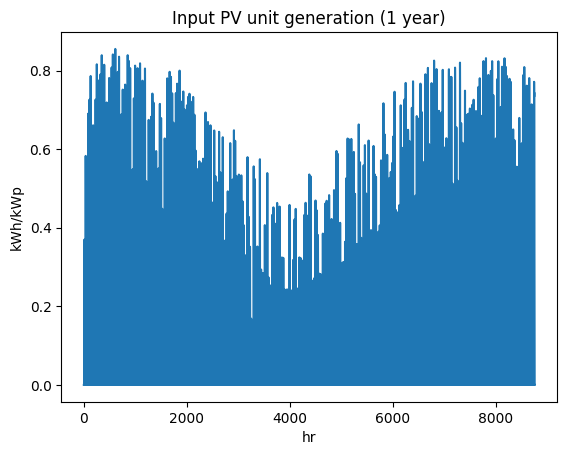

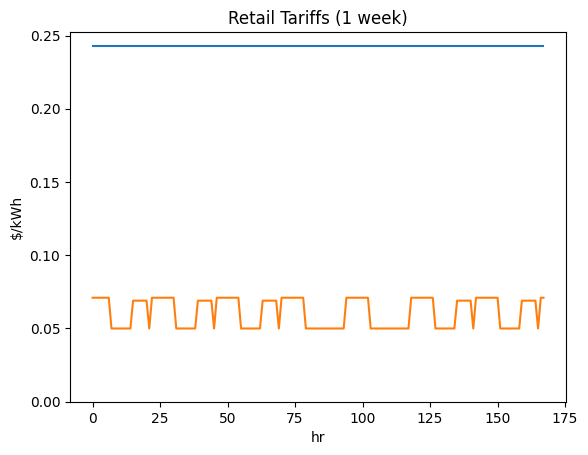

---- Optimising with PV: 1 - 20 kWp, Batt: 0 kWh. Determining PV capacity and dispatch.


************************************ Modell: PV > 1 kWp & BATT > 1 kWh ************************************
{'financial_horizon': 10, 'discount_rate': np.float64(0.06), 'grid_feedin_max': np.float64(5.0), 'pv_eol_capacity': np.float64(0.8), 'pv_eol_years': np.float64(25.0), 'pv_init_soh': np.float64(1.0), 'bess_e2p_ratio': np.float64(2.4), 'bess_roundtrip_eff': np.float64(0.88), 'bess_eol_years': np.float64(10.0), 'bess_eol_capacity': np.float64(0.7), 'bess_eol_cycles': np.float64(10000.0), 'bess_init_soh': np.float64(1.0), 'bess_eff_charge': np.float64(0.938083151964686), 'bess_eff_discharge': np.float64(0.938083151964686), 'scenario_name': 'Scenario_D_+5', 'scenario_set': 'SurfCoast', 'scenario_subset': 'JJP_open', 'year_start': 2022, 'datetime_name': 'DateTime1', 'meter_name': 'pc3012_nmi1481499220', 'solar_name': 'MELB', 'tariff_name_import_wkday': '3_Im_wkday', 'tariff_name_export_wkday': '3_

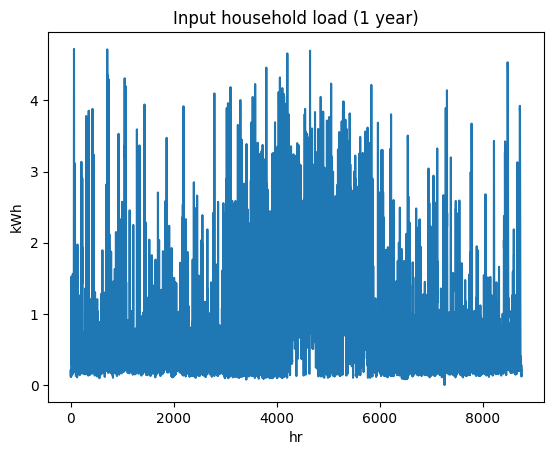

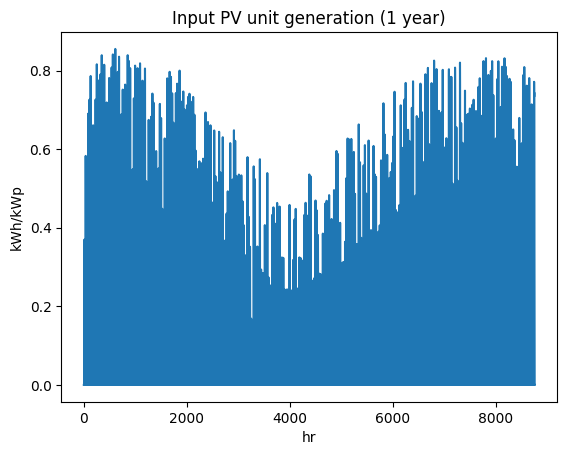

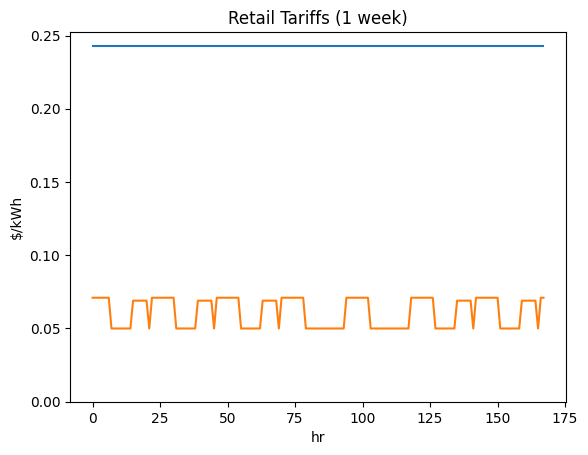

---- Optimising with PV: 1 - 20 kWp, Batt: 0 kWh. Determining PV capacity and dispatch.


************************************ Modell: PV > 1 kWp & BATT > 1 kWh ************************************
{'financial_horizon': 10, 'discount_rate': np.float64(0.06), 'grid_feedin_max': np.float64(5.0), 'pv_eol_capacity': np.float64(0.8), 'pv_eol_years': np.float64(25.0), 'pv_init_soh': np.float64(1.0), 'bess_e2p_ratio': np.float64(2.4), 'bess_roundtrip_eff': np.float64(0.88), 'bess_eol_years': np.float64(10.0), 'bess_eol_capacity': np.float64(0.7), 'bess_eol_cycles': np.float64(10000.0), 'bess_init_soh': np.float64(1.0), 'bess_eff_charge': np.float64(0.938083151964686), 'bess_eff_discharge': np.float64(0.938083151964686), 'scenario_name': 'Scenario_D_+5', 'scenario_set': 'SurfCoast', 'scenario_subset': 'JJP_open', 'year_start': 2022, 'datetime_name': 'DateTime1', 'meter_name': 'pc3013_nmi2928568491', 'solar_name': 'MELB', 'tariff_name_import_wkday': '3_Im_wkday', 'tariff_name_export_wkday': '3_

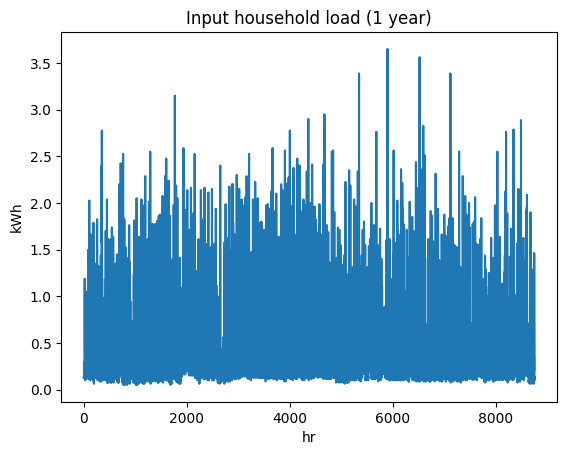

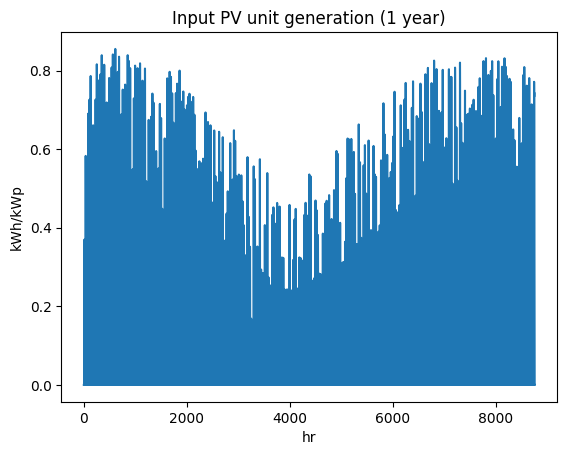

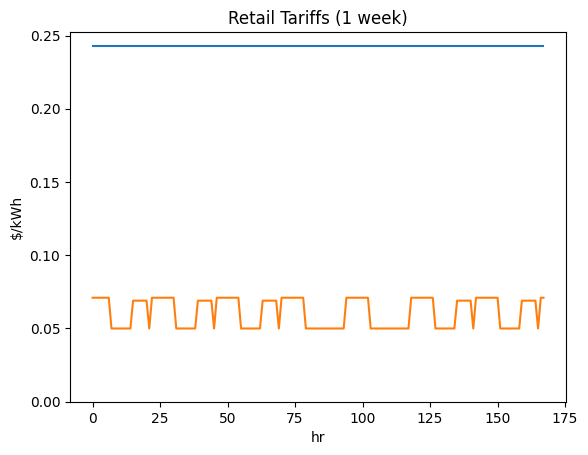

---- Optimising with PV: 1 - 20 kWp, Batt: 0 kWh. Determining PV capacity and dispatch.


************************************ Modell: PV > 1 kWp & BATT > 1 kWh ************************************
{'financial_horizon': 10, 'discount_rate': np.float64(0.06), 'grid_feedin_max': np.float64(5.0), 'pv_eol_capacity': np.float64(0.8), 'pv_eol_years': np.float64(25.0), 'pv_init_soh': np.float64(1.0), 'bess_e2p_ratio': np.float64(2.4), 'bess_roundtrip_eff': np.float64(0.88), 'bess_eol_years': np.float64(10.0), 'bess_eol_capacity': np.float64(0.7), 'bess_eol_cycles': np.float64(10000.0), 'bess_init_soh': np.float64(1.0), 'bess_eff_charge': np.float64(0.938083151964686), 'bess_eff_discharge': np.float64(0.938083151964686), 'scenario_name': 'Scenario_D_+5', 'scenario_set': 'SurfCoast', 'scenario_subset': 'JJP_open', 'year_start': 2022, 'datetime_name': 'DateTime1', 'meter_name': 'pc3013_nmi9488140945', 'solar_name': 'MELB', 'tariff_name_import_wkday': '3_Im_wkday', 'tariff_name_export_wkday': '3_

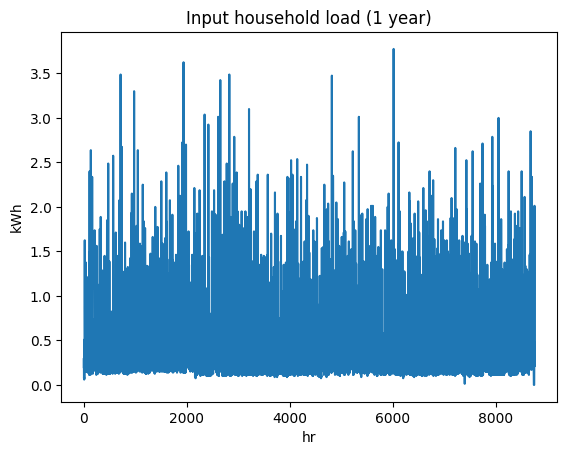

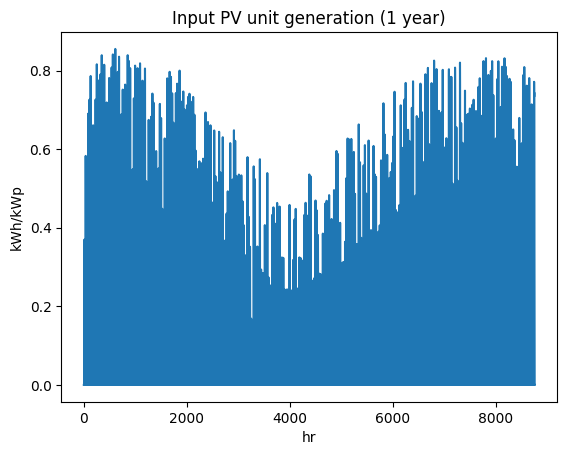

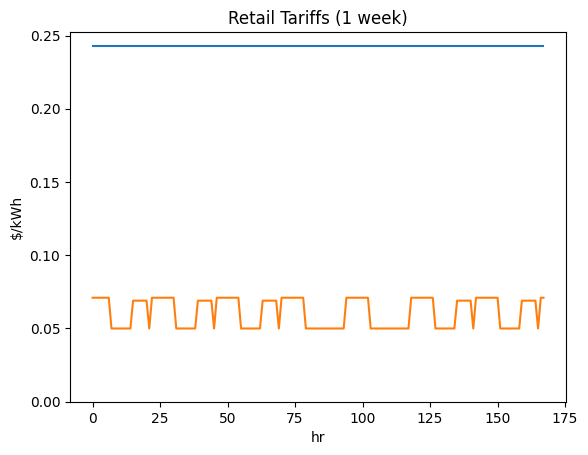

---- Optimising with PV: 1 - 20 kWp, Batt: 0 kWh. Determining PV capacity and dispatch.


************************************ Modell: PV > 1 kWp & BATT > 1 kWh ************************************
{'financial_horizon': 10, 'discount_rate': np.float64(0.06), 'grid_feedin_max': np.float64(5.0), 'pv_eol_capacity': np.float64(0.8), 'pv_eol_years': np.float64(25.0), 'pv_init_soh': np.float64(1.0), 'bess_e2p_ratio': np.float64(2.4), 'bess_roundtrip_eff': np.float64(0.88), 'bess_eol_years': np.float64(10.0), 'bess_eol_capacity': np.float64(0.7), 'bess_eol_cycles': np.float64(10000.0), 'bess_init_soh': np.float64(1.0), 'bess_eff_charge': np.float64(0.938083151964686), 'bess_eff_discharge': np.float64(0.938083151964686), 'scenario_name': 'Scenario_D_+5', 'scenario_set': 'SurfCoast', 'scenario_subset': 'JJP_open', 'year_start': 2022, 'datetime_name': 'DateTime1', 'meter_name': 'pc3012_nmi8862998703', 'solar_name': 'MELB', 'tariff_name_import_wkday': '3_Im_wkday', 'tariff_name_export_wkday': '3_

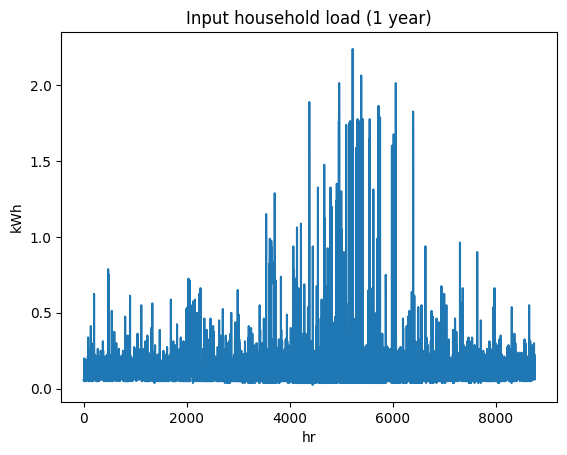

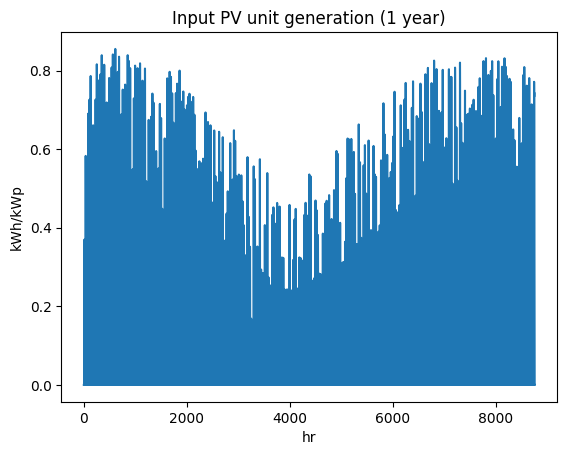

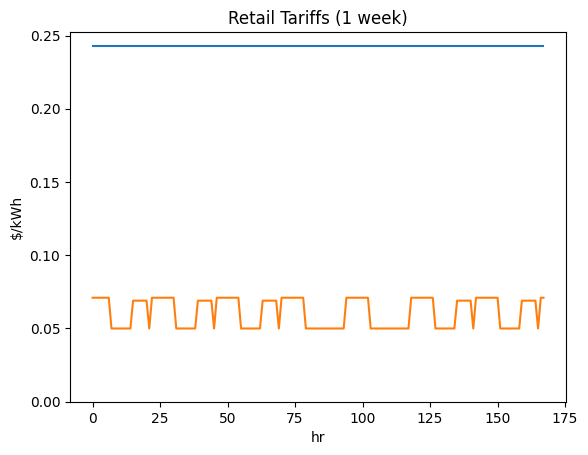

---- Optimising with PV: 1 - 20 kWp, Batt: 0 kWh. Determining PV capacity and dispatch.


************************************ Modell: PV > 1 kWp & BATT > 1 kWh ************************************
{'financial_horizon': 10, 'discount_rate': np.float64(0.06), 'grid_feedin_max': np.float64(5.0), 'pv_eol_capacity': np.float64(0.8), 'pv_eol_years': np.float64(25.0), 'pv_init_soh': np.float64(1.0), 'bess_e2p_ratio': np.float64(2.4), 'bess_roundtrip_eff': np.float64(0.88), 'bess_eol_years': np.float64(10.0), 'bess_eol_capacity': np.float64(0.7), 'bess_eol_cycles': np.float64(10000.0), 'bess_init_soh': np.float64(1.0), 'bess_eff_charge': np.float64(0.938083151964686), 'bess_eff_discharge': np.float64(0.938083151964686), 'scenario_name': 'Scenario_D_+5', 'scenario_set': 'SurfCoast', 'scenario_subset': 'JJP_open', 'year_start': 2022, 'datetime_name': 'DateTime1', 'meter_name': 'pc3012_nmi8336725090', 'solar_name': 'MELB', 'tariff_name_import_wkday': '3_Im_wkday', 'tariff_name_export_wkday': '3_

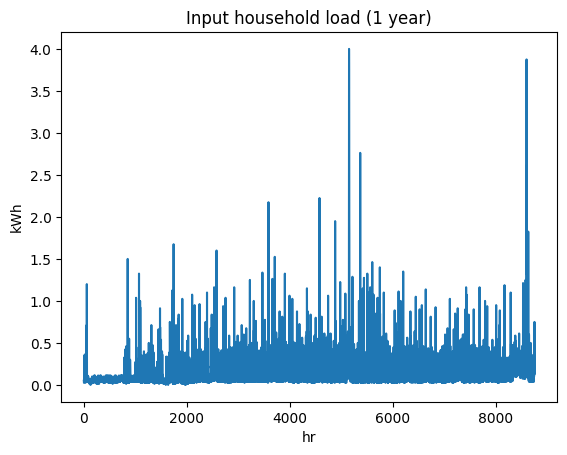

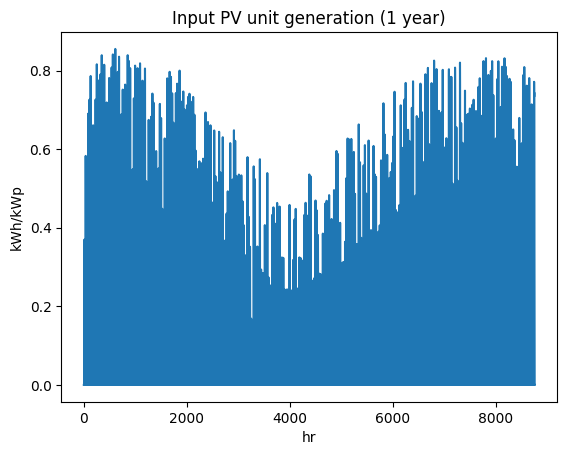

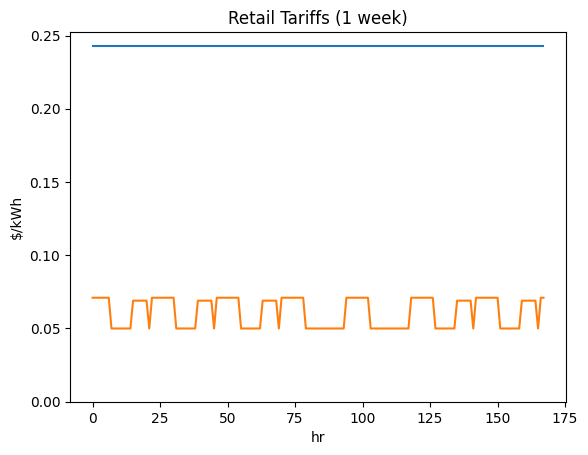

---- Optimising with PV: 1 - 20 kWp, Batt: 0 kWh. Determining PV capacity and dispatch.


************************************ Modell: PV > 1 kWp & BATT > 1 kWh ************************************
{'financial_horizon': 10, 'discount_rate': np.float64(0.06), 'grid_feedin_max': np.float64(5.0), 'pv_eol_capacity': np.float64(0.8), 'pv_eol_years': np.float64(25.0), 'pv_init_soh': np.float64(1.0), 'bess_e2p_ratio': np.float64(2.4), 'bess_roundtrip_eff': np.float64(0.88), 'bess_eol_years': np.float64(10.0), 'bess_eol_capacity': np.float64(0.7), 'bess_eol_cycles': np.float64(10000.0), 'bess_init_soh': np.float64(1.0), 'bess_eff_charge': np.float64(0.938083151964686), 'bess_eff_discharge': np.float64(0.938083151964686), 'scenario_name': 'Scenario_D_+5', 'scenario_set': 'SurfCoast', 'scenario_subset': 'JJP_open', 'year_start': 2022, 'datetime_name': 'DateTime1', 'meter_name': 'pc3012_nmi5743313774', 'solar_name': 'MELB', 'tariff_name_import_wkday': '3_Im_wkday', 'tariff_name_export_wkday': '3_

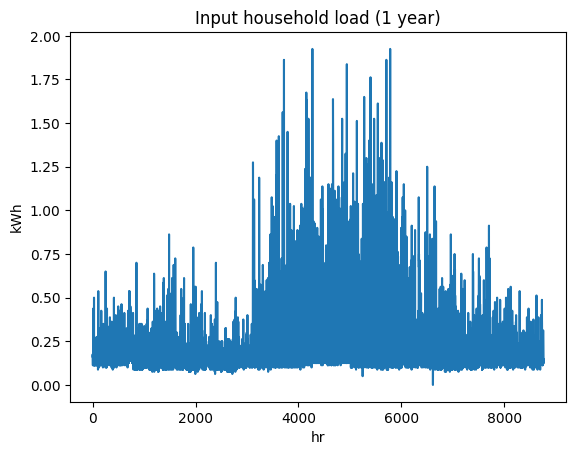

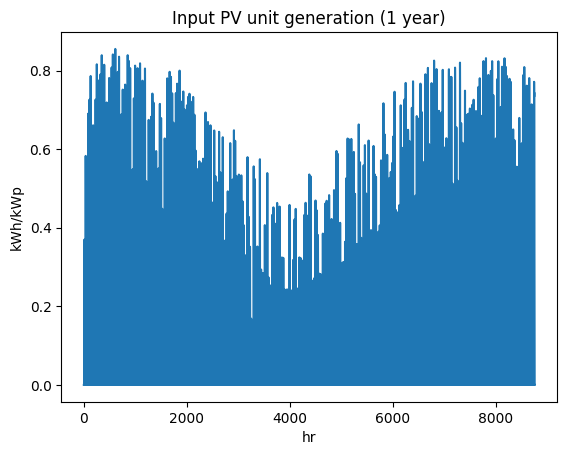

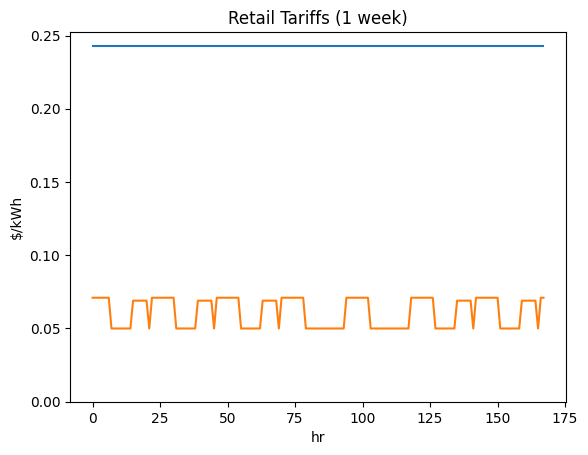

---- Optimising with PV: 1 - 20 kWp, Batt: 0 kWh. Determining PV capacity and dispatch.


************************************ Modell: PV > 1 kWp & BATT > 1 kWh ************************************
{'financial_horizon': 10, 'discount_rate': np.float64(0.06), 'grid_feedin_max': np.float64(5.0), 'pv_eol_capacity': np.float64(0.8), 'pv_eol_years': np.float64(25.0), 'pv_init_soh': np.float64(1.0), 'bess_e2p_ratio': np.float64(2.4), 'bess_roundtrip_eff': np.float64(0.88), 'bess_eol_years': np.float64(10.0), 'bess_eol_capacity': np.float64(0.7), 'bess_eol_cycles': np.float64(10000.0), 'bess_init_soh': np.float64(1.0), 'bess_eff_charge': np.float64(0.938083151964686), 'bess_eff_discharge': np.float64(0.938083151964686), 'scenario_name': 'Scenario_D_+5', 'scenario_set': 'SurfCoast', 'scenario_subset': 'JJP_open', 'year_start': 2022, 'datetime_name': 'DateTime1', 'meter_name': 'pc3012_nmi9676394728', 'solar_name': 'MELB', 'tariff_name_import_wkday': '3_Im_wkday', 'tariff_name_export_wkday': '3_

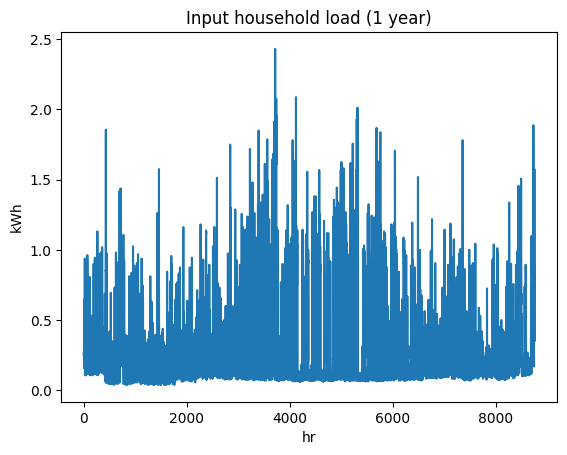

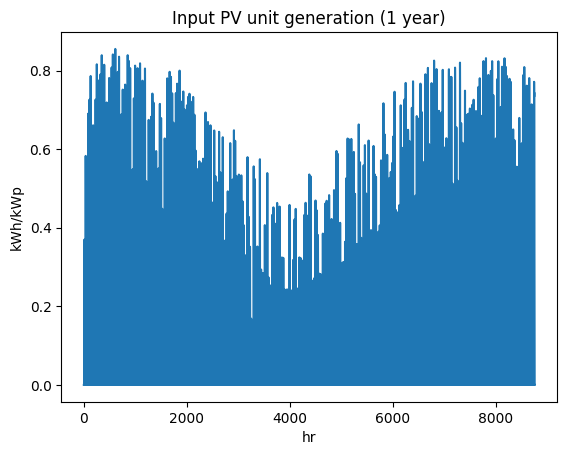

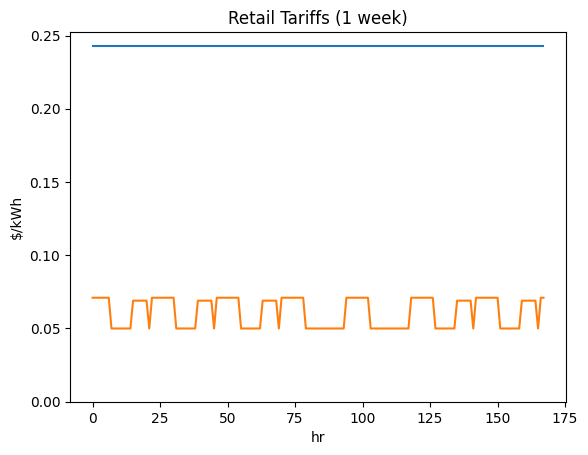

---- Optimising with PV: 1 - 20 kWp, Batt: 0 kWh. Determining PV capacity and dispatch.


************************************ Modell: PV > 1 kWp & BATT > 1 kWh ************************************
{'financial_horizon': 10, 'discount_rate': np.float64(0.06), 'grid_feedin_max': np.float64(5.0), 'pv_eol_capacity': np.float64(0.8), 'pv_eol_years': np.float64(25.0), 'pv_init_soh': np.float64(1.0), 'bess_e2p_ratio': np.float64(2.4), 'bess_roundtrip_eff': np.float64(0.88), 'bess_eol_years': np.float64(10.0), 'bess_eol_capacity': np.float64(0.7), 'bess_eol_cycles': np.float64(10000.0), 'bess_init_soh': np.float64(1.0), 'bess_eff_charge': np.float64(0.938083151964686), 'bess_eff_discharge': np.float64(0.938083151964686), 'scenario_name': 'Scenario_D_+5', 'scenario_set': 'SurfCoast', 'scenario_subset': 'JJP_open', 'year_start': 2022, 'datetime_name': 'DateTime1', 'meter_name': 'pc3012_nmi7629433882', 'solar_name': 'MELB', 'tariff_name_import_wkday': '3_Im_wkday', 'tariff_name_export_wkday': '3_

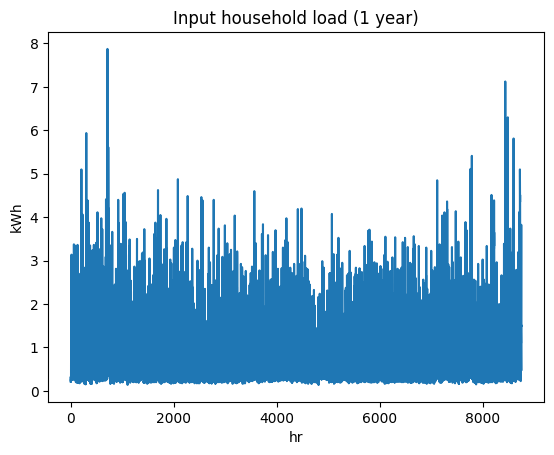

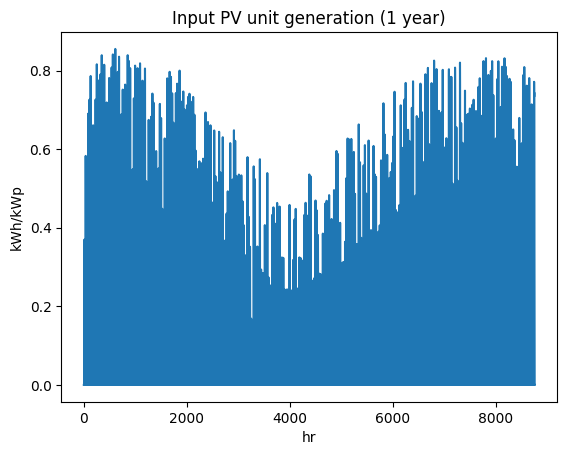

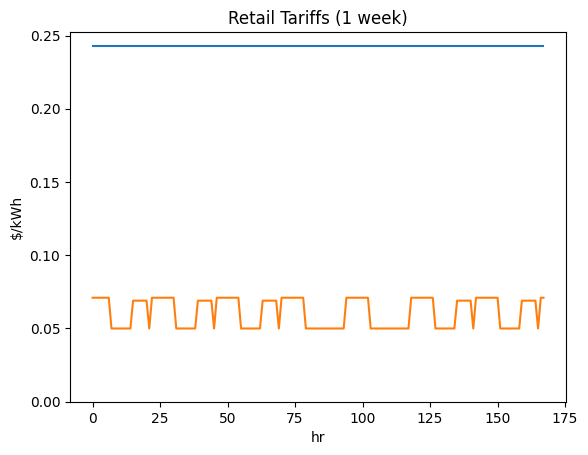

---- Optimising with PV: 1 - 20 kWp, Batt: 0 kWh. Determining PV capacity and dispatch.


************************************ Modell: PV > 1 kWp & BATT > 1 kWh ************************************
{'financial_horizon': 10, 'discount_rate': np.float64(0.06), 'grid_feedin_max': np.float64(5.0), 'pv_eol_capacity': np.float64(0.8), 'pv_eol_years': np.float64(25.0), 'pv_init_soh': np.float64(1.0), 'bess_e2p_ratio': np.float64(2.4), 'bess_roundtrip_eff': np.float64(0.88), 'bess_eol_years': np.float64(10.0), 'bess_eol_capacity': np.float64(0.7), 'bess_eol_cycles': np.float64(10000.0), 'bess_init_soh': np.float64(1.0), 'bess_eff_charge': np.float64(0.938083151964686), 'bess_eff_discharge': np.float64(0.938083151964686), 'scenario_name': 'Scenario_D_+5', 'scenario_set': 'SurfCoast', 'scenario_subset': 'JJP_open', 'year_start': 2022, 'datetime_name': 'DateTime1', 'meter_name': 'pc3012_nmi5601171044', 'solar_name': 'MELB', 'tariff_name_import_wkday': '3_Im_wkday', 'tariff_name_export_wkday': '3_

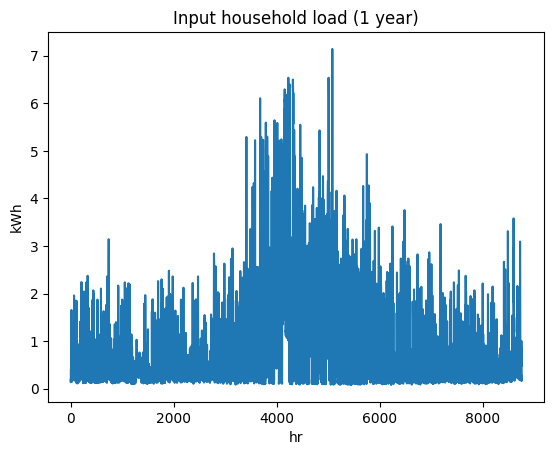

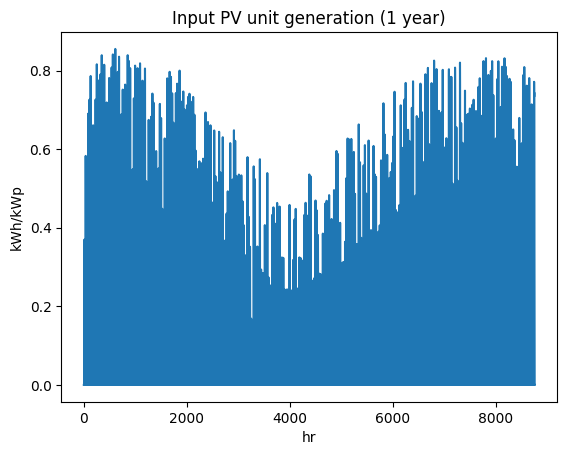

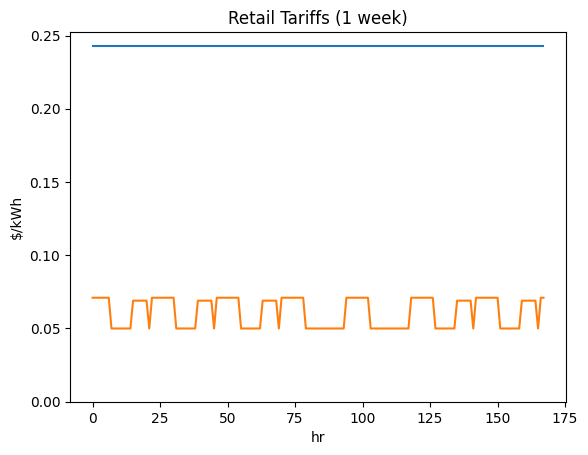

---- Optimising with PV: 1 - 20 kWp, Batt: 0 kWh. Determining PV capacity and dispatch.


************************************ Modell: PV > 1 kWp & BATT > 1 kWh ************************************
{'financial_horizon': 10, 'discount_rate': np.float64(0.06), 'grid_feedin_max': np.float64(5.0), 'pv_eol_capacity': np.float64(0.8), 'pv_eol_years': np.float64(25.0), 'pv_init_soh': np.float64(1.0), 'bess_e2p_ratio': np.float64(2.4), 'bess_roundtrip_eff': np.float64(0.88), 'bess_eol_years': np.float64(10.0), 'bess_eol_capacity': np.float64(0.7), 'bess_eol_cycles': np.float64(10000.0), 'bess_init_soh': np.float64(1.0), 'bess_eff_charge': np.float64(0.938083151964686), 'bess_eff_discharge': np.float64(0.938083151964686), 'scenario_name': 'Scenario_D_+5', 'scenario_set': 'SurfCoast', 'scenario_subset': 'JJP_open', 'year_start': 2022, 'datetime_name': 'DateTime1', 'meter_name': 'pc3012_nmi8704581493', 'solar_name': 'MELB', 'tariff_name_import_wkday': '3_Im_wkday', 'tariff_name_export_wkday': '3_

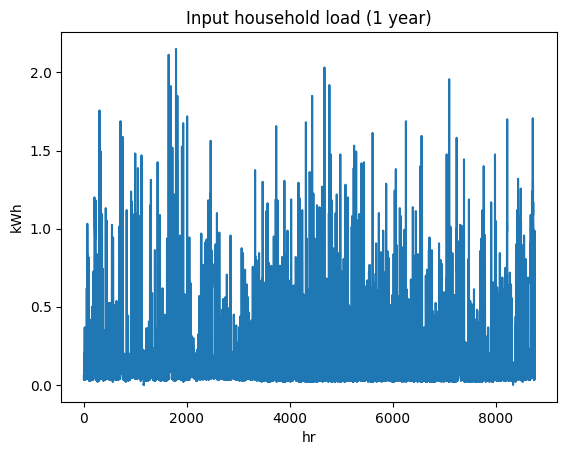

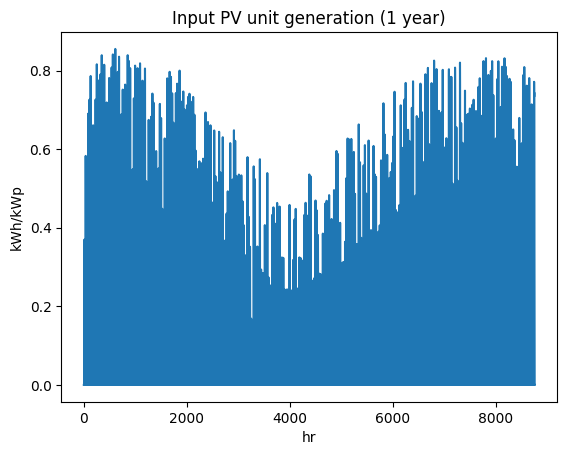

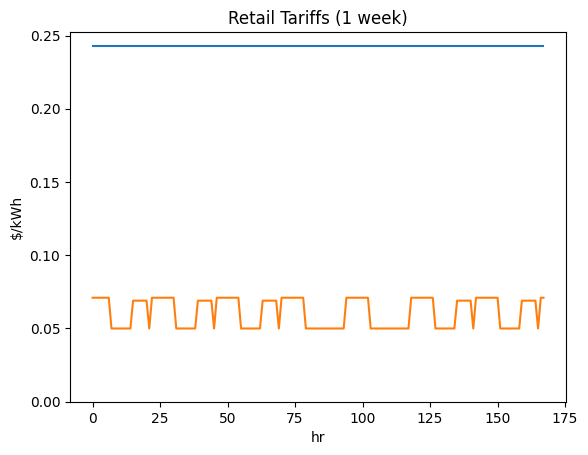

---- Optimising with PV: 1 - 20 kWp, Batt: 0 kWh. Determining PV capacity and dispatch.


************************************ Modell: PV > 1 kWp & BATT > 1 kWh ************************************
{'financial_horizon': 10, 'discount_rate': np.float64(0.06), 'grid_feedin_max': np.float64(5.0), 'pv_eol_capacity': np.float64(0.8), 'pv_eol_years': np.float64(25.0), 'pv_init_soh': np.float64(1.0), 'bess_e2p_ratio': np.float64(2.4), 'bess_roundtrip_eff': np.float64(0.88), 'bess_eol_years': np.float64(10.0), 'bess_eol_capacity': np.float64(0.7), 'bess_eol_cycles': np.float64(10000.0), 'bess_init_soh': np.float64(1.0), 'bess_eff_charge': np.float64(0.938083151964686), 'bess_eff_discharge': np.float64(0.938083151964686), 'scenario_name': 'Scenario_D_+5', 'scenario_set': 'SurfCoast', 'scenario_subset': 'JJP_open', 'year_start': 2022, 'datetime_name': 'DateTime1', 'meter_name': 'pc3012_nmi2775396990', 'solar_name': 'MELB', 'tariff_name_import_wkday': '3_Im_wkday', 'tariff_name_export_wkday': '3_

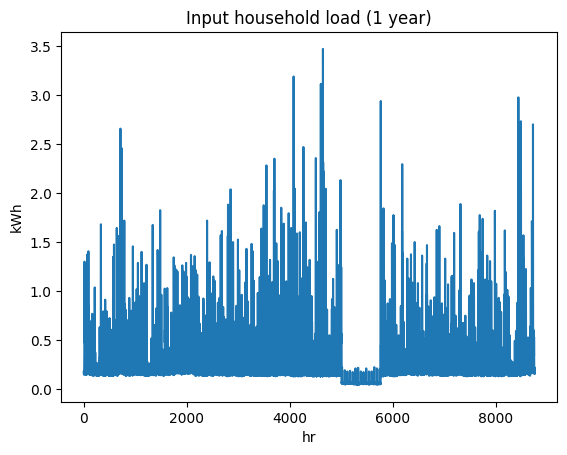

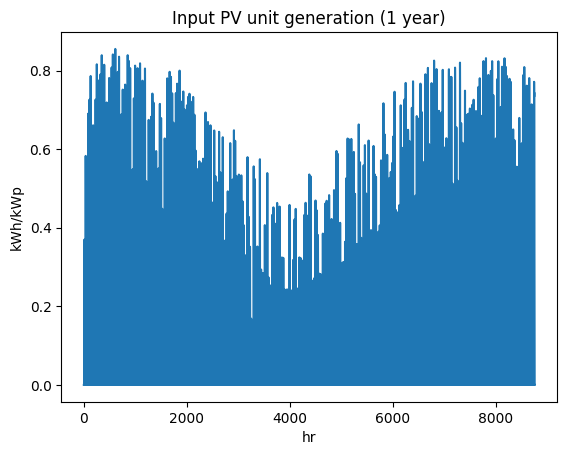

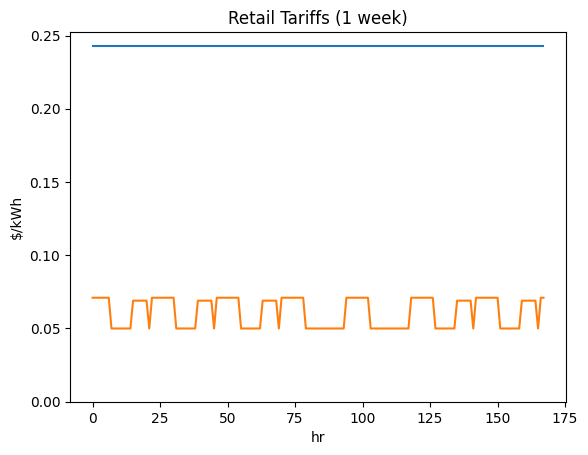

---- Optimising with PV: 1 - 20 kWp, Batt: 0 kWh. Determining PV capacity and dispatch.


************************************ Modell: PV > 1 kWp & BATT > 1 kWh ************************************
{'financial_horizon': 10, 'discount_rate': np.float64(0.06), 'grid_feedin_max': np.float64(5.0), 'pv_eol_capacity': np.float64(0.8), 'pv_eol_years': np.float64(25.0), 'pv_init_soh': np.float64(1.0), 'bess_e2p_ratio': np.float64(2.4), 'bess_roundtrip_eff': np.float64(0.88), 'bess_eol_years': np.float64(10.0), 'bess_eol_capacity': np.float64(0.7), 'bess_eol_cycles': np.float64(10000.0), 'bess_init_soh': np.float64(1.0), 'bess_eff_charge': np.float64(0.938083151964686), 'bess_eff_discharge': np.float64(0.938083151964686), 'scenario_name': 'Scenario_D_+5', 'scenario_set': 'SurfCoast', 'scenario_subset': 'JJP_open', 'year_start': 2022, 'datetime_name': 'DateTime1', 'meter_name': 'pc3012_nmi1301886730', 'solar_name': 'MELB', 'tariff_name_import_wkday': '3_Im_wkday', 'tariff_name_export_wkday': '3_

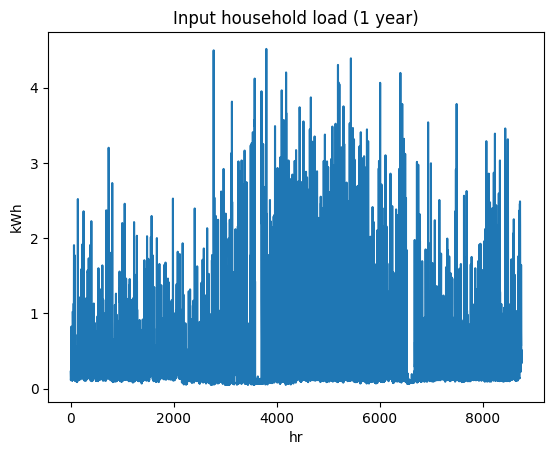

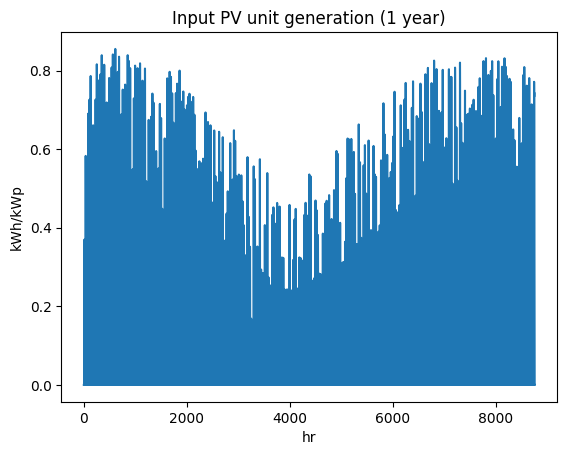

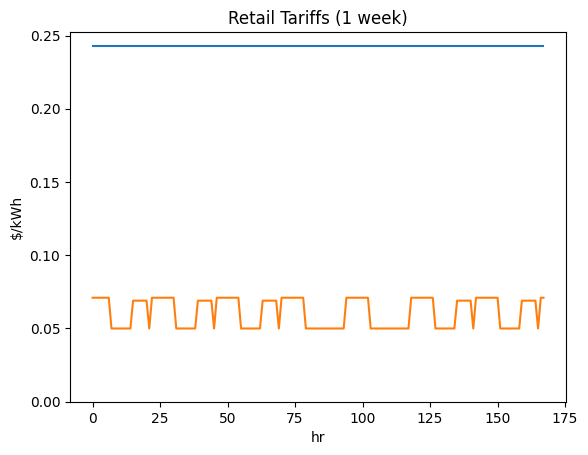

---- Optimising with PV: 1 - 20 kWp, Batt: 0 kWh. Determining PV capacity and dispatch.


************************************ Modell: PV > 1 kWp & BATT > 1 kWh ************************************
{'financial_horizon': 10, 'discount_rate': np.float64(0.06), 'grid_feedin_max': np.float64(5.0), 'pv_eol_capacity': np.float64(0.8), 'pv_eol_years': np.float64(25.0), 'pv_init_soh': np.float64(1.0), 'bess_e2p_ratio': np.float64(2.4), 'bess_roundtrip_eff': np.float64(0.88), 'bess_eol_years': np.float64(10.0), 'bess_eol_capacity': np.float64(0.7), 'bess_eol_cycles': np.float64(10000.0), 'bess_init_soh': np.float64(1.0), 'bess_eff_charge': np.float64(0.938083151964686), 'bess_eff_discharge': np.float64(0.938083151964686), 'scenario_name': 'Scenario_D_+5', 'scenario_set': 'SurfCoast', 'scenario_subset': 'JJP_open', 'year_start': 2022, 'datetime_name': 'DateTime1', 'meter_name': 'pc3012_nmi7081969841', 'solar_name': 'MELB', 'tariff_name_import_wkday': '3_Im_wkday', 'tariff_name_export_wkday': '3_

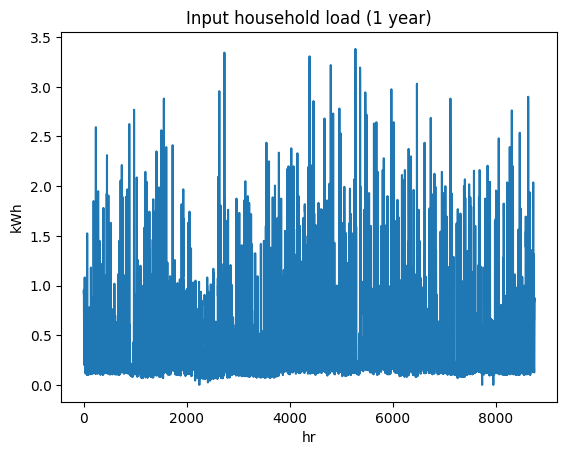

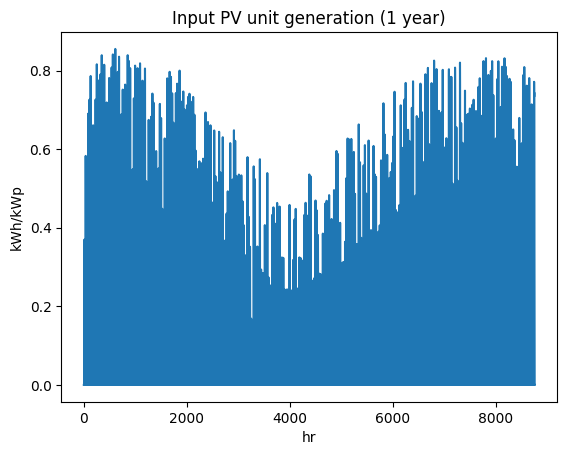

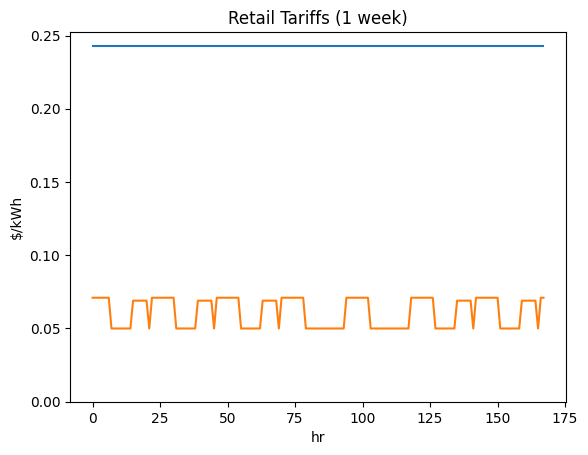

---- Optimising with PV: 1 - 20 kWp, Batt: 0 kWh. Determining PV capacity and dispatch.


************************************ Modell: PV > 1 kWp & BATT > 1 kWh ************************************
{'financial_horizon': 10, 'discount_rate': np.float64(0.06), 'grid_feedin_max': np.float64(5.0), 'pv_eol_capacity': np.float64(0.8), 'pv_eol_years': np.float64(25.0), 'pv_init_soh': np.float64(1.0), 'bess_e2p_ratio': np.float64(2.4), 'bess_roundtrip_eff': np.float64(0.88), 'bess_eol_years': np.float64(10.0), 'bess_eol_capacity': np.float64(0.7), 'bess_eol_cycles': np.float64(10000.0), 'bess_init_soh': np.float64(1.0), 'bess_eff_charge': np.float64(0.938083151964686), 'bess_eff_discharge': np.float64(0.938083151964686), 'scenario_name': 'Scenario_D_+5', 'scenario_set': 'SurfCoast', 'scenario_subset': 'JJP_open', 'year_start': 2022, 'datetime_name': 'DateTime1', 'meter_name': 'pc3012_nmi9396916901', 'solar_name': 'MELB', 'tariff_name_import_wkday': '3_Im_wkday', 'tariff_name_export_wkday': '3_

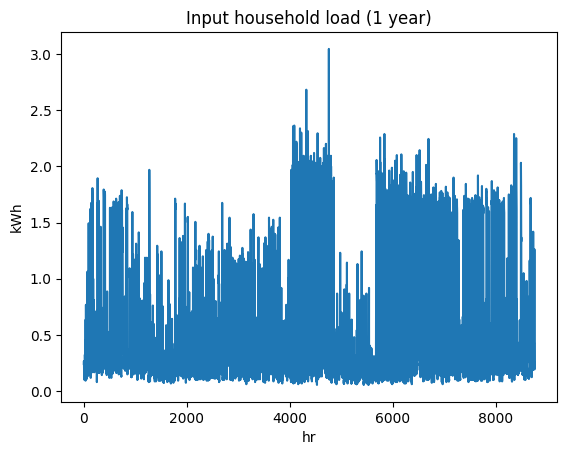

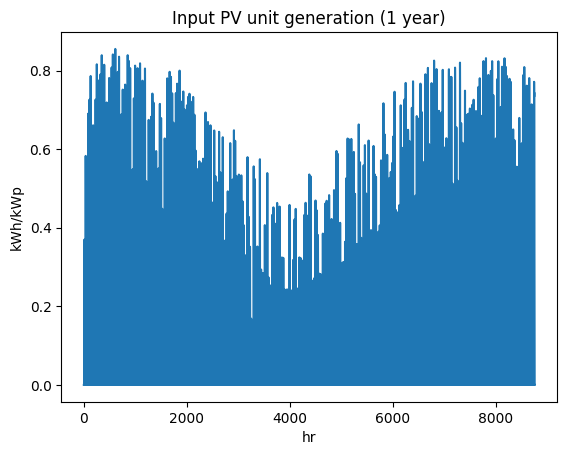

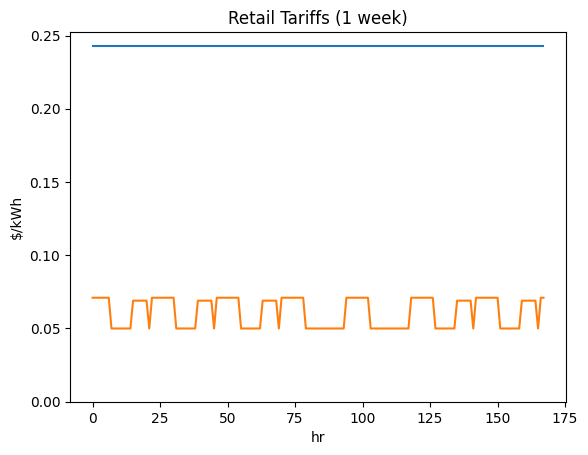

---- Optimising with PV: 1 - 20 kWp, Batt: 0 kWh. Determining PV capacity and dispatch.


************************************ Modell: PV > 1 kWp & BATT > 1 kWh ************************************
{'financial_horizon': 10, 'discount_rate': np.float64(0.06), 'grid_feedin_max': np.float64(5.0), 'pv_eol_capacity': np.float64(0.8), 'pv_eol_years': np.float64(25.0), 'pv_init_soh': np.float64(1.0), 'bess_e2p_ratio': np.float64(2.4), 'bess_roundtrip_eff': np.float64(0.88), 'bess_eol_years': np.float64(10.0), 'bess_eol_capacity': np.float64(0.7), 'bess_eol_cycles': np.float64(10000.0), 'bess_init_soh': np.float64(1.0), 'bess_eff_charge': np.float64(0.938083151964686), 'bess_eff_discharge': np.float64(0.938083151964686), 'scenario_name': 'Scenario_D_+5', 'scenario_set': 'SurfCoast', 'scenario_subset': 'JJP_open', 'year_start': 2022, 'datetime_name': 'DateTime1', 'meter_name': 'pc3012_nmi1719715861', 'solar_name': 'MELB', 'tariff_name_import_wkday': '3_Im_wkday', 'tariff_name_export_wkday': '3_

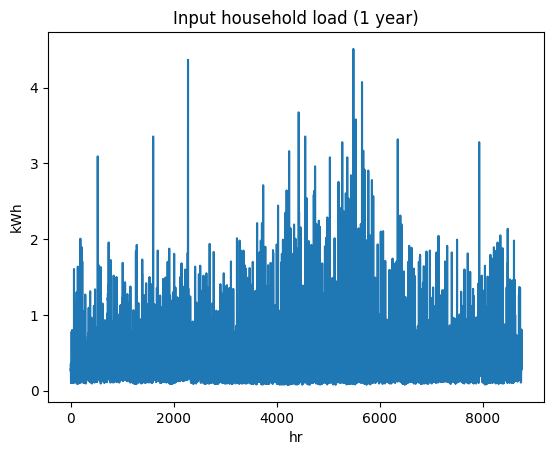

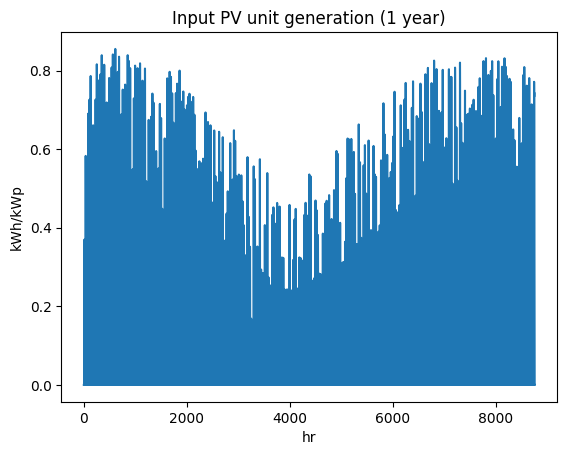

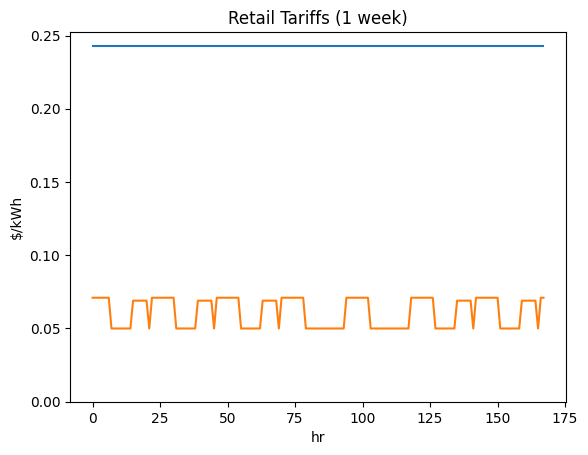

---- Optimising with PV: 1 - 20 kWp, Batt: 0 kWh. Determining PV capacity and dispatch.


************************************ Modell: PV > 1 kWp & BATT > 1 kWh ************************************
{'financial_horizon': 10, 'discount_rate': np.float64(0.06), 'grid_feedin_max': np.float64(5.0), 'pv_eol_capacity': np.float64(0.8), 'pv_eol_years': np.float64(25.0), 'pv_init_soh': np.float64(1.0), 'bess_e2p_ratio': np.float64(2.4), 'bess_roundtrip_eff': np.float64(0.88), 'bess_eol_years': np.float64(10.0), 'bess_eol_capacity': np.float64(0.7), 'bess_eol_cycles': np.float64(10000.0), 'bess_init_soh': np.float64(1.0), 'bess_eff_charge': np.float64(0.938083151964686), 'bess_eff_discharge': np.float64(0.938083151964686), 'scenario_name': 'Scenario_D_+5', 'scenario_set': 'SurfCoast', 'scenario_subset': 'JJP_open', 'year_start': 2022, 'datetime_name': 'DateTime1', 'meter_name': 'pc3032_nmi7252441057', 'solar_name': 'MELB', 'tariff_name_import_wkday': '3_Im_wkday', 'tariff_name_export_wkday': '3_

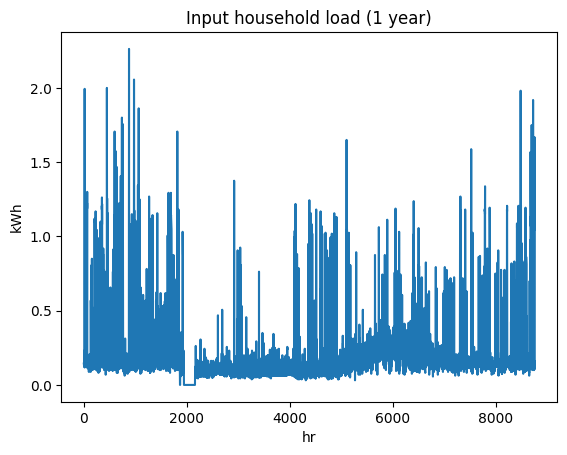

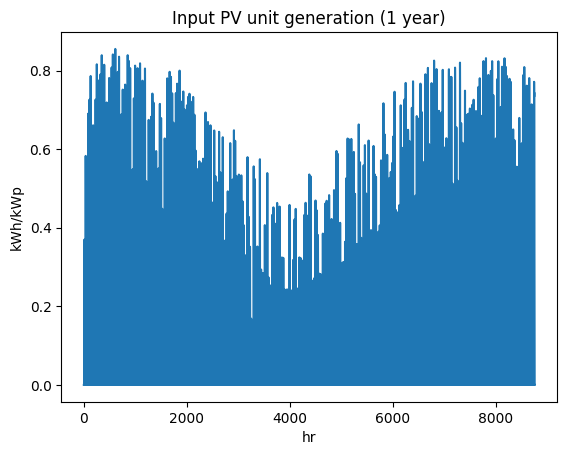

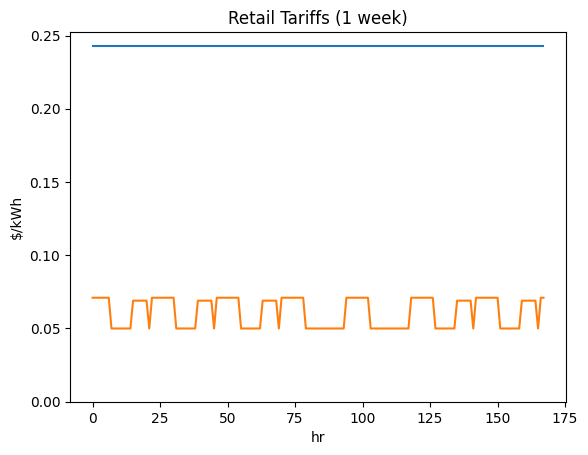

---- Optimising with PV: 1 - 20 kWp, Batt: 0 kWh. Determining PV capacity and dispatch.


************************************ Modell: PV > 1 kWp & BATT > 1 kWh ************************************
{'financial_horizon': 10, 'discount_rate': np.float64(0.06), 'grid_feedin_max': np.float64(5.0), 'pv_eol_capacity': np.float64(0.8), 'pv_eol_years': np.float64(25.0), 'pv_init_soh': np.float64(1.0), 'bess_e2p_ratio': np.float64(2.4), 'bess_roundtrip_eff': np.float64(0.88), 'bess_eol_years': np.float64(10.0), 'bess_eol_capacity': np.float64(0.7), 'bess_eol_cycles': np.float64(10000.0), 'bess_init_soh': np.float64(1.0), 'bess_eff_charge': np.float64(0.938083151964686), 'bess_eff_discharge': np.float64(0.938083151964686), 'scenario_name': 'Scenario_D_+5', 'scenario_set': 'SurfCoast', 'scenario_subset': 'JJP_open', 'year_start': 2022, 'datetime_name': 'DateTime1', 'meter_name': 'pc3072_nmi3422489855', 'solar_name': 'MELB', 'tariff_name_import_wkday': '3_Im_wkday', 'tariff_name_export_wkday': '3_

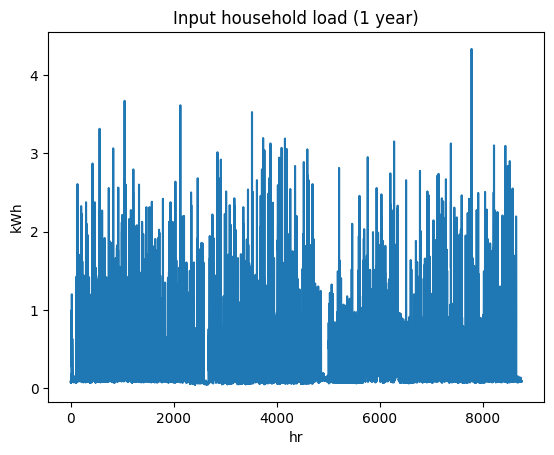

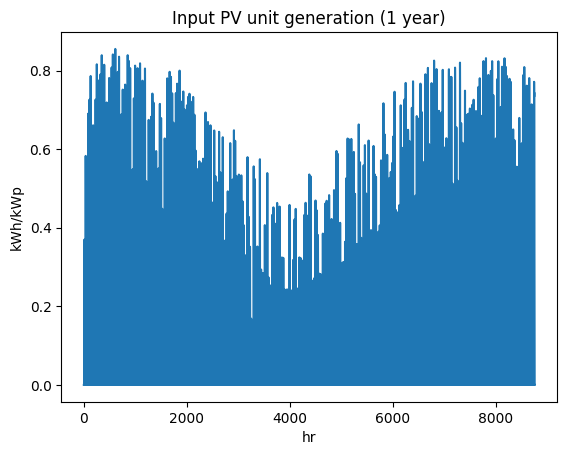

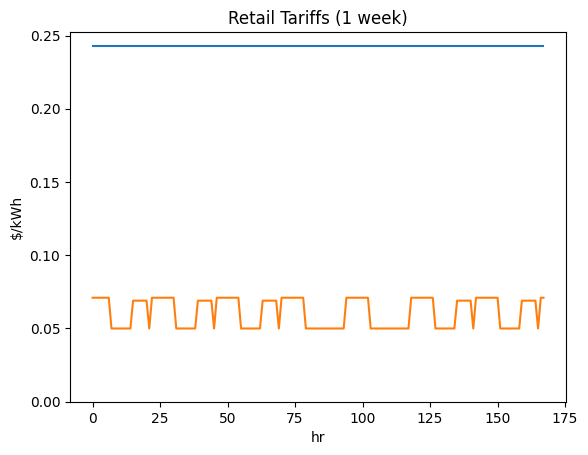

---- Optimising with PV: 1 - 20 kWp, Batt: 0 kWh. Determining PV capacity and dispatch.


************************************ Modell: PV > 1 kWp & BATT > 1 kWh ************************************
{'financial_horizon': 10, 'discount_rate': np.float64(0.06), 'grid_feedin_max': np.float64(5.0), 'pv_eol_capacity': np.float64(0.8), 'pv_eol_years': np.float64(25.0), 'pv_init_soh': np.float64(1.0), 'bess_e2p_ratio': np.float64(2.4), 'bess_roundtrip_eff': np.float64(0.88), 'bess_eol_years': np.float64(10.0), 'bess_eol_capacity': np.float64(0.7), 'bess_eol_cycles': np.float64(10000.0), 'bess_init_soh': np.float64(1.0), 'bess_eff_charge': np.float64(0.938083151964686), 'bess_eff_discharge': np.float64(0.938083151964686), 'scenario_name': 'Scenario_D_+5', 'scenario_set': 'SurfCoast', 'scenario_subset': 'JJP_open', 'year_start': 2022, 'datetime_name': 'DateTime1', 'meter_name': 'pc3079_nmi4034245661', 'solar_name': 'MELB', 'tariff_name_import_wkday': '3_Im_wkday', 'tariff_name_export_wkday': '3_

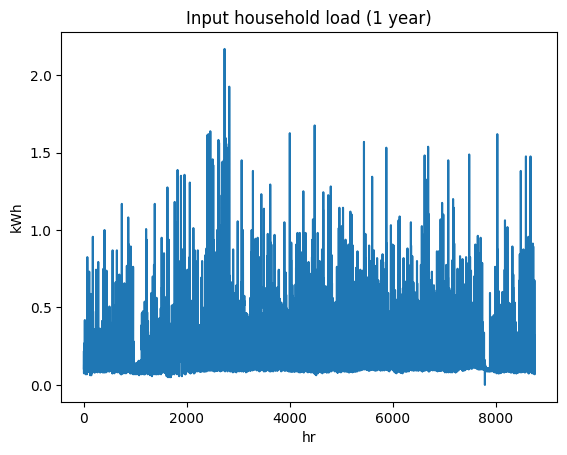

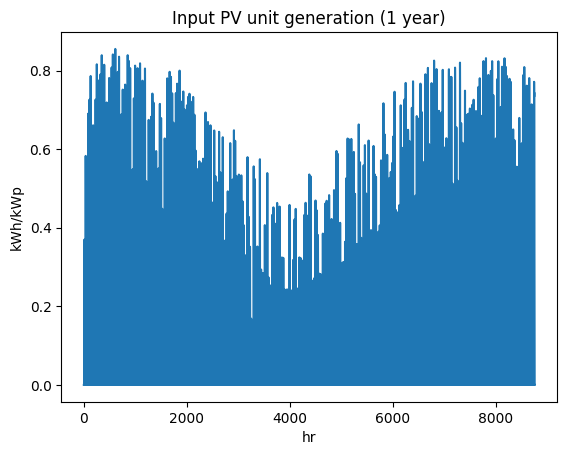

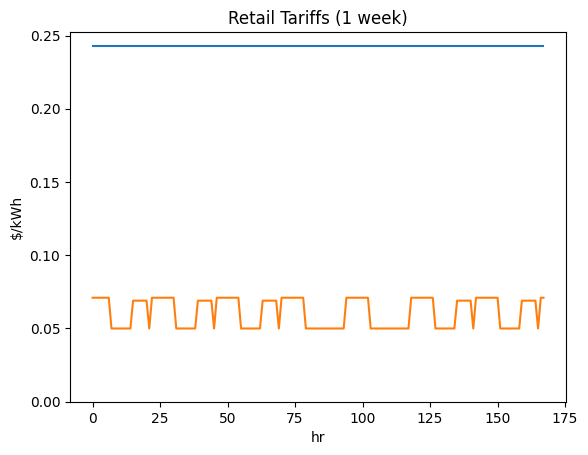

---- Optimising with PV: 1 - 20 kWp, Batt: 0 kWh. Determining PV capacity and dispatch.


************************************ Modell: PV > 1 kWp & BATT > 1 kWh ************************************
{'financial_horizon': 10, 'discount_rate': np.float64(0.06), 'grid_feedin_max': np.float64(5.0), 'pv_eol_capacity': np.float64(0.8), 'pv_eol_years': np.float64(25.0), 'pv_init_soh': np.float64(1.0), 'bess_e2p_ratio': np.float64(2.4), 'bess_roundtrip_eff': np.float64(0.88), 'bess_eol_years': np.float64(10.0), 'bess_eol_capacity': np.float64(0.7), 'bess_eol_cycles': np.float64(10000.0), 'bess_init_soh': np.float64(1.0), 'bess_eff_charge': np.float64(0.938083151964686), 'bess_eff_discharge': np.float64(0.938083151964686), 'scenario_name': 'Scenario_D_+5', 'scenario_set': 'SurfCoast', 'scenario_subset': 'JJP_open', 'year_start': 2022, 'datetime_name': 'DateTime1', 'meter_name': 'pc3084_nmi3598802399', 'solar_name': 'MELB', 'tariff_name_import_wkday': '3_Im_wkday', 'tariff_name_export_wkday': '3_

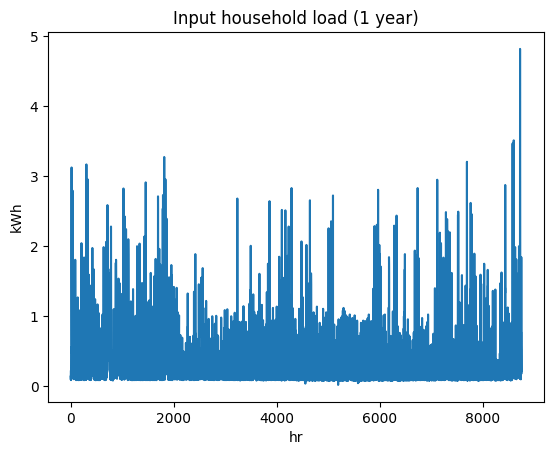

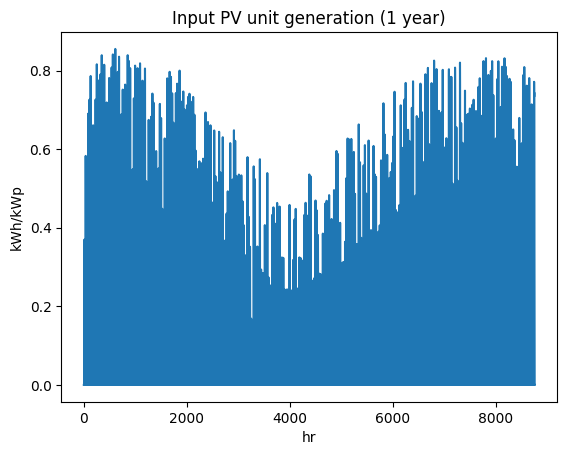

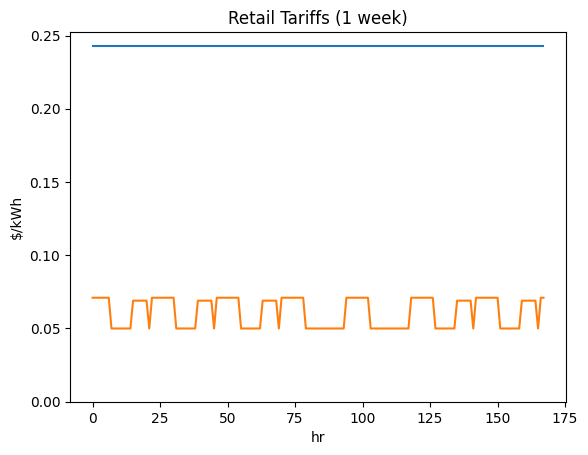

---- Optimising with PV: 1 - 20 kWp, Batt: 0 kWh. Determining PV capacity and dispatch.


************************************ Modell: PV > 1 kWp & BATT > 1 kWh ************************************
{'financial_horizon': 10, 'discount_rate': np.float64(0.06), 'grid_feedin_max': np.float64(5.0), 'pv_eol_capacity': np.float64(0.8), 'pv_eol_years': np.float64(25.0), 'pv_init_soh': np.float64(1.0), 'bess_e2p_ratio': np.float64(2.4), 'bess_roundtrip_eff': np.float64(0.88), 'bess_eol_years': np.float64(10.0), 'bess_eol_capacity': np.float64(0.7), 'bess_eol_cycles': np.float64(10000.0), 'bess_init_soh': np.float64(1.0), 'bess_eff_charge': np.float64(0.938083151964686), 'bess_eff_discharge': np.float64(0.938083151964686), 'scenario_name': 'Scenario_D_+5', 'scenario_set': 'SurfCoast', 'scenario_subset': 'JJP_open', 'year_start': 2022, 'datetime_name': 'DateTime1', 'meter_name': 'pc3079_nmi3345460205', 'solar_name': 'MELB', 'tariff_name_import_wkday': '3_Im_wkday', 'tariff_name_export_wkday': '3_

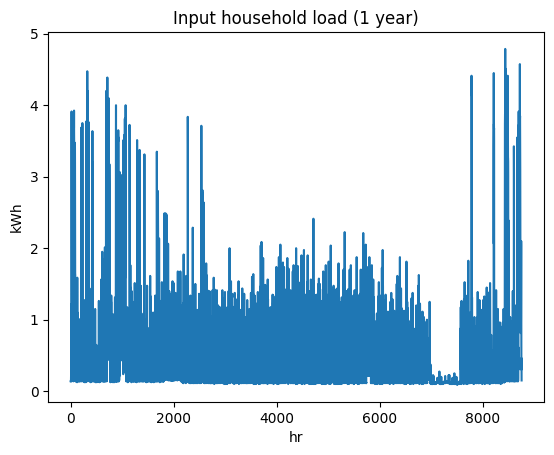

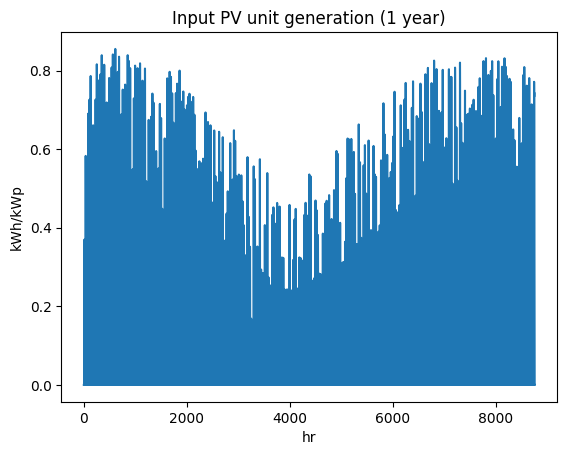

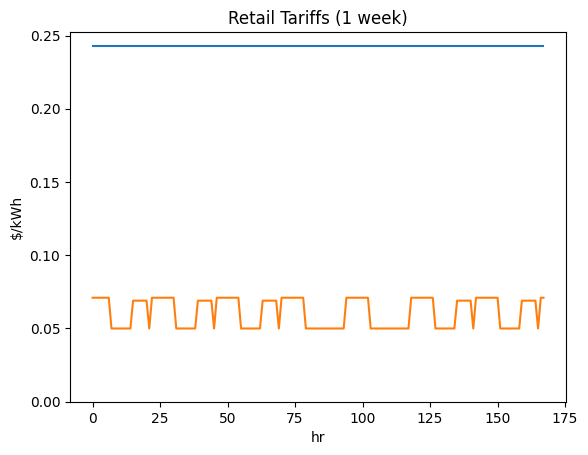

---- Optimising with PV: 1 - 20 kWp, Batt: 0 kWh. Determining PV capacity and dispatch.


************************************ Modell: PV > 1 kWp & BATT > 1 kWh ************************************
{'financial_horizon': 10, 'discount_rate': np.float64(0.06), 'grid_feedin_max': np.float64(5.0), 'pv_eol_capacity': np.float64(0.8), 'pv_eol_years': np.float64(25.0), 'pv_init_soh': np.float64(1.0), 'bess_e2p_ratio': np.float64(2.4), 'bess_roundtrip_eff': np.float64(0.88), 'bess_eol_years': np.float64(10.0), 'bess_eol_capacity': np.float64(0.7), 'bess_eol_cycles': np.float64(10000.0), 'bess_init_soh': np.float64(1.0), 'bess_eff_charge': np.float64(0.938083151964686), 'bess_eff_discharge': np.float64(0.938083151964686), 'scenario_name': 'Scenario_D_+5', 'scenario_set': 'SurfCoast', 'scenario_subset': 'JJP_open', 'year_start': 2022, 'datetime_name': 'DateTime1', 'meter_name': 'pc3079_nmi2141768781', 'solar_name': 'MELB', 'tariff_name_import_wkday': '3_Im_wkday', 'tariff_name_export_wkday': '3_

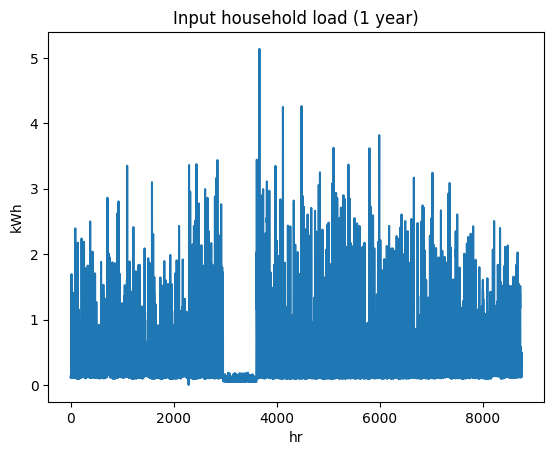

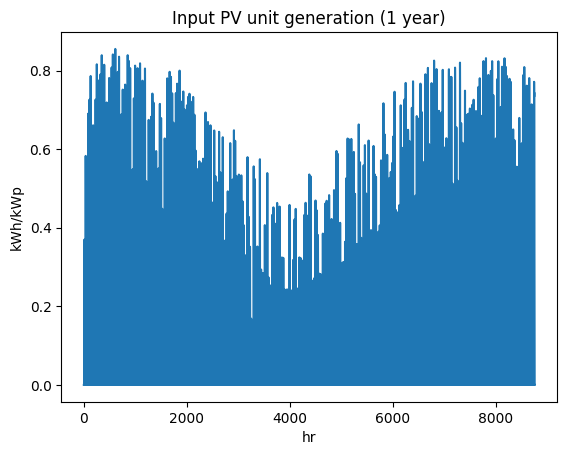

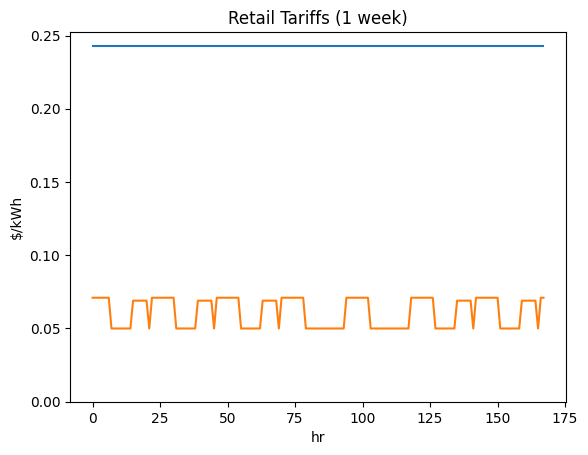

---- Optimising with PV: 1 - 20 kWp, Batt: 0 kWh. Determining PV capacity and dispatch.


************************************ Modell: PV > 1 kWp & BATT > 1 kWh ************************************
{'financial_horizon': 10, 'discount_rate': np.float64(0.06), 'grid_feedin_max': np.float64(5.0), 'pv_eol_capacity': np.float64(0.8), 'pv_eol_years': np.float64(25.0), 'pv_init_soh': np.float64(1.0), 'bess_e2p_ratio': np.float64(2.4), 'bess_roundtrip_eff': np.float64(0.88), 'bess_eol_years': np.float64(10.0), 'bess_eol_capacity': np.float64(0.7), 'bess_eol_cycles': np.float64(10000.0), 'bess_init_soh': np.float64(1.0), 'bess_eff_charge': np.float64(0.938083151964686), 'bess_eff_discharge': np.float64(0.938083151964686), 'scenario_name': 'Scenario_D_+5', 'scenario_set': 'SurfCoast', 'scenario_subset': 'JJP_open', 'year_start': 2022, 'datetime_name': 'DateTime1', 'meter_name': 'pc3079_nmi2384449859', 'solar_name': 'MELB', 'tariff_name_import_wkday': '3_Im_wkday', 'tariff_name_export_wkday': '3_

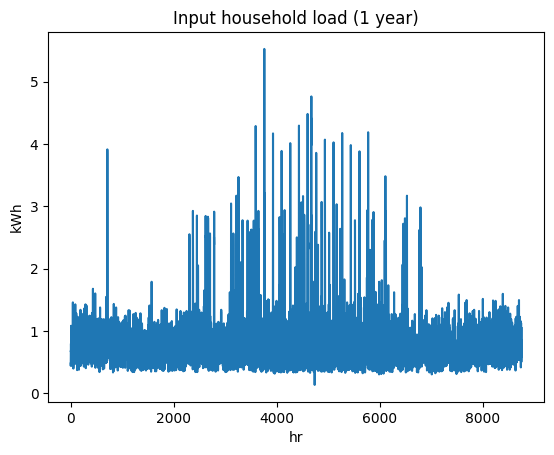

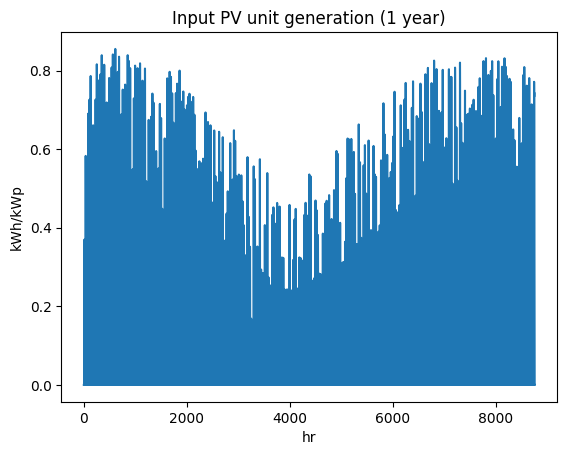

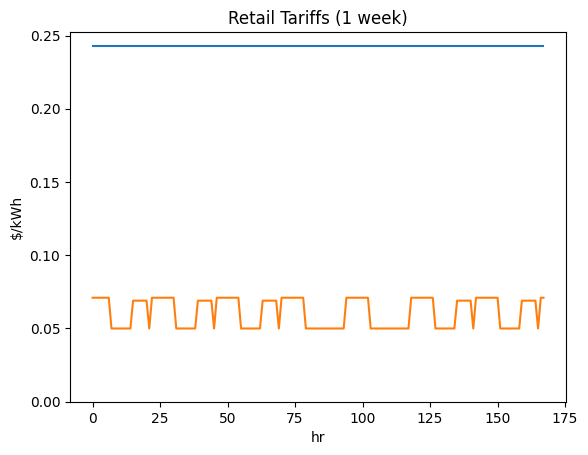

---- Optimising with PV: 1 - 20 kWp, Batt: 0 kWh. Determining PV capacity and dispatch.


************************************ Modell: PV > 1 kWp & BATT > 1 kWh ************************************
{'financial_horizon': 10, 'discount_rate': np.float64(0.06), 'grid_feedin_max': np.float64(5.0), 'pv_eol_capacity': np.float64(0.8), 'pv_eol_years': np.float64(25.0), 'pv_init_soh': np.float64(1.0), 'bess_e2p_ratio': np.float64(2.4), 'bess_roundtrip_eff': np.float64(0.88), 'bess_eol_years': np.float64(10.0), 'bess_eol_capacity': np.float64(0.7), 'bess_eol_cycles': np.float64(10000.0), 'bess_init_soh': np.float64(1.0), 'bess_eff_charge': np.float64(0.938083151964686), 'bess_eff_discharge': np.float64(0.938083151964686), 'scenario_name': 'Scenario_D_+5', 'scenario_set': 'SurfCoast', 'scenario_subset': 'JJP_open', 'year_start': 2022, 'datetime_name': 'DateTime1', 'meter_name': 'pc3079_nmi6948942402', 'solar_name': 'MELB', 'tariff_name_import_wkday': '3_Im_wkday', 'tariff_name_export_wkday': '3_

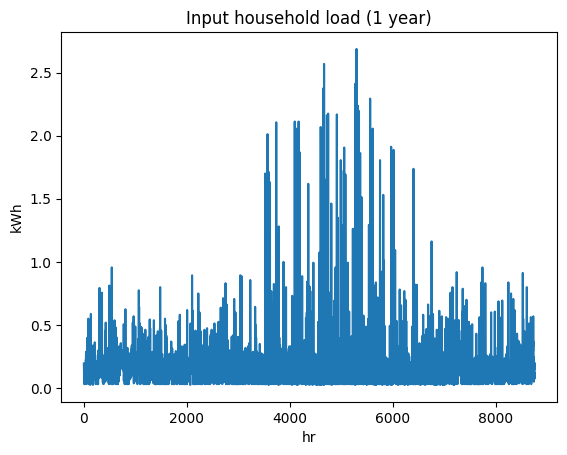

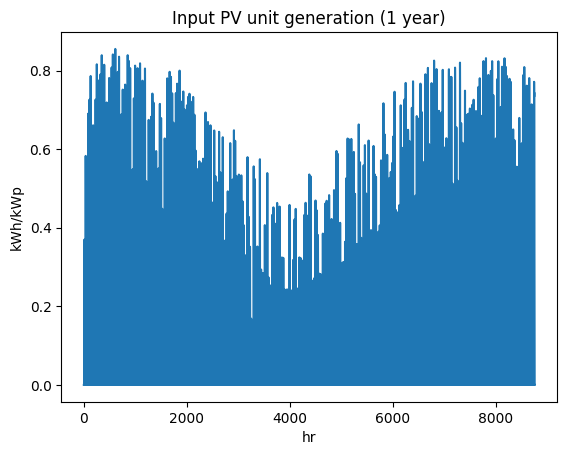

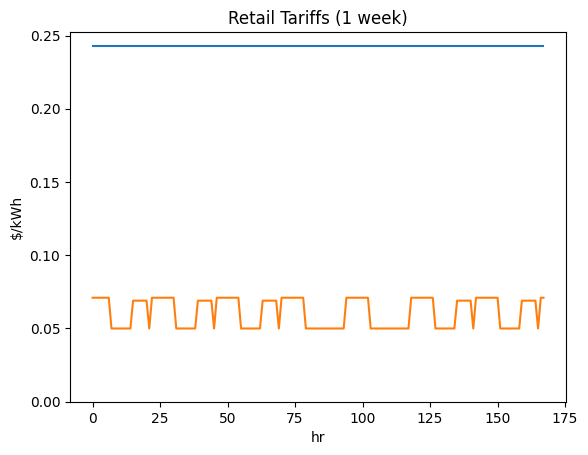

---- Optimising with PV: 1 - 20 kWp, Batt: 0 kWh. Determining PV capacity and dispatch.


************************************ Modell: PV > 1 kWp & BATT > 1 kWh ************************************
{'financial_horizon': 10, 'discount_rate': np.float64(0.06), 'grid_feedin_max': np.float64(5.0), 'pv_eol_capacity': np.float64(0.8), 'pv_eol_years': np.float64(25.0), 'pv_init_soh': np.float64(1.0), 'bess_e2p_ratio': np.float64(2.4), 'bess_roundtrip_eff': np.float64(0.88), 'bess_eol_years': np.float64(10.0), 'bess_eol_capacity': np.float64(0.7), 'bess_eol_cycles': np.float64(10000.0), 'bess_init_soh': np.float64(1.0), 'bess_eff_charge': np.float64(0.938083151964686), 'bess_eff_discharge': np.float64(0.938083151964686), 'scenario_name': 'Scenario_D_+5', 'scenario_set': 'SurfCoast', 'scenario_subset': 'JJP_open', 'year_start': 2022, 'datetime_name': 'DateTime1', 'meter_name': 'pc3079_nmi4602839564', 'solar_name': 'MELB', 'tariff_name_import_wkday': '3_Im_wkday', 'tariff_name_export_wkday': '3_

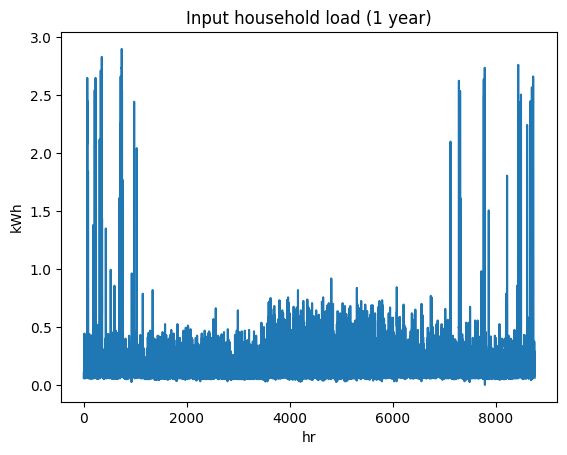

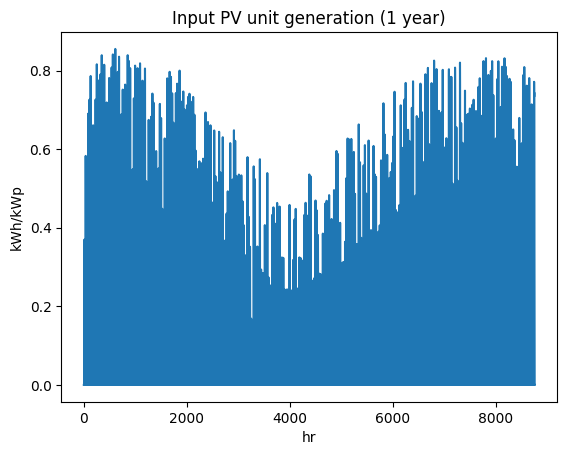

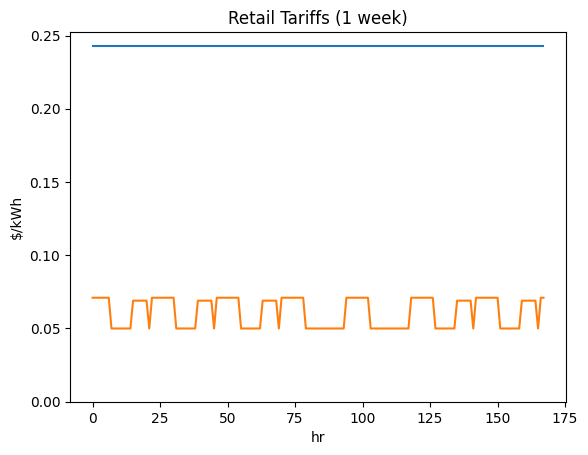

---- Optimising with PV: 1 - 20 kWp, Batt: 0 kWh. Determining PV capacity and dispatch.


************************************ Modell: PV > 1 kWp & BATT > 1 kWh ************************************
{'financial_horizon': 10, 'discount_rate': np.float64(0.06), 'grid_feedin_max': np.float64(5.0), 'pv_eol_capacity': np.float64(0.8), 'pv_eol_years': np.float64(25.0), 'pv_init_soh': np.float64(1.0), 'bess_e2p_ratio': np.float64(2.4), 'bess_roundtrip_eff': np.float64(0.88), 'bess_eol_years': np.float64(10.0), 'bess_eol_capacity': np.float64(0.7), 'bess_eol_cycles': np.float64(10000.0), 'bess_init_soh': np.float64(1.0), 'bess_eff_charge': np.float64(0.938083151964686), 'bess_eff_discharge': np.float64(0.938083151964686), 'scenario_name': 'Scenario_D_+5', 'scenario_set': 'SurfCoast', 'scenario_subset': 'JJP_open', 'year_start': 2022, 'datetime_name': 'DateTime1', 'meter_name': 'pc3079_nmi8366920242', 'solar_name': 'MELB', 'tariff_name_import_wkday': '3_Im_wkday', 'tariff_name_export_wkday': '3_

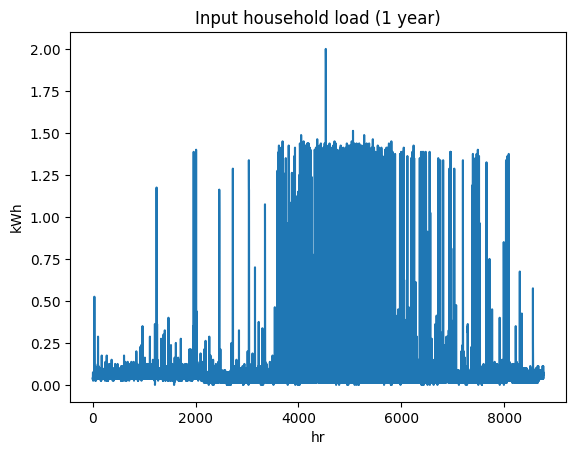

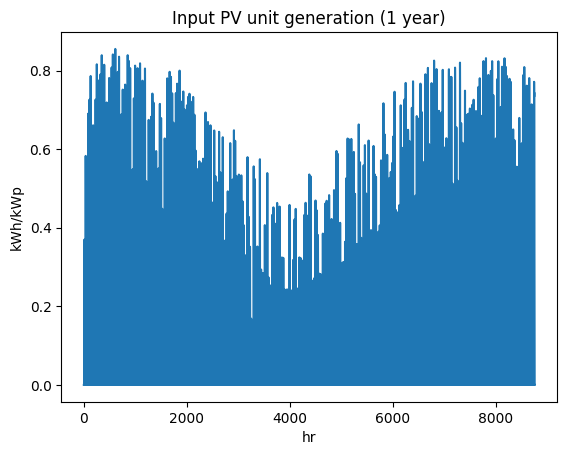

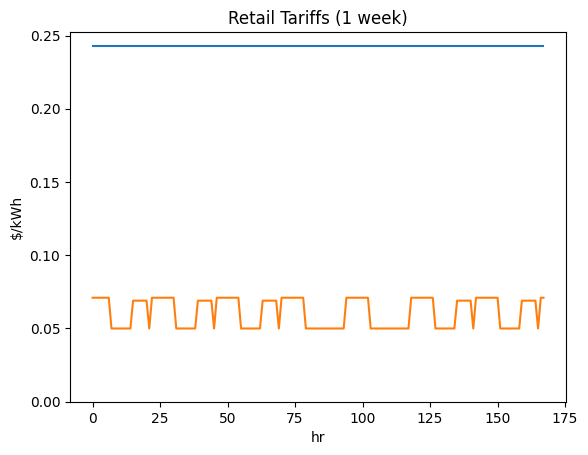

---- Optimising with PV: 1 - 20 kWp, Batt: 0 kWh. Determining PV capacity and dispatch.


************************************ Modell: PV > 1 kWp & BATT > 1 kWh ************************************
{'financial_horizon': 10, 'discount_rate': np.float64(0.06), 'grid_feedin_max': np.float64(5.0), 'pv_eol_capacity': np.float64(0.8), 'pv_eol_years': np.float64(25.0), 'pv_init_soh': np.float64(1.0), 'bess_e2p_ratio': np.float64(2.4), 'bess_roundtrip_eff': np.float64(0.88), 'bess_eol_years': np.float64(10.0), 'bess_eol_capacity': np.float64(0.7), 'bess_eol_cycles': np.float64(10000.0), 'bess_init_soh': np.float64(1.0), 'bess_eff_charge': np.float64(0.938083151964686), 'bess_eff_discharge': np.float64(0.938083151964686), 'scenario_name': 'Scenario_D_+5', 'scenario_set': 'SurfCoast', 'scenario_subset': 'JJP_open', 'year_start': 2022, 'datetime_name': 'DateTime1', 'meter_name': 'pc3079_nmi2295775981', 'solar_name': 'MELB', 'tariff_name_import_wkday': '3_Im_wkday', 'tariff_name_export_wkday': '3_

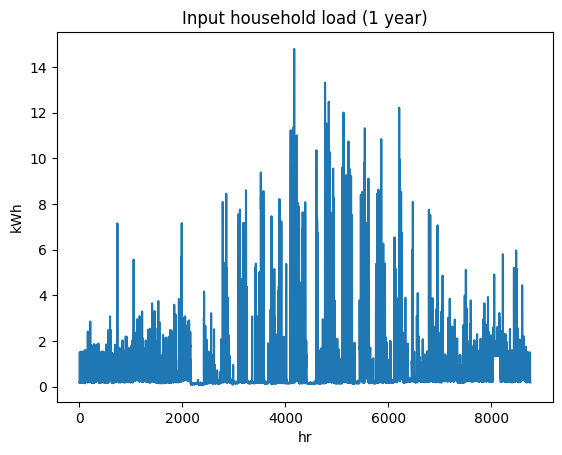

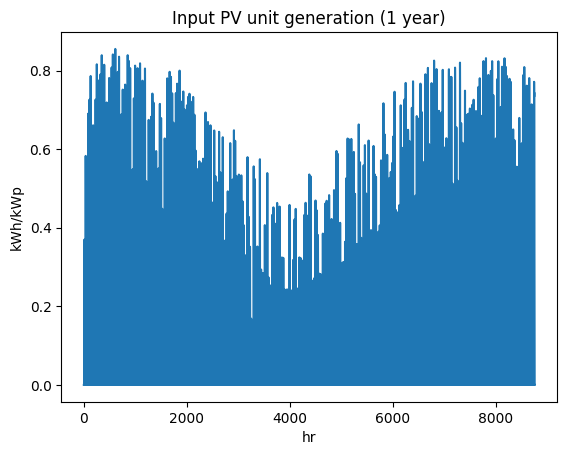

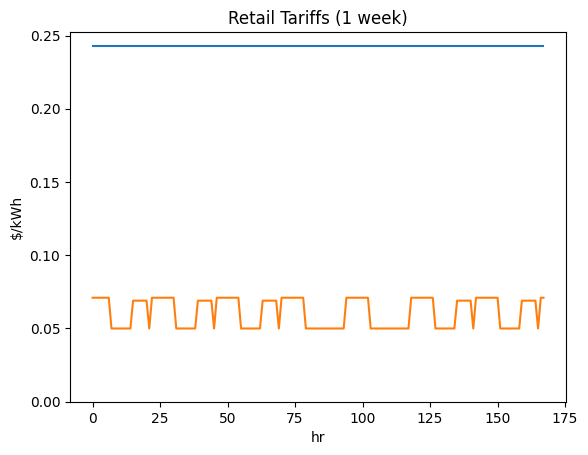

---- Optimising with PV: 1 - 20 kWp, Batt: 0 kWh. Determining PV capacity and dispatch.


************************************ Modell: PV > 1 kWp & BATT > 1 kWh ************************************
{'financial_horizon': 10, 'discount_rate': np.float64(0.06), 'grid_feedin_max': np.float64(5.0), 'pv_eol_capacity': np.float64(0.8), 'pv_eol_years': np.float64(25.0), 'pv_init_soh': np.float64(1.0), 'bess_e2p_ratio': np.float64(2.4), 'bess_roundtrip_eff': np.float64(0.88), 'bess_eol_years': np.float64(10.0), 'bess_eol_capacity': np.float64(0.7), 'bess_eol_cycles': np.float64(10000.0), 'bess_init_soh': np.float64(1.0), 'bess_eff_charge': np.float64(0.938083151964686), 'bess_eff_discharge': np.float64(0.938083151964686), 'scenario_name': 'Scenario_D_+5', 'scenario_set': 'SurfCoast', 'scenario_subset': 'JJP_open', 'year_start': 2022, 'datetime_name': 'DateTime1', 'meter_name': 'pc3079_nmi4119708933', 'solar_name': 'MELB', 'tariff_name_import_wkday': '3_Im_wkday', 'tariff_name_export_wkday': '3_

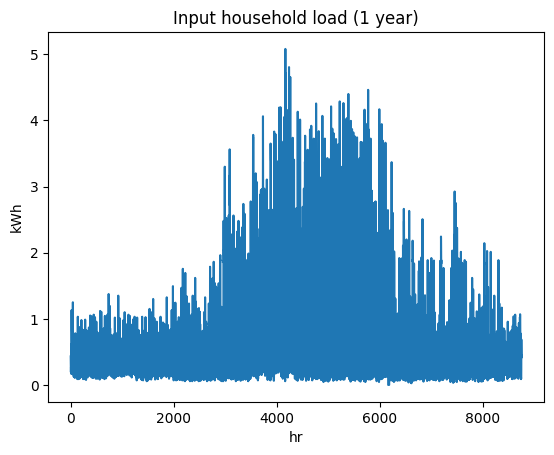

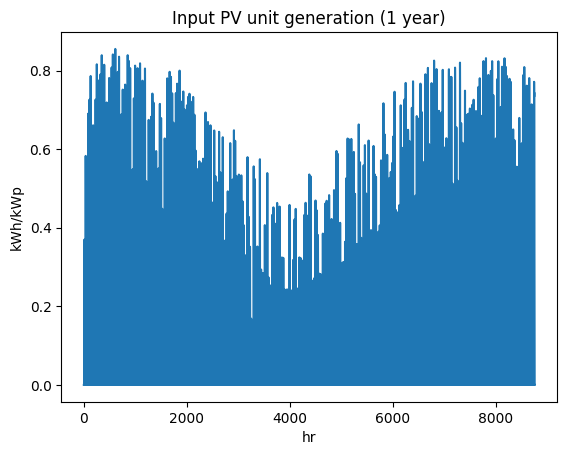

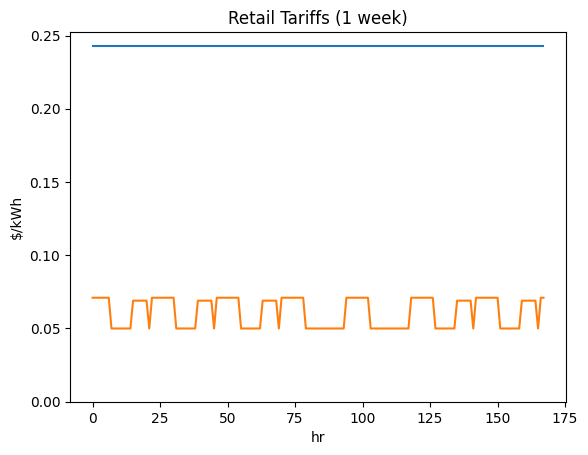

---- Optimising with PV: 1 - 20 kWp, Batt: 0 kWh. Determining PV capacity and dispatch.


************************************ Modell: PV > 1 kWp & BATT > 1 kWh ************************************
{'financial_horizon': 10, 'discount_rate': np.float64(0.06), 'grid_feedin_max': np.float64(5.0), 'pv_eol_capacity': np.float64(0.8), 'pv_eol_years': np.float64(25.0), 'pv_init_soh': np.float64(1.0), 'bess_e2p_ratio': np.float64(2.4), 'bess_roundtrip_eff': np.float64(0.88), 'bess_eol_years': np.float64(10.0), 'bess_eol_capacity': np.float64(0.7), 'bess_eol_cycles': np.float64(10000.0), 'bess_init_soh': np.float64(1.0), 'bess_eff_charge': np.float64(0.938083151964686), 'bess_eff_discharge': np.float64(0.938083151964686), 'scenario_name': 'Scenario_D_+5', 'scenario_set': 'SurfCoast', 'scenario_subset': 'JJP_open', 'year_start': 2022, 'datetime_name': 'DateTime1', 'meter_name': 'pc3079_nmi8993021268', 'solar_name': 'MELB', 'tariff_name_import_wkday': '3_Im_wkday', 'tariff_name_export_wkday': '3_

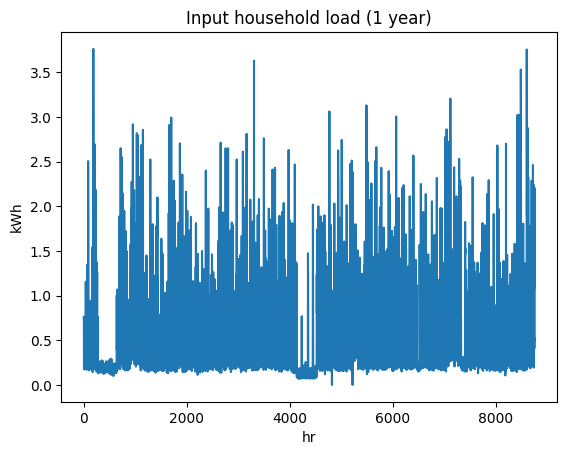

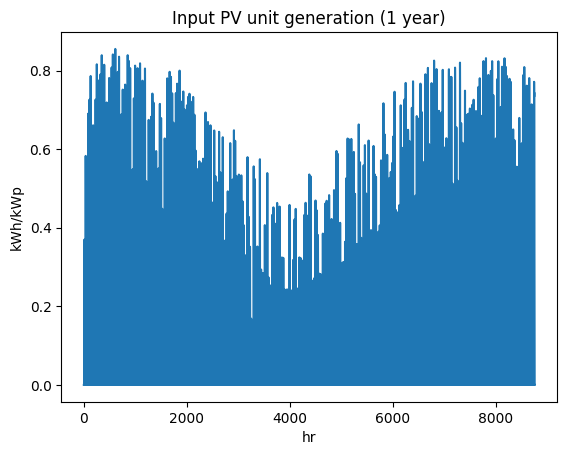

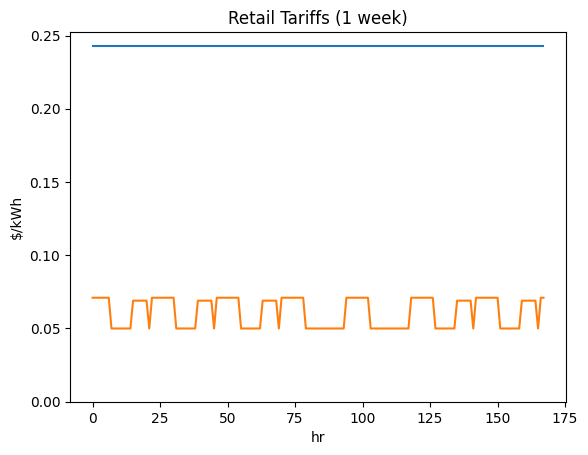

---- Optimising with PV: 1 - 20 kWp, Batt: 0 kWh. Determining PV capacity and dispatch.


************************************ Modell: PV > 1 kWp & BATT > 1 kWh ************************************
{'financial_horizon': 10, 'discount_rate': np.float64(0.06), 'grid_feedin_max': np.float64(5.0), 'pv_eol_capacity': np.float64(0.8), 'pv_eol_years': np.float64(25.0), 'pv_init_soh': np.float64(1.0), 'bess_e2p_ratio': np.float64(2.4), 'bess_roundtrip_eff': np.float64(0.88), 'bess_eol_years': np.float64(10.0), 'bess_eol_capacity': np.float64(0.7), 'bess_eol_cycles': np.float64(10000.0), 'bess_init_soh': np.float64(1.0), 'bess_eff_charge': np.float64(0.938083151964686), 'bess_eff_discharge': np.float64(0.938083151964686), 'scenario_name': 'Scenario_D_+5', 'scenario_set': 'SurfCoast', 'scenario_subset': 'JJP_open', 'year_start': 2022, 'datetime_name': 'DateTime1', 'meter_name': 'pc3079_nmi5204840481', 'solar_name': 'MELB', 'tariff_name_import_wkday': '3_Im_wkday', 'tariff_name_export_wkday': '3_

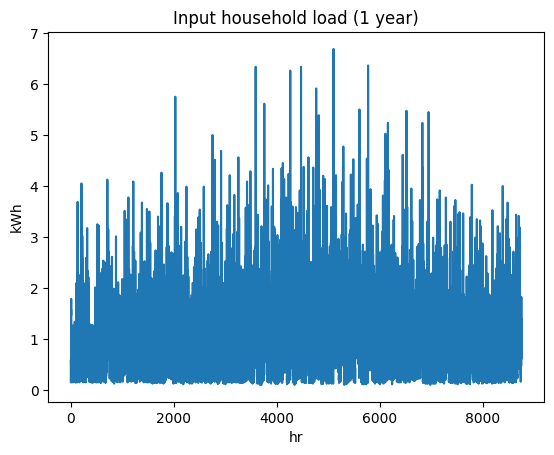

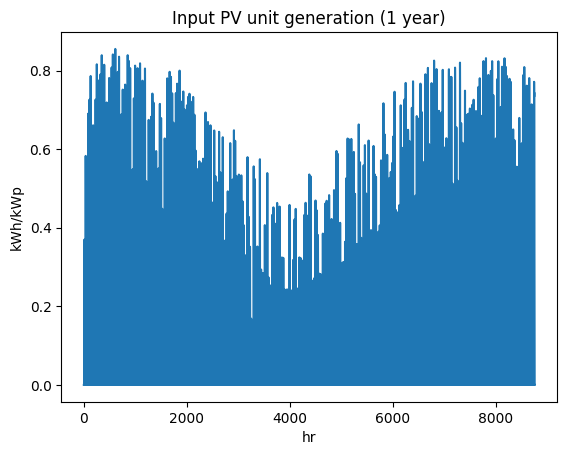

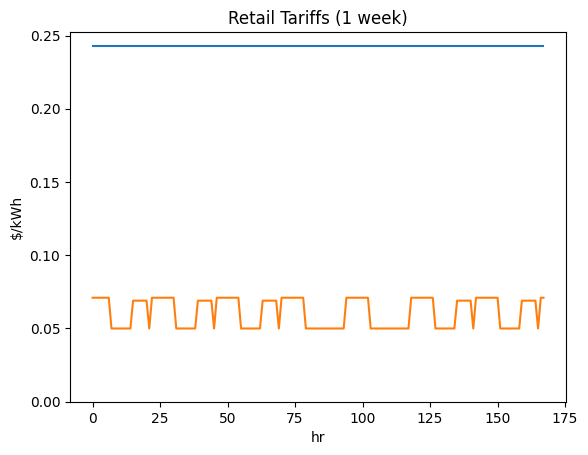

---- Optimising with PV: 1 - 20 kWp, Batt: 0 kWh. Determining PV capacity and dispatch.


************************************ Modell: PV > 1 kWp & BATT > 1 kWh ************************************
{'financial_horizon': 10, 'discount_rate': np.float64(0.06), 'grid_feedin_max': np.float64(5.0), 'pv_eol_capacity': np.float64(0.8), 'pv_eol_years': np.float64(25.0), 'pv_init_soh': np.float64(1.0), 'bess_e2p_ratio': np.float64(2.4), 'bess_roundtrip_eff': np.float64(0.88), 'bess_eol_years': np.float64(10.0), 'bess_eol_capacity': np.float64(0.7), 'bess_eol_cycles': np.float64(10000.0), 'bess_init_soh': np.float64(1.0), 'bess_eff_charge': np.float64(0.938083151964686), 'bess_eff_discharge': np.float64(0.938083151964686), 'scenario_name': 'Scenario_D_+5', 'scenario_set': 'SurfCoast', 'scenario_subset': 'JJP_open', 'year_start': 2022, 'datetime_name': 'DateTime1', 'meter_name': 'pc3079_nmi6297516632', 'solar_name': 'MELB', 'tariff_name_import_wkday': '3_Im_wkday', 'tariff_name_export_wkday': '3_

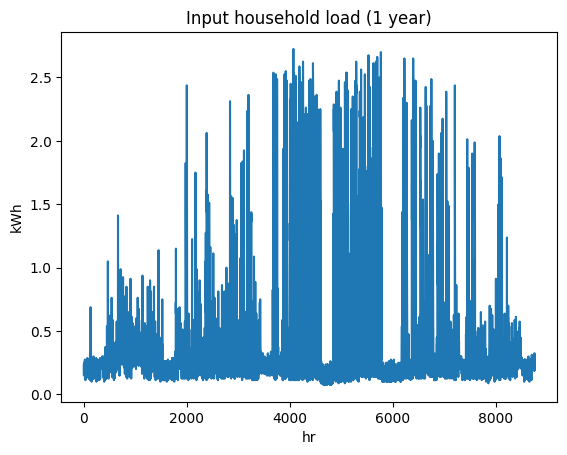

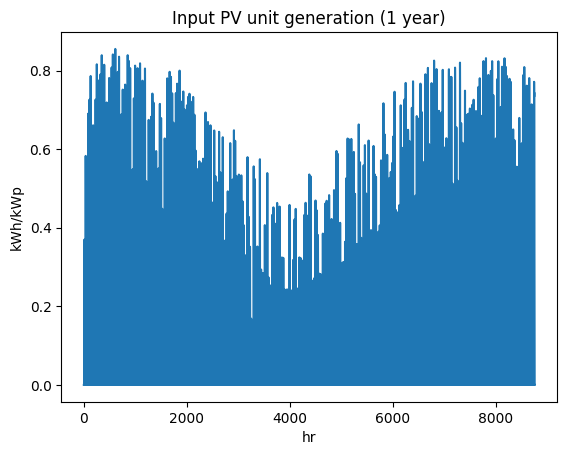

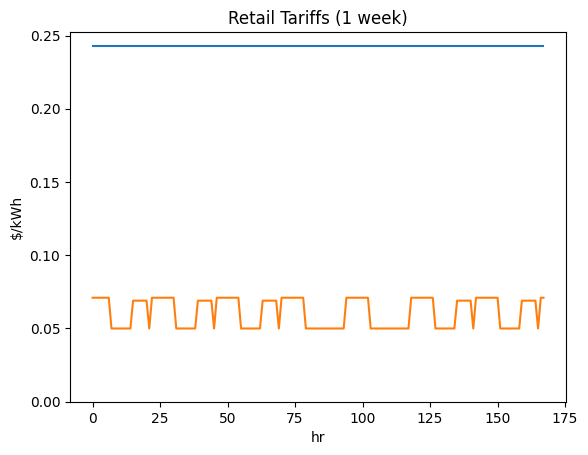

---- Optimising with PV: 1 - 20 kWp, Batt: 0 kWh. Determining PV capacity and dispatch.


************************************ Modell: PV > 1 kWp & BATT > 1 kWh ************************************
{'financial_horizon': 10, 'discount_rate': np.float64(0.06), 'grid_feedin_max': np.float64(5.0), 'pv_eol_capacity': np.float64(0.8), 'pv_eol_years': np.float64(25.0), 'pv_init_soh': np.float64(1.0), 'bess_e2p_ratio': np.float64(2.4), 'bess_roundtrip_eff': np.float64(0.88), 'bess_eol_years': np.float64(10.0), 'bess_eol_capacity': np.float64(0.7), 'bess_eol_cycles': np.float64(10000.0), 'bess_init_soh': np.float64(1.0), 'bess_eff_charge': np.float64(0.938083151964686), 'bess_eff_discharge': np.float64(0.938083151964686), 'scenario_name': 'Scenario_D_+5', 'scenario_set': 'SurfCoast', 'scenario_subset': 'JJP_open', 'year_start': 2022, 'datetime_name': 'DateTime1', 'meter_name': 'pc3079_nmi9675440106', 'solar_name': 'MELB', 'tariff_name_import_wkday': '3_Im_wkday', 'tariff_name_export_wkday': '3_

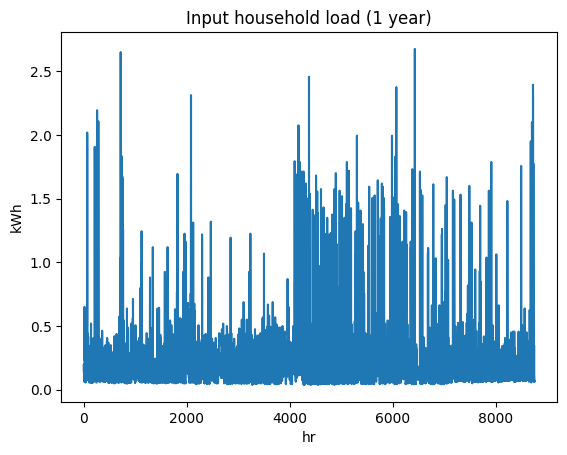

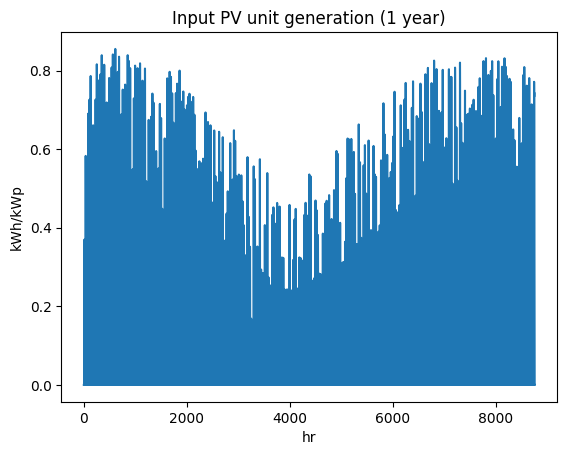

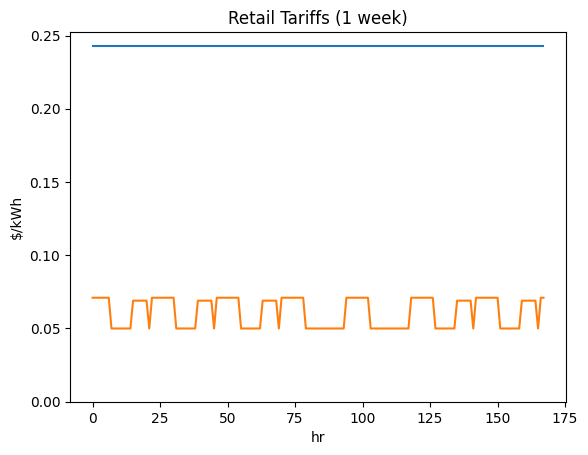

---- Optimising with PV: 1 - 20 kWp, Batt: 0 kWh. Determining PV capacity and dispatch.


************************************ Modell: PV > 1 kWp & BATT > 1 kWh ************************************
{'financial_horizon': 10, 'discount_rate': np.float64(0.06), 'grid_feedin_max': np.float64(5.0), 'pv_eol_capacity': np.float64(0.8), 'pv_eol_years': np.float64(25.0), 'pv_init_soh': np.float64(1.0), 'bess_e2p_ratio': np.float64(2.4), 'bess_roundtrip_eff': np.float64(0.88), 'bess_eol_years': np.float64(10.0), 'bess_eol_capacity': np.float64(0.7), 'bess_eol_cycles': np.float64(10000.0), 'bess_init_soh': np.float64(1.0), 'bess_eff_charge': np.float64(0.938083151964686), 'bess_eff_discharge': np.float64(0.938083151964686), 'scenario_name': 'Scenario_D_+5', 'scenario_set': 'SurfCoast', 'scenario_subset': 'JJP_open', 'year_start': 2022, 'datetime_name': 'DateTime1', 'meter_name': 'pc3079_nmi5075503088', 'solar_name': 'MELB', 'tariff_name_import_wkday': '3_Im_wkday', 'tariff_name_export_wkday': '3_

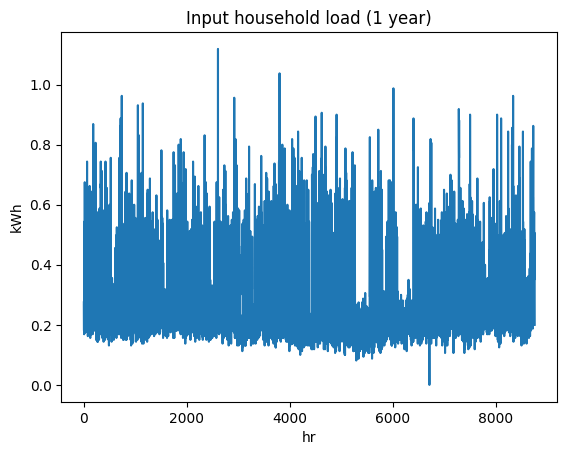

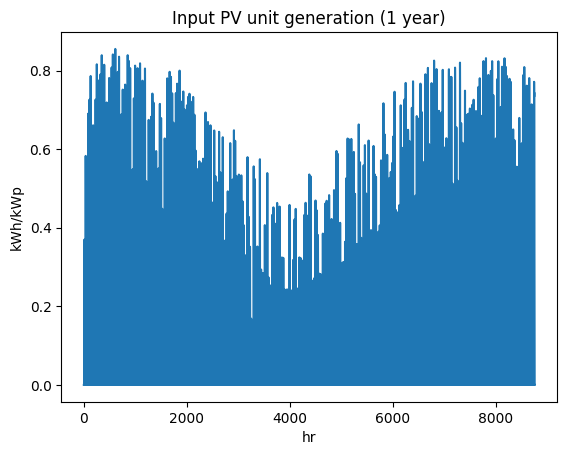

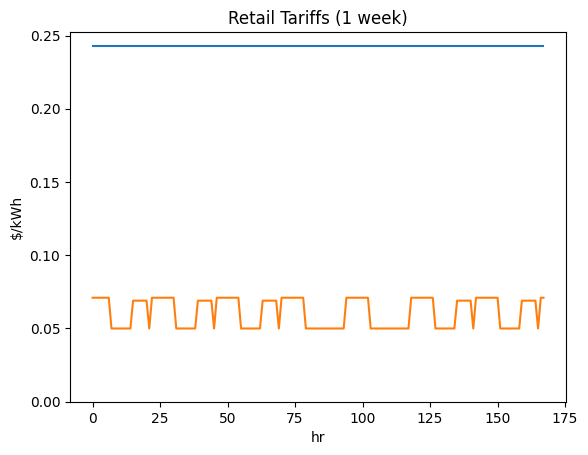

---- Optimising with PV: 1 - 20 kWp, Batt: 0 kWh. Determining PV capacity and dispatch.


************************************ Modell: PV > 1 kWp & BATT > 1 kWh ************************************
{'financial_horizon': 10, 'discount_rate': np.float64(0.06), 'grid_feedin_max': np.float64(5.0), 'pv_eol_capacity': np.float64(0.8), 'pv_eol_years': np.float64(25.0), 'pv_init_soh': np.float64(1.0), 'bess_e2p_ratio': np.float64(2.4), 'bess_roundtrip_eff': np.float64(0.88), 'bess_eol_years': np.float64(10.0), 'bess_eol_capacity': np.float64(0.7), 'bess_eol_cycles': np.float64(10000.0), 'bess_init_soh': np.float64(1.0), 'bess_eff_charge': np.float64(0.938083151964686), 'bess_eff_discharge': np.float64(0.938083151964686), 'scenario_name': 'Scenario_D_+5', 'scenario_set': 'SurfCoast', 'scenario_subset': 'JJP_open', 'year_start': 2022, 'datetime_name': 'DateTime1', 'meter_name': 'pc3081_nmi1898798896', 'solar_name': 'MELB', 'tariff_name_import_wkday': '3_Im_wkday', 'tariff_name_export_wkday': '3_

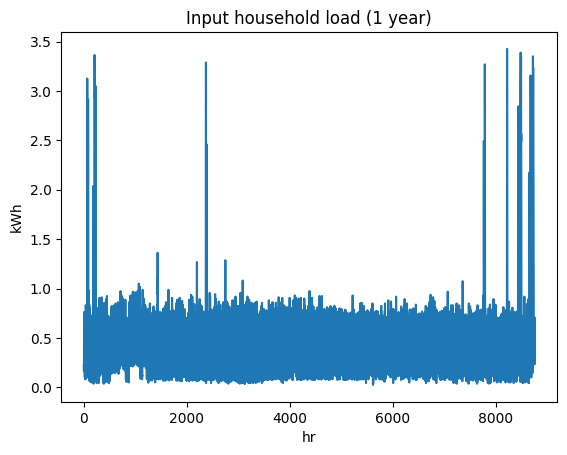

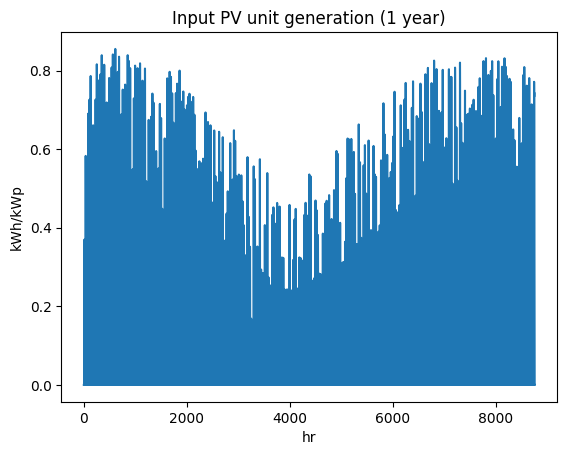

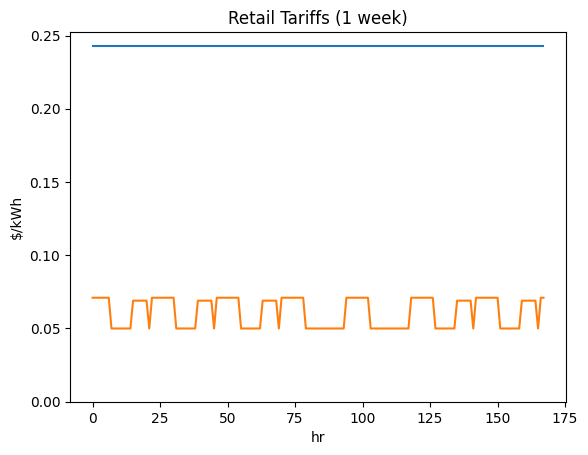

---- Optimising with PV: 1 - 20 kWp, Batt: 0 kWh. Determining PV capacity and dispatch.


************************************ Modell: PV > 1 kWp & BATT > 1 kWh ************************************
{'financial_horizon': 10, 'discount_rate': np.float64(0.06), 'grid_feedin_max': np.float64(5.0), 'pv_eol_capacity': np.float64(0.8), 'pv_eol_years': np.float64(25.0), 'pv_init_soh': np.float64(1.0), 'bess_e2p_ratio': np.float64(2.4), 'bess_roundtrip_eff': np.float64(0.88), 'bess_eol_years': np.float64(10.0), 'bess_eol_capacity': np.float64(0.7), 'bess_eol_cycles': np.float64(10000.0), 'bess_init_soh': np.float64(1.0), 'bess_eff_charge': np.float64(0.938083151964686), 'bess_eff_discharge': np.float64(0.938083151964686), 'scenario_name': 'Scenario_D_+5', 'scenario_set': 'SurfCoast', 'scenario_subset': 'JJP_open', 'year_start': 2022, 'datetime_name': 'DateTime1', 'meter_name': 'pc3081_nmi5435279830', 'solar_name': 'MELB', 'tariff_name_import_wkday': '3_Im_wkday', 'tariff_name_export_wkday': '3_

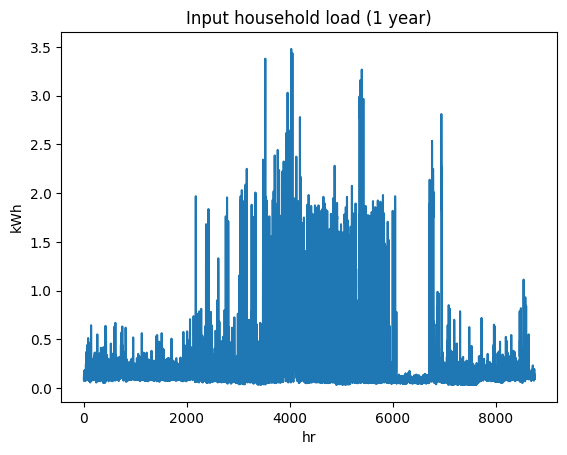

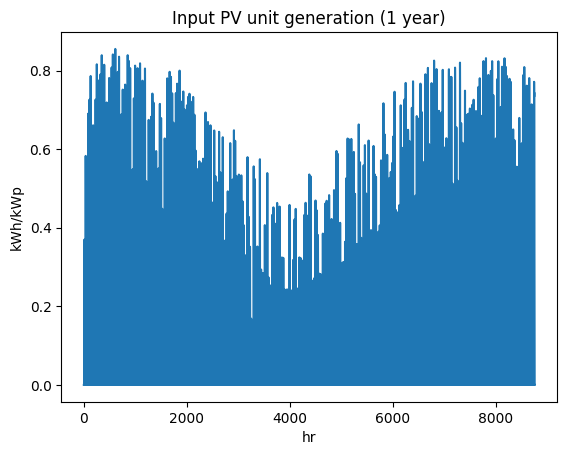

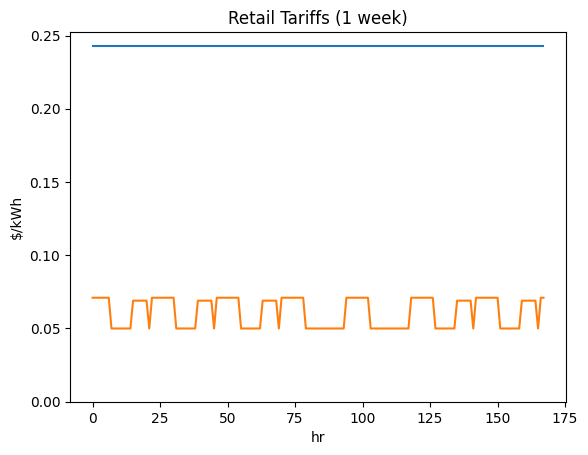

---- Optimising with PV: 1 - 20 kWp, Batt: 0 kWh. Determining PV capacity and dispatch.


************************************ Modell: PV > 1 kWp & BATT > 1 kWh ************************************
{'financial_horizon': 10, 'discount_rate': np.float64(0.06), 'grid_feedin_max': np.float64(5.0), 'pv_eol_capacity': np.float64(0.8), 'pv_eol_years': np.float64(25.0), 'pv_init_soh': np.float64(1.0), 'bess_e2p_ratio': np.float64(2.4), 'bess_roundtrip_eff': np.float64(0.88), 'bess_eol_years': np.float64(10.0), 'bess_eol_capacity': np.float64(0.7), 'bess_eol_cycles': np.float64(10000.0), 'bess_init_soh': np.float64(1.0), 'bess_eff_charge': np.float64(0.938083151964686), 'bess_eff_discharge': np.float64(0.938083151964686), 'scenario_name': 'Scenario_D_+5', 'scenario_set': 'SurfCoast', 'scenario_subset': 'JJP_open', 'year_start': 2022, 'datetime_name': 'DateTime1', 'meter_name': 'pc3081_nmi3222056035', 'solar_name': 'MELB', 'tariff_name_import_wkday': '3_Im_wkday', 'tariff_name_export_wkday': '3_

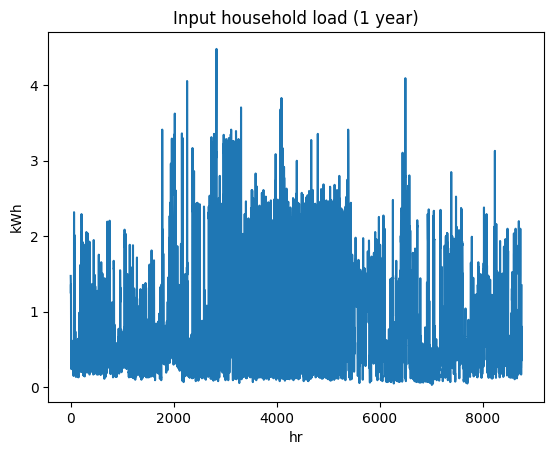

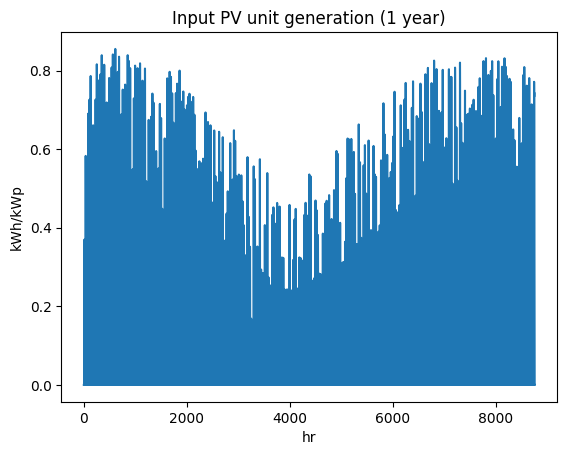

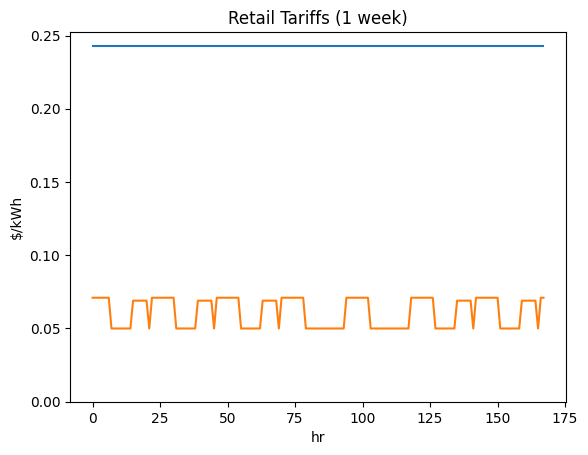

---- Optimising with PV: 1 - 20 kWp, Batt: 0 kWh. Determining PV capacity and dispatch.


************************************ Modell: PV > 1 kWp & BATT > 1 kWh ************************************
{'financial_horizon': 10, 'discount_rate': np.float64(0.06), 'grid_feedin_max': np.float64(5.0), 'pv_eol_capacity': np.float64(0.8), 'pv_eol_years': np.float64(25.0), 'pv_init_soh': np.float64(1.0), 'bess_e2p_ratio': np.float64(2.4), 'bess_roundtrip_eff': np.float64(0.88), 'bess_eol_years': np.float64(10.0), 'bess_eol_capacity': np.float64(0.7), 'bess_eol_cycles': np.float64(10000.0), 'bess_init_soh': np.float64(1.0), 'bess_eff_charge': np.float64(0.938083151964686), 'bess_eff_discharge': np.float64(0.938083151964686), 'scenario_name': 'Scenario_D_+5', 'scenario_set': 'SurfCoast', 'scenario_subset': 'JJP_open', 'year_start': 2022, 'datetime_name': 'DateTime1', 'meter_name': 'pc3081_nmi9856095886', 'solar_name': 'MELB', 'tariff_name_import_wkday': '3_Im_wkday', 'tariff_name_export_wkday': '3_

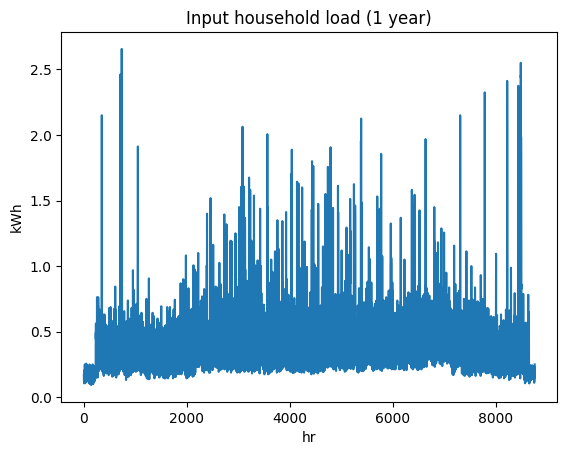

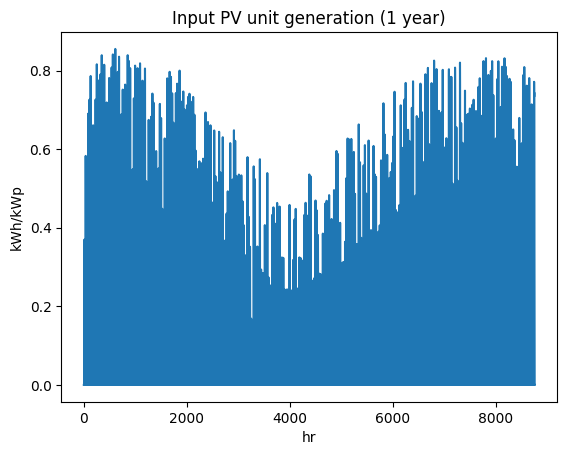

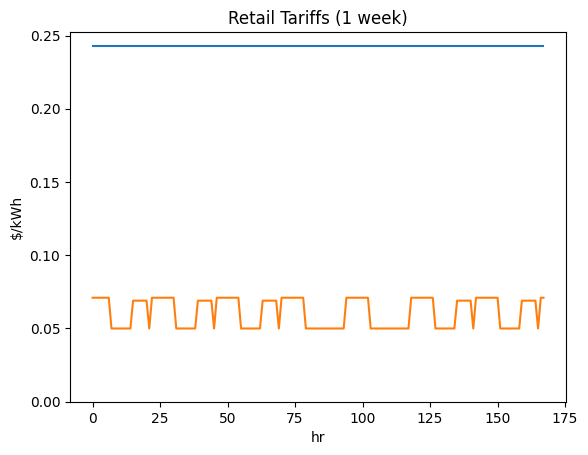

---- Optimising with PV: 1 - 20 kWp, Batt: 0 kWh. Determining PV capacity and dispatch.


************************************ Modell: PV > 1 kWp & BATT > 1 kWh ************************************
{'financial_horizon': 10, 'discount_rate': np.float64(0.06), 'grid_feedin_max': np.float64(5.0), 'pv_eol_capacity': np.float64(0.8), 'pv_eol_years': np.float64(25.0), 'pv_init_soh': np.float64(1.0), 'bess_e2p_ratio': np.float64(2.4), 'bess_roundtrip_eff': np.float64(0.88), 'bess_eol_years': np.float64(10.0), 'bess_eol_capacity': np.float64(0.7), 'bess_eol_cycles': np.float64(10000.0), 'bess_init_soh': np.float64(1.0), 'bess_eff_charge': np.float64(0.938083151964686), 'bess_eff_discharge': np.float64(0.938083151964686), 'scenario_name': 'Scenario_D_+5', 'scenario_set': 'SurfCoast', 'scenario_subset': 'JJP_open', 'year_start': 2022, 'datetime_name': 'DateTime1', 'meter_name': 'pc3081_nmi3428516141', 'solar_name': 'MELB', 'tariff_name_import_wkday': '3_Im_wkday', 'tariff_name_export_wkday': '3_

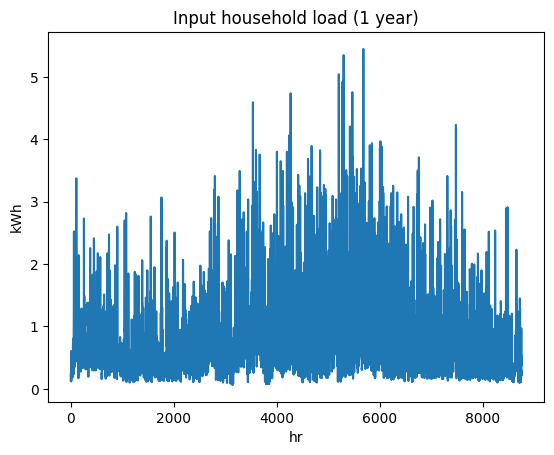

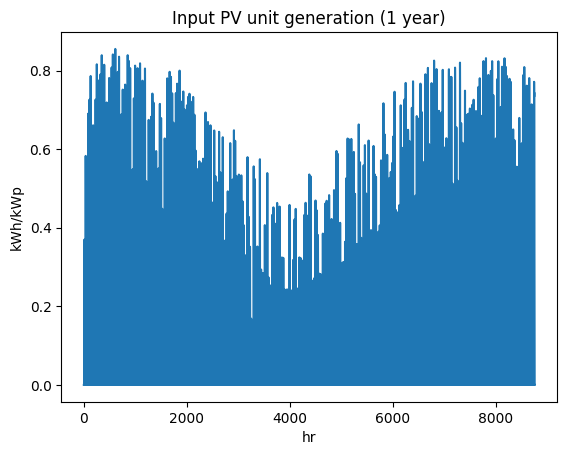

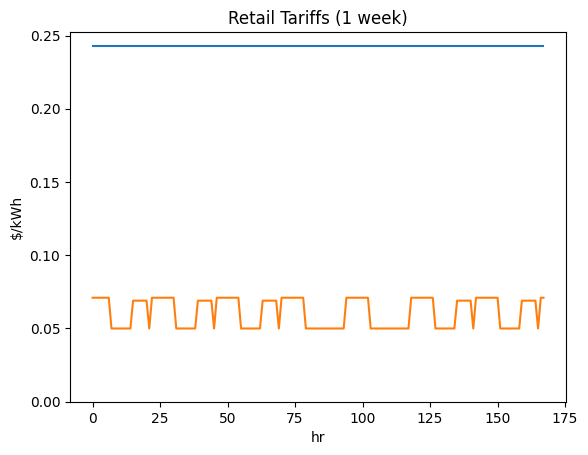

---- Optimising with PV: 1 - 20 kWp, Batt: 0 kWh. Determining PV capacity and dispatch.


************************************ Modell: PV > 1 kWp & BATT > 1 kWh ************************************
{'financial_horizon': 10, 'discount_rate': np.float64(0.06), 'grid_feedin_max': np.float64(5.0), 'pv_eol_capacity': np.float64(0.8), 'pv_eol_years': np.float64(25.0), 'pv_init_soh': np.float64(1.0), 'bess_e2p_ratio': np.float64(2.4), 'bess_roundtrip_eff': np.float64(0.88), 'bess_eol_years': np.float64(10.0), 'bess_eol_capacity': np.float64(0.7), 'bess_eol_cycles': np.float64(10000.0), 'bess_init_soh': np.float64(1.0), 'bess_eff_charge': np.float64(0.938083151964686), 'bess_eff_discharge': np.float64(0.938083151964686), 'scenario_name': 'Scenario_D_+5', 'scenario_set': 'SurfCoast', 'scenario_subset': 'JJP_open', 'year_start': 2022, 'datetime_name': 'DateTime1', 'meter_name': 'pc3081_nmi8862323228', 'solar_name': 'MELB', 'tariff_name_import_wkday': '3_Im_wkday', 'tariff_name_export_wkday': '3_

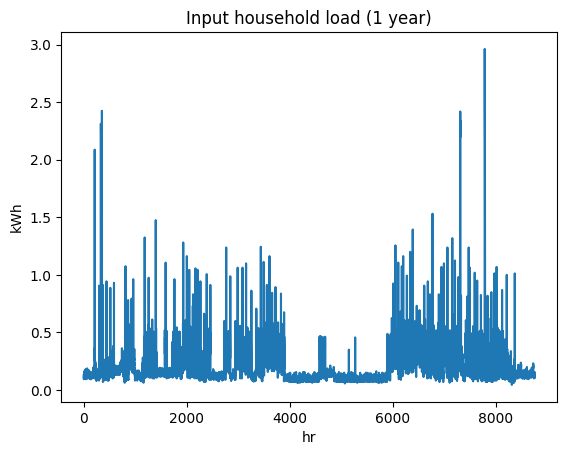

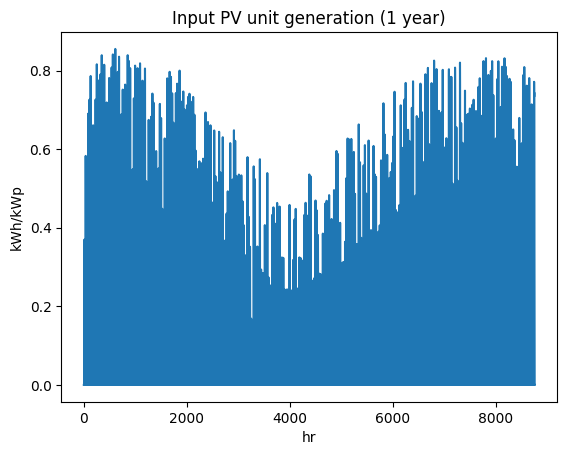

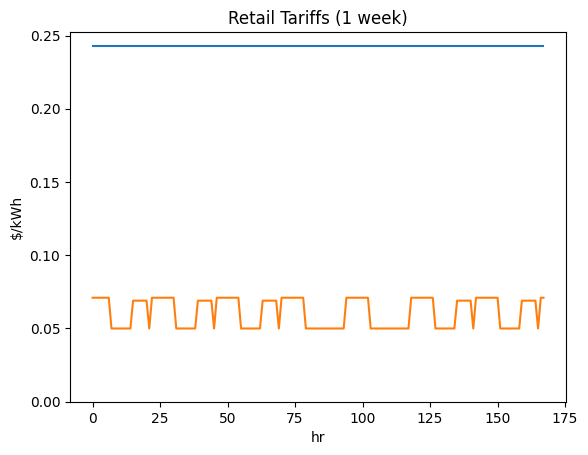

---- Optimising with PV: 1 - 20 kWp, Batt: 0 kWh. Determining PV capacity and dispatch.


************************************ Modell: PV > 1 kWp & BATT > 1 kWh ************************************
{'financial_horizon': 10, 'discount_rate': np.float64(0.06), 'grid_feedin_max': np.float64(5.0), 'pv_eol_capacity': np.float64(0.8), 'pv_eol_years': np.float64(25.0), 'pv_init_soh': np.float64(1.0), 'bess_e2p_ratio': np.float64(2.4), 'bess_roundtrip_eff': np.float64(0.88), 'bess_eol_years': np.float64(10.0), 'bess_eol_capacity': np.float64(0.7), 'bess_eol_cycles': np.float64(10000.0), 'bess_init_soh': np.float64(1.0), 'bess_eff_charge': np.float64(0.938083151964686), 'bess_eff_discharge': np.float64(0.938083151964686), 'scenario_name': 'Scenario_D_+5', 'scenario_set': 'SurfCoast', 'scenario_subset': 'JJP_open', 'year_start': 2022, 'datetime_name': 'DateTime1', 'meter_name': 'pc3081_nmi1443902651', 'solar_name': 'MELB', 'tariff_name_import_wkday': '3_Im_wkday', 'tariff_name_export_wkday': '3_

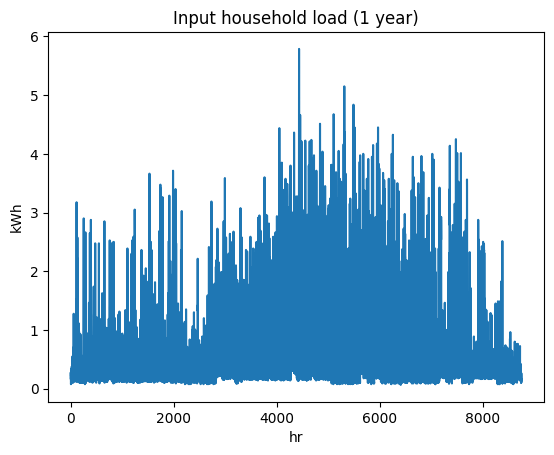

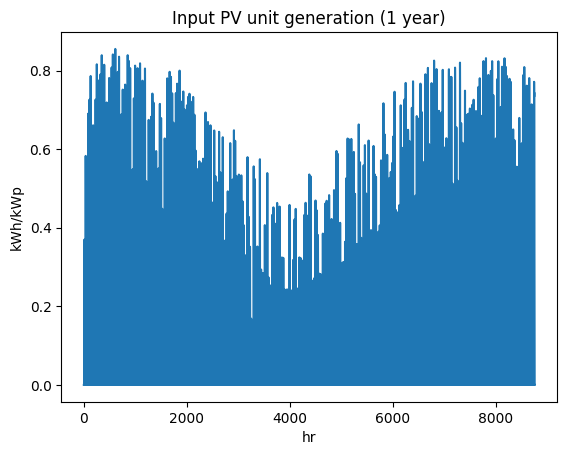

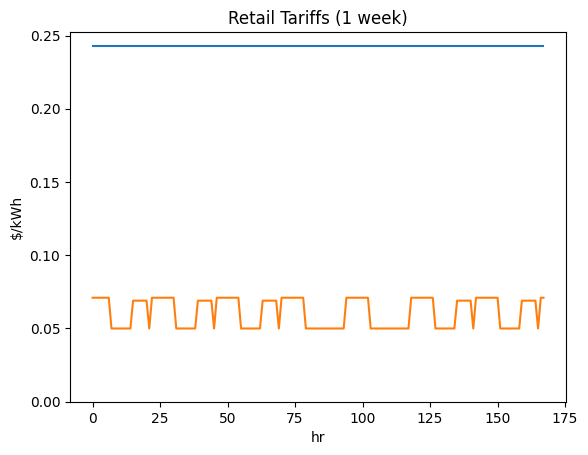

---- Optimising with PV: 1 - 20 kWp, Batt: 0 kWh. Determining PV capacity and dispatch.


************************************ Modell: PV > 1 kWp & BATT > 1 kWh ************************************
{'financial_horizon': 10, 'discount_rate': np.float64(0.06), 'grid_feedin_max': np.float64(5.0), 'pv_eol_capacity': np.float64(0.8), 'pv_eol_years': np.float64(25.0), 'pv_init_soh': np.float64(1.0), 'bess_e2p_ratio': np.float64(2.4), 'bess_roundtrip_eff': np.float64(0.88), 'bess_eol_years': np.float64(10.0), 'bess_eol_capacity': np.float64(0.7), 'bess_eol_cycles': np.float64(10000.0), 'bess_init_soh': np.float64(1.0), 'bess_eff_charge': np.float64(0.938083151964686), 'bess_eff_discharge': np.float64(0.938083151964686), 'scenario_name': 'Scenario_D_+5', 'scenario_set': 'SurfCoast', 'scenario_subset': 'JJP_open', 'year_start': 2022, 'datetime_name': 'DateTime1', 'meter_name': 'pc3079_nmi2299921608', 'solar_name': 'MELB', 'tariff_name_import_wkday': '3_Im_wkday', 'tariff_name_export_wkday': '3_

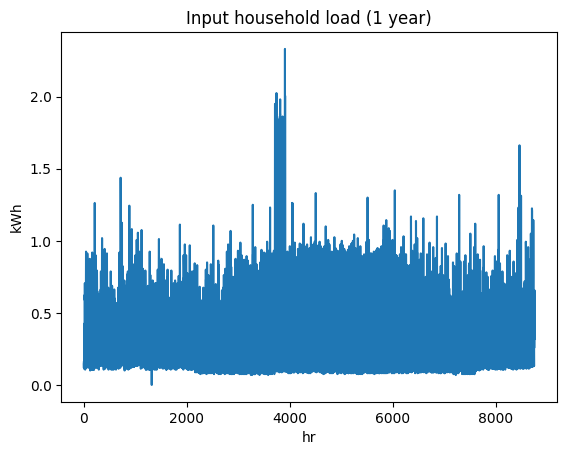

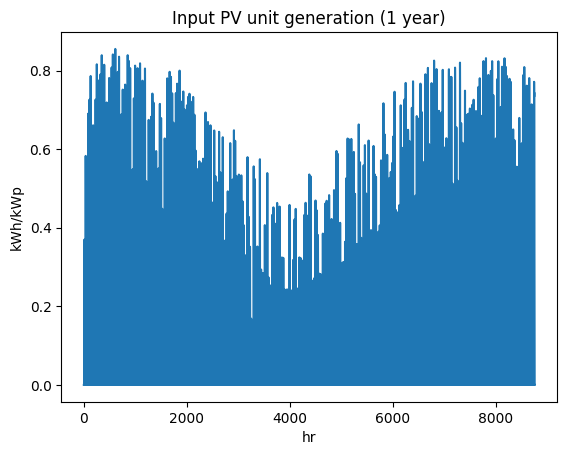

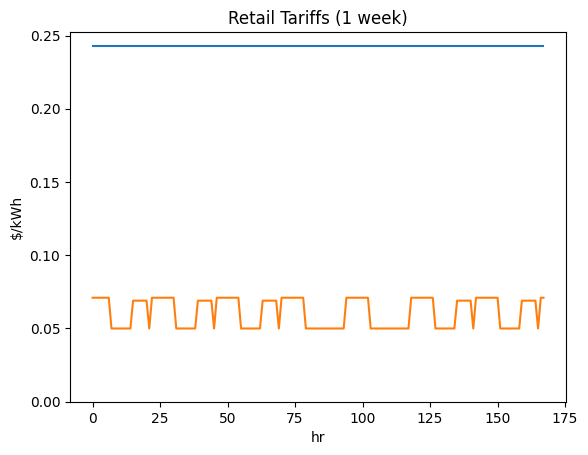

---- Optimising with PV: 1 - 20 kWp, Batt: 0 kWh. Determining PV capacity and dispatch.


************************************ Modell: PV > 1 kWp & BATT > 1 kWh ************************************
{'financial_horizon': 10, 'discount_rate': np.float64(0.06), 'grid_feedin_max': np.float64(5.0), 'pv_eol_capacity': np.float64(0.8), 'pv_eol_years': np.float64(25.0), 'pv_init_soh': np.float64(1.0), 'bess_e2p_ratio': np.float64(2.4), 'bess_roundtrip_eff': np.float64(0.88), 'bess_eol_years': np.float64(10.0), 'bess_eol_capacity': np.float64(0.7), 'bess_eol_cycles': np.float64(10000.0), 'bess_init_soh': np.float64(1.0), 'bess_eff_charge': np.float64(0.938083151964686), 'bess_eff_discharge': np.float64(0.938083151964686), 'scenario_name': 'Scenario_D_+5', 'scenario_set': 'SurfCoast', 'scenario_subset': 'JJP_open', 'year_start': 2022, 'datetime_name': 'DateTime1', 'meter_name': 'pc3084_nmi3762814141', 'solar_name': 'MELB', 'tariff_name_import_wkday': '3_Im_wkday', 'tariff_name_export_wkday': '3_

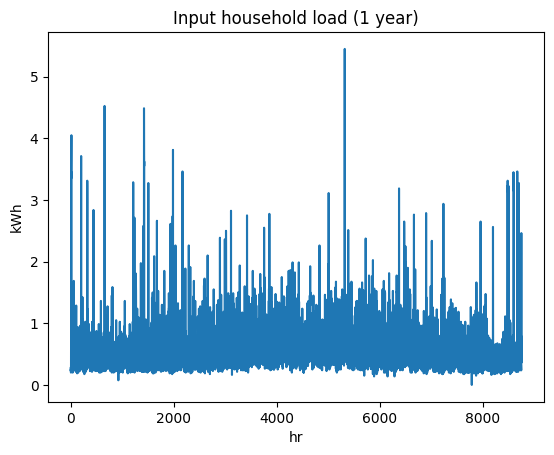

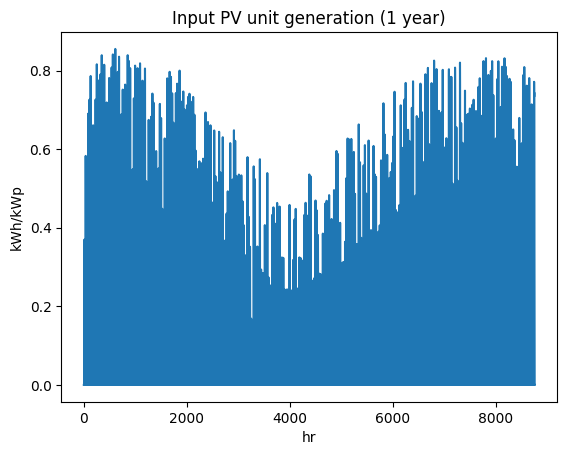

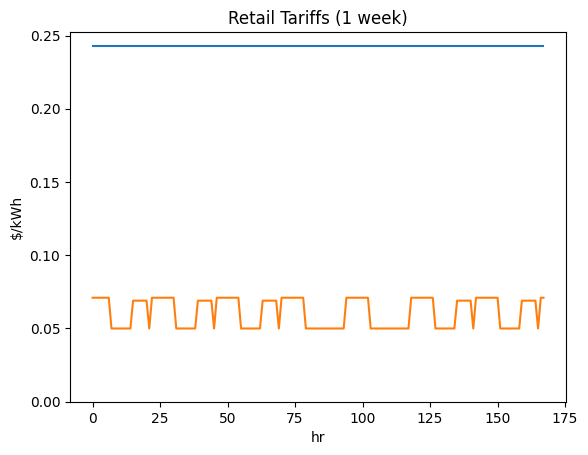

---- Optimising with PV: 1 - 20 kWp, Batt: 0 kWh. Determining PV capacity and dispatch.


************************************ Modell: PV > 1 kWp & BATT > 1 kWh ************************************
{'financial_horizon': 10, 'discount_rate': np.float64(0.06), 'grid_feedin_max': np.float64(5.0), 'pv_eol_capacity': np.float64(0.8), 'pv_eol_years': np.float64(25.0), 'pv_init_soh': np.float64(1.0), 'bess_e2p_ratio': np.float64(2.4), 'bess_roundtrip_eff': np.float64(0.88), 'bess_eol_years': np.float64(10.0), 'bess_eol_capacity': np.float64(0.7), 'bess_eol_cycles': np.float64(10000.0), 'bess_init_soh': np.float64(1.0), 'bess_eff_charge': np.float64(0.938083151964686), 'bess_eff_discharge': np.float64(0.938083151964686), 'scenario_name': 'Scenario_D_+5', 'scenario_set': 'SurfCoast', 'scenario_subset': 'JJP_open', 'year_start': 2022, 'datetime_name': 'DateTime1', 'meter_name': 'pc3084_nmi9130014388', 'solar_name': 'MELB', 'tariff_name_import_wkday': '3_Im_wkday', 'tariff_name_export_wkday': '3_

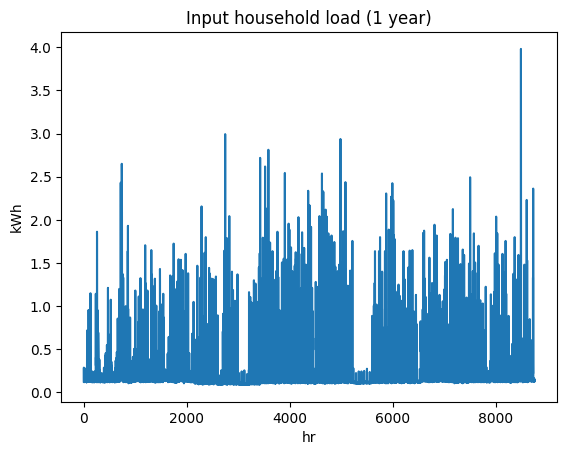

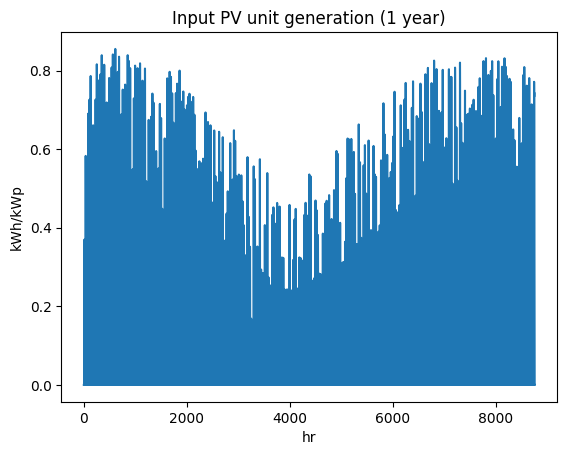

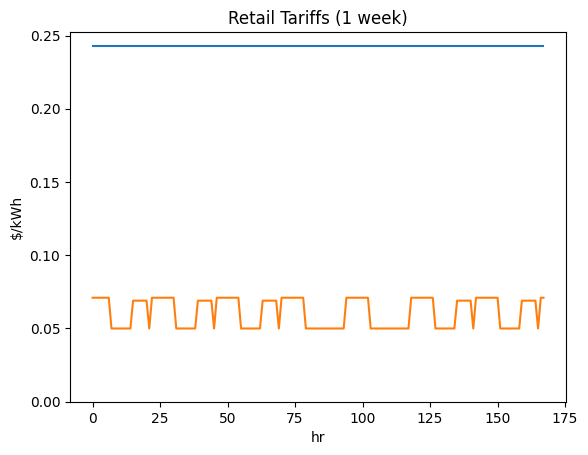

---- Optimising with PV: 1 - 20 kWp, Batt: 0 kWh. Determining PV capacity and dispatch.


************************************ Modell: PV > 1 kWp & BATT > 1 kWh ************************************
{'financial_horizon': 10, 'discount_rate': np.float64(0.06), 'grid_feedin_max': np.float64(5.0), 'pv_eol_capacity': np.float64(0.8), 'pv_eol_years': np.float64(25.0), 'pv_init_soh': np.float64(1.0), 'bess_e2p_ratio': np.float64(2.4), 'bess_roundtrip_eff': np.float64(0.88), 'bess_eol_years': np.float64(10.0), 'bess_eol_capacity': np.float64(0.7), 'bess_eol_cycles': np.float64(10000.0), 'bess_init_soh': np.float64(1.0), 'bess_eff_charge': np.float64(0.938083151964686), 'bess_eff_discharge': np.float64(0.938083151964686), 'scenario_name': 'Scenario_D_+5', 'scenario_set': 'SurfCoast', 'scenario_subset': 'JJP_open', 'year_start': 2022, 'datetime_name': 'DateTime1', 'meter_name': 'pc3084_nmi9350646085', 'solar_name': 'MELB', 'tariff_name_import_wkday': '3_Im_wkday', 'tariff_name_export_wkday': '3_

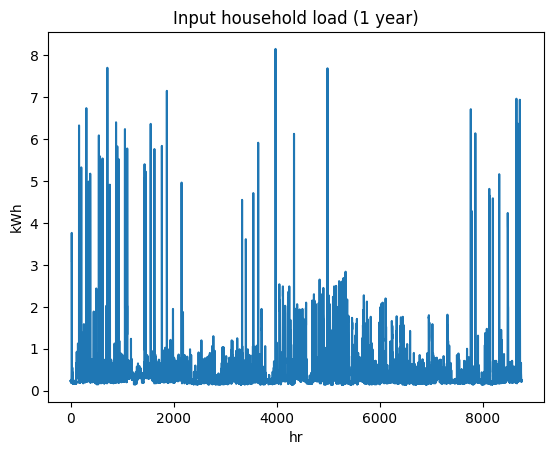

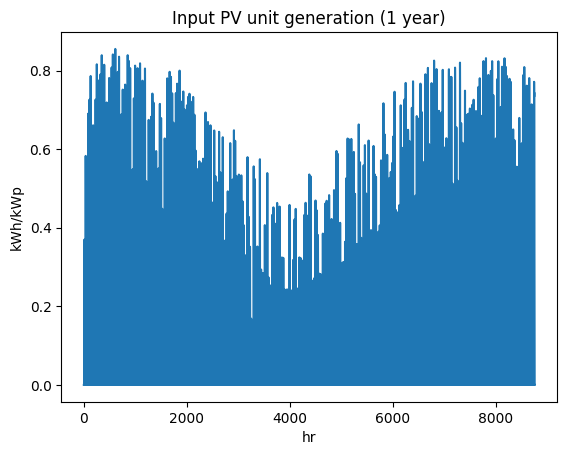

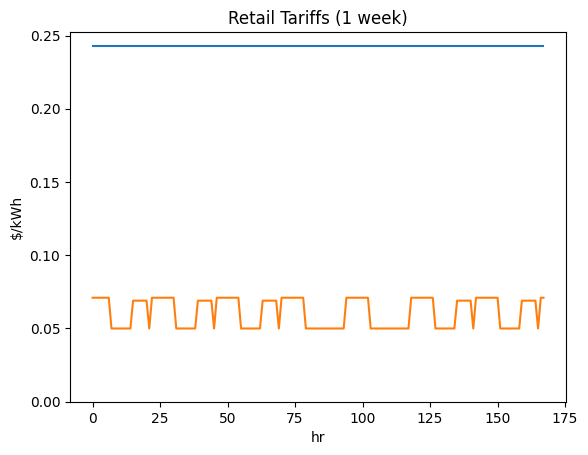

---- Optimising with PV: 1 - 20 kWp, Batt: 0 kWh. Determining PV capacity and dispatch.


************************************ Modell: PV > 1 kWp & BATT > 1 kWh ************************************
{'financial_horizon': 10, 'discount_rate': np.float64(0.06), 'grid_feedin_max': np.float64(5.0), 'pv_eol_capacity': np.float64(0.8), 'pv_eol_years': np.float64(25.0), 'pv_init_soh': np.float64(1.0), 'bess_e2p_ratio': np.float64(2.4), 'bess_roundtrip_eff': np.float64(0.88), 'bess_eol_years': np.float64(10.0), 'bess_eol_capacity': np.float64(0.7), 'bess_eol_cycles': np.float64(10000.0), 'bess_init_soh': np.float64(1.0), 'bess_eff_charge': np.float64(0.938083151964686), 'bess_eff_discharge': np.float64(0.938083151964686), 'scenario_name': 'Scenario_D_+5', 'scenario_set': 'SurfCoast', 'scenario_subset': 'JJP_open', 'year_start': 2022, 'datetime_name': 'DateTime1', 'meter_name': 'pc3084_nmi2024458810', 'solar_name': 'MELB', 'tariff_name_import_wkday': '3_Im_wkday', 'tariff_name_export_wkday': '3_

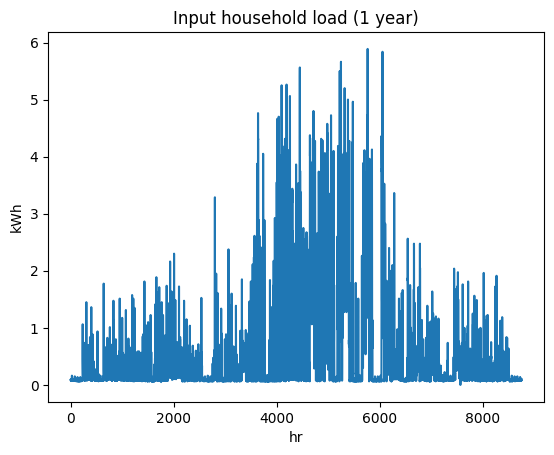

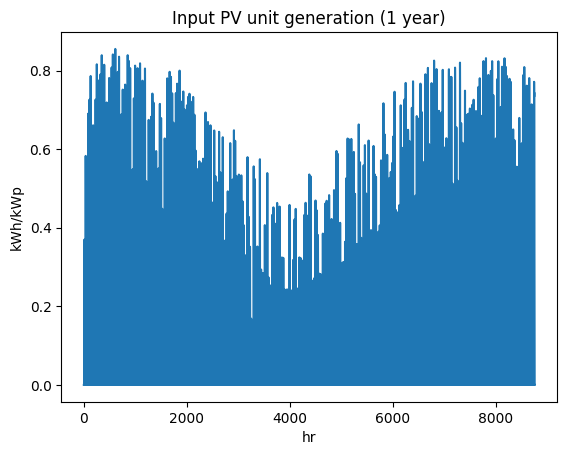

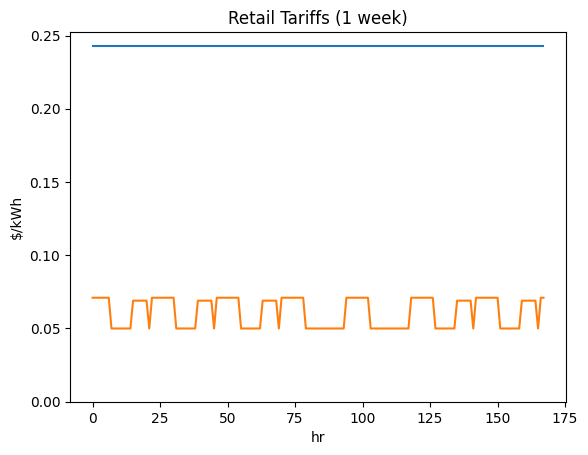

---- Optimising with PV: 1 - 20 kWp, Batt: 0 kWh. Determining PV capacity and dispatch.


************************************ Modell: PV > 1 kWp & BATT > 1 kWh ************************************
{'financial_horizon': 10, 'discount_rate': np.float64(0.06), 'grid_feedin_max': np.float64(5.0), 'pv_eol_capacity': np.float64(0.8), 'pv_eol_years': np.float64(25.0), 'pv_init_soh': np.float64(1.0), 'bess_e2p_ratio': np.float64(2.4), 'bess_roundtrip_eff': np.float64(0.88), 'bess_eol_years': np.float64(10.0), 'bess_eol_capacity': np.float64(0.7), 'bess_eol_cycles': np.float64(10000.0), 'bess_init_soh': np.float64(1.0), 'bess_eff_charge': np.float64(0.938083151964686), 'bess_eff_discharge': np.float64(0.938083151964686), 'scenario_name': 'Scenario_D_+5', 'scenario_set': 'SurfCoast', 'scenario_subset': 'JJP_open', 'year_start': 2022, 'datetime_name': 'DateTime1', 'meter_name': 'pc3084_nmi5871496777', 'solar_name': 'MELB', 'tariff_name_import_wkday': '3_Im_wkday', 'tariff_name_export_wkday': '3_

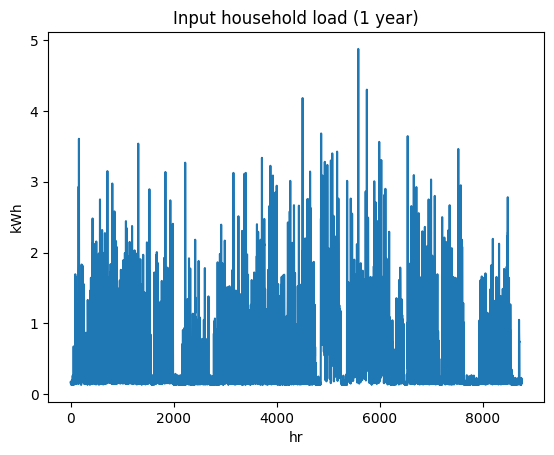

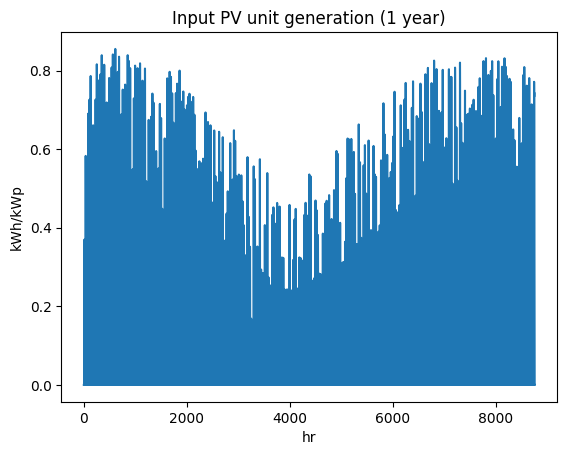

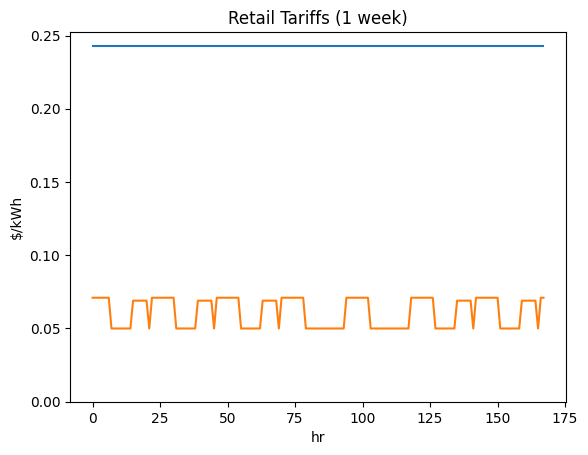

---- Optimising with PV: 1 - 20 kWp, Batt: 0 kWh. Determining PV capacity and dispatch.


************************************ Modell: PV > 1 kWp & BATT > 1 kWh ************************************
{'financial_horizon': 10, 'discount_rate': np.float64(0.06), 'grid_feedin_max': np.float64(5.0), 'pv_eol_capacity': np.float64(0.8), 'pv_eol_years': np.float64(25.0), 'pv_init_soh': np.float64(1.0), 'bess_e2p_ratio': np.float64(2.4), 'bess_roundtrip_eff': np.float64(0.88), 'bess_eol_years': np.float64(10.0), 'bess_eol_capacity': np.float64(0.7), 'bess_eol_cycles': np.float64(10000.0), 'bess_init_soh': np.float64(1.0), 'bess_eff_charge': np.float64(0.938083151964686), 'bess_eff_discharge': np.float64(0.938083151964686), 'scenario_name': 'Scenario_D_+5', 'scenario_set': 'SurfCoast', 'scenario_subset': 'JJP_open', 'year_start': 2022, 'datetime_name': 'DateTime1', 'meter_name': 'pc3079_nmi5810591114', 'solar_name': 'MELB', 'tariff_name_import_wkday': '3_Im_wkday', 'tariff_name_export_wkday': '3_

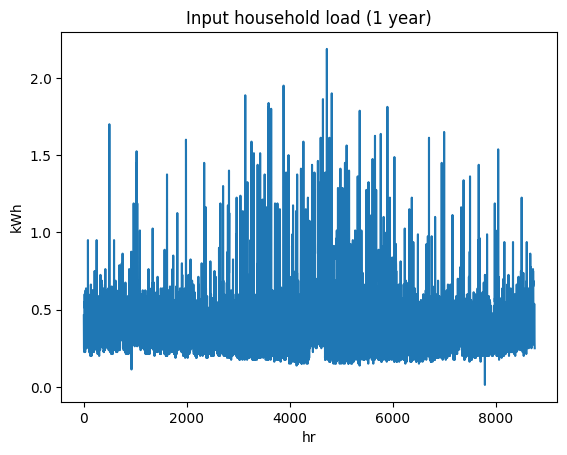

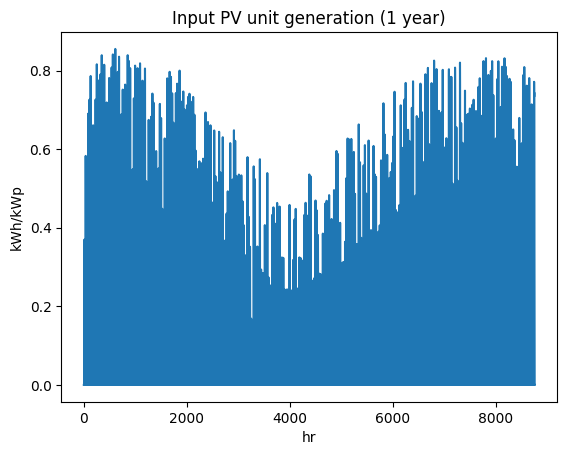

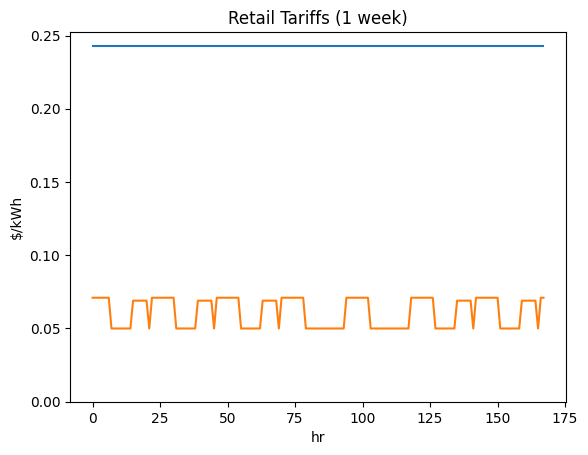

---- Optimising with PV: 1 - 20 kWp, Batt: 0 kWh. Determining PV capacity and dispatch.


************************************ Modell: PV > 1 kWp & BATT > 1 kWh ************************************
{'financial_horizon': 10, 'discount_rate': np.float64(0.06), 'grid_feedin_max': np.float64(5.0), 'pv_eol_capacity': np.float64(0.8), 'pv_eol_years': np.float64(25.0), 'pv_init_soh': np.float64(1.0), 'bess_e2p_ratio': np.float64(2.4), 'bess_roundtrip_eff': np.float64(0.88), 'bess_eol_years': np.float64(10.0), 'bess_eol_capacity': np.float64(0.7), 'bess_eol_cycles': np.float64(10000.0), 'bess_init_soh': np.float64(1.0), 'bess_eff_charge': np.float64(0.938083151964686), 'bess_eff_discharge': np.float64(0.938083151964686), 'scenario_name': 'Scenario_D_+5', 'scenario_set': 'SurfCoast', 'scenario_subset': 'JJP_open', 'year_start': 2022, 'datetime_name': 'DateTime1', 'meter_name': 'pc3084_nmi8410806661', 'solar_name': 'MELB', 'tariff_name_import_wkday': '3_Im_wkday', 'tariff_name_export_wkday': '3_

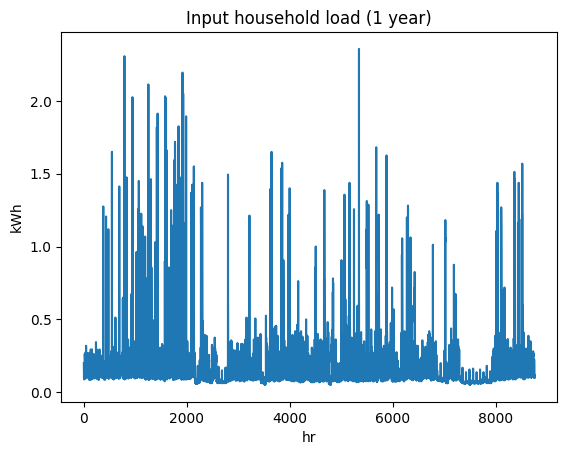

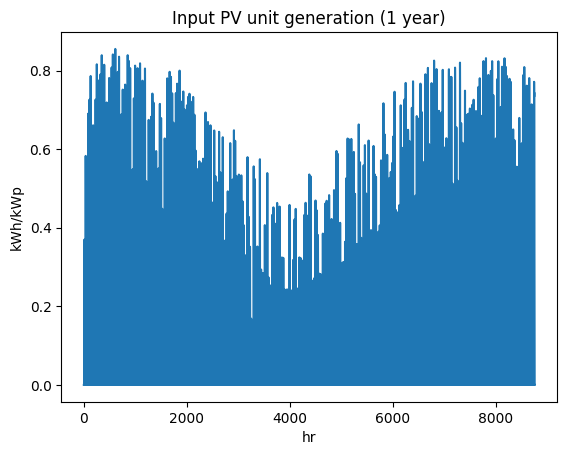

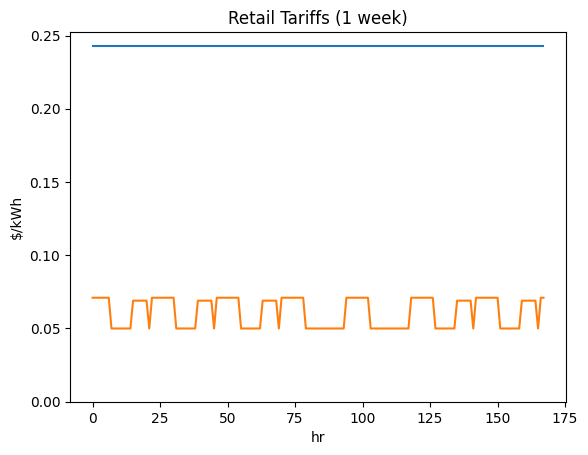

---- Optimising with PV: 1 - 20 kWp, Batt: 0 kWh. Determining PV capacity and dispatch.


************************************ Modell: PV > 1 kWp & BATT > 1 kWh ************************************
{'financial_horizon': 10, 'discount_rate': np.float64(0.06), 'grid_feedin_max': np.float64(5.0), 'pv_eol_capacity': np.float64(0.8), 'pv_eol_years': np.float64(25.0), 'pv_init_soh': np.float64(1.0), 'bess_e2p_ratio': np.float64(2.4), 'bess_roundtrip_eff': np.float64(0.88), 'bess_eol_years': np.float64(10.0), 'bess_eol_capacity': np.float64(0.7), 'bess_eol_cycles': np.float64(10000.0), 'bess_init_soh': np.float64(1.0), 'bess_eff_charge': np.float64(0.938083151964686), 'bess_eff_discharge': np.float64(0.938083151964686), 'scenario_name': 'Scenario_D_+5', 'scenario_set': 'SurfCoast', 'scenario_subset': 'JJP_open', 'year_start': 2022, 'datetime_name': 'DateTime1', 'meter_name': 'pc3081_nmi7846679091', 'solar_name': 'MELB', 'tariff_name_import_wkday': '3_Im_wkday', 'tariff_name_export_wkday': '3_

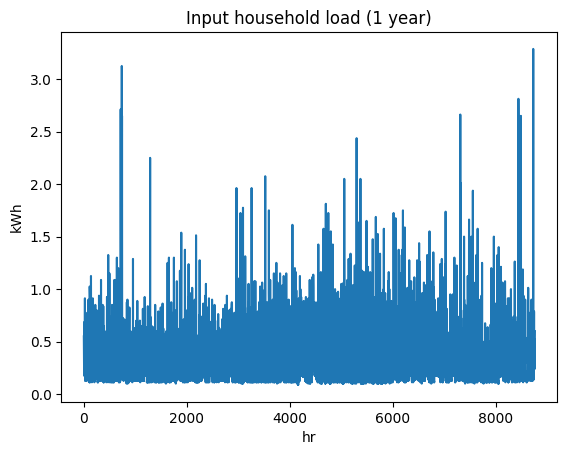

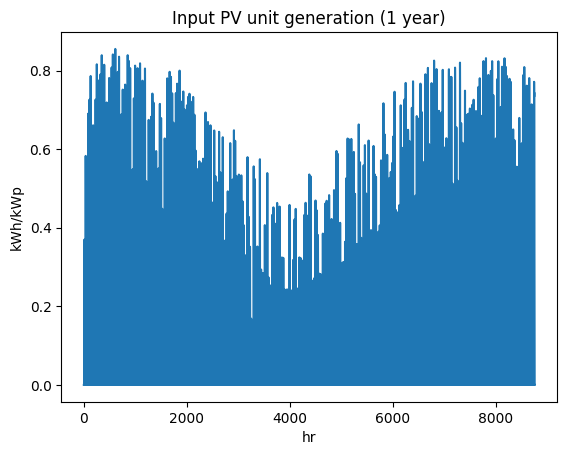

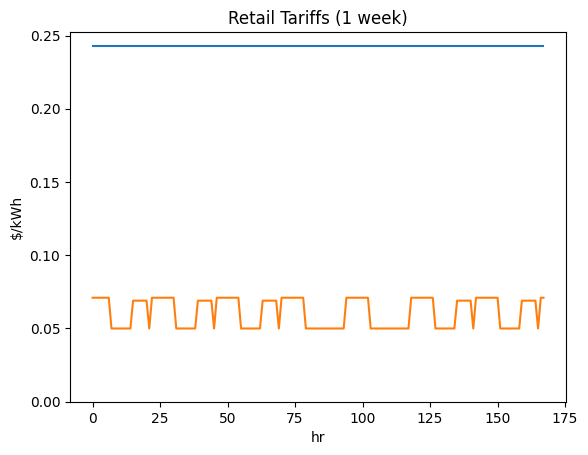

---- Optimising with PV: 1 - 20 kWp, Batt: 0 kWh. Determining PV capacity and dispatch.


************************************ Modell: PV > 1 kWp & BATT > 1 kWh ************************************
{'financial_horizon': 10, 'discount_rate': np.float64(0.06), 'grid_feedin_max': np.float64(5.0), 'pv_eol_capacity': np.float64(0.8), 'pv_eol_years': np.float64(25.0), 'pv_init_soh': np.float64(1.0), 'bess_e2p_ratio': np.float64(2.4), 'bess_roundtrip_eff': np.float64(0.88), 'bess_eol_years': np.float64(10.0), 'bess_eol_capacity': np.float64(0.7), 'bess_eol_cycles': np.float64(10000.0), 'bess_init_soh': np.float64(1.0), 'bess_eff_charge': np.float64(0.938083151964686), 'bess_eff_discharge': np.float64(0.938083151964686), 'scenario_name': 'Scenario_D_+5', 'scenario_set': 'SurfCoast', 'scenario_subset': 'JJP_open', 'year_start': 2022, 'datetime_name': 'DateTime1', 'meter_name': 'pc3081_nmi7322812097', 'solar_name': 'MELB', 'tariff_name_import_wkday': '3_Im_wkday', 'tariff_name_export_wkday': '3_

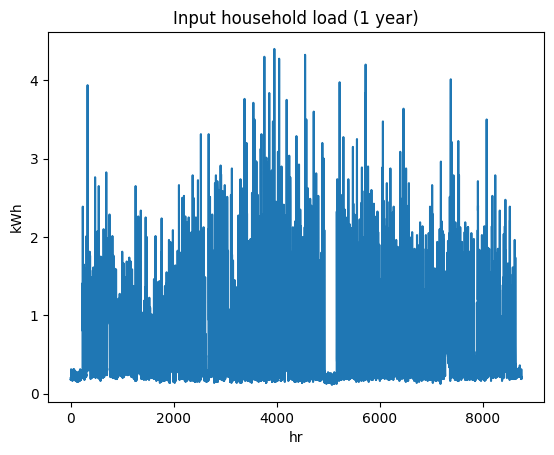

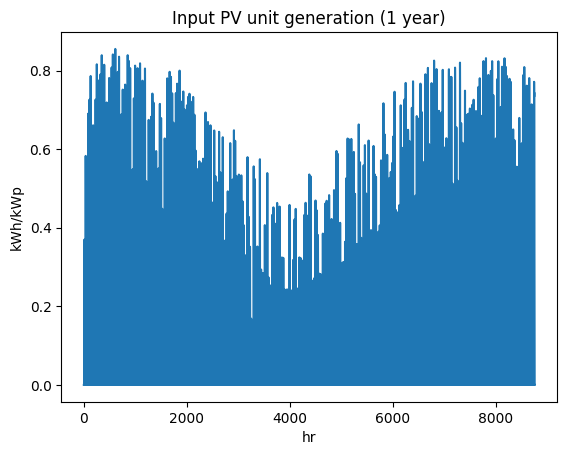

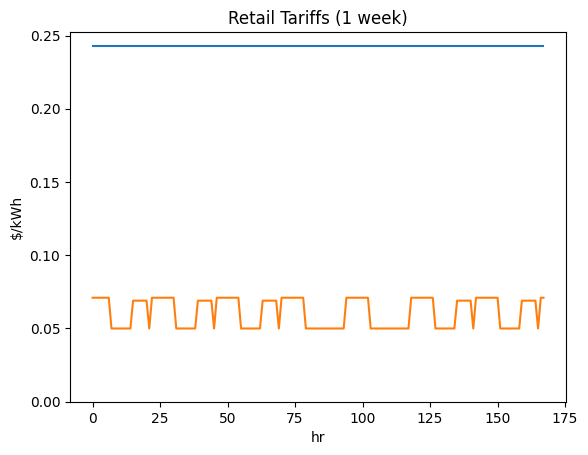

---- Optimising with PV: 1 - 20 kWp, Batt: 0 kWh. Determining PV capacity and dispatch.


************************************ Modell: PV > 1 kWp & BATT > 1 kWh ************************************
{'financial_horizon': 10, 'discount_rate': np.float64(0.06), 'grid_feedin_max': np.float64(5.0), 'pv_eol_capacity': np.float64(0.8), 'pv_eol_years': np.float64(25.0), 'pv_init_soh': np.float64(1.0), 'bess_e2p_ratio': np.float64(2.4), 'bess_roundtrip_eff': np.float64(0.88), 'bess_eol_years': np.float64(10.0), 'bess_eol_capacity': np.float64(0.7), 'bess_eol_cycles': np.float64(10000.0), 'bess_init_soh': np.float64(1.0), 'bess_eff_charge': np.float64(0.938083151964686), 'bess_eff_discharge': np.float64(0.938083151964686), 'scenario_name': 'Scenario_D_+5', 'scenario_set': 'SurfCoast', 'scenario_subset': 'JJP_open', 'year_start': 2022, 'datetime_name': 'DateTime1', 'meter_name': 'pc3084_nmi6605564608', 'solar_name': 'MELB', 'tariff_name_import_wkday': '3_Im_wkday', 'tariff_name_export_wkday': '3_

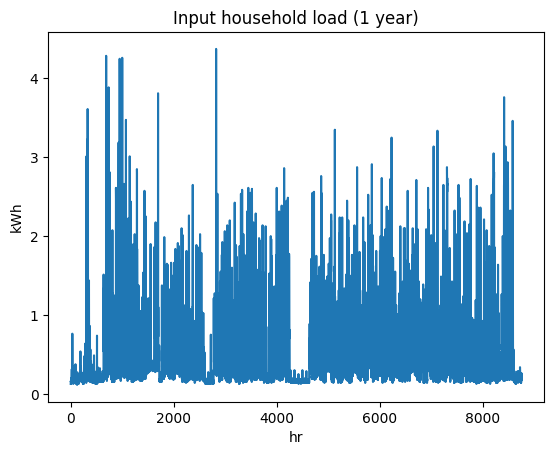

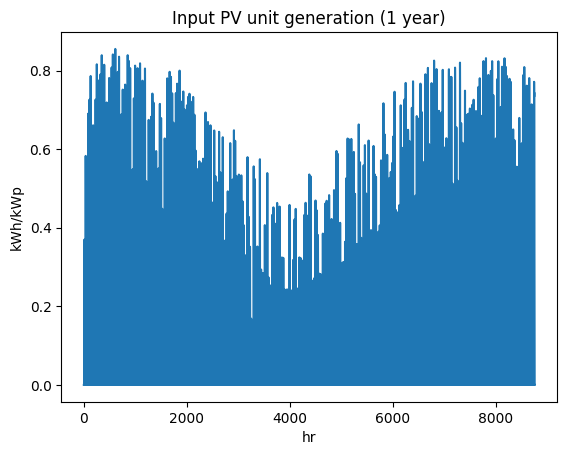

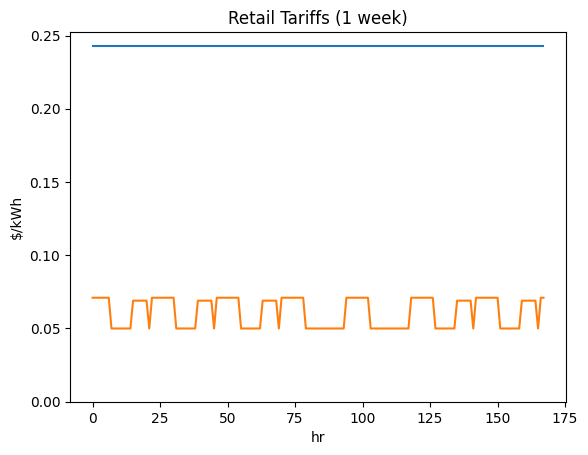

---- Optimising with PV: 1 - 20 kWp, Batt: 0 kWh. Determining PV capacity and dispatch.


************************************ Modell: PV > 1 kWp & BATT > 1 kWh ************************************
{'financial_horizon': 10, 'discount_rate': np.float64(0.06), 'grid_feedin_max': np.float64(5.0), 'pv_eol_capacity': np.float64(0.8), 'pv_eol_years': np.float64(25.0), 'pv_init_soh': np.float64(1.0), 'bess_e2p_ratio': np.float64(2.4), 'bess_roundtrip_eff': np.float64(0.88), 'bess_eol_years': np.float64(10.0), 'bess_eol_capacity': np.float64(0.7), 'bess_eol_cycles': np.float64(10000.0), 'bess_init_soh': np.float64(1.0), 'bess_eff_charge': np.float64(0.938083151964686), 'bess_eff_discharge': np.float64(0.938083151964686), 'scenario_name': 'Scenario_D_+5', 'scenario_set': 'SurfCoast', 'scenario_subset': 'JJP_open', 'year_start': 2022, 'datetime_name': 'DateTime1', 'meter_name': 'pc3084_nmi6211096171', 'solar_name': 'MELB', 'tariff_name_import_wkday': '3_Im_wkday', 'tariff_name_export_wkday': '3_

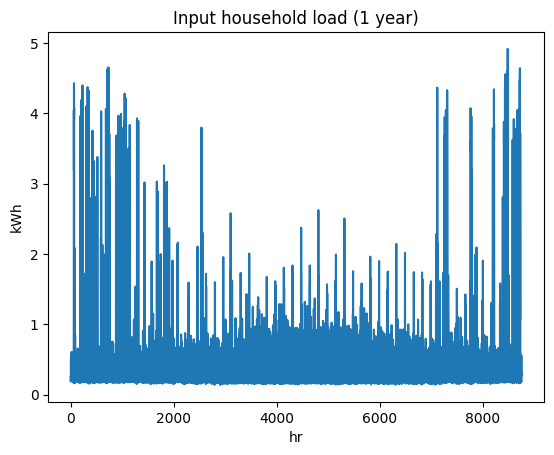

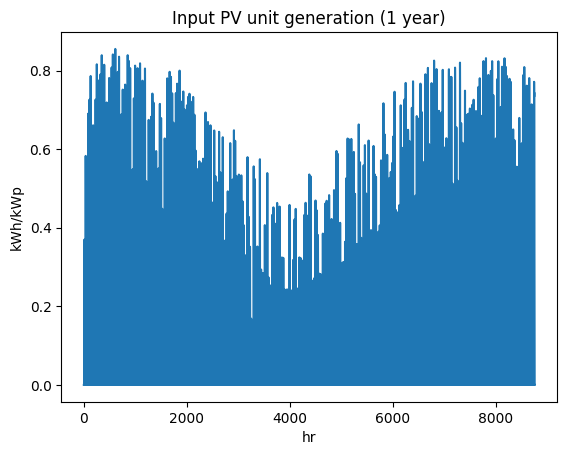

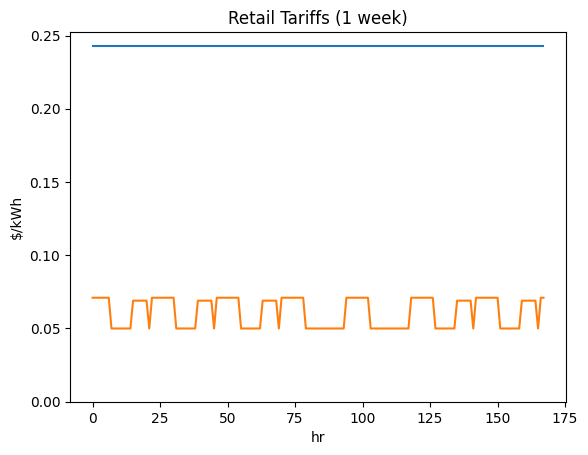

---- Optimising with PV: 1 - 20 kWp, Batt: 0 kWh. Determining PV capacity and dispatch.


************************************ Modell: PV > 1 kWp & BATT > 1 kWh ************************************
{'financial_horizon': 10, 'discount_rate': np.float64(0.06), 'grid_feedin_max': np.float64(5.0), 'pv_eol_capacity': np.float64(0.8), 'pv_eol_years': np.float64(25.0), 'pv_init_soh': np.float64(1.0), 'bess_e2p_ratio': np.float64(2.4), 'bess_roundtrip_eff': np.float64(0.88), 'bess_eol_years': np.float64(10.0), 'bess_eol_capacity': np.float64(0.7), 'bess_eol_cycles': np.float64(10000.0), 'bess_init_soh': np.float64(1.0), 'bess_eff_charge': np.float64(0.938083151964686), 'bess_eff_discharge': np.float64(0.938083151964686), 'scenario_name': 'Scenario_D_+5', 'scenario_set': 'SurfCoast', 'scenario_subset': 'JJP_open', 'year_start': 2022, 'datetime_name': 'DateTime1', 'meter_name': 'pc3084_nmi7918397120', 'solar_name': 'MELB', 'tariff_name_import_wkday': '3_Im_wkday', 'tariff_name_export_wkday': '3_

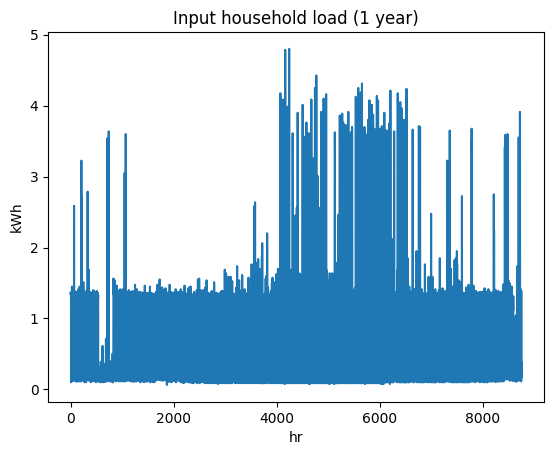

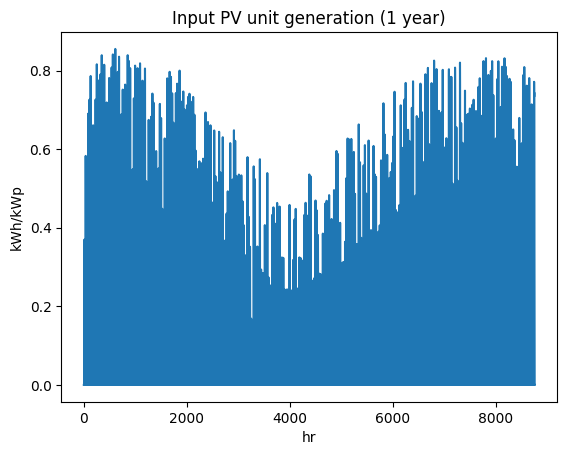

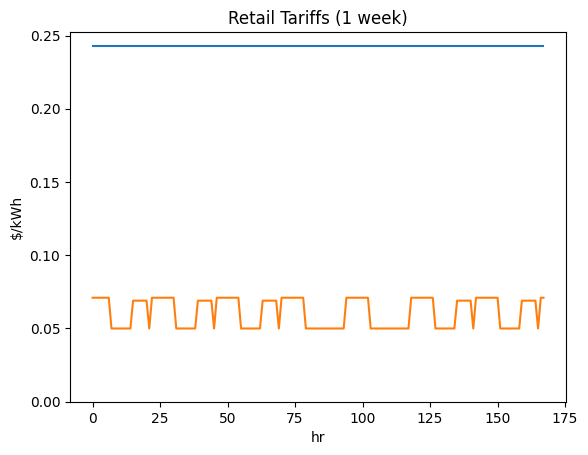

---- Optimising with PV: 1 - 20 kWp, Batt: 0 kWh. Determining PV capacity and dispatch.


************************************ Modell: PV > 1 kWp & BATT > 1 kWh ************************************
{'financial_horizon': 10, 'discount_rate': np.float64(0.06), 'grid_feedin_max': np.float64(5.0), 'pv_eol_capacity': np.float64(0.8), 'pv_eol_years': np.float64(25.0), 'pv_init_soh': np.float64(1.0), 'bess_e2p_ratio': np.float64(2.4), 'bess_roundtrip_eff': np.float64(0.88), 'bess_eol_years': np.float64(10.0), 'bess_eol_capacity': np.float64(0.7), 'bess_eol_cycles': np.float64(10000.0), 'bess_init_soh': np.float64(1.0), 'bess_eff_charge': np.float64(0.938083151964686), 'bess_eff_discharge': np.float64(0.938083151964686), 'scenario_name': 'Scenario_D_+5', 'scenario_set': 'SurfCoast', 'scenario_subset': 'JJP_open', 'year_start': 2022, 'datetime_name': 'DateTime1', 'meter_name': 'pc3084_nmi3043964720', 'solar_name': 'MELB', 'tariff_name_import_wkday': '3_Im_wkday', 'tariff_name_export_wkday': '3_

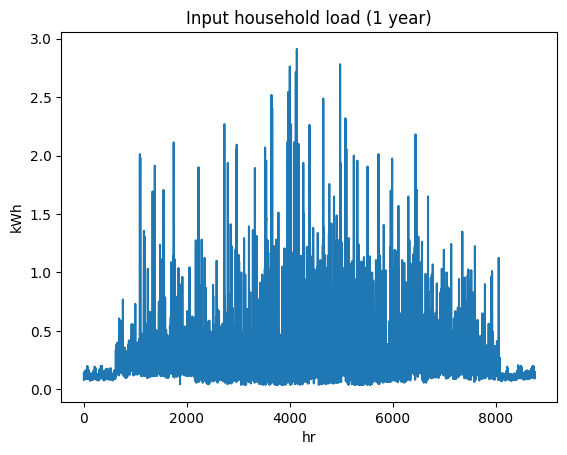

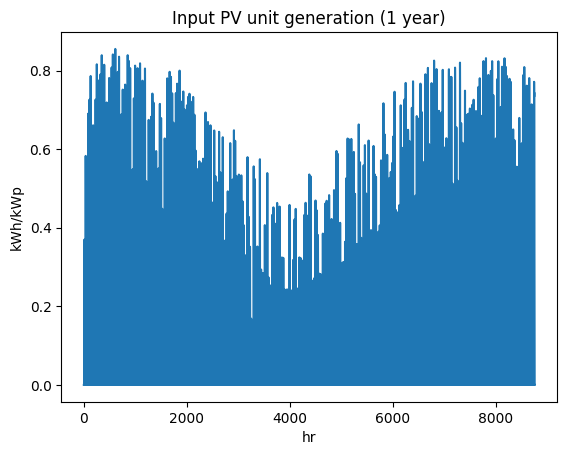

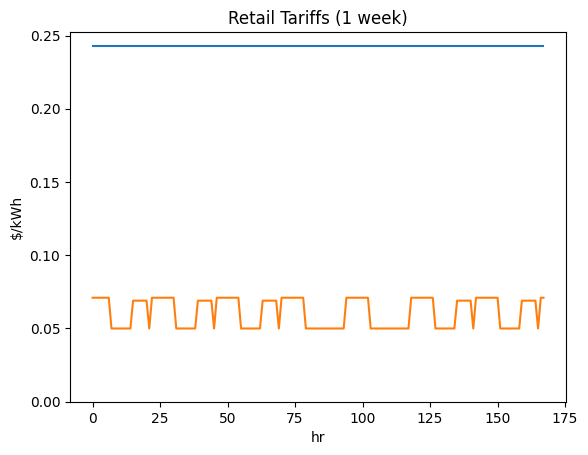

---- Optimising with PV: 1 - 20 kWp, Batt: 0 kWh. Determining PV capacity and dispatch.


************************************ Modell: PV > 1 kWp & BATT > 1 kWh ************************************
{'financial_horizon': 10, 'discount_rate': np.float64(0.06), 'grid_feedin_max': np.float64(5.0), 'pv_eol_capacity': np.float64(0.8), 'pv_eol_years': np.float64(25.0), 'pv_init_soh': np.float64(1.0), 'bess_e2p_ratio': np.float64(2.4), 'bess_roundtrip_eff': np.float64(0.88), 'bess_eol_years': np.float64(10.0), 'bess_eol_capacity': np.float64(0.7), 'bess_eol_cycles': np.float64(10000.0), 'bess_init_soh': np.float64(1.0), 'bess_eff_charge': np.float64(0.938083151964686), 'bess_eff_discharge': np.float64(0.938083151964686), 'scenario_name': 'Scenario_D_+5', 'scenario_set': 'SurfCoast', 'scenario_subset': 'JJP_open', 'year_start': 2022, 'datetime_name': 'DateTime1', 'meter_name': 'pc3081_nmi1588412661', 'solar_name': 'MELB', 'tariff_name_import_wkday': '3_Im_wkday', 'tariff_name_export_wkday': '3_

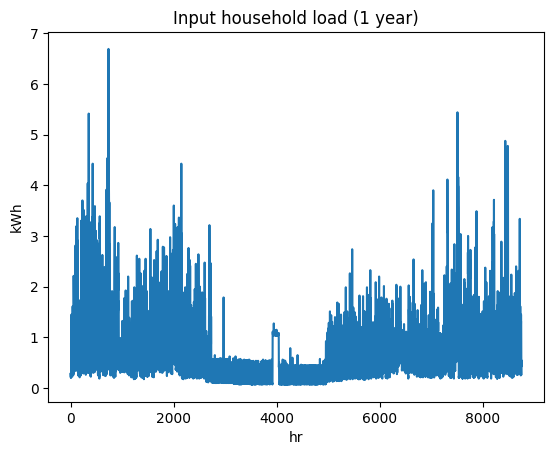

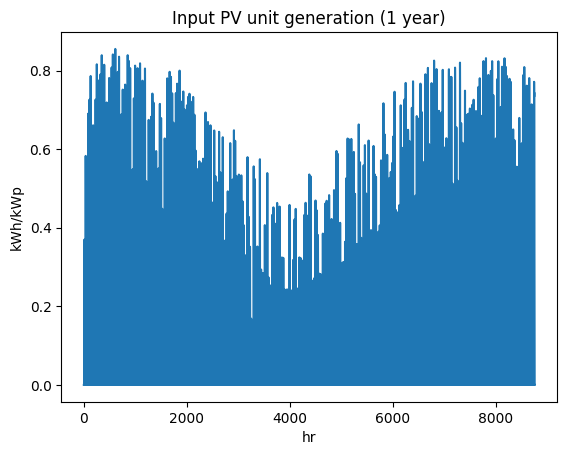

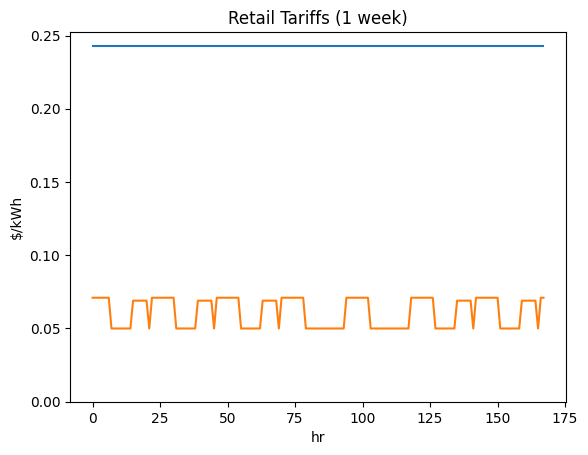

---- Optimising with PV: 1 - 20 kWp, Batt: 0 kWh. Determining PV capacity and dispatch.


************************************ Modell: PV > 1 kWp & BATT > 1 kWh ************************************
{'financial_horizon': 10, 'discount_rate': np.float64(0.06), 'grid_feedin_max': np.float64(5.0), 'pv_eol_capacity': np.float64(0.8), 'pv_eol_years': np.float64(25.0), 'pv_init_soh': np.float64(1.0), 'bess_e2p_ratio': np.float64(2.4), 'bess_roundtrip_eff': np.float64(0.88), 'bess_eol_years': np.float64(10.0), 'bess_eol_capacity': np.float64(0.7), 'bess_eol_cycles': np.float64(10000.0), 'bess_init_soh': np.float64(1.0), 'bess_eff_charge': np.float64(0.938083151964686), 'bess_eff_discharge': np.float64(0.938083151964686), 'scenario_name': 'Scenario_D_+5', 'scenario_set': 'SurfCoast', 'scenario_subset': 'JJP_open', 'year_start': 2022, 'datetime_name': 'DateTime1', 'meter_name': 'pc3081_nmi1506077812', 'solar_name': 'MELB', 'tariff_name_import_wkday': '3_Im_wkday', 'tariff_name_export_wkday': '3_

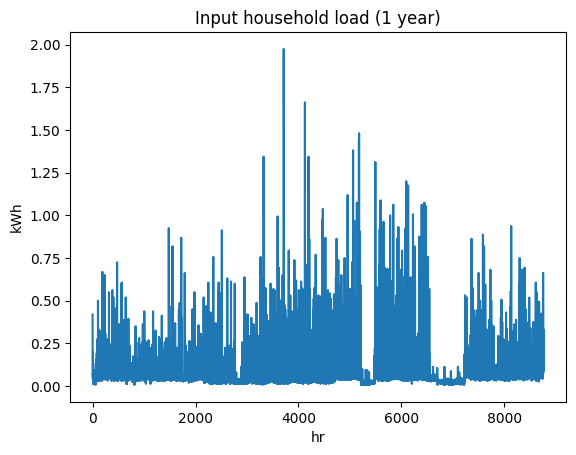

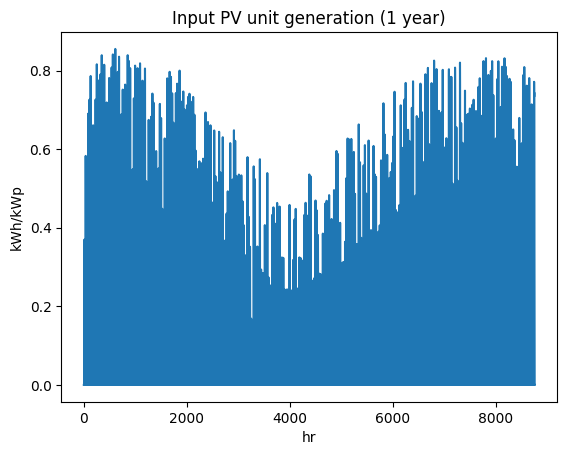

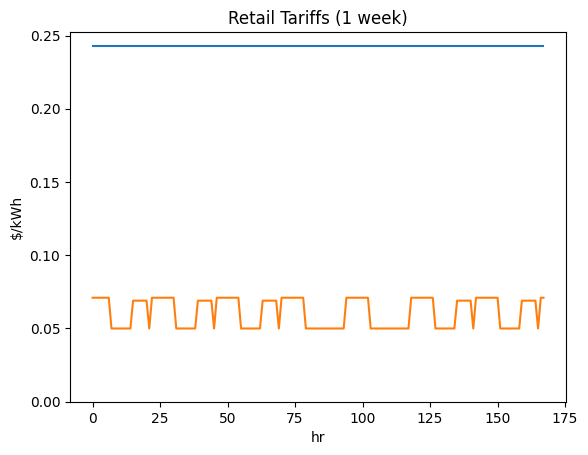

---- Optimising with PV: 1 - 20 kWp, Batt: 0 kWh. Determining PV capacity and dispatch.


************************************ Modell: PV > 1 kWp & BATT > 1 kWh ************************************
{'financial_horizon': 10, 'discount_rate': np.float64(0.06), 'grid_feedin_max': np.float64(5.0), 'pv_eol_capacity': np.float64(0.8), 'pv_eol_years': np.float64(25.0), 'pv_init_soh': np.float64(1.0), 'bess_e2p_ratio': np.float64(2.4), 'bess_roundtrip_eff': np.float64(0.88), 'bess_eol_years': np.float64(10.0), 'bess_eol_capacity': np.float64(0.7), 'bess_eol_cycles': np.float64(10000.0), 'bess_init_soh': np.float64(1.0), 'bess_eff_charge': np.float64(0.938083151964686), 'bess_eff_discharge': np.float64(0.938083151964686), 'scenario_name': 'Scenario_D_+5', 'scenario_set': 'SurfCoast', 'scenario_subset': 'JJP_open', 'year_start': 2022, 'datetime_name': 'DateTime1', 'meter_name': 'pc3081_nmi4097641519', 'solar_name': 'MELB', 'tariff_name_import_wkday': '3_Im_wkday', 'tariff_name_export_wkday': '3_

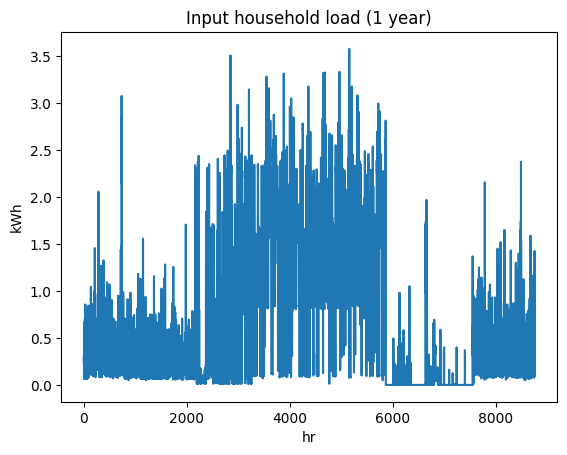

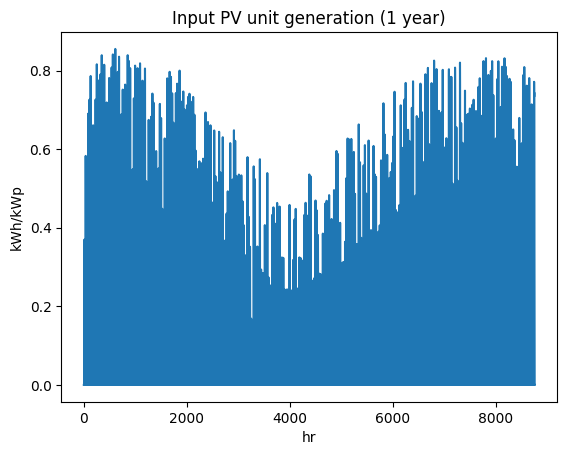

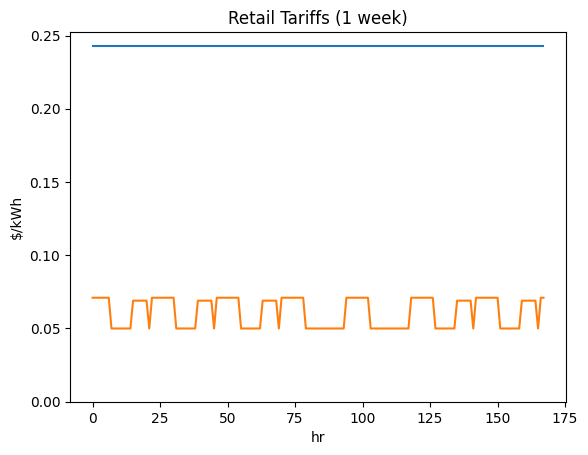

---- Optimising with PV: 1 - 20 kWp, Batt: 0 kWh. Determining PV capacity and dispatch.


************************************ Modell: PV > 1 kWp & BATT > 1 kWh ************************************
{'financial_horizon': 10, 'discount_rate': np.float64(0.06), 'grid_feedin_max': np.float64(5.0), 'pv_eol_capacity': np.float64(0.8), 'pv_eol_years': np.float64(25.0), 'pv_init_soh': np.float64(1.0), 'bess_e2p_ratio': np.float64(2.4), 'bess_roundtrip_eff': np.float64(0.88), 'bess_eol_years': np.float64(10.0), 'bess_eol_capacity': np.float64(0.7), 'bess_eol_cycles': np.float64(10000.0), 'bess_init_soh': np.float64(1.0), 'bess_eff_charge': np.float64(0.938083151964686), 'bess_eff_discharge': np.float64(0.938083151964686), 'scenario_name': 'Scenario_D_+5', 'scenario_set': 'SurfCoast', 'scenario_subset': 'JJP_open', 'year_start': 2022, 'datetime_name': 'DateTime1', 'meter_name': 'pc3081_nmi6340511148', 'solar_name': 'MELB', 'tariff_name_import_wkday': '3_Im_wkday', 'tariff_name_export_wkday': '3_

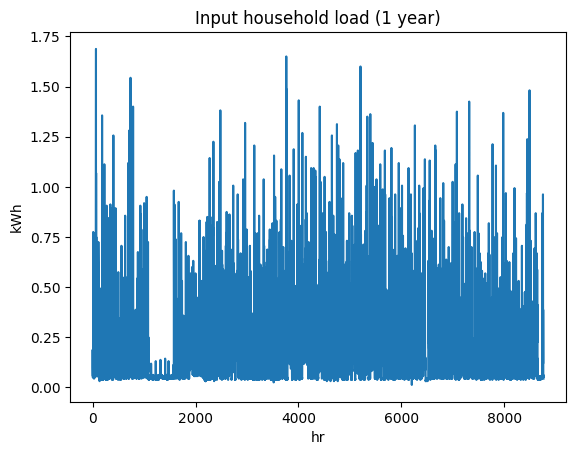

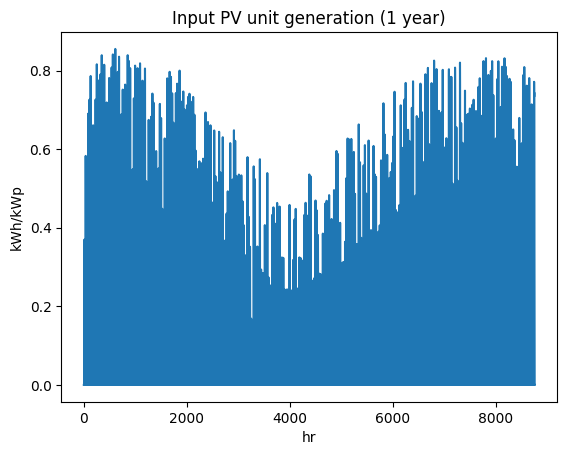

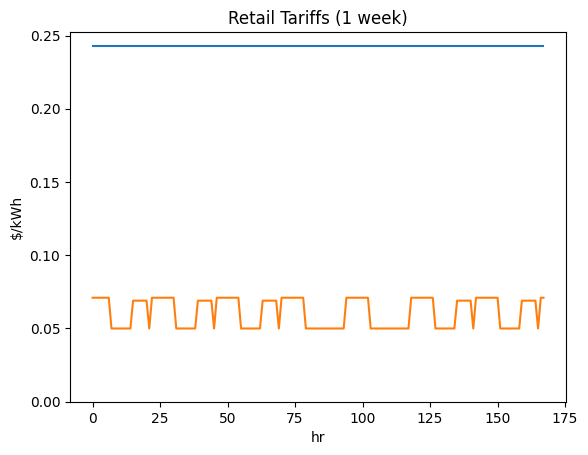

---- Optimising with PV: 1 - 20 kWp, Batt: 0 kWh. Determining PV capacity and dispatch.


************************************ Modell: PV > 1 kWp & BATT > 1 kWh ************************************
{'financial_horizon': 10, 'discount_rate': np.float64(0.06), 'grid_feedin_max': np.float64(5.0), 'pv_eol_capacity': np.float64(0.8), 'pv_eol_years': np.float64(25.0), 'pv_init_soh': np.float64(1.0), 'bess_e2p_ratio': np.float64(2.4), 'bess_roundtrip_eff': np.float64(0.88), 'bess_eol_years': np.float64(10.0), 'bess_eol_capacity': np.float64(0.7), 'bess_eol_cycles': np.float64(10000.0), 'bess_init_soh': np.float64(1.0), 'bess_eff_charge': np.float64(0.938083151964686), 'bess_eff_discharge': np.float64(0.938083151964686), 'scenario_name': 'Scenario_D_+5', 'scenario_set': 'SurfCoast', 'scenario_subset': 'JJP_open', 'year_start': 2022, 'datetime_name': 'DateTime1', 'meter_name': 'pc3081_nmi9599332384', 'solar_name': 'MELB', 'tariff_name_import_wkday': '3_Im_wkday', 'tariff_name_export_wkday': '3_

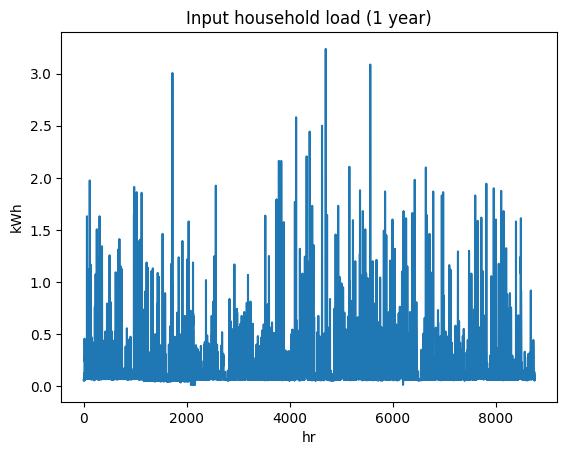

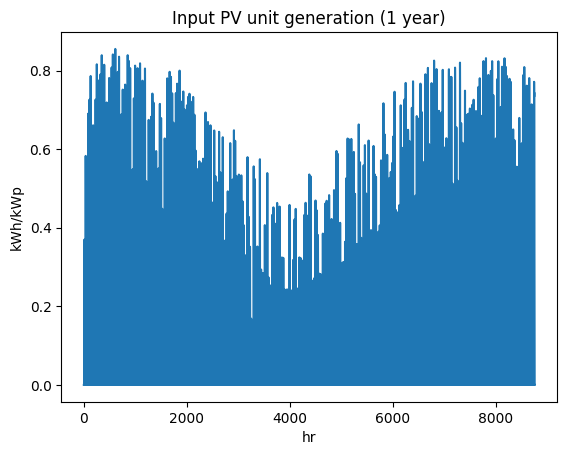

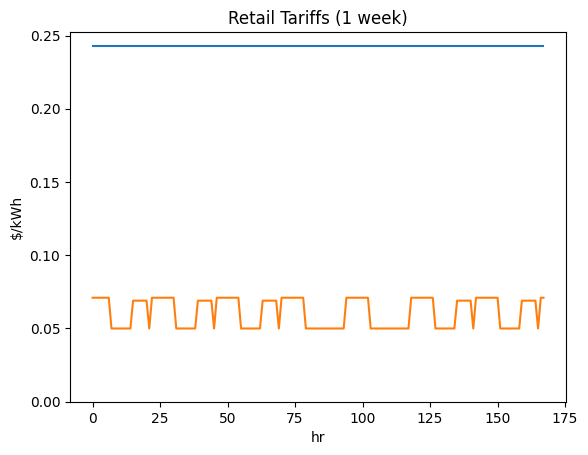

---- Optimising with PV: 1 - 20 kWp, Batt: 0 kWh. Determining PV capacity and dispatch.


************************************ Modell: PV > 1 kWp & BATT > 1 kWh ************************************
{'financial_horizon': 10, 'discount_rate': np.float64(0.06), 'grid_feedin_max': np.float64(5.0), 'pv_eol_capacity': np.float64(0.8), 'pv_eol_years': np.float64(25.0), 'pv_init_soh': np.float64(1.0), 'bess_e2p_ratio': np.float64(2.4), 'bess_roundtrip_eff': np.float64(0.88), 'bess_eol_years': np.float64(10.0), 'bess_eol_capacity': np.float64(0.7), 'bess_eol_cycles': np.float64(10000.0), 'bess_init_soh': np.float64(1.0), 'bess_eff_charge': np.float64(0.938083151964686), 'bess_eff_discharge': np.float64(0.938083151964686), 'scenario_name': 'Scenario_D_+5', 'scenario_set': 'SurfCoast', 'scenario_subset': 'JJP_open', 'year_start': 2022, 'datetime_name': 'DateTime1', 'meter_name': 'pc3081_nmi8449371785', 'solar_name': 'MELB', 'tariff_name_import_wkday': '3_Im_wkday', 'tariff_name_export_wkday': '3_

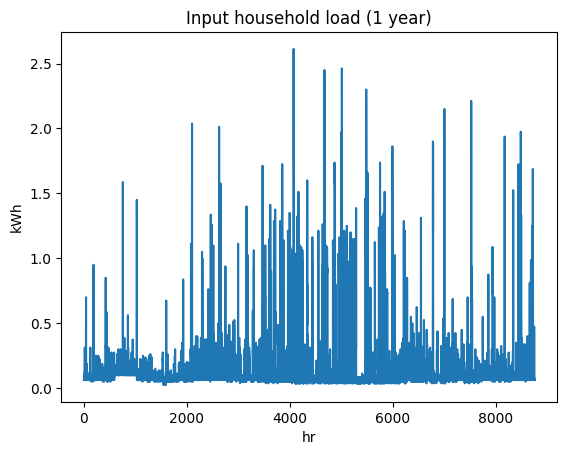

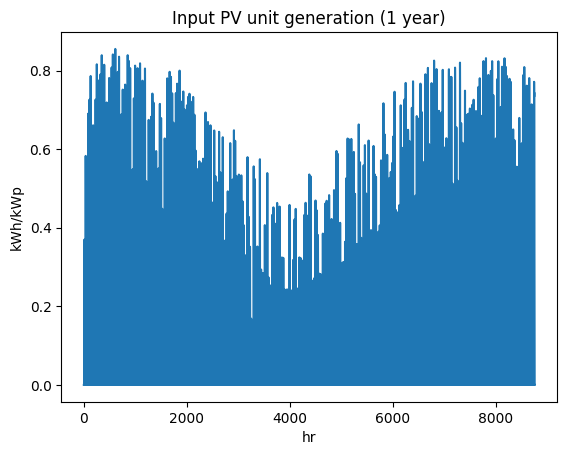

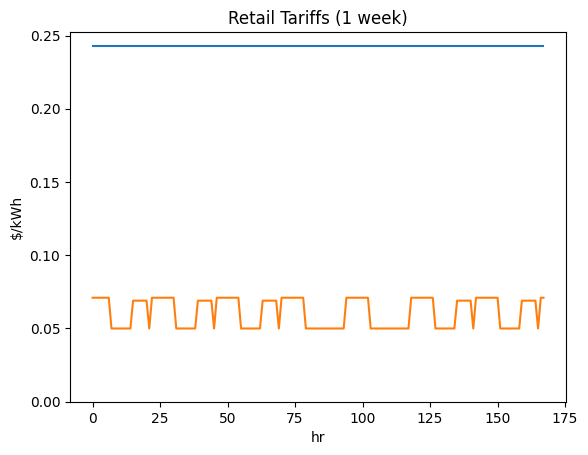

---- Optimising with PV: 1 - 20 kWp, Batt: 0 kWh. Determining PV capacity and dispatch.


************************************ Modell: PV > 1 kWp & BATT > 1 kWh ************************************
{'financial_horizon': 10, 'discount_rate': np.float64(0.06), 'grid_feedin_max': np.float64(5.0), 'pv_eol_capacity': np.float64(0.8), 'pv_eol_years': np.float64(25.0), 'pv_init_soh': np.float64(1.0), 'bess_e2p_ratio': np.float64(2.4), 'bess_roundtrip_eff': np.float64(0.88), 'bess_eol_years': np.float64(10.0), 'bess_eol_capacity': np.float64(0.7), 'bess_eol_cycles': np.float64(10000.0), 'bess_init_soh': np.float64(1.0), 'bess_eff_charge': np.float64(0.938083151964686), 'bess_eff_discharge': np.float64(0.938083151964686), 'scenario_name': 'Scenario_D_+5', 'scenario_set': 'SurfCoast', 'scenario_subset': 'JJP_open', 'year_start': 2022, 'datetime_name': 'DateTime1', 'meter_name': 'pc3084_nmi1723728531', 'solar_name': 'MELB', 'tariff_name_import_wkday': '3_Im_wkday', 'tariff_name_export_wkday': '3_

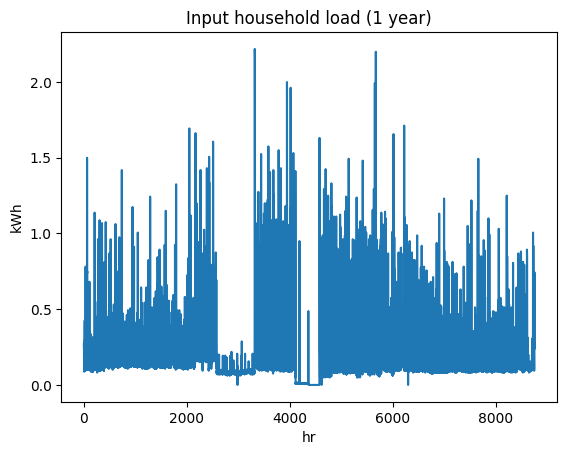

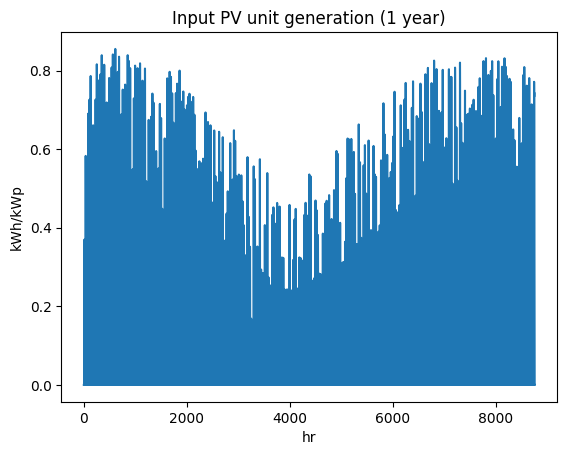

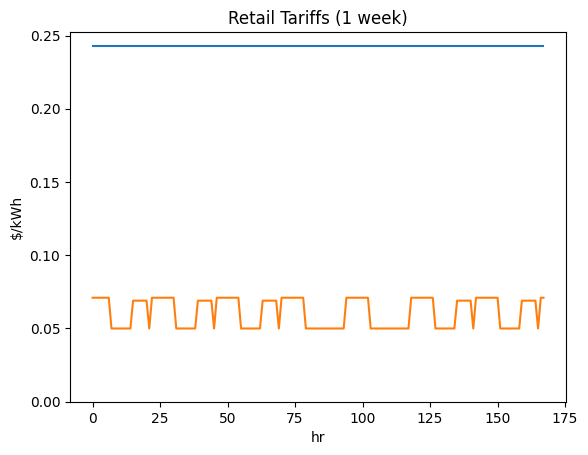

---- Optimising with PV: 1 - 20 kWp, Batt: 0 kWh. Determining PV capacity and dispatch.


************************************ Modell: PV > 1 kWp & BATT > 1 kWh ************************************
{'financial_horizon': 10, 'discount_rate': np.float64(0.06), 'grid_feedin_max': np.float64(5.0), 'pv_eol_capacity': np.float64(0.8), 'pv_eol_years': np.float64(25.0), 'pv_init_soh': np.float64(1.0), 'bess_e2p_ratio': np.float64(2.4), 'bess_roundtrip_eff': np.float64(0.88), 'bess_eol_years': np.float64(10.0), 'bess_eol_capacity': np.float64(0.7), 'bess_eol_cycles': np.float64(10000.0), 'bess_init_soh': np.float64(1.0), 'bess_eff_charge': np.float64(0.938083151964686), 'bess_eff_discharge': np.float64(0.938083151964686), 'scenario_name': 'Scenario_D_+5', 'scenario_set': 'SurfCoast', 'scenario_subset': 'JJP_open', 'year_start': 2022, 'datetime_name': 'DateTime1', 'meter_name': 'pc3084_nmi1799330995', 'solar_name': 'MELB', 'tariff_name_import_wkday': '3_Im_wkday', 'tariff_name_export_wkday': '3_

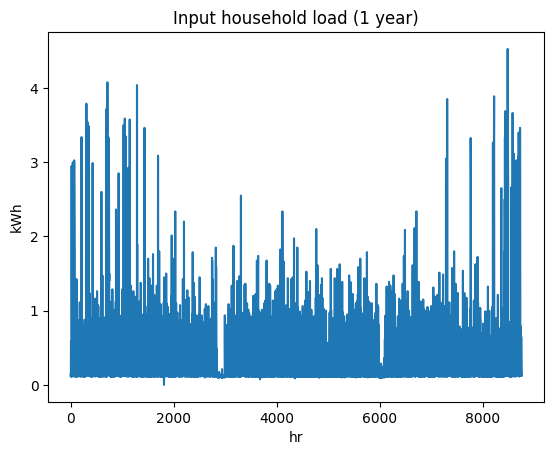

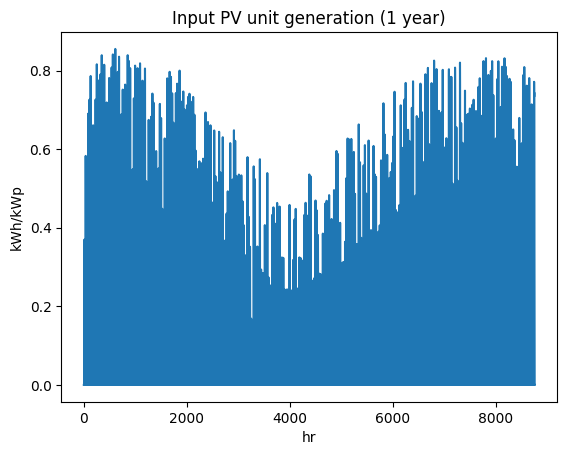

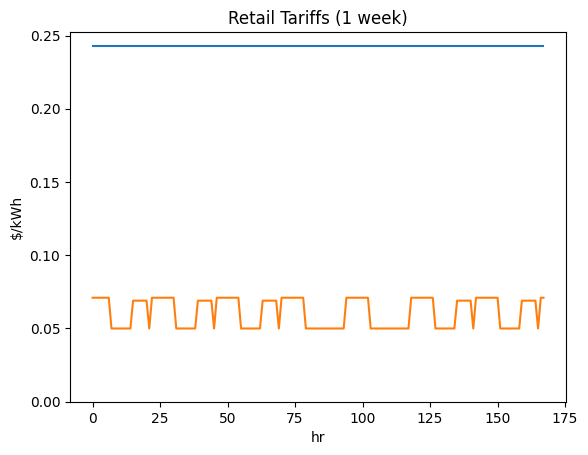

---- Optimising with PV: 1 - 20 kWp, Batt: 0 kWh. Determining PV capacity and dispatch.


************************************ Modell: PV > 1 kWp & BATT > 1 kWh ************************************
{'financial_horizon': 10, 'discount_rate': np.float64(0.06), 'grid_feedin_max': np.float64(5.0), 'pv_eol_capacity': np.float64(0.8), 'pv_eol_years': np.float64(25.0), 'pv_init_soh': np.float64(1.0), 'bess_e2p_ratio': np.float64(2.4), 'bess_roundtrip_eff': np.float64(0.88), 'bess_eol_years': np.float64(10.0), 'bess_eol_capacity': np.float64(0.7), 'bess_eol_cycles': np.float64(10000.0), 'bess_init_soh': np.float64(1.0), 'bess_eff_charge': np.float64(0.938083151964686), 'bess_eff_discharge': np.float64(0.938083151964686), 'scenario_name': 'Scenario_D_+5', 'scenario_set': 'SurfCoast', 'scenario_subset': 'JJP_open', 'year_start': 2022, 'datetime_name': 'DateTime1', 'meter_name': 'pc3084_nmi2621894180', 'solar_name': 'MELB', 'tariff_name_import_wkday': '3_Im_wkday', 'tariff_name_export_wkday': '3_

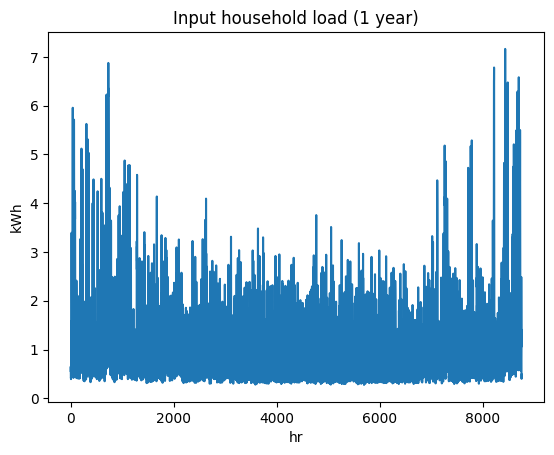

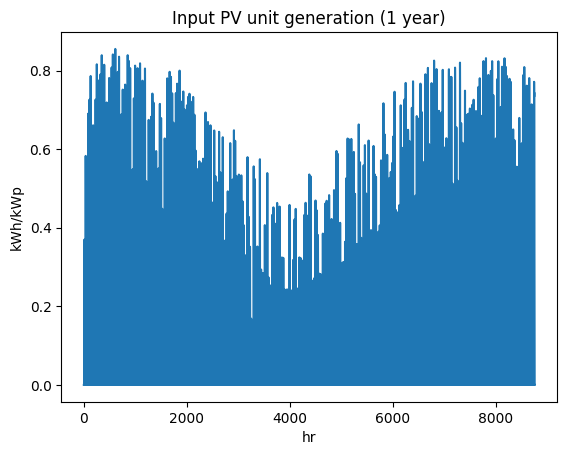

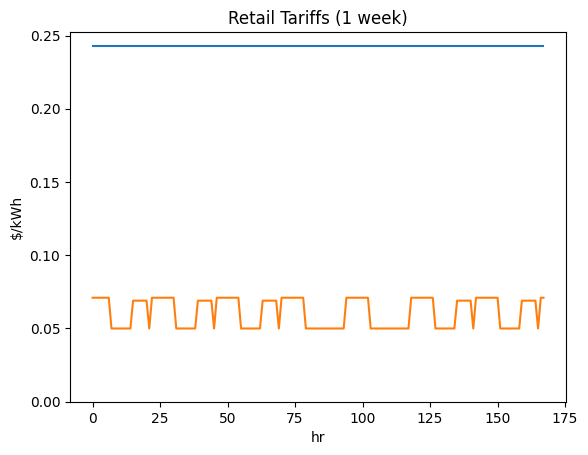

---- Optimising with PV: 1 - 20 kWp, Batt: 0 kWh. Determining PV capacity and dispatch.


************************************ Modell: PV > 1 kWp & BATT > 1 kWh ************************************
{'financial_horizon': 10, 'discount_rate': np.float64(0.06), 'grid_feedin_max': np.float64(5.0), 'pv_eol_capacity': np.float64(0.8), 'pv_eol_years': np.float64(25.0), 'pv_init_soh': np.float64(1.0), 'bess_e2p_ratio': np.float64(2.4), 'bess_roundtrip_eff': np.float64(0.88), 'bess_eol_years': np.float64(10.0), 'bess_eol_capacity': np.float64(0.7), 'bess_eol_cycles': np.float64(10000.0), 'bess_init_soh': np.float64(1.0), 'bess_eff_charge': np.float64(0.938083151964686), 'bess_eff_discharge': np.float64(0.938083151964686), 'scenario_name': 'Scenario_D_+5', 'scenario_set': 'SurfCoast', 'scenario_subset': 'JJP_open', 'year_start': 2022, 'datetime_name': 'DateTime1', 'meter_name': 'pc3084_nmi5836497137', 'solar_name': 'MELB', 'tariff_name_import_wkday': '3_Im_wkday', 'tariff_name_export_wkday': '3_

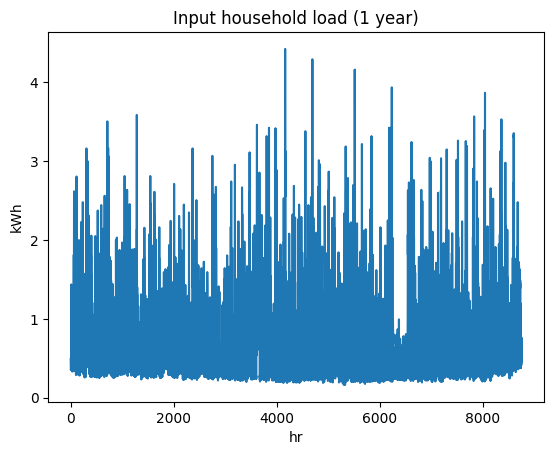

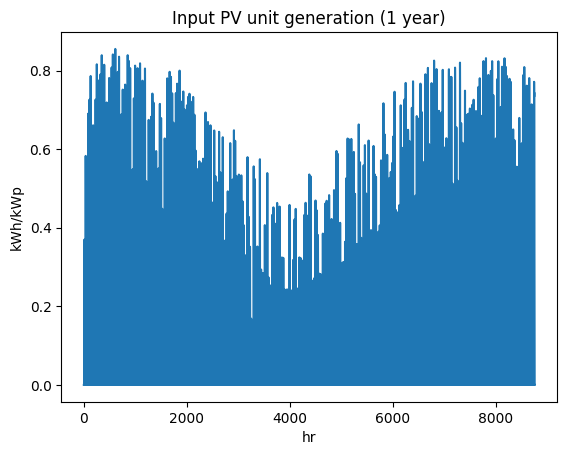

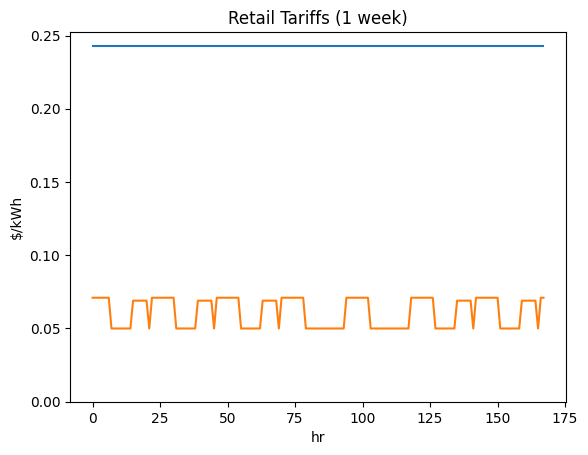

---- Optimising with PV: 1 - 20 kWp, Batt: 0 kWh. Determining PV capacity and dispatch.


************************************ Modell: PV > 1 kWp & BATT > 1 kWh ************************************
{'financial_horizon': 10, 'discount_rate': np.float64(0.06), 'grid_feedin_max': np.float64(5.0), 'pv_eol_capacity': np.float64(0.8), 'pv_eol_years': np.float64(25.0), 'pv_init_soh': np.float64(1.0), 'bess_e2p_ratio': np.float64(2.4), 'bess_roundtrip_eff': np.float64(0.88), 'bess_eol_years': np.float64(10.0), 'bess_eol_capacity': np.float64(0.7), 'bess_eol_cycles': np.float64(10000.0), 'bess_init_soh': np.float64(1.0), 'bess_eff_charge': np.float64(0.938083151964686), 'bess_eff_discharge': np.float64(0.938083151964686), 'scenario_name': 'Scenario_D_+5', 'scenario_set': 'SurfCoast', 'scenario_subset': 'JJP_open', 'year_start': 2022, 'datetime_name': 'DateTime1', 'meter_name': 'pc3084_nmi6121778007', 'solar_name': 'MELB', 'tariff_name_import_wkday': '3_Im_wkday', 'tariff_name_export_wkday': '3_

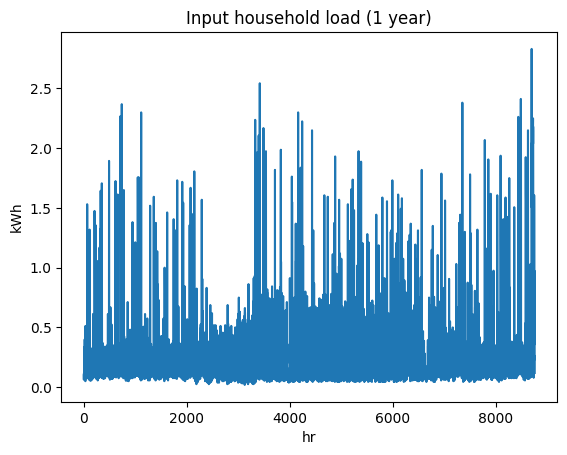

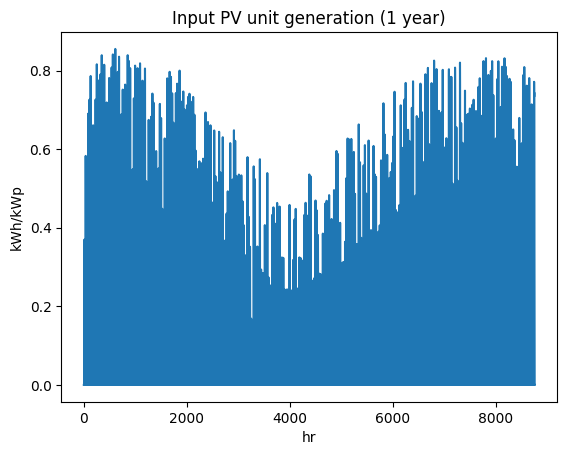

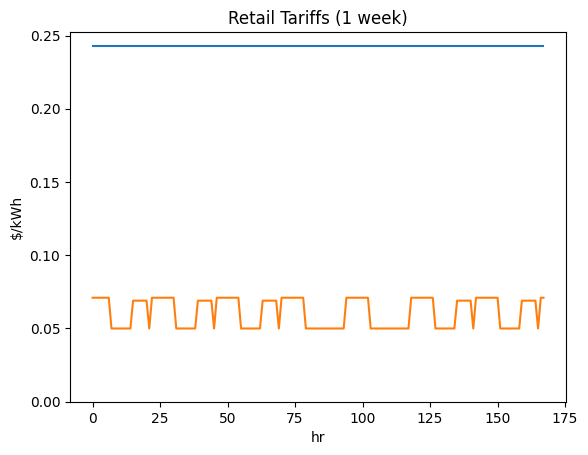

---- Optimising with PV: 1 - 20 kWp, Batt: 0 kWh. Determining PV capacity and dispatch.


************************************ Modell: PV > 1 kWp & BATT > 1 kWh ************************************
{'financial_horizon': 10, 'discount_rate': np.float64(0.06), 'grid_feedin_max': np.float64(5.0), 'pv_eol_capacity': np.float64(0.8), 'pv_eol_years': np.float64(25.0), 'pv_init_soh': np.float64(1.0), 'bess_e2p_ratio': np.float64(2.4), 'bess_roundtrip_eff': np.float64(0.88), 'bess_eol_years': np.float64(10.0), 'bess_eol_capacity': np.float64(0.7), 'bess_eol_cycles': np.float64(10000.0), 'bess_init_soh': np.float64(1.0), 'bess_eff_charge': np.float64(0.938083151964686), 'bess_eff_discharge': np.float64(0.938083151964686), 'scenario_name': 'Scenario_D_+5', 'scenario_set': 'SurfCoast', 'scenario_subset': 'JJP_open', 'year_start': 2022, 'datetime_name': 'DateTime1', 'meter_name': 'pc3084_nmi5385997244', 'solar_name': 'MELB', 'tariff_name_import_wkday': '3_Im_wkday', 'tariff_name_export_wkday': '3_

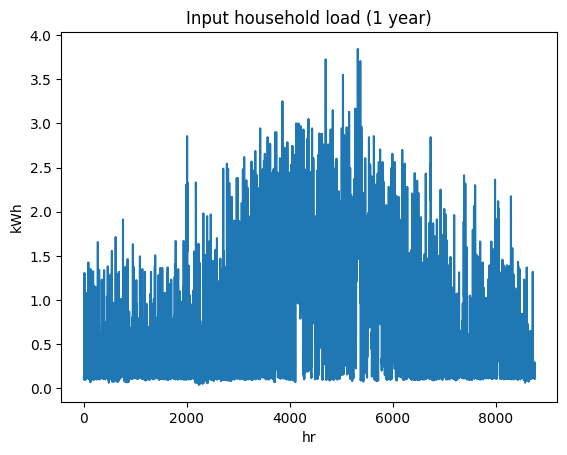

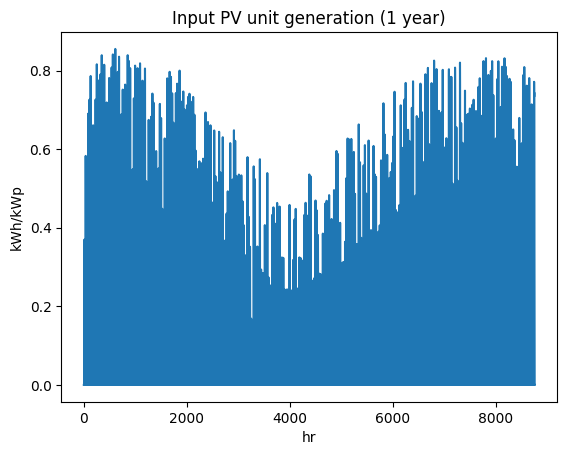

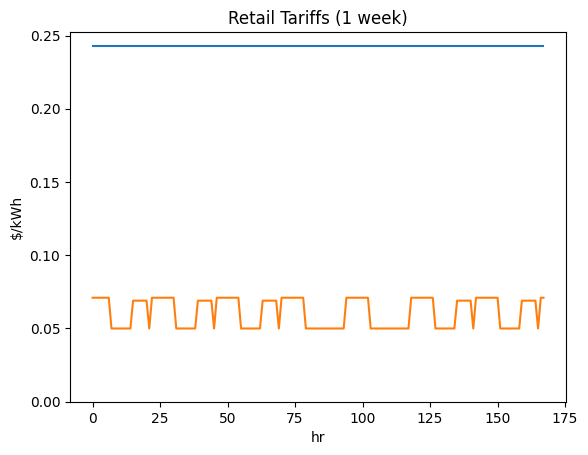

---- Optimising with PV: 1 - 20 kWp, Batt: 0 kWh. Determining PV capacity and dispatch.


************************************ Modell: PV > 1 kWp & BATT > 1 kWh ************************************
{'financial_horizon': 10, 'discount_rate': np.float64(0.06), 'grid_feedin_max': np.float64(5.0), 'pv_eol_capacity': np.float64(0.8), 'pv_eol_years': np.float64(25.0), 'pv_init_soh': np.float64(1.0), 'bess_e2p_ratio': np.float64(2.4), 'bess_roundtrip_eff': np.float64(0.88), 'bess_eol_years': np.float64(10.0), 'bess_eol_capacity': np.float64(0.7), 'bess_eol_cycles': np.float64(10000.0), 'bess_init_soh': np.float64(1.0), 'bess_eff_charge': np.float64(0.938083151964686), 'bess_eff_discharge': np.float64(0.938083151964686), 'scenario_name': 'Scenario_D_+5', 'scenario_set': 'SurfCoast', 'scenario_subset': 'JJP_open', 'year_start': 2022, 'datetime_name': 'DateTime1', 'meter_name': 'pc3084_nmi2747384205', 'solar_name': 'MELB', 'tariff_name_import_wkday': '3_Im_wkday', 'tariff_name_export_wkday': '3_

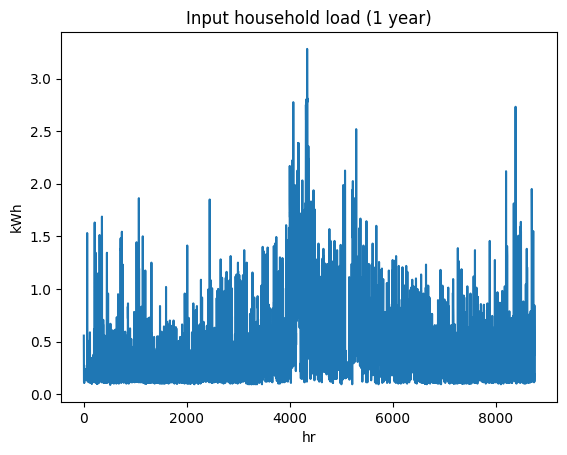

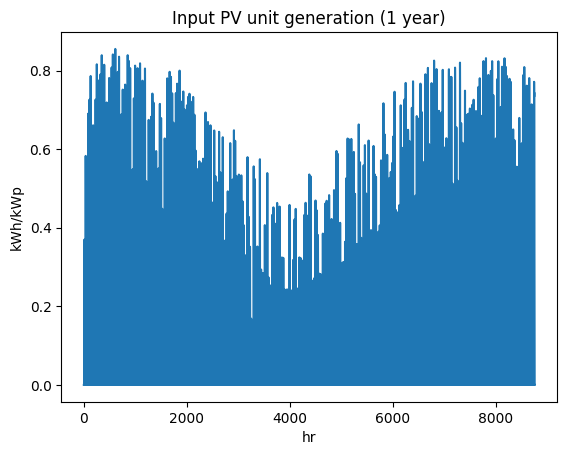

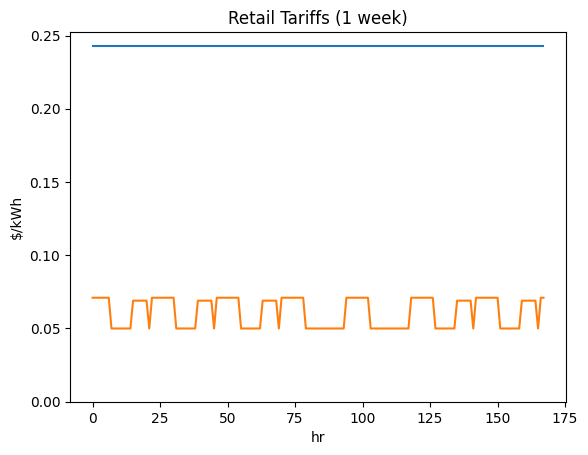

---- Optimising with PV: 1 - 20 kWp, Batt: 0 kWh. Determining PV capacity and dispatch.


************************************ Modell: PV > 1 kWp & BATT > 1 kWh ************************************
{'financial_horizon': 10, 'discount_rate': np.float64(0.06), 'grid_feedin_max': np.float64(5.0), 'pv_eol_capacity': np.float64(0.8), 'pv_eol_years': np.float64(25.0), 'pv_init_soh': np.float64(1.0), 'bess_e2p_ratio': np.float64(2.4), 'bess_roundtrip_eff': np.float64(0.88), 'bess_eol_years': np.float64(10.0), 'bess_eol_capacity': np.float64(0.7), 'bess_eol_cycles': np.float64(10000.0), 'bess_init_soh': np.float64(1.0), 'bess_eff_charge': np.float64(0.938083151964686), 'bess_eff_discharge': np.float64(0.938083151964686), 'scenario_name': 'Scenario_D_+5', 'scenario_set': 'SurfCoast', 'scenario_subset': 'JJP_open', 'year_start': 2022, 'datetime_name': 'DateTime1', 'meter_name': 'pc3084_nmi8382764923', 'solar_name': 'MELB', 'tariff_name_import_wkday': '3_Im_wkday', 'tariff_name_export_wkday': '3_

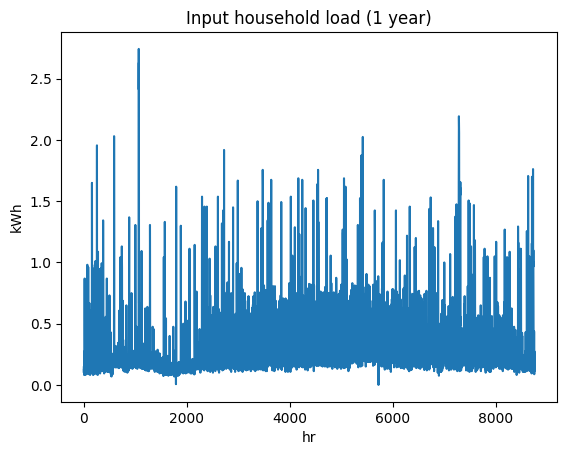

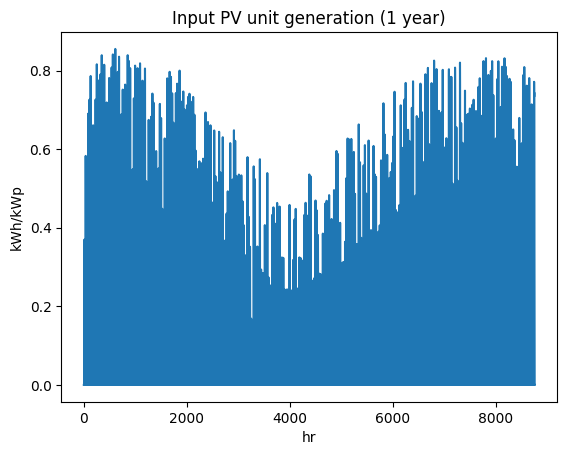

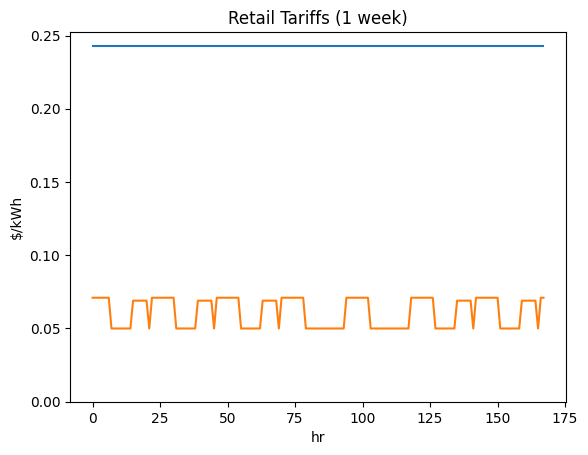

---- Optimising with PV: 1 - 20 kWp, Batt: 0 kWh. Determining PV capacity and dispatch.


************************************ Modell: PV > 1 kWp & BATT > 1 kWh ************************************
{'financial_horizon': 10, 'discount_rate': np.float64(0.06), 'grid_feedin_max': np.float64(5.0), 'pv_eol_capacity': np.float64(0.8), 'pv_eol_years': np.float64(25.0), 'pv_init_soh': np.float64(1.0), 'bess_e2p_ratio': np.float64(2.4), 'bess_roundtrip_eff': np.float64(0.88), 'bess_eol_years': np.float64(10.0), 'bess_eol_capacity': np.float64(0.7), 'bess_eol_cycles': np.float64(10000.0), 'bess_init_soh': np.float64(1.0), 'bess_eff_charge': np.float64(0.938083151964686), 'bess_eff_discharge': np.float64(0.938083151964686), 'scenario_name': 'Scenario_D_+5', 'scenario_set': 'SurfCoast', 'scenario_subset': 'JJP_open', 'year_start': 2022, 'datetime_name': 'DateTime1', 'meter_name': 'pc3084_nmi5234260679', 'solar_name': 'MELB', 'tariff_name_import_wkday': '3_Im_wkday', 'tariff_name_export_wkday': '3_

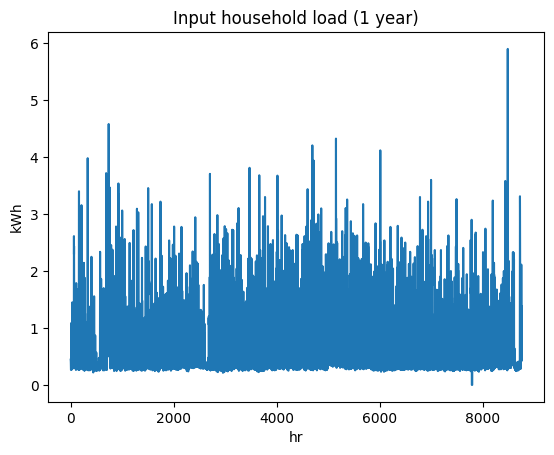

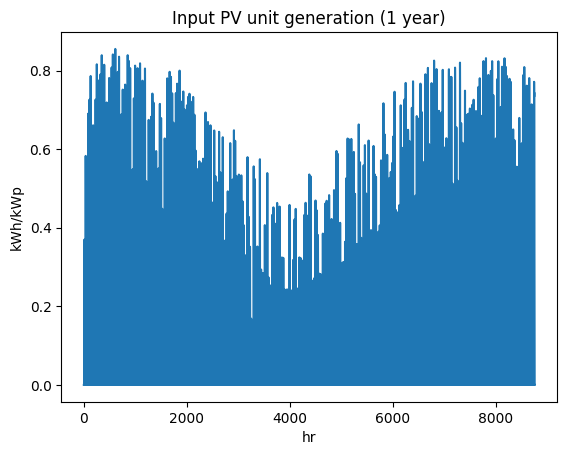

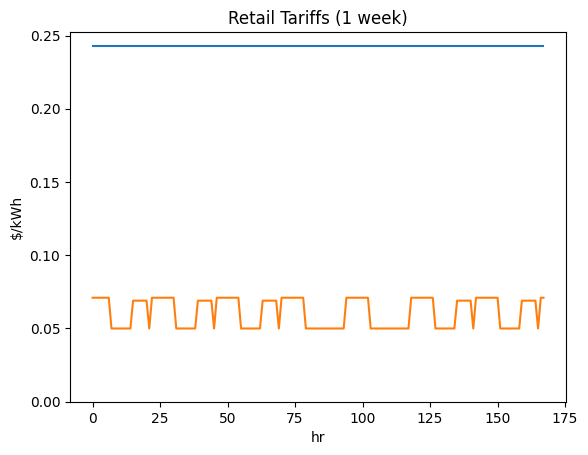

---- Optimising with PV: 1 - 20 kWp, Batt: 0 kWh. Determining PV capacity and dispatch.


************************************ Modell: PV > 1 kWp & BATT > 1 kWh ************************************
{'financial_horizon': 10, 'discount_rate': np.float64(0.06), 'grid_feedin_max': np.float64(5.0), 'pv_eol_capacity': np.float64(0.8), 'pv_eol_years': np.float64(25.0), 'pv_init_soh': np.float64(1.0), 'bess_e2p_ratio': np.float64(2.4), 'bess_roundtrip_eff': np.float64(0.88), 'bess_eol_years': np.float64(10.0), 'bess_eol_capacity': np.float64(0.7), 'bess_eol_cycles': np.float64(10000.0), 'bess_init_soh': np.float64(1.0), 'bess_eff_charge': np.float64(0.938083151964686), 'bess_eff_discharge': np.float64(0.938083151964686), 'scenario_name': 'Scenario_D_+5', 'scenario_set': 'SurfCoast', 'scenario_subset': 'JJP_open', 'year_start': 2022, 'datetime_name': 'DateTime1', 'meter_name': 'pc3079_nmi6533140478', 'solar_name': 'MELB', 'tariff_name_import_wkday': '3_Im_wkday', 'tariff_name_export_wkday': '3_

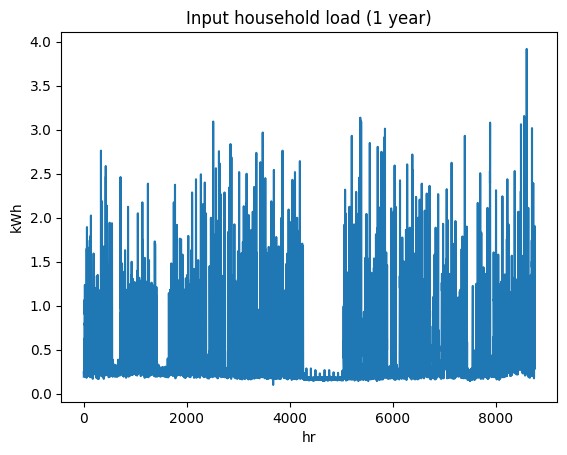

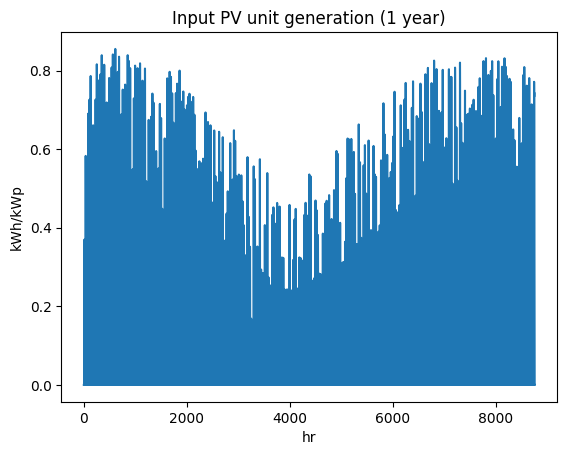

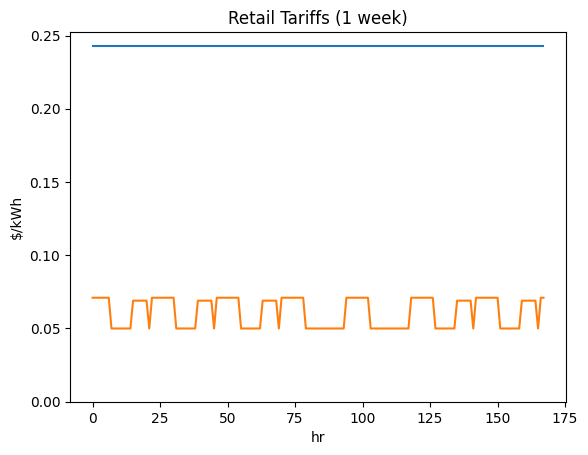

---- Optimising with PV: 1 - 20 kWp, Batt: 0 kWh. Determining PV capacity and dispatch.


************************************ Modell: PV > 1 kWp & BATT > 1 kWh ************************************
{'financial_horizon': 10, 'discount_rate': np.float64(0.06), 'grid_feedin_max': np.float64(5.0), 'pv_eol_capacity': np.float64(0.8), 'pv_eol_years': np.float64(25.0), 'pv_init_soh': np.float64(1.0), 'bess_e2p_ratio': np.float64(2.4), 'bess_roundtrip_eff': np.float64(0.88), 'bess_eol_years': np.float64(10.0), 'bess_eol_capacity': np.float64(0.7), 'bess_eol_cycles': np.float64(10000.0), 'bess_init_soh': np.float64(1.0), 'bess_eff_charge': np.float64(0.938083151964686), 'bess_eff_discharge': np.float64(0.938083151964686), 'scenario_name': 'Scenario_D_+5', 'scenario_set': 'SurfCoast', 'scenario_subset': 'JJP_open', 'year_start': 2022, 'datetime_name': 'DateTime1', 'meter_name': 'pc3084_nmi2676869335', 'solar_name': 'MELB', 'tariff_name_import_wkday': '3_Im_wkday', 'tariff_name_export_wkday': '3_

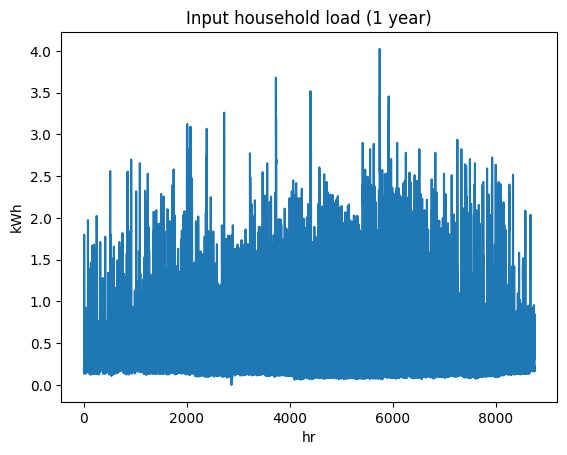

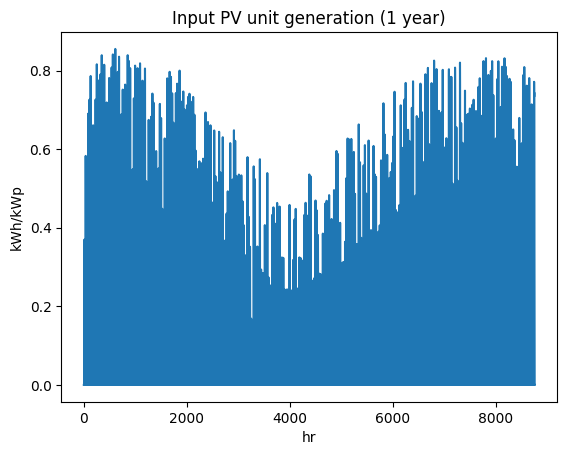

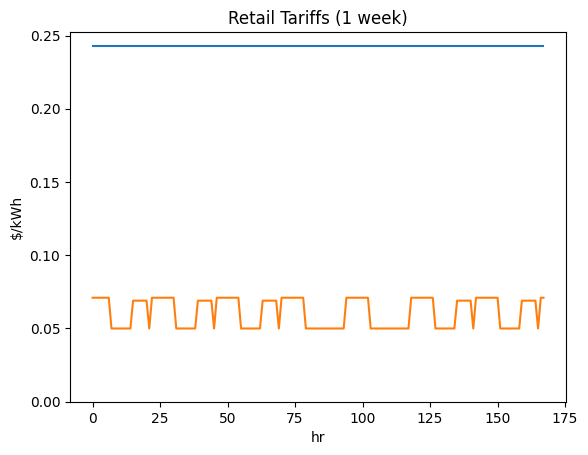

---- Optimising with PV: 1 - 20 kWp, Batt: 0 kWh. Determining PV capacity and dispatch.


************************************ Modell: PV > 1 kWp & BATT > 1 kWh ************************************
{'financial_horizon': 10, 'discount_rate': np.float64(0.06), 'grid_feedin_max': np.float64(5.0), 'pv_eol_capacity': np.float64(0.8), 'pv_eol_years': np.float64(25.0), 'pv_init_soh': np.float64(1.0), 'bess_e2p_ratio': np.float64(2.4), 'bess_roundtrip_eff': np.float64(0.88), 'bess_eol_years': np.float64(10.0), 'bess_eol_capacity': np.float64(0.7), 'bess_eol_cycles': np.float64(10000.0), 'bess_init_soh': np.float64(1.0), 'bess_eff_charge': np.float64(0.938083151964686), 'bess_eff_discharge': np.float64(0.938083151964686), 'scenario_name': 'Scenario_D_+5', 'scenario_set': 'SurfCoast', 'scenario_subset': 'JJP_open', 'year_start': 2022, 'datetime_name': 'DateTime1', 'meter_name': 'pc3081_nmi7620781620', 'solar_name': 'MELB', 'tariff_name_import_wkday': '3_Im_wkday', 'tariff_name_export_wkday': '3_

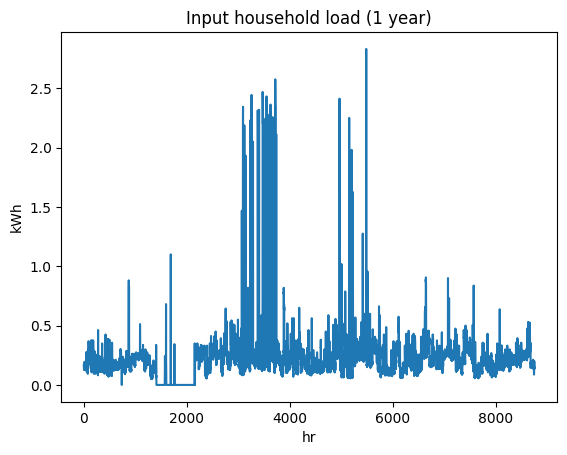

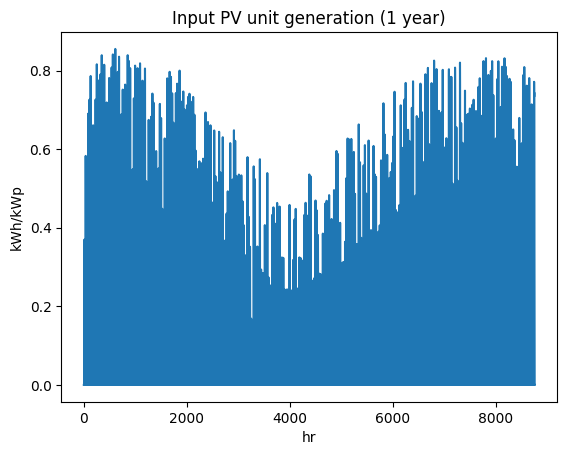

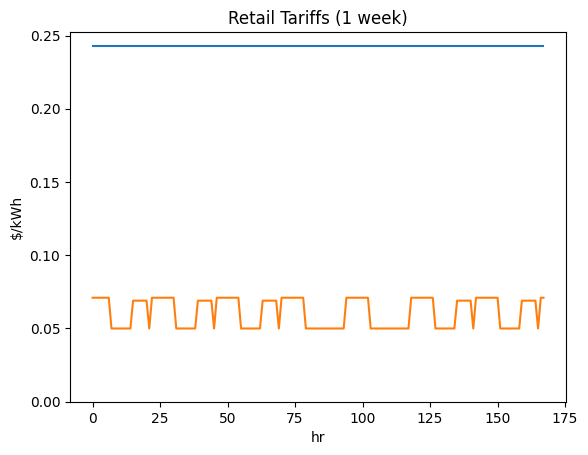

---- Optimising with PV: 1 - 20 kWp, Batt: 0 kWh. Determining PV capacity and dispatch.


************************************ Modell: PV > 1 kWp & BATT > 1 kWh ************************************
{'financial_horizon': 10, 'discount_rate': np.float64(0.06), 'grid_feedin_max': np.float64(5.0), 'pv_eol_capacity': np.float64(0.8), 'pv_eol_years': np.float64(25.0), 'pv_init_soh': np.float64(1.0), 'bess_e2p_ratio': np.float64(2.4), 'bess_roundtrip_eff': np.float64(0.88), 'bess_eol_years': np.float64(10.0), 'bess_eol_capacity': np.float64(0.7), 'bess_eol_cycles': np.float64(10000.0), 'bess_init_soh': np.float64(1.0), 'bess_eff_charge': np.float64(0.938083151964686), 'bess_eff_discharge': np.float64(0.938083151964686), 'scenario_name': 'Scenario_D_+5', 'scenario_set': 'SurfCoast', 'scenario_subset': 'JJP_open', 'year_start': 2022, 'datetime_name': 'DateTime1', 'meter_name': 'pc3072_nmi1205681104', 'solar_name': 'MELB', 'tariff_name_import_wkday': '3_Im_wkday', 'tariff_name_export_wkday': '3_

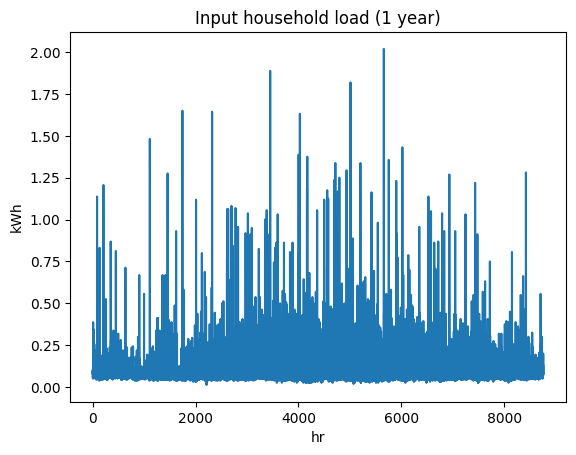

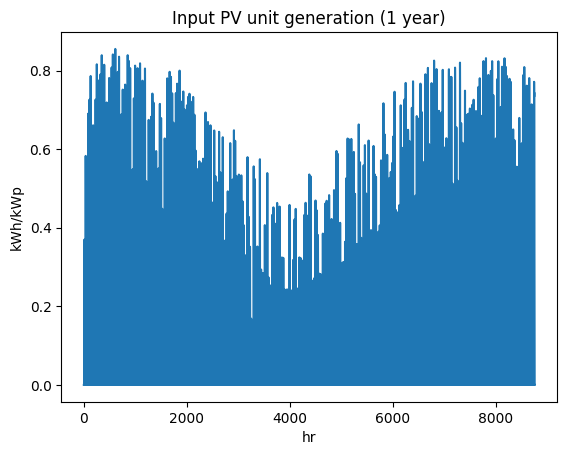

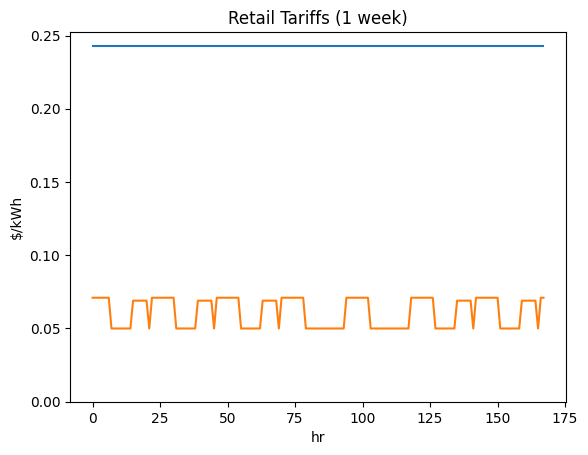

---- Optimising with PV: 1 - 20 kWp, Batt: 0 kWh. Determining PV capacity and dispatch.


************************************ Modell: PV > 1 kWp & BATT > 1 kWh ************************************
{'financial_horizon': 10, 'discount_rate': np.float64(0.06), 'grid_feedin_max': np.float64(5.0), 'pv_eol_capacity': np.float64(0.8), 'pv_eol_years': np.float64(25.0), 'pv_init_soh': np.float64(1.0), 'bess_e2p_ratio': np.float64(2.4), 'bess_roundtrip_eff': np.float64(0.88), 'bess_eol_years': np.float64(10.0), 'bess_eol_capacity': np.float64(0.7), 'bess_eol_cycles': np.float64(10000.0), 'bess_init_soh': np.float64(1.0), 'bess_eff_charge': np.float64(0.938083151964686), 'bess_eff_discharge': np.float64(0.938083151964686), 'scenario_name': 'Scenario_D_+5', 'scenario_set': 'SurfCoast', 'scenario_subset': 'JJP_open', 'year_start': 2022, 'datetime_name': 'DateTime1', 'meter_name': 'pc3072_nmi6726832031', 'solar_name': 'MELB', 'tariff_name_import_wkday': '3_Im_wkday', 'tariff_name_export_wkday': '3_

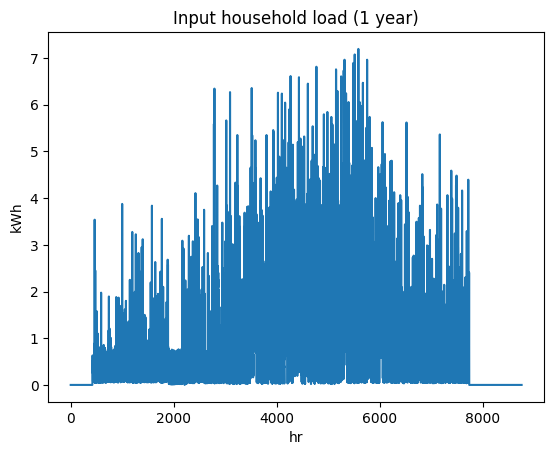

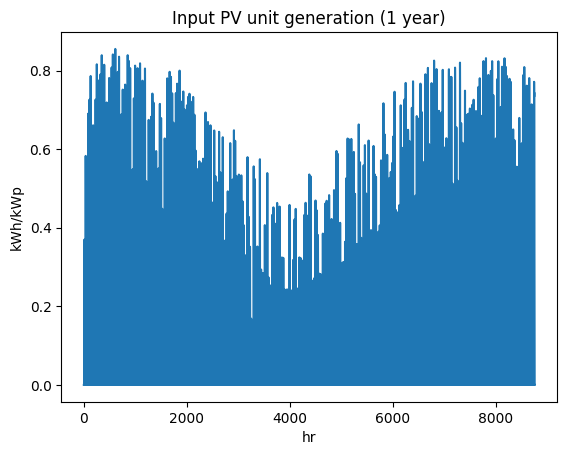

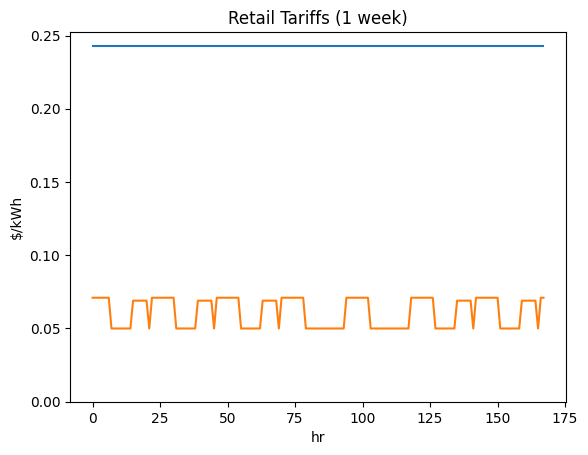

---- Optimising with PV: 1 - 20 kWp, Batt: 0 kWh. Determining PV capacity and dispatch.


************************************ Modell: PV > 1 kWp & BATT > 1 kWh ************************************
{'financial_horizon': 10, 'discount_rate': np.float64(0.06), 'grid_feedin_max': np.float64(5.0), 'pv_eol_capacity': np.float64(0.8), 'pv_eol_years': np.float64(25.0), 'pv_init_soh': np.float64(1.0), 'bess_e2p_ratio': np.float64(2.4), 'bess_roundtrip_eff': np.float64(0.88), 'bess_eol_years': np.float64(10.0), 'bess_eol_capacity': np.float64(0.7), 'bess_eol_cycles': np.float64(10000.0), 'bess_init_soh': np.float64(1.0), 'bess_eff_charge': np.float64(0.938083151964686), 'bess_eff_discharge': np.float64(0.938083151964686), 'scenario_name': 'Scenario_D_+5', 'scenario_set': 'SurfCoast', 'scenario_subset': 'JJP_open', 'year_start': 2022, 'datetime_name': 'DateTime1', 'meter_name': 'pc3072_nmi4710163620', 'solar_name': 'MELB', 'tariff_name_import_wkday': '3_Im_wkday', 'tariff_name_export_wkday': '3_

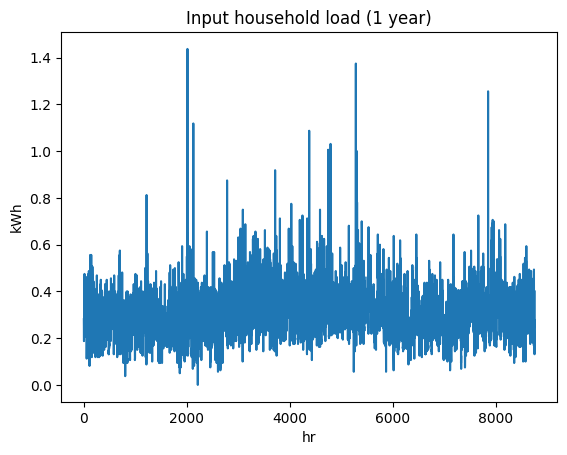

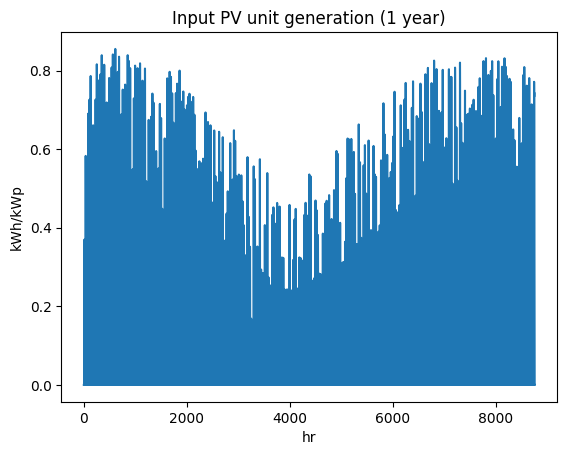

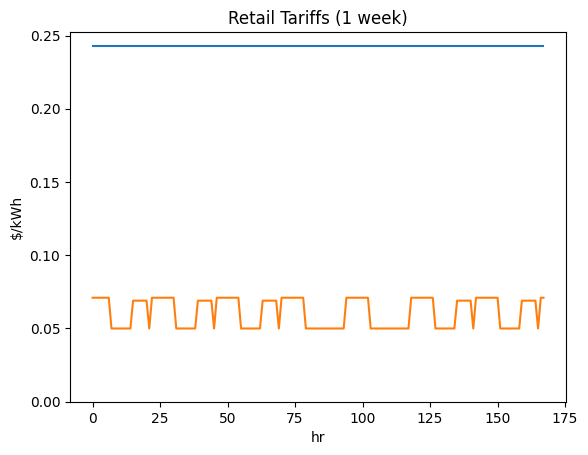

---- Optimising with PV: 1 - 20 kWp, Batt: 0 kWh. Determining PV capacity and dispatch.


************************************ Modell: PV > 1 kWp & BATT > 1 kWh ************************************
{'financial_horizon': 10, 'discount_rate': np.float64(0.06), 'grid_feedin_max': np.float64(5.0), 'pv_eol_capacity': np.float64(0.8), 'pv_eol_years': np.float64(25.0), 'pv_init_soh': np.float64(1.0), 'bess_e2p_ratio': np.float64(2.4), 'bess_roundtrip_eff': np.float64(0.88), 'bess_eol_years': np.float64(10.0), 'bess_eol_capacity': np.float64(0.7), 'bess_eol_cycles': np.float64(10000.0), 'bess_init_soh': np.float64(1.0), 'bess_eff_charge': np.float64(0.938083151964686), 'bess_eff_discharge': np.float64(0.938083151964686), 'scenario_name': 'Scenario_D_+5', 'scenario_set': 'SurfCoast', 'scenario_subset': 'JJP_open', 'year_start': 2022, 'datetime_name': 'DateTime1', 'meter_name': 'pc3072_nmi5733086098', 'solar_name': 'MELB', 'tariff_name_import_wkday': '3_Im_wkday', 'tariff_name_export_wkday': '3_

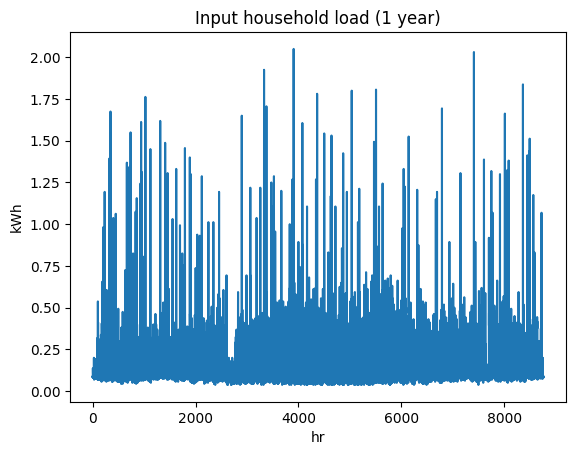

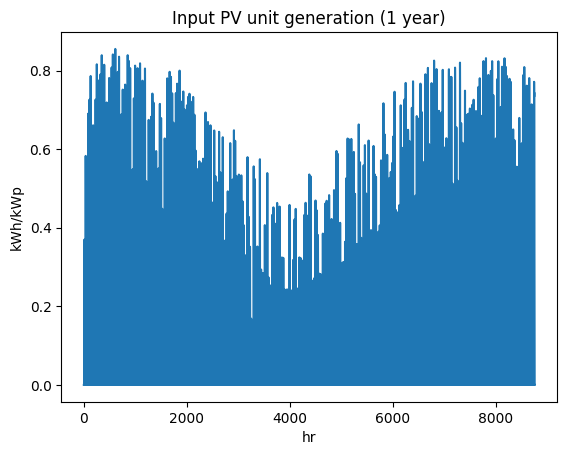

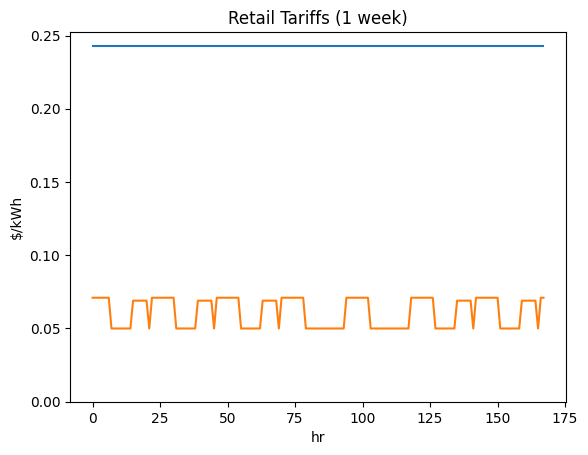

---- Optimising with PV: 1 - 20 kWp, Batt: 0 kWh. Determining PV capacity and dispatch.


************************************ Modell: PV > 1 kWp & BATT > 1 kWh ************************************
{'financial_horizon': 10, 'discount_rate': np.float64(0.06), 'grid_feedin_max': np.float64(5.0), 'pv_eol_capacity': np.float64(0.8), 'pv_eol_years': np.float64(25.0), 'pv_init_soh': np.float64(1.0), 'bess_e2p_ratio': np.float64(2.4), 'bess_roundtrip_eff': np.float64(0.88), 'bess_eol_years': np.float64(10.0), 'bess_eol_capacity': np.float64(0.7), 'bess_eol_cycles': np.float64(10000.0), 'bess_init_soh': np.float64(1.0), 'bess_eff_charge': np.float64(0.938083151964686), 'bess_eff_discharge': np.float64(0.938083151964686), 'scenario_name': 'Scenario_D_+5', 'scenario_set': 'SurfCoast', 'scenario_subset': 'JJP_open', 'year_start': 2022, 'datetime_name': 'DateTime1', 'meter_name': 'pc3072_nmi5380055385', 'solar_name': 'MELB', 'tariff_name_import_wkday': '3_Im_wkday', 'tariff_name_export_wkday': '3_

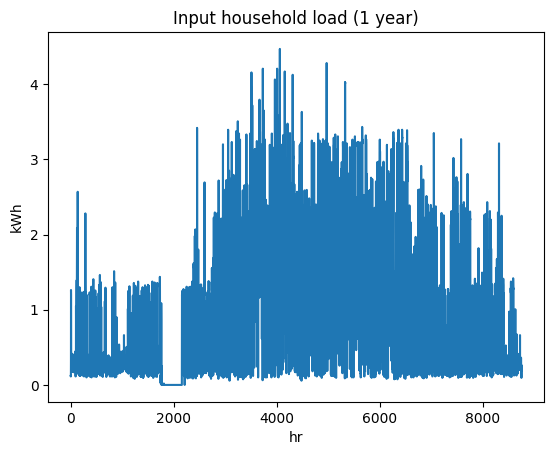

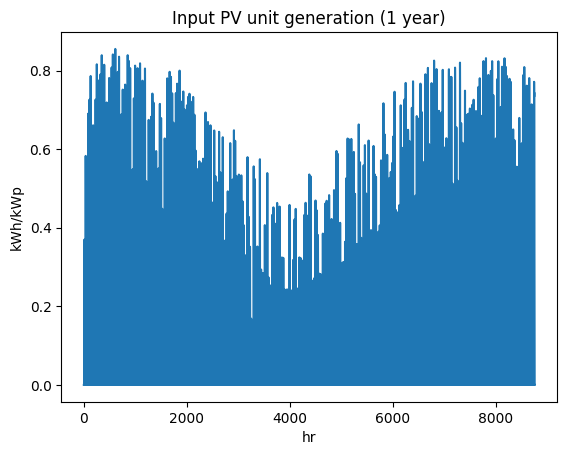

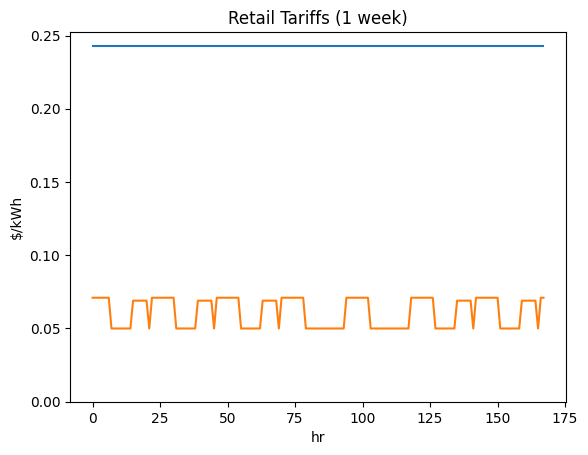

---- Optimising with PV: 1 - 20 kWp, Batt: 0 kWh. Determining PV capacity and dispatch.


************************************ Modell: PV > 1 kWp & BATT > 1 kWh ************************************
{'financial_horizon': 10, 'discount_rate': np.float64(0.06), 'grid_feedin_max': np.float64(5.0), 'pv_eol_capacity': np.float64(0.8), 'pv_eol_years': np.float64(25.0), 'pv_init_soh': np.float64(1.0), 'bess_e2p_ratio': np.float64(2.4), 'bess_roundtrip_eff': np.float64(0.88), 'bess_eol_years': np.float64(10.0), 'bess_eol_capacity': np.float64(0.7), 'bess_eol_cycles': np.float64(10000.0), 'bess_init_soh': np.float64(1.0), 'bess_eff_charge': np.float64(0.938083151964686), 'bess_eff_discharge': np.float64(0.938083151964686), 'scenario_name': 'Scenario_D_+5', 'scenario_set': 'SurfCoast', 'scenario_subset': 'JJP_open', 'year_start': 2022, 'datetime_name': 'DateTime1', 'meter_name': 'pc3072_nmi5102221409', 'solar_name': 'MELB', 'tariff_name_import_wkday': '3_Im_wkday', 'tariff_name_export_wkday': '3_

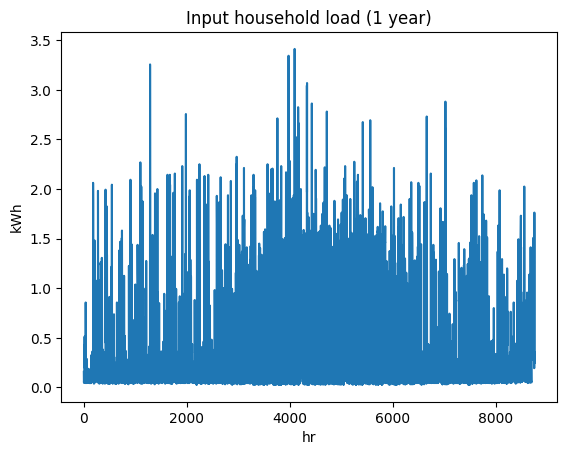

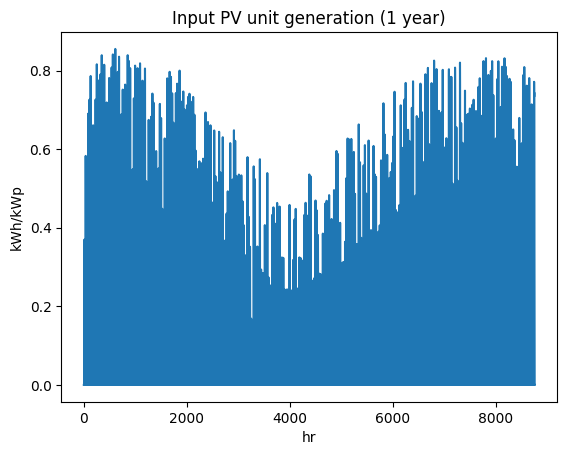

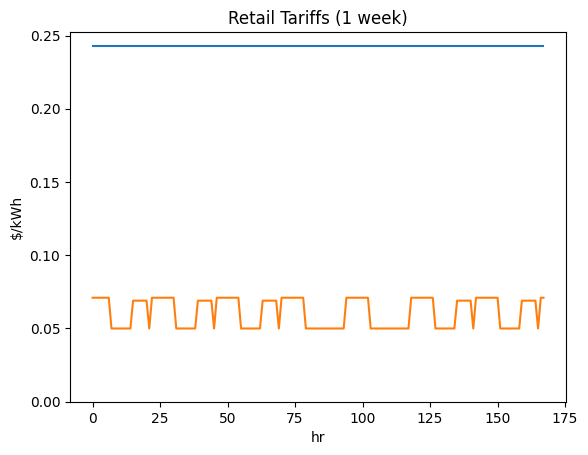

---- Optimising with PV: 1 - 20 kWp, Batt: 0 kWh. Determining PV capacity and dispatch.


************************************ Modell: PV > 1 kWp & BATT > 1 kWh ************************************
{'financial_horizon': 10, 'discount_rate': np.float64(0.06), 'grid_feedin_max': np.float64(5.0), 'pv_eol_capacity': np.float64(0.8), 'pv_eol_years': np.float64(25.0), 'pv_init_soh': np.float64(1.0), 'bess_e2p_ratio': np.float64(2.4), 'bess_roundtrip_eff': np.float64(0.88), 'bess_eol_years': np.float64(10.0), 'bess_eol_capacity': np.float64(0.7), 'bess_eol_cycles': np.float64(10000.0), 'bess_init_soh': np.float64(1.0), 'bess_eff_charge': np.float64(0.938083151964686), 'bess_eff_discharge': np.float64(0.938083151964686), 'scenario_name': 'Scenario_D_+5', 'scenario_set': 'SurfCoast', 'scenario_subset': 'JJP_open', 'year_start': 2022, 'datetime_name': 'DateTime1', 'meter_name': 'pc3072_nmi1461824084', 'solar_name': 'MELB', 'tariff_name_import_wkday': '3_Im_wkday', 'tariff_name_export_wkday': '3_

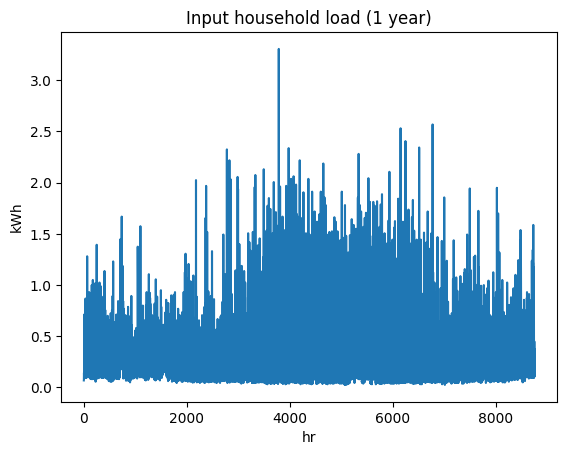

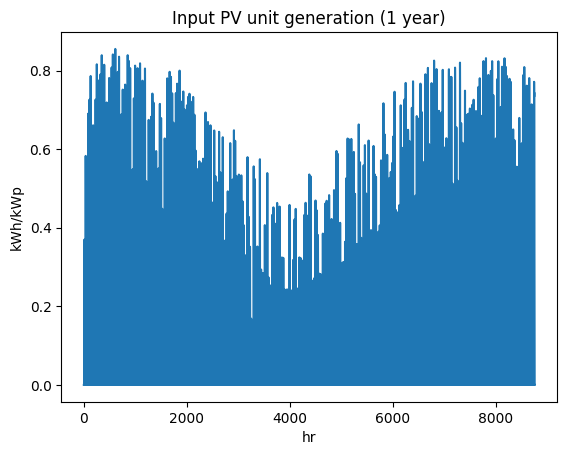

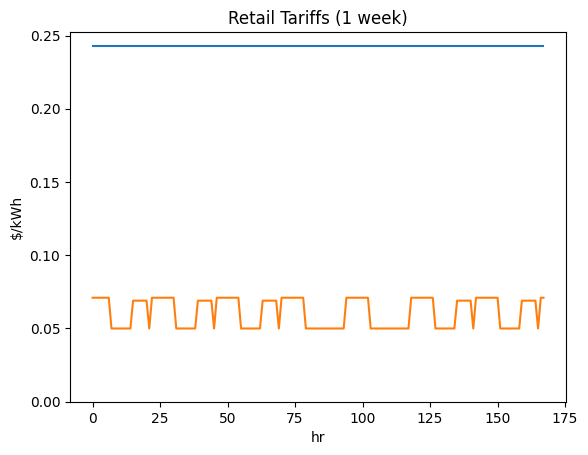

---- Optimising with PV: 1 - 20 kWp, Batt: 0 kWh. Determining PV capacity and dispatch.


************************************ Modell: PV > 1 kWp & BATT > 1 kWh ************************************
{'financial_horizon': 10, 'discount_rate': np.float64(0.06), 'grid_feedin_max': np.float64(5.0), 'pv_eol_capacity': np.float64(0.8), 'pv_eol_years': np.float64(25.0), 'pv_init_soh': np.float64(1.0), 'bess_e2p_ratio': np.float64(2.4), 'bess_roundtrip_eff': np.float64(0.88), 'bess_eol_years': np.float64(10.0), 'bess_eol_capacity': np.float64(0.7), 'bess_eol_cycles': np.float64(10000.0), 'bess_init_soh': np.float64(1.0), 'bess_eff_charge': np.float64(0.938083151964686), 'bess_eff_discharge': np.float64(0.938083151964686), 'scenario_name': 'Scenario_D_+5', 'scenario_set': 'SurfCoast', 'scenario_subset': 'JJP_open', 'year_start': 2022, 'datetime_name': 'DateTime1', 'meter_name': 'pc3072_nmi5164086609', 'solar_name': 'MELB', 'tariff_name_import_wkday': '3_Im_wkday', 'tariff_name_export_wkday': '3_

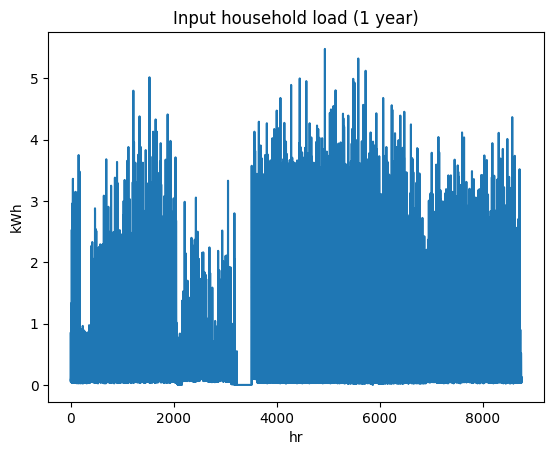

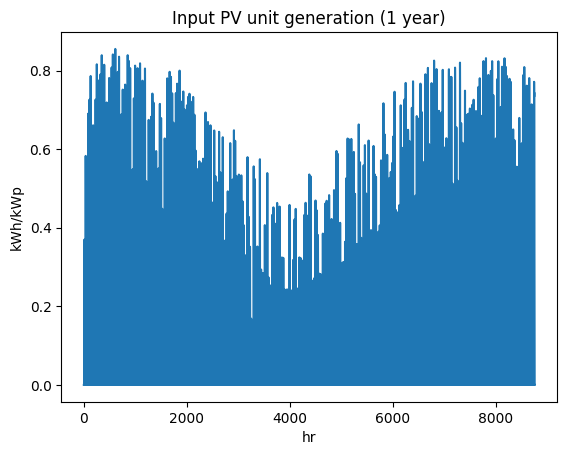

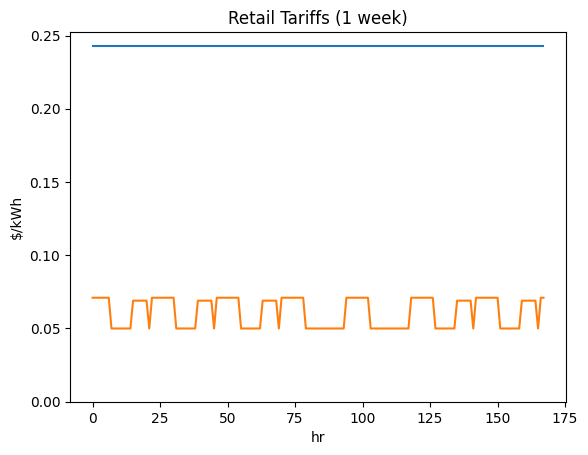

---- Optimising with PV: 1 - 20 kWp, Batt: 0 kWh. Determining PV capacity and dispatch.


************************************ Modell: PV > 1 kWp & BATT > 1 kWh ************************************
{'financial_horizon': 10, 'discount_rate': np.float64(0.06), 'grid_feedin_max': np.float64(5.0), 'pv_eol_capacity': np.float64(0.8), 'pv_eol_years': np.float64(25.0), 'pv_init_soh': np.float64(1.0), 'bess_e2p_ratio': np.float64(2.4), 'bess_roundtrip_eff': np.float64(0.88), 'bess_eol_years': np.float64(10.0), 'bess_eol_capacity': np.float64(0.7), 'bess_eol_cycles': np.float64(10000.0), 'bess_init_soh': np.float64(1.0), 'bess_eff_charge': np.float64(0.938083151964686), 'bess_eff_discharge': np.float64(0.938083151964686), 'scenario_name': 'Scenario_D_+5', 'scenario_set': 'SurfCoast', 'scenario_subset': 'JJP_open', 'year_start': 2022, 'datetime_name': 'DateTime1', 'meter_name': 'pc3072_nmi8758723899', 'solar_name': 'MELB', 'tariff_name_import_wkday': '3_Im_wkday', 'tariff_name_export_wkday': '3_

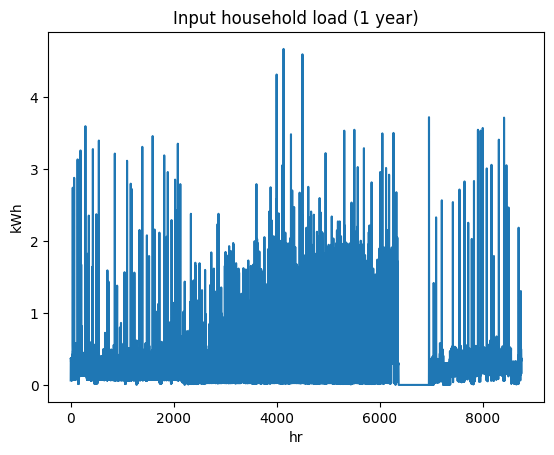

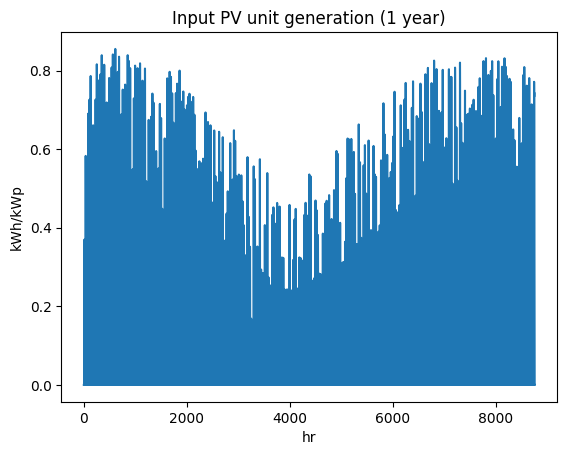

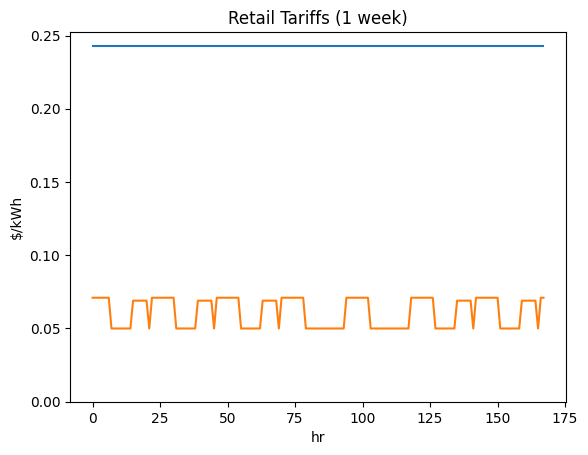

---- Optimising with PV: 1 - 20 kWp, Batt: 0 kWh. Determining PV capacity and dispatch.


************************************ Modell: PV > 1 kWp & BATT > 1 kWh ************************************
{'financial_horizon': 10, 'discount_rate': np.float64(0.06), 'grid_feedin_max': np.float64(5.0), 'pv_eol_capacity': np.float64(0.8), 'pv_eol_years': np.float64(25.0), 'pv_init_soh': np.float64(1.0), 'bess_e2p_ratio': np.float64(2.4), 'bess_roundtrip_eff': np.float64(0.88), 'bess_eol_years': np.float64(10.0), 'bess_eol_capacity': np.float64(0.7), 'bess_eol_cycles': np.float64(10000.0), 'bess_init_soh': np.float64(1.0), 'bess_eff_charge': np.float64(0.938083151964686), 'bess_eff_discharge': np.float64(0.938083151964686), 'scenario_name': 'Scenario_D_+5', 'scenario_set': 'SurfCoast', 'scenario_subset': 'JJP_open', 'year_start': 2022, 'datetime_name': 'DateTime1', 'meter_name': 'pc3072_nmi2389926671', 'solar_name': 'MELB', 'tariff_name_import_wkday': '3_Im_wkday', 'tariff_name_export_wkday': '3_

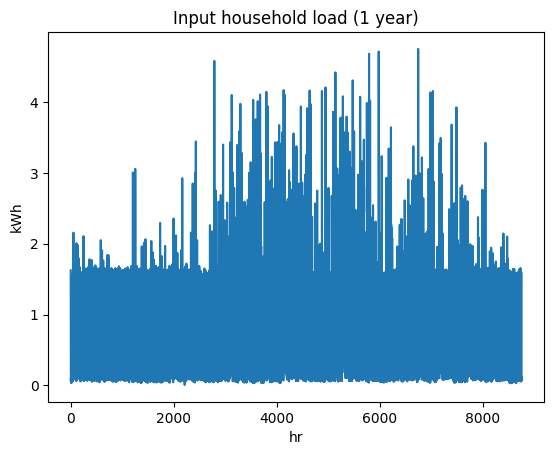

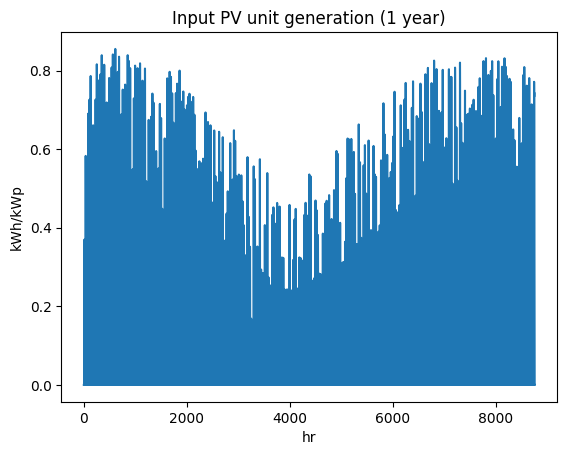

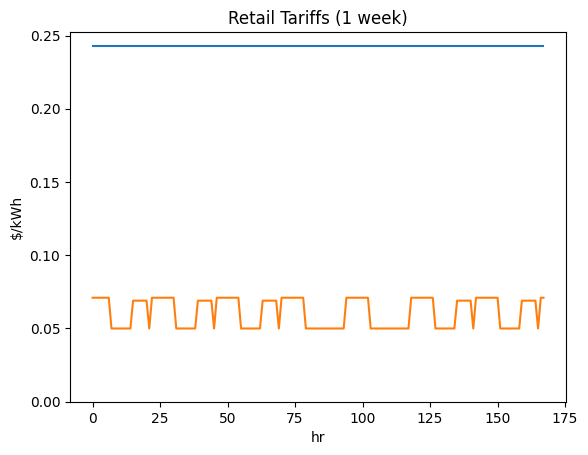

---- Optimising with PV: 1 - 20 kWp, Batt: 0 kWh. Determining PV capacity and dispatch.


************************************ Modell: PV > 1 kWp & BATT > 1 kWh ************************************
{'financial_horizon': 10, 'discount_rate': np.float64(0.06), 'grid_feedin_max': np.float64(5.0), 'pv_eol_capacity': np.float64(0.8), 'pv_eol_years': np.float64(25.0), 'pv_init_soh': np.float64(1.0), 'bess_e2p_ratio': np.float64(2.4), 'bess_roundtrip_eff': np.float64(0.88), 'bess_eol_years': np.float64(10.0), 'bess_eol_capacity': np.float64(0.7), 'bess_eol_cycles': np.float64(10000.0), 'bess_init_soh': np.float64(1.0), 'bess_eff_charge': np.float64(0.938083151964686), 'bess_eff_discharge': np.float64(0.938083151964686), 'scenario_name': 'Scenario_D_+5', 'scenario_set': 'SurfCoast', 'scenario_subset': 'JJP_open', 'year_start': 2022, 'datetime_name': 'DateTime1', 'meter_name': 'pc3072_nmi2639298031', 'solar_name': 'MELB', 'tariff_name_import_wkday': '3_Im_wkday', 'tariff_name_export_wkday': '3_

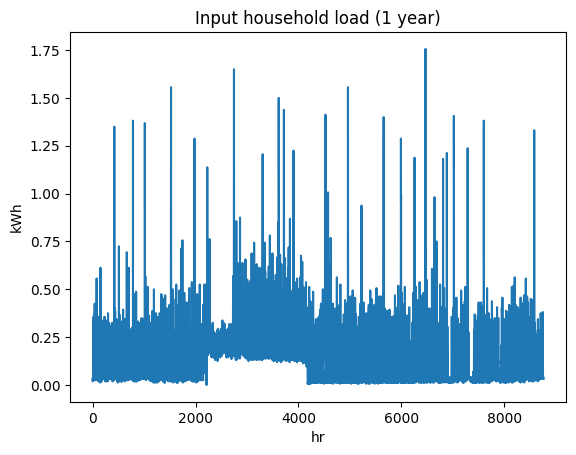

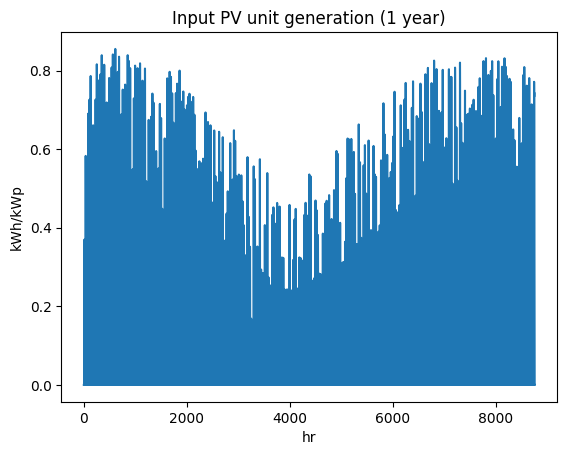

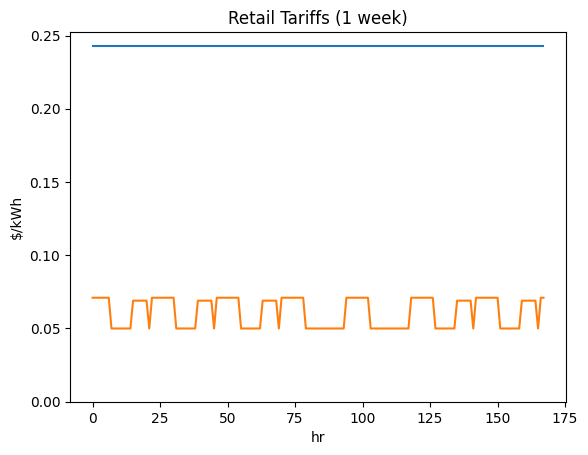

---- Optimising with PV: 1 - 20 kWp, Batt: 0 kWh. Determining PV capacity and dispatch.


************************************ Modell: PV > 1 kWp & BATT > 1 kWh ************************************
{'financial_horizon': 10, 'discount_rate': np.float64(0.06), 'grid_feedin_max': np.float64(5.0), 'pv_eol_capacity': np.float64(0.8), 'pv_eol_years': np.float64(25.0), 'pv_init_soh': np.float64(1.0), 'bess_e2p_ratio': np.float64(2.4), 'bess_roundtrip_eff': np.float64(0.88), 'bess_eol_years': np.float64(10.0), 'bess_eol_capacity': np.float64(0.7), 'bess_eol_cycles': np.float64(10000.0), 'bess_init_soh': np.float64(1.0), 'bess_eff_charge': np.float64(0.938083151964686), 'bess_eff_discharge': np.float64(0.938083151964686), 'scenario_name': 'Scenario_D_+5', 'scenario_set': 'SurfCoast', 'scenario_subset': 'JJP_open', 'year_start': 2022, 'datetime_name': 'DateTime1', 'meter_name': 'pc3072_nmi1395030288', 'solar_name': 'MELB', 'tariff_name_import_wkday': '3_Im_wkday', 'tariff_name_export_wkday': '3_

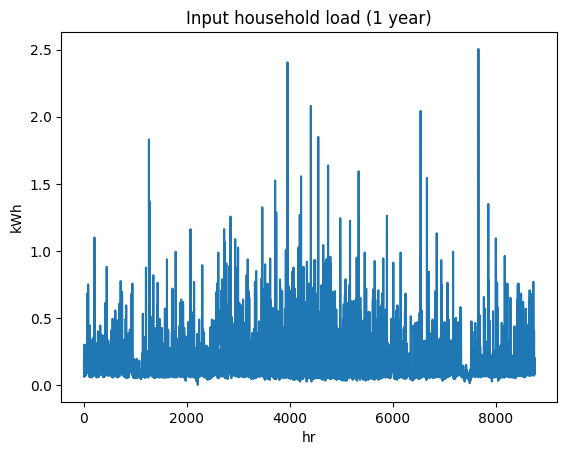

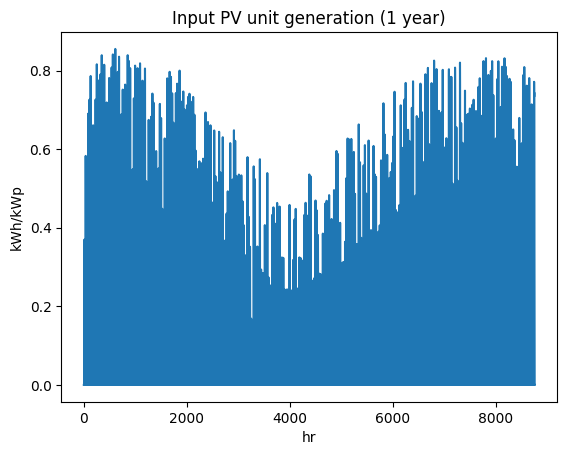

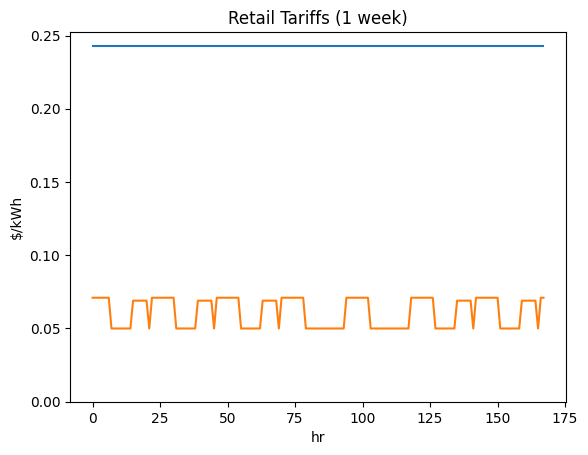

---- Optimising with PV: 1 - 20 kWp, Batt: 0 kWh. Determining PV capacity and dispatch.


************************************ Modell: PV > 1 kWp & BATT > 1 kWh ************************************
{'financial_horizon': 10, 'discount_rate': np.float64(0.06), 'grid_feedin_max': np.float64(5.0), 'pv_eol_capacity': np.float64(0.8), 'pv_eol_years': np.float64(25.0), 'pv_init_soh': np.float64(1.0), 'bess_e2p_ratio': np.float64(2.4), 'bess_roundtrip_eff': np.float64(0.88), 'bess_eol_years': np.float64(10.0), 'bess_eol_capacity': np.float64(0.7), 'bess_eol_cycles': np.float64(10000.0), 'bess_init_soh': np.float64(1.0), 'bess_eff_charge': np.float64(0.938083151964686), 'bess_eff_discharge': np.float64(0.938083151964686), 'scenario_name': 'Scenario_D_+5', 'scenario_set': 'SurfCoast', 'scenario_subset': 'JJP_open', 'year_start': 2022, 'datetime_name': 'DateTime1', 'meter_name': 'pc3072_nmi8478492373', 'solar_name': 'MELB', 'tariff_name_import_wkday': '3_Im_wkday', 'tariff_name_export_wkday': '3_

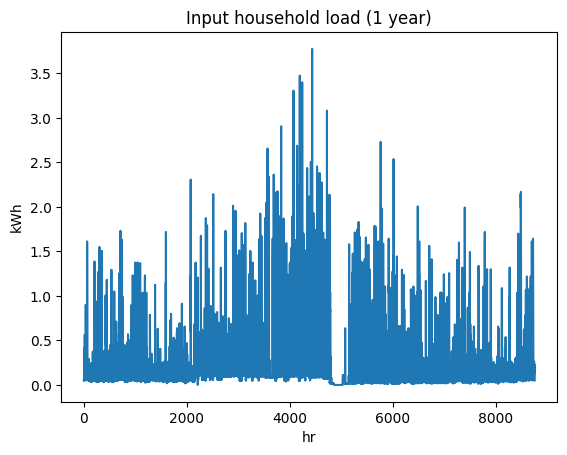

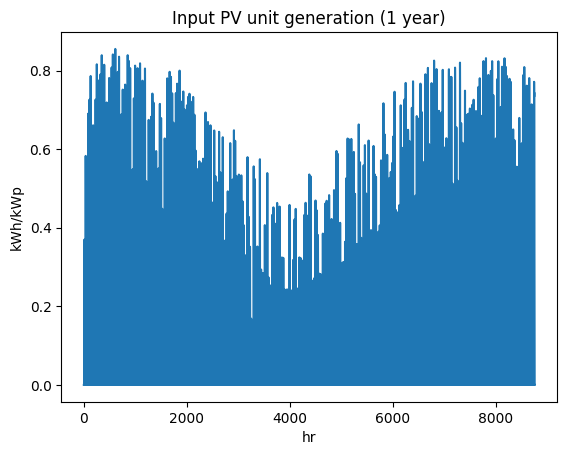

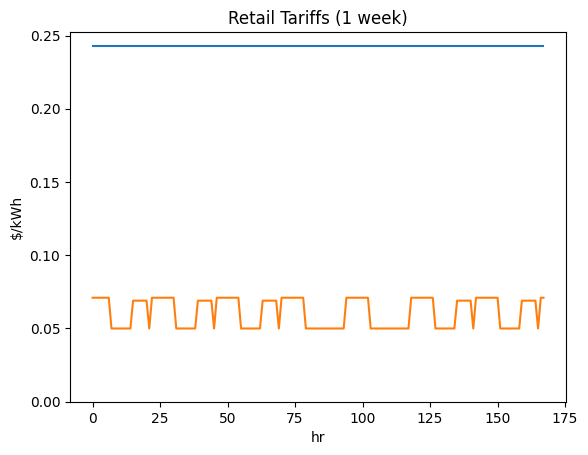

---- Optimising with PV: 1 - 20 kWp, Batt: 0 kWh. Determining PV capacity and dispatch.


************************************ Modell: PV > 1 kWp & BATT > 1 kWh ************************************
{'financial_horizon': 10, 'discount_rate': np.float64(0.06), 'grid_feedin_max': np.float64(5.0), 'pv_eol_capacity': np.float64(0.8), 'pv_eol_years': np.float64(25.0), 'pv_init_soh': np.float64(1.0), 'bess_e2p_ratio': np.float64(2.4), 'bess_roundtrip_eff': np.float64(0.88), 'bess_eol_years': np.float64(10.0), 'bess_eol_capacity': np.float64(0.7), 'bess_eol_cycles': np.float64(10000.0), 'bess_init_soh': np.float64(1.0), 'bess_eff_charge': np.float64(0.938083151964686), 'bess_eff_discharge': np.float64(0.938083151964686), 'scenario_name': 'Scenario_D_+5', 'scenario_set': 'SurfCoast', 'scenario_subset': 'JJP_open', 'year_start': 2022, 'datetime_name': 'DateTime1', 'meter_name': 'pc3072_nmi4984575257', 'solar_name': 'MELB', 'tariff_name_import_wkday': '3_Im_wkday', 'tariff_name_export_wkday': '3_

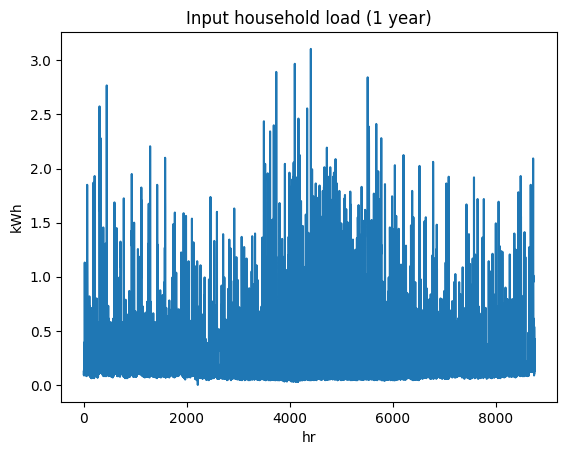

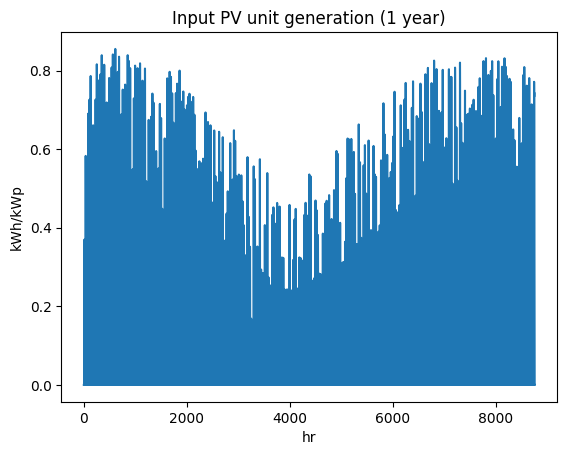

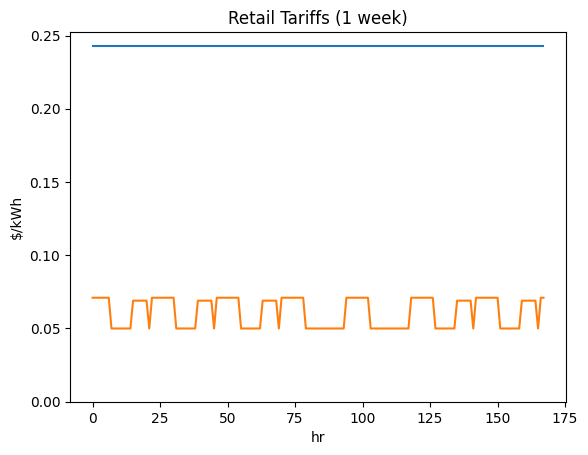

---- Optimising with PV: 1 - 20 kWp, Batt: 0 kWh. Determining PV capacity and dispatch.


************************************ Modell: PV > 1 kWp & BATT > 1 kWh ************************************
{'financial_horizon': 10, 'discount_rate': np.float64(0.06), 'grid_feedin_max': np.float64(5.0), 'pv_eol_capacity': np.float64(0.8), 'pv_eol_years': np.float64(25.0), 'pv_init_soh': np.float64(1.0), 'bess_e2p_ratio': np.float64(2.4), 'bess_roundtrip_eff': np.float64(0.88), 'bess_eol_years': np.float64(10.0), 'bess_eol_capacity': np.float64(0.7), 'bess_eol_cycles': np.float64(10000.0), 'bess_init_soh': np.float64(1.0), 'bess_eff_charge': np.float64(0.938083151964686), 'bess_eff_discharge': np.float64(0.938083151964686), 'scenario_name': 'Scenario_D_+5', 'scenario_set': 'SurfCoast', 'scenario_subset': 'JJP_open', 'year_start': 2022, 'datetime_name': 'DateTime1', 'meter_name': 'pc3072_nmi5827433936', 'solar_name': 'MELB', 'tariff_name_import_wkday': '3_Im_wkday', 'tariff_name_export_wkday': '3_

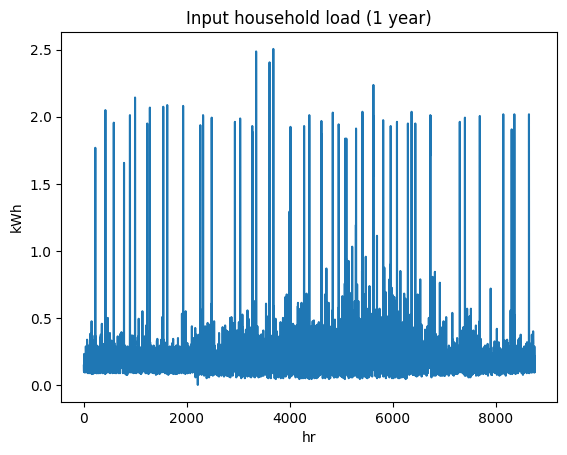

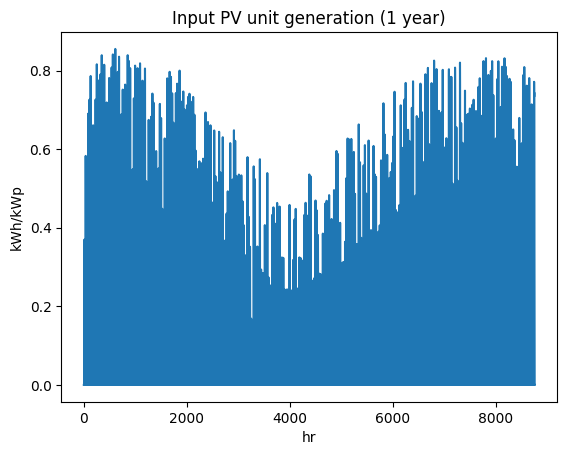

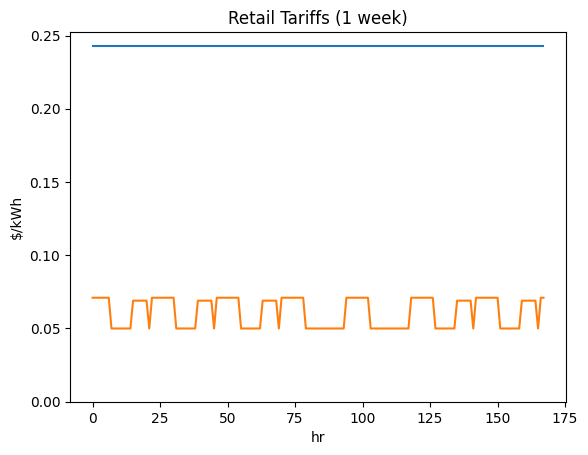

---- Optimising with PV: 1 - 20 kWp, Batt: 0 kWh. Determining PV capacity and dispatch.


************************************ Modell: PV > 1 kWp & BATT > 1 kWh ************************************
{'financial_horizon': 10, 'discount_rate': np.float64(0.06), 'grid_feedin_max': np.float64(5.0), 'pv_eol_capacity': np.float64(0.8), 'pv_eol_years': np.float64(25.0), 'pv_init_soh': np.float64(1.0), 'bess_e2p_ratio': np.float64(2.4), 'bess_roundtrip_eff': np.float64(0.88), 'bess_eol_years': np.float64(10.0), 'bess_eol_capacity': np.float64(0.7), 'bess_eol_cycles': np.float64(10000.0), 'bess_init_soh': np.float64(1.0), 'bess_eff_charge': np.float64(0.938083151964686), 'bess_eff_discharge': np.float64(0.938083151964686), 'scenario_name': 'Scenario_D_+5', 'scenario_set': 'SurfCoast', 'scenario_subset': 'JJP_open', 'year_start': 2022, 'datetime_name': 'DateTime1', 'meter_name': 'pc3072_nmi2399809071', 'solar_name': 'MELB', 'tariff_name_import_wkday': '3_Im_wkday', 'tariff_name_export_wkday': '3_

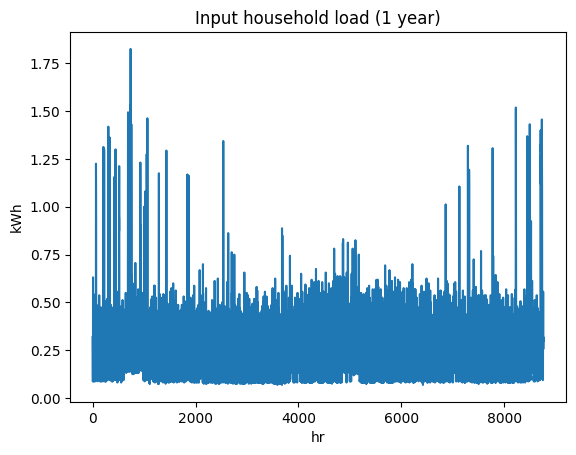

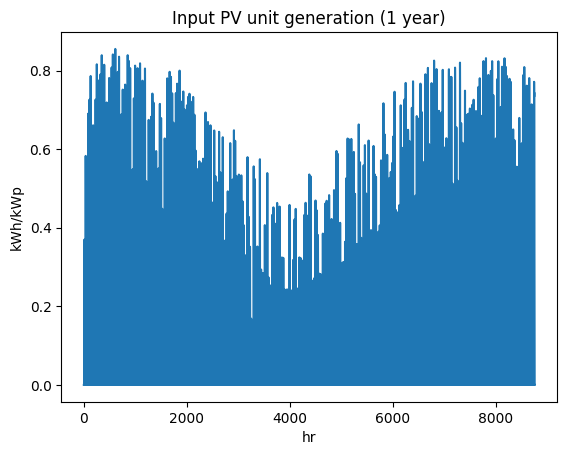

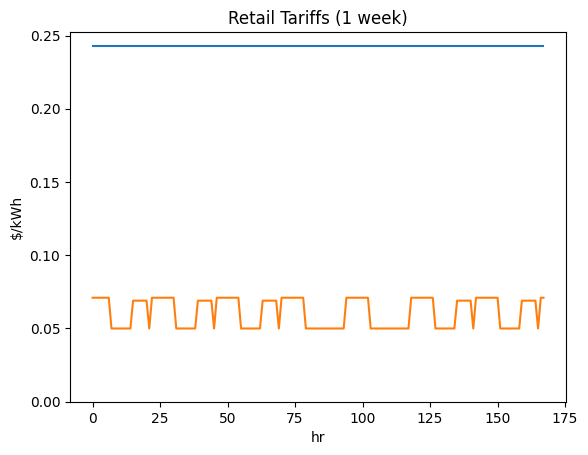

---- Optimising with PV: 1 - 20 kWp, Batt: 0 kWh. Determining PV capacity and dispatch.


************************************ Modell: PV > 1 kWp & BATT > 1 kWh ************************************
{'financial_horizon': 10, 'discount_rate': np.float64(0.06), 'grid_feedin_max': np.float64(5.0), 'pv_eol_capacity': np.float64(0.8), 'pv_eol_years': np.float64(25.0), 'pv_init_soh': np.float64(1.0), 'bess_e2p_ratio': np.float64(2.4), 'bess_roundtrip_eff': np.float64(0.88), 'bess_eol_years': np.float64(10.0), 'bess_eol_capacity': np.float64(0.7), 'bess_eol_cycles': np.float64(10000.0), 'bess_init_soh': np.float64(1.0), 'bess_eff_charge': np.float64(0.938083151964686), 'bess_eff_discharge': np.float64(0.938083151964686), 'scenario_name': 'Scenario_D_+5', 'scenario_set': 'SurfCoast', 'scenario_subset': 'JJP_open', 'year_start': 2022, 'datetime_name': 'DateTime1', 'meter_name': 'pc3072_nmi9805356432', 'solar_name': 'MELB', 'tariff_name_import_wkday': '3_Im_wkday', 'tariff_name_export_wkday': '3_

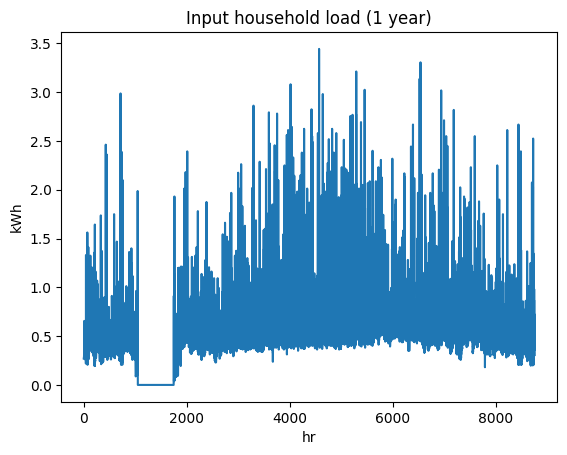

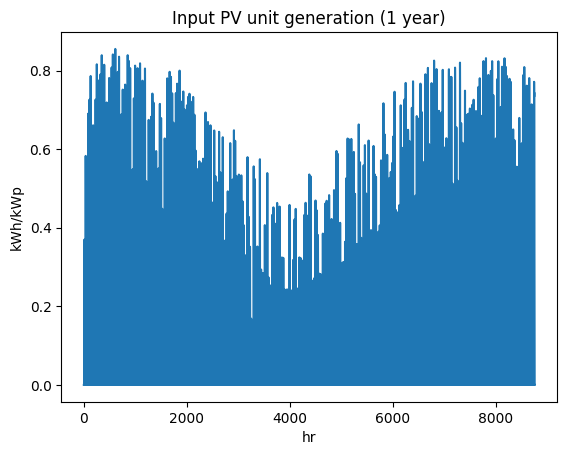

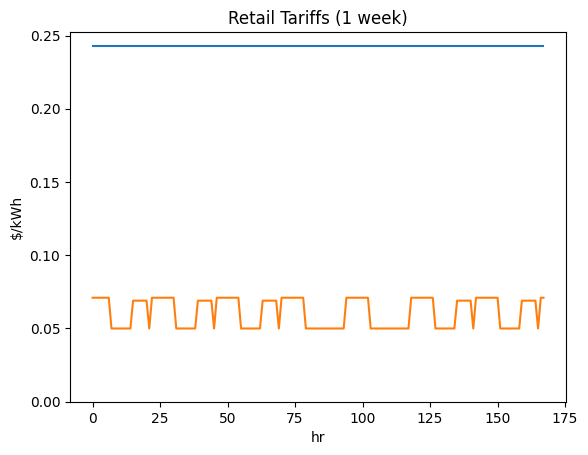

---- Optimising with PV: 1 - 20 kWp, Batt: 0 kWh. Determining PV capacity and dispatch.


************************************ Modell: PV > 1 kWp & BATT > 1 kWh ************************************
{'financial_horizon': 10, 'discount_rate': np.float64(0.06), 'grid_feedin_max': np.float64(5.0), 'pv_eol_capacity': np.float64(0.8), 'pv_eol_years': np.float64(25.0), 'pv_init_soh': np.float64(1.0), 'bess_e2p_ratio': np.float64(2.4), 'bess_roundtrip_eff': np.float64(0.88), 'bess_eol_years': np.float64(10.0), 'bess_eol_capacity': np.float64(0.7), 'bess_eol_cycles': np.float64(10000.0), 'bess_init_soh': np.float64(1.0), 'bess_eff_charge': np.float64(0.938083151964686), 'bess_eff_discharge': np.float64(0.938083151964686), 'scenario_name': 'Scenario_D_+5', 'scenario_set': 'SurfCoast', 'scenario_subset': 'JJP_open', 'year_start': 2022, 'datetime_name': 'DateTime1', 'meter_name': 'pc3072_nmi5749249300', 'solar_name': 'MELB', 'tariff_name_import_wkday': '3_Im_wkday', 'tariff_name_export_wkday': '3_

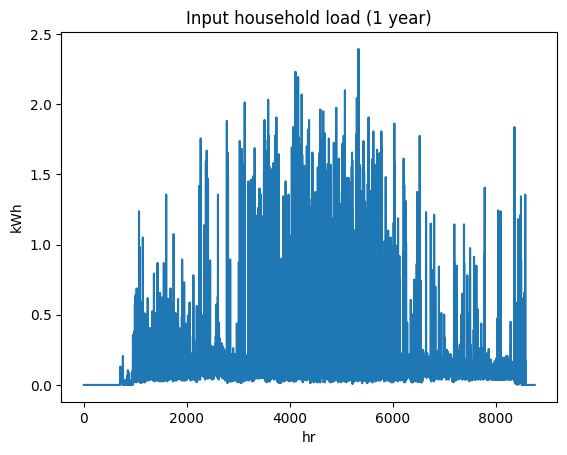

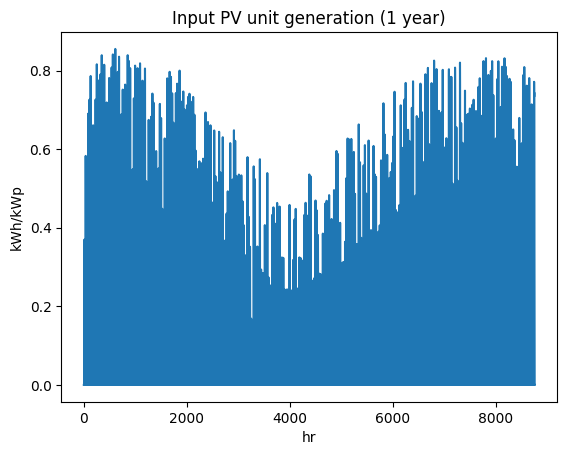

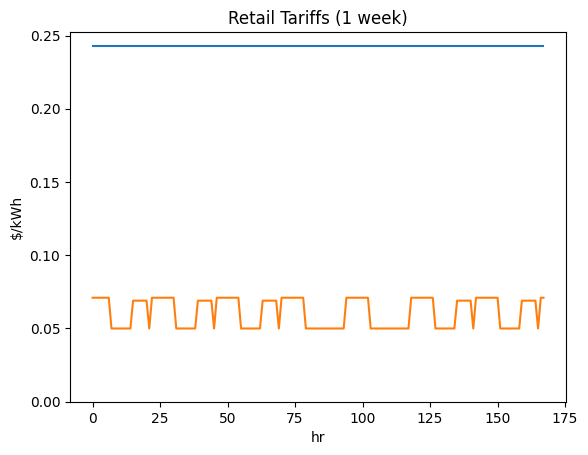

---- Optimising with PV: 1 - 20 kWp, Batt: 0 kWh. Determining PV capacity and dispatch.


************************************ Modell: PV > 1 kWp & BATT > 1 kWh ************************************
{'financial_horizon': 10, 'discount_rate': np.float64(0.06), 'grid_feedin_max': np.float64(5.0), 'pv_eol_capacity': np.float64(0.8), 'pv_eol_years': np.float64(25.0), 'pv_init_soh': np.float64(1.0), 'bess_e2p_ratio': np.float64(2.4), 'bess_roundtrip_eff': np.float64(0.88), 'bess_eol_years': np.float64(10.0), 'bess_eol_capacity': np.float64(0.7), 'bess_eol_cycles': np.float64(10000.0), 'bess_init_soh': np.float64(1.0), 'bess_eff_charge': np.float64(0.938083151964686), 'bess_eff_discharge': np.float64(0.938083151964686), 'scenario_name': 'Scenario_D_+5', 'scenario_set': 'SurfCoast', 'scenario_subset': 'JJP_open', 'year_start': 2022, 'datetime_name': 'DateTime1', 'meter_name': 'pc3072_nmi2832674345', 'solar_name': 'MELB', 'tariff_name_import_wkday': '3_Im_wkday', 'tariff_name_export_wkday': '3_

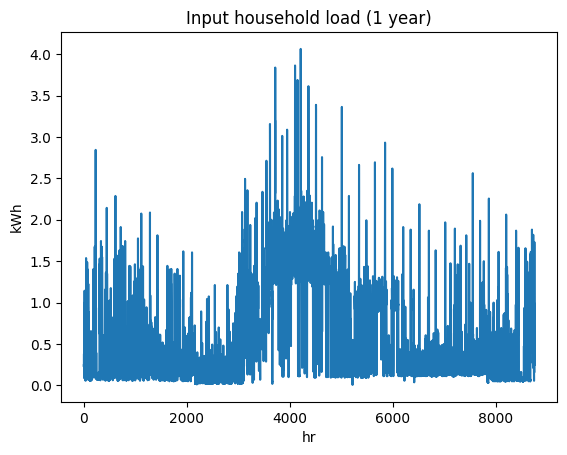

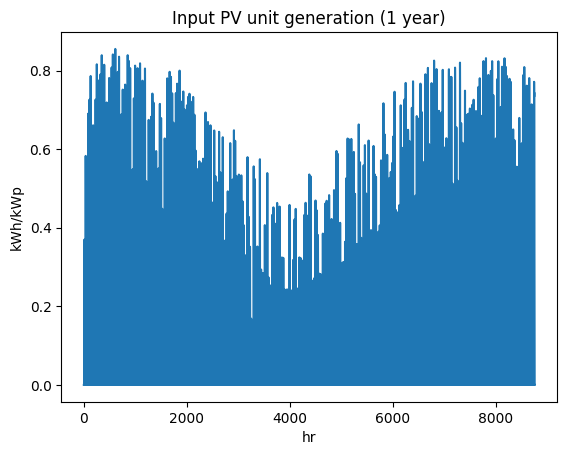

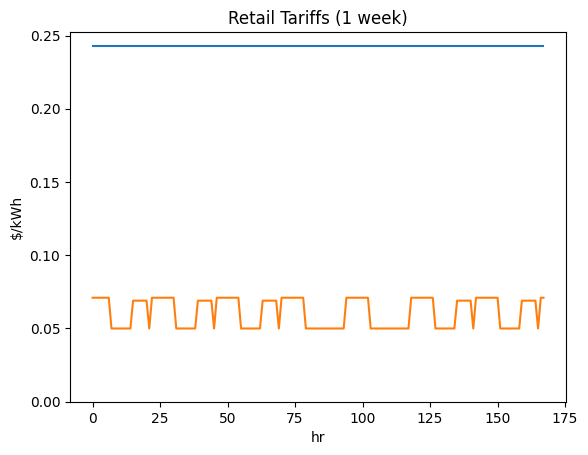

---- Optimising with PV: 1 - 20 kWp, Batt: 0 kWh. Determining PV capacity and dispatch.


************************************ Modell: PV > 1 kWp & BATT > 1 kWh ************************************
{'financial_horizon': 10, 'discount_rate': np.float64(0.06), 'grid_feedin_max': np.float64(5.0), 'pv_eol_capacity': np.float64(0.8), 'pv_eol_years': np.float64(25.0), 'pv_init_soh': np.float64(1.0), 'bess_e2p_ratio': np.float64(2.4), 'bess_roundtrip_eff': np.float64(0.88), 'bess_eol_years': np.float64(10.0), 'bess_eol_capacity': np.float64(0.7), 'bess_eol_cycles': np.float64(10000.0), 'bess_init_soh': np.float64(1.0), 'bess_eff_charge': np.float64(0.938083151964686), 'bess_eff_discharge': np.float64(0.938083151964686), 'scenario_name': 'Scenario_D_+5', 'scenario_set': 'SurfCoast', 'scenario_subset': 'JJP_open', 'year_start': 2022, 'datetime_name': 'DateTime1', 'meter_name': 'pc3072_nmi9538563821', 'solar_name': 'MELB', 'tariff_name_import_wkday': '3_Im_wkday', 'tariff_name_export_wkday': '3_

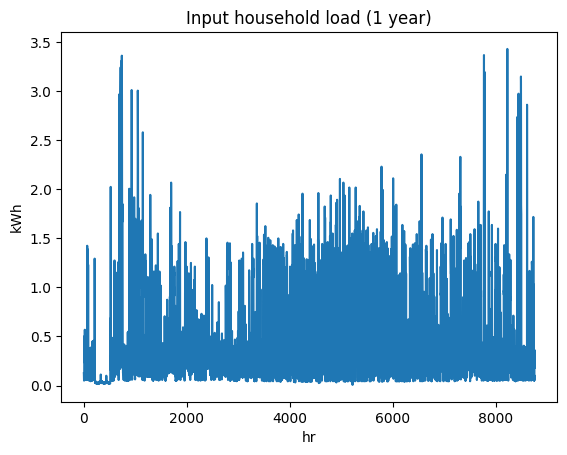

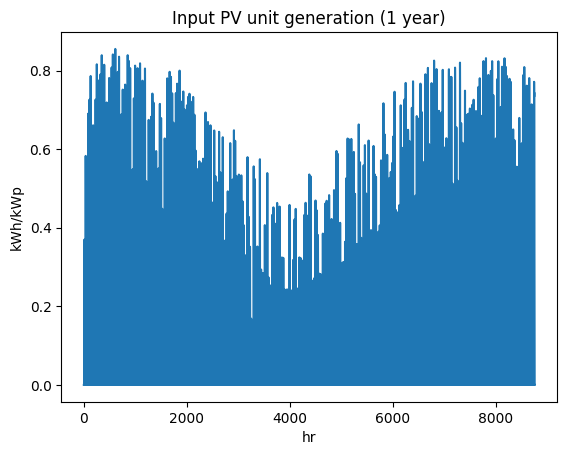

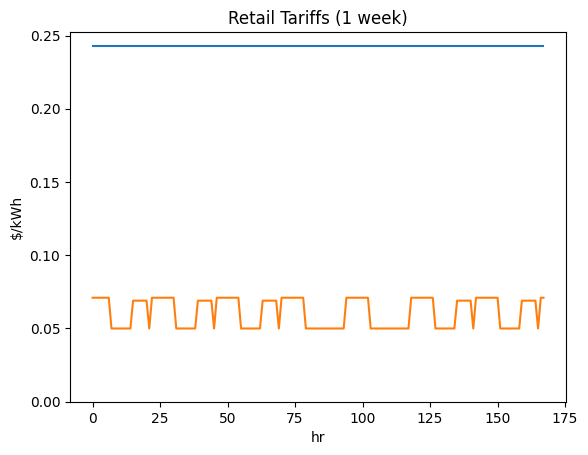

---- Optimising with PV: 1 - 20 kWp, Batt: 0 kWh. Determining PV capacity and dispatch.


************************************ Modell: PV > 1 kWp & BATT > 1 kWh ************************************
{'financial_horizon': 10, 'discount_rate': np.float64(0.06), 'grid_feedin_max': np.float64(5.0), 'pv_eol_capacity': np.float64(0.8), 'pv_eol_years': np.float64(25.0), 'pv_init_soh': np.float64(1.0), 'bess_e2p_ratio': np.float64(2.4), 'bess_roundtrip_eff': np.float64(0.88), 'bess_eol_years': np.float64(10.0), 'bess_eol_capacity': np.float64(0.7), 'bess_eol_cycles': np.float64(10000.0), 'bess_init_soh': np.float64(1.0), 'bess_eff_charge': np.float64(0.938083151964686), 'bess_eff_discharge': np.float64(0.938083151964686), 'scenario_name': 'Scenario_D_+5', 'scenario_set': 'SurfCoast', 'scenario_subset': 'JJP_open', 'year_start': 2022, 'datetime_name': 'DateTime1', 'meter_name': 'pc3072_nmi7528811588', 'solar_name': 'MELB', 'tariff_name_import_wkday': '3_Im_wkday', 'tariff_name_export_wkday': '3_

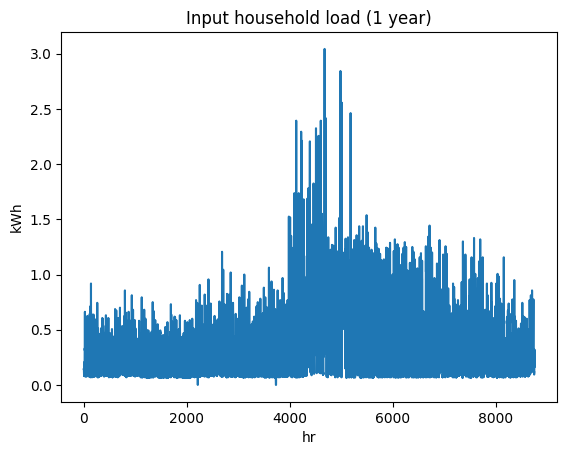

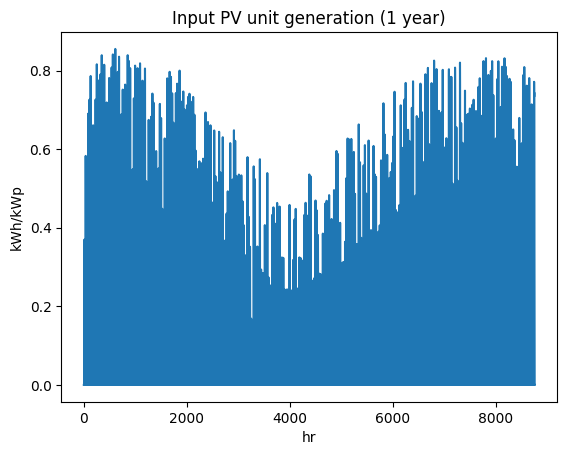

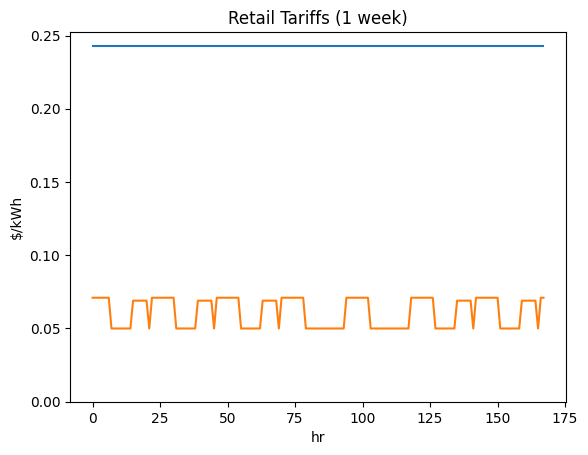

---- Optimising with PV: 1 - 20 kWp, Batt: 0 kWh. Determining PV capacity and dispatch.


************************************ Modell: PV > 1 kWp & BATT > 1 kWh ************************************
{'financial_horizon': 10, 'discount_rate': np.float64(0.06), 'grid_feedin_max': np.float64(5.0), 'pv_eol_capacity': np.float64(0.8), 'pv_eol_years': np.float64(25.0), 'pv_init_soh': np.float64(1.0), 'bess_e2p_ratio': np.float64(2.4), 'bess_roundtrip_eff': np.float64(0.88), 'bess_eol_years': np.float64(10.0), 'bess_eol_capacity': np.float64(0.7), 'bess_eol_cycles': np.float64(10000.0), 'bess_init_soh': np.float64(1.0), 'bess_eff_charge': np.float64(0.938083151964686), 'bess_eff_discharge': np.float64(0.938083151964686), 'scenario_name': 'Scenario_D_+5', 'scenario_set': 'SurfCoast', 'scenario_subset': 'JJP_open', 'year_start': 2022, 'datetime_name': 'DateTime1', 'meter_name': 'pc3072_nmi1693008245', 'solar_name': 'MELB', 'tariff_name_import_wkday': '3_Im_wkday', 'tariff_name_export_wkday': '3_

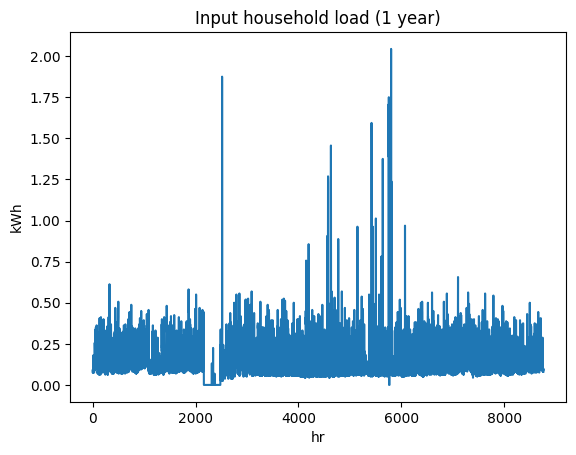

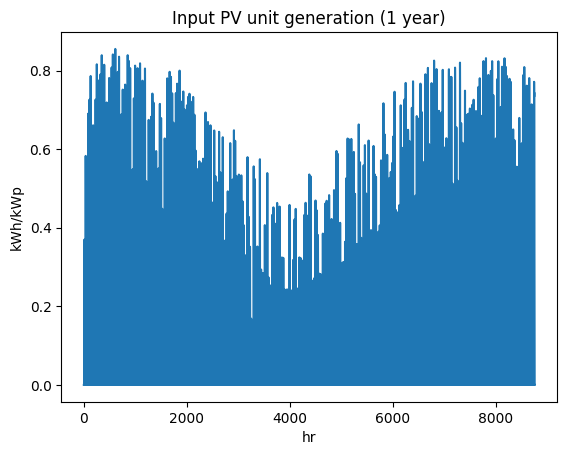

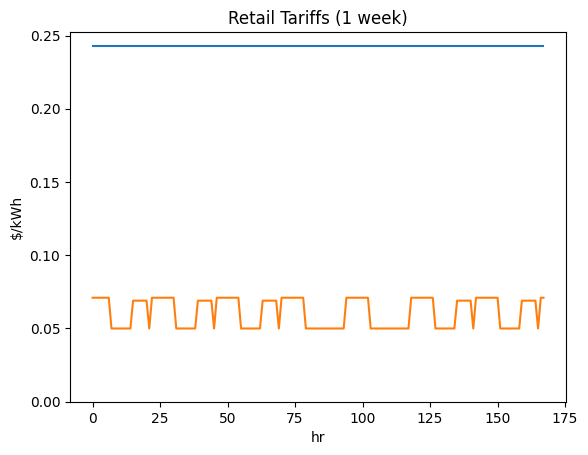

---- Optimising with PV: 1 - 20 kWp, Batt: 0 kWh. Determining PV capacity and dispatch.


************************************ Modell: PV > 1 kWp & BATT > 1 kWh ************************************
{'financial_horizon': 10, 'discount_rate': np.float64(0.06), 'grid_feedin_max': np.float64(5.0), 'pv_eol_capacity': np.float64(0.8), 'pv_eol_years': np.float64(25.0), 'pv_init_soh': np.float64(1.0), 'bess_e2p_ratio': np.float64(2.4), 'bess_roundtrip_eff': np.float64(0.88), 'bess_eol_years': np.float64(10.0), 'bess_eol_capacity': np.float64(0.7), 'bess_eol_cycles': np.float64(10000.0), 'bess_init_soh': np.float64(1.0), 'bess_eff_charge': np.float64(0.938083151964686), 'bess_eff_discharge': np.float64(0.938083151964686), 'scenario_name': 'Scenario_D_+5', 'scenario_set': 'SurfCoast', 'scenario_subset': 'JJP_open', 'year_start': 2022, 'datetime_name': 'DateTime1', 'meter_name': 'pc3072_nmi2128412799', 'solar_name': 'MELB', 'tariff_name_import_wkday': '3_Im_wkday', 'tariff_name_export_wkday': '3_

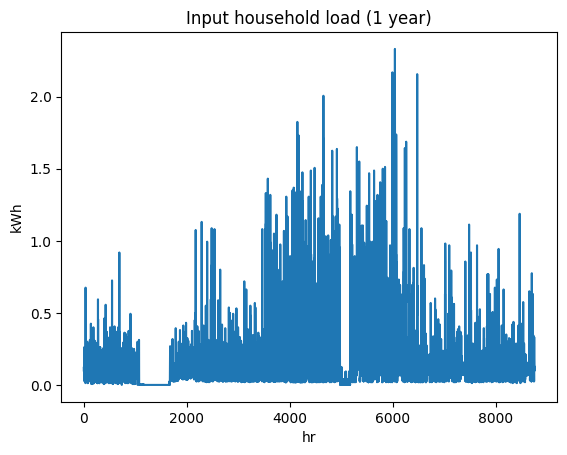

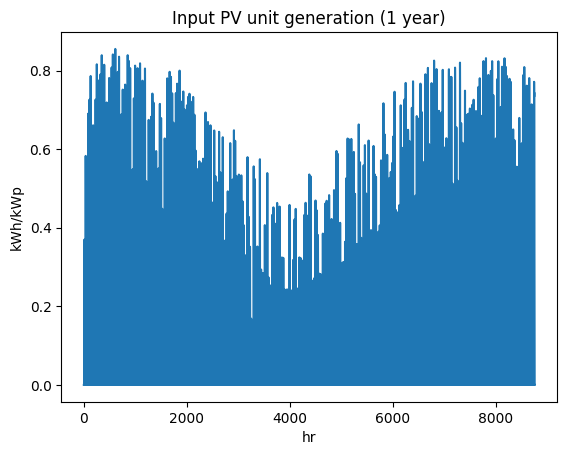

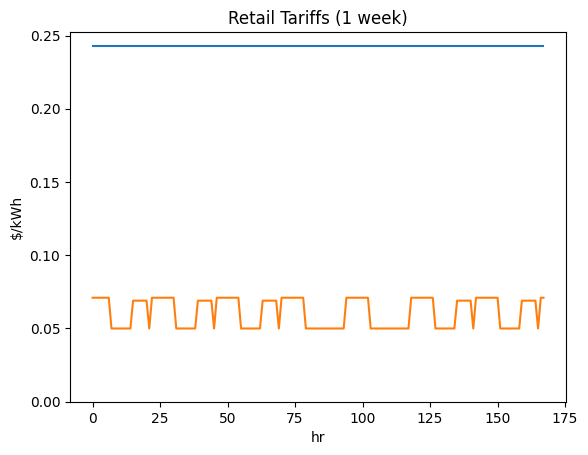

---- Optimising with PV: 1 - 20 kWp, Batt: 0 kWh. Determining PV capacity and dispatch.


************************************ Modell: PV > 1 kWp & BATT > 1 kWh ************************************
{'financial_horizon': 10, 'discount_rate': np.float64(0.06), 'grid_feedin_max': np.float64(5.0), 'pv_eol_capacity': np.float64(0.8), 'pv_eol_years': np.float64(25.0), 'pv_init_soh': np.float64(1.0), 'bess_e2p_ratio': np.float64(2.4), 'bess_roundtrip_eff': np.float64(0.88), 'bess_eol_years': np.float64(10.0), 'bess_eol_capacity': np.float64(0.7), 'bess_eol_cycles': np.float64(10000.0), 'bess_init_soh': np.float64(1.0), 'bess_eff_charge': np.float64(0.938083151964686), 'bess_eff_discharge': np.float64(0.938083151964686), 'scenario_name': 'Scenario_D_+5', 'scenario_set': 'SurfCoast', 'scenario_subset': 'JJP_open', 'year_start': 2022, 'datetime_name': 'DateTime1', 'meter_name': 'pc3072_nmi4384690213', 'solar_name': 'MELB', 'tariff_name_import_wkday': '3_Im_wkday', 'tariff_name_export_wkday': '3_

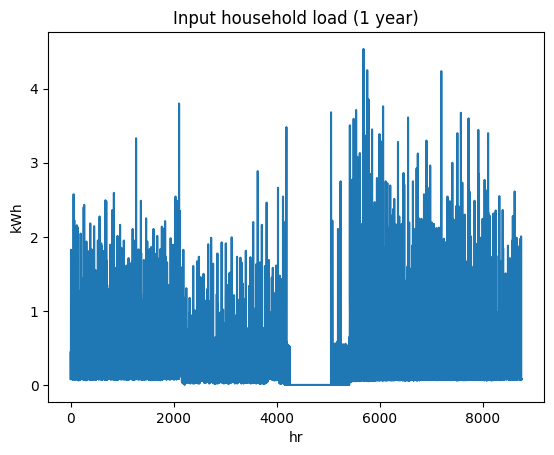

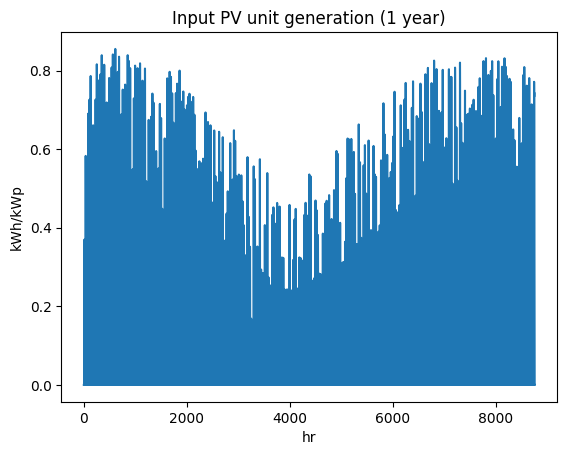

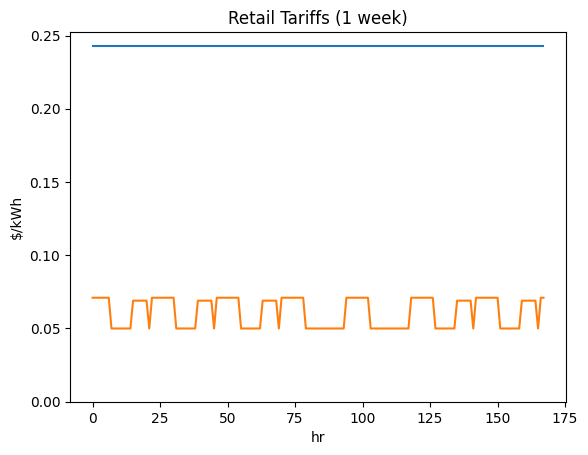

---- Optimising with PV: 1 - 20 kWp, Batt: 0 kWh. Determining PV capacity and dispatch.


************************************ Modell: PV > 1 kWp & BATT > 1 kWh ************************************
{'financial_horizon': 10, 'discount_rate': np.float64(0.06), 'grid_feedin_max': np.float64(5.0), 'pv_eol_capacity': np.float64(0.8), 'pv_eol_years': np.float64(25.0), 'pv_init_soh': np.float64(1.0), 'bess_e2p_ratio': np.float64(2.4), 'bess_roundtrip_eff': np.float64(0.88), 'bess_eol_years': np.float64(10.0), 'bess_eol_capacity': np.float64(0.7), 'bess_eol_cycles': np.float64(10000.0), 'bess_init_soh': np.float64(1.0), 'bess_eff_charge': np.float64(0.938083151964686), 'bess_eff_discharge': np.float64(0.938083151964686), 'scenario_name': 'Scenario_D_+5', 'scenario_set': 'SurfCoast', 'scenario_subset': 'JJP_open', 'year_start': 2022, 'datetime_name': 'DateTime1', 'meter_name': 'pc3072_nmi6749450332', 'solar_name': 'MELB', 'tariff_name_import_wkday': '3_Im_wkday', 'tariff_name_export_wkday': '3_

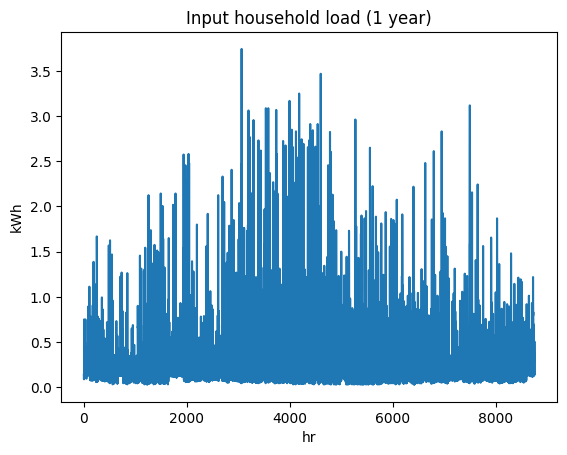

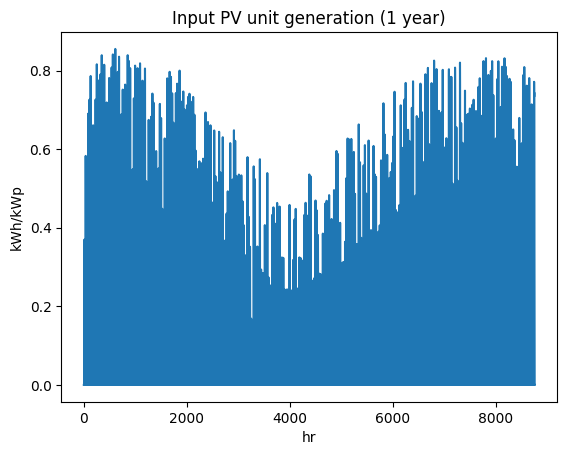

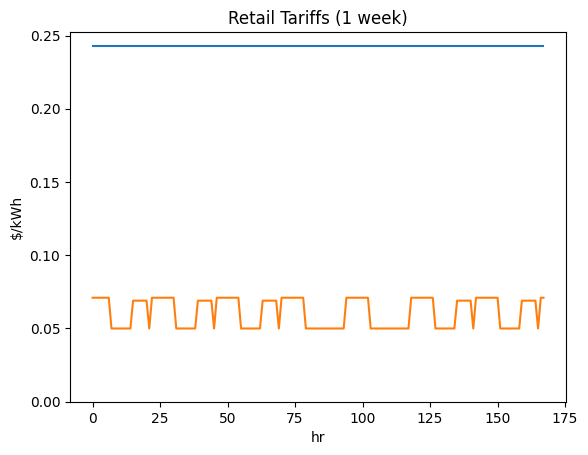

---- Optimising with PV: 1 - 20 kWp, Batt: 0 kWh. Determining PV capacity and dispatch.


************************************ Modell: PV > 1 kWp & BATT > 1 kWh ************************************
{'financial_horizon': 10, 'discount_rate': np.float64(0.06), 'grid_feedin_max': np.float64(5.0), 'pv_eol_capacity': np.float64(0.8), 'pv_eol_years': np.float64(25.0), 'pv_init_soh': np.float64(1.0), 'bess_e2p_ratio': np.float64(2.4), 'bess_roundtrip_eff': np.float64(0.88), 'bess_eol_years': np.float64(10.0), 'bess_eol_capacity': np.float64(0.7), 'bess_eol_cycles': np.float64(10000.0), 'bess_init_soh': np.float64(1.0), 'bess_eff_charge': np.float64(0.938083151964686), 'bess_eff_discharge': np.float64(0.938083151964686), 'scenario_name': 'Scenario_D_+5', 'scenario_set': 'SurfCoast', 'scenario_subset': 'JJP_open', 'year_start': 2022, 'datetime_name': 'DateTime1', 'meter_name': 'pc3072_nmi8691543389', 'solar_name': 'MELB', 'tariff_name_import_wkday': '3_Im_wkday', 'tariff_name_export_wkday': '3_

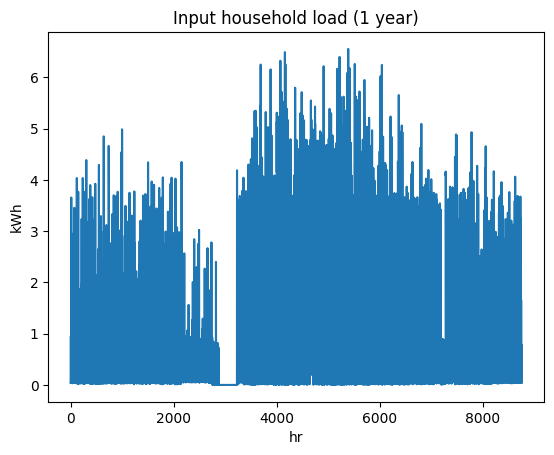

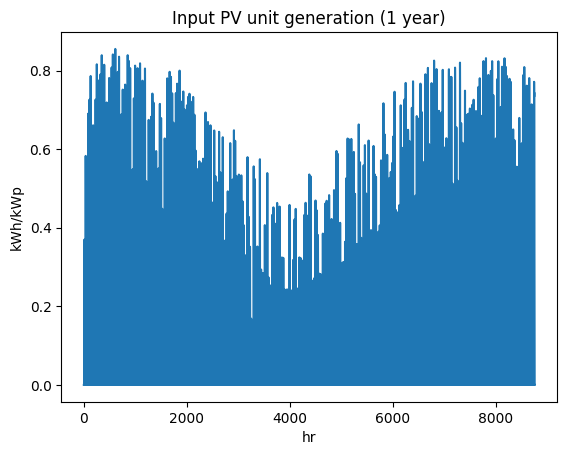

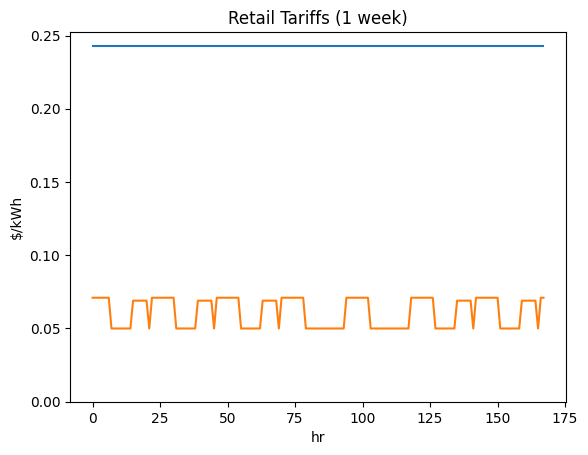

---- Optimising with PV: 1 - 20 kWp, Batt: 0 kWh. Determining PV capacity and dispatch.


************************************ Modell: PV > 1 kWp & BATT > 1 kWh ************************************
{'financial_horizon': 10, 'discount_rate': np.float64(0.06), 'grid_feedin_max': np.float64(5.0), 'pv_eol_capacity': np.float64(0.8), 'pv_eol_years': np.float64(25.0), 'pv_init_soh': np.float64(1.0), 'bess_e2p_ratio': np.float64(2.4), 'bess_roundtrip_eff': np.float64(0.88), 'bess_eol_years': np.float64(10.0), 'bess_eol_capacity': np.float64(0.7), 'bess_eol_cycles': np.float64(10000.0), 'bess_init_soh': np.float64(1.0), 'bess_eff_charge': np.float64(0.938083151964686), 'bess_eff_discharge': np.float64(0.938083151964686), 'scenario_name': 'Scenario_D_+5', 'scenario_set': 'SurfCoast', 'scenario_subset': 'JJP_open', 'year_start': 2022, 'datetime_name': 'DateTime1', 'meter_name': 'pc3072_nmi6156891438', 'solar_name': 'MELB', 'tariff_name_import_wkday': '3_Im_wkday', 'tariff_name_export_wkday': '3_

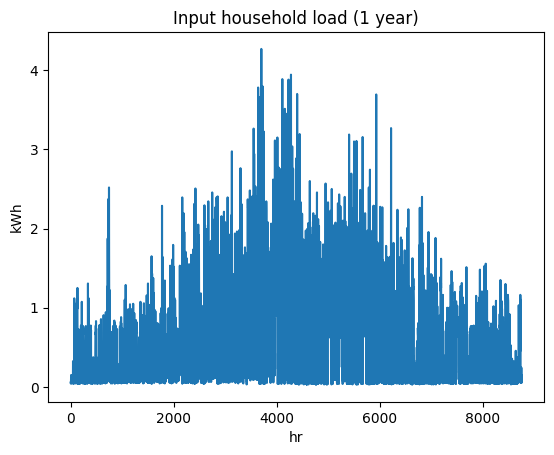

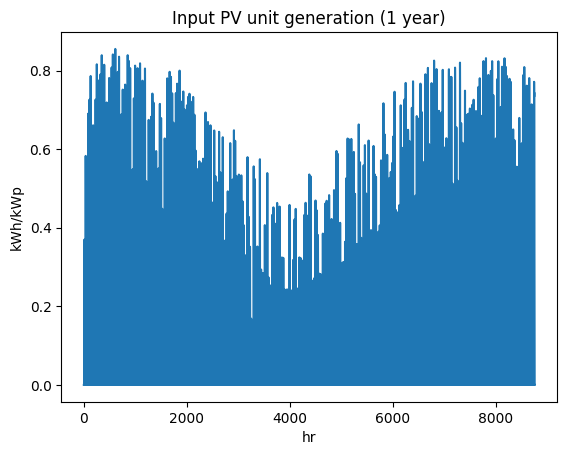

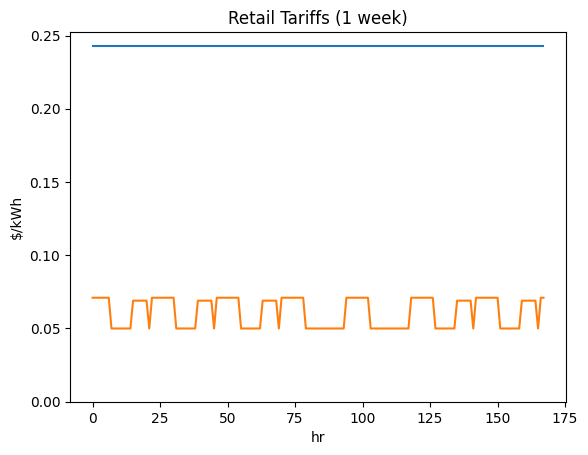

---- Optimising with PV: 1 - 20 kWp, Batt: 0 kWh. Determining PV capacity and dispatch.


************************************ Modell: PV > 1 kWp & BATT > 1 kWh ************************************
{'financial_horizon': 10, 'discount_rate': np.float64(0.06), 'grid_feedin_max': np.float64(5.0), 'pv_eol_capacity': np.float64(0.8), 'pv_eol_years': np.float64(25.0), 'pv_init_soh': np.float64(1.0), 'bess_e2p_ratio': np.float64(2.4), 'bess_roundtrip_eff': np.float64(0.88), 'bess_eol_years': np.float64(10.0), 'bess_eol_capacity': np.float64(0.7), 'bess_eol_cycles': np.float64(10000.0), 'bess_init_soh': np.float64(1.0), 'bess_eff_charge': np.float64(0.938083151964686), 'bess_eff_discharge': np.float64(0.938083151964686), 'scenario_name': 'Scenario_D_+5', 'scenario_set': 'SurfCoast', 'scenario_subset': 'JJP_open', 'year_start': 2022, 'datetime_name': 'DateTime1', 'meter_name': 'pc3072_nmi8978048317', 'solar_name': 'MELB', 'tariff_name_import_wkday': '3_Im_wkday', 'tariff_name_export_wkday': '3_

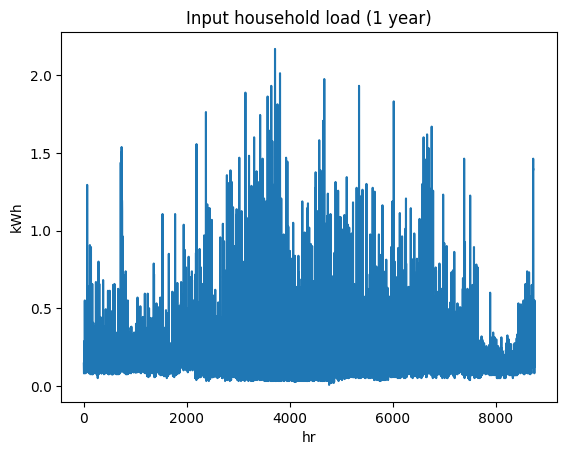

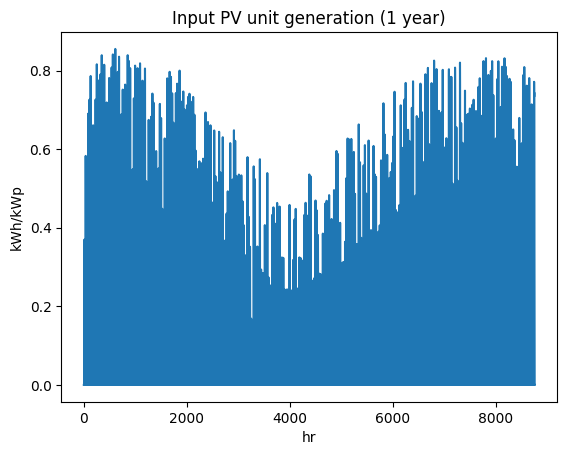

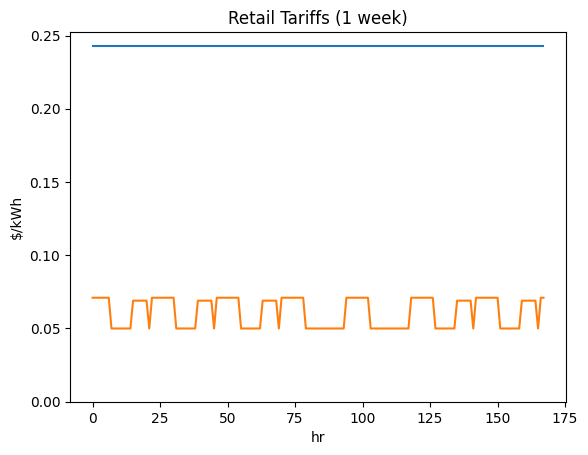

---- Optimising with PV: 1 - 20 kWp, Batt: 0 kWh. Determining PV capacity and dispatch.


************************************ Modell: PV > 1 kWp & BATT > 1 kWh ************************************
{'financial_horizon': 10, 'discount_rate': np.float64(0.06), 'grid_feedin_max': np.float64(5.0), 'pv_eol_capacity': np.float64(0.8), 'pv_eol_years': np.float64(25.0), 'pv_init_soh': np.float64(1.0), 'bess_e2p_ratio': np.float64(2.4), 'bess_roundtrip_eff': np.float64(0.88), 'bess_eol_years': np.float64(10.0), 'bess_eol_capacity': np.float64(0.7), 'bess_eol_cycles': np.float64(10000.0), 'bess_init_soh': np.float64(1.0), 'bess_eff_charge': np.float64(0.938083151964686), 'bess_eff_discharge': np.float64(0.938083151964686), 'scenario_name': 'Scenario_D_+5', 'scenario_set': 'SurfCoast', 'scenario_subset': 'JJP_open', 'year_start': 2022, 'datetime_name': 'DateTime1', 'meter_name': 'pc3072_nmi9479762175', 'solar_name': 'MELB', 'tariff_name_import_wkday': '3_Im_wkday', 'tariff_name_export_wkday': '3_

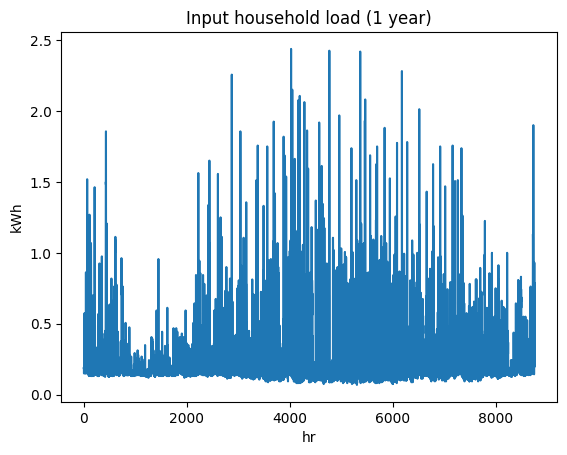

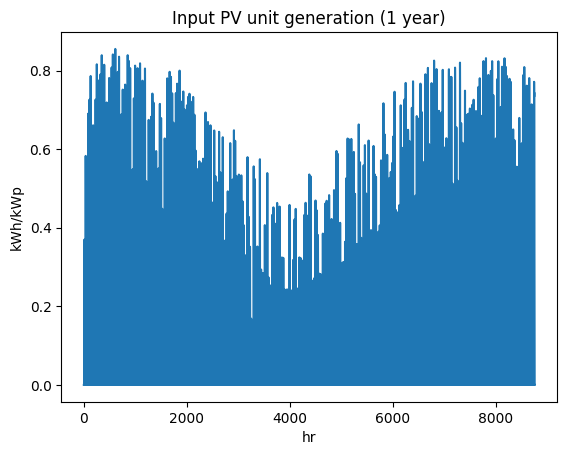

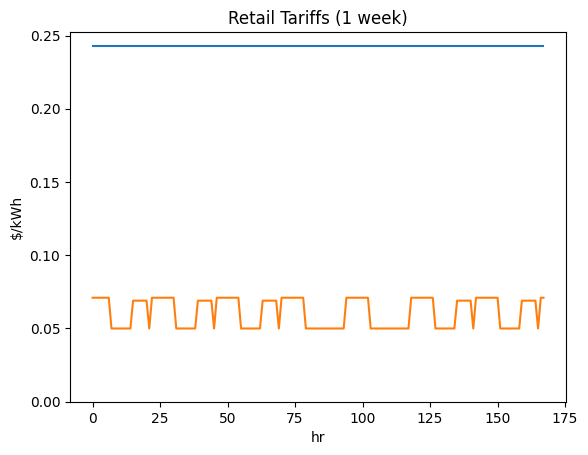

---- Optimising with PV: 1 - 20 kWp, Batt: 0 kWh. Determining PV capacity and dispatch.


************************************ Modell: PV > 1 kWp & BATT > 1 kWh ************************************
{'financial_horizon': 10, 'discount_rate': np.float64(0.06), 'grid_feedin_max': np.float64(5.0), 'pv_eol_capacity': np.float64(0.8), 'pv_eol_years': np.float64(25.0), 'pv_init_soh': np.float64(1.0), 'bess_e2p_ratio': np.float64(2.4), 'bess_roundtrip_eff': np.float64(0.88), 'bess_eol_years': np.float64(10.0), 'bess_eol_capacity': np.float64(0.7), 'bess_eol_cycles': np.float64(10000.0), 'bess_init_soh': np.float64(1.0), 'bess_eff_charge': np.float64(0.938083151964686), 'bess_eff_discharge': np.float64(0.938083151964686), 'scenario_name': 'Scenario_D_+5', 'scenario_set': 'SurfCoast', 'scenario_subset': 'JJP_open', 'year_start': 2022, 'datetime_name': 'DateTime1', 'meter_name': 'pc3072_nmi9422121285', 'solar_name': 'MELB', 'tariff_name_import_wkday': '3_Im_wkday', 'tariff_name_export_wkday': '3_

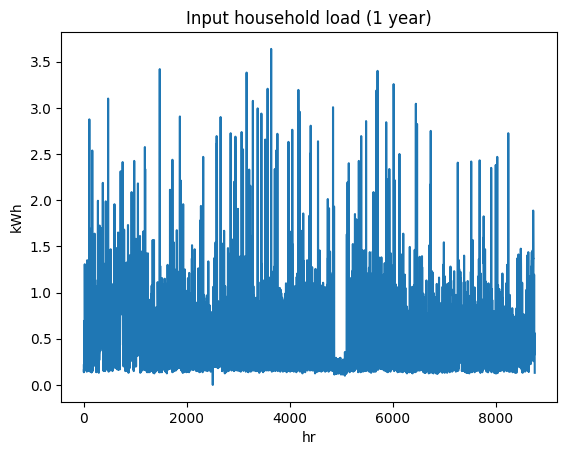

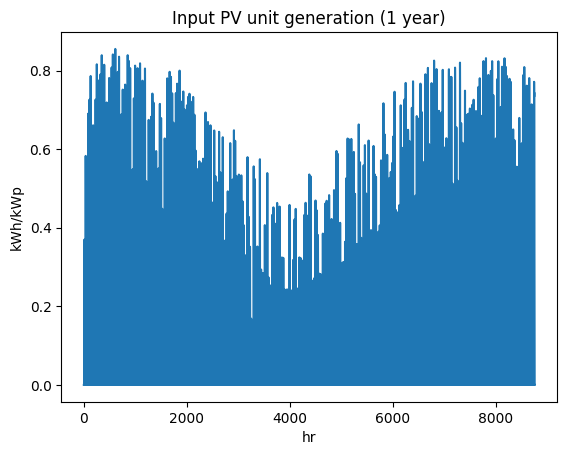

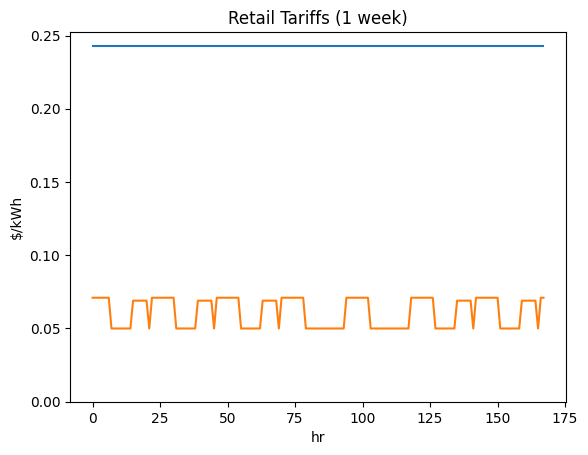

---- Optimising with PV: 1 - 20 kWp, Batt: 0 kWh. Determining PV capacity and dispatch.


************************************ Modell: PV > 1 kWp & BATT > 1 kWh ************************************
{'financial_horizon': 10, 'discount_rate': np.float64(0.06), 'grid_feedin_max': np.float64(5.0), 'pv_eol_capacity': np.float64(0.8), 'pv_eol_years': np.float64(25.0), 'pv_init_soh': np.float64(1.0), 'bess_e2p_ratio': np.float64(2.4), 'bess_roundtrip_eff': np.float64(0.88), 'bess_eol_years': np.float64(10.0), 'bess_eol_capacity': np.float64(0.7), 'bess_eol_cycles': np.float64(10000.0), 'bess_init_soh': np.float64(1.0), 'bess_eff_charge': np.float64(0.938083151964686), 'bess_eff_discharge': np.float64(0.938083151964686), 'scenario_name': 'Scenario_D_+5', 'scenario_set': 'SurfCoast', 'scenario_subset': 'JJP_open', 'year_start': 2022, 'datetime_name': 'DateTime1', 'meter_name': 'pc3072_nmi1624825892', 'solar_name': 'MELB', 'tariff_name_import_wkday': '3_Im_wkday', 'tariff_name_export_wkday': '3_

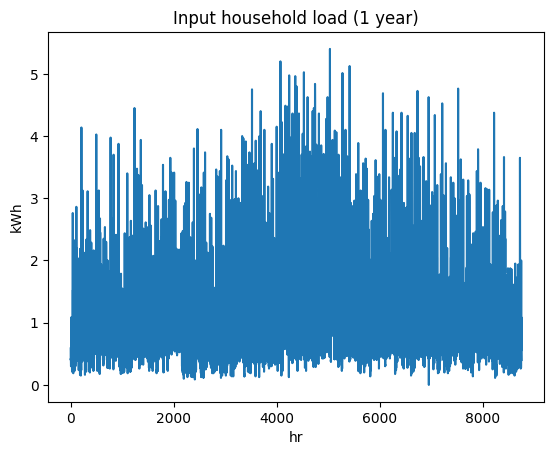

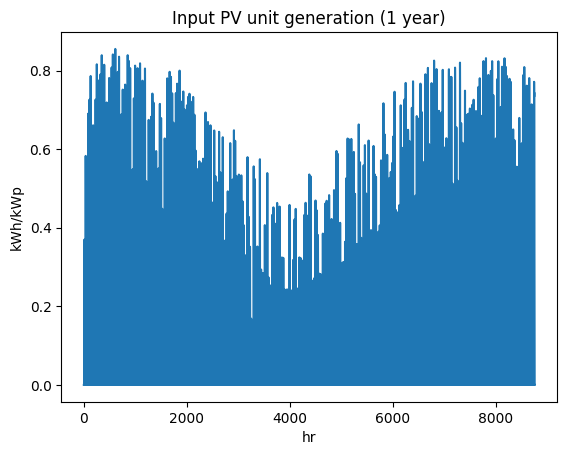

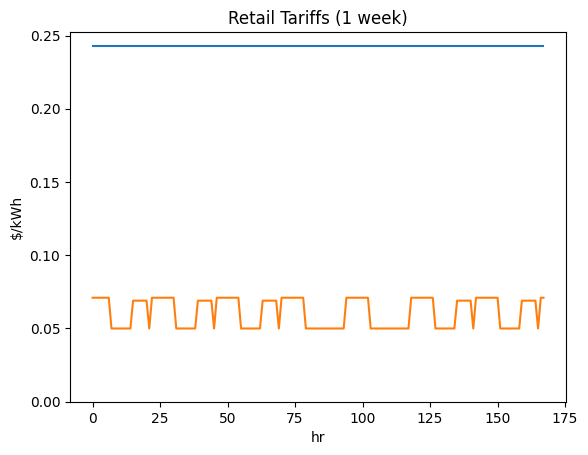

---- Optimising with PV: 1 - 20 kWp, Batt: 0 kWh. Determining PV capacity and dispatch.


************************************ Modell: PV > 1 kWp & BATT > 1 kWh ************************************
{'financial_horizon': 10, 'discount_rate': np.float64(0.06), 'grid_feedin_max': np.float64(5.0), 'pv_eol_capacity': np.float64(0.8), 'pv_eol_years': np.float64(25.0), 'pv_init_soh': np.float64(1.0), 'bess_e2p_ratio': np.float64(2.4), 'bess_roundtrip_eff': np.float64(0.88), 'bess_eol_years': np.float64(10.0), 'bess_eol_capacity': np.float64(0.7), 'bess_eol_cycles': np.float64(10000.0), 'bess_init_soh': np.float64(1.0), 'bess_eff_charge': np.float64(0.938083151964686), 'bess_eff_discharge': np.float64(0.938083151964686), 'scenario_name': 'Scenario_D_+5', 'scenario_set': 'SurfCoast', 'scenario_subset': 'JJP_open', 'year_start': 2022, 'datetime_name': 'DateTime1', 'meter_name': 'pc3072_nmi7112050531', 'solar_name': 'MELB', 'tariff_name_import_wkday': '3_Im_wkday', 'tariff_name_export_wkday': '3_

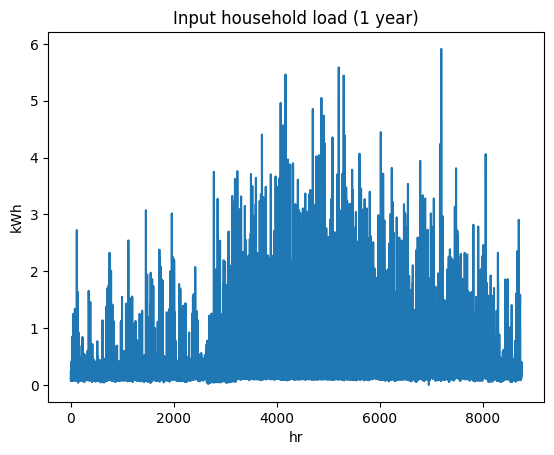

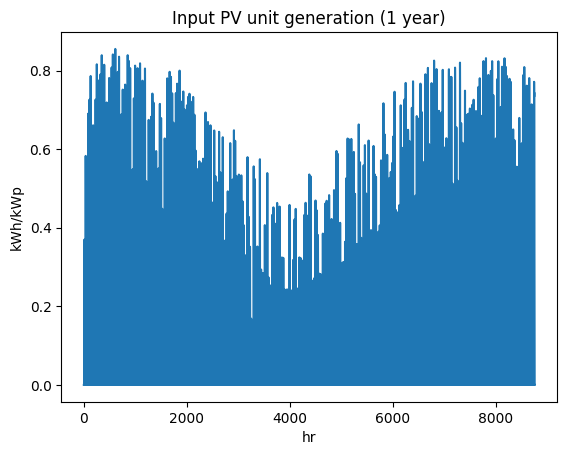

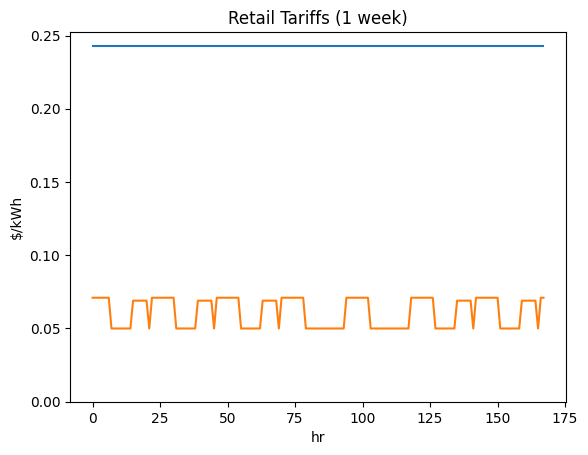

---- Optimising with PV: 1 - 20 kWp, Batt: 0 kWh. Determining PV capacity and dispatch.


************************************ Modell: PV > 1 kWp & BATT > 1 kWh ************************************
{'financial_horizon': 10, 'discount_rate': np.float64(0.06), 'grid_feedin_max': np.float64(5.0), 'pv_eol_capacity': np.float64(0.8), 'pv_eol_years': np.float64(25.0), 'pv_init_soh': np.float64(1.0), 'bess_e2p_ratio': np.float64(2.4), 'bess_roundtrip_eff': np.float64(0.88), 'bess_eol_years': np.float64(10.0), 'bess_eol_capacity': np.float64(0.7), 'bess_eol_cycles': np.float64(10000.0), 'bess_init_soh': np.float64(1.0), 'bess_eff_charge': np.float64(0.938083151964686), 'bess_eff_discharge': np.float64(0.938083151964686), 'scenario_name': 'Scenario_D_+5', 'scenario_set': 'SurfCoast', 'scenario_subset': 'JJP_open', 'year_start': 2022, 'datetime_name': 'DateTime1', 'meter_name': 'pc3072_nmi6177445704', 'solar_name': 'MELB', 'tariff_name_import_wkday': '3_Im_wkday', 'tariff_name_export_wkday': '3_

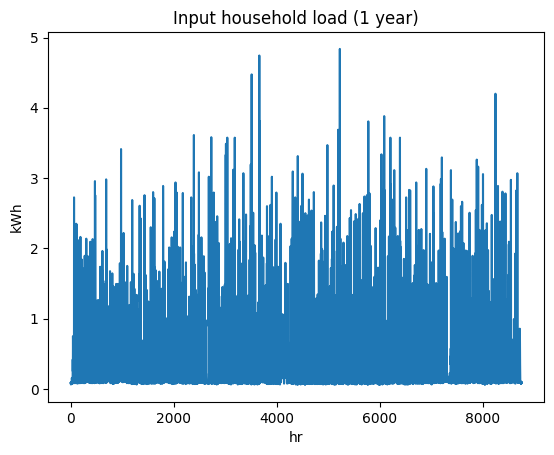

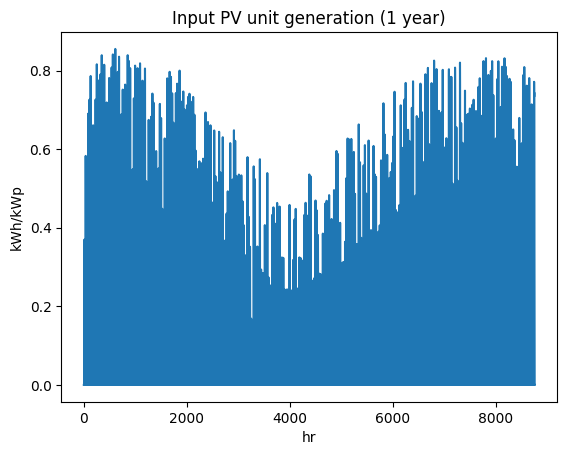

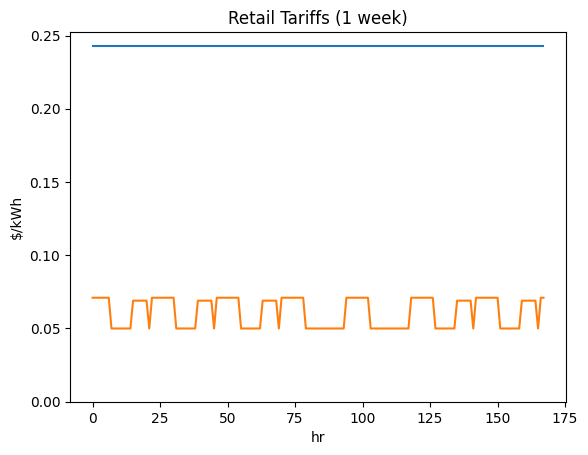

---- Optimising with PV: 1 - 20 kWp, Batt: 0 kWh. Determining PV capacity and dispatch.


************************************ Modell: PV > 1 kWp & BATT > 1 kWh ************************************
{'financial_horizon': 10, 'discount_rate': np.float64(0.06), 'grid_feedin_max': np.float64(5.0), 'pv_eol_capacity': np.float64(0.8), 'pv_eol_years': np.float64(25.0), 'pv_init_soh': np.float64(1.0), 'bess_e2p_ratio': np.float64(2.4), 'bess_roundtrip_eff': np.float64(0.88), 'bess_eol_years': np.float64(10.0), 'bess_eol_capacity': np.float64(0.7), 'bess_eol_cycles': np.float64(10000.0), 'bess_init_soh': np.float64(1.0), 'bess_eff_charge': np.float64(0.938083151964686), 'bess_eff_discharge': np.float64(0.938083151964686), 'scenario_name': 'Scenario_D_+5', 'scenario_set': 'SurfCoast', 'scenario_subset': 'JJP_open', 'year_start': 2022, 'datetime_name': 'DateTime1', 'meter_name': 'pc3072_nmi2358202759', 'solar_name': 'MELB', 'tariff_name_import_wkday': '3_Im_wkday', 'tariff_name_export_wkday': '3_

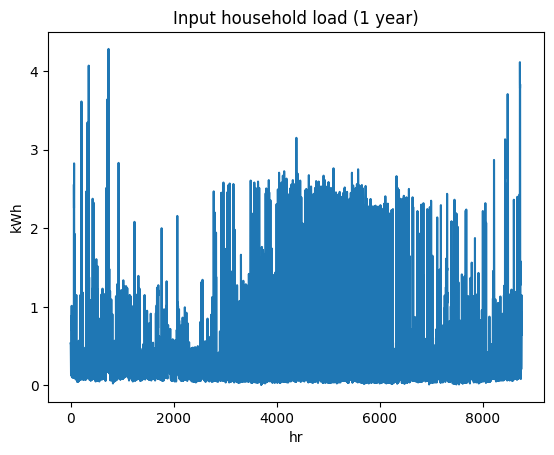

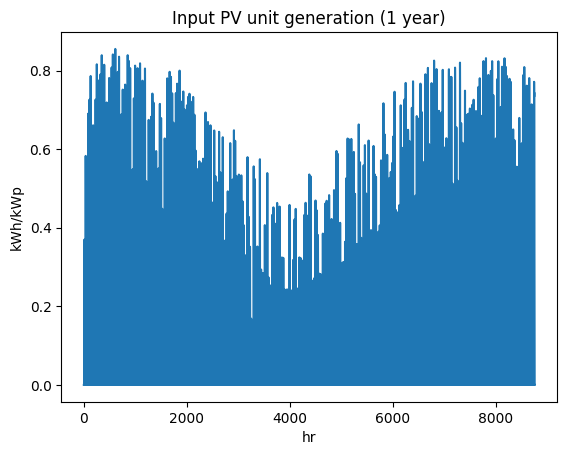

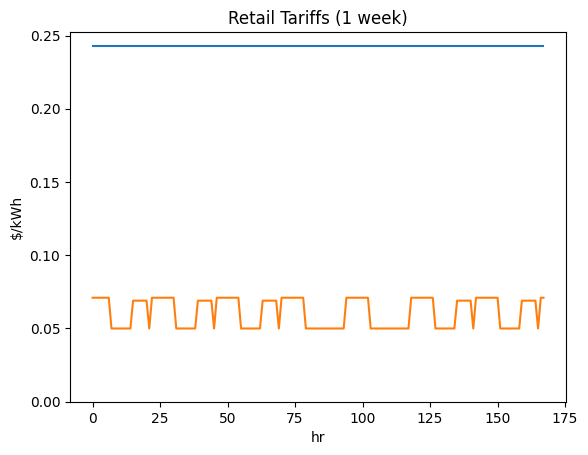

---- Optimising with PV: 1 - 20 kWp, Batt: 0 kWh. Determining PV capacity and dispatch.


************************************ Modell: PV > 1 kWp & BATT > 1 kWh ************************************
{'financial_horizon': 10, 'discount_rate': np.float64(0.06), 'grid_feedin_max': np.float64(5.0), 'pv_eol_capacity': np.float64(0.8), 'pv_eol_years': np.float64(25.0), 'pv_init_soh': np.float64(1.0), 'bess_e2p_ratio': np.float64(2.4), 'bess_roundtrip_eff': np.float64(0.88), 'bess_eol_years': np.float64(10.0), 'bess_eol_capacity': np.float64(0.7), 'bess_eol_cycles': np.float64(10000.0), 'bess_init_soh': np.float64(1.0), 'bess_eff_charge': np.float64(0.938083151964686), 'bess_eff_discharge': np.float64(0.938083151964686), 'scenario_name': 'Scenario_D_+5', 'scenario_set': 'SurfCoast', 'scenario_subset': 'JJP_open', 'year_start': 2022, 'datetime_name': 'DateTime1', 'meter_name': 'pc3072_nmi3894865442', 'solar_name': 'MELB', 'tariff_name_import_wkday': '3_Im_wkday', 'tariff_name_export_wkday': '3_

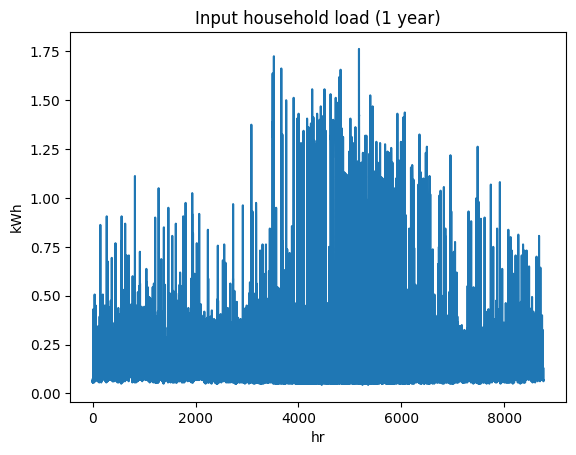

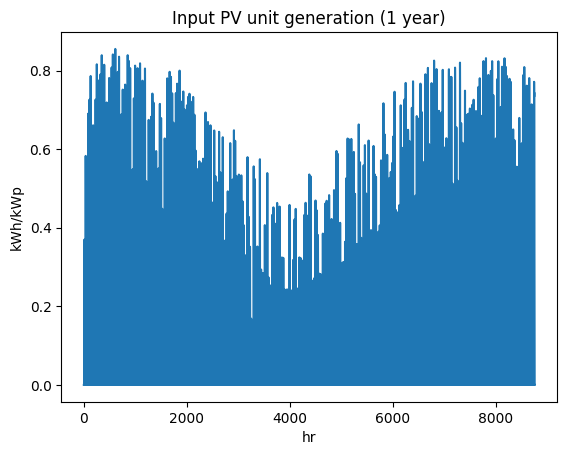

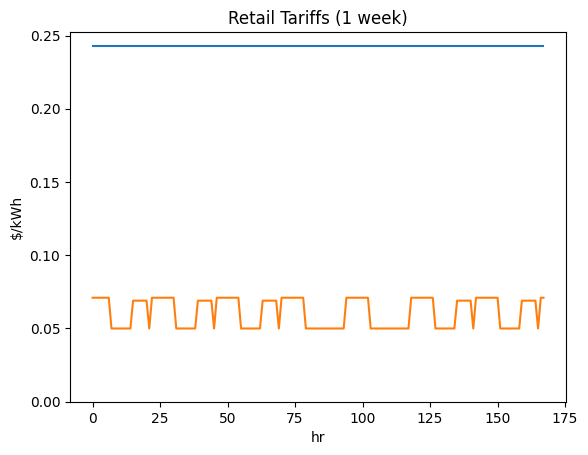

---- Optimising with PV: 1 - 20 kWp, Batt: 0 kWh. Determining PV capacity and dispatch.


************************************ Modell: PV > 1 kWp & BATT > 1 kWh ************************************
{'financial_horizon': 10, 'discount_rate': np.float64(0.06), 'grid_feedin_max': np.float64(5.0), 'pv_eol_capacity': np.float64(0.8), 'pv_eol_years': np.float64(25.0), 'pv_init_soh': np.float64(1.0), 'bess_e2p_ratio': np.float64(2.4), 'bess_roundtrip_eff': np.float64(0.88), 'bess_eol_years': np.float64(10.0), 'bess_eol_capacity': np.float64(0.7), 'bess_eol_cycles': np.float64(10000.0), 'bess_init_soh': np.float64(1.0), 'bess_eff_charge': np.float64(0.938083151964686), 'bess_eff_discharge': np.float64(0.938083151964686), 'scenario_name': 'Scenario_D_+5', 'scenario_set': 'SurfCoast', 'scenario_subset': 'JJP_open', 'year_start': 2022, 'datetime_name': 'DateTime1', 'meter_name': 'pc3072_nmi3636717422', 'solar_name': 'MELB', 'tariff_name_import_wkday': '3_Im_wkday', 'tariff_name_export_wkday': '3_

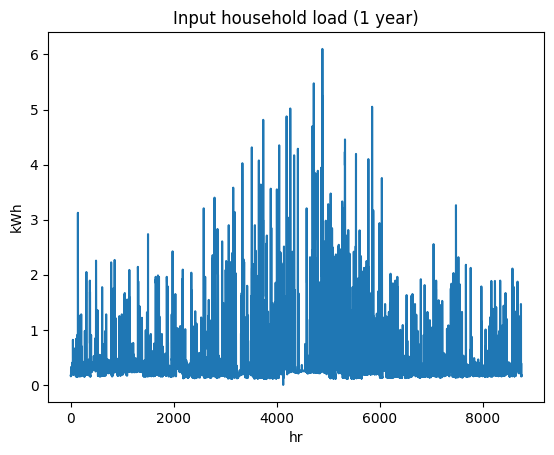

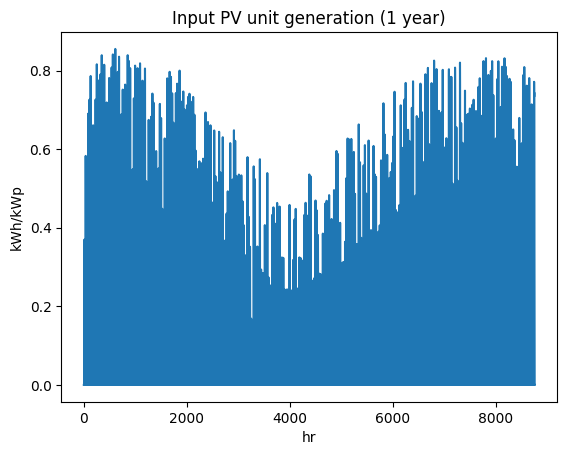

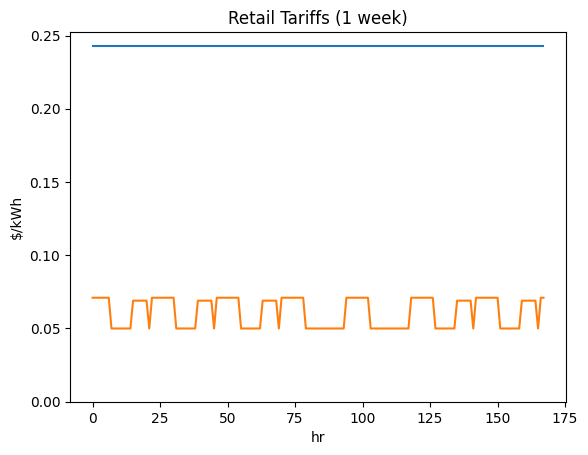

---- Optimising with PV: 1 - 20 kWp, Batt: 0 kWh. Determining PV capacity and dispatch.


************************************ Modell: PV > 1 kWp & BATT > 1 kWh ************************************
{'financial_horizon': 10, 'discount_rate': np.float64(0.06), 'grid_feedin_max': np.float64(5.0), 'pv_eol_capacity': np.float64(0.8), 'pv_eol_years': np.float64(25.0), 'pv_init_soh': np.float64(1.0), 'bess_e2p_ratio': np.float64(2.4), 'bess_roundtrip_eff': np.float64(0.88), 'bess_eol_years': np.float64(10.0), 'bess_eol_capacity': np.float64(0.7), 'bess_eol_cycles': np.float64(10000.0), 'bess_init_soh': np.float64(1.0), 'bess_eff_charge': np.float64(0.938083151964686), 'bess_eff_discharge': np.float64(0.938083151964686), 'scenario_name': 'Scenario_D_+5', 'scenario_set': 'SurfCoast', 'scenario_subset': 'JJP_open', 'year_start': 2022, 'datetime_name': 'DateTime1', 'meter_name': 'pc3072_nmi3559639475', 'solar_name': 'MELB', 'tariff_name_import_wkday': '3_Im_wkday', 'tariff_name_export_wkday': '3_

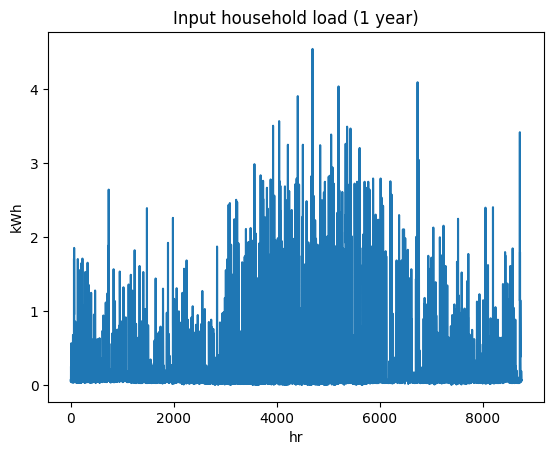

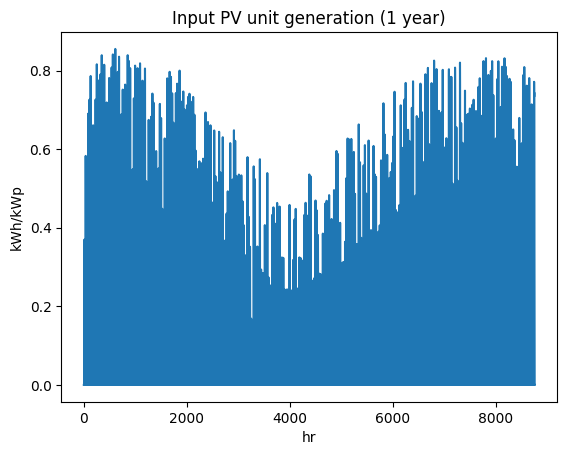

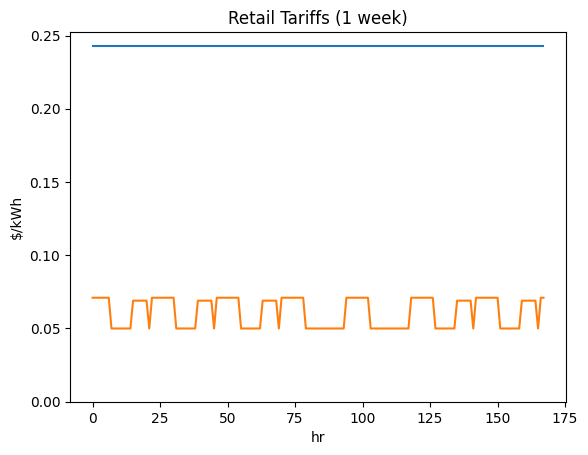

---- Optimising with PV: 1 - 20 kWp, Batt: 0 kWh. Determining PV capacity and dispatch.


************************************ Modell: PV > 1 kWp & BATT > 1 kWh ************************************
{'financial_horizon': 10, 'discount_rate': np.float64(0.06), 'grid_feedin_max': np.float64(5.0), 'pv_eol_capacity': np.float64(0.8), 'pv_eol_years': np.float64(25.0), 'pv_init_soh': np.float64(1.0), 'bess_e2p_ratio': np.float64(2.4), 'bess_roundtrip_eff': np.float64(0.88), 'bess_eol_years': np.float64(10.0), 'bess_eol_capacity': np.float64(0.7), 'bess_eol_cycles': np.float64(10000.0), 'bess_init_soh': np.float64(1.0), 'bess_eff_charge': np.float64(0.938083151964686), 'bess_eff_discharge': np.float64(0.938083151964686), 'scenario_name': 'Scenario_D_+5', 'scenario_set': 'SurfCoast', 'scenario_subset': 'JJP_open', 'year_start': 2022, 'datetime_name': 'DateTime1', 'meter_name': 'pc3072_nmi9701360572', 'solar_name': 'MELB', 'tariff_name_import_wkday': '3_Im_wkday', 'tariff_name_export_wkday': '3_

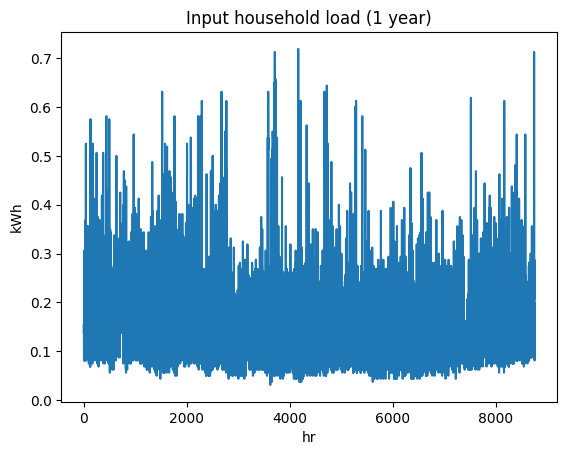

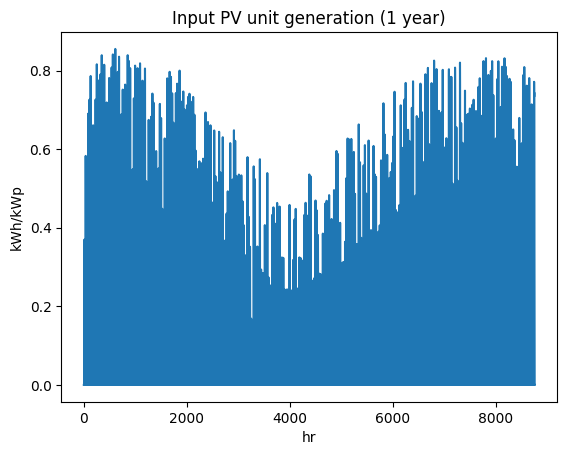

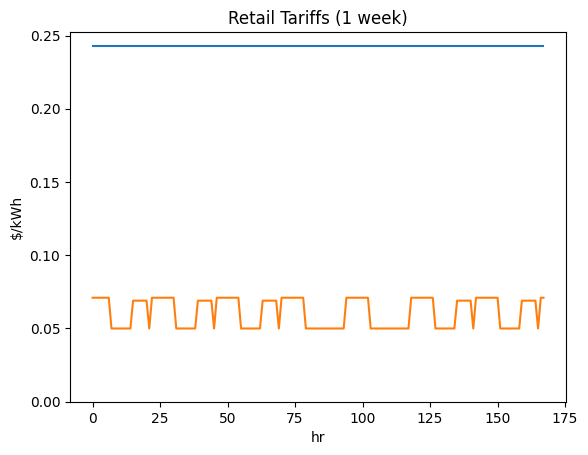

---- Optimising with PV: 1 - 20 kWp, Batt: 0 kWh. Determining PV capacity and dispatch.


************************************ Modell: PV > 1 kWp & BATT > 1 kWh ************************************
{'financial_horizon': 10, 'discount_rate': np.float64(0.06), 'grid_feedin_max': np.float64(5.0), 'pv_eol_capacity': np.float64(0.8), 'pv_eol_years': np.float64(25.0), 'pv_init_soh': np.float64(1.0), 'bess_e2p_ratio': np.float64(2.4), 'bess_roundtrip_eff': np.float64(0.88), 'bess_eol_years': np.float64(10.0), 'bess_eol_capacity': np.float64(0.7), 'bess_eol_cycles': np.float64(10000.0), 'bess_init_soh': np.float64(1.0), 'bess_eff_charge': np.float64(0.938083151964686), 'bess_eff_discharge': np.float64(0.938083151964686), 'scenario_name': 'Scenario_D_+5', 'scenario_set': 'SurfCoast', 'scenario_subset': 'JJP_open', 'year_start': 2022, 'datetime_name': 'DateTime1', 'meter_name': 'pc3072_nmi9230334752', 'solar_name': 'MELB', 'tariff_name_import_wkday': '3_Im_wkday', 'tariff_name_export_wkday': '3_

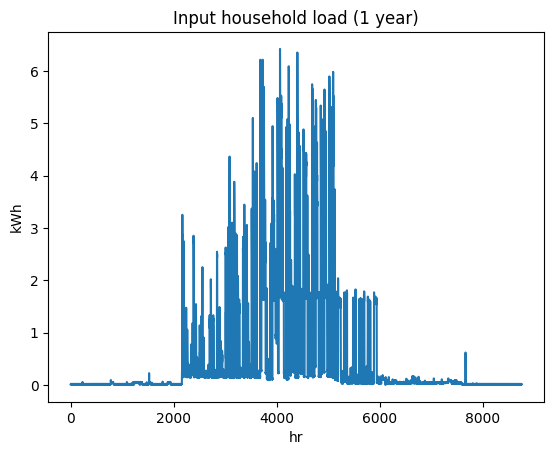

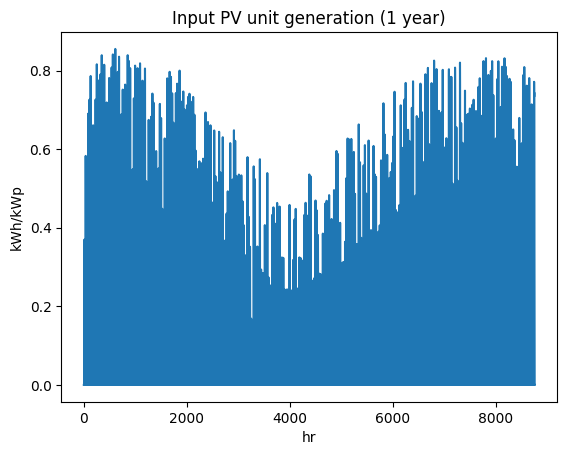

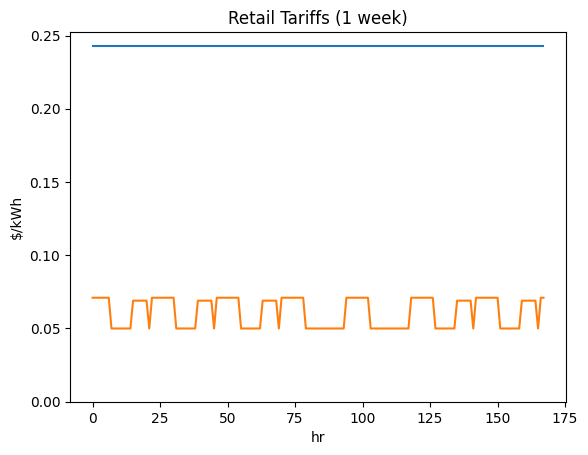

---- Optimising with PV: 1 - 20 kWp, Batt: 0 kWh. Determining PV capacity and dispatch.


************************************ Modell: PV > 1 kWp & BATT > 1 kWh ************************************
{'financial_horizon': 10, 'discount_rate': np.float64(0.06), 'grid_feedin_max': np.float64(5.0), 'pv_eol_capacity': np.float64(0.8), 'pv_eol_years': np.float64(25.0), 'pv_init_soh': np.float64(1.0), 'bess_e2p_ratio': np.float64(2.4), 'bess_roundtrip_eff': np.float64(0.88), 'bess_eol_years': np.float64(10.0), 'bess_eol_capacity': np.float64(0.7), 'bess_eol_cycles': np.float64(10000.0), 'bess_init_soh': np.float64(1.0), 'bess_eff_charge': np.float64(0.938083151964686), 'bess_eff_discharge': np.float64(0.938083151964686), 'scenario_name': 'Scenario_D_+5', 'scenario_set': 'SurfCoast', 'scenario_subset': 'JJP_open', 'year_start': 2022, 'datetime_name': 'DateTime1', 'meter_name': 'pc3016_nmi5661791755', 'solar_name': 'MELB', 'tariff_name_import_wkday': '3_Im_wkday', 'tariff_name_export_wkday': '3_

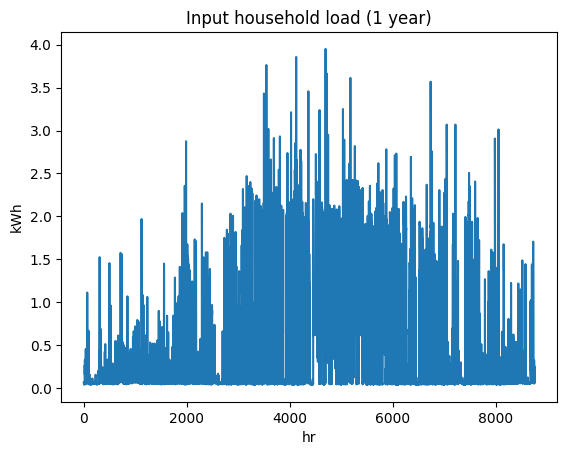

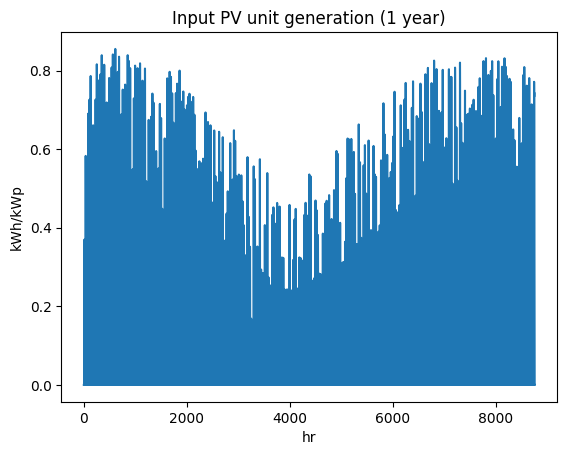

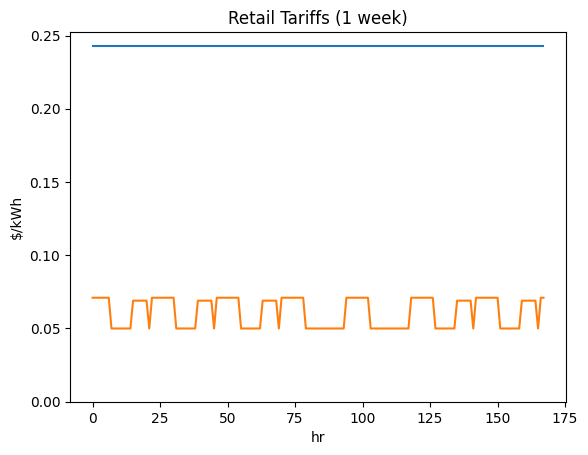

---- Optimising with PV: 1 - 20 kWp, Batt: 0 kWh. Determining PV capacity and dispatch.


************************************ Modell: PV > 1 kWp & BATT > 1 kWh ************************************
{'financial_horizon': 10, 'discount_rate': np.float64(0.06), 'grid_feedin_max': np.float64(5.0), 'pv_eol_capacity': np.float64(0.8), 'pv_eol_years': np.float64(25.0), 'pv_init_soh': np.float64(1.0), 'bess_e2p_ratio': np.float64(2.4), 'bess_roundtrip_eff': np.float64(0.88), 'bess_eol_years': np.float64(10.0), 'bess_eol_capacity': np.float64(0.7), 'bess_eol_cycles': np.float64(10000.0), 'bess_init_soh': np.float64(1.0), 'bess_eff_charge': np.float64(0.938083151964686), 'bess_eff_discharge': np.float64(0.938083151964686), 'scenario_name': 'Scenario_D_+5', 'scenario_set': 'SurfCoast', 'scenario_subset': 'JJP_open', 'year_start': 2022, 'datetime_name': 'DateTime1', 'meter_name': 'pc3016_nmi5103435332', 'solar_name': 'MELB', 'tariff_name_import_wkday': '3_Im_wkday', 'tariff_name_export_wkday': '3_

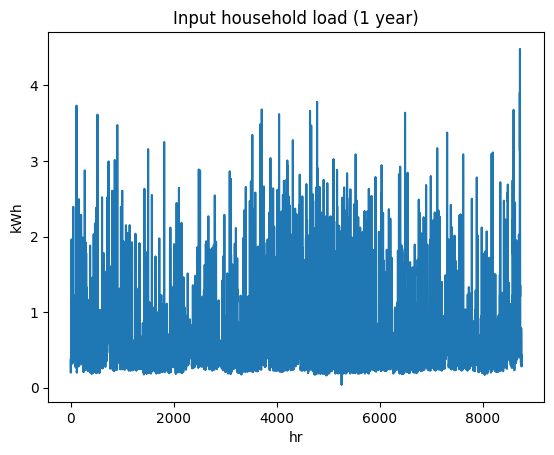

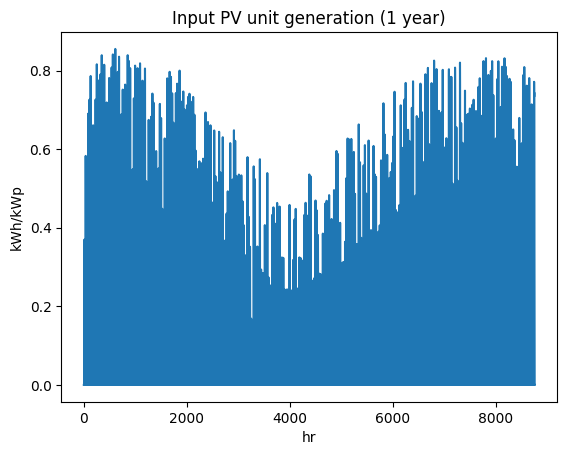

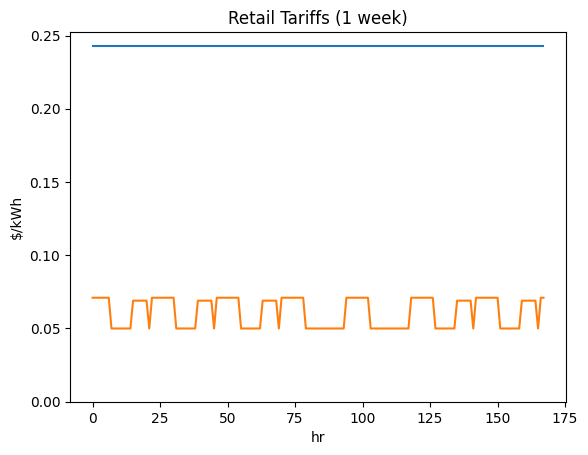

---- Optimising with PV: 1 - 20 kWp, Batt: 0 kWh. Determining PV capacity and dispatch.


************************************ Modell: PV > 1 kWp & BATT > 1 kWh ************************************
{'financial_horizon': 10, 'discount_rate': np.float64(0.06), 'grid_feedin_max': np.float64(5.0), 'pv_eol_capacity': np.float64(0.8), 'pv_eol_years': np.float64(25.0), 'pv_init_soh': np.float64(1.0), 'bess_e2p_ratio': np.float64(2.4), 'bess_roundtrip_eff': np.float64(0.88), 'bess_eol_years': np.float64(10.0), 'bess_eol_capacity': np.float64(0.7), 'bess_eol_cycles': np.float64(10000.0), 'bess_init_soh': np.float64(1.0), 'bess_eff_charge': np.float64(0.938083151964686), 'bess_eff_discharge': np.float64(0.938083151964686), 'scenario_name': 'Scenario_D_+5', 'scenario_set': 'SurfCoast', 'scenario_subset': 'JJP_open', 'year_start': 2022, 'datetime_name': 'DateTime1', 'meter_name': 'pc3016_nmi8967049212', 'solar_name': 'MELB', 'tariff_name_import_wkday': '3_Im_wkday', 'tariff_name_export_wkday': '3_

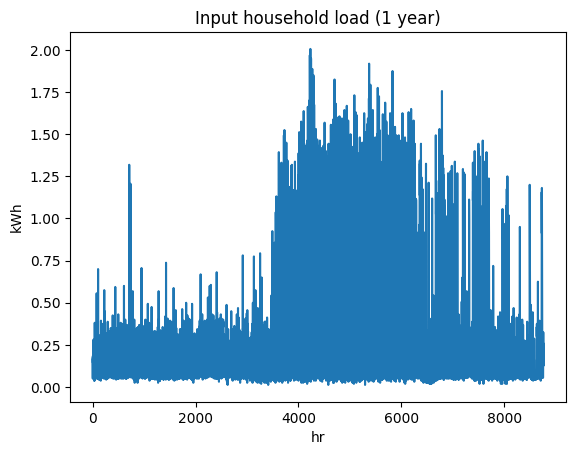

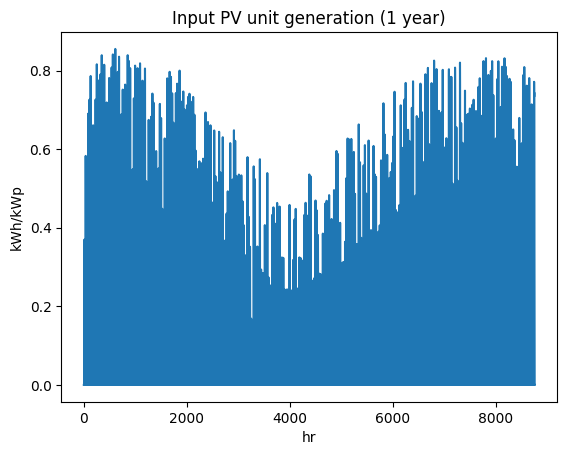

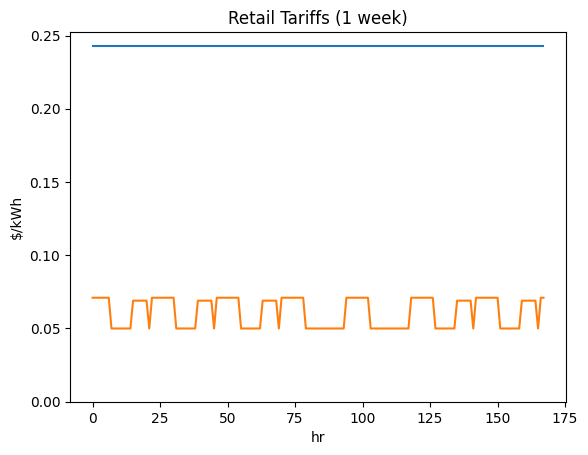

---- Optimising with PV: 1 - 20 kWp, Batt: 0 kWh. Determining PV capacity and dispatch.


************************************ Modell: PV > 1 kWp & BATT > 1 kWh ************************************
{'financial_horizon': 10, 'discount_rate': np.float64(0.06), 'grid_feedin_max': np.float64(5.0), 'pv_eol_capacity': np.float64(0.8), 'pv_eol_years': np.float64(25.0), 'pv_init_soh': np.float64(1.0), 'bess_e2p_ratio': np.float64(2.4), 'bess_roundtrip_eff': np.float64(0.88), 'bess_eol_years': np.float64(10.0), 'bess_eol_capacity': np.float64(0.7), 'bess_eol_cycles': np.float64(10000.0), 'bess_init_soh': np.float64(1.0), 'bess_eff_charge': np.float64(0.938083151964686), 'bess_eff_discharge': np.float64(0.938083151964686), 'scenario_name': 'Scenario_D_+5', 'scenario_set': 'SurfCoast', 'scenario_subset': 'JJP_open', 'year_start': 2022, 'datetime_name': 'DateTime1', 'meter_name': 'pc3016_nmi6127210259', 'solar_name': 'MELB', 'tariff_name_import_wkday': '3_Im_wkday', 'tariff_name_export_wkday': '3_

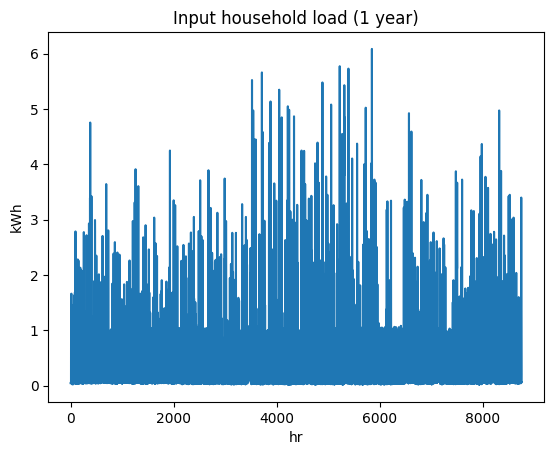

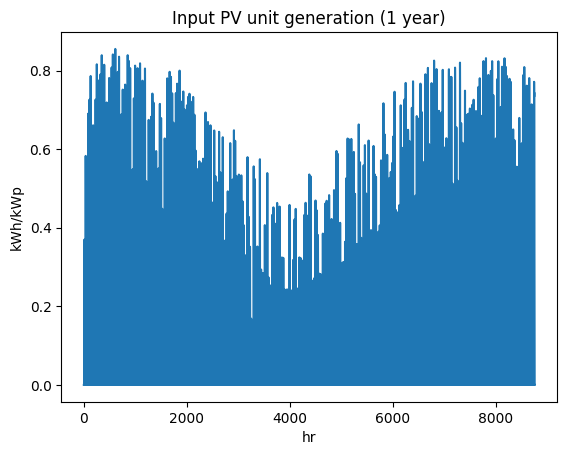

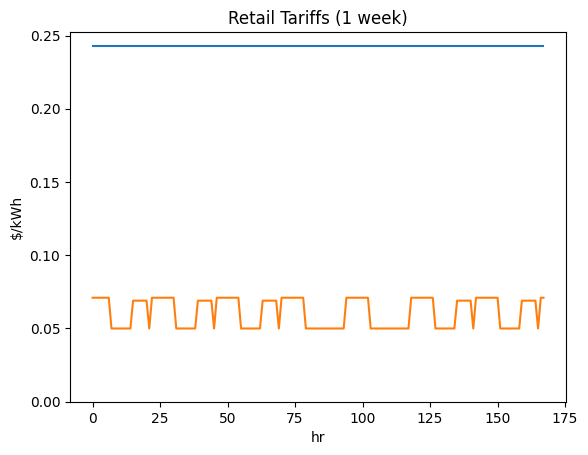

---- Optimising with PV: 1 - 20 kWp, Batt: 0 kWh. Determining PV capacity and dispatch.


************************************ Modell: PV > 1 kWp & BATT > 1 kWh ************************************
{'financial_horizon': 10, 'discount_rate': np.float64(0.06), 'grid_feedin_max': np.float64(5.0), 'pv_eol_capacity': np.float64(0.8), 'pv_eol_years': np.float64(25.0), 'pv_init_soh': np.float64(1.0), 'bess_e2p_ratio': np.float64(2.4), 'bess_roundtrip_eff': np.float64(0.88), 'bess_eol_years': np.float64(10.0), 'bess_eol_capacity': np.float64(0.7), 'bess_eol_cycles': np.float64(10000.0), 'bess_init_soh': np.float64(1.0), 'bess_eff_charge': np.float64(0.938083151964686), 'bess_eff_discharge': np.float64(0.938083151964686), 'scenario_name': 'Scenario_D_+5', 'scenario_set': 'SurfCoast', 'scenario_subset': 'JJP_open', 'year_start': 2022, 'datetime_name': 'DateTime1', 'meter_name': 'pc3016_nmi9660424257', 'solar_name': 'MELB', 'tariff_name_import_wkday': '3_Im_wkday', 'tariff_name_export_wkday': '3_

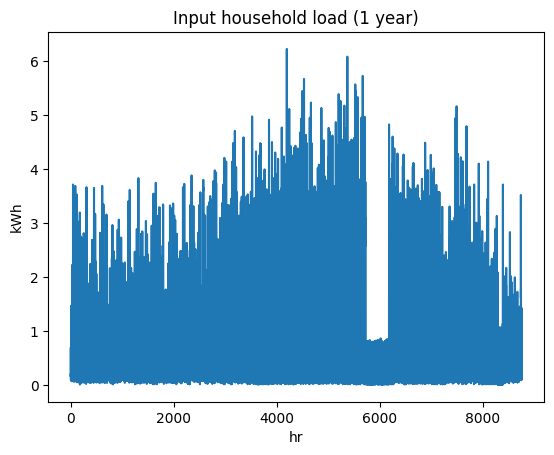

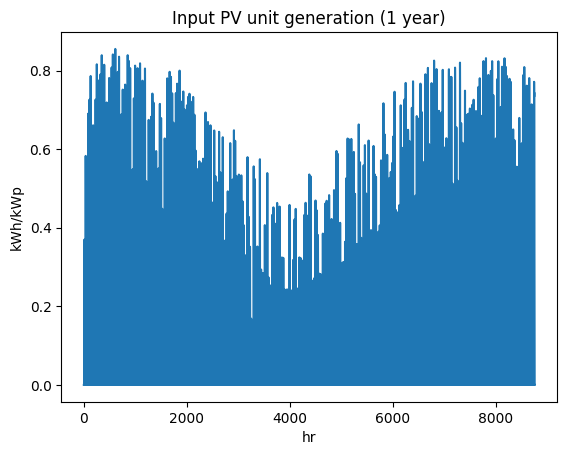

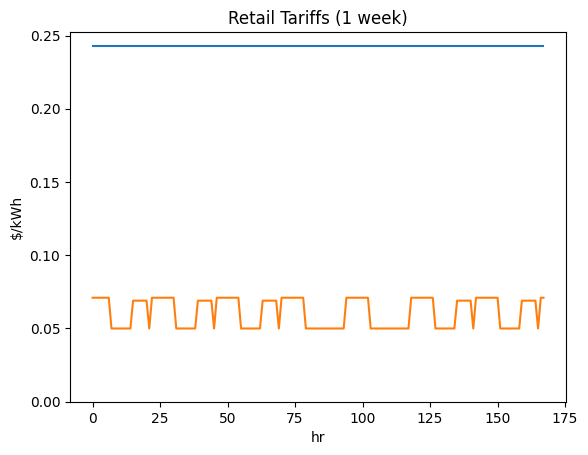

---- Optimising with PV: 1 - 20 kWp, Batt: 0 kWh. Determining PV capacity and dispatch.


************************************ Modell: PV > 1 kWp & BATT > 1 kWh ************************************
{'financial_horizon': 10, 'discount_rate': np.float64(0.06), 'grid_feedin_max': np.float64(5.0), 'pv_eol_capacity': np.float64(0.8), 'pv_eol_years': np.float64(25.0), 'pv_init_soh': np.float64(1.0), 'bess_e2p_ratio': np.float64(2.4), 'bess_roundtrip_eff': np.float64(0.88), 'bess_eol_years': np.float64(10.0), 'bess_eol_capacity': np.float64(0.7), 'bess_eol_cycles': np.float64(10000.0), 'bess_init_soh': np.float64(1.0), 'bess_eff_charge': np.float64(0.938083151964686), 'bess_eff_discharge': np.float64(0.938083151964686), 'scenario_name': 'Scenario_D_+5', 'scenario_set': 'SurfCoast', 'scenario_subset': 'JJP_open', 'year_start': 2022, 'datetime_name': 'DateTime1', 'meter_name': 'pc3016_nmi6141144759', 'solar_name': 'MELB', 'tariff_name_import_wkday': '3_Im_wkday', 'tariff_name_export_wkday': '3_

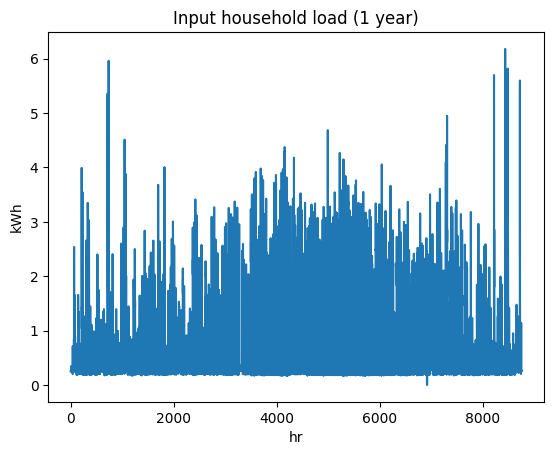

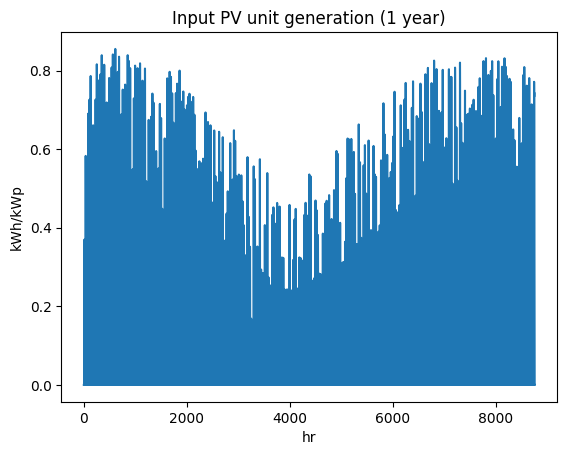

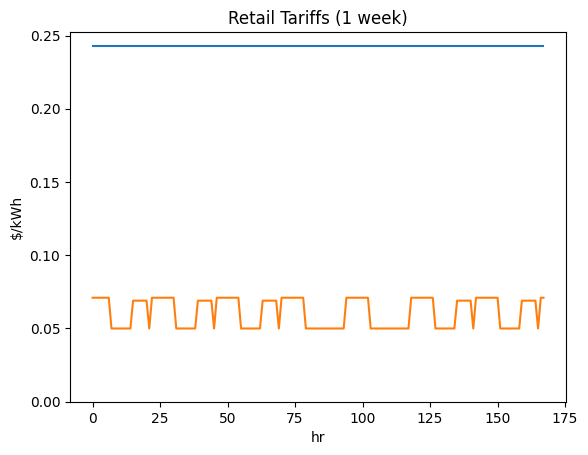

---- Optimising with PV: 1 - 20 kWp, Batt: 0 kWh. Determining PV capacity and dispatch.


************************************ Modell: PV > 1 kWp & BATT > 1 kWh ************************************
{'financial_horizon': 10, 'discount_rate': np.float64(0.06), 'grid_feedin_max': np.float64(5.0), 'pv_eol_capacity': np.float64(0.8), 'pv_eol_years': np.float64(25.0), 'pv_init_soh': np.float64(1.0), 'bess_e2p_ratio': np.float64(2.4), 'bess_roundtrip_eff': np.float64(0.88), 'bess_eol_years': np.float64(10.0), 'bess_eol_capacity': np.float64(0.7), 'bess_eol_cycles': np.float64(10000.0), 'bess_init_soh': np.float64(1.0), 'bess_eff_charge': np.float64(0.938083151964686), 'bess_eff_discharge': np.float64(0.938083151964686), 'scenario_name': 'Scenario_D_+5', 'scenario_set': 'SurfCoast', 'scenario_subset': 'JJP_open', 'year_start': 2022, 'datetime_name': 'DateTime1', 'meter_name': 'pc3016_nmi4276855499', 'solar_name': 'MELB', 'tariff_name_import_wkday': '3_Im_wkday', 'tariff_name_export_wkday': '3_

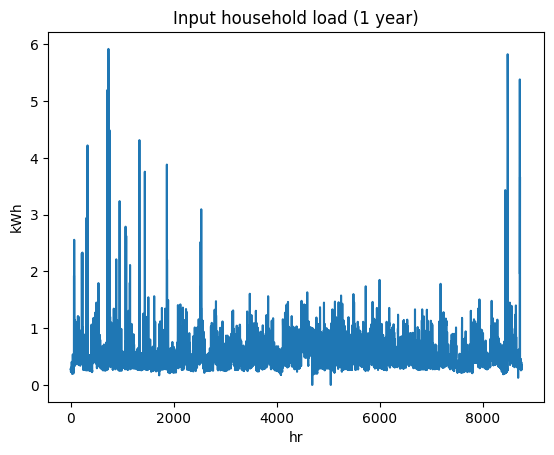

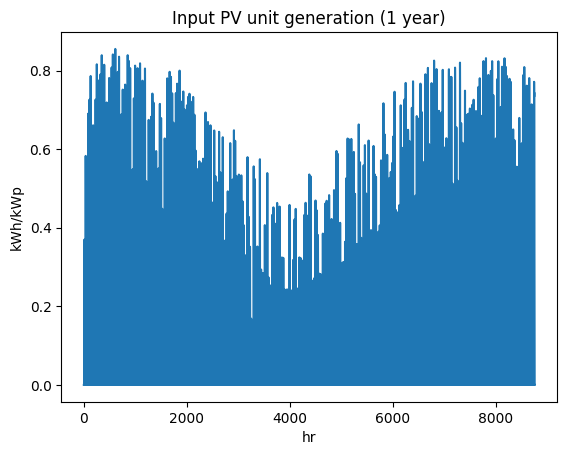

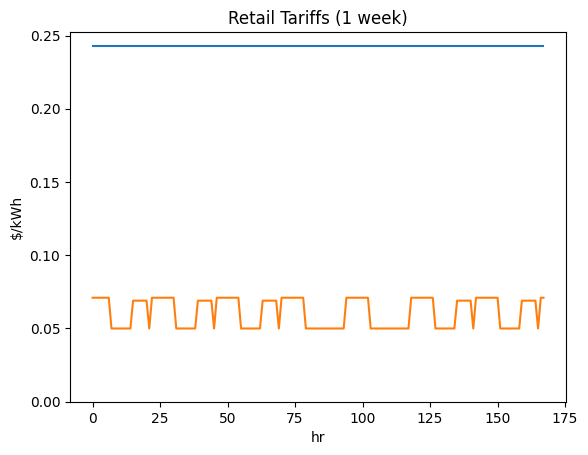

---- Optimising with PV: 1 - 20 kWp, Batt: 0 kWh. Determining PV capacity and dispatch.


************************************ Modell: PV > 1 kWp & BATT > 1 kWh ************************************
{'financial_horizon': 10, 'discount_rate': np.float64(0.06), 'grid_feedin_max': np.float64(5.0), 'pv_eol_capacity': np.float64(0.8), 'pv_eol_years': np.float64(25.0), 'pv_init_soh': np.float64(1.0), 'bess_e2p_ratio': np.float64(2.4), 'bess_roundtrip_eff': np.float64(0.88), 'bess_eol_years': np.float64(10.0), 'bess_eol_capacity': np.float64(0.7), 'bess_eol_cycles': np.float64(10000.0), 'bess_init_soh': np.float64(1.0), 'bess_eff_charge': np.float64(0.938083151964686), 'bess_eff_discharge': np.float64(0.938083151964686), 'scenario_name': 'Scenario_D_+5', 'scenario_set': 'SurfCoast', 'scenario_subset': 'JJP_open', 'year_start': 2022, 'datetime_name': 'DateTime1', 'meter_name': 'pc3016_nmi2496742748', 'solar_name': 'MELB', 'tariff_name_import_wkday': '3_Im_wkday', 'tariff_name_export_wkday': '3_

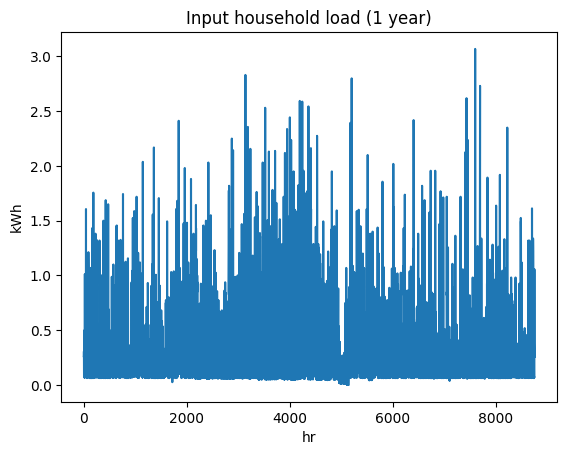

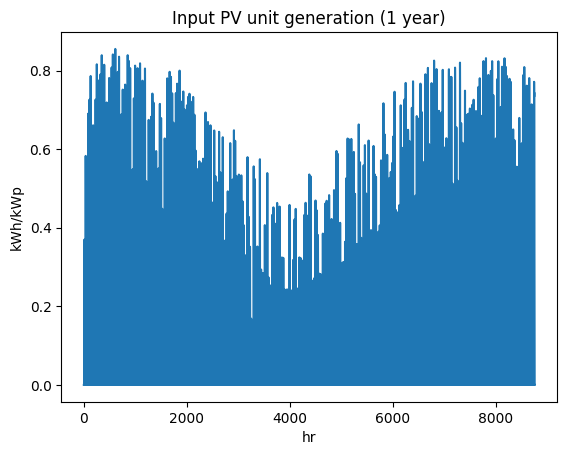

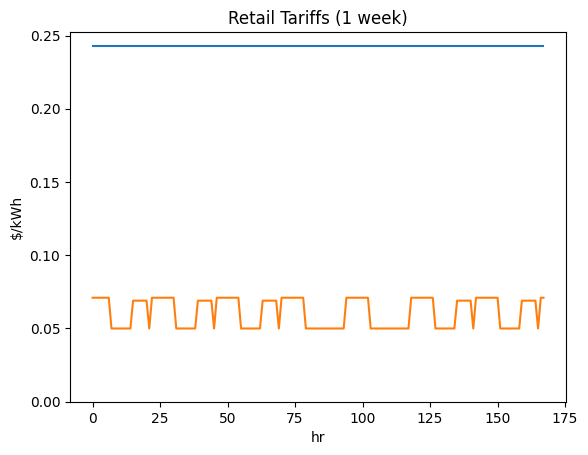

---- Optimising with PV: 1 - 20 kWp, Batt: 0 kWh. Determining PV capacity and dispatch.


************************************ Modell: PV > 1 kWp & BATT > 1 kWh ************************************
{'financial_horizon': 10, 'discount_rate': np.float64(0.06), 'grid_feedin_max': np.float64(5.0), 'pv_eol_capacity': np.float64(0.8), 'pv_eol_years': np.float64(25.0), 'pv_init_soh': np.float64(1.0), 'bess_e2p_ratio': np.float64(2.4), 'bess_roundtrip_eff': np.float64(0.88), 'bess_eol_years': np.float64(10.0), 'bess_eol_capacity': np.float64(0.7), 'bess_eol_cycles': np.float64(10000.0), 'bess_init_soh': np.float64(1.0), 'bess_eff_charge': np.float64(0.938083151964686), 'bess_eff_discharge': np.float64(0.938083151964686), 'scenario_name': 'Scenario_D_+5', 'scenario_set': 'SurfCoast', 'scenario_subset': 'JJP_open', 'year_start': 2022, 'datetime_name': 'DateTime1', 'meter_name': 'pc3016_nmi9343961054', 'solar_name': 'MELB', 'tariff_name_import_wkday': '3_Im_wkday', 'tariff_name_export_wkday': '3_

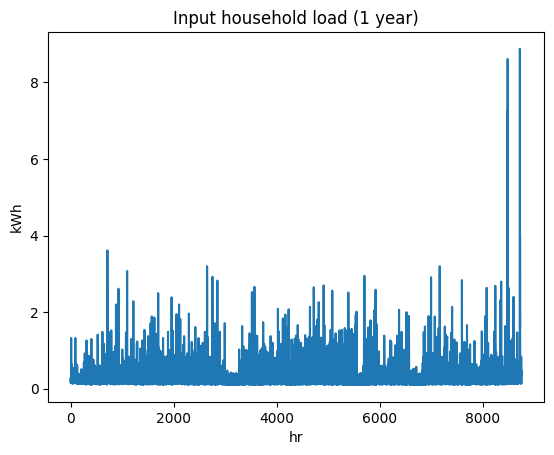

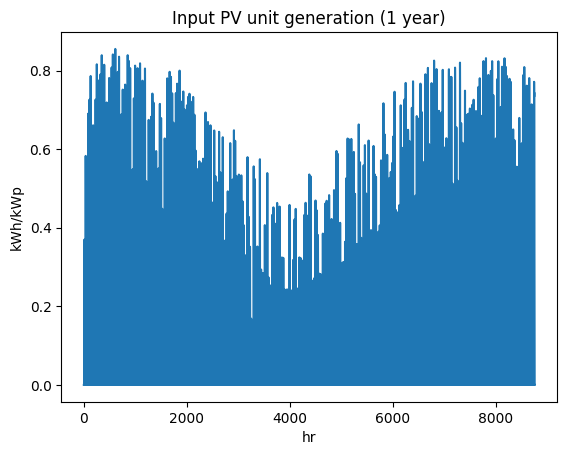

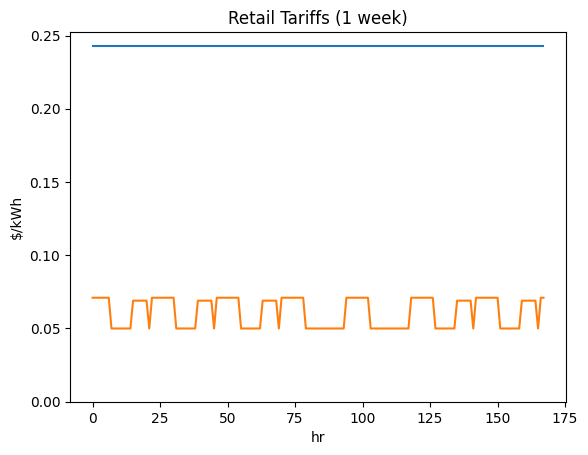

---- Optimising with PV: 1 - 20 kWp, Batt: 0 kWh. Determining PV capacity and dispatch.


************************************ Modell: PV > 1 kWp & BATT > 1 kWh ************************************
{'financial_horizon': 10, 'discount_rate': np.float64(0.06), 'grid_feedin_max': np.float64(5.0), 'pv_eol_capacity': np.float64(0.8), 'pv_eol_years': np.float64(25.0), 'pv_init_soh': np.float64(1.0), 'bess_e2p_ratio': np.float64(2.4), 'bess_roundtrip_eff': np.float64(0.88), 'bess_eol_years': np.float64(10.0), 'bess_eol_capacity': np.float64(0.7), 'bess_eol_cycles': np.float64(10000.0), 'bess_init_soh': np.float64(1.0), 'bess_eff_charge': np.float64(0.938083151964686), 'bess_eff_discharge': np.float64(0.938083151964686), 'scenario_name': 'Scenario_D_+5', 'scenario_set': 'SurfCoast', 'scenario_subset': 'JJP_open', 'year_start': 2022, 'datetime_name': 'DateTime1', 'meter_name': 'pc3016_nmi2343504168', 'solar_name': 'MELB', 'tariff_name_import_wkday': '3_Im_wkday', 'tariff_name_export_wkday': '3_

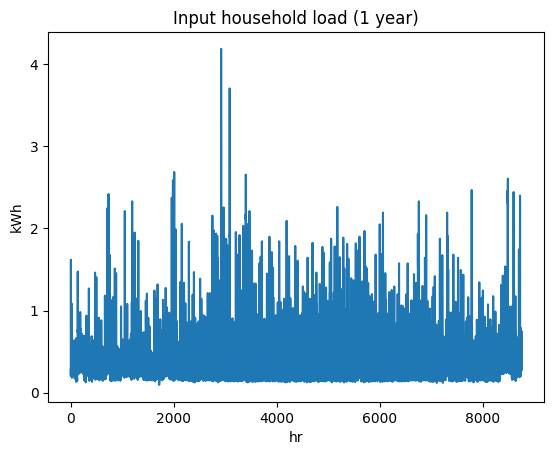

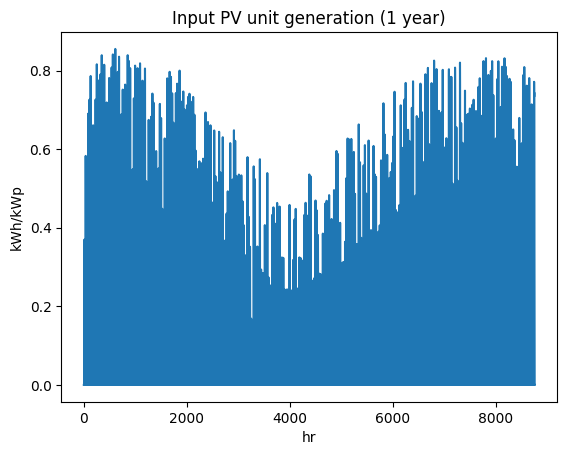

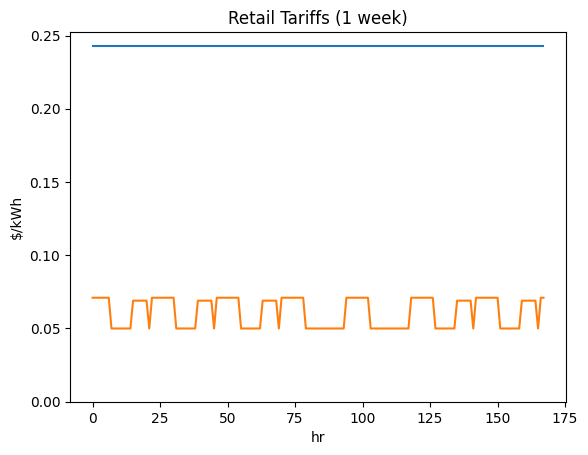

---- Optimising with PV: 1 - 20 kWp, Batt: 0 kWh. Determining PV capacity and dispatch.


************************************ Modell: PV > 1 kWp & BATT > 1 kWh ************************************
{'financial_horizon': 10, 'discount_rate': np.float64(0.06), 'grid_feedin_max': np.float64(5.0), 'pv_eol_capacity': np.float64(0.8), 'pv_eol_years': np.float64(25.0), 'pv_init_soh': np.float64(1.0), 'bess_e2p_ratio': np.float64(2.4), 'bess_roundtrip_eff': np.float64(0.88), 'bess_eol_years': np.float64(10.0), 'bess_eol_capacity': np.float64(0.7), 'bess_eol_cycles': np.float64(10000.0), 'bess_init_soh': np.float64(1.0), 'bess_eff_charge': np.float64(0.938083151964686), 'bess_eff_discharge': np.float64(0.938083151964686), 'scenario_name': 'Scenario_D_+5', 'scenario_set': 'SurfCoast', 'scenario_subset': 'JJP_open', 'year_start': 2022, 'datetime_name': 'DateTime1', 'meter_name': 'pc3016_nmi2923860863', 'solar_name': 'MELB', 'tariff_name_import_wkday': '3_Im_wkday', 'tariff_name_export_wkday': '3_

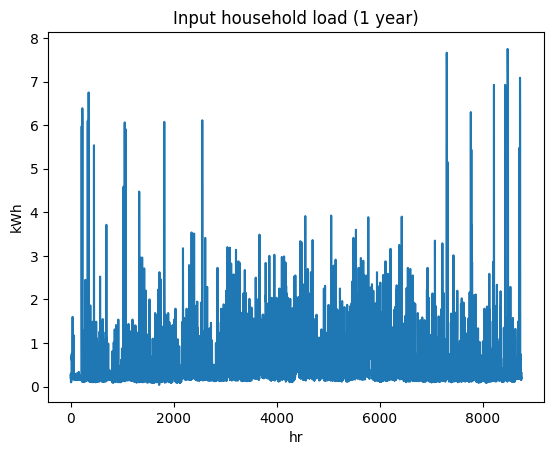

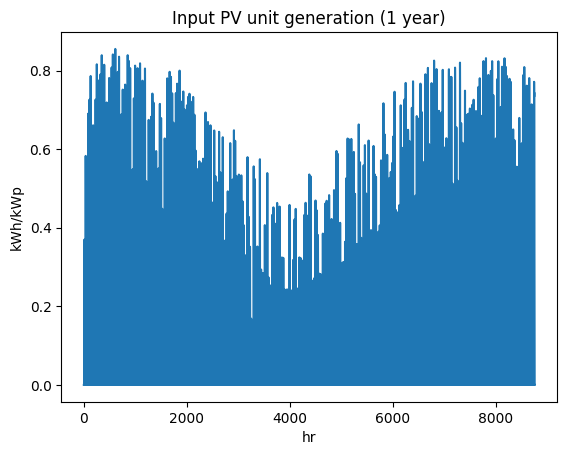

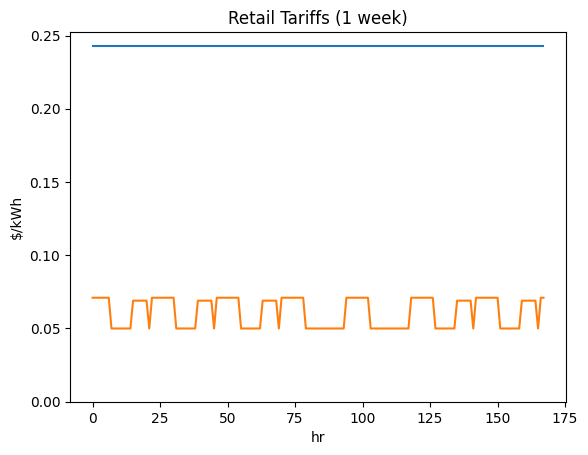

---- Optimising with PV: 1 - 20 kWp, Batt: 0 kWh. Determining PV capacity and dispatch.


************************************ Modell: PV > 1 kWp & BATT > 1 kWh ************************************
{'financial_horizon': 10, 'discount_rate': np.float64(0.06), 'grid_feedin_max': np.float64(5.0), 'pv_eol_capacity': np.float64(0.8), 'pv_eol_years': np.float64(25.0), 'pv_init_soh': np.float64(1.0), 'bess_e2p_ratio': np.float64(2.4), 'bess_roundtrip_eff': np.float64(0.88), 'bess_eol_years': np.float64(10.0), 'bess_eol_capacity': np.float64(0.7), 'bess_eol_cycles': np.float64(10000.0), 'bess_init_soh': np.float64(1.0), 'bess_eff_charge': np.float64(0.938083151964686), 'bess_eff_discharge': np.float64(0.938083151964686), 'scenario_name': 'Scenario_D_+5', 'scenario_set': 'SurfCoast', 'scenario_subset': 'JJP_open', 'year_start': 2022, 'datetime_name': 'DateTime1', 'meter_name': 'pc3016_nmi1470353124', 'solar_name': 'MELB', 'tariff_name_import_wkday': '3_Im_wkday', 'tariff_name_export_wkday': '3_

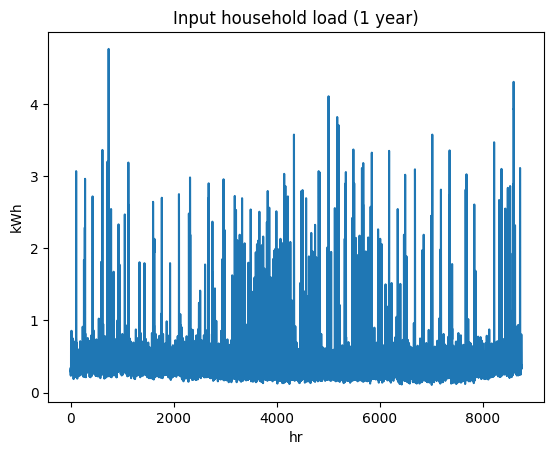

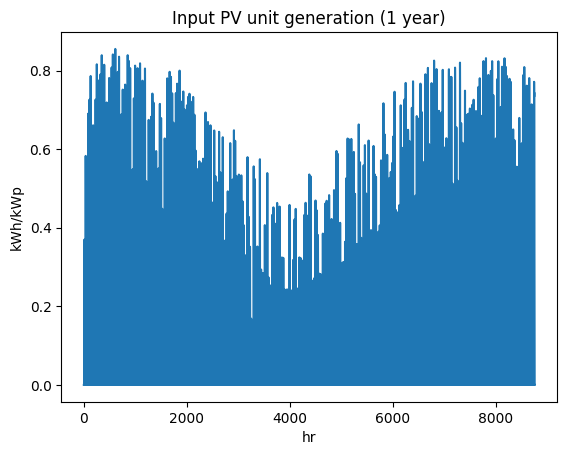

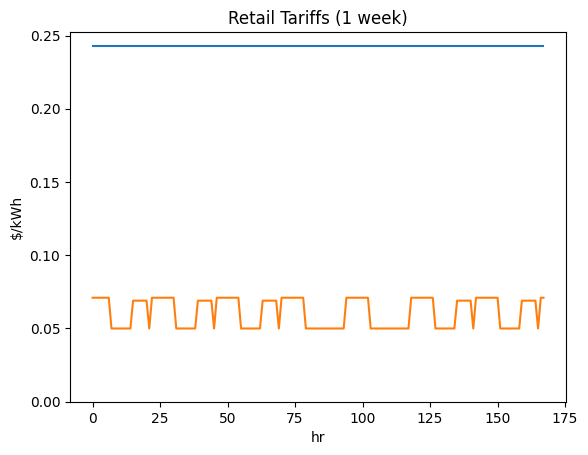

---- Optimising with PV: 1 - 20 kWp, Batt: 0 kWh. Determining PV capacity and dispatch.


************************************ Modell: PV > 1 kWp & BATT > 1 kWh ************************************
{'financial_horizon': 10, 'discount_rate': np.float64(0.06), 'grid_feedin_max': np.float64(5.0), 'pv_eol_capacity': np.float64(0.8), 'pv_eol_years': np.float64(25.0), 'pv_init_soh': np.float64(1.0), 'bess_e2p_ratio': np.float64(2.4), 'bess_roundtrip_eff': np.float64(0.88), 'bess_eol_years': np.float64(10.0), 'bess_eol_capacity': np.float64(0.7), 'bess_eol_cycles': np.float64(10000.0), 'bess_init_soh': np.float64(1.0), 'bess_eff_charge': np.float64(0.938083151964686), 'bess_eff_discharge': np.float64(0.938083151964686), 'scenario_name': 'Scenario_D_+5', 'scenario_set': 'SurfCoast', 'scenario_subset': 'JJP_open', 'year_start': 2022, 'datetime_name': 'DateTime1', 'meter_name': 'pc3016_nmi8174211311', 'solar_name': 'MELB', 'tariff_name_import_wkday': '3_Im_wkday', 'tariff_name_export_wkday': '3_

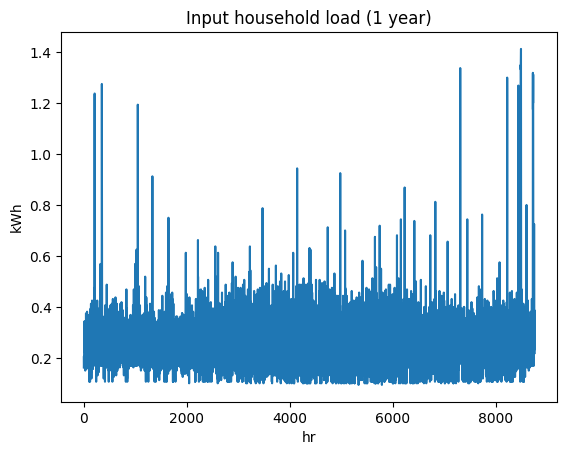

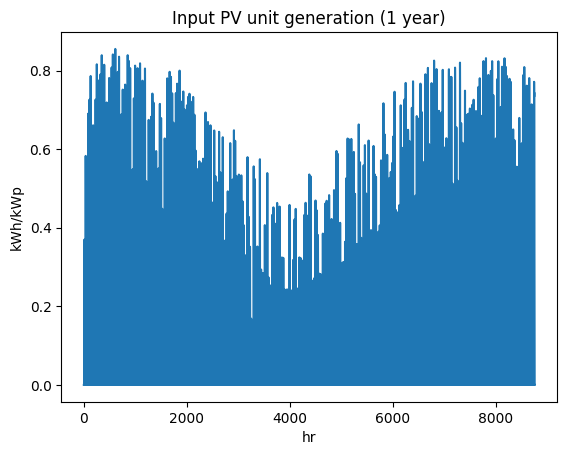

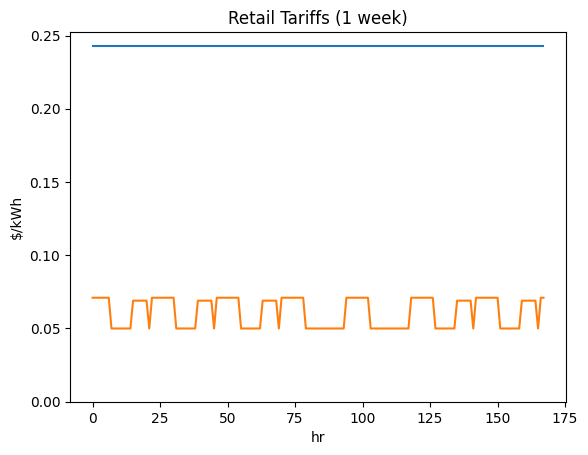

---- Optimising with PV: 1 - 20 kWp, Batt: 0 kWh. Determining PV capacity and dispatch.


************************************ Modell: PV > 1 kWp & BATT > 1 kWh ************************************
{'financial_horizon': 10, 'discount_rate': np.float64(0.06), 'grid_feedin_max': np.float64(5.0), 'pv_eol_capacity': np.float64(0.8), 'pv_eol_years': np.float64(25.0), 'pv_init_soh': np.float64(1.0), 'bess_e2p_ratio': np.float64(2.4), 'bess_roundtrip_eff': np.float64(0.88), 'bess_eol_years': np.float64(10.0), 'bess_eol_capacity': np.float64(0.7), 'bess_eol_cycles': np.float64(10000.0), 'bess_init_soh': np.float64(1.0), 'bess_eff_charge': np.float64(0.938083151964686), 'bess_eff_discharge': np.float64(0.938083151964686), 'scenario_name': 'Scenario_D_+5', 'scenario_set': 'SurfCoast', 'scenario_subset': 'JJP_open', 'year_start': 2022, 'datetime_name': 'DateTime1', 'meter_name': 'pc3016_nmi1186554938', 'solar_name': 'MELB', 'tariff_name_import_wkday': '3_Im_wkday', 'tariff_name_export_wkday': '3_

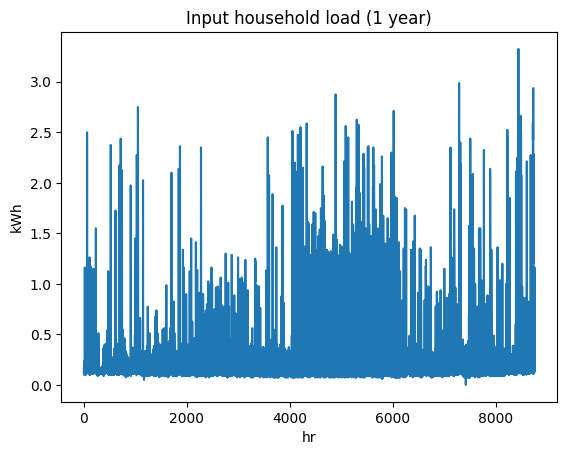

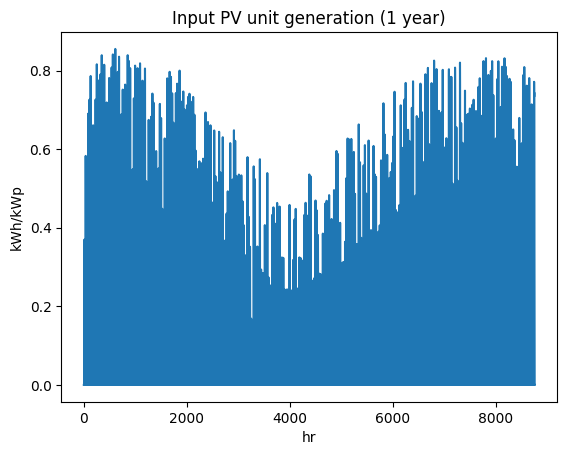

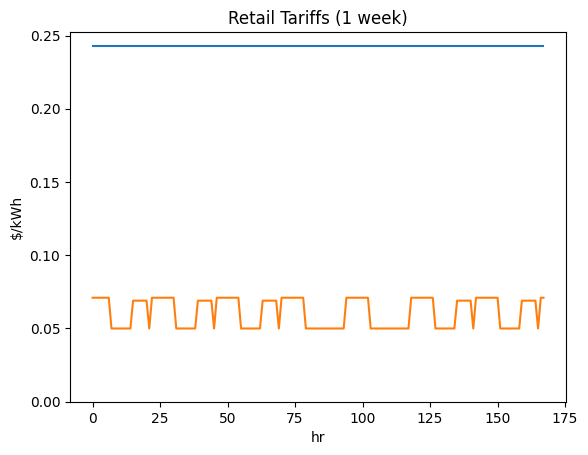

---- Optimising with PV: 1 - 20 kWp, Batt: 0 kWh. Determining PV capacity and dispatch.


************************************ Modell: PV > 1 kWp & BATT > 1 kWh ************************************
{'financial_horizon': 10, 'discount_rate': np.float64(0.06), 'grid_feedin_max': np.float64(5.0), 'pv_eol_capacity': np.float64(0.8), 'pv_eol_years': np.float64(25.0), 'pv_init_soh': np.float64(1.0), 'bess_e2p_ratio': np.float64(2.4), 'bess_roundtrip_eff': np.float64(0.88), 'bess_eol_years': np.float64(10.0), 'bess_eol_capacity': np.float64(0.7), 'bess_eol_cycles': np.float64(10000.0), 'bess_init_soh': np.float64(1.0), 'bess_eff_charge': np.float64(0.938083151964686), 'bess_eff_discharge': np.float64(0.938083151964686), 'scenario_name': 'Scenario_D_+5', 'scenario_set': 'SurfCoast', 'scenario_subset': 'JJP_open', 'year_start': 2022, 'datetime_name': 'DateTime1', 'meter_name': 'pc3015_nmi4499448416', 'solar_name': 'MELB', 'tariff_name_import_wkday': '3_Im_wkday', 'tariff_name_export_wkday': '3_

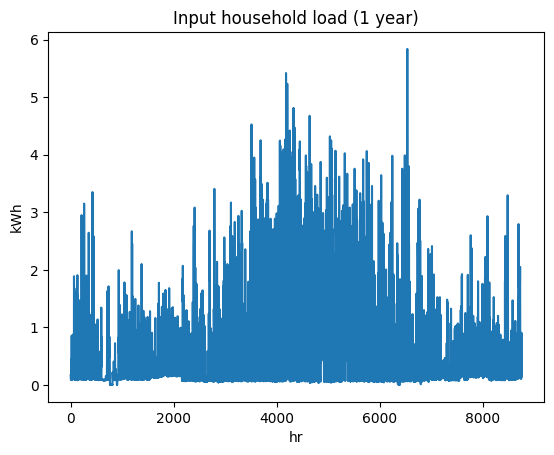

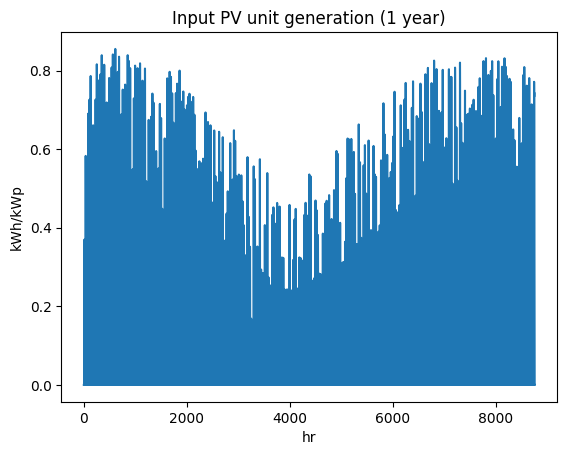

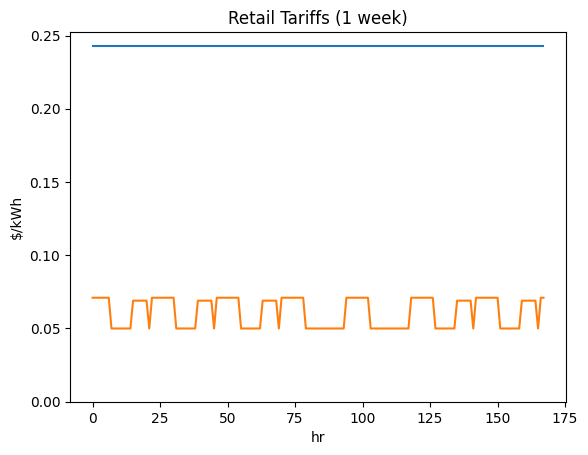

---- Optimising with PV: 1 - 20 kWp, Batt: 0 kWh. Determining PV capacity and dispatch.


************************************ Modell: PV > 1 kWp & BATT > 1 kWh ************************************
{'financial_horizon': 10, 'discount_rate': np.float64(0.06), 'grid_feedin_max': np.float64(5.0), 'pv_eol_capacity': np.float64(0.8), 'pv_eol_years': np.float64(25.0), 'pv_init_soh': np.float64(1.0), 'bess_e2p_ratio': np.float64(2.4), 'bess_roundtrip_eff': np.float64(0.88), 'bess_eol_years': np.float64(10.0), 'bess_eol_capacity': np.float64(0.7), 'bess_eol_cycles': np.float64(10000.0), 'bess_init_soh': np.float64(1.0), 'bess_eff_charge': np.float64(0.938083151964686), 'bess_eff_discharge': np.float64(0.938083151964686), 'scenario_name': 'Scenario_D_+5', 'scenario_set': 'SurfCoast', 'scenario_subset': 'JJP_open', 'year_start': 2022, 'datetime_name': 'DateTime1', 'meter_name': 'pc3058_nmi1730612994', 'solar_name': 'MELB', 'tariff_name_import_wkday': '3_Im_wkday', 'tariff_name_export_wkday': '3_

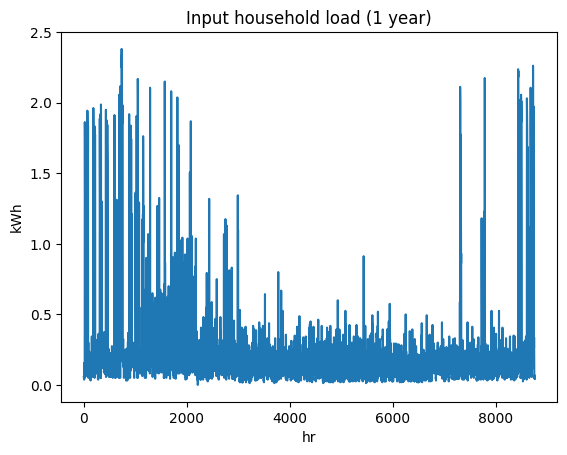

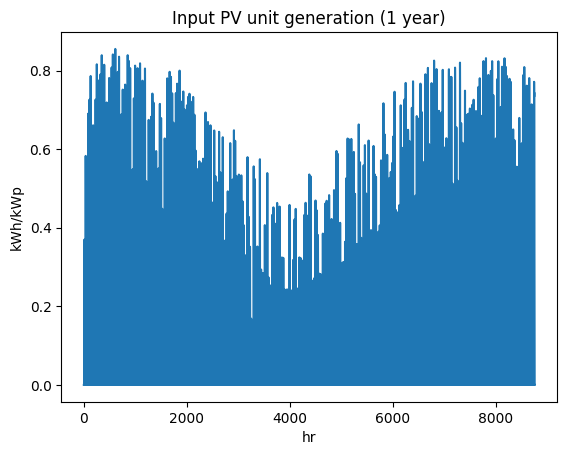

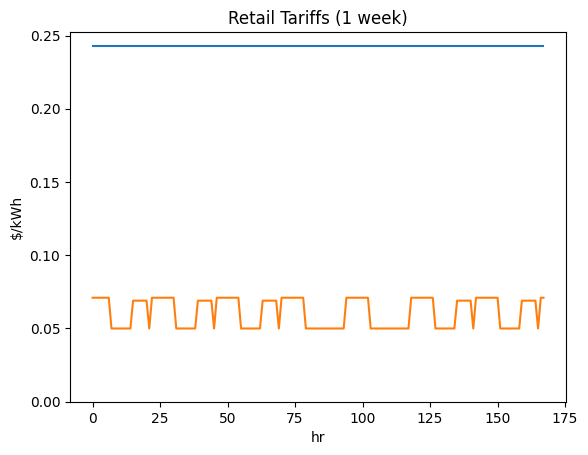

---- Optimising with PV: 1 - 20 kWp, Batt: 0 kWh. Determining PV capacity and dispatch.


************************************ Modell: PV > 1 kWp & BATT > 1 kWh ************************************
{'financial_horizon': 10, 'discount_rate': np.float64(0.06), 'grid_feedin_max': np.float64(5.0), 'pv_eol_capacity': np.float64(0.8), 'pv_eol_years': np.float64(25.0), 'pv_init_soh': np.float64(1.0), 'bess_e2p_ratio': np.float64(2.4), 'bess_roundtrip_eff': np.float64(0.88), 'bess_eol_years': np.float64(10.0), 'bess_eol_capacity': np.float64(0.7), 'bess_eol_cycles': np.float64(10000.0), 'bess_init_soh': np.float64(1.0), 'bess_eff_charge': np.float64(0.938083151964686), 'bess_eff_discharge': np.float64(0.938083151964686), 'scenario_name': 'Scenario_D_+5', 'scenario_set': 'SurfCoast', 'scenario_subset': 'JJP_open', 'year_start': 2022, 'datetime_name': 'DateTime1', 'meter_name': 'pc3072_nmi7989376350', 'solar_name': 'MELB', 'tariff_name_import_wkday': '3_Im_wkday', 'tariff_name_export_wkday': '3_

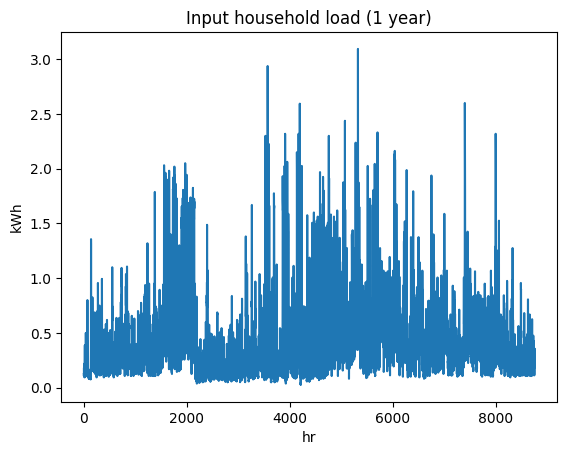

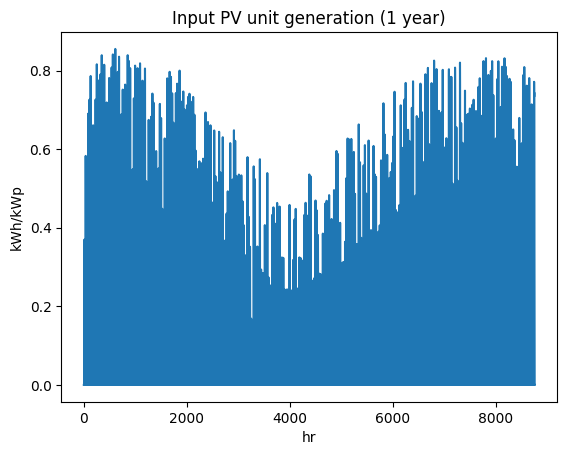

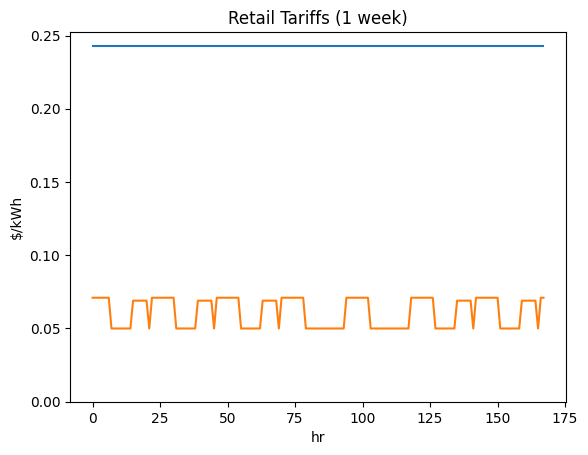

---- Optimising with PV: 1 - 20 kWp, Batt: 0 kWh. Determining PV capacity and dispatch.


************************************ Modell: PV > 1 kWp & BATT > 1 kWh ************************************
{'financial_horizon': 10, 'discount_rate': np.float64(0.06), 'grid_feedin_max': np.float64(5.0), 'pv_eol_capacity': np.float64(0.8), 'pv_eol_years': np.float64(25.0), 'pv_init_soh': np.float64(1.0), 'bess_e2p_ratio': np.float64(2.4), 'bess_roundtrip_eff': np.float64(0.88), 'bess_eol_years': np.float64(10.0), 'bess_eol_capacity': np.float64(0.7), 'bess_eol_cycles': np.float64(10000.0), 'bess_init_soh': np.float64(1.0), 'bess_eff_charge': np.float64(0.938083151964686), 'bess_eff_discharge': np.float64(0.938083151964686), 'scenario_name': 'Scenario_D_+5', 'scenario_set': 'SurfCoast', 'scenario_subset': 'JJP_open', 'year_start': 2022, 'datetime_name': 'DateTime1', 'meter_name': 'pc3012_nmi2435975642', 'solar_name': 'MELB', 'tariff_name_import_wkday': '3_Im_wkday', 'tariff_name_export_wkday': '3_

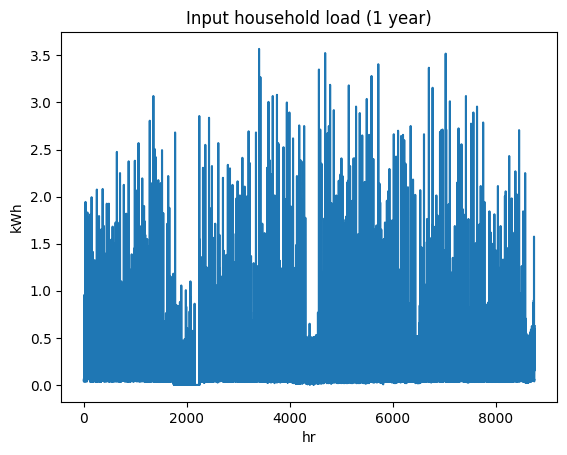

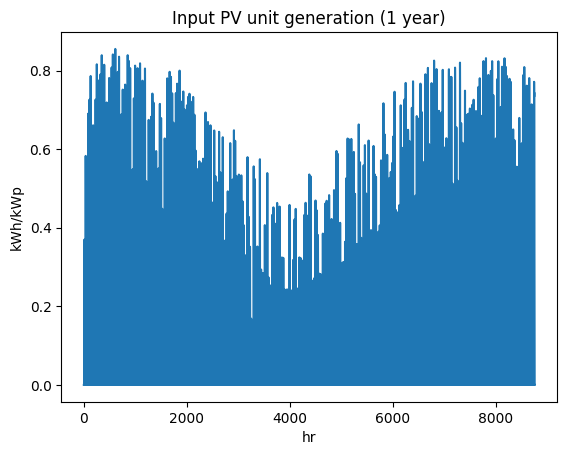

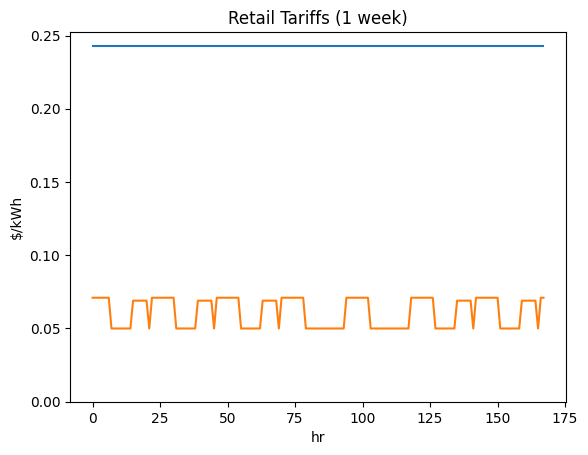

---- Optimising with PV: 1 - 20 kWp, Batt: 0 kWh. Determining PV capacity and dispatch.


************************************ Modell: PV > 1 kWp & BATT > 1 kWh ************************************
{'financial_horizon': 10, 'discount_rate': np.float64(0.06), 'grid_feedin_max': np.float64(5.0), 'pv_eol_capacity': np.float64(0.8), 'pv_eol_years': np.float64(25.0), 'pv_init_soh': np.float64(1.0), 'bess_e2p_ratio': np.float64(2.4), 'bess_roundtrip_eff': np.float64(0.88), 'bess_eol_years': np.float64(10.0), 'bess_eol_capacity': np.float64(0.7), 'bess_eol_cycles': np.float64(10000.0), 'bess_init_soh': np.float64(1.0), 'bess_eff_charge': np.float64(0.938083151964686), 'bess_eff_discharge': np.float64(0.938083151964686), 'scenario_name': 'Scenario_D_+5', 'scenario_set': 'SurfCoast', 'scenario_subset': 'JJP_open', 'year_start': 2022, 'datetime_name': 'DateTime1', 'meter_name': 'pc3040_nmi6751863385', 'solar_name': 'MELB', 'tariff_name_import_wkday': '3_Im_wkday', 'tariff_name_export_wkday': '3_

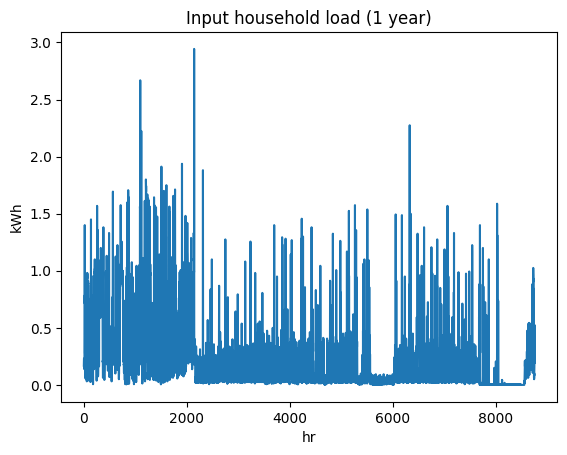

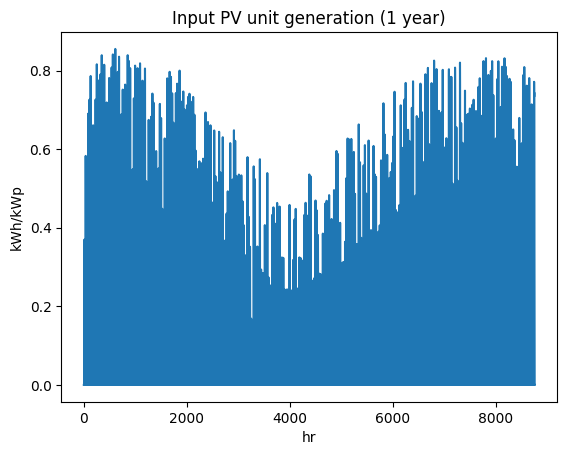

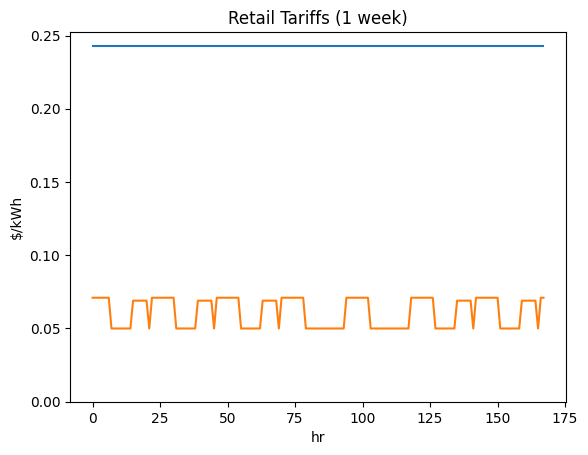

---- Optimising with PV: 1 - 20 kWp, Batt: 0 kWh. Determining PV capacity and dispatch.


************************************ Modell: PV > 1 kWp & BATT > 1 kWh ************************************
{'financial_horizon': 10, 'discount_rate': np.float64(0.06), 'grid_feedin_max': np.float64(5.0), 'pv_eol_capacity': np.float64(0.8), 'pv_eol_years': np.float64(25.0), 'pv_init_soh': np.float64(1.0), 'bess_e2p_ratio': np.float64(2.4), 'bess_roundtrip_eff': np.float64(0.88), 'bess_eol_years': np.float64(10.0), 'bess_eol_capacity': np.float64(0.7), 'bess_eol_cycles': np.float64(10000.0), 'bess_init_soh': np.float64(1.0), 'bess_eff_charge': np.float64(0.938083151964686), 'bess_eff_discharge': np.float64(0.938083151964686), 'scenario_name': 'Scenario_D_+5', 'scenario_set': 'SurfCoast', 'scenario_subset': 'JJP_open', 'year_start': 2022, 'datetime_name': 'DateTime1', 'meter_name': 'pc3081_nmi2287947576', 'solar_name': 'MELB', 'tariff_name_import_wkday': '3_Im_wkday', 'tariff_name_export_wkday': '3_

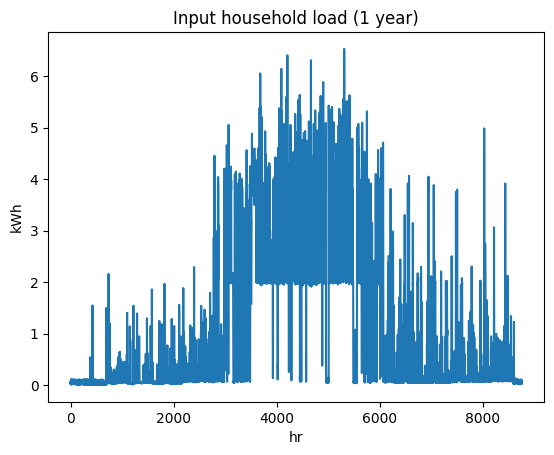

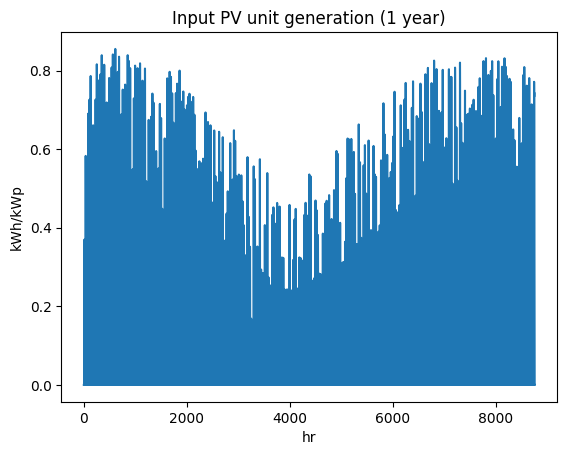

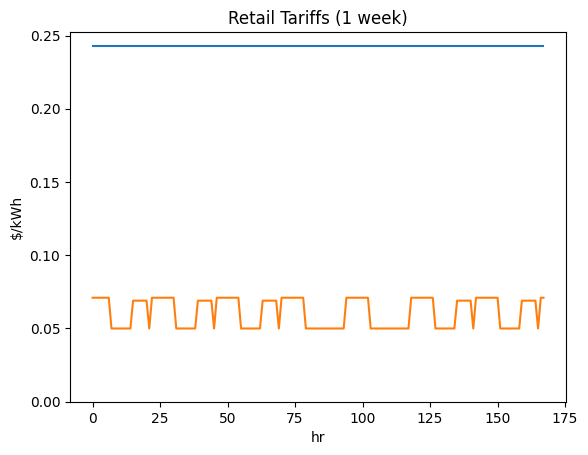

---- Optimising with PV: 1 - 20 kWp, Batt: 0 kWh. Determining PV capacity and dispatch.


************************************ Modell: PV > 1 kWp & BATT > 1 kWh ************************************
{'financial_horizon': 10, 'discount_rate': np.float64(0.06), 'grid_feedin_max': np.float64(5.0), 'pv_eol_capacity': np.float64(0.8), 'pv_eol_years': np.float64(25.0), 'pv_init_soh': np.float64(1.0), 'bess_e2p_ratio': np.float64(2.4), 'bess_roundtrip_eff': np.float64(0.88), 'bess_eol_years': np.float64(10.0), 'bess_eol_capacity': np.float64(0.7), 'bess_eol_cycles': np.float64(10000.0), 'bess_init_soh': np.float64(1.0), 'bess_eff_charge': np.float64(0.938083151964686), 'bess_eff_discharge': np.float64(0.938083151964686), 'scenario_name': 'Scenario_D_+5', 'scenario_set': 'SurfCoast', 'scenario_subset': 'JJP_open', 'year_start': 2022, 'datetime_name': 'DateTime1', 'meter_name': 'pc3040_nmi6525213808', 'solar_name': 'MELB', 'tariff_name_import_wkday': '3_Im_wkday', 'tariff_name_export_wkday': '3_

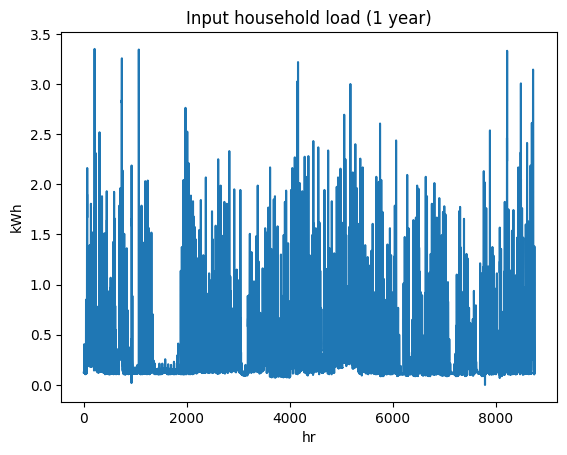

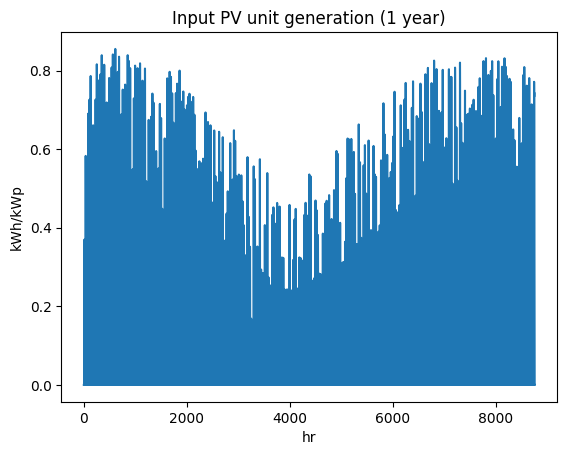

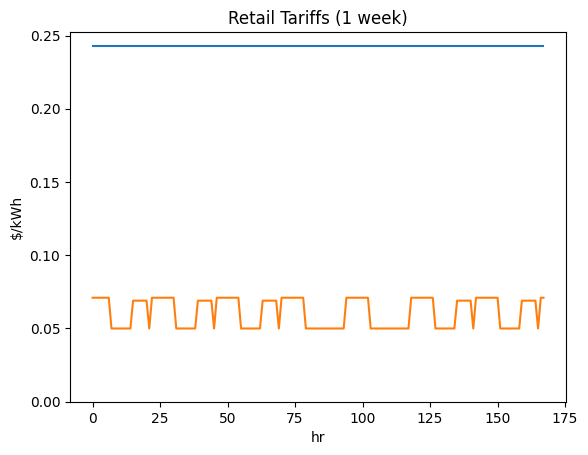

---- Optimising with PV: 1 - 20 kWp, Batt: 0 kWh. Determining PV capacity and dispatch.


************************************ Modell: PV > 1 kWp & BATT > 1 kWh ************************************
{'financial_horizon': 10, 'discount_rate': np.float64(0.06), 'grid_feedin_max': np.float64(5.0), 'pv_eol_capacity': np.float64(0.8), 'pv_eol_years': np.float64(25.0), 'pv_init_soh': np.float64(1.0), 'bess_e2p_ratio': np.float64(2.4), 'bess_roundtrip_eff': np.float64(0.88), 'bess_eol_years': np.float64(10.0), 'bess_eol_capacity': np.float64(0.7), 'bess_eol_cycles': np.float64(10000.0), 'bess_init_soh': np.float64(1.0), 'bess_eff_charge': np.float64(0.938083151964686), 'bess_eff_discharge': np.float64(0.938083151964686), 'scenario_name': 'Scenario_D_+5', 'scenario_set': 'SurfCoast', 'scenario_subset': 'JJP_open', 'year_start': 2022, 'datetime_name': 'DateTime1', 'meter_name': 'pc3079_nmi5596411755', 'solar_name': 'MELB', 'tariff_name_import_wkday': '3_Im_wkday', 'tariff_name_export_wkday': '3_

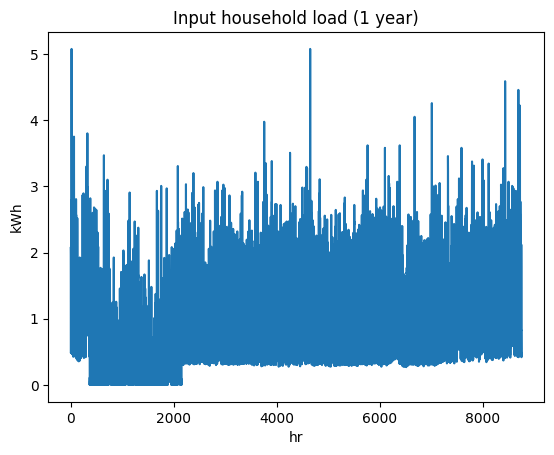

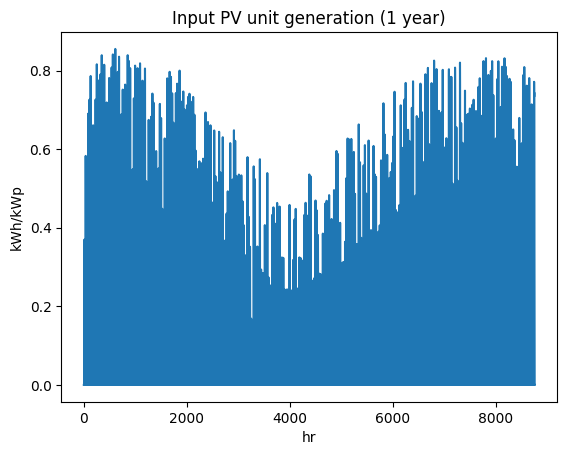

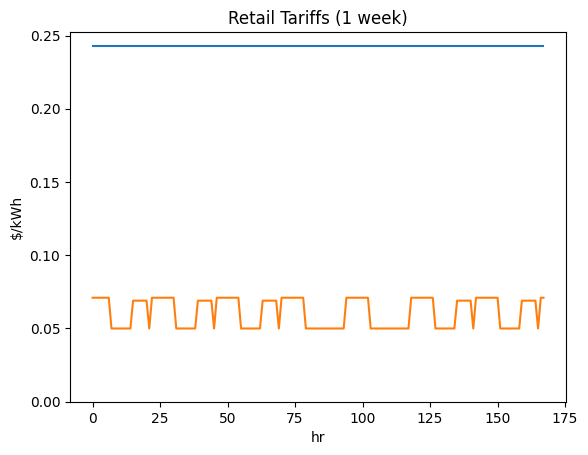

---- Optimising with PV: 1 - 20 kWp, Batt: 0 kWh. Determining PV capacity and dispatch.


************************************ Modell: PV > 1 kWp & BATT > 1 kWh ************************************
{'financial_horizon': 10, 'discount_rate': np.float64(0.06), 'grid_feedin_max': np.float64(5.0), 'pv_eol_capacity': np.float64(0.8), 'pv_eol_years': np.float64(25.0), 'pv_init_soh': np.float64(1.0), 'bess_e2p_ratio': np.float64(2.4), 'bess_roundtrip_eff': np.float64(0.88), 'bess_eol_years': np.float64(10.0), 'bess_eol_capacity': np.float64(0.7), 'bess_eol_cycles': np.float64(10000.0), 'bess_init_soh': np.float64(1.0), 'bess_eff_charge': np.float64(0.938083151964686), 'bess_eff_discharge': np.float64(0.938083151964686), 'scenario_name': 'Scenario_D_+5', 'scenario_set': 'SurfCoast', 'scenario_subset': 'JJP_open', 'year_start': 2022, 'datetime_name': 'DateTime1', 'meter_name': 'pc3040_nmi7305551112', 'solar_name': 'MELB', 'tariff_name_import_wkday': '3_Im_wkday', 'tariff_name_export_wkday': '3_

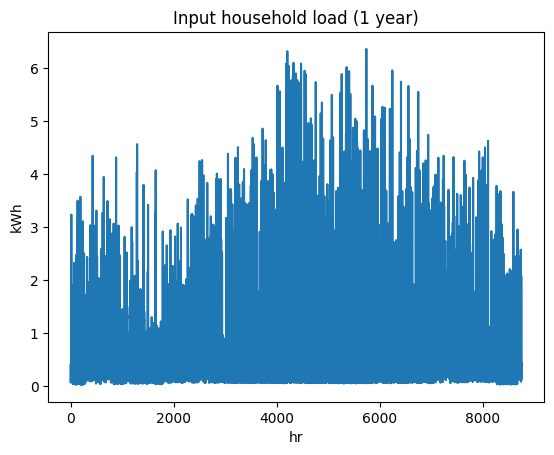

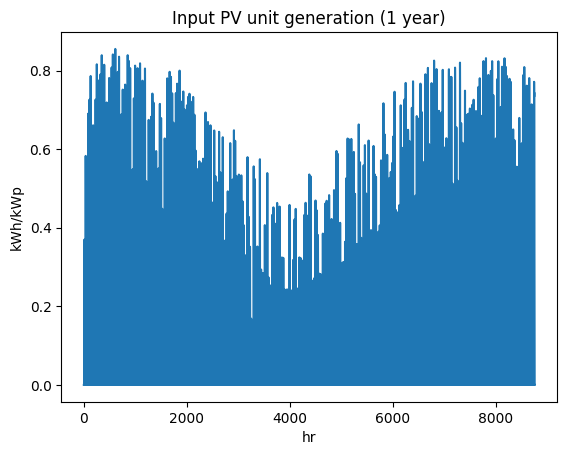

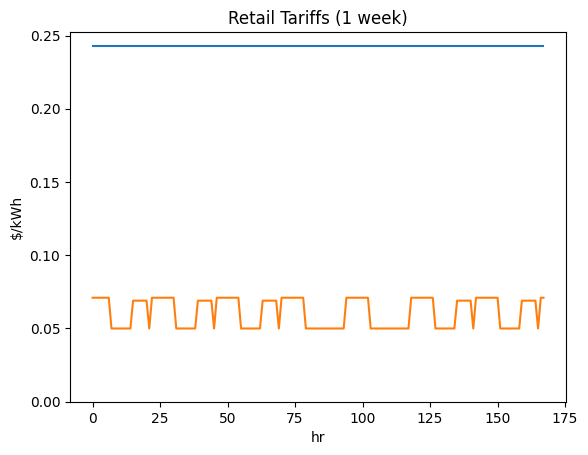

---- Optimising with PV: 1 - 20 kWp, Batt: 0 kWh. Determining PV capacity and dispatch.


************************************ Modell: PV > 1 kWp & BATT > 1 kWh ************************************
{'financial_horizon': 10, 'discount_rate': np.float64(0.06), 'grid_feedin_max': np.float64(5.0), 'pv_eol_capacity': np.float64(0.8), 'pv_eol_years': np.float64(25.0), 'pv_init_soh': np.float64(1.0), 'bess_e2p_ratio': np.float64(2.4), 'bess_roundtrip_eff': np.float64(0.88), 'bess_eol_years': np.float64(10.0), 'bess_eol_capacity': np.float64(0.7), 'bess_eol_cycles': np.float64(10000.0), 'bess_init_soh': np.float64(1.0), 'bess_eff_charge': np.float64(0.938083151964686), 'bess_eff_discharge': np.float64(0.938083151964686), 'scenario_name': 'Scenario_D_+5', 'scenario_set': 'SurfCoast', 'scenario_subset': 'JJP_open', 'year_start': 2022, 'datetime_name': 'DateTime1', 'meter_name': 'pc3072_nmi8450210225', 'solar_name': 'MELB', 'tariff_name_import_wkday': '3_Im_wkday', 'tariff_name_export_wkday': '3_

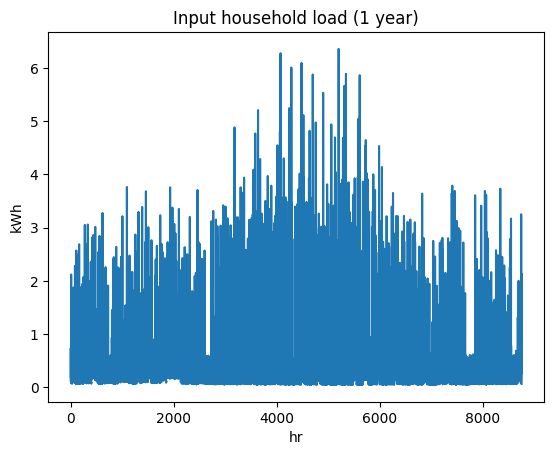

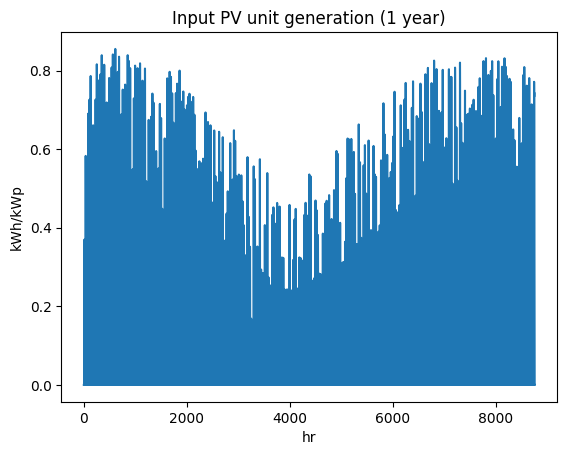

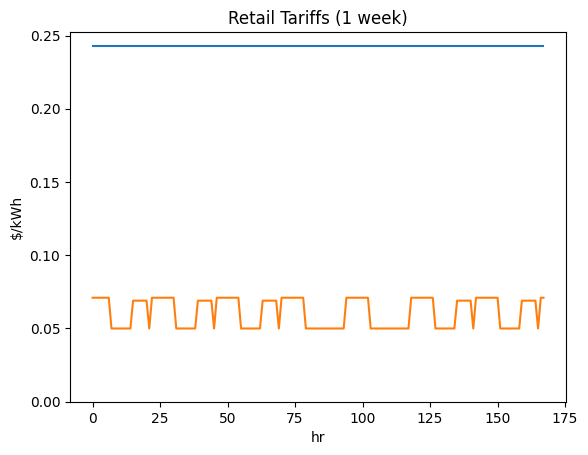

---- Optimising with PV: 1 - 20 kWp, Batt: 0 kWh. Determining PV capacity and dispatch.


************************************ Modell: PV > 1 kWp & BATT > 1 kWh ************************************
{'financial_horizon': 10, 'discount_rate': np.float64(0.06), 'grid_feedin_max': np.float64(5.0), 'pv_eol_capacity': np.float64(0.8), 'pv_eol_years': np.float64(25.0), 'pv_init_soh': np.float64(1.0), 'bess_e2p_ratio': np.float64(2.4), 'bess_roundtrip_eff': np.float64(0.88), 'bess_eol_years': np.float64(10.0), 'bess_eol_capacity': np.float64(0.7), 'bess_eol_cycles': np.float64(10000.0), 'bess_init_soh': np.float64(1.0), 'bess_eff_charge': np.float64(0.938083151964686), 'bess_eff_discharge': np.float64(0.938083151964686), 'scenario_name': 'Scenario_D_+5', 'scenario_set': 'SurfCoast', 'scenario_subset': 'JJP_open', 'year_start': 2022, 'datetime_name': 'DateTime1', 'meter_name': 'pc3031_nmi2184338126', 'solar_name': 'MELB', 'tariff_name_import_wkday': '3_Im_wkday', 'tariff_name_export_wkday': '3_

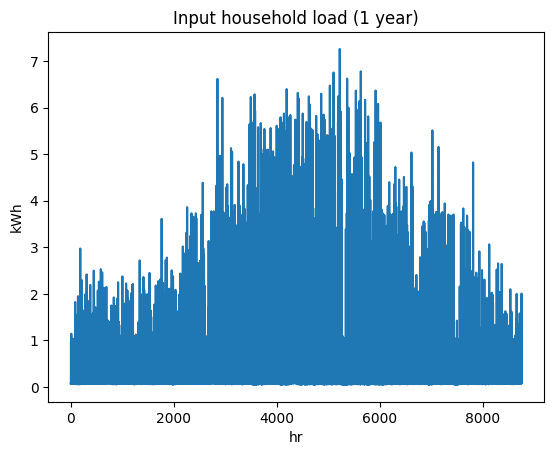

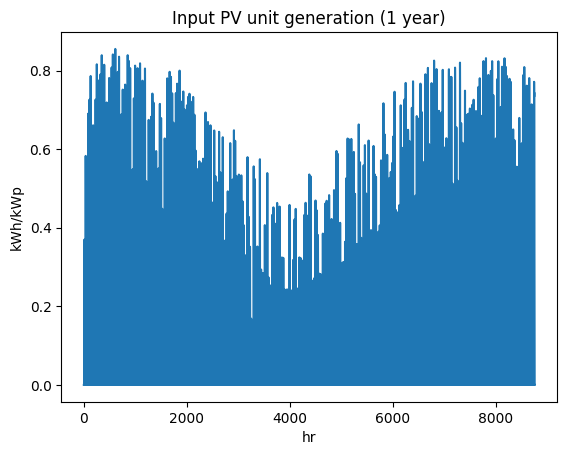

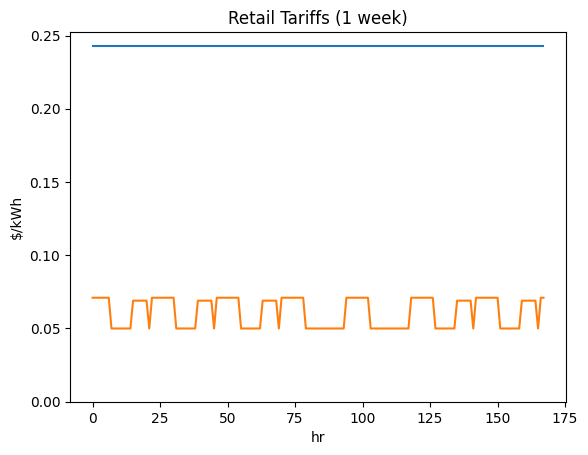

---- Optimising with PV: 1 - 20 kWp, Batt: 0 kWh. Determining PV capacity and dispatch.


************************************ Modell: PV > 1 kWp & BATT > 1 kWh ************************************
{'financial_horizon': 10, 'discount_rate': np.float64(0.06), 'grid_feedin_max': np.float64(5.0), 'pv_eol_capacity': np.float64(0.8), 'pv_eol_years': np.float64(25.0), 'pv_init_soh': np.float64(1.0), 'bess_e2p_ratio': np.float64(2.4), 'bess_roundtrip_eff': np.float64(0.88), 'bess_eol_years': np.float64(10.0), 'bess_eol_capacity': np.float64(0.7), 'bess_eol_cycles': np.float64(10000.0), 'bess_init_soh': np.float64(1.0), 'bess_eff_charge': np.float64(0.938083151964686), 'bess_eff_discharge': np.float64(0.938083151964686), 'scenario_name': 'Scenario_D_+5', 'scenario_set': 'SurfCoast', 'scenario_subset': 'JJP_open', 'year_start': 2022, 'datetime_name': 'DateTime1', 'meter_name': 'pc3031_nmi3534035893', 'solar_name': 'MELB', 'tariff_name_import_wkday': '3_Im_wkday', 'tariff_name_export_wkday': '3_

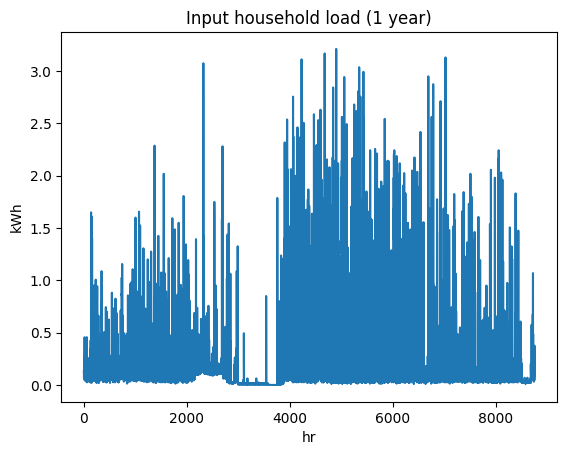

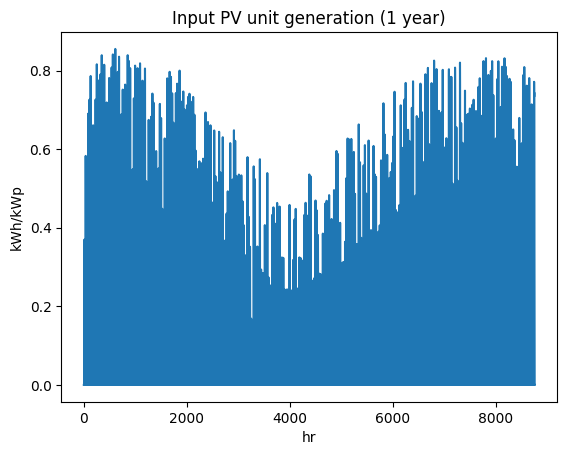

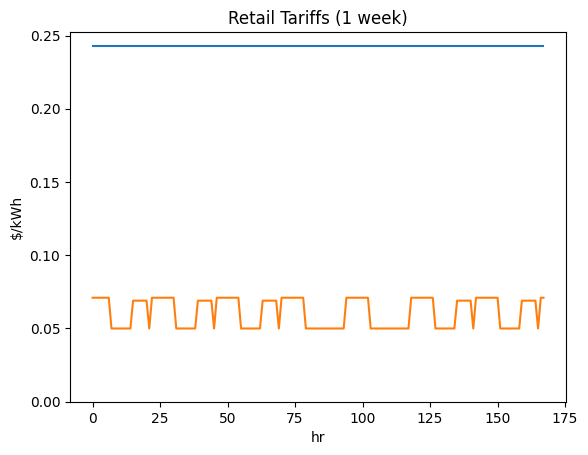

---- Optimising with PV: 1 - 20 kWp, Batt: 0 kWh. Determining PV capacity and dispatch.


************************************ Modell: PV > 1 kWp & BATT > 1 kWh ************************************
{'financial_horizon': 10, 'discount_rate': np.float64(0.06), 'grid_feedin_max': np.float64(5.0), 'pv_eol_capacity': np.float64(0.8), 'pv_eol_years': np.float64(25.0), 'pv_init_soh': np.float64(1.0), 'bess_e2p_ratio': np.float64(2.4), 'bess_roundtrip_eff': np.float64(0.88), 'bess_eol_years': np.float64(10.0), 'bess_eol_capacity': np.float64(0.7), 'bess_eol_cycles': np.float64(10000.0), 'bess_init_soh': np.float64(1.0), 'bess_eff_charge': np.float64(0.938083151964686), 'bess_eff_discharge': np.float64(0.938083151964686), 'scenario_name': 'Scenario_D_+5', 'scenario_set': 'SurfCoast', 'scenario_subset': 'JJP_open', 'year_start': 2022, 'datetime_name': 'DateTime1', 'meter_name': 'pc3031_nmi1455701982', 'solar_name': 'MELB', 'tariff_name_import_wkday': '3_Im_wkday', 'tariff_name_export_wkday': '3_

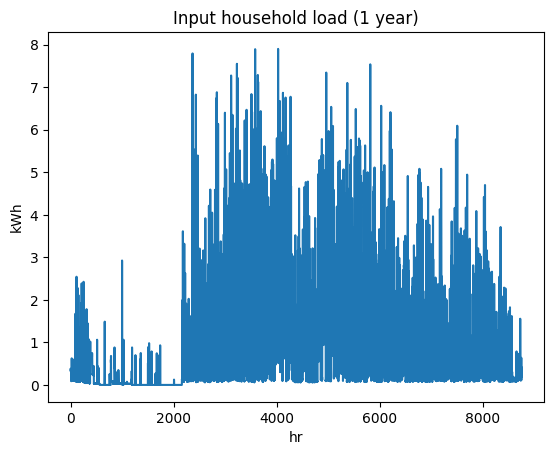

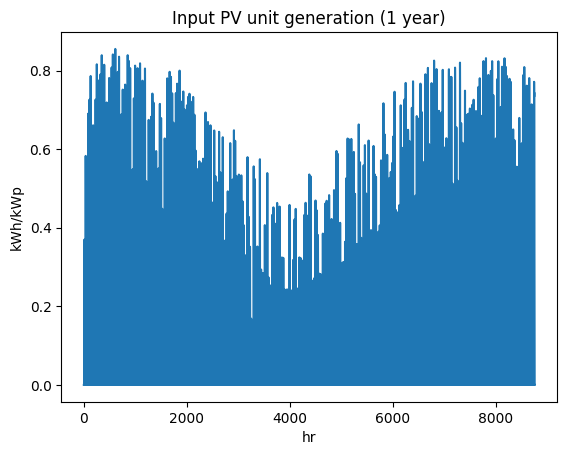

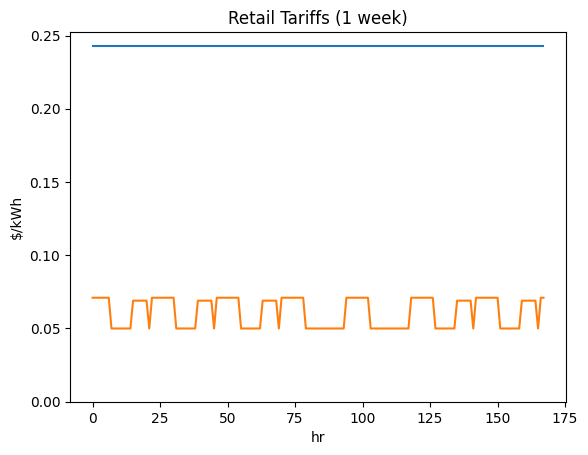

---- Optimising with PV: 1 - 20 kWp, Batt: 0 kWh. Determining PV capacity and dispatch.


************************************ Modell: PV > 1 kWp & BATT > 1 kWh ************************************
{'financial_horizon': 10, 'discount_rate': np.float64(0.06), 'grid_feedin_max': np.float64(5.0), 'pv_eol_capacity': np.float64(0.8), 'pv_eol_years': np.float64(25.0), 'pv_init_soh': np.float64(1.0), 'bess_e2p_ratio': np.float64(2.4), 'bess_roundtrip_eff': np.float64(0.88), 'bess_eol_years': np.float64(10.0), 'bess_eol_capacity': np.float64(0.7), 'bess_eol_cycles': np.float64(10000.0), 'bess_init_soh': np.float64(1.0), 'bess_eff_charge': np.float64(0.938083151964686), 'bess_eff_discharge': np.float64(0.938083151964686), 'scenario_name': 'Scenario_D_+5', 'scenario_set': 'SurfCoast', 'scenario_subset': 'JJP_open', 'year_start': 2022, 'datetime_name': 'DateTime1', 'meter_name': 'pc3031_nmi5942732470', 'solar_name': 'MELB', 'tariff_name_import_wkday': '3_Im_wkday', 'tariff_name_export_wkday': '3_

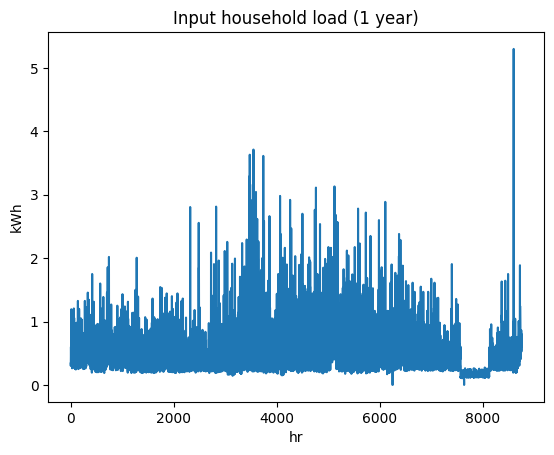

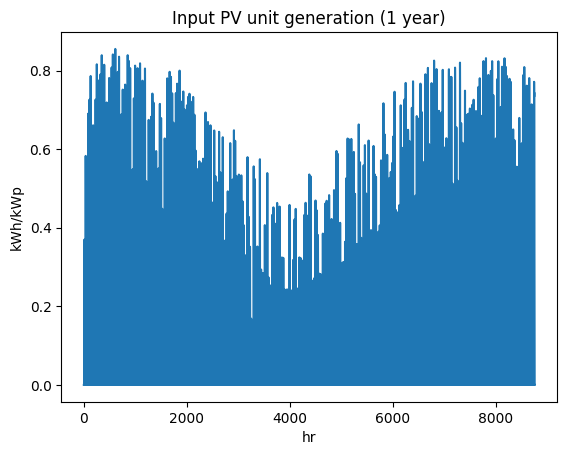

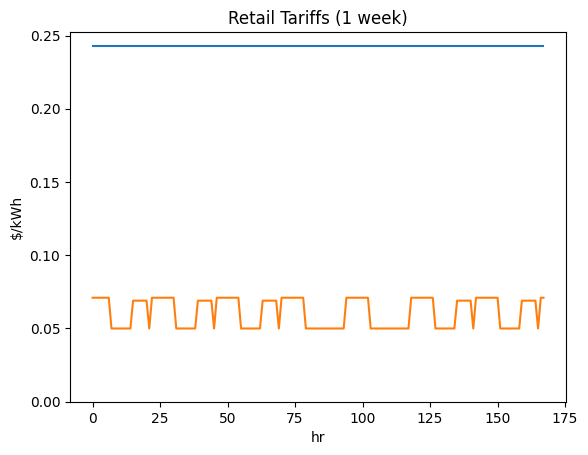

---- Optimising with PV: 1 - 20 kWp, Batt: 0 kWh. Determining PV capacity and dispatch.


************************************ Modell: PV > 1 kWp & BATT > 1 kWh ************************************
{'financial_horizon': 10, 'discount_rate': np.float64(0.06), 'grid_feedin_max': np.float64(5.0), 'pv_eol_capacity': np.float64(0.8), 'pv_eol_years': np.float64(25.0), 'pv_init_soh': np.float64(1.0), 'bess_e2p_ratio': np.float64(2.4), 'bess_roundtrip_eff': np.float64(0.88), 'bess_eol_years': np.float64(10.0), 'bess_eol_capacity': np.float64(0.7), 'bess_eol_cycles': np.float64(10000.0), 'bess_init_soh': np.float64(1.0), 'bess_eff_charge': np.float64(0.938083151964686), 'bess_eff_discharge': np.float64(0.938083151964686), 'scenario_name': 'Scenario_D_+5', 'scenario_set': 'SurfCoast', 'scenario_subset': 'JJP_open', 'year_start': 2022, 'datetime_name': 'DateTime1', 'meter_name': 'pc3032_nmi3896568248', 'solar_name': 'MELB', 'tariff_name_import_wkday': '3_Im_wkday', 'tariff_name_export_wkday': '3_

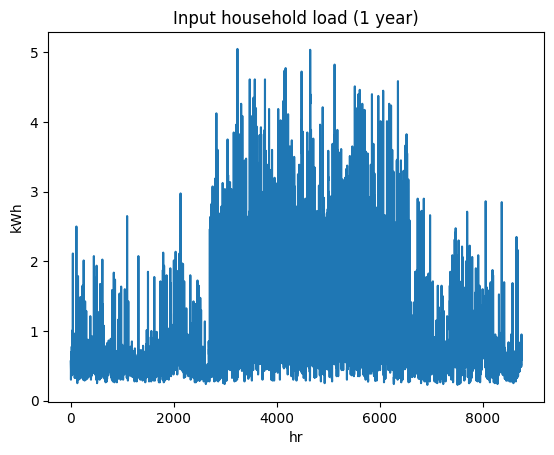

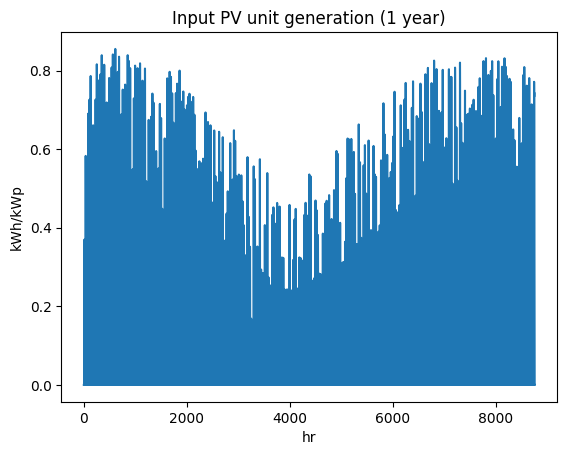

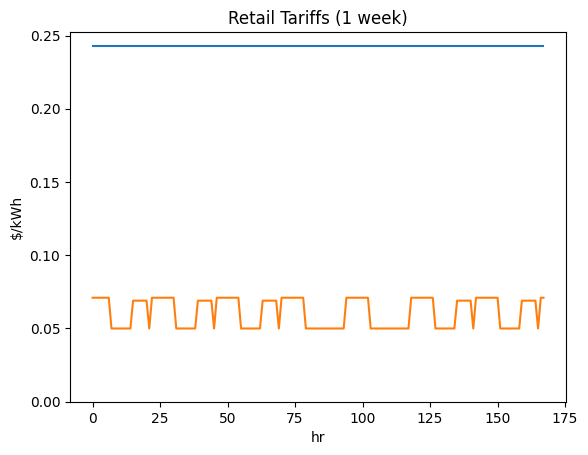

---- Optimising with PV: 1 - 20 kWp, Batt: 0 kWh. Determining PV capacity and dispatch.


************************************ Modell: PV > 1 kWp & BATT > 1 kWh ************************************
{'financial_horizon': 10, 'discount_rate': np.float64(0.06), 'grid_feedin_max': np.float64(5.0), 'pv_eol_capacity': np.float64(0.8), 'pv_eol_years': np.float64(25.0), 'pv_init_soh': np.float64(1.0), 'bess_e2p_ratio': np.float64(2.4), 'bess_roundtrip_eff': np.float64(0.88), 'bess_eol_years': np.float64(10.0), 'bess_eol_capacity': np.float64(0.7), 'bess_eol_cycles': np.float64(10000.0), 'bess_init_soh': np.float64(1.0), 'bess_eff_charge': np.float64(0.938083151964686), 'bess_eff_discharge': np.float64(0.938083151964686), 'scenario_name': 'Scenario_D_+5', 'scenario_set': 'SurfCoast', 'scenario_subset': 'JJP_open', 'year_start': 2022, 'datetime_name': 'DateTime1', 'meter_name': 'pc3031_nmi8439267130', 'solar_name': 'MELB', 'tariff_name_import_wkday': '3_Im_wkday', 'tariff_name_export_wkday': '3_

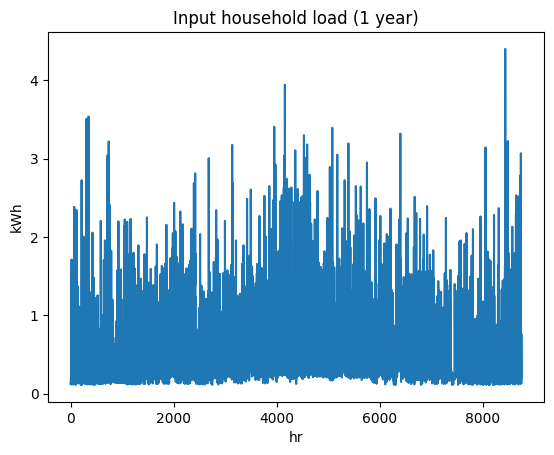

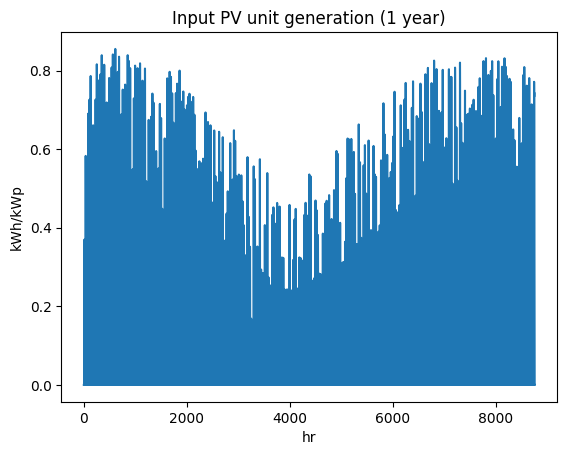

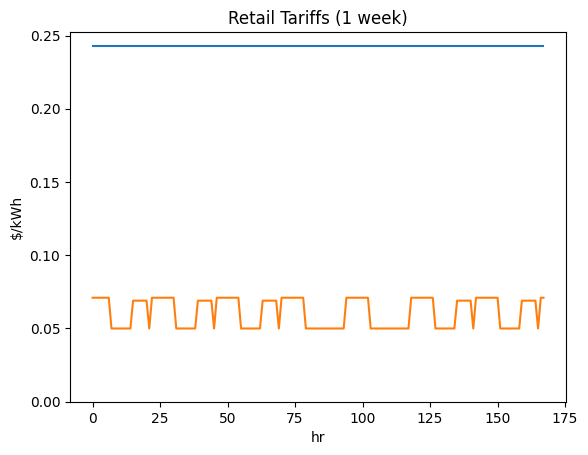

---- Optimising with PV: 1 - 20 kWp, Batt: 0 kWh. Determining PV capacity and dispatch.


************************************ Modell: PV > 1 kWp & BATT > 1 kWh ************************************
{'financial_horizon': 10, 'discount_rate': np.float64(0.06), 'grid_feedin_max': np.float64(5.0), 'pv_eol_capacity': np.float64(0.8), 'pv_eol_years': np.float64(25.0), 'pv_init_soh': np.float64(1.0), 'bess_e2p_ratio': np.float64(2.4), 'bess_roundtrip_eff': np.float64(0.88), 'bess_eol_years': np.float64(10.0), 'bess_eol_capacity': np.float64(0.7), 'bess_eol_cycles': np.float64(10000.0), 'bess_init_soh': np.float64(1.0), 'bess_eff_charge': np.float64(0.938083151964686), 'bess_eff_discharge': np.float64(0.938083151964686), 'scenario_name': 'Scenario_D_+5', 'scenario_set': 'SurfCoast', 'scenario_subset': 'JJP_open', 'year_start': 2022, 'datetime_name': 'DateTime1', 'meter_name': 'pc3032_nmi7199999032', 'solar_name': 'MELB', 'tariff_name_import_wkday': '3_Im_wkday', 'tariff_name_export_wkday': '3_

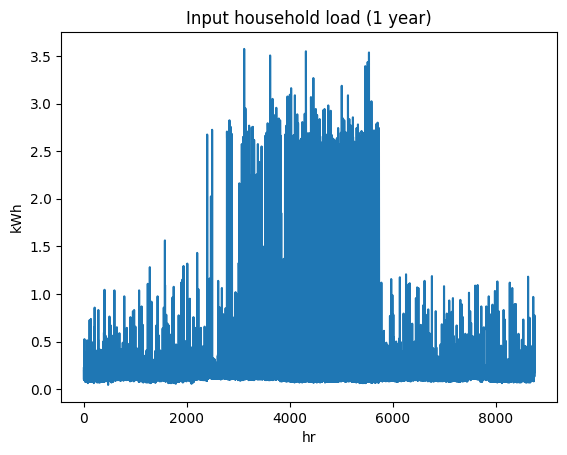

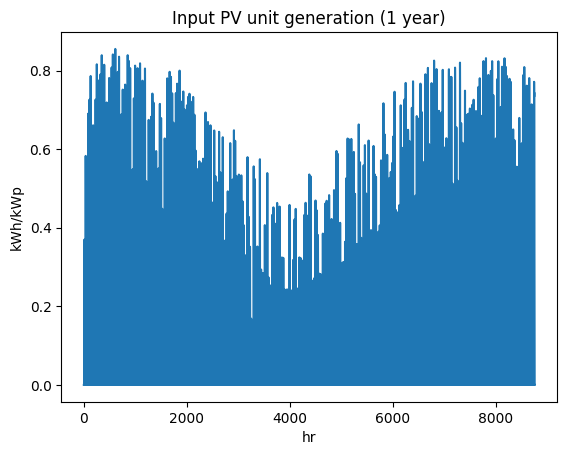

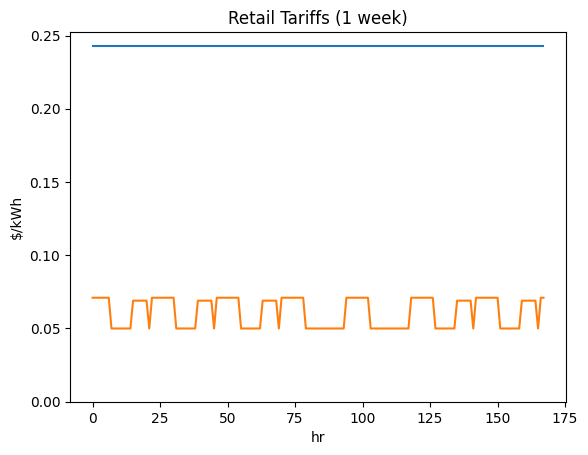

---- Optimising with PV: 1 - 20 kWp, Batt: 0 kWh. Determining PV capacity and dispatch.


************************************ Modell: PV > 1 kWp & BATT > 1 kWh ************************************
{'financial_horizon': 10, 'discount_rate': np.float64(0.06), 'grid_feedin_max': np.float64(5.0), 'pv_eol_capacity': np.float64(0.8), 'pv_eol_years': np.float64(25.0), 'pv_init_soh': np.float64(1.0), 'bess_e2p_ratio': np.float64(2.4), 'bess_roundtrip_eff': np.float64(0.88), 'bess_eol_years': np.float64(10.0), 'bess_eol_capacity': np.float64(0.7), 'bess_eol_cycles': np.float64(10000.0), 'bess_init_soh': np.float64(1.0), 'bess_eff_charge': np.float64(0.938083151964686), 'bess_eff_discharge': np.float64(0.938083151964686), 'scenario_name': 'Scenario_D_+5', 'scenario_set': 'SurfCoast', 'scenario_subset': 'JJP_open', 'year_start': 2022, 'datetime_name': 'DateTime1', 'meter_name': 'pc3032_nmi1268732423', 'solar_name': 'MELB', 'tariff_name_import_wkday': '3_Im_wkday', 'tariff_name_export_wkday': '3_

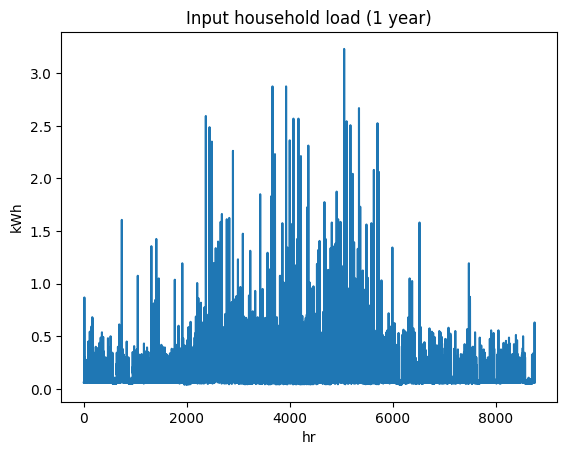

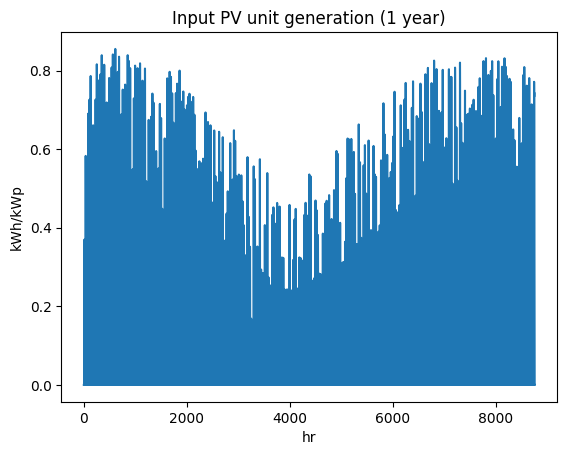

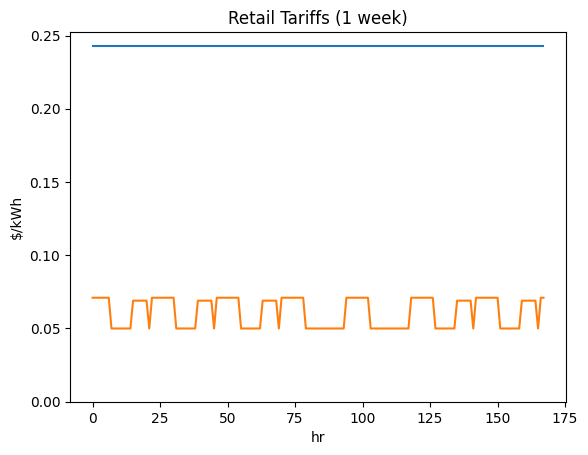

---- Optimising with PV: 1 - 20 kWp, Batt: 0 kWh. Determining PV capacity and dispatch.


************************************ Modell: PV > 1 kWp & BATT > 1 kWh ************************************
{'financial_horizon': 10, 'discount_rate': np.float64(0.06), 'grid_feedin_max': np.float64(5.0), 'pv_eol_capacity': np.float64(0.8), 'pv_eol_years': np.float64(25.0), 'pv_init_soh': np.float64(1.0), 'bess_e2p_ratio': np.float64(2.4), 'bess_roundtrip_eff': np.float64(0.88), 'bess_eol_years': np.float64(10.0), 'bess_eol_capacity': np.float64(0.7), 'bess_eol_cycles': np.float64(10000.0), 'bess_init_soh': np.float64(1.0), 'bess_eff_charge': np.float64(0.938083151964686), 'bess_eff_discharge': np.float64(0.938083151964686), 'scenario_name': 'Scenario_D_+5', 'scenario_set': 'SurfCoast', 'scenario_subset': 'JJP_open', 'year_start': 2022, 'datetime_name': 'DateTime1', 'meter_name': 'pc3032_nmi2457494676', 'solar_name': 'MELB', 'tariff_name_import_wkday': '3_Im_wkday', 'tariff_name_export_wkday': '3_

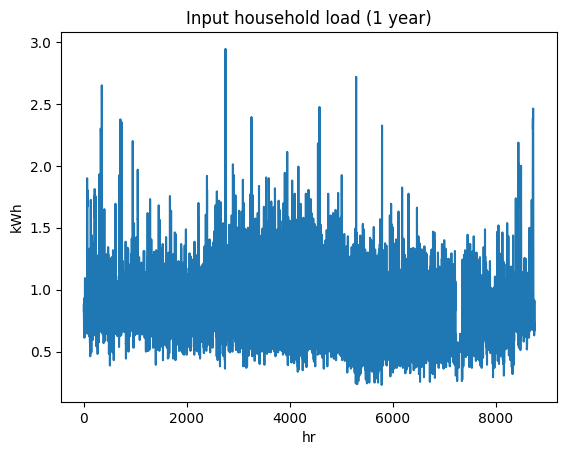

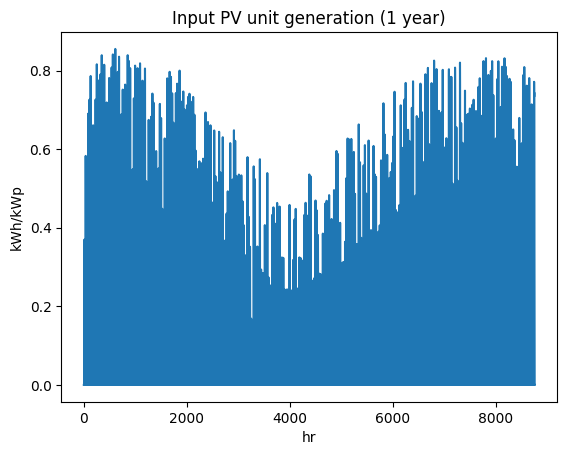

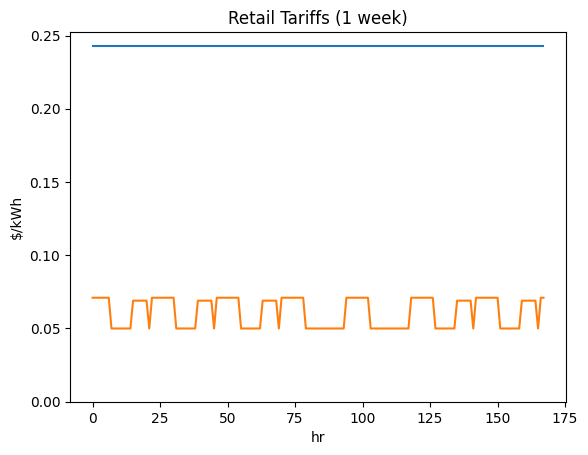

---- Optimising with PV: 1 - 20 kWp, Batt: 0 kWh. Determining PV capacity and dispatch.


************************************ Modell: PV > 1 kWp & BATT > 1 kWh ************************************
{'financial_horizon': 10, 'discount_rate': np.float64(0.06), 'grid_feedin_max': np.float64(5.0), 'pv_eol_capacity': np.float64(0.8), 'pv_eol_years': np.float64(25.0), 'pv_init_soh': np.float64(1.0), 'bess_e2p_ratio': np.float64(2.4), 'bess_roundtrip_eff': np.float64(0.88), 'bess_eol_years': np.float64(10.0), 'bess_eol_capacity': np.float64(0.7), 'bess_eol_cycles': np.float64(10000.0), 'bess_init_soh': np.float64(1.0), 'bess_eff_charge': np.float64(0.938083151964686), 'bess_eff_discharge': np.float64(0.938083151964686), 'scenario_name': 'Scenario_D_+5', 'scenario_set': 'SurfCoast', 'scenario_subset': 'JJP_open', 'year_start': 2022, 'datetime_name': 'DateTime1', 'meter_name': 'pc3032_nmi3773412127', 'solar_name': 'MELB', 'tariff_name_import_wkday': '3_Im_wkday', 'tariff_name_export_wkday': '3_

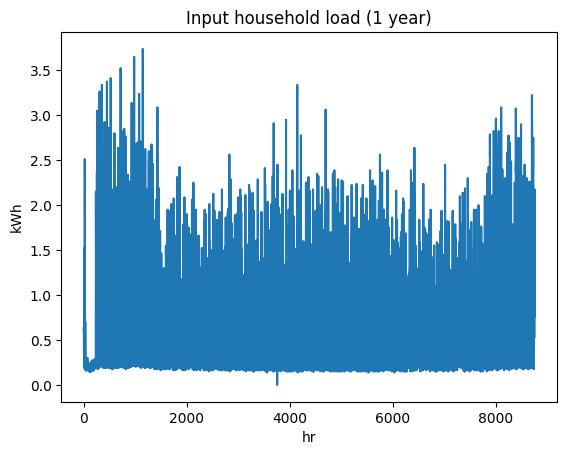

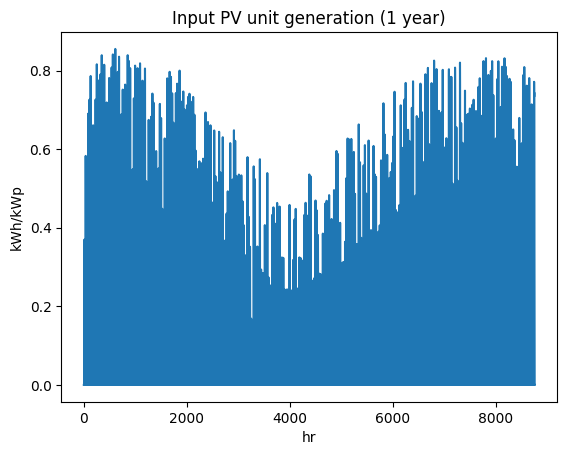

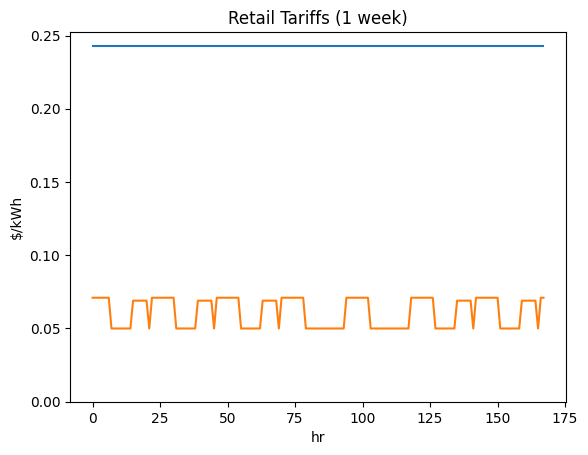

---- Optimising with PV: 1 - 20 kWp, Batt: 0 kWh. Determining PV capacity and dispatch.


************************************ Modell: PV > 1 kWp & BATT > 1 kWh ************************************
{'financial_horizon': 10, 'discount_rate': np.float64(0.06), 'grid_feedin_max': np.float64(5.0), 'pv_eol_capacity': np.float64(0.8), 'pv_eol_years': np.float64(25.0), 'pv_init_soh': np.float64(1.0), 'bess_e2p_ratio': np.float64(2.4), 'bess_roundtrip_eff': np.float64(0.88), 'bess_eol_years': np.float64(10.0), 'bess_eol_capacity': np.float64(0.7), 'bess_eol_cycles': np.float64(10000.0), 'bess_init_soh': np.float64(1.0), 'bess_eff_charge': np.float64(0.938083151964686), 'bess_eff_discharge': np.float64(0.938083151964686), 'scenario_name': 'Scenario_D_+5', 'scenario_set': 'SurfCoast', 'scenario_subset': 'JJP_open', 'year_start': 2022, 'datetime_name': 'DateTime1', 'meter_name': 'pc3039_nmi4825739094', 'solar_name': 'MELB', 'tariff_name_import_wkday': '3_Im_wkday', 'tariff_name_export_wkday': '3_

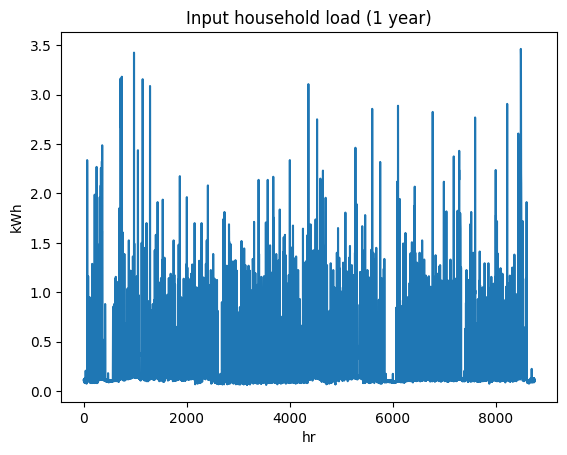

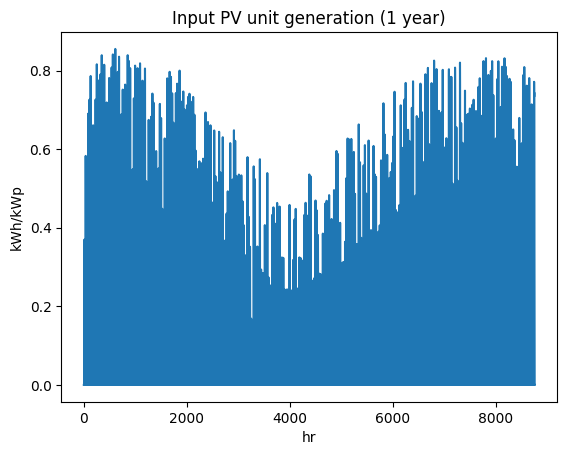

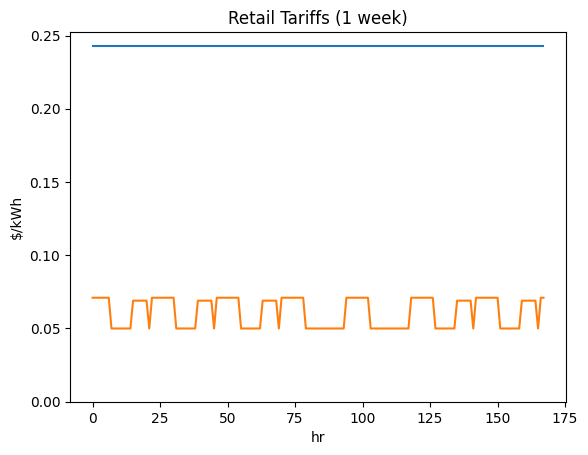

---- Optimising with PV: 1 - 20 kWp, Batt: 0 kWh. Determining PV capacity and dispatch.


************************************ Modell: PV > 1 kWp & BATT > 1 kWh ************************************
{'financial_horizon': 10, 'discount_rate': np.float64(0.06), 'grid_feedin_max': np.float64(5.0), 'pv_eol_capacity': np.float64(0.8), 'pv_eol_years': np.float64(25.0), 'pv_init_soh': np.float64(1.0), 'bess_e2p_ratio': np.float64(2.4), 'bess_roundtrip_eff': np.float64(0.88), 'bess_eol_years': np.float64(10.0), 'bess_eol_capacity': np.float64(0.7), 'bess_eol_cycles': np.float64(10000.0), 'bess_init_soh': np.float64(1.0), 'bess_eff_charge': np.float64(0.938083151964686), 'bess_eff_discharge': np.float64(0.938083151964686), 'scenario_name': 'Scenario_D_+5', 'scenario_set': 'SurfCoast', 'scenario_subset': 'JJP_open', 'year_start': 2022, 'datetime_name': 'DateTime1', 'meter_name': 'pc3039_nmi2638461858', 'solar_name': 'MELB', 'tariff_name_import_wkday': '3_Im_wkday', 'tariff_name_export_wkday': '3_

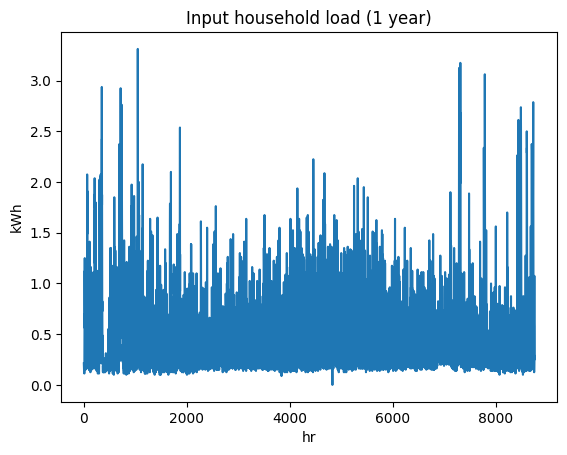

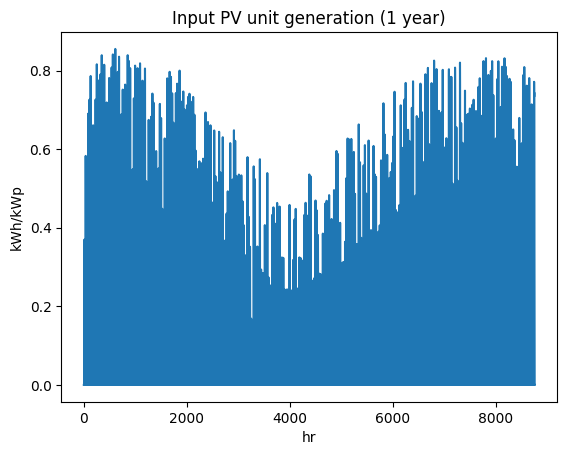

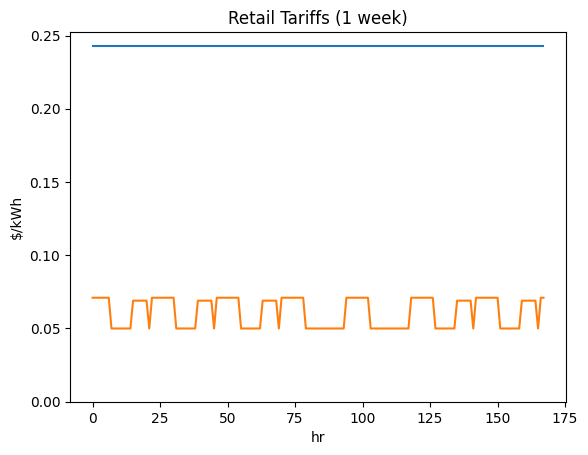

---- Optimising with PV: 1 - 20 kWp, Batt: 0 kWh. Determining PV capacity and dispatch.


************************************ Modell: PV > 1 kWp & BATT > 1 kWh ************************************
{'financial_horizon': 10, 'discount_rate': np.float64(0.06), 'grid_feedin_max': np.float64(5.0), 'pv_eol_capacity': np.float64(0.8), 'pv_eol_years': np.float64(25.0), 'pv_init_soh': np.float64(1.0), 'bess_e2p_ratio': np.float64(2.4), 'bess_roundtrip_eff': np.float64(0.88), 'bess_eol_years': np.float64(10.0), 'bess_eol_capacity': np.float64(0.7), 'bess_eol_cycles': np.float64(10000.0), 'bess_init_soh': np.float64(1.0), 'bess_eff_charge': np.float64(0.938083151964686), 'bess_eff_discharge': np.float64(0.938083151964686), 'scenario_name': 'Scenario_D_+5', 'scenario_set': 'SurfCoast', 'scenario_subset': 'JJP_open', 'year_start': 2022, 'datetime_name': 'DateTime1', 'meter_name': 'pc3039_nmi1012567299', 'solar_name': 'MELB', 'tariff_name_import_wkday': '3_Im_wkday', 'tariff_name_export_wkday': '3_

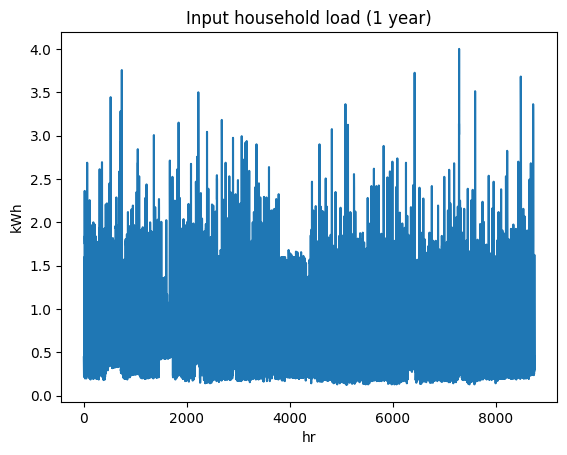

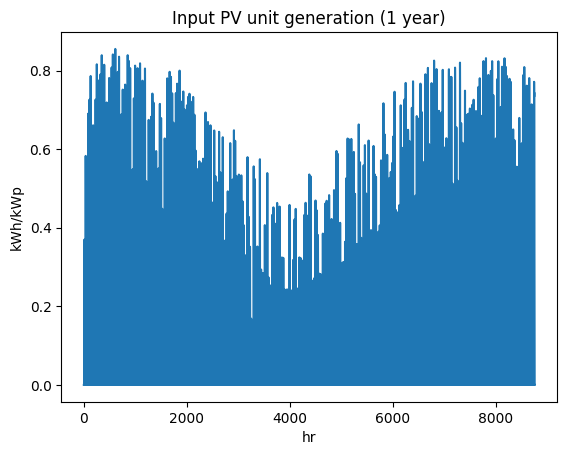

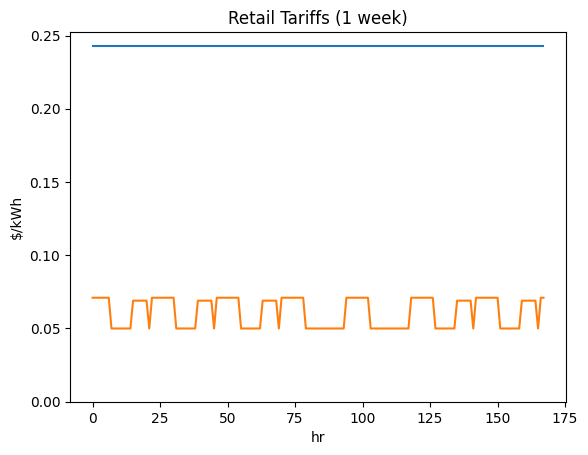

---- Optimising with PV: 1 - 20 kWp, Batt: 0 kWh. Determining PV capacity and dispatch.


************************************ Modell: PV > 1 kWp & BATT > 1 kWh ************************************
{'financial_horizon': 10, 'discount_rate': np.float64(0.06), 'grid_feedin_max': np.float64(5.0), 'pv_eol_capacity': np.float64(0.8), 'pv_eol_years': np.float64(25.0), 'pv_init_soh': np.float64(1.0), 'bess_e2p_ratio': np.float64(2.4), 'bess_roundtrip_eff': np.float64(0.88), 'bess_eol_years': np.float64(10.0), 'bess_eol_capacity': np.float64(0.7), 'bess_eol_cycles': np.float64(10000.0), 'bess_init_soh': np.float64(1.0), 'bess_eff_charge': np.float64(0.938083151964686), 'bess_eff_discharge': np.float64(0.938083151964686), 'scenario_name': 'Scenario_D_+5', 'scenario_set': 'SurfCoast', 'scenario_subset': 'JJP_open', 'year_start': 2022, 'datetime_name': 'DateTime1', 'meter_name': 'pc3039_nmi5067660925', 'solar_name': 'MELB', 'tariff_name_import_wkday': '3_Im_wkday', 'tariff_name_export_wkday': '3_

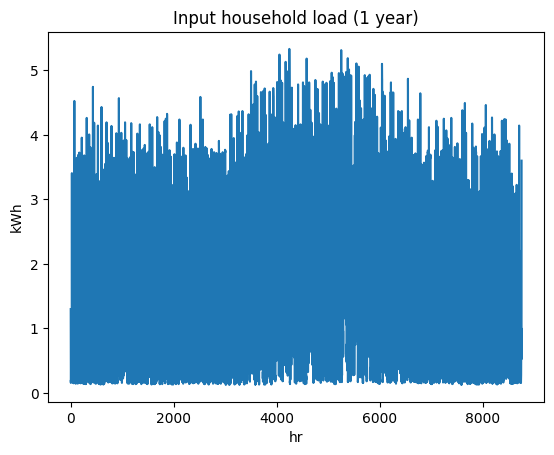

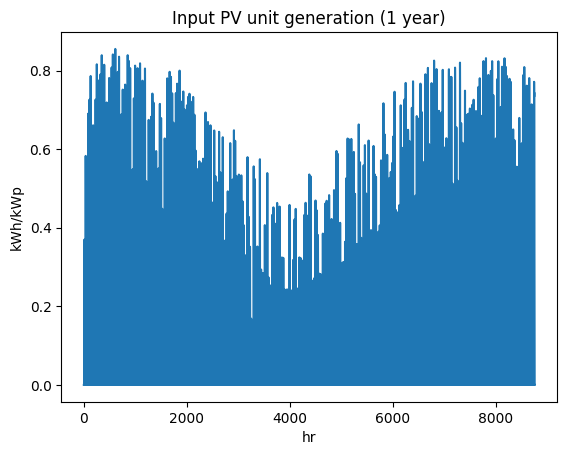

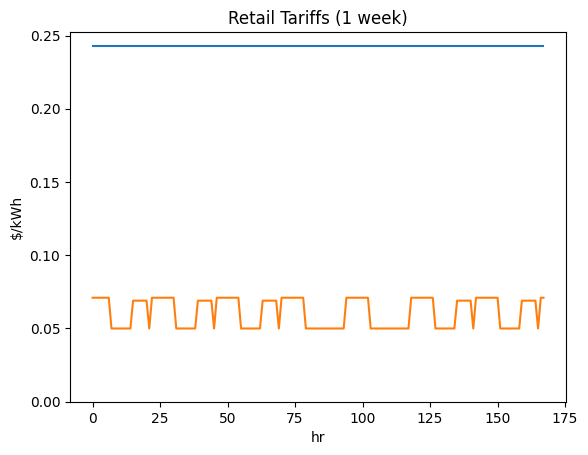

---- Optimising with PV: 1 - 20 kWp, Batt: 0 kWh. Determining PV capacity and dispatch.


************************************ Modell: PV > 1 kWp & BATT > 1 kWh ************************************
{'financial_horizon': 10, 'discount_rate': np.float64(0.06), 'grid_feedin_max': np.float64(5.0), 'pv_eol_capacity': np.float64(0.8), 'pv_eol_years': np.float64(25.0), 'pv_init_soh': np.float64(1.0), 'bess_e2p_ratio': np.float64(2.4), 'bess_roundtrip_eff': np.float64(0.88), 'bess_eol_years': np.float64(10.0), 'bess_eol_capacity': np.float64(0.7), 'bess_eol_cycles': np.float64(10000.0), 'bess_init_soh': np.float64(1.0), 'bess_eff_charge': np.float64(0.938083151964686), 'bess_eff_discharge': np.float64(0.938083151964686), 'scenario_name': 'Scenario_D_+5', 'scenario_set': 'SurfCoast', 'scenario_subset': 'JJP_open', 'year_start': 2022, 'datetime_name': 'DateTime1', 'meter_name': 'pc3039_nmi2222857284', 'solar_name': 'MELB', 'tariff_name_import_wkday': '3_Im_wkday', 'tariff_name_export_wkday': '3_

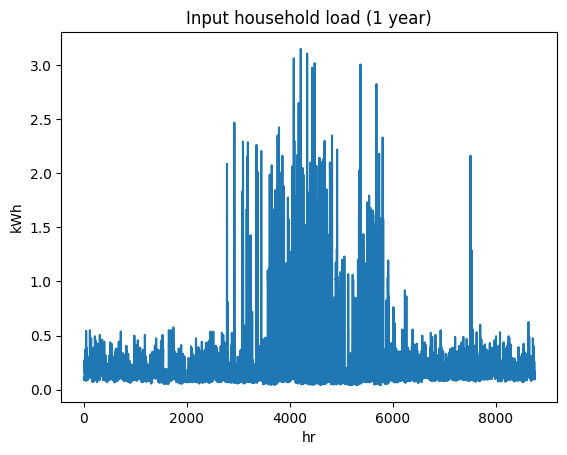

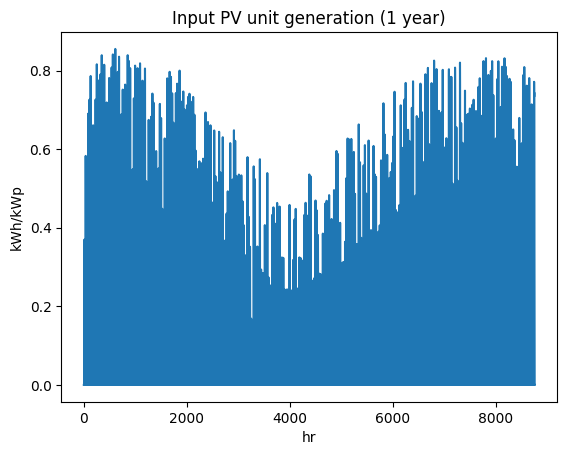

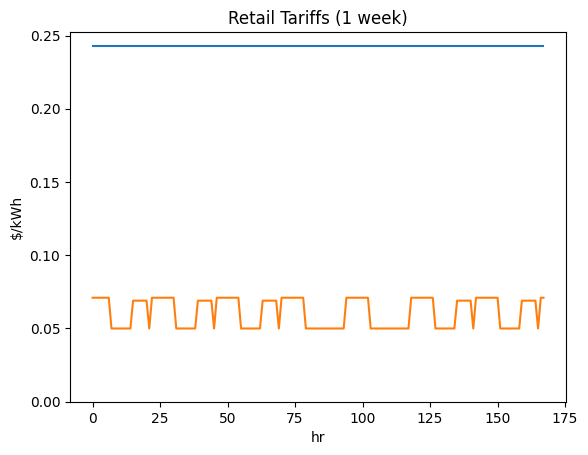

---- Optimising with PV: 1 - 20 kWp, Batt: 0 kWh. Determining PV capacity and dispatch.


************************************ Modell: PV > 1 kWp & BATT > 1 kWh ************************************
{'financial_horizon': 10, 'discount_rate': np.float64(0.06), 'grid_feedin_max': np.float64(5.0), 'pv_eol_capacity': np.float64(0.8), 'pv_eol_years': np.float64(25.0), 'pv_init_soh': np.float64(1.0), 'bess_e2p_ratio': np.float64(2.4), 'bess_roundtrip_eff': np.float64(0.88), 'bess_eol_years': np.float64(10.0), 'bess_eol_capacity': np.float64(0.7), 'bess_eol_cycles': np.float64(10000.0), 'bess_init_soh': np.float64(1.0), 'bess_eff_charge': np.float64(0.938083151964686), 'bess_eff_discharge': np.float64(0.938083151964686), 'scenario_name': 'Scenario_D_+5', 'scenario_set': 'SurfCoast', 'scenario_subset': 'JJP_open', 'year_start': 2022, 'datetime_name': 'DateTime1', 'meter_name': 'pc3039_nmi9677527479', 'solar_name': 'MELB', 'tariff_name_import_wkday': '3_Im_wkday', 'tariff_name_export_wkday': '3_

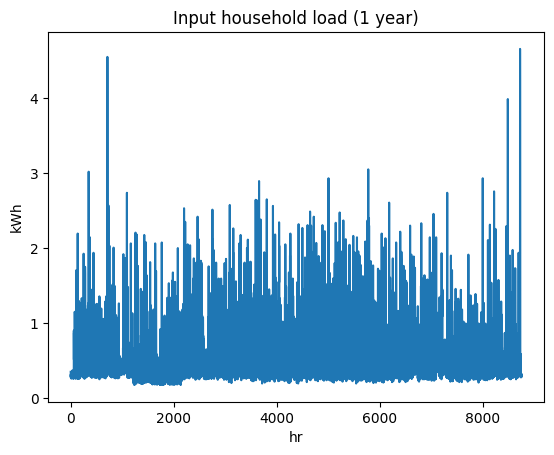

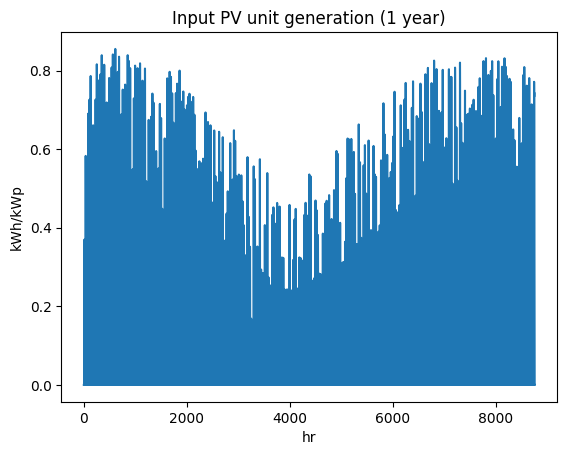

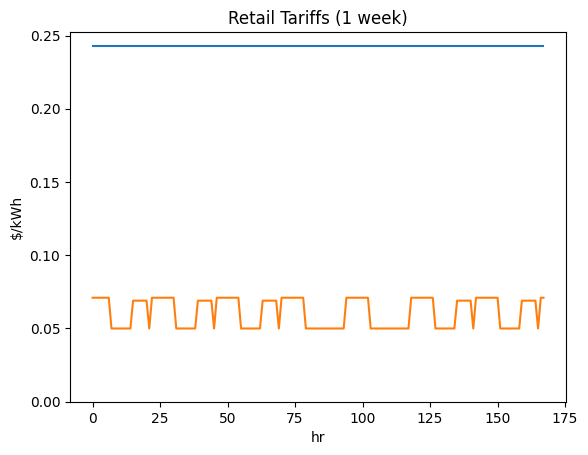

---- Optimising with PV: 1 - 20 kWp, Batt: 0 kWh. Determining PV capacity and dispatch.


************************************ Modell: PV > 1 kWp & BATT > 1 kWh ************************************
{'financial_horizon': 10, 'discount_rate': np.float64(0.06), 'grid_feedin_max': np.float64(5.0), 'pv_eol_capacity': np.float64(0.8), 'pv_eol_years': np.float64(25.0), 'pv_init_soh': np.float64(1.0), 'bess_e2p_ratio': np.float64(2.4), 'bess_roundtrip_eff': np.float64(0.88), 'bess_eol_years': np.float64(10.0), 'bess_eol_capacity': np.float64(0.7), 'bess_eol_cycles': np.float64(10000.0), 'bess_init_soh': np.float64(1.0), 'bess_eff_charge': np.float64(0.938083151964686), 'bess_eff_discharge': np.float64(0.938083151964686), 'scenario_name': 'Scenario_D_+5', 'scenario_set': 'SurfCoast', 'scenario_subset': 'JJP_open', 'year_start': 2022, 'datetime_name': 'DateTime1', 'meter_name': 'pc3039_nmi2691029133', 'solar_name': 'MELB', 'tariff_name_import_wkday': '3_Im_wkday', 'tariff_name_export_wkday': '3_

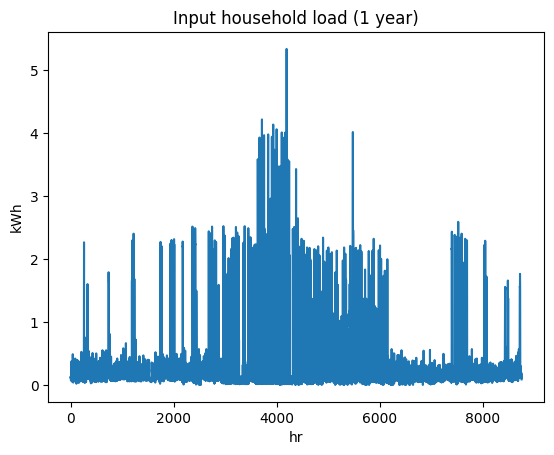

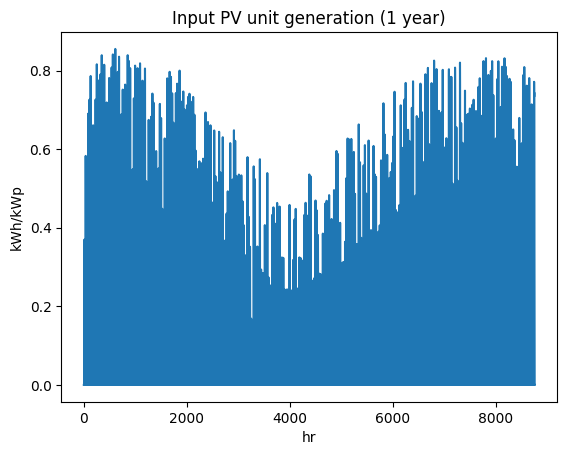

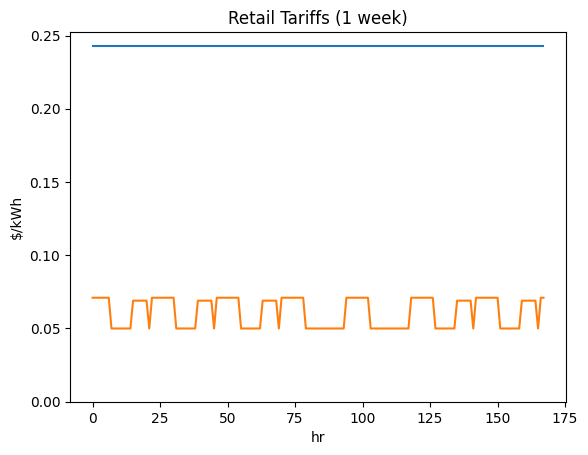

---- Optimising with PV: 1 - 20 kWp, Batt: 0 kWh. Determining PV capacity and dispatch.


************************************ Modell: PV > 1 kWp & BATT > 1 kWh ************************************
{'financial_horizon': 10, 'discount_rate': np.float64(0.06), 'grid_feedin_max': np.float64(5.0), 'pv_eol_capacity': np.float64(0.8), 'pv_eol_years': np.float64(25.0), 'pv_init_soh': np.float64(1.0), 'bess_e2p_ratio': np.float64(2.4), 'bess_roundtrip_eff': np.float64(0.88), 'bess_eol_years': np.float64(10.0), 'bess_eol_capacity': np.float64(0.7), 'bess_eol_cycles': np.float64(10000.0), 'bess_init_soh': np.float64(1.0), 'bess_eff_charge': np.float64(0.938083151964686), 'bess_eff_discharge': np.float64(0.938083151964686), 'scenario_name': 'Scenario_D_+5', 'scenario_set': 'SurfCoast', 'scenario_subset': 'JJP_open', 'year_start': 2022, 'datetime_name': 'DateTime1', 'meter_name': 'pc3039_nmi7242502380', 'solar_name': 'MELB', 'tariff_name_import_wkday': '3_Im_wkday', 'tariff_name_export_wkday': '3_

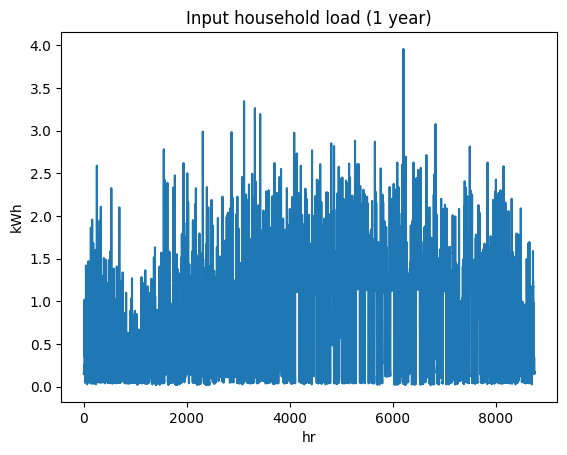

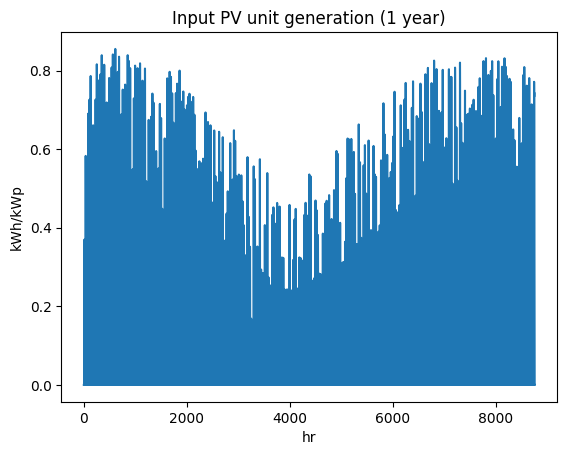

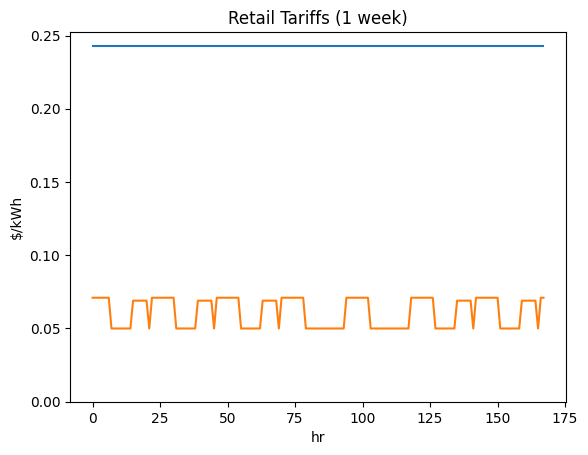

---- Optimising with PV: 1 - 20 kWp, Batt: 0 kWh. Determining PV capacity and dispatch.


************************************ Modell: PV > 1 kWp & BATT > 1 kWh ************************************
{'financial_horizon': 10, 'discount_rate': np.float64(0.06), 'grid_feedin_max': np.float64(5.0), 'pv_eol_capacity': np.float64(0.8), 'pv_eol_years': np.float64(25.0), 'pv_init_soh': np.float64(1.0), 'bess_e2p_ratio': np.float64(2.4), 'bess_roundtrip_eff': np.float64(0.88), 'bess_eol_years': np.float64(10.0), 'bess_eol_capacity': np.float64(0.7), 'bess_eol_cycles': np.float64(10000.0), 'bess_init_soh': np.float64(1.0), 'bess_eff_charge': np.float64(0.938083151964686), 'bess_eff_discharge': np.float64(0.938083151964686), 'scenario_name': 'Scenario_D_+5', 'scenario_set': 'SurfCoast', 'scenario_subset': 'JJP_open', 'year_start': 2022, 'datetime_name': 'DateTime1', 'meter_name': 'pc3039_nmi4073876263', 'solar_name': 'MELB', 'tariff_name_import_wkday': '3_Im_wkday', 'tariff_name_export_wkday': '3_

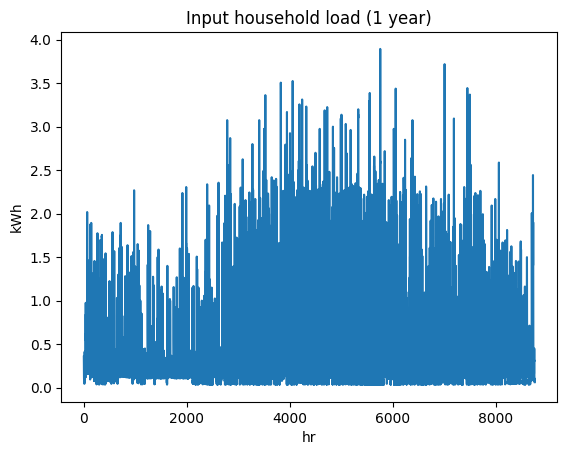

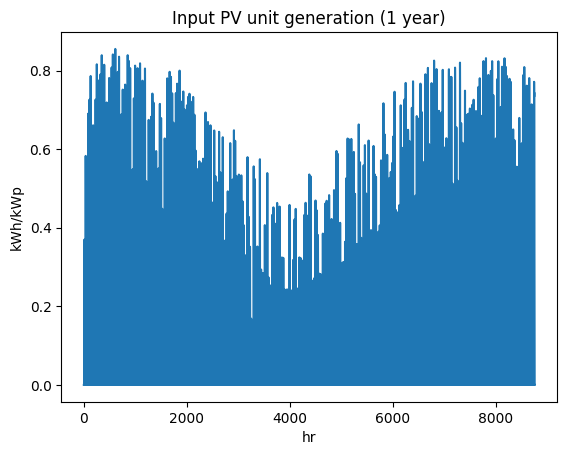

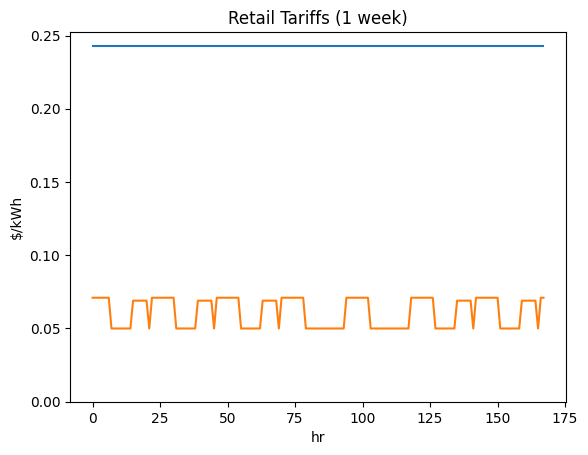

---- Optimising with PV: 1 - 20 kWp, Batt: 0 kWh. Determining PV capacity and dispatch.


************************************ Modell: PV > 1 kWp & BATT > 1 kWh ************************************
{'financial_horizon': 10, 'discount_rate': np.float64(0.06), 'grid_feedin_max': np.float64(5.0), 'pv_eol_capacity': np.float64(0.8), 'pv_eol_years': np.float64(25.0), 'pv_init_soh': np.float64(1.0), 'bess_e2p_ratio': np.float64(2.4), 'bess_roundtrip_eff': np.float64(0.88), 'bess_eol_years': np.float64(10.0), 'bess_eol_capacity': np.float64(0.7), 'bess_eol_cycles': np.float64(10000.0), 'bess_init_soh': np.float64(1.0), 'bess_eff_charge': np.float64(0.938083151964686), 'bess_eff_discharge': np.float64(0.938083151964686), 'scenario_name': 'Scenario_D_+5', 'scenario_set': 'SurfCoast', 'scenario_subset': 'JJP_open', 'year_start': 2022, 'datetime_name': 'DateTime1', 'meter_name': 'pc3039_nmi6983051636', 'solar_name': 'MELB', 'tariff_name_import_wkday': '3_Im_wkday', 'tariff_name_export_wkday': '3_

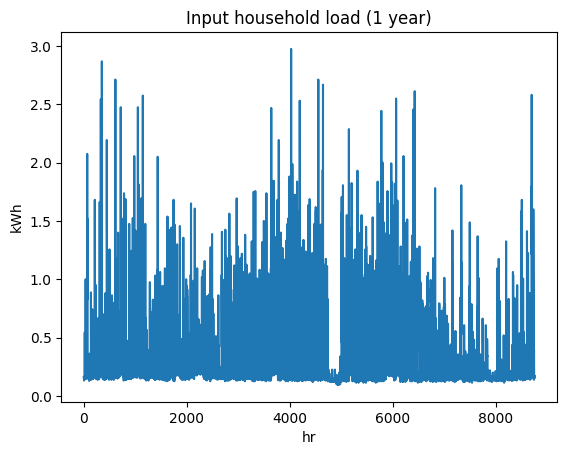

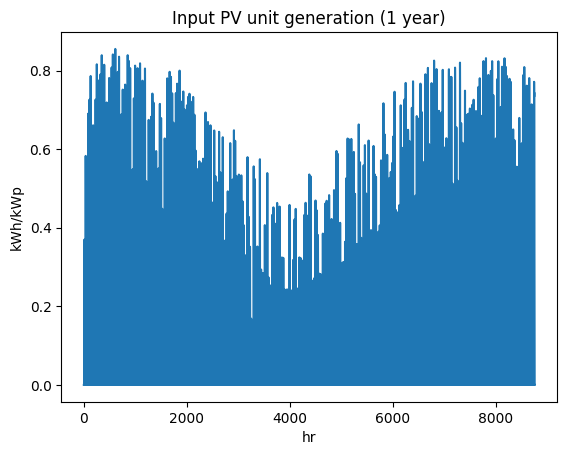

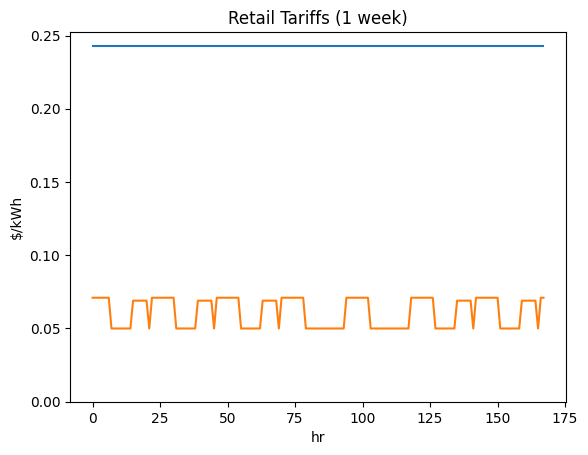

---- Optimising with PV: 1 - 20 kWp, Batt: 0 kWh. Determining PV capacity and dispatch.


************************************ Modell: PV > 1 kWp & BATT > 1 kWh ************************************
{'financial_horizon': 10, 'discount_rate': np.float64(0.06), 'grid_feedin_max': np.float64(5.0), 'pv_eol_capacity': np.float64(0.8), 'pv_eol_years': np.float64(25.0), 'pv_init_soh': np.float64(1.0), 'bess_e2p_ratio': np.float64(2.4), 'bess_roundtrip_eff': np.float64(0.88), 'bess_eol_years': np.float64(10.0), 'bess_eol_capacity': np.float64(0.7), 'bess_eol_cycles': np.float64(10000.0), 'bess_init_soh': np.float64(1.0), 'bess_eff_charge': np.float64(0.938083151964686), 'bess_eff_discharge': np.float64(0.938083151964686), 'scenario_name': 'Scenario_D_+5', 'scenario_set': 'SurfCoast', 'scenario_subset': 'JJP_open', 'year_start': 2022, 'datetime_name': 'DateTime1', 'meter_name': 'pc3039_nmi9031099426', 'solar_name': 'MELB', 'tariff_name_import_wkday': '3_Im_wkday', 'tariff_name_export_wkday': '3_

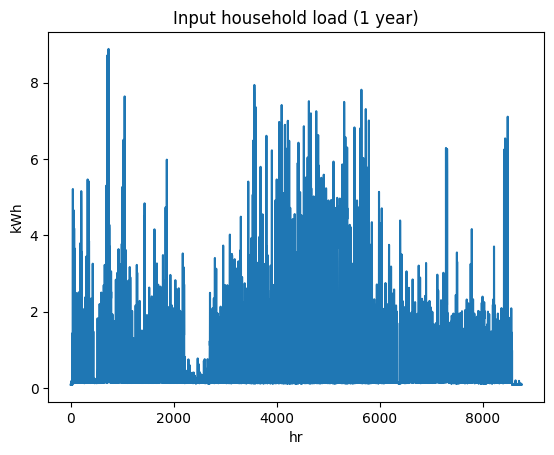

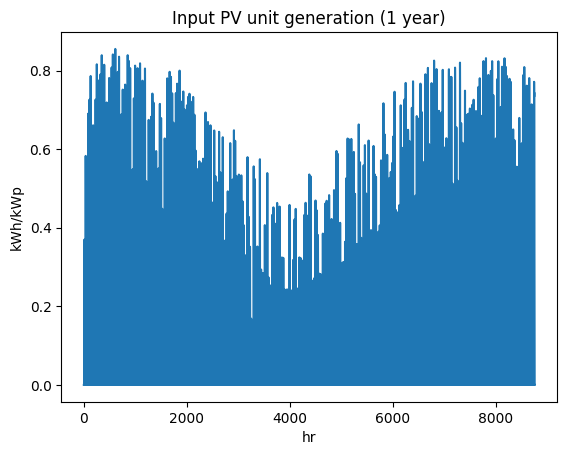

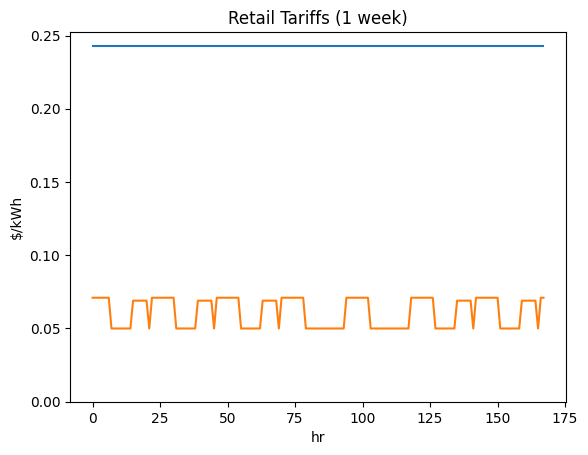

---- Optimising with PV: 1 - 20 kWp, Batt: 0 kWh. Determining PV capacity and dispatch.


************************************ Modell: PV > 1 kWp & BATT > 1 kWh ************************************
{'financial_horizon': 10, 'discount_rate': np.float64(0.06), 'grid_feedin_max': np.float64(5.0), 'pv_eol_capacity': np.float64(0.8), 'pv_eol_years': np.float64(25.0), 'pv_init_soh': np.float64(1.0), 'bess_e2p_ratio': np.float64(2.4), 'bess_roundtrip_eff': np.float64(0.88), 'bess_eol_years': np.float64(10.0), 'bess_eol_capacity': np.float64(0.7), 'bess_eol_cycles': np.float64(10000.0), 'bess_init_soh': np.float64(1.0), 'bess_eff_charge': np.float64(0.938083151964686), 'bess_eff_discharge': np.float64(0.938083151964686), 'scenario_name': 'Scenario_D_+5', 'scenario_set': 'SurfCoast', 'scenario_subset': 'JJP_open', 'year_start': 2022, 'datetime_name': 'DateTime1', 'meter_name': 'pc3039_nmi9230132750', 'solar_name': 'MELB', 'tariff_name_import_wkday': '3_Im_wkday', 'tariff_name_export_wkday': '3_

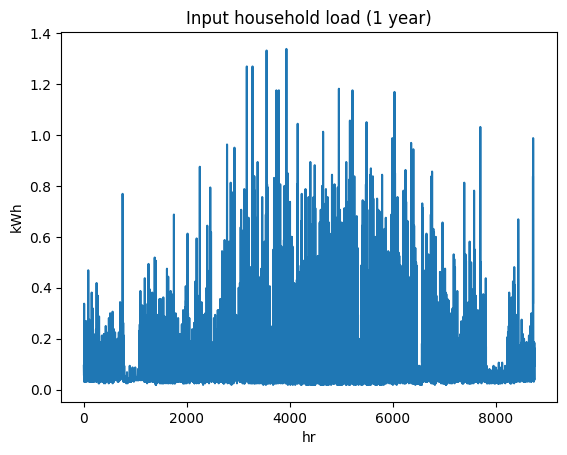

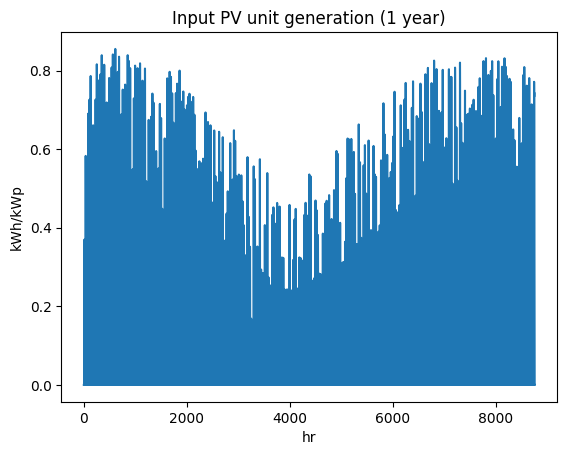

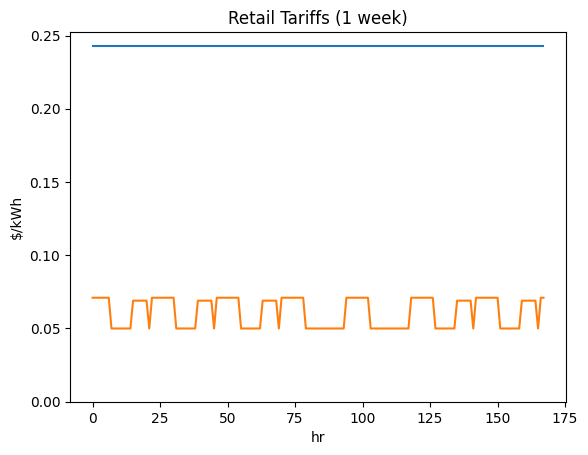

---- Optimising with PV: 1 - 20 kWp, Batt: 0 kWh. Determining PV capacity and dispatch.


************************************ Modell: PV > 1 kWp & BATT > 1 kWh ************************************
{'financial_horizon': 10, 'discount_rate': np.float64(0.06), 'grid_feedin_max': np.float64(5.0), 'pv_eol_capacity': np.float64(0.8), 'pv_eol_years': np.float64(25.0), 'pv_init_soh': np.float64(1.0), 'bess_e2p_ratio': np.float64(2.4), 'bess_roundtrip_eff': np.float64(0.88), 'bess_eol_years': np.float64(10.0), 'bess_eol_capacity': np.float64(0.7), 'bess_eol_cycles': np.float64(10000.0), 'bess_init_soh': np.float64(1.0), 'bess_eff_charge': np.float64(0.938083151964686), 'bess_eff_discharge': np.float64(0.938083151964686), 'scenario_name': 'Scenario_D_+5', 'scenario_set': 'SurfCoast', 'scenario_subset': 'JJP_open', 'year_start': 2022, 'datetime_name': 'DateTime1', 'meter_name': 'pc3039_nmi5029621300', 'solar_name': 'MELB', 'tariff_name_import_wkday': '3_Im_wkday', 'tariff_name_export_wkday': '3_

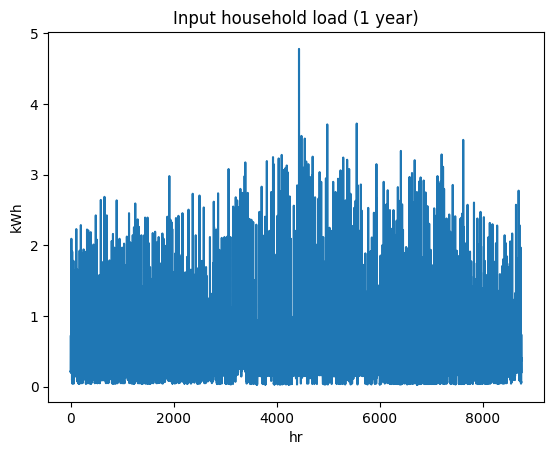

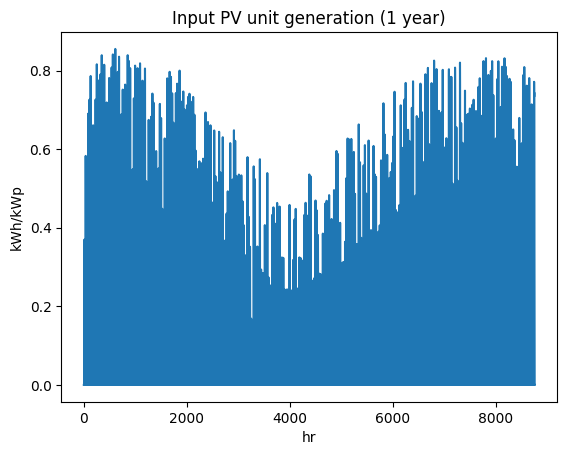

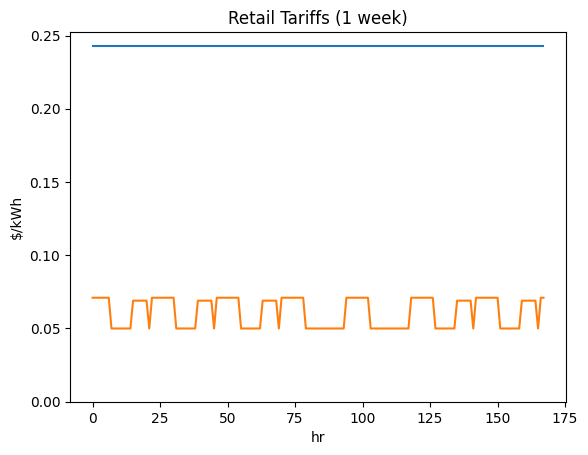

---- Optimising with PV: 1 - 20 kWp, Batt: 0 kWh. Determining PV capacity and dispatch.


************************************ Modell: PV > 1 kWp & BATT > 1 kWh ************************************
{'financial_horizon': 10, 'discount_rate': np.float64(0.06), 'grid_feedin_max': np.float64(5.0), 'pv_eol_capacity': np.float64(0.8), 'pv_eol_years': np.float64(25.0), 'pv_init_soh': np.float64(1.0), 'bess_e2p_ratio': np.float64(2.4), 'bess_roundtrip_eff': np.float64(0.88), 'bess_eol_years': np.float64(10.0), 'bess_eol_capacity': np.float64(0.7), 'bess_eol_cycles': np.float64(10000.0), 'bess_init_soh': np.float64(1.0), 'bess_eff_charge': np.float64(0.938083151964686), 'bess_eff_discharge': np.float64(0.938083151964686), 'scenario_name': 'Scenario_D_+5', 'scenario_set': 'SurfCoast', 'scenario_subset': 'JJP_open', 'year_start': 2022, 'datetime_name': 'DateTime1', 'meter_name': 'pc3040_nmi7174497628', 'solar_name': 'MELB', 'tariff_name_import_wkday': '3_Im_wkday', 'tariff_name_export_wkday': '3_

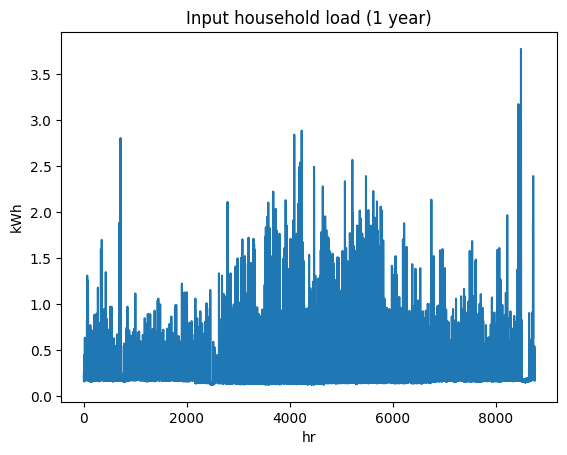

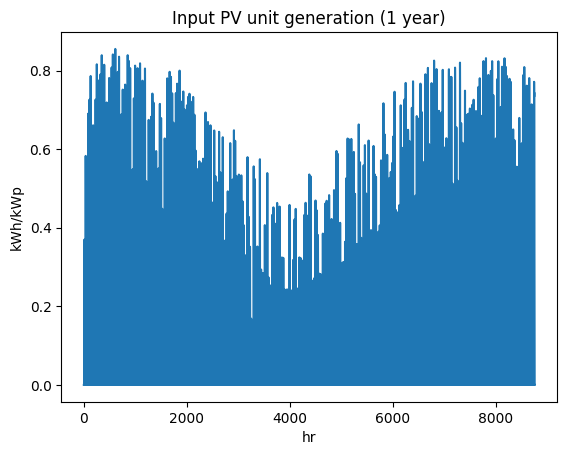

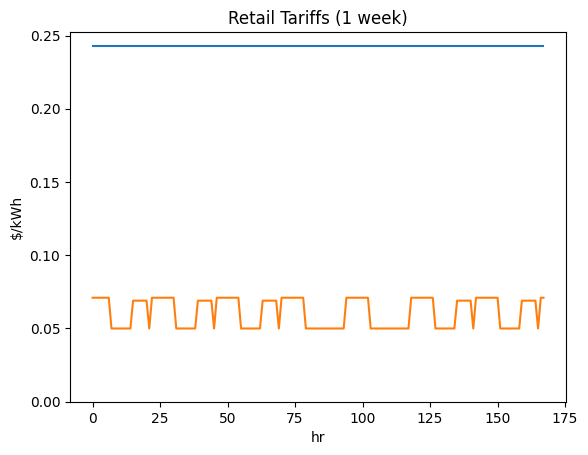

---- Optimising with PV: 1 - 20 kWp, Batt: 0 kWh. Determining PV capacity and dispatch.


************************************ Modell: PV > 1 kWp & BATT > 1 kWh ************************************
{'financial_horizon': 10, 'discount_rate': np.float64(0.06), 'grid_feedin_max': np.float64(5.0), 'pv_eol_capacity': np.float64(0.8), 'pv_eol_years': np.float64(25.0), 'pv_init_soh': np.float64(1.0), 'bess_e2p_ratio': np.float64(2.4), 'bess_roundtrip_eff': np.float64(0.88), 'bess_eol_years': np.float64(10.0), 'bess_eol_capacity': np.float64(0.7), 'bess_eol_cycles': np.float64(10000.0), 'bess_init_soh': np.float64(1.0), 'bess_eff_charge': np.float64(0.938083151964686), 'bess_eff_discharge': np.float64(0.938083151964686), 'scenario_name': 'Scenario_D_+5', 'scenario_set': 'SurfCoast', 'scenario_subset': 'JJP_open', 'year_start': 2022, 'datetime_name': 'DateTime1', 'meter_name': 'pc3040_nmi9765378288', 'solar_name': 'MELB', 'tariff_name_import_wkday': '3_Im_wkday', 'tariff_name_export_wkday': '3_

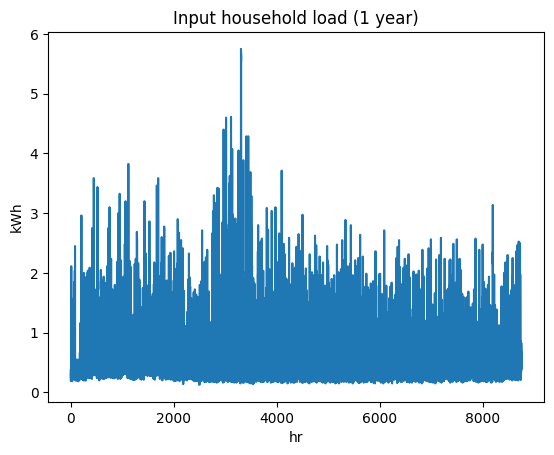

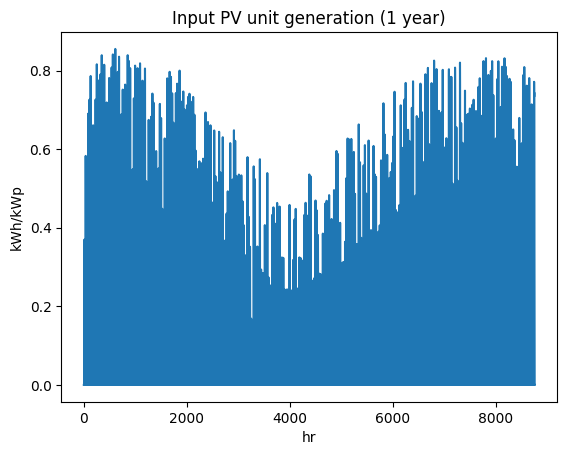

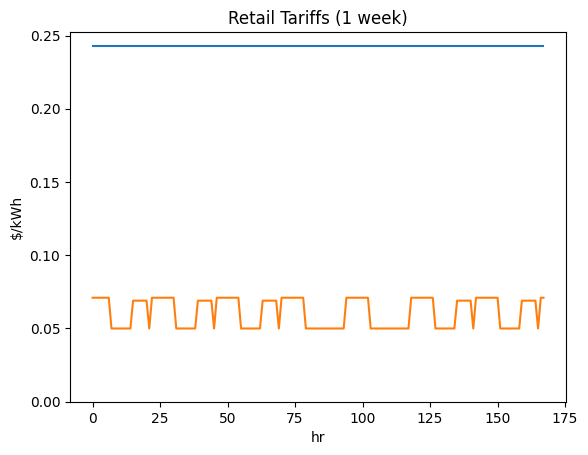

---- Optimising with PV: 1 - 20 kWp, Batt: 0 kWh. Determining PV capacity and dispatch.


************************************ Modell: PV > 1 kWp & BATT > 1 kWh ************************************
{'financial_horizon': 10, 'discount_rate': np.float64(0.06), 'grid_feedin_max': np.float64(5.0), 'pv_eol_capacity': np.float64(0.8), 'pv_eol_years': np.float64(25.0), 'pv_init_soh': np.float64(1.0), 'bess_e2p_ratio': np.float64(2.4), 'bess_roundtrip_eff': np.float64(0.88), 'bess_eol_years': np.float64(10.0), 'bess_eol_capacity': np.float64(0.7), 'bess_eol_cycles': np.float64(10000.0), 'bess_init_soh': np.float64(1.0), 'bess_eff_charge': np.float64(0.938083151964686), 'bess_eff_discharge': np.float64(0.938083151964686), 'scenario_name': 'Scenario_D_+5', 'scenario_set': 'SurfCoast', 'scenario_subset': 'JJP_open', 'year_start': 2022, 'datetime_name': 'DateTime1', 'meter_name': 'pc3040_nmi6042341934', 'solar_name': 'MELB', 'tariff_name_import_wkday': '3_Im_wkday', 'tariff_name_export_wkday': '3_

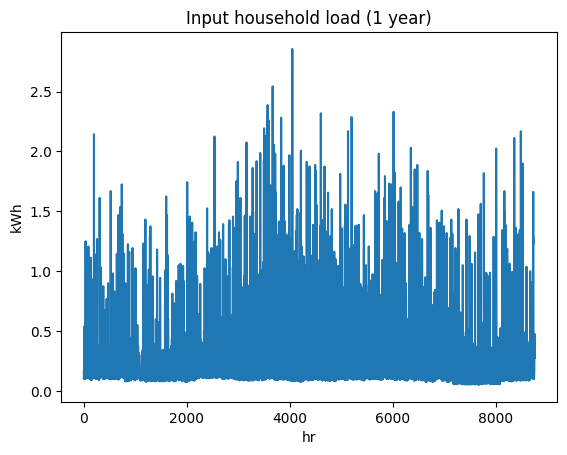

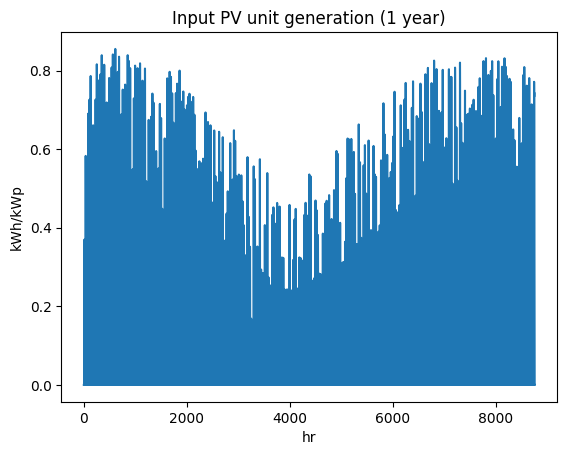

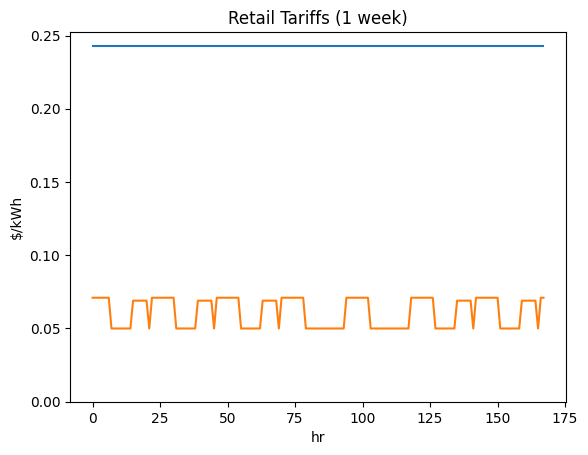

---- Optimising with PV: 1 - 20 kWp, Batt: 0 kWh. Determining PV capacity and dispatch.


************************************ Modell: PV > 1 kWp & BATT > 1 kWh ************************************
{'financial_horizon': 10, 'discount_rate': np.float64(0.06), 'grid_feedin_max': np.float64(5.0), 'pv_eol_capacity': np.float64(0.8), 'pv_eol_years': np.float64(25.0), 'pv_init_soh': np.float64(1.0), 'bess_e2p_ratio': np.float64(2.4), 'bess_roundtrip_eff': np.float64(0.88), 'bess_eol_years': np.float64(10.0), 'bess_eol_capacity': np.float64(0.7), 'bess_eol_cycles': np.float64(10000.0), 'bess_init_soh': np.float64(1.0), 'bess_eff_charge': np.float64(0.938083151964686), 'bess_eff_discharge': np.float64(0.938083151964686), 'scenario_name': 'Scenario_D_+5', 'scenario_set': 'SurfCoast', 'scenario_subset': 'JJP_open', 'year_start': 2022, 'datetime_name': 'DateTime1', 'meter_name': 'pc3040_nmi2652551635', 'solar_name': 'MELB', 'tariff_name_import_wkday': '3_Im_wkday', 'tariff_name_export_wkday': '3_

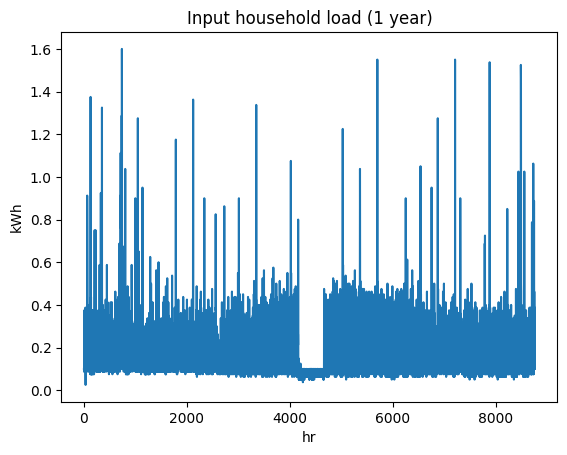

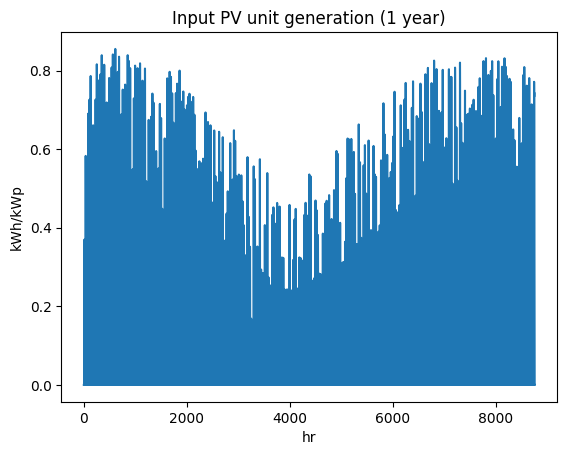

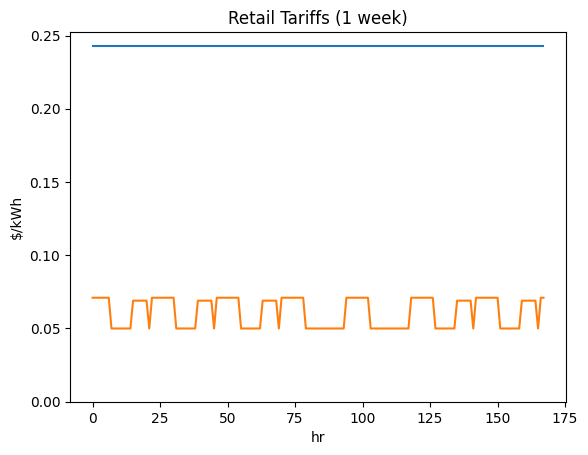

---- Optimising with PV: 1 - 20 kWp, Batt: 0 kWh. Determining PV capacity and dispatch.


************************************ Modell: PV > 1 kWp & BATT > 1 kWh ************************************
{'financial_horizon': 10, 'discount_rate': np.float64(0.06), 'grid_feedin_max': np.float64(5.0), 'pv_eol_capacity': np.float64(0.8), 'pv_eol_years': np.float64(25.0), 'pv_init_soh': np.float64(1.0), 'bess_e2p_ratio': np.float64(2.4), 'bess_roundtrip_eff': np.float64(0.88), 'bess_eol_years': np.float64(10.0), 'bess_eol_capacity': np.float64(0.7), 'bess_eol_cycles': np.float64(10000.0), 'bess_init_soh': np.float64(1.0), 'bess_eff_charge': np.float64(0.938083151964686), 'bess_eff_discharge': np.float64(0.938083151964686), 'scenario_name': 'Scenario_D_+5', 'scenario_set': 'SurfCoast', 'scenario_subset': 'JJP_open', 'year_start': 2022, 'datetime_name': 'DateTime1', 'meter_name': 'pc3040_nmi6552264269', 'solar_name': 'MELB', 'tariff_name_import_wkday': '3_Im_wkday', 'tariff_name_export_wkday': '3_

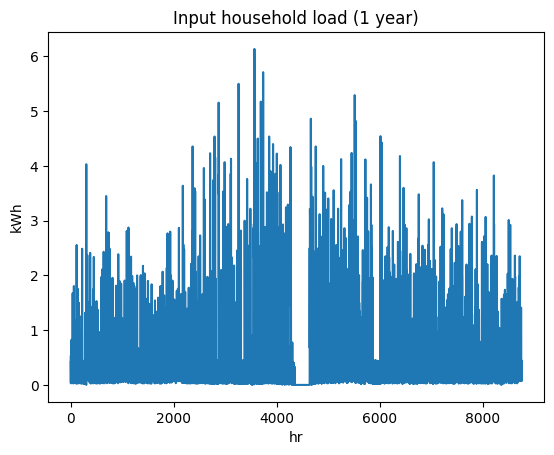

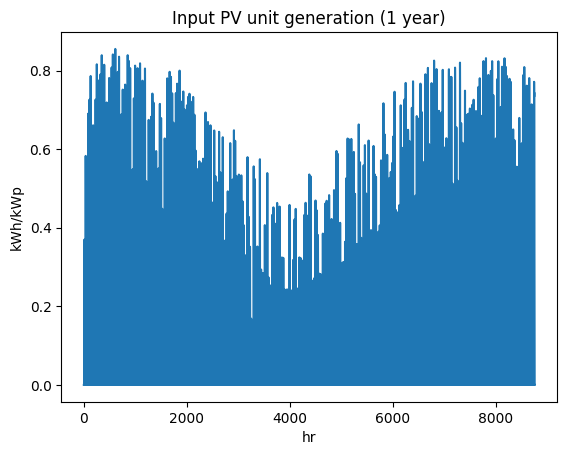

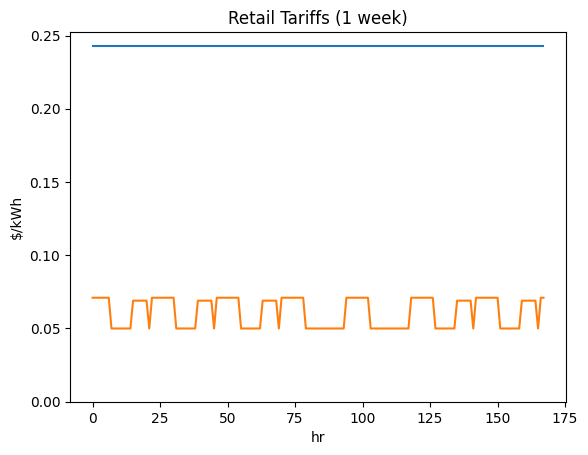

---- Optimising with PV: 1 - 20 kWp, Batt: 0 kWh. Determining PV capacity and dispatch.


************************************ Modell: PV > 1 kWp & BATT > 1 kWh ************************************
{'financial_horizon': 10, 'discount_rate': np.float64(0.06), 'grid_feedin_max': np.float64(5.0), 'pv_eol_capacity': np.float64(0.8), 'pv_eol_years': np.float64(25.0), 'pv_init_soh': np.float64(1.0), 'bess_e2p_ratio': np.float64(2.4), 'bess_roundtrip_eff': np.float64(0.88), 'bess_eol_years': np.float64(10.0), 'bess_eol_capacity': np.float64(0.7), 'bess_eol_cycles': np.float64(10000.0), 'bess_init_soh': np.float64(1.0), 'bess_eff_charge': np.float64(0.938083151964686), 'bess_eff_discharge': np.float64(0.938083151964686), 'scenario_name': 'Scenario_D_+5', 'scenario_set': 'SurfCoast', 'scenario_subset': 'JJP_open', 'year_start': 2022, 'datetime_name': 'DateTime1', 'meter_name': 'pc3040_nmi2324185624', 'solar_name': 'MELB', 'tariff_name_import_wkday': '3_Im_wkday', 'tariff_name_export_wkday': '3_

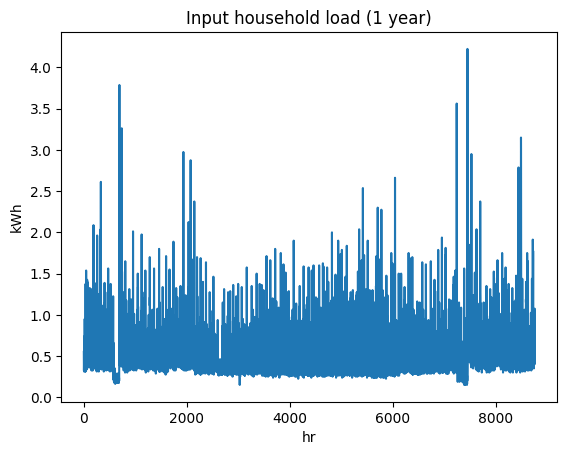

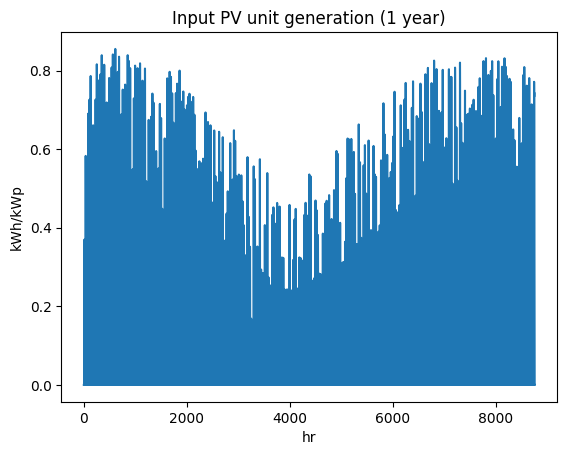

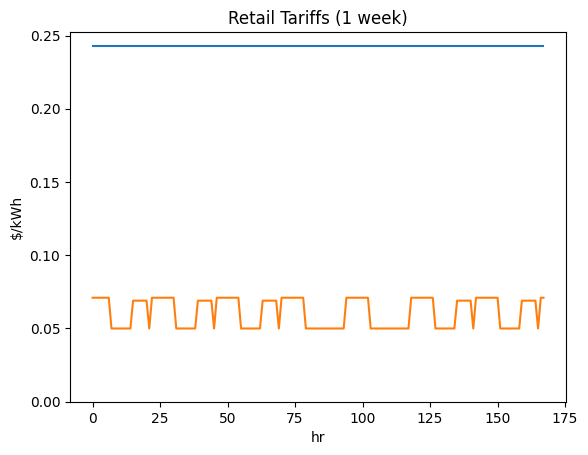

---- Optimising with PV: 1 - 20 kWp, Batt: 0 kWh. Determining PV capacity and dispatch.


************************************ Modell: PV > 1 kWp & BATT > 1 kWh ************************************
{'financial_horizon': 10, 'discount_rate': np.float64(0.06), 'grid_feedin_max': np.float64(5.0), 'pv_eol_capacity': np.float64(0.8), 'pv_eol_years': np.float64(25.0), 'pv_init_soh': np.float64(1.0), 'bess_e2p_ratio': np.float64(2.4), 'bess_roundtrip_eff': np.float64(0.88), 'bess_eol_years': np.float64(10.0), 'bess_eol_capacity': np.float64(0.7), 'bess_eol_cycles': np.float64(10000.0), 'bess_init_soh': np.float64(1.0), 'bess_eff_charge': np.float64(0.938083151964686), 'bess_eff_discharge': np.float64(0.938083151964686), 'scenario_name': 'Scenario_D_+5', 'scenario_set': 'SurfCoast', 'scenario_subset': 'JJP_open', 'year_start': 2022, 'datetime_name': 'DateTime1', 'meter_name': 'pc3040_nmi9072199131', 'solar_name': 'MELB', 'tariff_name_import_wkday': '3_Im_wkday', 'tariff_name_export_wkday': '3_

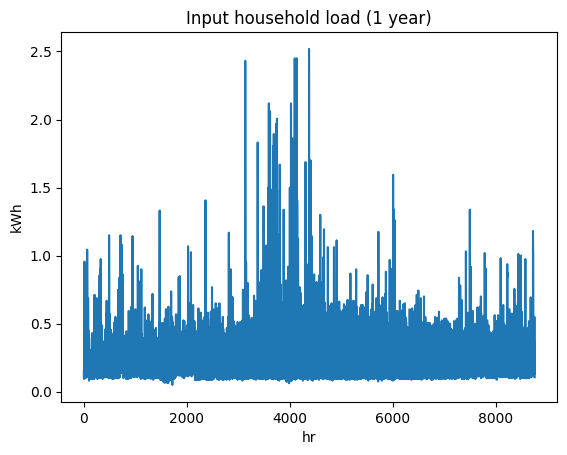

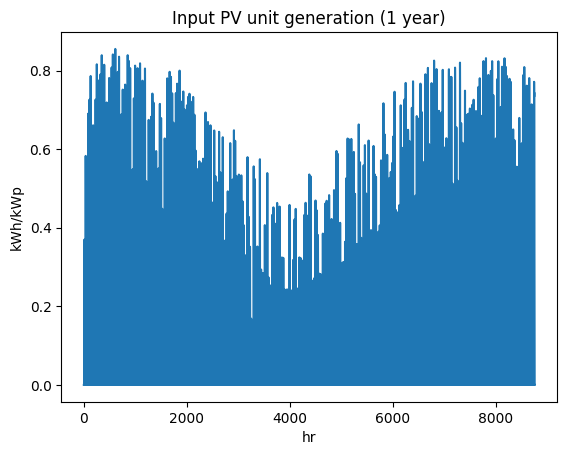

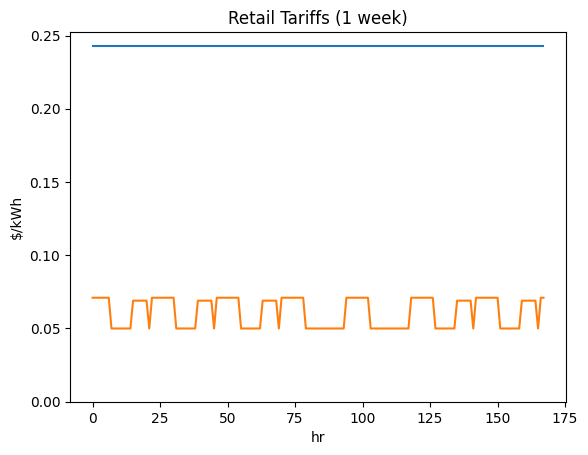

---- Optimising with PV: 1 - 20 kWp, Batt: 0 kWh. Determining PV capacity and dispatch.


************************************ Modell: PV > 1 kWp & BATT > 1 kWh ************************************
{'financial_horizon': 10, 'discount_rate': np.float64(0.06), 'grid_feedin_max': np.float64(5.0), 'pv_eol_capacity': np.float64(0.8), 'pv_eol_years': np.float64(25.0), 'pv_init_soh': np.float64(1.0), 'bess_e2p_ratio': np.float64(2.4), 'bess_roundtrip_eff': np.float64(0.88), 'bess_eol_years': np.float64(10.0), 'bess_eol_capacity': np.float64(0.7), 'bess_eol_cycles': np.float64(10000.0), 'bess_init_soh': np.float64(1.0), 'bess_eff_charge': np.float64(0.938083151964686), 'bess_eff_discharge': np.float64(0.938083151964686), 'scenario_name': 'Scenario_D_+5', 'scenario_set': 'SurfCoast', 'scenario_subset': 'JJP_open', 'year_start': 2022, 'datetime_name': 'DateTime1', 'meter_name': 'pc3040_nmi6266086248', 'solar_name': 'MELB', 'tariff_name_import_wkday': '3_Im_wkday', 'tariff_name_export_wkday': '3_

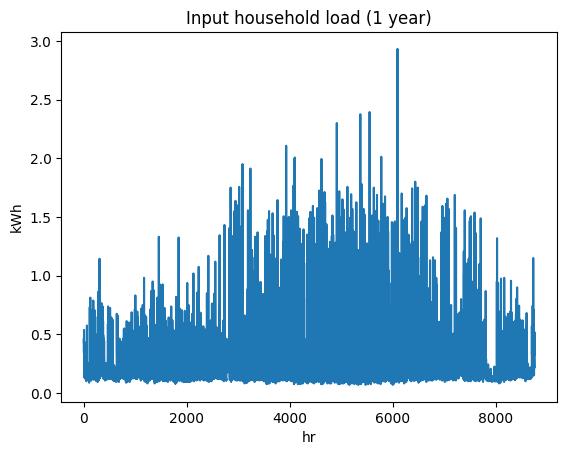

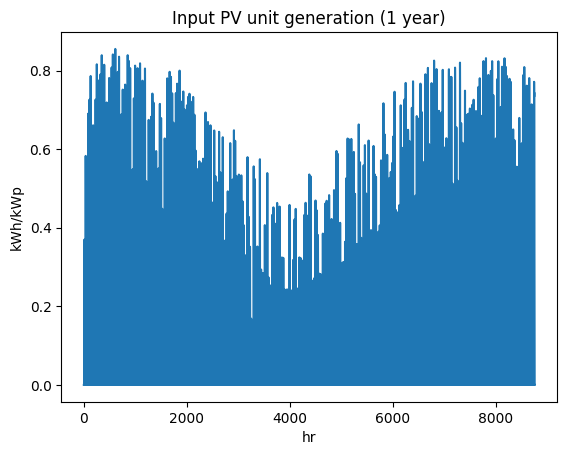

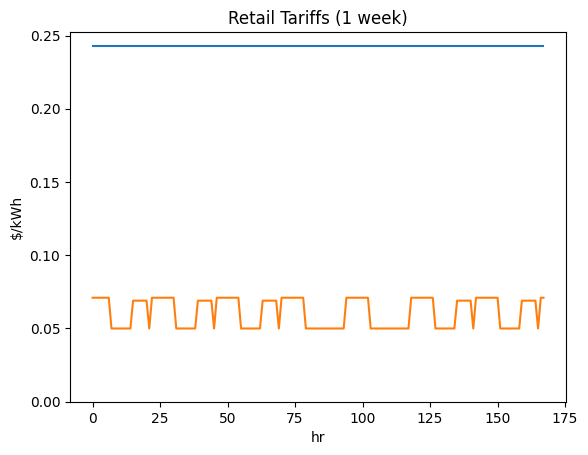

---- Optimising with PV: 1 - 20 kWp, Batt: 0 kWh. Determining PV capacity and dispatch.


************************************ Modell: PV > 1 kWp & BATT > 1 kWh ************************************
{'financial_horizon': 10, 'discount_rate': np.float64(0.06), 'grid_feedin_max': np.float64(5.0), 'pv_eol_capacity': np.float64(0.8), 'pv_eol_years': np.float64(25.0), 'pv_init_soh': np.float64(1.0), 'bess_e2p_ratio': np.float64(2.4), 'bess_roundtrip_eff': np.float64(0.88), 'bess_eol_years': np.float64(10.0), 'bess_eol_capacity': np.float64(0.7), 'bess_eol_cycles': np.float64(10000.0), 'bess_init_soh': np.float64(1.0), 'bess_eff_charge': np.float64(0.938083151964686), 'bess_eff_discharge': np.float64(0.938083151964686), 'scenario_name': 'Scenario_D_+5', 'scenario_set': 'SurfCoast', 'scenario_subset': 'JJP_open', 'year_start': 2022, 'datetime_name': 'DateTime1', 'meter_name': 'pc3039_nmi1938696024', 'solar_name': 'MELB', 'tariff_name_import_wkday': '3_Im_wkday', 'tariff_name_export_wkday': '3_

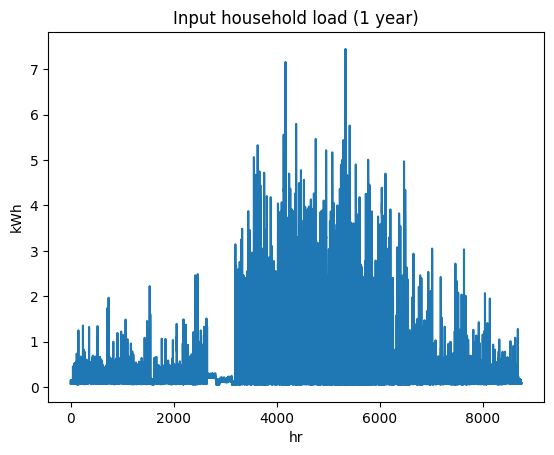

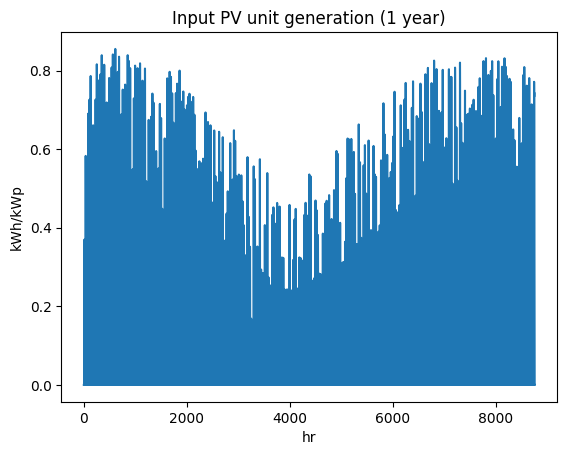

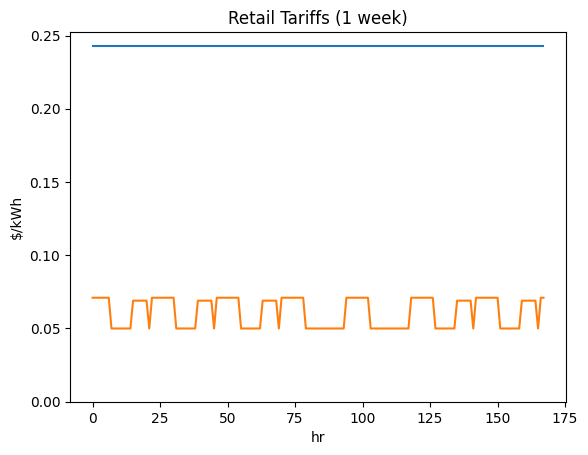

---- Optimising with PV: 1 - 20 kWp, Batt: 0 kWh. Determining PV capacity and dispatch.


************************************ Modell: PV > 1 kWp & BATT > 1 kWh ************************************
{'financial_horizon': 10, 'discount_rate': np.float64(0.06), 'grid_feedin_max': np.float64(5.0), 'pv_eol_capacity': np.float64(0.8), 'pv_eol_years': np.float64(25.0), 'pv_init_soh': np.float64(1.0), 'bess_e2p_ratio': np.float64(2.4), 'bess_roundtrip_eff': np.float64(0.88), 'bess_eol_years': np.float64(10.0), 'bess_eol_capacity': np.float64(0.7), 'bess_eol_cycles': np.float64(10000.0), 'bess_init_soh': np.float64(1.0), 'bess_eff_charge': np.float64(0.938083151964686), 'bess_eff_discharge': np.float64(0.938083151964686), 'scenario_name': 'Scenario_D_+5', 'scenario_set': 'SurfCoast', 'scenario_subset': 'JJP_open', 'year_start': 2022, 'datetime_name': 'DateTime1', 'meter_name': 'pc3039_nmi4500525894', 'solar_name': 'MELB', 'tariff_name_import_wkday': '3_Im_wkday', 'tariff_name_export_wkday': '3_

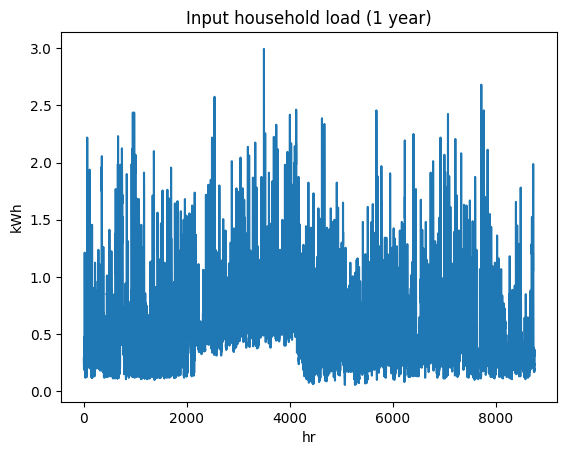

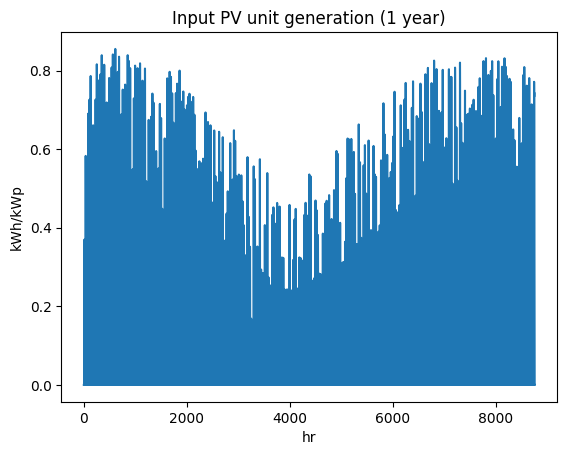

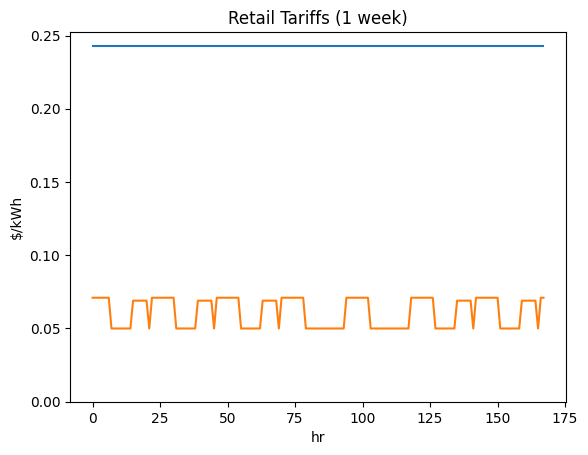

---- Optimising with PV: 1 - 20 kWp, Batt: 0 kWh. Determining PV capacity and dispatch.


************************************ Modell: PV > 1 kWp & BATT > 1 kWh ************************************
{'financial_horizon': 10, 'discount_rate': np.float64(0.06), 'grid_feedin_max': np.float64(5.0), 'pv_eol_capacity': np.float64(0.8), 'pv_eol_years': np.float64(25.0), 'pv_init_soh': np.float64(1.0), 'bess_e2p_ratio': np.float64(2.4), 'bess_roundtrip_eff': np.float64(0.88), 'bess_eol_years': np.float64(10.0), 'bess_eol_capacity': np.float64(0.7), 'bess_eol_cycles': np.float64(10000.0), 'bess_init_soh': np.float64(1.0), 'bess_eff_charge': np.float64(0.938083151964686), 'bess_eff_discharge': np.float64(0.938083151964686), 'scenario_name': 'Scenario_D_+5', 'scenario_set': 'SurfCoast', 'scenario_subset': 'JJP_open', 'year_start': 2022, 'datetime_name': 'DateTime1', 'meter_name': 'pc3040_nmi1849020257', 'solar_name': 'MELB', 'tariff_name_import_wkday': '3_Im_wkday', 'tariff_name_export_wkday': '3_

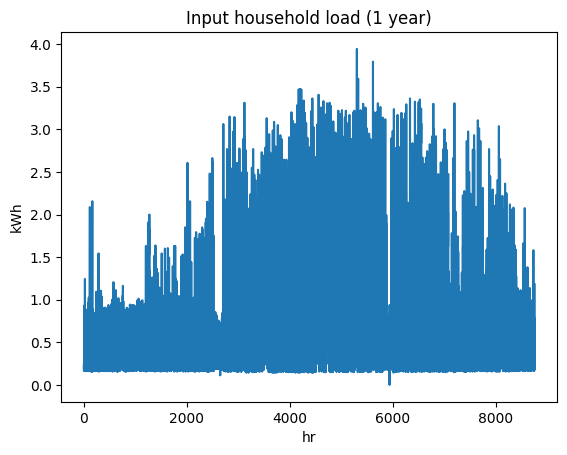

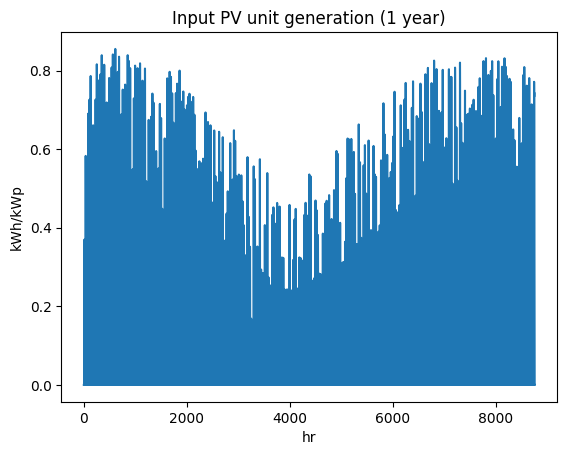

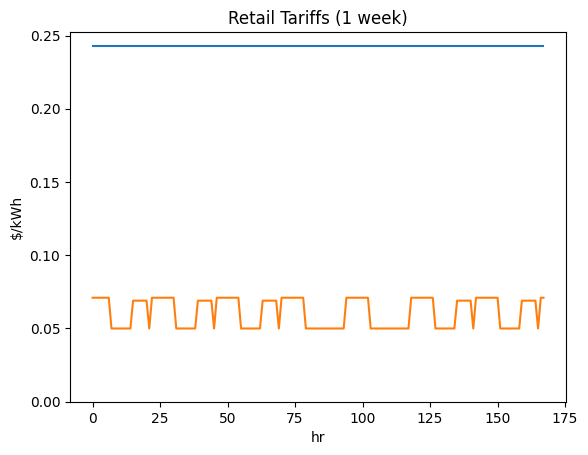

---- Optimising with PV: 1 - 20 kWp, Batt: 0 kWh. Determining PV capacity and dispatch.


************************************ Modell: PV > 1 kWp & BATT > 1 kWh ************************************
{'financial_horizon': 10, 'discount_rate': np.float64(0.06), 'grid_feedin_max': np.float64(5.0), 'pv_eol_capacity': np.float64(0.8), 'pv_eol_years': np.float64(25.0), 'pv_init_soh': np.float64(1.0), 'bess_e2p_ratio': np.float64(2.4), 'bess_roundtrip_eff': np.float64(0.88), 'bess_eol_years': np.float64(10.0), 'bess_eol_capacity': np.float64(0.7), 'bess_eol_cycles': np.float64(10000.0), 'bess_init_soh': np.float64(1.0), 'bess_eff_charge': np.float64(0.938083151964686), 'bess_eff_discharge': np.float64(0.938083151964686), 'scenario_name': 'Scenario_D_+5', 'scenario_set': 'SurfCoast', 'scenario_subset': 'JJP_open', 'year_start': 2022, 'datetime_name': 'DateTime1', 'meter_name': 'pc3040_nmi1050527033', 'solar_name': 'MELB', 'tariff_name_import_wkday': '3_Im_wkday', 'tariff_name_export_wkday': '3_

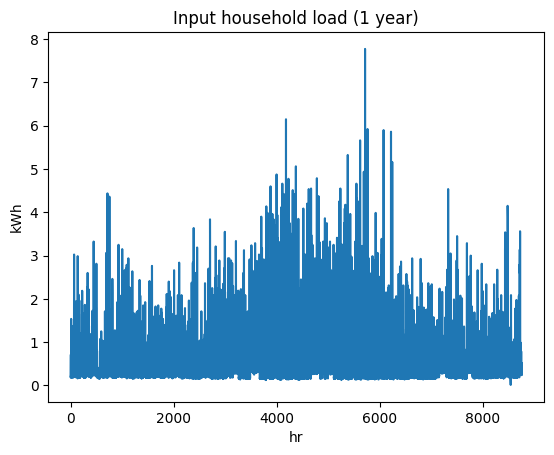

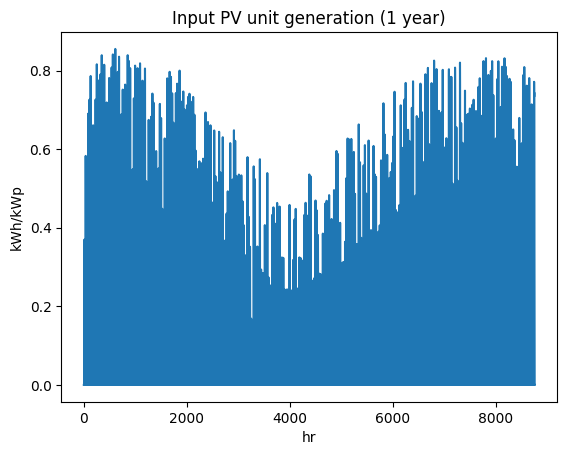

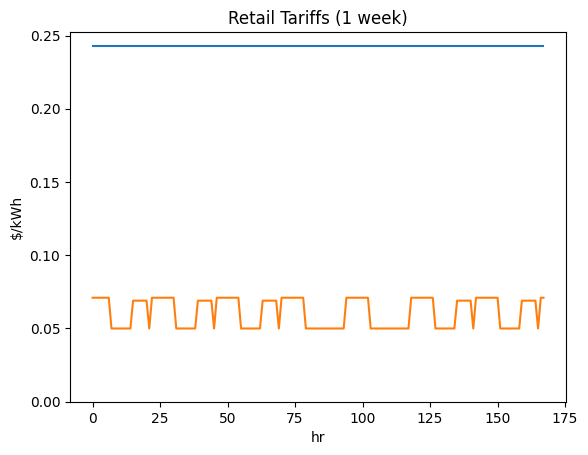

---- Optimising with PV: 1 - 20 kWp, Batt: 0 kWh. Determining PV capacity and dispatch.


************************************ Modell: PV > 1 kWp & BATT > 1 kWh ************************************
{'financial_horizon': 10, 'discount_rate': np.float64(0.06), 'grid_feedin_max': np.float64(5.0), 'pv_eol_capacity': np.float64(0.8), 'pv_eol_years': np.float64(25.0), 'pv_init_soh': np.float64(1.0), 'bess_e2p_ratio': np.float64(2.4), 'bess_roundtrip_eff': np.float64(0.88), 'bess_eol_years': np.float64(10.0), 'bess_eol_capacity': np.float64(0.7), 'bess_eol_cycles': np.float64(10000.0), 'bess_init_soh': np.float64(1.0), 'bess_eff_charge': np.float64(0.938083151964686), 'bess_eff_discharge': np.float64(0.938083151964686), 'scenario_name': 'Scenario_D_+5', 'scenario_set': 'SurfCoast', 'scenario_subset': 'JJP_open', 'year_start': 2022, 'datetime_name': 'DateTime1', 'meter_name': 'pc3040_nmi2457125345', 'solar_name': 'MELB', 'tariff_name_import_wkday': '3_Im_wkday', 'tariff_name_export_wkday': '3_

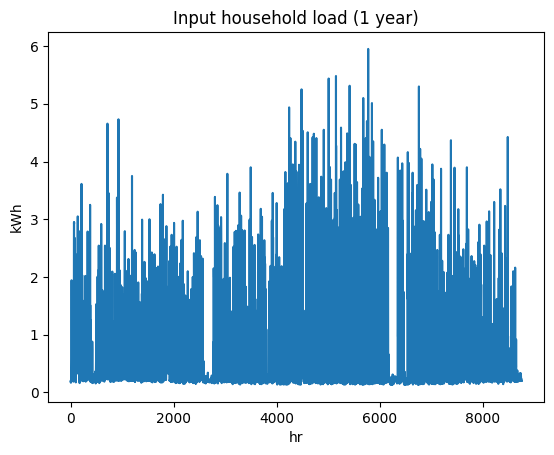

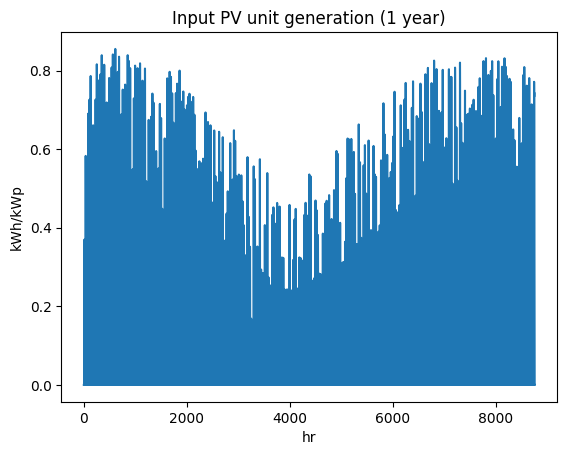

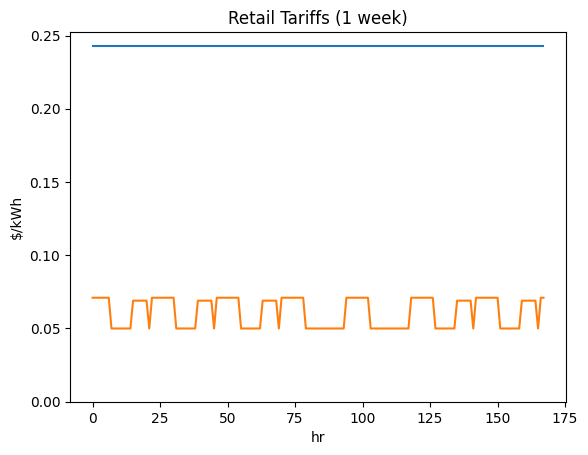

---- Optimising with PV: 1 - 20 kWp, Batt: 0 kWh. Determining PV capacity and dispatch.


************************************ Modell: PV > 1 kWp & BATT > 1 kWh ************************************
{'financial_horizon': 10, 'discount_rate': np.float64(0.06), 'grid_feedin_max': np.float64(5.0), 'pv_eol_capacity': np.float64(0.8), 'pv_eol_years': np.float64(25.0), 'pv_init_soh': np.float64(1.0), 'bess_e2p_ratio': np.float64(2.4), 'bess_roundtrip_eff': np.float64(0.88), 'bess_eol_years': np.float64(10.0), 'bess_eol_capacity': np.float64(0.7), 'bess_eol_cycles': np.float64(10000.0), 'bess_init_soh': np.float64(1.0), 'bess_eff_charge': np.float64(0.938083151964686), 'bess_eff_discharge': np.float64(0.938083151964686), 'scenario_name': 'Scenario_D_+5', 'scenario_set': 'SurfCoast', 'scenario_subset': 'JJP_open', 'year_start': 2022, 'datetime_name': 'DateTime1', 'meter_name': 'pc3040_nmi6709853447', 'solar_name': 'MELB', 'tariff_name_import_wkday': '3_Im_wkday', 'tariff_name_export_wkday': '3_

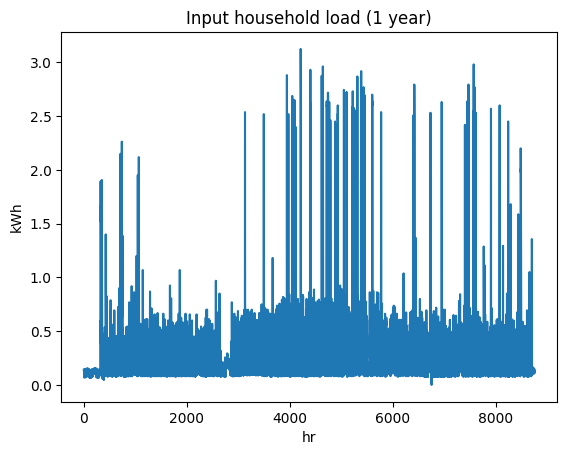

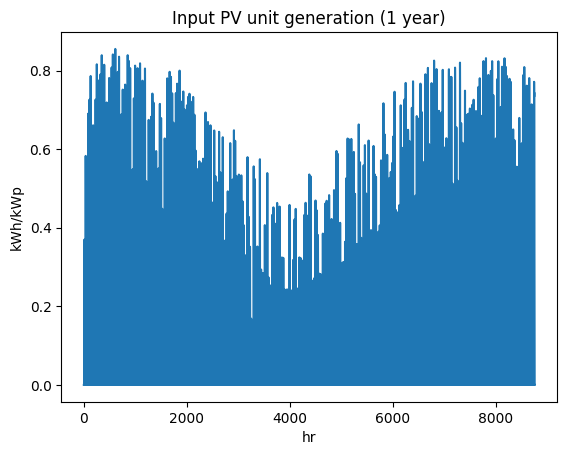

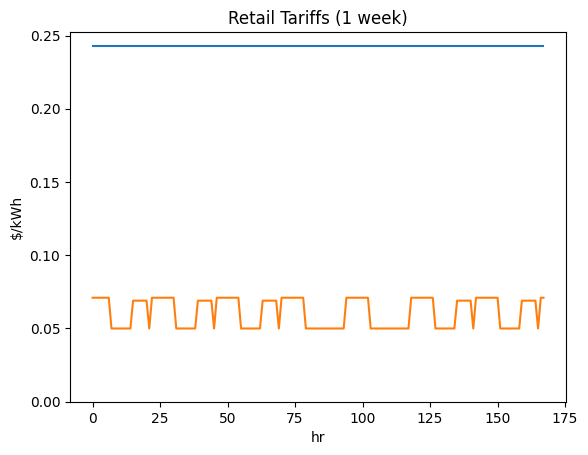

---- Optimising with PV: 1 - 20 kWp, Batt: 0 kWh. Determining PV capacity and dispatch.


************************************ Modell: PV > 1 kWp & BATT > 1 kWh ************************************
{'financial_horizon': 10, 'discount_rate': np.float64(0.06), 'grid_feedin_max': np.float64(5.0), 'pv_eol_capacity': np.float64(0.8), 'pv_eol_years': np.float64(25.0), 'pv_init_soh': np.float64(1.0), 'bess_e2p_ratio': np.float64(2.4), 'bess_roundtrip_eff': np.float64(0.88), 'bess_eol_years': np.float64(10.0), 'bess_eol_capacity': np.float64(0.7), 'bess_eol_cycles': np.float64(10000.0), 'bess_init_soh': np.float64(1.0), 'bess_eff_charge': np.float64(0.938083151964686), 'bess_eff_discharge': np.float64(0.938083151964686), 'scenario_name': 'Scenario_D_+5', 'scenario_set': 'SurfCoast', 'scenario_subset': 'JJP_open', 'year_start': 2022, 'datetime_name': 'DateTime1', 'meter_name': 'pc3040_nmi5077702603', 'solar_name': 'MELB', 'tariff_name_import_wkday': '3_Im_wkday', 'tariff_name_export_wkday': '3_

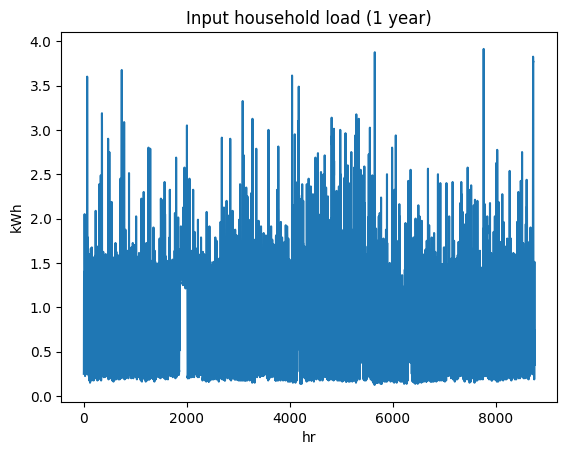

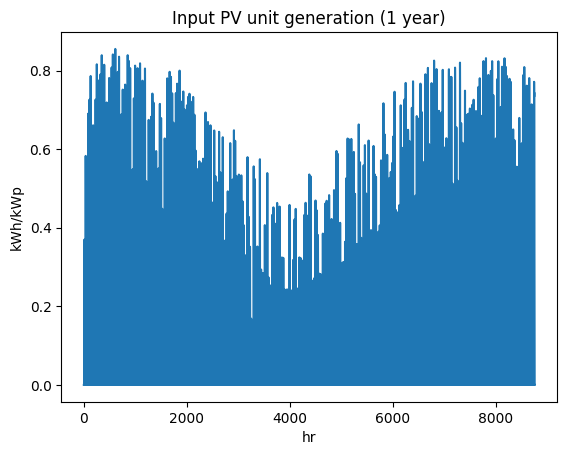

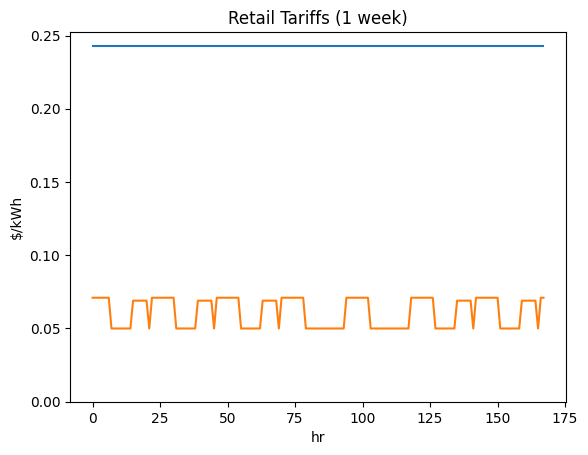

---- Optimising with PV: 1 - 20 kWp, Batt: 0 kWh. Determining PV capacity and dispatch.


************************************ Modell: PV > 1 kWp & BATT > 1 kWh ************************************
{'financial_horizon': 10, 'discount_rate': np.float64(0.06), 'grid_feedin_max': np.float64(5.0), 'pv_eol_capacity': np.float64(0.8), 'pv_eol_years': np.float64(25.0), 'pv_init_soh': np.float64(1.0), 'bess_e2p_ratio': np.float64(2.4), 'bess_roundtrip_eff': np.float64(0.88), 'bess_eol_years': np.float64(10.0), 'bess_eol_capacity': np.float64(0.7), 'bess_eol_cycles': np.float64(10000.0), 'bess_init_soh': np.float64(1.0), 'bess_eff_charge': np.float64(0.938083151964686), 'bess_eff_discharge': np.float64(0.938083151964686), 'scenario_name': 'Scenario_D_+5', 'scenario_set': 'SurfCoast', 'scenario_subset': 'JJP_open', 'year_start': 2022, 'datetime_name': 'DateTime1', 'meter_name': 'pc3040_nmi3233976642', 'solar_name': 'MELB', 'tariff_name_import_wkday': '3_Im_wkday', 'tariff_name_export_wkday': '3_

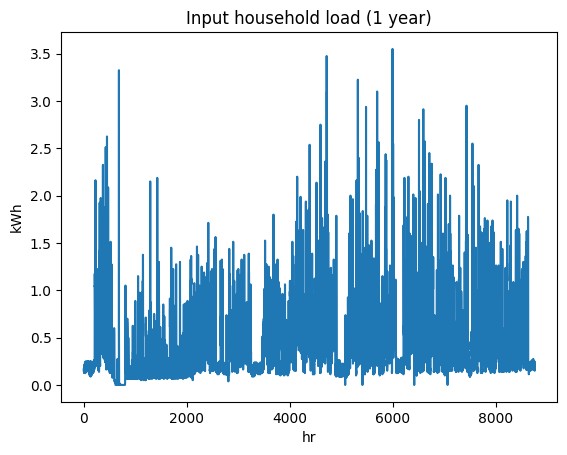

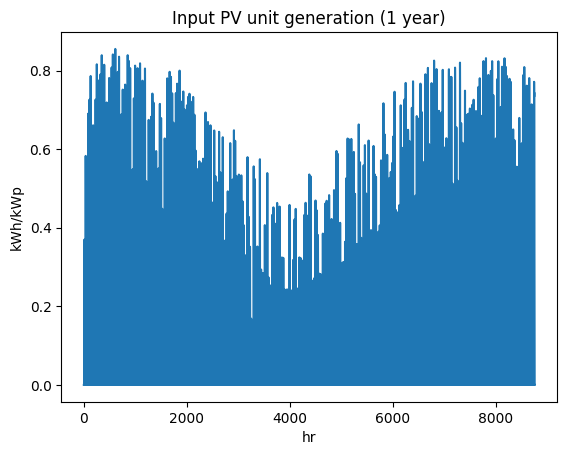

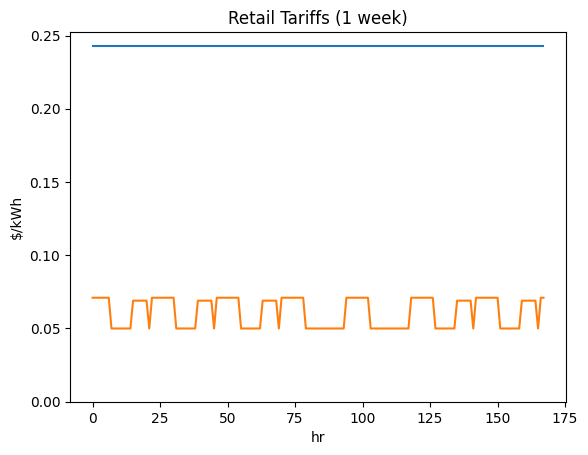

---- Optimising with PV: 1 - 20 kWp, Batt: 0 kWh. Determining PV capacity and dispatch.


************************************ Modell: PV > 1 kWp & BATT > 1 kWh ************************************
{'financial_horizon': 10, 'discount_rate': np.float64(0.06), 'grid_feedin_max': np.float64(5.0), 'pv_eol_capacity': np.float64(0.8), 'pv_eol_years': np.float64(25.0), 'pv_init_soh': np.float64(1.0), 'bess_e2p_ratio': np.float64(2.4), 'bess_roundtrip_eff': np.float64(0.88), 'bess_eol_years': np.float64(10.0), 'bess_eol_capacity': np.float64(0.7), 'bess_eol_cycles': np.float64(10000.0), 'bess_init_soh': np.float64(1.0), 'bess_eff_charge': np.float64(0.938083151964686), 'bess_eff_discharge': np.float64(0.938083151964686), 'scenario_name': 'Scenario_D_+5', 'scenario_set': 'SurfCoast', 'scenario_subset': 'JJP_open', 'year_start': 2022, 'datetime_name': 'DateTime1', 'meter_name': 'pc3040_nmi1729096959', 'solar_name': 'MELB', 'tariff_name_import_wkday': '3_Im_wkday', 'tariff_name_export_wkday': '3_

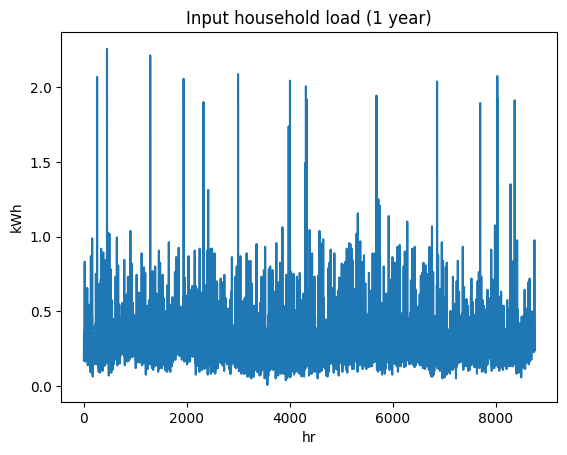

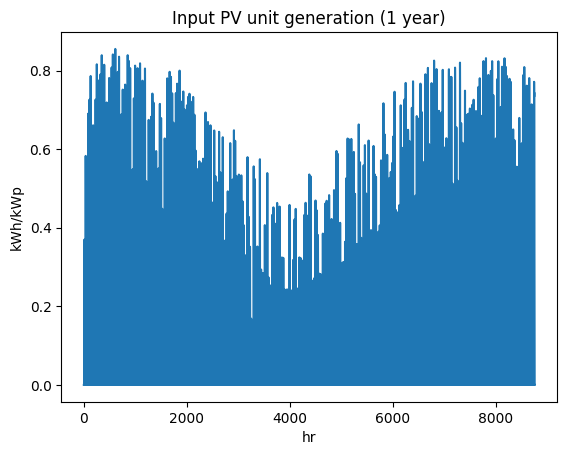

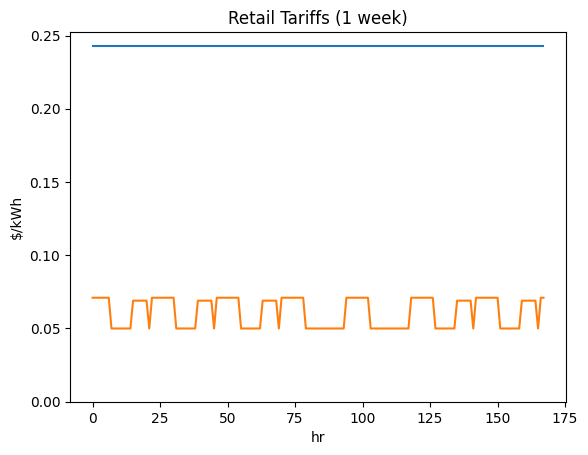

---- Optimising with PV: 1 - 20 kWp, Batt: 0 kWh. Determining PV capacity and dispatch.


************************************ Modell: PV > 1 kWp & BATT > 1 kWh ************************************
{'financial_horizon': 10, 'discount_rate': np.float64(0.06), 'grid_feedin_max': np.float64(5.0), 'pv_eol_capacity': np.float64(0.8), 'pv_eol_years': np.float64(25.0), 'pv_init_soh': np.float64(1.0), 'bess_e2p_ratio': np.float64(2.4), 'bess_roundtrip_eff': np.float64(0.88), 'bess_eol_years': np.float64(10.0), 'bess_eol_capacity': np.float64(0.7), 'bess_eol_cycles': np.float64(10000.0), 'bess_init_soh': np.float64(1.0), 'bess_eff_charge': np.float64(0.938083151964686), 'bess_eff_discharge': np.float64(0.938083151964686), 'scenario_name': 'Scenario_D_+5', 'scenario_set': 'SurfCoast', 'scenario_subset': 'JJP_open', 'year_start': 2022, 'datetime_name': 'DateTime1', 'meter_name': 'pc3033_nmi4501405403', 'solar_name': 'MELB', 'tariff_name_import_wkday': '3_Im_wkday', 'tariff_name_export_wkday': '3_

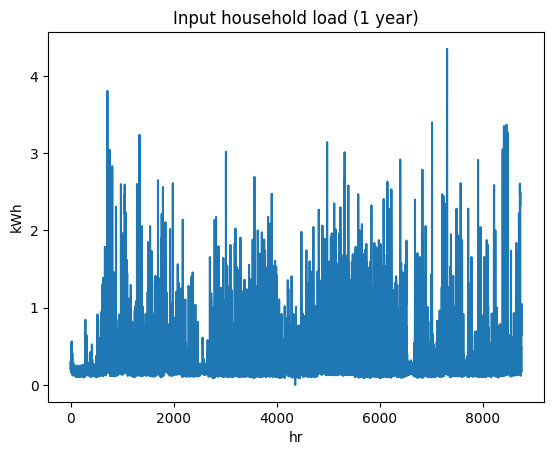

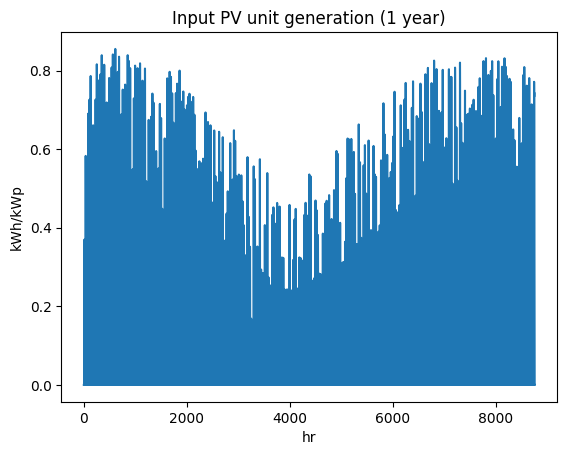

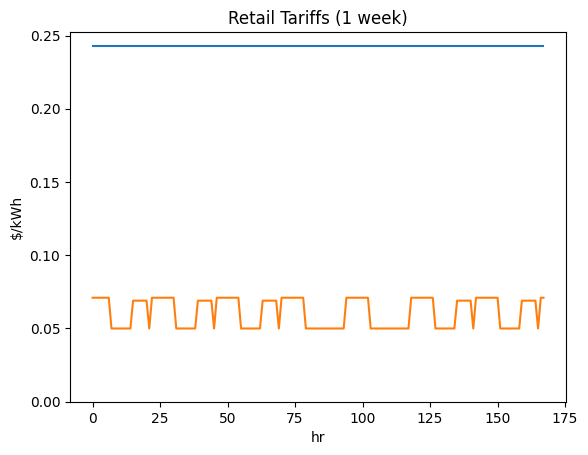

---- Optimising with PV: 1 - 20 kWp, Batt: 0 kWh. Determining PV capacity and dispatch.


************************************ Modell: PV > 1 kWp & BATT > 1 kWh ************************************
{'financial_horizon': 10, 'discount_rate': np.float64(0.06), 'grid_feedin_max': np.float64(5.0), 'pv_eol_capacity': np.float64(0.8), 'pv_eol_years': np.float64(25.0), 'pv_init_soh': np.float64(1.0), 'bess_e2p_ratio': np.float64(2.4), 'bess_roundtrip_eff': np.float64(0.88), 'bess_eol_years': np.float64(10.0), 'bess_eol_capacity': np.float64(0.7), 'bess_eol_cycles': np.float64(10000.0), 'bess_init_soh': np.float64(1.0), 'bess_eff_charge': np.float64(0.938083151964686), 'bess_eff_discharge': np.float64(0.938083151964686), 'scenario_name': 'Scenario_D_+5', 'scenario_set': 'SurfCoast', 'scenario_subset': 'JJP_open', 'year_start': 2022, 'datetime_name': 'DateTime1', 'meter_name': 'pc3033_nmi4638589374', 'solar_name': 'MELB', 'tariff_name_import_wkday': '3_Im_wkday', 'tariff_name_export_wkday': '3_

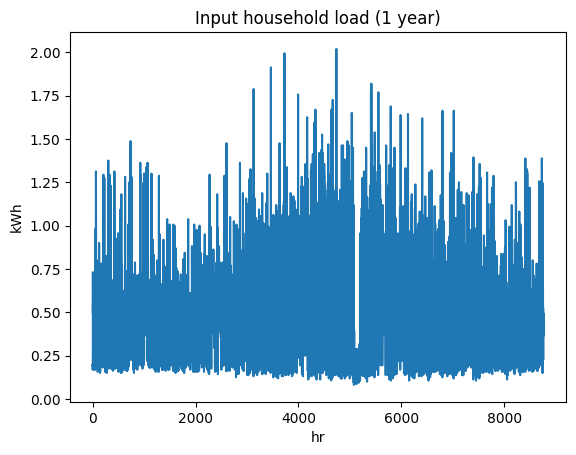

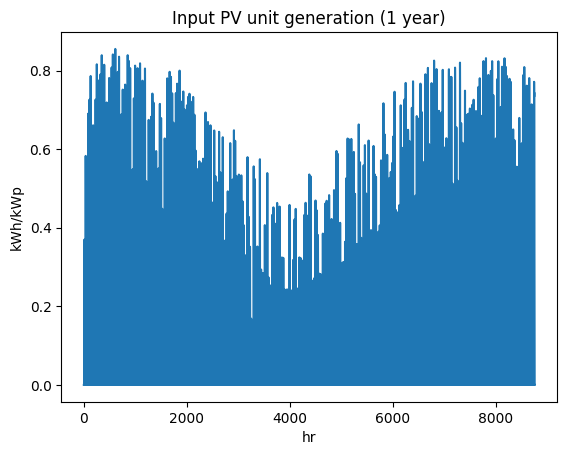

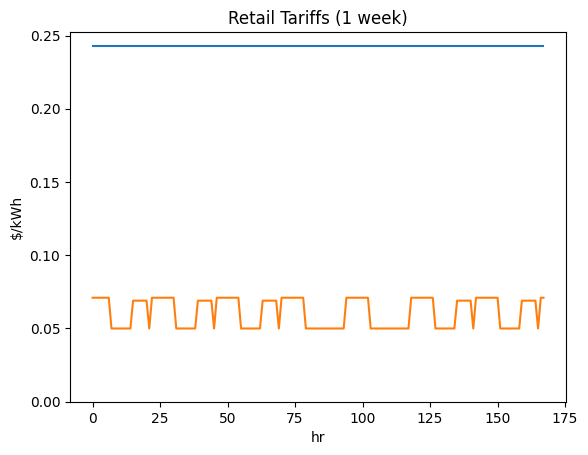

---- Optimising with PV: 1 - 20 kWp, Batt: 0 kWh. Determining PV capacity and dispatch.


************************************ Modell: PV > 1 kWp & BATT > 1 kWh ************************************
{'financial_horizon': 10, 'discount_rate': np.float64(0.06), 'grid_feedin_max': np.float64(5.0), 'pv_eol_capacity': np.float64(0.8), 'pv_eol_years': np.float64(25.0), 'pv_init_soh': np.float64(1.0), 'bess_e2p_ratio': np.float64(2.4), 'bess_roundtrip_eff': np.float64(0.88), 'bess_eol_years': np.float64(10.0), 'bess_eol_capacity': np.float64(0.7), 'bess_eol_cycles': np.float64(10000.0), 'bess_init_soh': np.float64(1.0), 'bess_eff_charge': np.float64(0.938083151964686), 'bess_eff_discharge': np.float64(0.938083151964686), 'scenario_name': 'Scenario_D_+5', 'scenario_set': 'SurfCoast', 'scenario_subset': 'JJP_open', 'year_start': 2022, 'datetime_name': 'DateTime1', 'meter_name': 'pc3033_nmi2004087470', 'solar_name': 'MELB', 'tariff_name_import_wkday': '3_Im_wkday', 'tariff_name_export_wkday': '3_

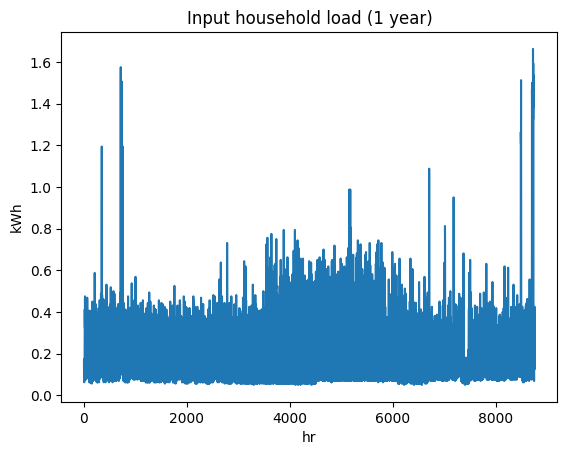

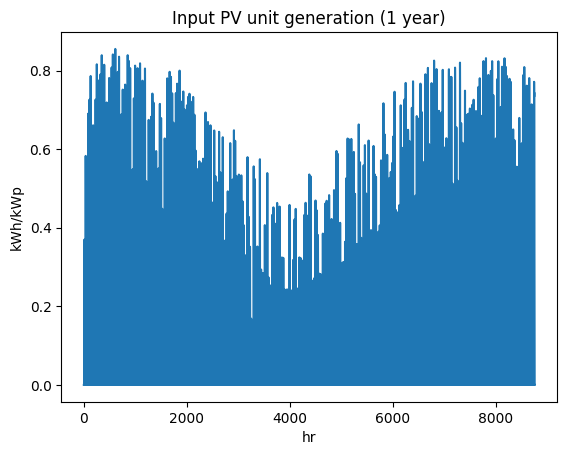

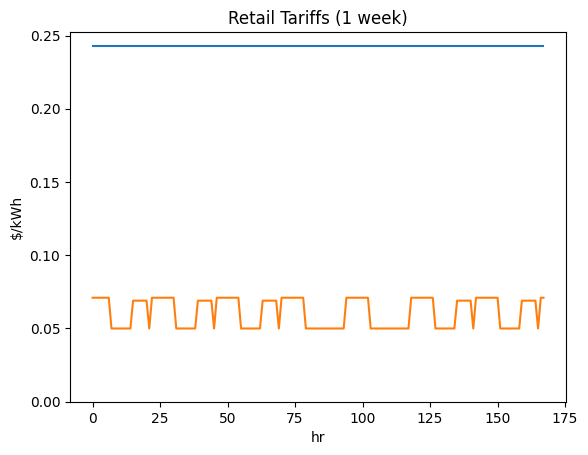

---- Optimising with PV: 1 - 20 kWp, Batt: 0 kWh. Determining PV capacity and dispatch.


************************************ Modell: PV > 1 kWp & BATT > 1 kWh ************************************
{'financial_horizon': 10, 'discount_rate': np.float64(0.06), 'grid_feedin_max': np.float64(5.0), 'pv_eol_capacity': np.float64(0.8), 'pv_eol_years': np.float64(25.0), 'pv_init_soh': np.float64(1.0), 'bess_e2p_ratio': np.float64(2.4), 'bess_roundtrip_eff': np.float64(0.88), 'bess_eol_years': np.float64(10.0), 'bess_eol_capacity': np.float64(0.7), 'bess_eol_cycles': np.float64(10000.0), 'bess_init_soh': np.float64(1.0), 'bess_eff_charge': np.float64(0.938083151964686), 'bess_eff_discharge': np.float64(0.938083151964686), 'scenario_name': 'Scenario_D_+5', 'scenario_set': 'SurfCoast', 'scenario_subset': 'JJP_open', 'year_start': 2022, 'datetime_name': 'DateTime1', 'meter_name': 'pc3033_nmi7640835853', 'solar_name': 'MELB', 'tariff_name_import_wkday': '3_Im_wkday', 'tariff_name_export_wkday': '3_

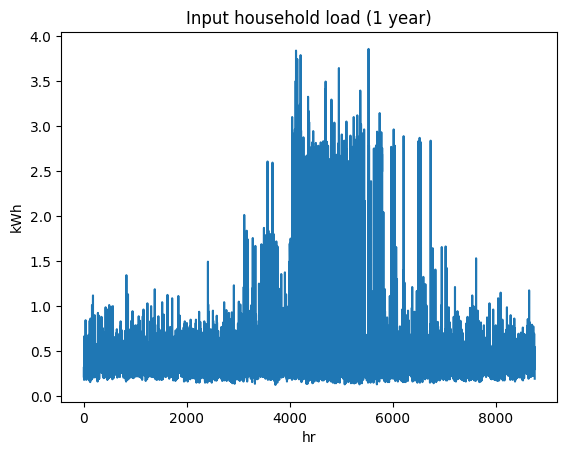

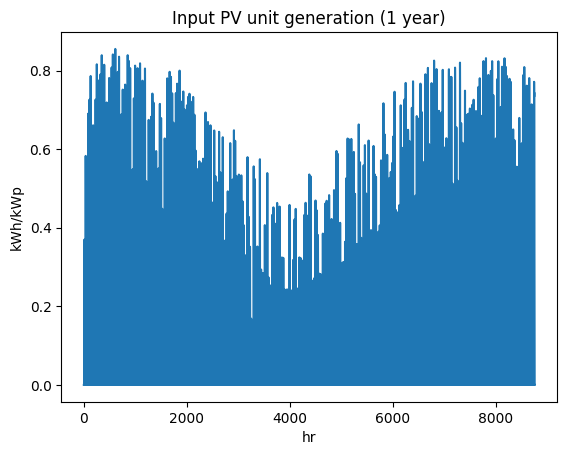

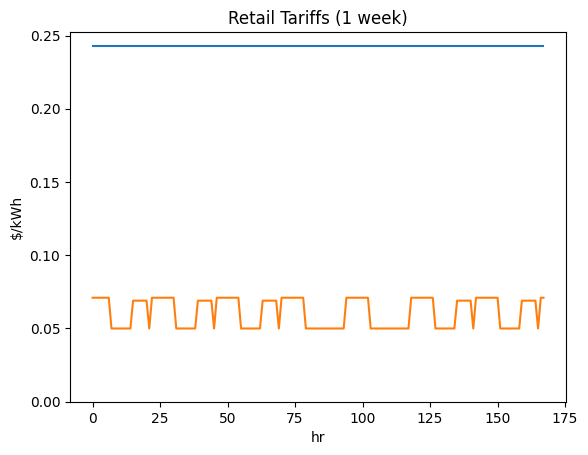

---- Optimising with PV: 1 - 20 kWp, Batt: 0 kWh. Determining PV capacity and dispatch.


************************************ Modell: PV > 1 kWp & BATT > 1 kWh ************************************
{'financial_horizon': 10, 'discount_rate': np.float64(0.06), 'grid_feedin_max': np.float64(5.0), 'pv_eol_capacity': np.float64(0.8), 'pv_eol_years': np.float64(25.0), 'pv_init_soh': np.float64(1.0), 'bess_e2p_ratio': np.float64(2.4), 'bess_roundtrip_eff': np.float64(0.88), 'bess_eol_years': np.float64(10.0), 'bess_eol_capacity': np.float64(0.7), 'bess_eol_cycles': np.float64(10000.0), 'bess_init_soh': np.float64(1.0), 'bess_eff_charge': np.float64(0.938083151964686), 'bess_eff_discharge': np.float64(0.938083151964686), 'scenario_name': 'Scenario_D_+5', 'scenario_set': 'SurfCoast', 'scenario_subset': 'JJP_open', 'year_start': 2022, 'datetime_name': 'DateTime1', 'meter_name': 'pc3033_nmi3233076445', 'solar_name': 'MELB', 'tariff_name_import_wkday': '3_Im_wkday', 'tariff_name_export_wkday': '3_

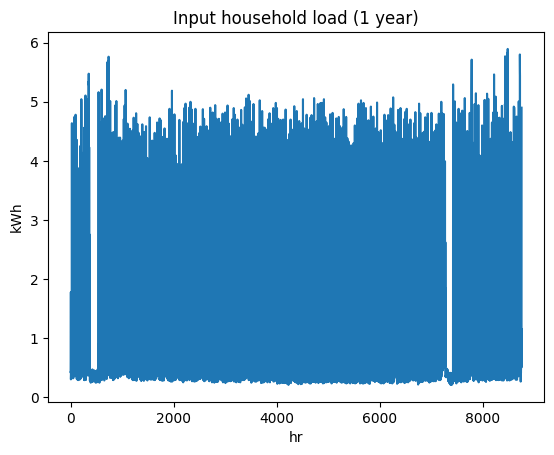

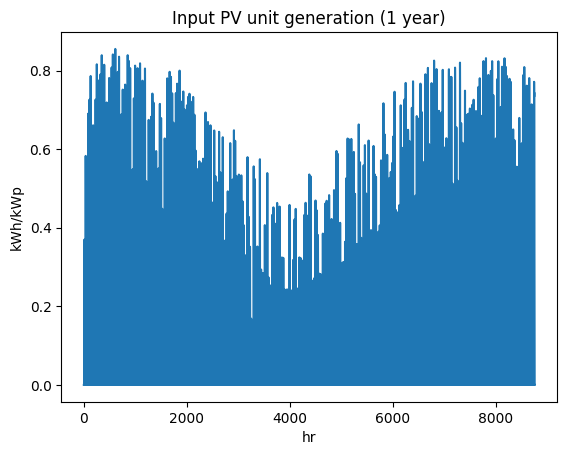

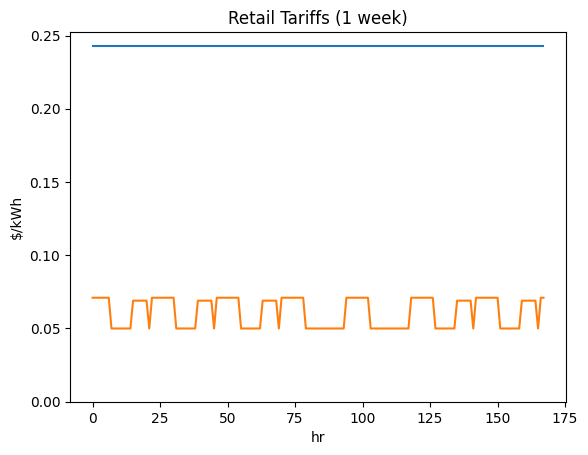

---- Optimising with PV: 1 - 20 kWp, Batt: 0 kWh. Determining PV capacity and dispatch.


************************************ Modell: PV > 1 kWp & BATT > 1 kWh ************************************
{'financial_horizon': 10, 'discount_rate': np.float64(0.06), 'grid_feedin_max': np.float64(5.0), 'pv_eol_capacity': np.float64(0.8), 'pv_eol_years': np.float64(25.0), 'pv_init_soh': np.float64(1.0), 'bess_e2p_ratio': np.float64(2.4), 'bess_roundtrip_eff': np.float64(0.88), 'bess_eol_years': np.float64(10.0), 'bess_eol_capacity': np.float64(0.7), 'bess_eol_cycles': np.float64(10000.0), 'bess_init_soh': np.float64(1.0), 'bess_eff_charge': np.float64(0.938083151964686), 'bess_eff_discharge': np.float64(0.938083151964686), 'scenario_name': 'Scenario_D_+5', 'scenario_set': 'SurfCoast', 'scenario_subset': 'JJP_open', 'year_start': 2022, 'datetime_name': 'DateTime1', 'meter_name': 'pc3033_nmi4498492392', 'solar_name': 'MELB', 'tariff_name_import_wkday': '3_Im_wkday', 'tariff_name_export_wkday': '3_

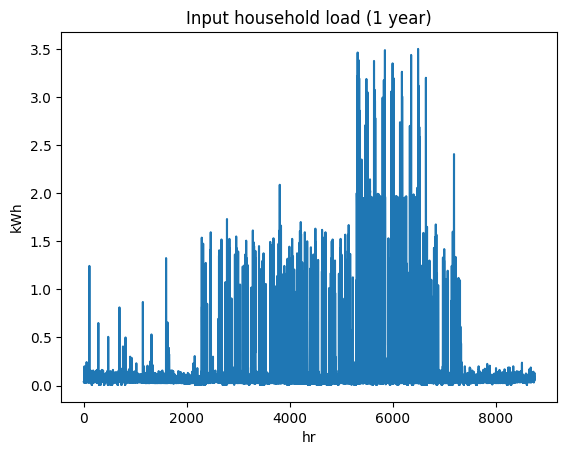

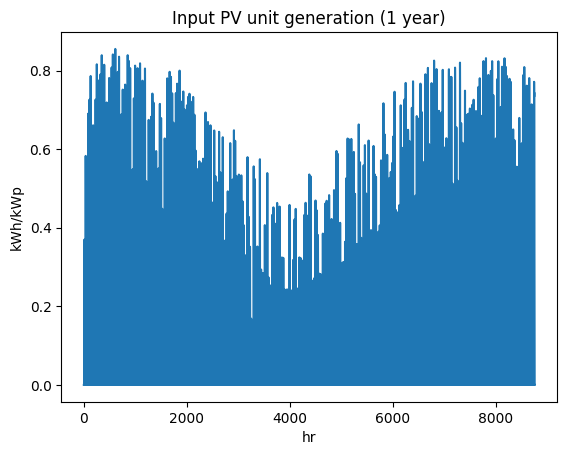

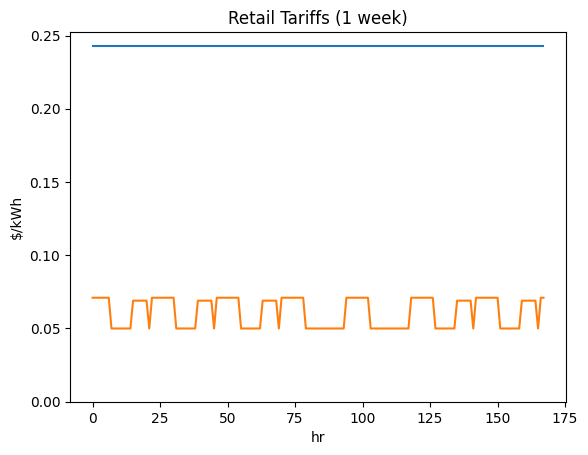

---- Optimising with PV: 1 - 20 kWp, Batt: 0 kWh. Determining PV capacity and dispatch.


************************************ Modell: PV > 1 kWp & BATT > 1 kWh ************************************
{'financial_horizon': 10, 'discount_rate': np.float64(0.06), 'grid_feedin_max': np.float64(5.0), 'pv_eol_capacity': np.float64(0.8), 'pv_eol_years': np.float64(25.0), 'pv_init_soh': np.float64(1.0), 'bess_e2p_ratio': np.float64(2.4), 'bess_roundtrip_eff': np.float64(0.88), 'bess_eol_years': np.float64(10.0), 'bess_eol_capacity': np.float64(0.7), 'bess_eol_cycles': np.float64(10000.0), 'bess_init_soh': np.float64(1.0), 'bess_eff_charge': np.float64(0.938083151964686), 'bess_eff_discharge': np.float64(0.938083151964686), 'scenario_name': 'Scenario_D_+5', 'scenario_set': 'SurfCoast', 'scenario_subset': 'JJP_open', 'year_start': 2022, 'datetime_name': 'DateTime1', 'meter_name': 'pc3033_nmi9119101704', 'solar_name': 'MELB', 'tariff_name_import_wkday': '3_Im_wkday', 'tariff_name_export_wkday': '3_

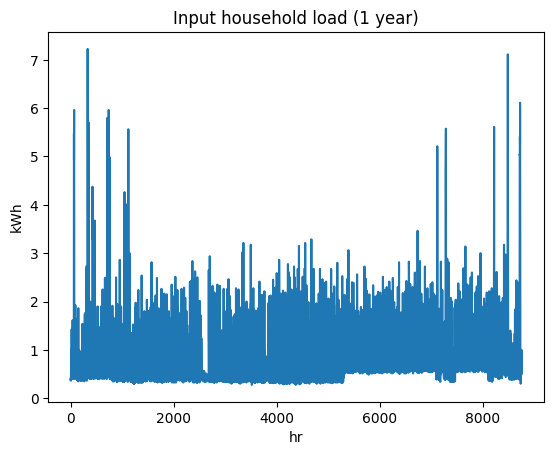

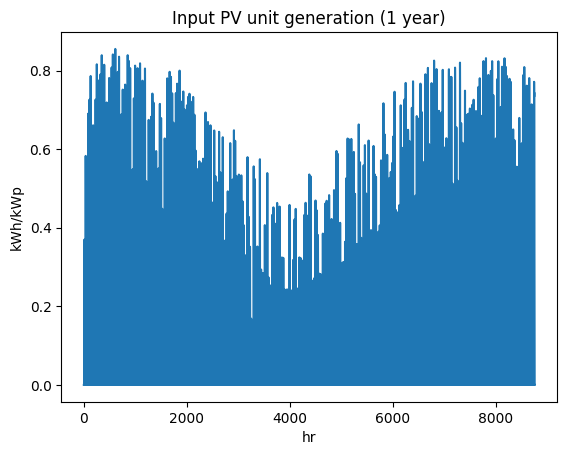

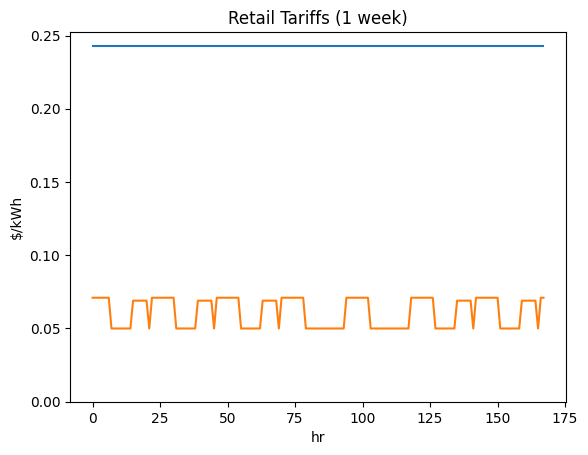

---- Optimising with PV: 1 - 20 kWp, Batt: 0 kWh. Determining PV capacity and dispatch.


************************************ Modell: PV > 1 kWp & BATT > 1 kWh ************************************
{'financial_horizon': 10, 'discount_rate': np.float64(0.06), 'grid_feedin_max': np.float64(5.0), 'pv_eol_capacity': np.float64(0.8), 'pv_eol_years': np.float64(25.0), 'pv_init_soh': np.float64(1.0), 'bess_e2p_ratio': np.float64(2.4), 'bess_roundtrip_eff': np.float64(0.88), 'bess_eol_years': np.float64(10.0), 'bess_eol_capacity': np.float64(0.7), 'bess_eol_cycles': np.float64(10000.0), 'bess_init_soh': np.float64(1.0), 'bess_eff_charge': np.float64(0.938083151964686), 'bess_eff_discharge': np.float64(0.938083151964686), 'scenario_name': 'Scenario_D_+5', 'scenario_set': 'SurfCoast', 'scenario_subset': 'JJP_open', 'year_start': 2022, 'datetime_name': 'DateTime1', 'meter_name': 'pc3033_nmi4624358083', 'solar_name': 'MELB', 'tariff_name_import_wkday': '3_Im_wkday', 'tariff_name_export_wkday': '3_

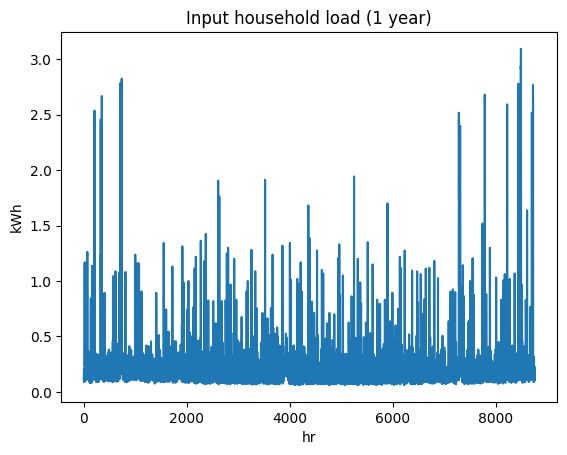

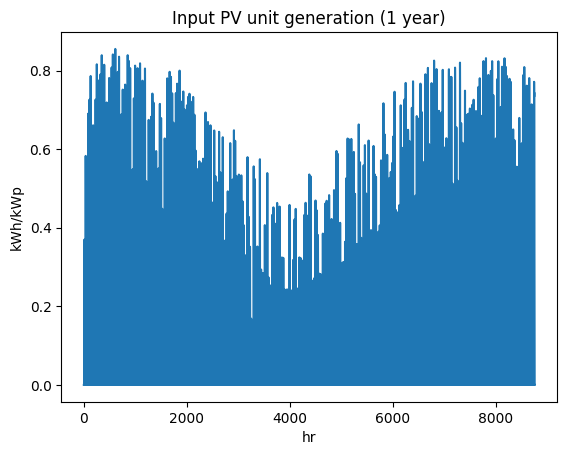

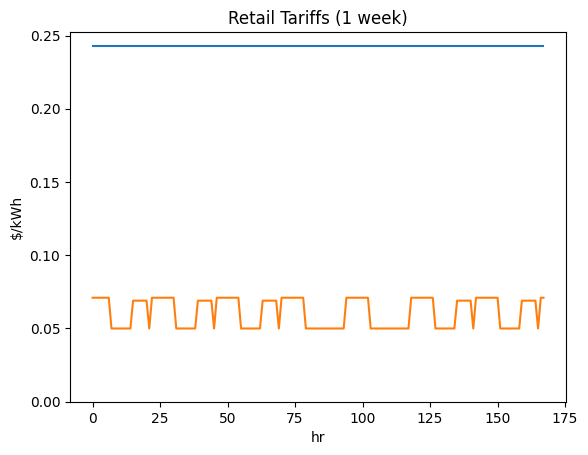

---- Optimising with PV: 1 - 20 kWp, Batt: 0 kWh. Determining PV capacity and dispatch.


************************************ Modell: PV > 1 kWp & BATT > 1 kWh ************************************
{'financial_horizon': 10, 'discount_rate': np.float64(0.06), 'grid_feedin_max': np.float64(5.0), 'pv_eol_capacity': np.float64(0.8), 'pv_eol_years': np.float64(25.0), 'pv_init_soh': np.float64(1.0), 'bess_e2p_ratio': np.float64(2.4), 'bess_roundtrip_eff': np.float64(0.88), 'bess_eol_years': np.float64(10.0), 'bess_eol_capacity': np.float64(0.7), 'bess_eol_cycles': np.float64(10000.0), 'bess_init_soh': np.float64(1.0), 'bess_eff_charge': np.float64(0.938083151964686), 'bess_eff_discharge': np.float64(0.938083151964686), 'scenario_name': 'Scenario_D_+5', 'scenario_set': 'SurfCoast', 'scenario_subset': 'JJP_open', 'year_start': 2022, 'datetime_name': 'DateTime1', 'meter_name': 'pc3033_nmi5197999244', 'solar_name': 'MELB', 'tariff_name_import_wkday': '3_Im_wkday', 'tariff_name_export_wkday': '3_

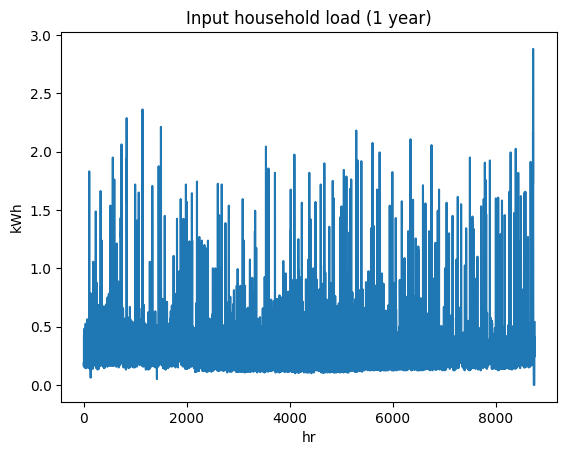

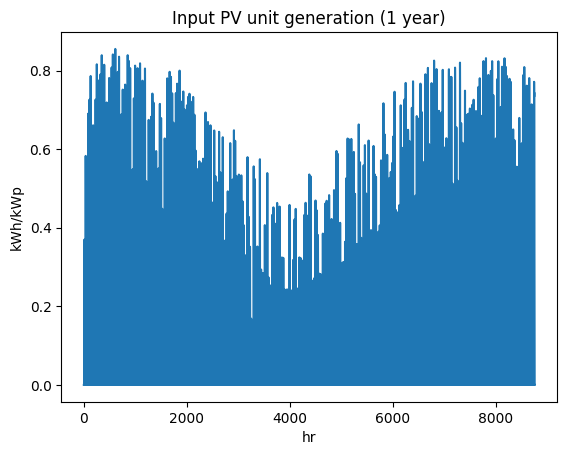

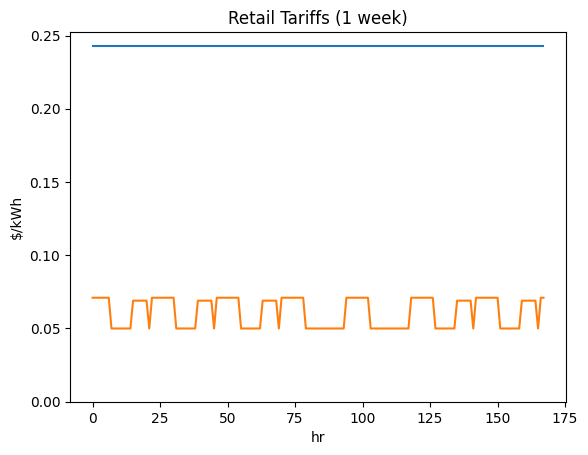

---- Optimising with PV: 1 - 20 kWp, Batt: 0 kWh. Determining PV capacity and dispatch.


************************************ Modell: PV > 1 kWp & BATT > 1 kWh ************************************
{'financial_horizon': 10, 'discount_rate': np.float64(0.06), 'grid_feedin_max': np.float64(5.0), 'pv_eol_capacity': np.float64(0.8), 'pv_eol_years': np.float64(25.0), 'pv_init_soh': np.float64(1.0), 'bess_e2p_ratio': np.float64(2.4), 'bess_roundtrip_eff': np.float64(0.88), 'bess_eol_years': np.float64(10.0), 'bess_eol_capacity': np.float64(0.7), 'bess_eol_cycles': np.float64(10000.0), 'bess_init_soh': np.float64(1.0), 'bess_eff_charge': np.float64(0.938083151964686), 'bess_eff_discharge': np.float64(0.938083151964686), 'scenario_name': 'Scenario_D_+5', 'scenario_set': 'SurfCoast', 'scenario_subset': 'JJP_open', 'year_start': 2022, 'datetime_name': 'DateTime1', 'meter_name': 'pc3033_nmi7184365145', 'solar_name': 'MELB', 'tariff_name_import_wkday': '3_Im_wkday', 'tariff_name_export_wkday': '3_

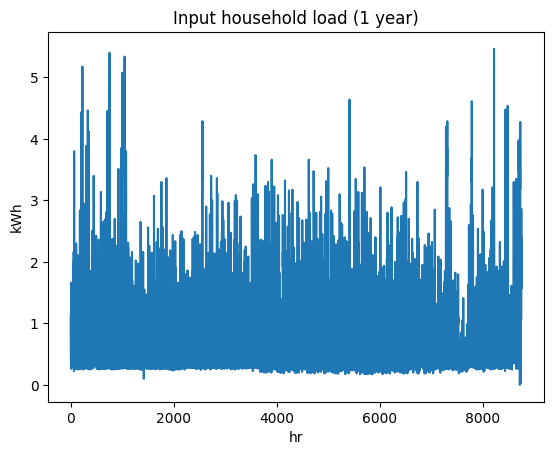

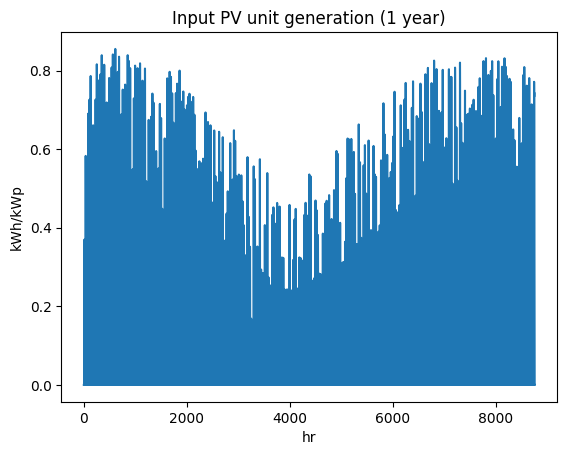

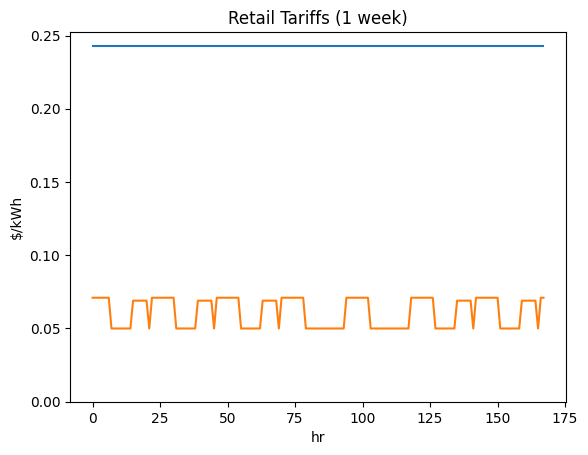

---- Optimising with PV: 1 - 20 kWp, Batt: 0 kWh. Determining PV capacity and dispatch.


************************************ Modell: PV > 1 kWp & BATT > 1 kWh ************************************
{'financial_horizon': 10, 'discount_rate': np.float64(0.06), 'grid_feedin_max': np.float64(5.0), 'pv_eol_capacity': np.float64(0.8), 'pv_eol_years': np.float64(25.0), 'pv_init_soh': np.float64(1.0), 'bess_e2p_ratio': np.float64(2.4), 'bess_roundtrip_eff': np.float64(0.88), 'bess_eol_years': np.float64(10.0), 'bess_eol_capacity': np.float64(0.7), 'bess_eol_cycles': np.float64(10000.0), 'bess_init_soh': np.float64(1.0), 'bess_eff_charge': np.float64(0.938083151964686), 'bess_eff_discharge': np.float64(0.938083151964686), 'scenario_name': 'Scenario_D_+5', 'scenario_set': 'SurfCoast', 'scenario_subset': 'JJP_open', 'year_start': 2022, 'datetime_name': 'DateTime1', 'meter_name': 'pc3033_nmi5013030255', 'solar_name': 'MELB', 'tariff_name_import_wkday': '3_Im_wkday', 'tariff_name_export_wkday': '3_

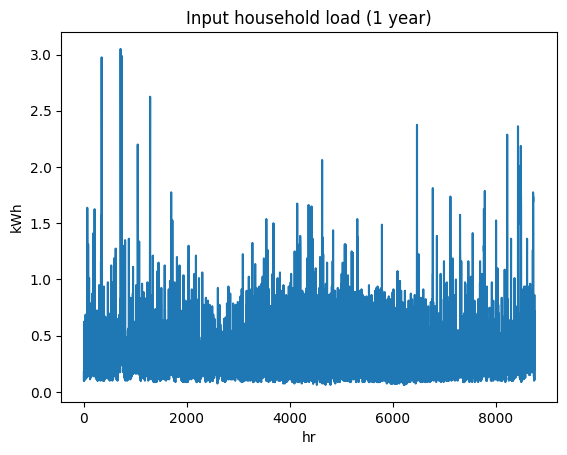

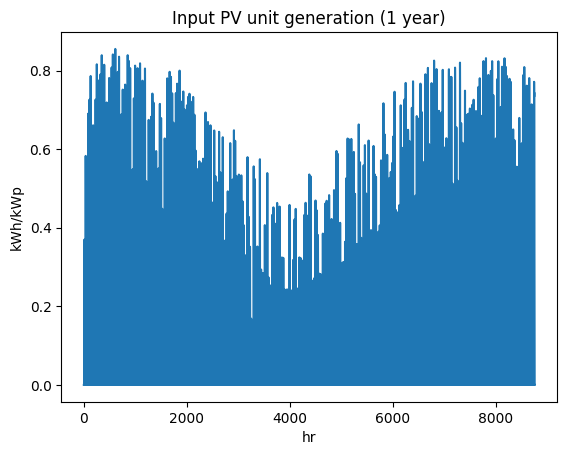

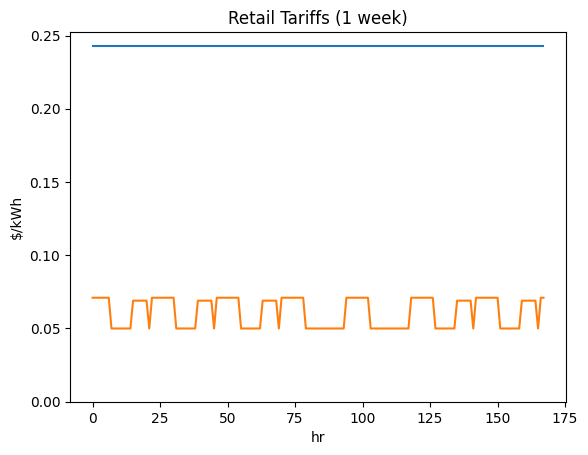

---- Optimising with PV: 1 - 20 kWp, Batt: 0 kWh. Determining PV capacity and dispatch.


************************************ Modell: PV > 1 kWp & BATT > 1 kWh ************************************
{'financial_horizon': 10, 'discount_rate': np.float64(0.06), 'grid_feedin_max': np.float64(5.0), 'pv_eol_capacity': np.float64(0.8), 'pv_eol_years': np.float64(25.0), 'pv_init_soh': np.float64(1.0), 'bess_e2p_ratio': np.float64(2.4), 'bess_roundtrip_eff': np.float64(0.88), 'bess_eol_years': np.float64(10.0), 'bess_eol_capacity': np.float64(0.7), 'bess_eol_cycles': np.float64(10000.0), 'bess_init_soh': np.float64(1.0), 'bess_eff_charge': np.float64(0.938083151964686), 'bess_eff_discharge': np.float64(0.938083151964686), 'scenario_name': 'Scenario_D_+5', 'scenario_set': 'SurfCoast', 'scenario_subset': 'JJP_open', 'year_start': 2022, 'datetime_name': 'DateTime1', 'meter_name': 'pc3033_nmi5324044253', 'solar_name': 'MELB', 'tariff_name_import_wkday': '3_Im_wkday', 'tariff_name_export_wkday': '3_

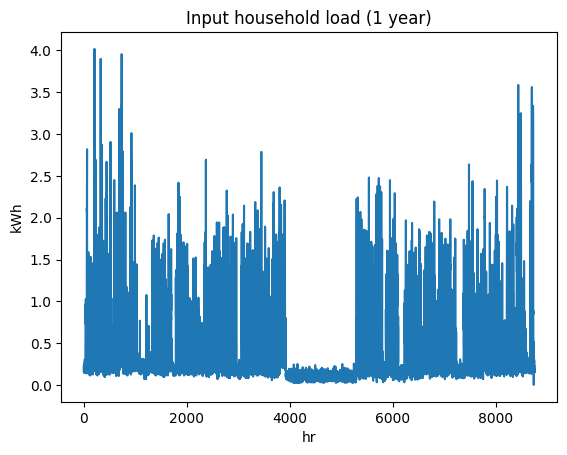

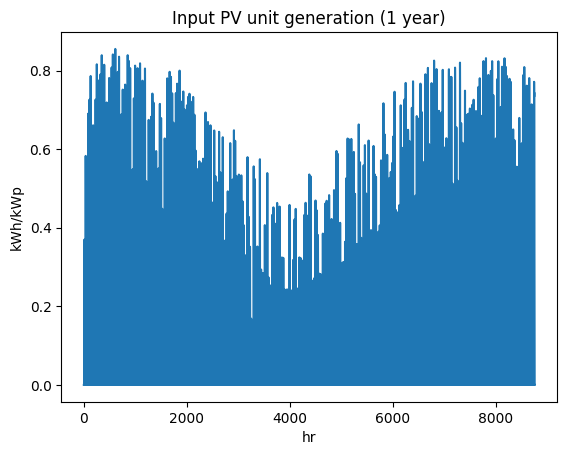

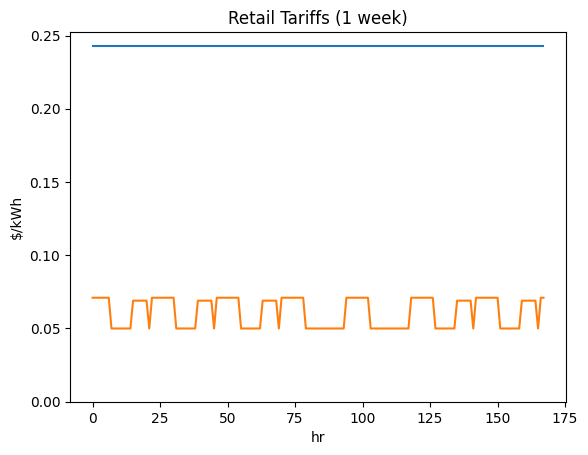

---- Optimising with PV: 1 - 20 kWp, Batt: 0 kWh. Determining PV capacity and dispatch.


************************************ Modell: PV > 1 kWp & BATT > 1 kWh ************************************
{'financial_horizon': 10, 'discount_rate': np.float64(0.06), 'grid_feedin_max': np.float64(5.0), 'pv_eol_capacity': np.float64(0.8), 'pv_eol_years': np.float64(25.0), 'pv_init_soh': np.float64(1.0), 'bess_e2p_ratio': np.float64(2.4), 'bess_roundtrip_eff': np.float64(0.88), 'bess_eol_years': np.float64(10.0), 'bess_eol_capacity': np.float64(0.7), 'bess_eol_cycles': np.float64(10000.0), 'bess_init_soh': np.float64(1.0), 'bess_eff_charge': np.float64(0.938083151964686), 'bess_eff_discharge': np.float64(0.938083151964686), 'scenario_name': 'Scenario_D_+5', 'scenario_set': 'SurfCoast', 'scenario_subset': 'JJP_open', 'year_start': 2022, 'datetime_name': 'DateTime1', 'meter_name': 'pc3033_nmi8257852490', 'solar_name': 'MELB', 'tariff_name_import_wkday': '3_Im_wkday', 'tariff_name_export_wkday': '3_

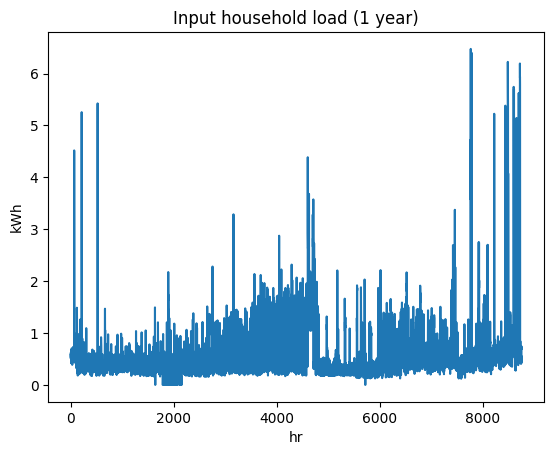

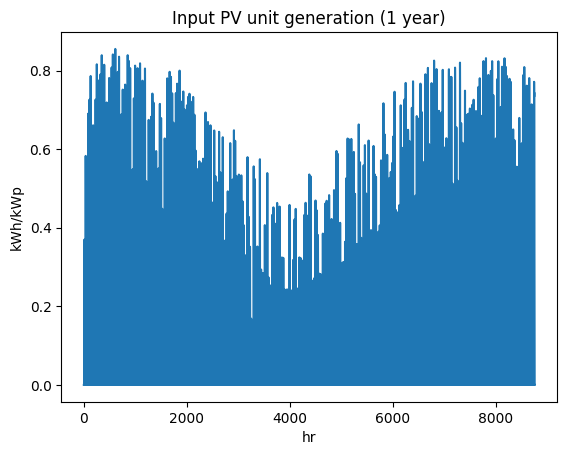

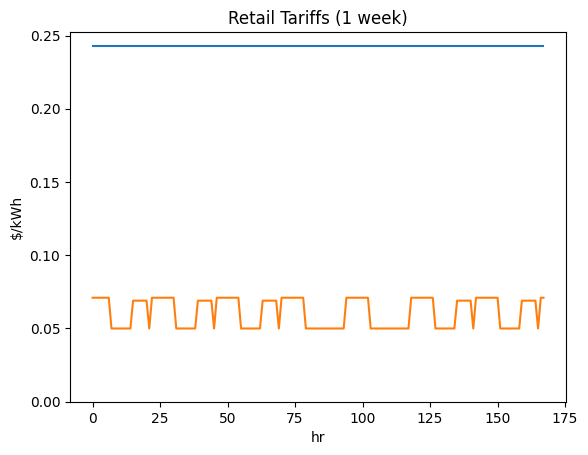

---- Optimising with PV: 1 - 20 kWp, Batt: 0 kWh. Determining PV capacity and dispatch.


************************************ Modell: PV > 1 kWp & BATT > 1 kWh ************************************
{'financial_horizon': 10, 'discount_rate': np.float64(0.06), 'grid_feedin_max': np.float64(5.0), 'pv_eol_capacity': np.float64(0.8), 'pv_eol_years': np.float64(25.0), 'pv_init_soh': np.float64(1.0), 'bess_e2p_ratio': np.float64(2.4), 'bess_roundtrip_eff': np.float64(0.88), 'bess_eol_years': np.float64(10.0), 'bess_eol_capacity': np.float64(0.7), 'bess_eol_cycles': np.float64(10000.0), 'bess_init_soh': np.float64(1.0), 'bess_eff_charge': np.float64(0.938083151964686), 'bess_eff_discharge': np.float64(0.938083151964686), 'scenario_name': 'Scenario_D_+5', 'scenario_set': 'SurfCoast', 'scenario_subset': 'JJP_open', 'year_start': 2022, 'datetime_name': 'DateTime1', 'meter_name': 'pc3033_nmi1373420935', 'solar_name': 'MELB', 'tariff_name_import_wkday': '3_Im_wkday', 'tariff_name_export_wkday': '3_

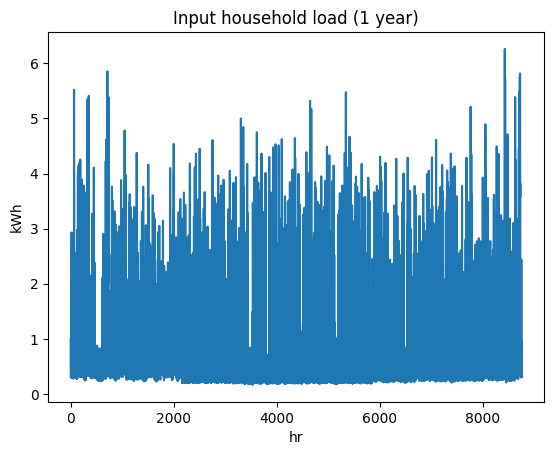

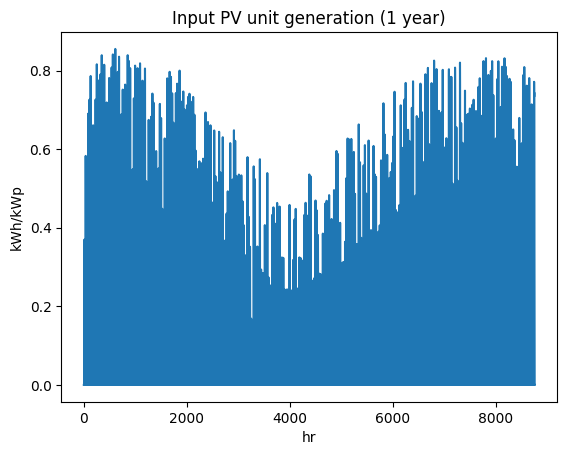

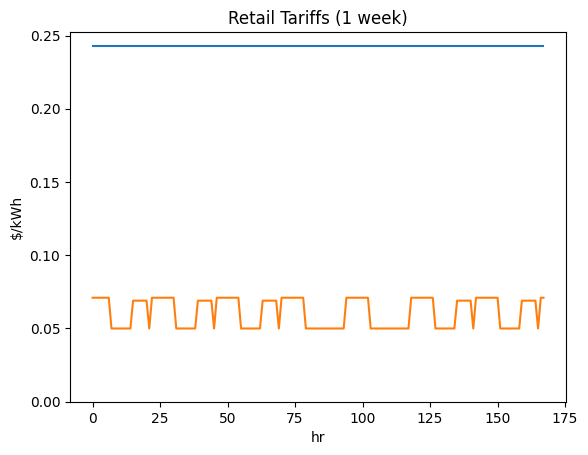

---- Optimising with PV: 1 - 20 kWp, Batt: 0 kWh. Determining PV capacity and dispatch.


************************************ Modell: PV > 1 kWp & BATT > 1 kWh ************************************
{'financial_horizon': 10, 'discount_rate': np.float64(0.06), 'grid_feedin_max': np.float64(5.0), 'pv_eol_capacity': np.float64(0.8), 'pv_eol_years': np.float64(25.0), 'pv_init_soh': np.float64(1.0), 'bess_e2p_ratio': np.float64(2.4), 'bess_roundtrip_eff': np.float64(0.88), 'bess_eol_years': np.float64(10.0), 'bess_eol_capacity': np.float64(0.7), 'bess_eol_cycles': np.float64(10000.0), 'bess_init_soh': np.float64(1.0), 'bess_eff_charge': np.float64(0.938083151964686), 'bess_eff_discharge': np.float64(0.938083151964686), 'scenario_name': 'Scenario_D_+5', 'scenario_set': 'SurfCoast', 'scenario_subset': 'JJP_open', 'year_start': 2022, 'datetime_name': 'DateTime1', 'meter_name': 'pc3033_nmi7723230008', 'solar_name': 'MELB', 'tariff_name_import_wkday': '3_Im_wkday', 'tariff_name_export_wkday': '3_

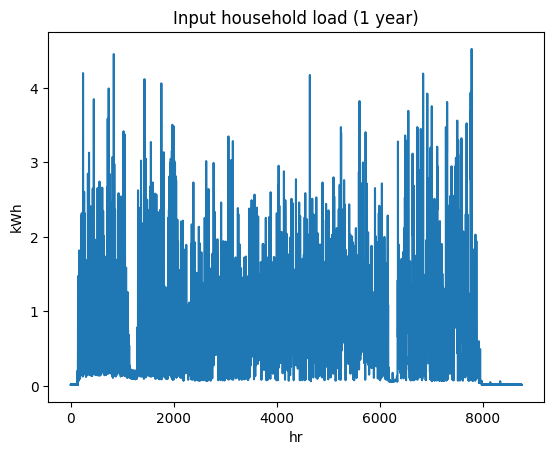

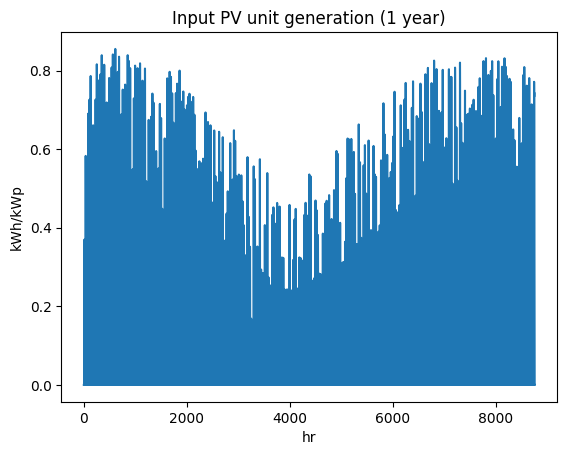

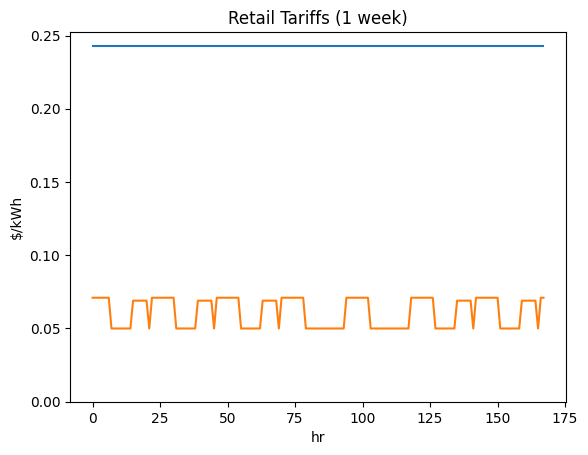

---- Optimising with PV: 1 - 20 kWp, Batt: 0 kWh. Determining PV capacity and dispatch.


************************************ Modell: PV > 1 kWp & BATT > 1 kWh ************************************
{'financial_horizon': 10, 'discount_rate': np.float64(0.06), 'grid_feedin_max': np.float64(5.0), 'pv_eol_capacity': np.float64(0.8), 'pv_eol_years': np.float64(25.0), 'pv_init_soh': np.float64(1.0), 'bess_e2p_ratio': np.float64(2.4), 'bess_roundtrip_eff': np.float64(0.88), 'bess_eol_years': np.float64(10.0), 'bess_eol_capacity': np.float64(0.7), 'bess_eol_cycles': np.float64(10000.0), 'bess_init_soh': np.float64(1.0), 'bess_eff_charge': np.float64(0.938083151964686), 'bess_eff_discharge': np.float64(0.938083151964686), 'scenario_name': 'Scenario_D_+5', 'scenario_set': 'SurfCoast', 'scenario_subset': 'JJP_open', 'year_start': 2022, 'datetime_name': 'DateTime1', 'meter_name': 'pc3040_nmi6073366271', 'solar_name': 'MELB', 'tariff_name_import_wkday': '3_Im_wkday', 'tariff_name_export_wkday': '3_

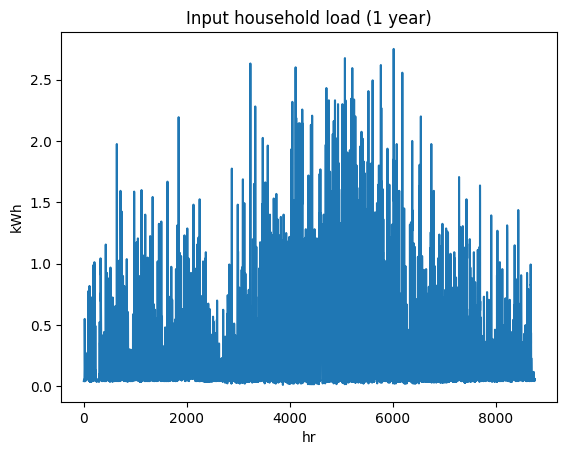

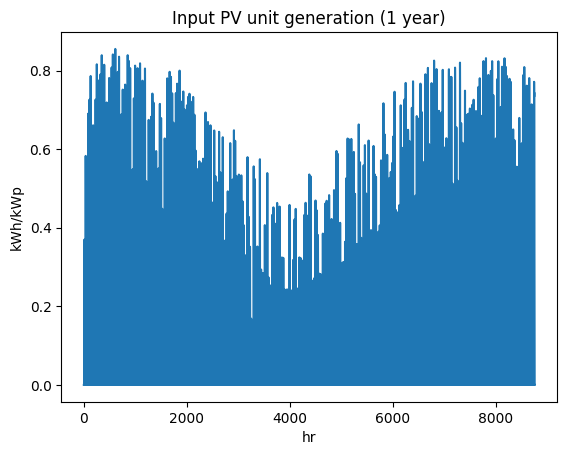

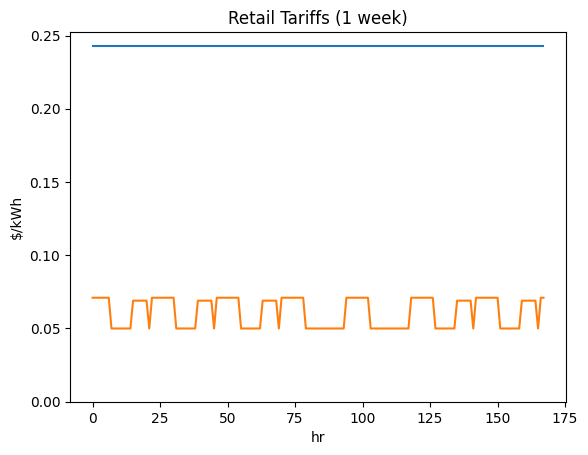

---- Optimising with PV: 1 - 20 kWp, Batt: 0 kWh. Determining PV capacity and dispatch.


************************************ Modell: PV > 1 kWp & BATT > 1 kWh ************************************
{'financial_horizon': 10, 'discount_rate': np.float64(0.06), 'grid_feedin_max': np.float64(5.0), 'pv_eol_capacity': np.float64(0.8), 'pv_eol_years': np.float64(25.0), 'pv_init_soh': np.float64(1.0), 'bess_e2p_ratio': np.float64(2.4), 'bess_roundtrip_eff': np.float64(0.88), 'bess_eol_years': np.float64(10.0), 'bess_eol_capacity': np.float64(0.7), 'bess_eol_cycles': np.float64(10000.0), 'bess_init_soh': np.float64(1.0), 'bess_eff_charge': np.float64(0.938083151964686), 'bess_eff_discharge': np.float64(0.938083151964686), 'scenario_name': 'Scenario_D_+5', 'scenario_set': 'SurfCoast', 'scenario_subset': 'JJP_open', 'year_start': 2022, 'datetime_name': 'DateTime1', 'meter_name': 'pc3040_nmi2746737039', 'solar_name': 'MELB', 'tariff_name_import_wkday': '3_Im_wkday', 'tariff_name_export_wkday': '3_

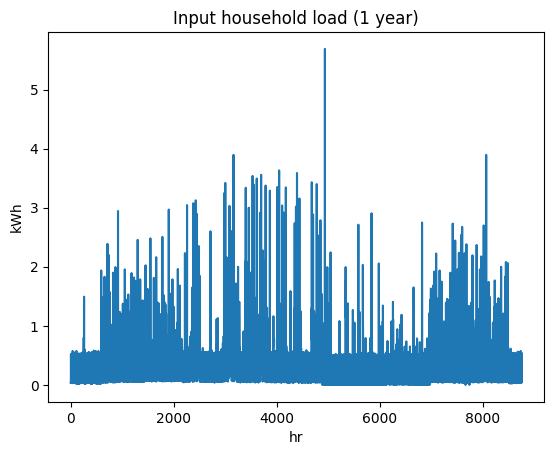

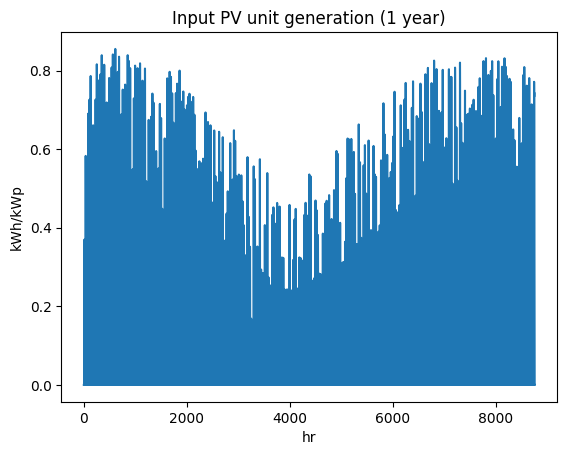

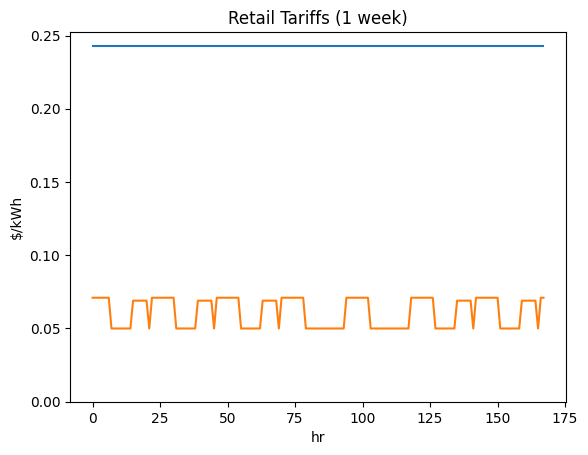

---- Optimising with PV: 1 - 20 kWp, Batt: 0 kWh. Determining PV capacity and dispatch.


************************************ Modell: PV > 1 kWp & BATT > 1 kWh ************************************
{'financial_horizon': 10, 'discount_rate': np.float64(0.06), 'grid_feedin_max': np.float64(5.0), 'pv_eol_capacity': np.float64(0.8), 'pv_eol_years': np.float64(25.0), 'pv_init_soh': np.float64(1.0), 'bess_e2p_ratio': np.float64(2.4), 'bess_roundtrip_eff': np.float64(0.88), 'bess_eol_years': np.float64(10.0), 'bess_eol_capacity': np.float64(0.7), 'bess_eol_cycles': np.float64(10000.0), 'bess_init_soh': np.float64(1.0), 'bess_eff_charge': np.float64(0.938083151964686), 'bess_eff_discharge': np.float64(0.938083151964686), 'scenario_name': 'Scenario_D_+5', 'scenario_set': 'SurfCoast', 'scenario_subset': 'JJP_open', 'year_start': 2022, 'datetime_name': 'DateTime1', 'meter_name': 'pc3040_nmi7793080808', 'solar_name': 'MELB', 'tariff_name_import_wkday': '3_Im_wkday', 'tariff_name_export_wkday': '3_

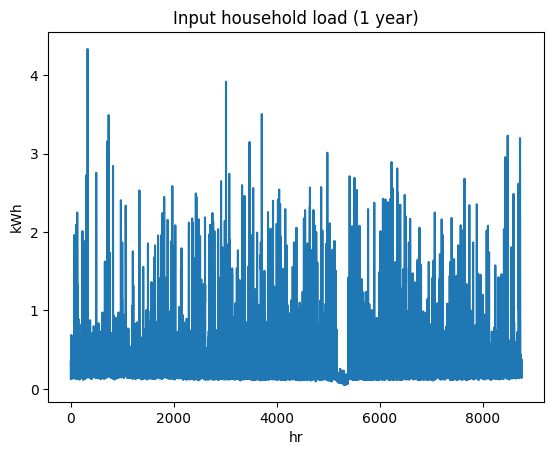

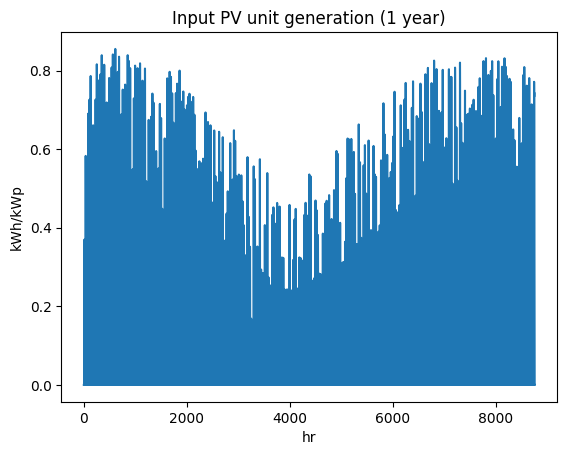

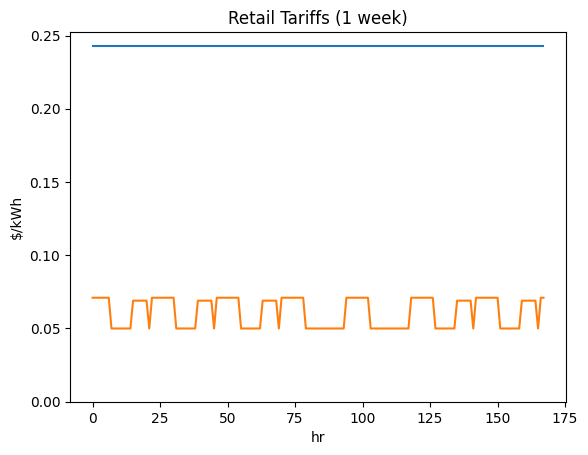

---- Optimising with PV: 1 - 20 kWp, Batt: 0 kWh. Determining PV capacity and dispatch.


************************************ Modell: PV > 1 kWp & BATT > 1 kWh ************************************
{'financial_horizon': 10, 'discount_rate': np.float64(0.06), 'grid_feedin_max': np.float64(5.0), 'pv_eol_capacity': np.float64(0.8), 'pv_eol_years': np.float64(25.0), 'pv_init_soh': np.float64(1.0), 'bess_e2p_ratio': np.float64(2.4), 'bess_roundtrip_eff': np.float64(0.88), 'bess_eol_years': np.float64(10.0), 'bess_eol_capacity': np.float64(0.7), 'bess_eol_cycles': np.float64(10000.0), 'bess_init_soh': np.float64(1.0), 'bess_eff_charge': np.float64(0.938083151964686), 'bess_eff_discharge': np.float64(0.938083151964686), 'scenario_name': 'Scenario_D_+5', 'scenario_set': 'SurfCoast', 'scenario_subset': 'JJP_open', 'year_start': 2022, 'datetime_name': 'DateTime1', 'meter_name': 'pc3040_nmi5212689606', 'solar_name': 'MELB', 'tariff_name_import_wkday': '3_Im_wkday', 'tariff_name_export_wkday': '3_

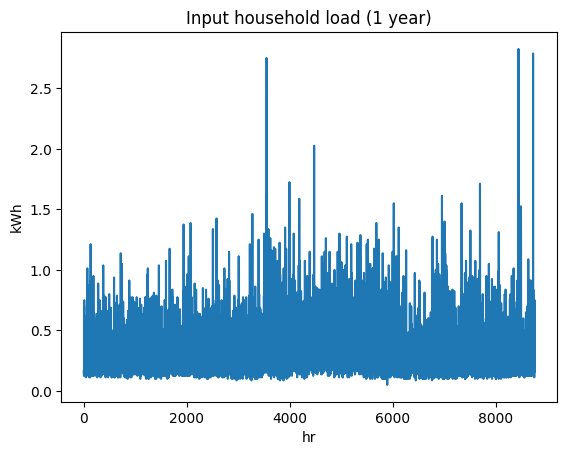

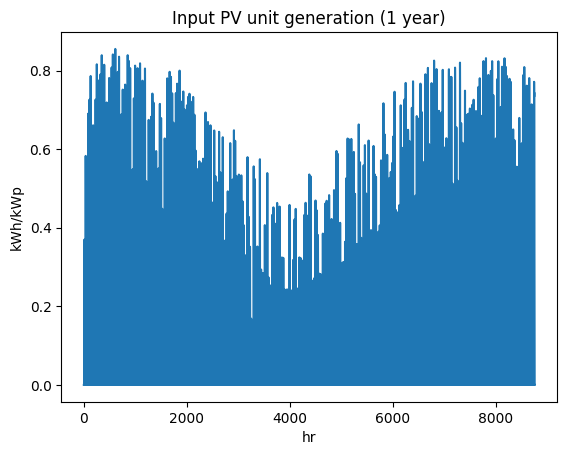

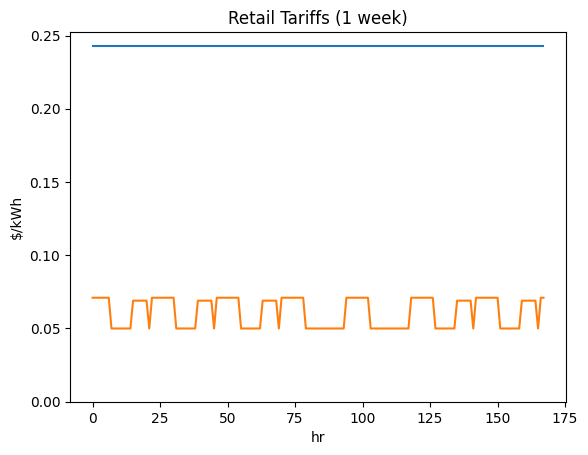

---- Optimising with PV: 1 - 20 kWp, Batt: 0 kWh. Determining PV capacity and dispatch.


************************************ Modell: PV > 1 kWp & BATT > 1 kWh ************************************
{'financial_horizon': 10, 'discount_rate': np.float64(0.06), 'grid_feedin_max': np.float64(5.0), 'pv_eol_capacity': np.float64(0.8), 'pv_eol_years': np.float64(25.0), 'pv_init_soh': np.float64(1.0), 'bess_e2p_ratio': np.float64(2.4), 'bess_roundtrip_eff': np.float64(0.88), 'bess_eol_years': np.float64(10.0), 'bess_eol_capacity': np.float64(0.7), 'bess_eol_cycles': np.float64(10000.0), 'bess_init_soh': np.float64(1.0), 'bess_eff_charge': np.float64(0.938083151964686), 'bess_eff_discharge': np.float64(0.938083151964686), 'scenario_name': 'Scenario_D_+5', 'scenario_set': 'SurfCoast', 'scenario_subset': 'JJP_open', 'year_start': 2022, 'datetime_name': 'DateTime1', 'meter_name': 'pc3040_nmi2662660336', 'solar_name': 'MELB', 'tariff_name_import_wkday': '3_Im_wkday', 'tariff_name_export_wkday': '3_

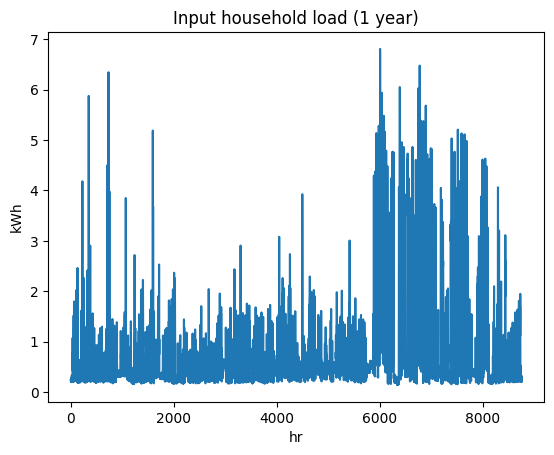

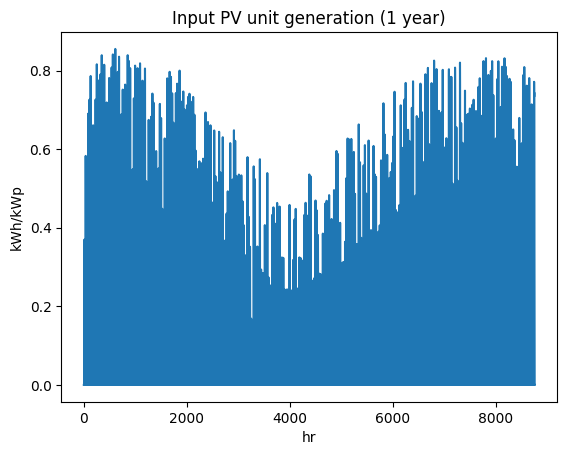

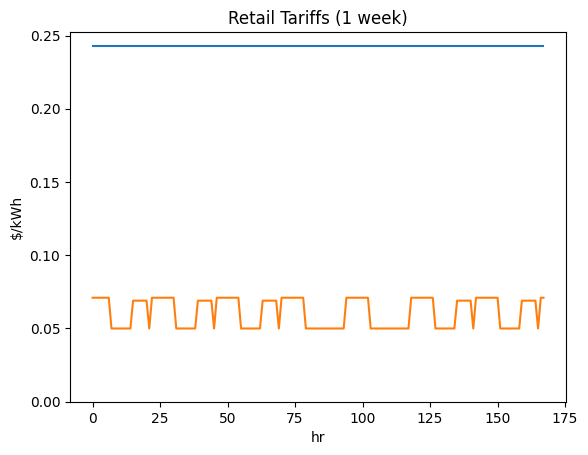

---- Optimising with PV: 1 - 20 kWp, Batt: 0 kWh. Determining PV capacity and dispatch.


************************************ Modell: PV > 1 kWp & BATT > 1 kWh ************************************
{'financial_horizon': 10, 'discount_rate': np.float64(0.06), 'grid_feedin_max': np.float64(5.0), 'pv_eol_capacity': np.float64(0.8), 'pv_eol_years': np.float64(25.0), 'pv_init_soh': np.float64(1.0), 'bess_e2p_ratio': np.float64(2.4), 'bess_roundtrip_eff': np.float64(0.88), 'bess_eol_years': np.float64(10.0), 'bess_eol_capacity': np.float64(0.7), 'bess_eol_cycles': np.float64(10000.0), 'bess_init_soh': np.float64(1.0), 'bess_eff_charge': np.float64(0.938083151964686), 'bess_eff_discharge': np.float64(0.938083151964686), 'scenario_name': 'Scenario_D_+5', 'scenario_set': 'SurfCoast', 'scenario_subset': 'JJP_open', 'year_start': 2022, 'datetime_name': 'DateTime1', 'meter_name': 'pc3040_nmi6606408075', 'solar_name': 'MELB', 'tariff_name_import_wkday': '3_Im_wkday', 'tariff_name_export_wkday': '3_

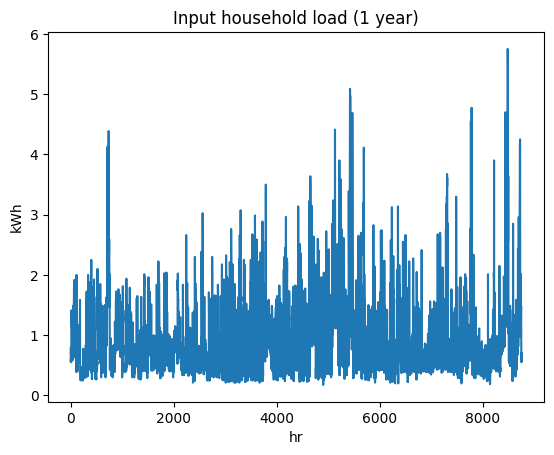

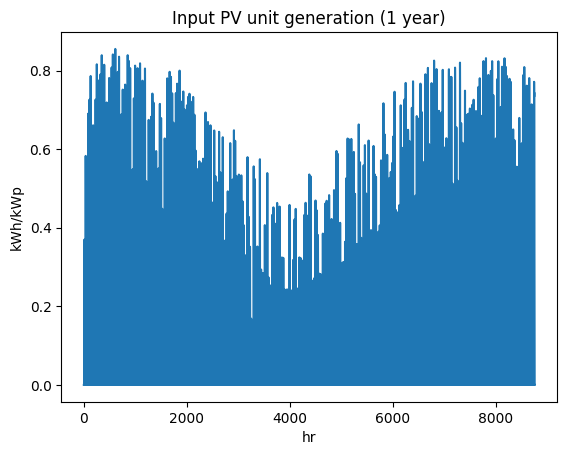

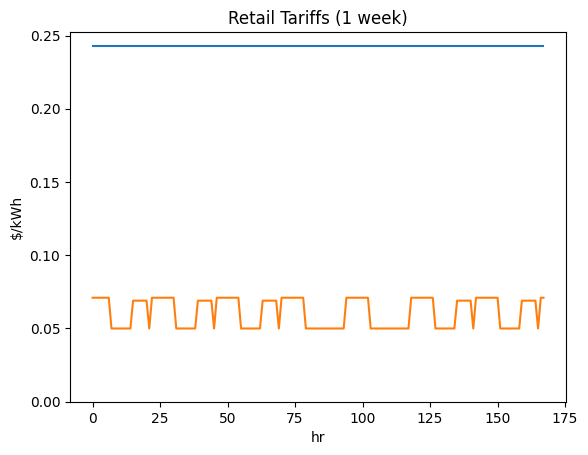

---- Optimising with PV: 1 - 20 kWp, Batt: 0 kWh. Determining PV capacity and dispatch.


************************************ Modell: PV > 1 kWp & BATT > 1 kWh ************************************
{'financial_horizon': 10, 'discount_rate': np.float64(0.06), 'grid_feedin_max': np.float64(5.0), 'pv_eol_capacity': np.float64(0.8), 'pv_eol_years': np.float64(25.0), 'pv_init_soh': np.float64(1.0), 'bess_e2p_ratio': np.float64(2.4), 'bess_roundtrip_eff': np.float64(0.88), 'bess_eol_years': np.float64(10.0), 'bess_eol_capacity': np.float64(0.7), 'bess_eol_cycles': np.float64(10000.0), 'bess_init_soh': np.float64(1.0), 'bess_eff_charge': np.float64(0.938083151964686), 'bess_eff_discharge': np.float64(0.938083151964686), 'scenario_name': 'Scenario_D_+5', 'scenario_set': 'SurfCoast', 'scenario_subset': 'JJP_open', 'year_start': 2022, 'datetime_name': 'DateTime1', 'meter_name': 'pc3040_nmi7199117700', 'solar_name': 'MELB', 'tariff_name_import_wkday': '3_Im_wkday', 'tariff_name_export_wkday': '3_

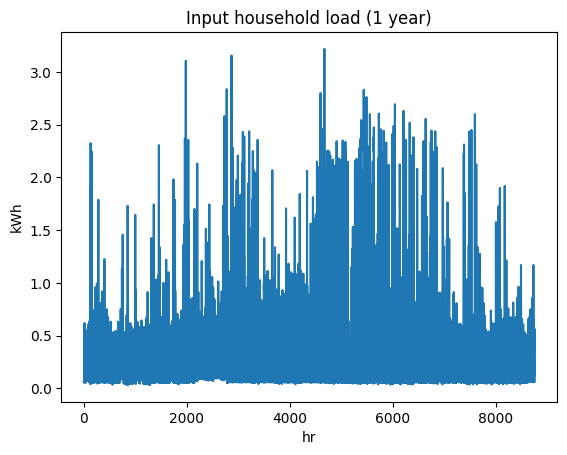

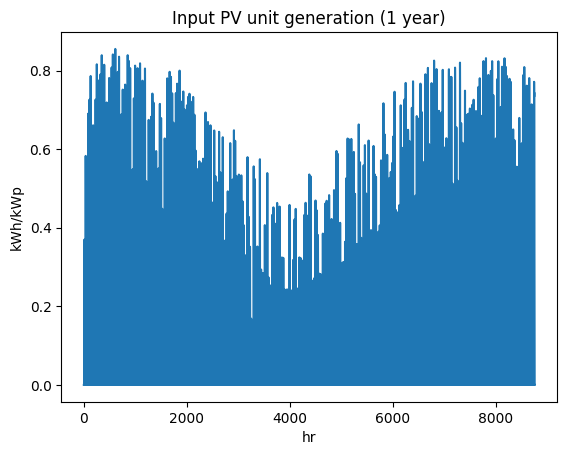

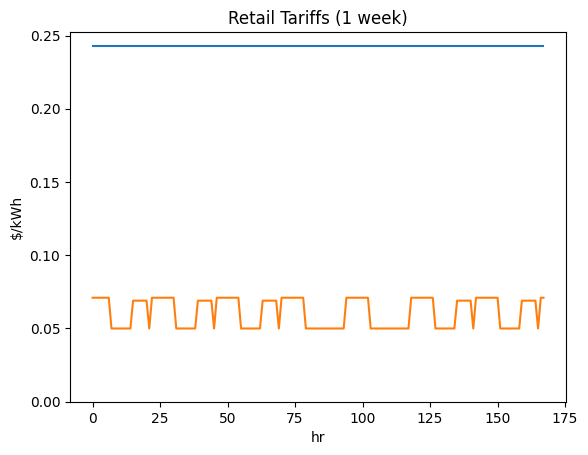

---- Optimising with PV: 1 - 20 kWp, Batt: 0 kWh. Determining PV capacity and dispatch.


************************************ Modell: PV > 1 kWp & BATT > 1 kWh ************************************
{'financial_horizon': 10, 'discount_rate': np.float64(0.06), 'grid_feedin_max': np.float64(5.0), 'pv_eol_capacity': np.float64(0.8), 'pv_eol_years': np.float64(25.0), 'pv_init_soh': np.float64(1.0), 'bess_e2p_ratio': np.float64(2.4), 'bess_roundtrip_eff': np.float64(0.88), 'bess_eol_years': np.float64(10.0), 'bess_eol_capacity': np.float64(0.7), 'bess_eol_cycles': np.float64(10000.0), 'bess_init_soh': np.float64(1.0), 'bess_eff_charge': np.float64(0.938083151964686), 'bess_eff_discharge': np.float64(0.938083151964686), 'scenario_name': 'Scenario_D_+5', 'scenario_set': 'SurfCoast', 'scenario_subset': 'JJP_open', 'year_start': 2022, 'datetime_name': 'DateTime1', 'meter_name': 'pc3040_nmi5258288734', 'solar_name': 'MELB', 'tariff_name_import_wkday': '3_Im_wkday', 'tariff_name_export_wkday': '3_

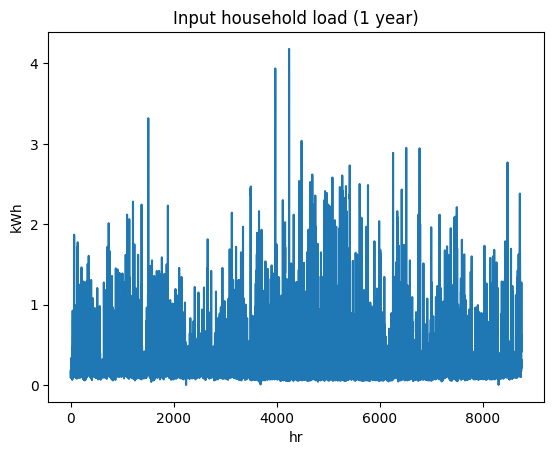

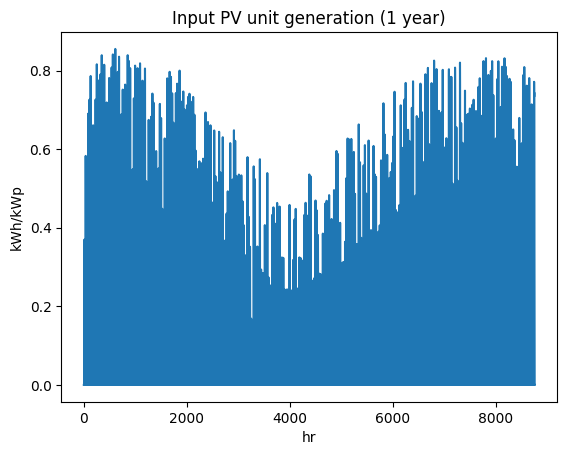

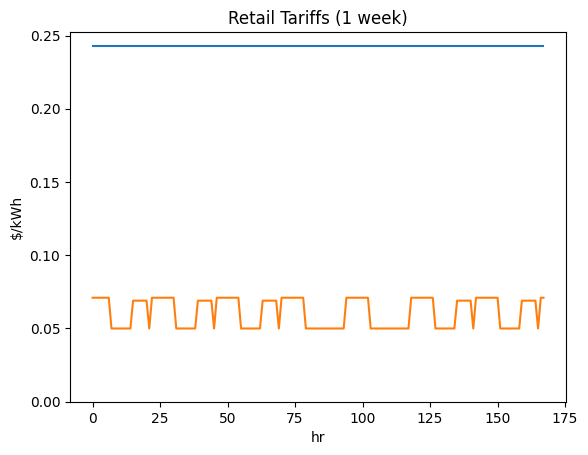

---- Optimising with PV: 1 - 20 kWp, Batt: 0 kWh. Determining PV capacity and dispatch.


************************************ Modell: PV > 1 kWp & BATT > 1 kWh ************************************
{'financial_horizon': 10, 'discount_rate': np.float64(0.06), 'grid_feedin_max': np.float64(5.0), 'pv_eol_capacity': np.float64(0.8), 'pv_eol_years': np.float64(25.0), 'pv_init_soh': np.float64(1.0), 'bess_e2p_ratio': np.float64(2.4), 'bess_roundtrip_eff': np.float64(0.88), 'bess_eol_years': np.float64(10.0), 'bess_eol_capacity': np.float64(0.7), 'bess_eol_cycles': np.float64(10000.0), 'bess_init_soh': np.float64(1.0), 'bess_eff_charge': np.float64(0.938083151964686), 'bess_eff_discharge': np.float64(0.938083151964686), 'scenario_name': 'Scenario_D_+5', 'scenario_set': 'SurfCoast', 'scenario_subset': 'JJP_open', 'year_start': 2022, 'datetime_name': 'DateTime1', 'meter_name': 'pc3040_nmi1909791697', 'solar_name': 'MELB', 'tariff_name_import_wkday': '3_Im_wkday', 'tariff_name_export_wkday': '3_

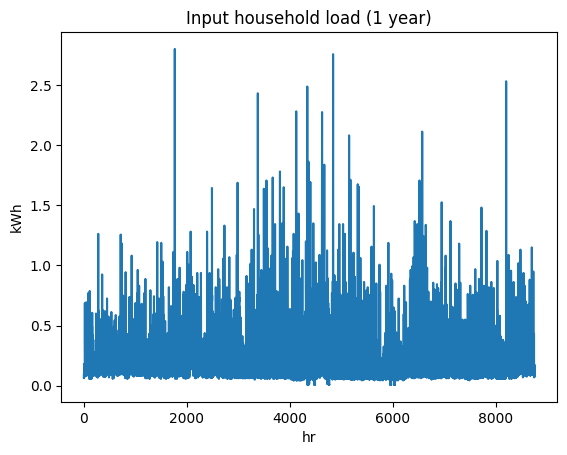

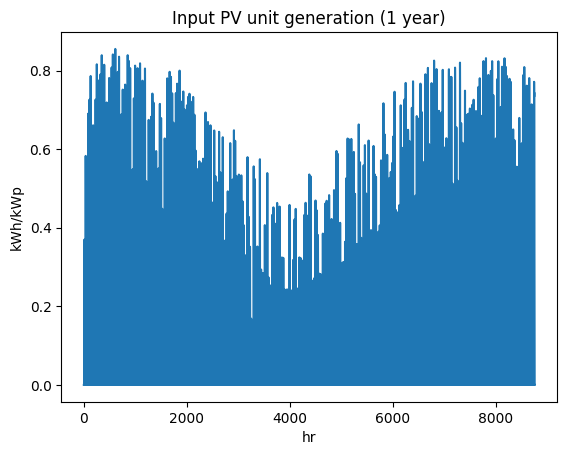

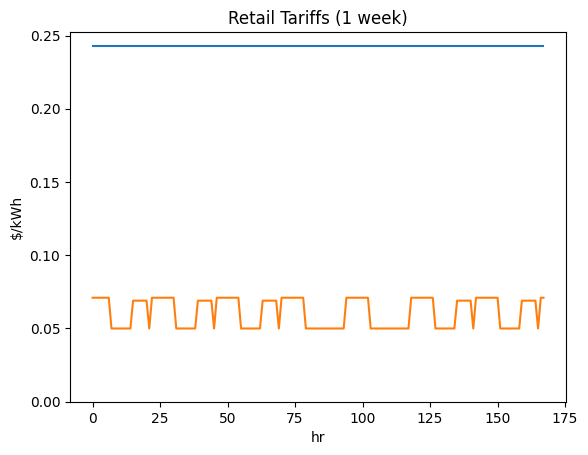

---- Optimising with PV: 1 - 20 kWp, Batt: 0 kWh. Determining PV capacity and dispatch.


************************************ Modell: PV > 1 kWp & BATT > 1 kWh ************************************
{'financial_horizon': 10, 'discount_rate': np.float64(0.06), 'grid_feedin_max': np.float64(5.0), 'pv_eol_capacity': np.float64(0.8), 'pv_eol_years': np.float64(25.0), 'pv_init_soh': np.float64(1.0), 'bess_e2p_ratio': np.float64(2.4), 'bess_roundtrip_eff': np.float64(0.88), 'bess_eol_years': np.float64(10.0), 'bess_eol_capacity': np.float64(0.7), 'bess_eol_cycles': np.float64(10000.0), 'bess_init_soh': np.float64(1.0), 'bess_eff_charge': np.float64(0.938083151964686), 'bess_eff_discharge': np.float64(0.938083151964686), 'scenario_name': 'Scenario_D_+5', 'scenario_set': 'SurfCoast', 'scenario_subset': 'JJP_open', 'year_start': 2022, 'datetime_name': 'DateTime1', 'meter_name': 'pc3040_nmi4300341256', 'solar_name': 'MELB', 'tariff_name_import_wkday': '3_Im_wkday', 'tariff_name_export_wkday': '3_

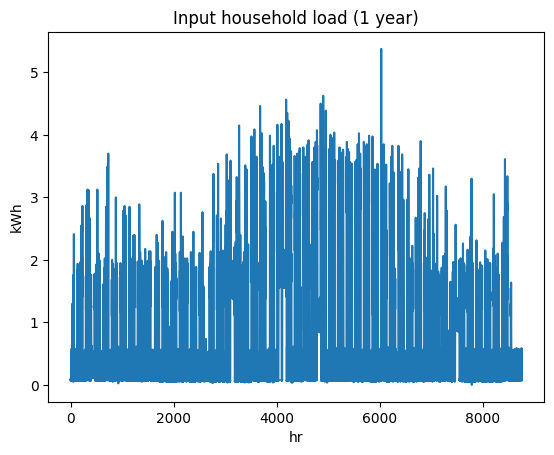

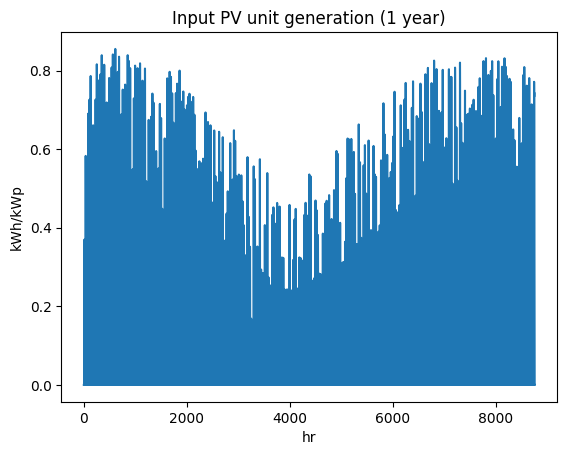

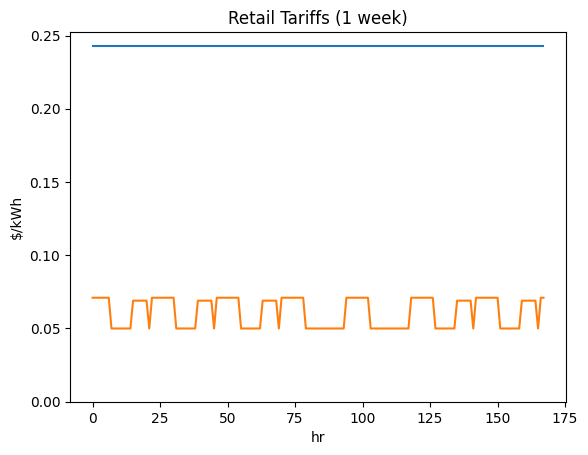

---- Optimising with PV: 1 - 20 kWp, Batt: 0 kWh. Determining PV capacity and dispatch.


************************************ Modell: PV > 1 kWp & BATT > 1 kWh ************************************
{'financial_horizon': 10, 'discount_rate': np.float64(0.06), 'grid_feedin_max': np.float64(5.0), 'pv_eol_capacity': np.float64(0.8), 'pv_eol_years': np.float64(25.0), 'pv_init_soh': np.float64(1.0), 'bess_e2p_ratio': np.float64(2.4), 'bess_roundtrip_eff': np.float64(0.88), 'bess_eol_years': np.float64(10.0), 'bess_eol_capacity': np.float64(0.7), 'bess_eol_cycles': np.float64(10000.0), 'bess_init_soh': np.float64(1.0), 'bess_eff_charge': np.float64(0.938083151964686), 'bess_eff_discharge': np.float64(0.938083151964686), 'scenario_name': 'Scenario_D_+5', 'scenario_set': 'SurfCoast', 'scenario_subset': 'JJP_open', 'year_start': 2022, 'datetime_name': 'DateTime1', 'meter_name': 'pc3084_nmi9387979626', 'solar_name': 'MELB', 'tariff_name_import_wkday': '3_Im_wkday', 'tariff_name_export_wkday': '3_

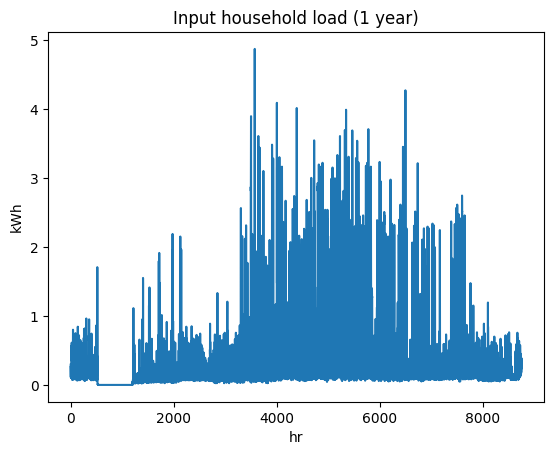

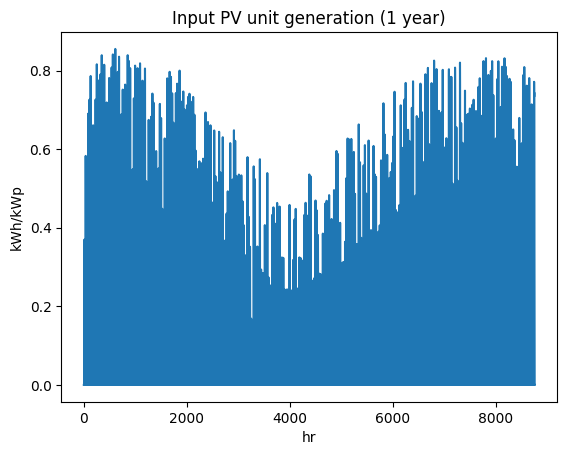

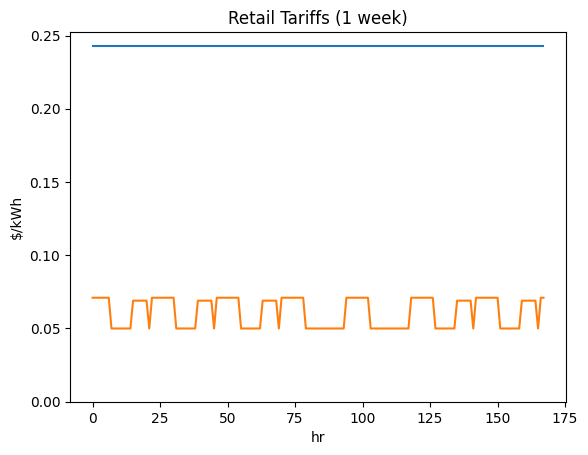

---- Optimising with PV: 1 - 20 kWp, Batt: 0 kWh. Determining PV capacity and dispatch.


************************************ Modell: PV > 1 kWp & BATT > 1 kWh ************************************
{'financial_horizon': 10, 'discount_rate': np.float64(0.06), 'grid_feedin_max': np.float64(5.0), 'pv_eol_capacity': np.float64(0.8), 'pv_eol_years': np.float64(25.0), 'pv_init_soh': np.float64(1.0), 'bess_e2p_ratio': np.float64(2.4), 'bess_roundtrip_eff': np.float64(0.88), 'bess_eol_years': np.float64(10.0), 'bess_eol_capacity': np.float64(0.7), 'bess_eol_cycles': np.float64(10000.0), 'bess_init_soh': np.float64(1.0), 'bess_eff_charge': np.float64(0.938083151964686), 'bess_eff_discharge': np.float64(0.938083151964686), 'scenario_name': 'Scenario_D_+5', 'scenario_set': 'SurfCoast', 'scenario_subset': 'JJP_open', 'year_start': 2022, 'datetime_name': 'DateTime1', 'meter_name': 'pc3039_nmi1428458102', 'solar_name': 'MELB', 'tariff_name_import_wkday': '3_Im_wkday', 'tariff_name_export_wkday': '3_

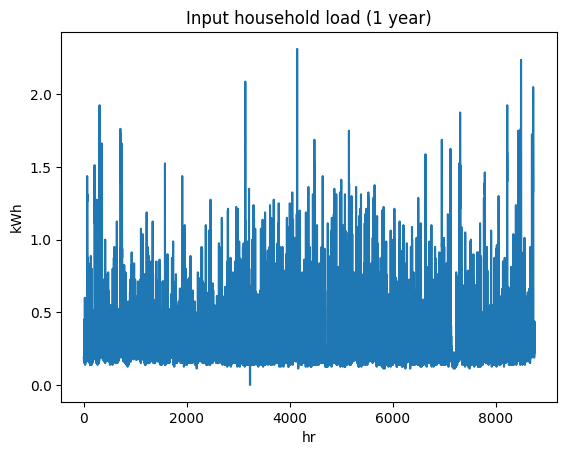

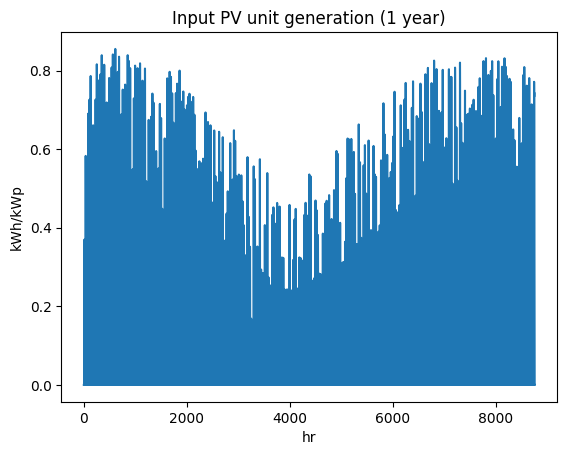

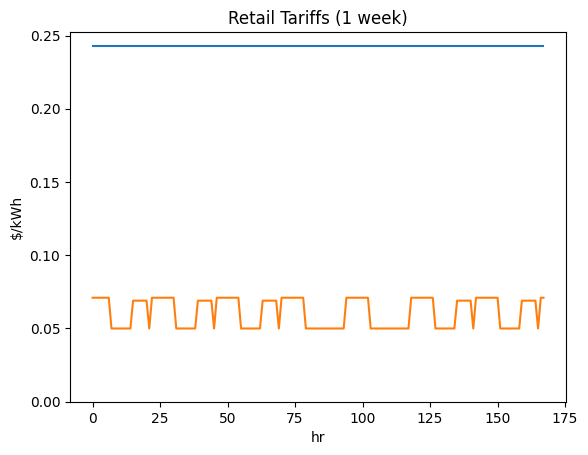

---- Optimising with PV: 1 - 20 kWp, Batt: 0 kWh. Determining PV capacity and dispatch.


************************************ Modell: PV > 1 kWp & BATT > 1 kWh ************************************
{'financial_horizon': 10, 'discount_rate': np.float64(0.06), 'grid_feedin_max': np.float64(5.0), 'pv_eol_capacity': np.float64(0.8), 'pv_eol_years': np.float64(25.0), 'pv_init_soh': np.float64(1.0), 'bess_e2p_ratio': np.float64(2.4), 'bess_roundtrip_eff': np.float64(0.88), 'bess_eol_years': np.float64(10.0), 'bess_eol_capacity': np.float64(0.7), 'bess_eol_cycles': np.float64(10000.0), 'bess_init_soh': np.float64(1.0), 'bess_eff_charge': np.float64(0.938083151964686), 'bess_eff_discharge': np.float64(0.938083151964686), 'scenario_name': 'Scenario_D_+5', 'scenario_set': 'SurfCoast', 'scenario_subset': 'JJP_open', 'year_start': 2022, 'datetime_name': 'DateTime1', 'meter_name': 'pc3033_nmi4439767425', 'solar_name': 'MELB', 'tariff_name_import_wkday': '3_Im_wkday', 'tariff_name_export_wkday': '3_

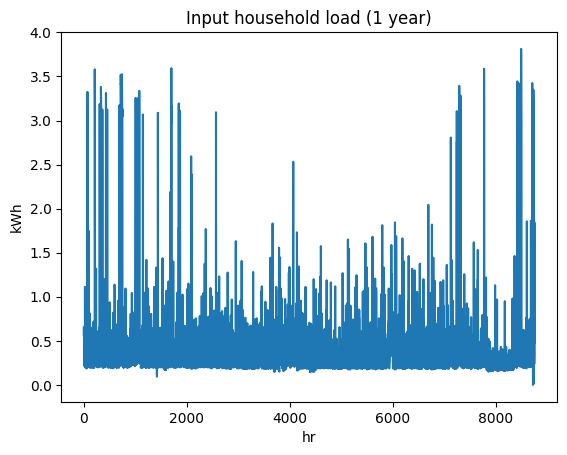

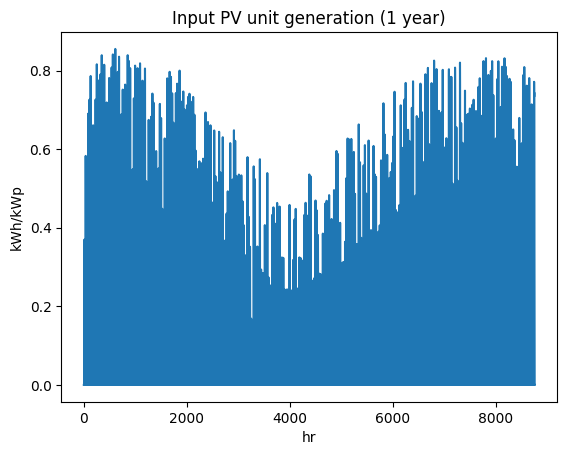

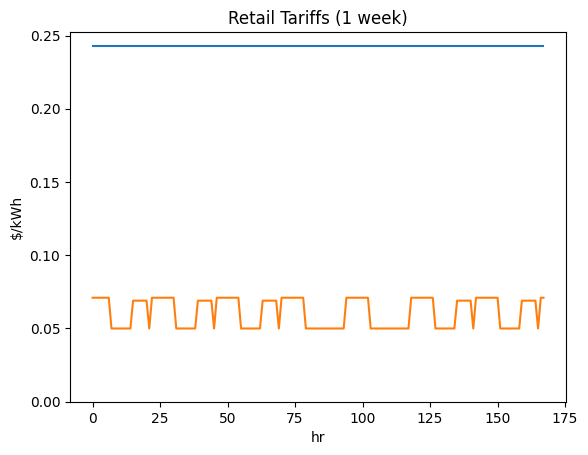

---- Optimising with PV: 1 - 20 kWp, Batt: 0 kWh. Determining PV capacity and dispatch.


************************************ Modell: PV > 1 kWp & BATT > 1 kWh ************************************
{'financial_horizon': 10, 'discount_rate': np.float64(0.06), 'grid_feedin_max': np.float64(5.0), 'pv_eol_capacity': np.float64(0.8), 'pv_eol_years': np.float64(25.0), 'pv_init_soh': np.float64(1.0), 'bess_e2p_ratio': np.float64(2.4), 'bess_roundtrip_eff': np.float64(0.88), 'bess_eol_years': np.float64(10.0), 'bess_eol_capacity': np.float64(0.7), 'bess_eol_cycles': np.float64(10000.0), 'bess_init_soh': np.float64(1.0), 'bess_eff_charge': np.float64(0.938083151964686), 'bess_eff_discharge': np.float64(0.938083151964686), 'scenario_name': 'Scenario_D_+5', 'scenario_set': 'SurfCoast', 'scenario_subset': 'JJP_open', 'year_start': 2022, 'datetime_name': 'DateTime1', 'meter_name': 'pc3033_nmi3303341488', 'solar_name': 'MELB', 'tariff_name_import_wkday': '3_Im_wkday', 'tariff_name_export_wkday': '3_

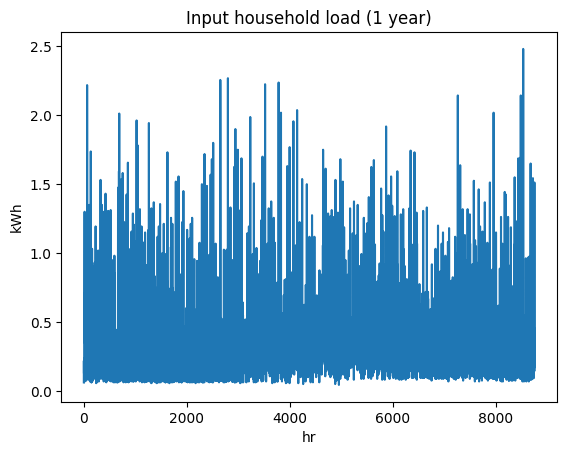

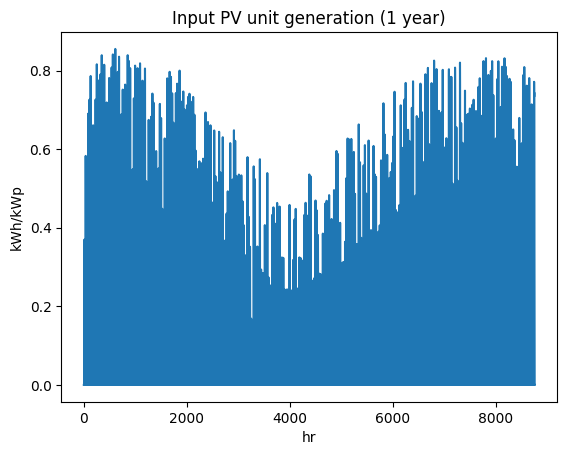

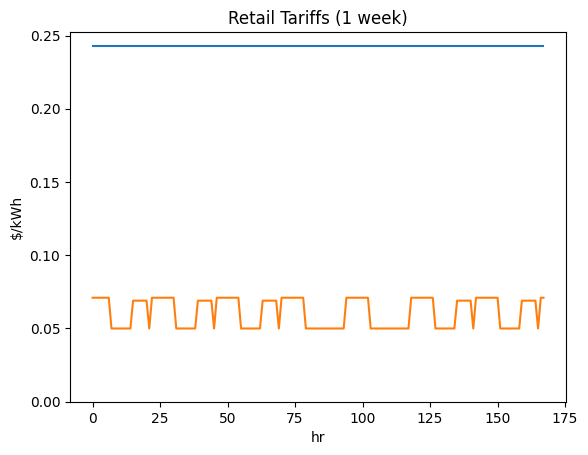

---- Optimising with PV: 1 - 20 kWp, Batt: 0 kWh. Determining PV capacity and dispatch.


************************************ Modell: PV > 1 kWp & BATT > 1 kWh ************************************
{'financial_horizon': 10, 'discount_rate': np.float64(0.06), 'grid_feedin_max': np.float64(5.0), 'pv_eol_capacity': np.float64(0.8), 'pv_eol_years': np.float64(25.0), 'pv_init_soh': np.float64(1.0), 'bess_e2p_ratio': np.float64(2.4), 'bess_roundtrip_eff': np.float64(0.88), 'bess_eol_years': np.float64(10.0), 'bess_eol_capacity': np.float64(0.7), 'bess_eol_cycles': np.float64(10000.0), 'bess_init_soh': np.float64(1.0), 'bess_eff_charge': np.float64(0.938083151964686), 'bess_eff_discharge': np.float64(0.938083151964686), 'scenario_name': 'Scenario_D_+5', 'scenario_set': 'SurfCoast', 'scenario_subset': 'JJP_open', 'year_start': 2022, 'datetime_name': 'DateTime1', 'meter_name': 'pc3033_nmi7233804851', 'solar_name': 'MELB', 'tariff_name_import_wkday': '3_Im_wkday', 'tariff_name_export_wkday': '3_

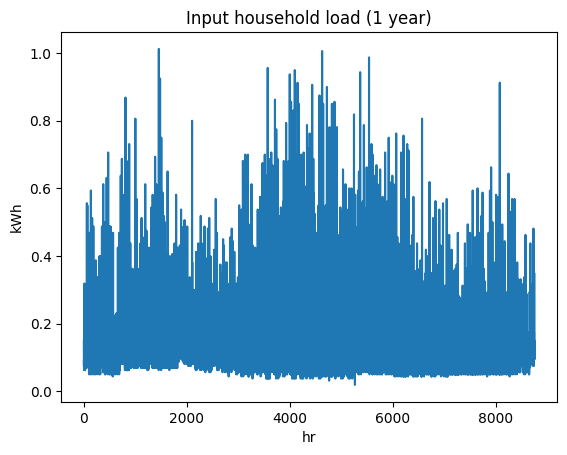

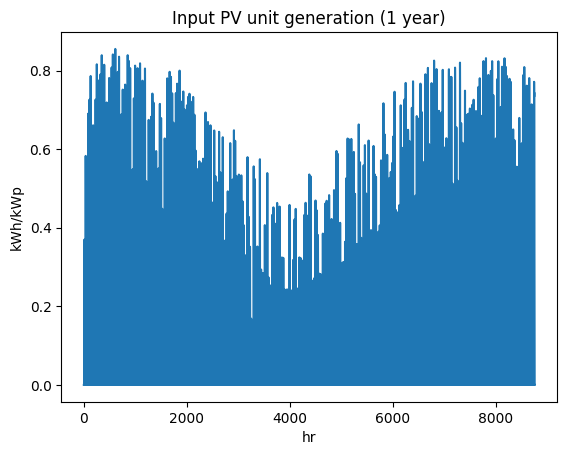

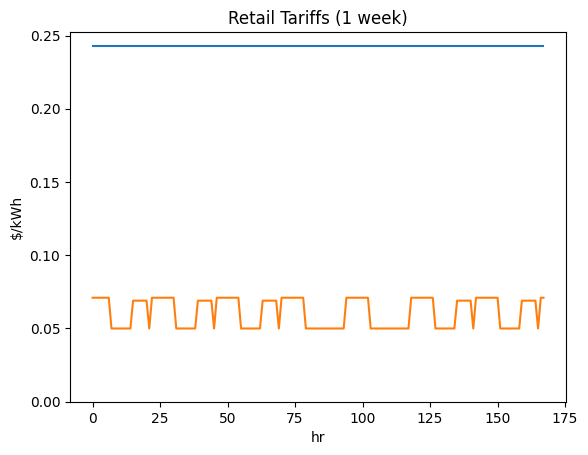

---- Optimising with PV: 1 - 20 kWp, Batt: 0 kWh. Determining PV capacity and dispatch.


************************************ Modell: PV > 1 kWp & BATT > 1 kWh ************************************
{'financial_horizon': 10, 'discount_rate': np.float64(0.06), 'grid_feedin_max': np.float64(5.0), 'pv_eol_capacity': np.float64(0.8), 'pv_eol_years': np.float64(25.0), 'pv_init_soh': np.float64(1.0), 'bess_e2p_ratio': np.float64(2.4), 'bess_roundtrip_eff': np.float64(0.88), 'bess_eol_years': np.float64(10.0), 'bess_eol_capacity': np.float64(0.7), 'bess_eol_cycles': np.float64(10000.0), 'bess_init_soh': np.float64(1.0), 'bess_eff_charge': np.float64(0.938083151964686), 'bess_eff_discharge': np.float64(0.938083151964686), 'scenario_name': 'Scenario_D_+5', 'scenario_set': 'SurfCoast', 'scenario_subset': 'JJP_open', 'year_start': 2022, 'datetime_name': 'DateTime1', 'meter_name': 'pc3072_nmi2623134012', 'solar_name': 'MELB', 'tariff_name_import_wkday': '3_Im_wkday', 'tariff_name_export_wkday': '3_

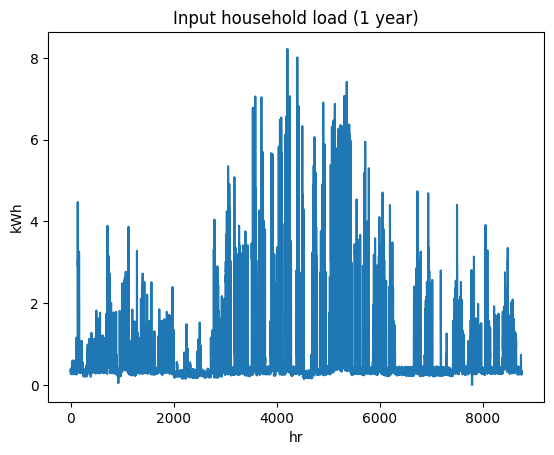

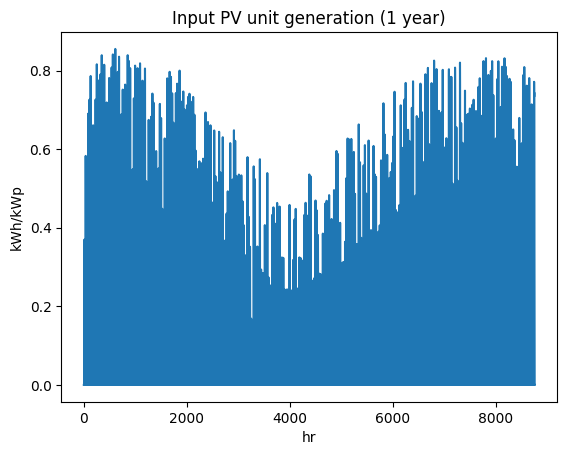

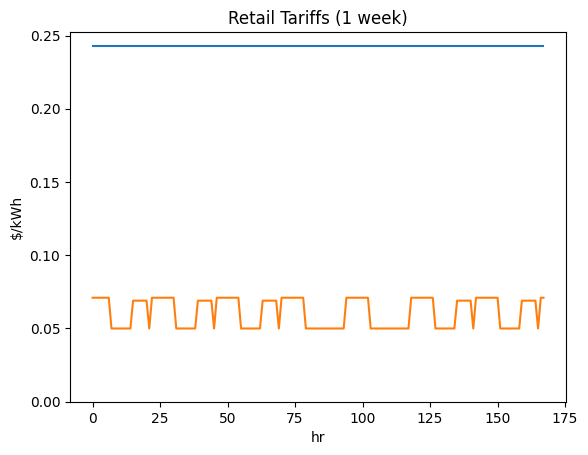

---- Optimising with PV: 1 - 20 kWp, Batt: 0 kWh. Determining PV capacity and dispatch.


************************************ Modell: PV > 1 kWp & BATT > 1 kWh ************************************
{'financial_horizon': 10, 'discount_rate': np.float64(0.06), 'grid_feedin_max': np.float64(5.0), 'pv_eol_capacity': np.float64(0.8), 'pv_eol_years': np.float64(25.0), 'pv_init_soh': np.float64(1.0), 'bess_e2p_ratio': np.float64(2.4), 'bess_roundtrip_eff': np.float64(0.88), 'bess_eol_years': np.float64(10.0), 'bess_eol_capacity': np.float64(0.7), 'bess_eol_cycles': np.float64(10000.0), 'bess_init_soh': np.float64(1.0), 'bess_eff_charge': np.float64(0.938083151964686), 'bess_eff_discharge': np.float64(0.938083151964686), 'scenario_name': 'Scenario_D_+5', 'scenario_set': 'SurfCoast', 'scenario_subset': 'JJP_open', 'year_start': 2022, 'datetime_name': 'DateTime1', 'meter_name': 'pc3079_nmi7046950884', 'solar_name': 'MELB', 'tariff_name_import_wkday': '3_Im_wkday', 'tariff_name_export_wkday': '3_

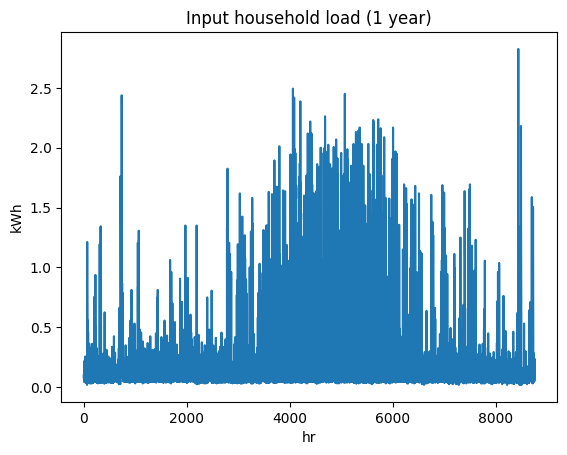

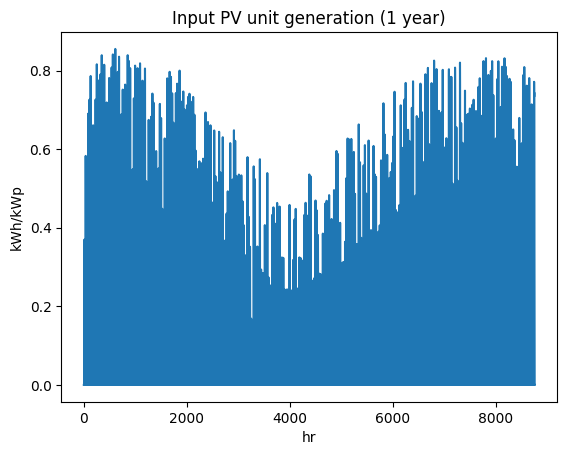

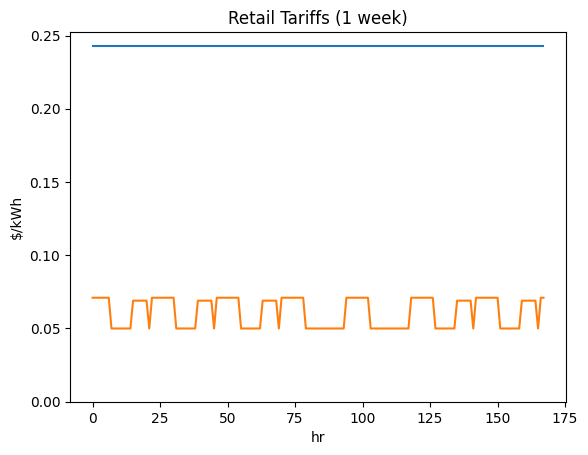

---- Optimising with PV: 1 - 20 kWp, Batt: 0 kWh. Determining PV capacity and dispatch.


************************************ Modell: PV > 1 kWp & BATT > 1 kWh ************************************
{'financial_horizon': 10, 'discount_rate': np.float64(0.06), 'grid_feedin_max': np.float64(5.0), 'pv_eol_capacity': np.float64(0.8), 'pv_eol_years': np.float64(25.0), 'pv_init_soh': np.float64(1.0), 'bess_e2p_ratio': np.float64(2.4), 'bess_roundtrip_eff': np.float64(0.88), 'bess_eol_years': np.float64(10.0), 'bess_eol_capacity': np.float64(0.7), 'bess_eol_cycles': np.float64(10000.0), 'bess_init_soh': np.float64(1.0), 'bess_eff_charge': np.float64(0.938083151964686), 'bess_eff_discharge': np.float64(0.938083151964686), 'scenario_name': 'Scenario_D_+5', 'scenario_set': 'SurfCoast', 'scenario_subset': 'JJP_open', 'year_start': 2022, 'datetime_name': 'DateTime1', 'meter_name': 'pc3072_nmi3265903582', 'solar_name': 'MELB', 'tariff_name_import_wkday': '3_Im_wkday', 'tariff_name_export_wkday': '3_

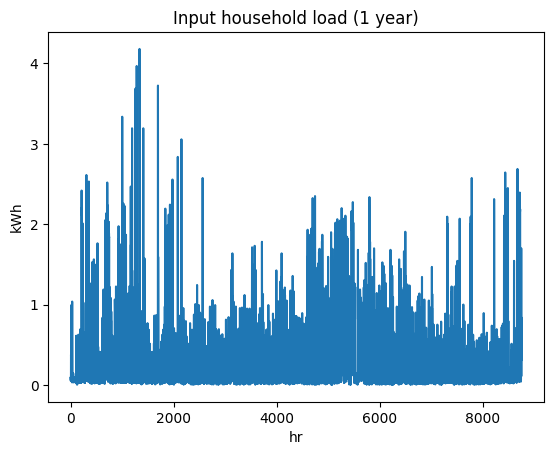

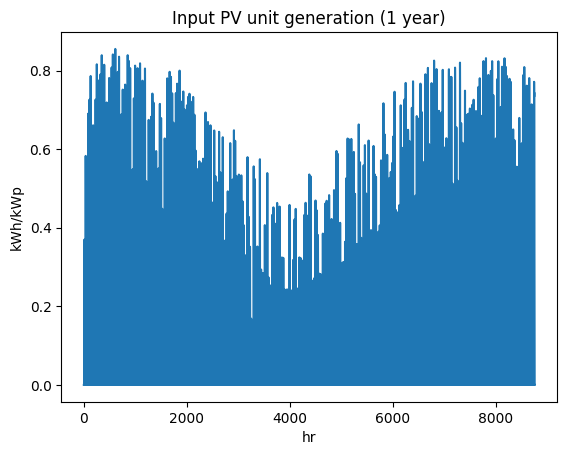

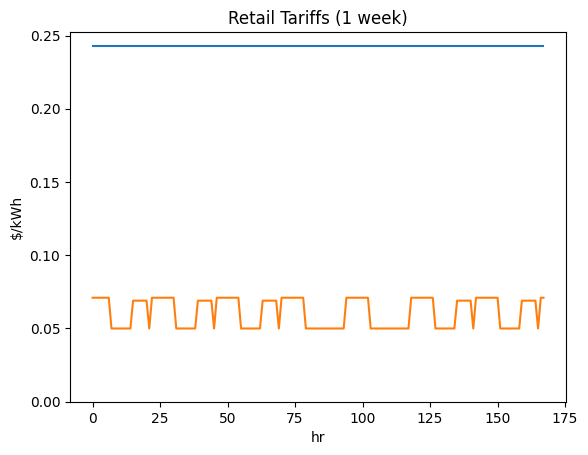

---- Optimising with PV: 1 - 20 kWp, Batt: 0 kWh. Determining PV capacity and dispatch.


************************************ Modell: PV > 1 kWp & BATT > 1 kWh ************************************
{'financial_horizon': 10, 'discount_rate': np.float64(0.06), 'grid_feedin_max': np.float64(5.0), 'pv_eol_capacity': np.float64(0.8), 'pv_eol_years': np.float64(25.0), 'pv_init_soh': np.float64(1.0), 'bess_e2p_ratio': np.float64(2.4), 'bess_roundtrip_eff': np.float64(0.88), 'bess_eol_years': np.float64(10.0), 'bess_eol_capacity': np.float64(0.7), 'bess_eol_cycles': np.float64(10000.0), 'bess_init_soh': np.float64(1.0), 'bess_eff_charge': np.float64(0.938083151964686), 'bess_eff_discharge': np.float64(0.938083151964686), 'scenario_name': 'Scenario_D_+5', 'scenario_set': 'SurfCoast', 'scenario_subset': 'JJP_open', 'year_start': 2022, 'datetime_name': 'DateTime1', 'meter_name': 'pc3012_nmi3191123398', 'solar_name': 'MELB', 'tariff_name_import_wkday': '3_Im_wkday', 'tariff_name_export_wkday': '3_

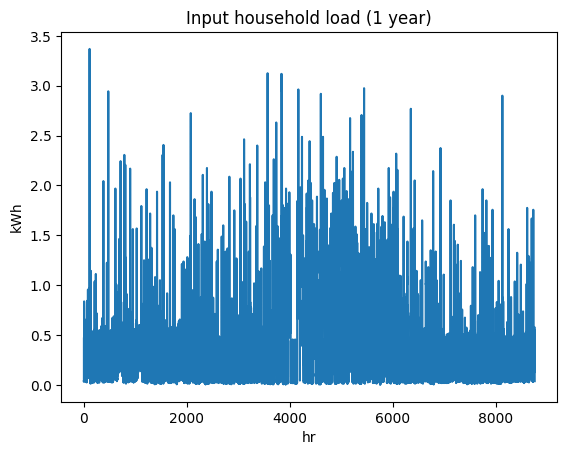

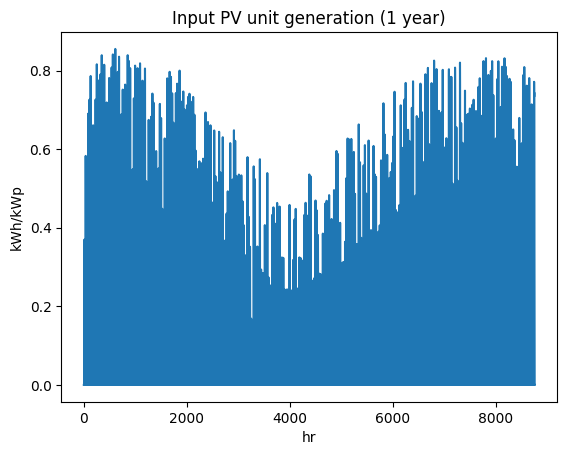

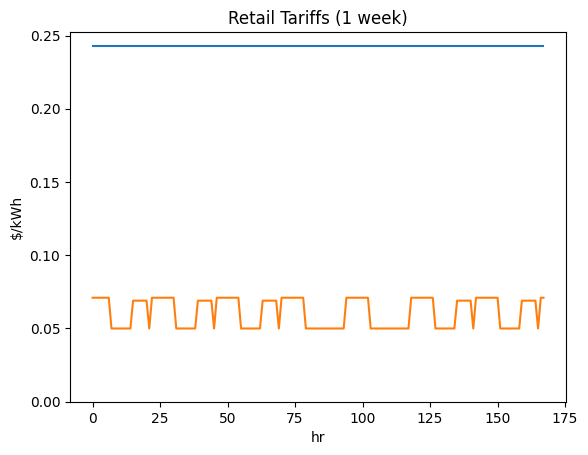

---- Optimising with PV: 1 - 20 kWp, Batt: 0 kWh. Determining PV capacity and dispatch.


************************************ Modell: PV > 1 kWp & BATT > 1 kWh ************************************
{'financial_horizon': 10, 'discount_rate': np.float64(0.06), 'grid_feedin_max': np.float64(5.0), 'pv_eol_capacity': np.float64(0.8), 'pv_eol_years': np.float64(25.0), 'pv_init_soh': np.float64(1.0), 'bess_e2p_ratio': np.float64(2.4), 'bess_roundtrip_eff': np.float64(0.88), 'bess_eol_years': np.float64(10.0), 'bess_eol_capacity': np.float64(0.7), 'bess_eol_cycles': np.float64(10000.0), 'bess_init_soh': np.float64(1.0), 'bess_eff_charge': np.float64(0.938083151964686), 'bess_eff_discharge': np.float64(0.938083151964686), 'scenario_name': 'Scenario_D_+5', 'scenario_set': 'SurfCoast', 'scenario_subset': 'JJP_open', 'year_start': 2022, 'datetime_name': 'DateTime1', 'meter_name': 'pc3072_nmi6076519371', 'solar_name': 'MELB', 'tariff_name_import_wkday': '3_Im_wkday', 'tariff_name_export_wkday': '3_

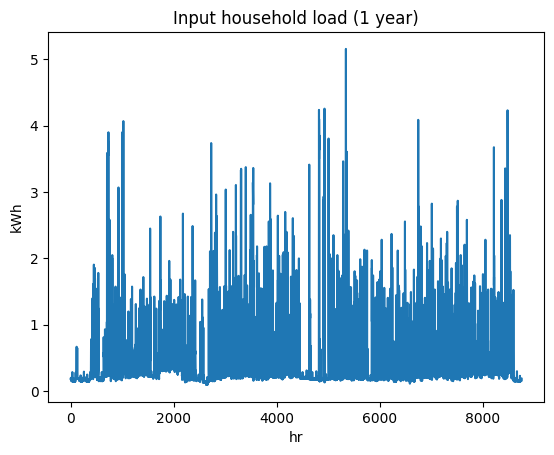

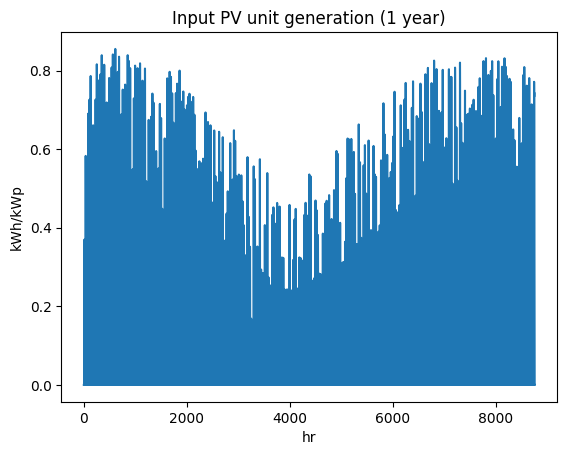

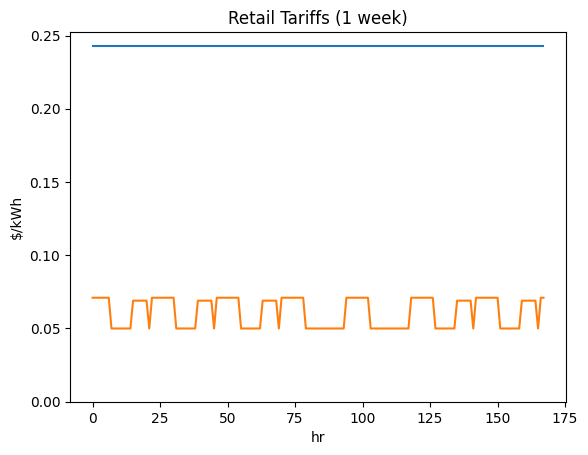

---- Optimising with PV: 1 - 20 kWp, Batt: 0 kWh. Determining PV capacity and dispatch.


************************************ Modell: PV > 1 kWp & BATT > 1 kWh ************************************
{'financial_horizon': 10, 'discount_rate': np.float64(0.06), 'grid_feedin_max': np.float64(5.0), 'pv_eol_capacity': np.float64(0.8), 'pv_eol_years': np.float64(25.0), 'pv_init_soh': np.float64(1.0), 'bess_e2p_ratio': np.float64(2.4), 'bess_roundtrip_eff': np.float64(0.88), 'bess_eol_years': np.float64(10.0), 'bess_eol_capacity': np.float64(0.7), 'bess_eol_cycles': np.float64(10000.0), 'bess_init_soh': np.float64(1.0), 'bess_eff_charge': np.float64(0.938083151964686), 'bess_eff_discharge': np.float64(0.938083151964686), 'scenario_name': 'Scenario_D_+5', 'scenario_set': 'SurfCoast', 'scenario_subset': 'JJP_open', 'year_start': 2022, 'datetime_name': 'DateTime1', 'meter_name': 'pc3039_nmi6812121937', 'solar_name': 'MELB', 'tariff_name_import_wkday': '3_Im_wkday', 'tariff_name_export_wkday': '3_

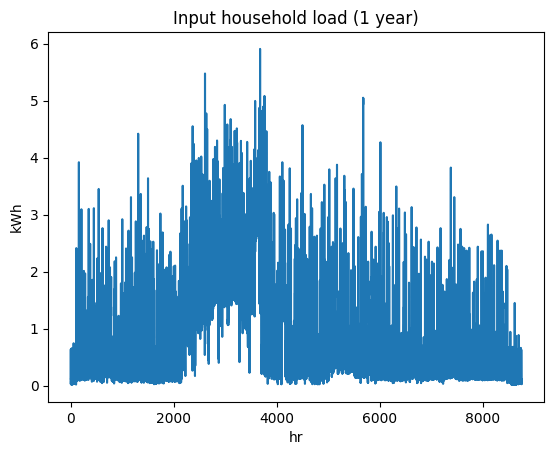

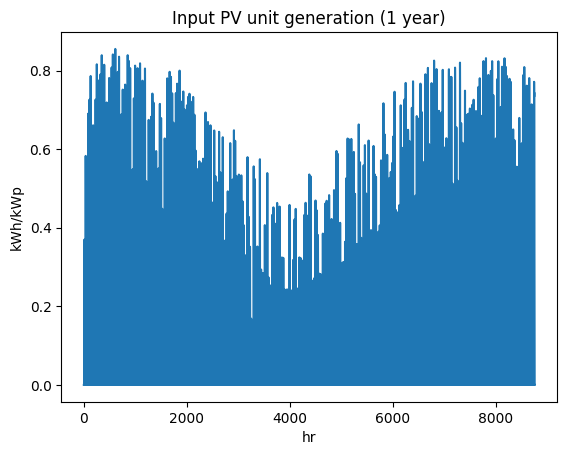

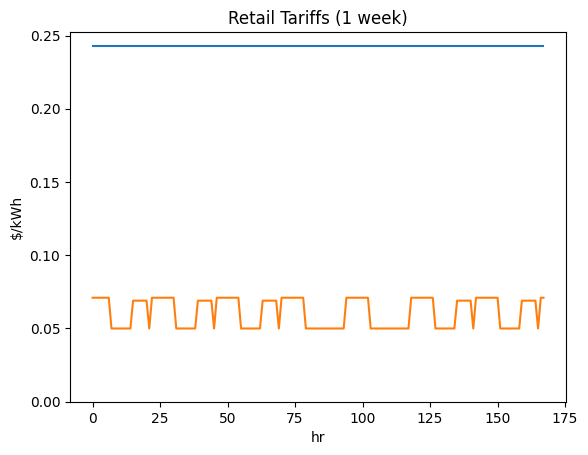

---- Optimising with PV: 1 - 20 kWp, Batt: 0 kWh. Determining PV capacity and dispatch.


************************************ Modell: PV > 1 kWp & BATT > 1 kWh ************************************
{'financial_horizon': 10, 'discount_rate': np.float64(0.06), 'grid_feedin_max': np.float64(5.0), 'pv_eol_capacity': np.float64(0.8), 'pv_eol_years': np.float64(25.0), 'pv_init_soh': np.float64(1.0), 'bess_e2p_ratio': np.float64(2.4), 'bess_roundtrip_eff': np.float64(0.88), 'bess_eol_years': np.float64(10.0), 'bess_eol_capacity': np.float64(0.7), 'bess_eol_cycles': np.float64(10000.0), 'bess_init_soh': np.float64(1.0), 'bess_eff_charge': np.float64(0.938083151964686), 'bess_eff_discharge': np.float64(0.938083151964686), 'scenario_name': 'Scenario_D_+5', 'scenario_set': 'SurfCoast', 'scenario_subset': 'JJP_open', 'year_start': 2022, 'datetime_name': 'DateTime1', 'meter_name': 'pc3040_nmi2806429704', 'solar_name': 'MELB', 'tariff_name_import_wkday': '3_Im_wkday', 'tariff_name_export_wkday': '3_

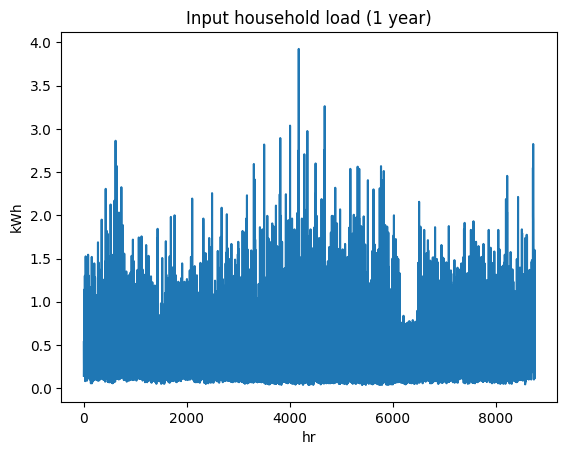

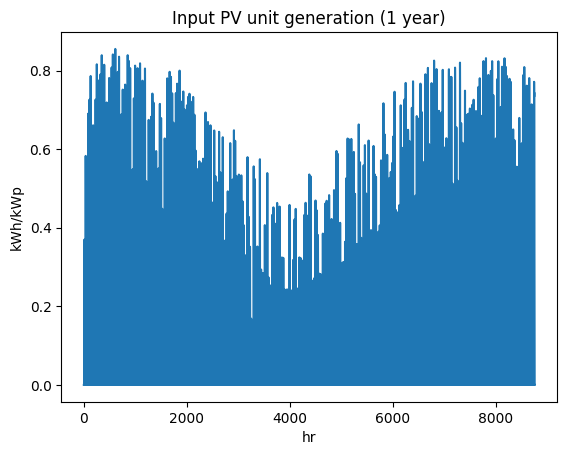

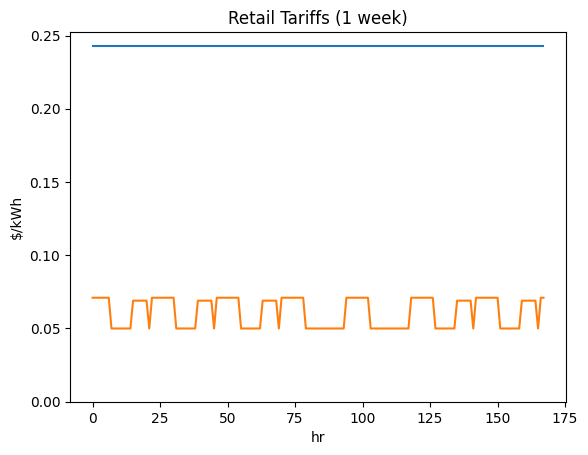

---- Optimising with PV: 1 - 20 kWp, Batt: 0 kWh. Determining PV capacity and dispatch.


************************************ Modell: PV > 1 kWp & BATT > 1 kWh ************************************
{'financial_horizon': 10, 'discount_rate': np.float64(0.06), 'grid_feedin_max': np.float64(5.0), 'pv_eol_capacity': np.float64(0.8), 'pv_eol_years': np.float64(25.0), 'pv_init_soh': np.float64(1.0), 'bess_e2p_ratio': np.float64(2.4), 'bess_roundtrip_eff': np.float64(0.88), 'bess_eol_years': np.float64(10.0), 'bess_eol_capacity': np.float64(0.7), 'bess_eol_cycles': np.float64(10000.0), 'bess_init_soh': np.float64(1.0), 'bess_eff_charge': np.float64(0.938083151964686), 'bess_eff_discharge': np.float64(0.938083151964686), 'scenario_name': 'Scenario_D_+5', 'scenario_set': 'SurfCoast', 'scenario_subset': 'JJP_open', 'year_start': 2022, 'datetime_name': 'DateTime1', 'meter_name': 'pc3040_nmi8317204855', 'solar_name': 'MELB', 'tariff_name_import_wkday': '3_Im_wkday', 'tariff_name_export_wkday': '3_

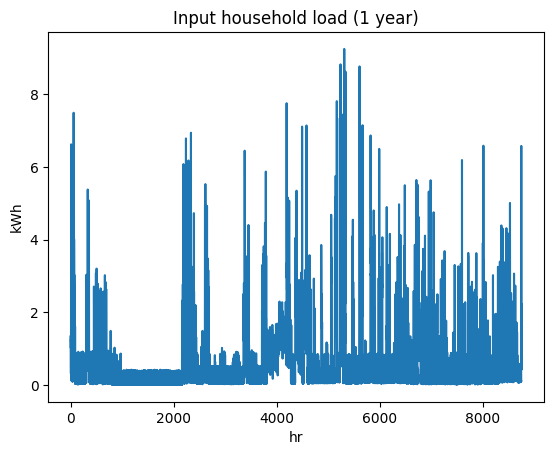

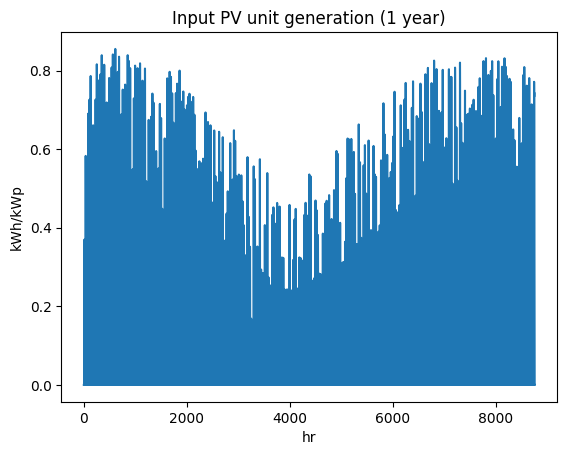

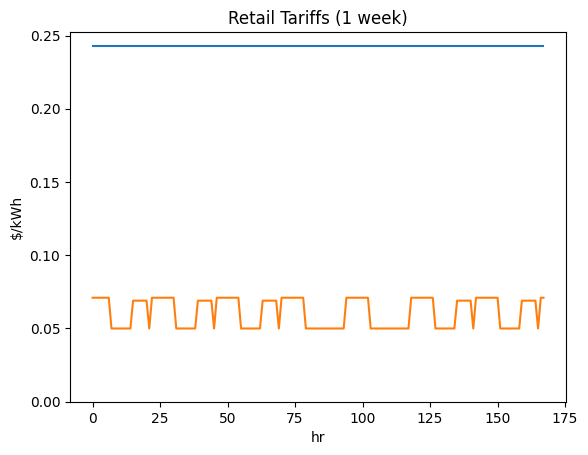

---- Optimising with PV: 1 - 20 kWp, Batt: 0 kWh. Determining PV capacity and dispatch.


************************************ Modell: PV > 1 kWp & BATT > 1 kWh ************************************
{'financial_horizon': 10, 'discount_rate': np.float64(0.06), 'grid_feedin_max': np.float64(5.0), 'pv_eol_capacity': np.float64(0.8), 'pv_eol_years': np.float64(25.0), 'pv_init_soh': np.float64(1.0), 'bess_e2p_ratio': np.float64(2.4), 'bess_roundtrip_eff': np.float64(0.88), 'bess_eol_years': np.float64(10.0), 'bess_eol_capacity': np.float64(0.7), 'bess_eol_cycles': np.float64(10000.0), 'bess_init_soh': np.float64(1.0), 'bess_eff_charge': np.float64(0.938083151964686), 'bess_eff_discharge': np.float64(0.938083151964686), 'scenario_name': 'Scenario_D_+5', 'scenario_set': 'SurfCoast', 'scenario_subset': 'JJP_open', 'year_start': 2022, 'datetime_name': 'DateTime1', 'meter_name': 'pc3040_nmi1692896564', 'solar_name': 'MELB', 'tariff_name_import_wkday': '3_Im_wkday', 'tariff_name_export_wkday': '3_

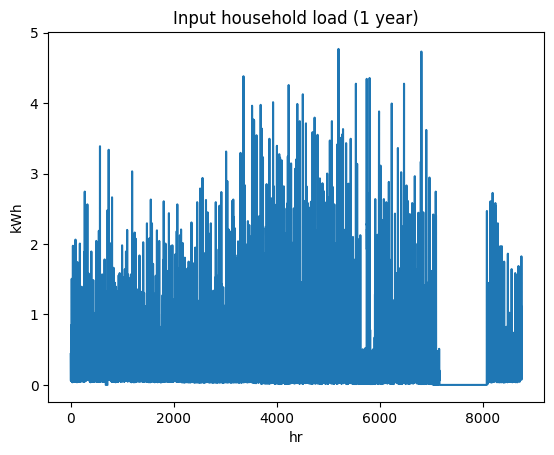

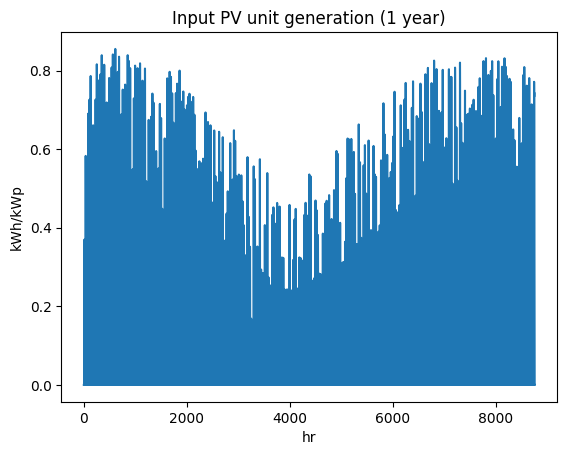

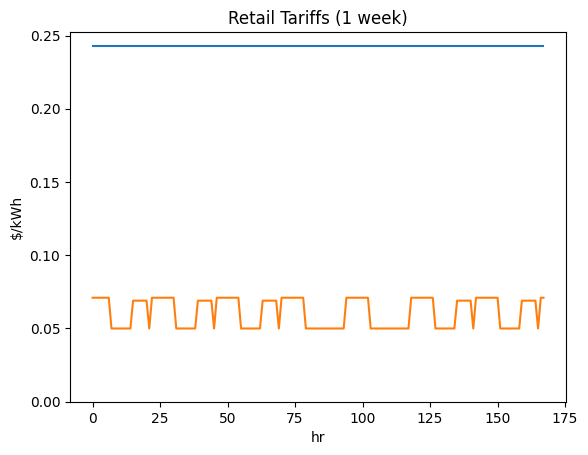

---- Optimising with PV: 1 - 20 kWp, Batt: 0 kWh. Determining PV capacity and dispatch.


************************************ Modell: PV > 1 kWp & BATT > 1 kWh ************************************
{'financial_horizon': 10, 'discount_rate': np.float64(0.06), 'grid_feedin_max': np.float64(5.0), 'pv_eol_capacity': np.float64(0.8), 'pv_eol_years': np.float64(25.0), 'pv_init_soh': np.float64(1.0), 'bess_e2p_ratio': np.float64(2.4), 'bess_roundtrip_eff': np.float64(0.88), 'bess_eol_years': np.float64(10.0), 'bess_eol_capacity': np.float64(0.7), 'bess_eol_cycles': np.float64(10000.0), 'bess_init_soh': np.float64(1.0), 'bess_eff_charge': np.float64(0.938083151964686), 'bess_eff_discharge': np.float64(0.938083151964686), 'scenario_name': 'Scenario_D_+5', 'scenario_set': 'SurfCoast', 'scenario_subset': 'JJP_open', 'year_start': 2022, 'datetime_name': 'DateTime1', 'meter_name': 'pc3040_nmi7844218972', 'solar_name': 'MELB', 'tariff_name_import_wkday': '3_Im_wkday', 'tariff_name_export_wkday': '3_

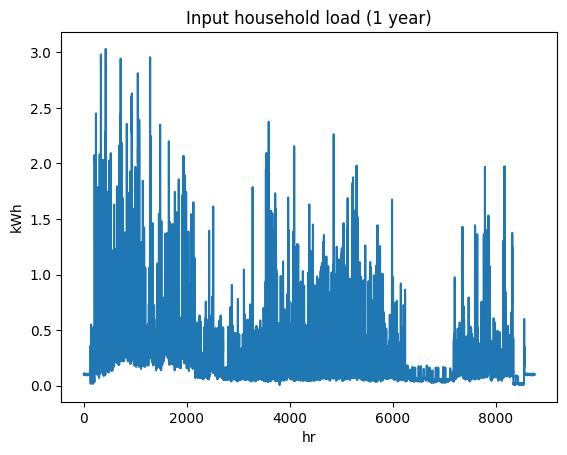

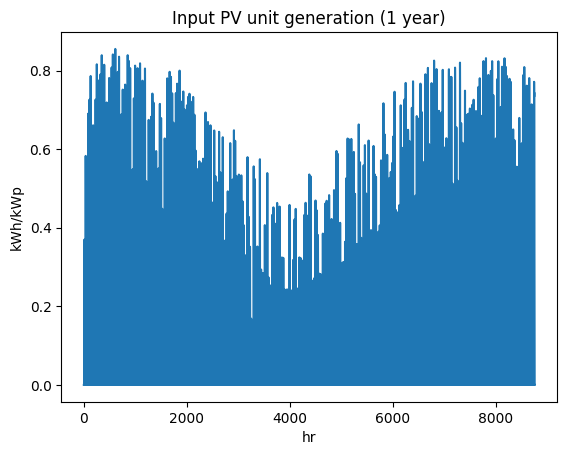

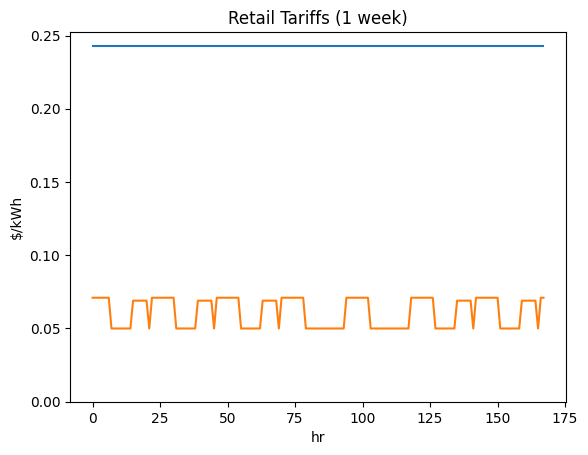

---- Optimising with PV: 1 - 20 kWp, Batt: 0 kWh. Determining PV capacity and dispatch.


************************************ Modell: PV > 1 kWp & BATT > 1 kWh ************************************
{'financial_horizon': 10, 'discount_rate': np.float64(0.06), 'grid_feedin_max': np.float64(5.0), 'pv_eol_capacity': np.float64(0.8), 'pv_eol_years': np.float64(25.0), 'pv_init_soh': np.float64(1.0), 'bess_e2p_ratio': np.float64(2.4), 'bess_roundtrip_eff': np.float64(0.88), 'bess_eol_years': np.float64(10.0), 'bess_eol_capacity': np.float64(0.7), 'bess_eol_cycles': np.float64(10000.0), 'bess_init_soh': np.float64(1.0), 'bess_eff_charge': np.float64(0.938083151964686), 'bess_eff_discharge': np.float64(0.938083151964686), 'scenario_name': 'Scenario_D_+5', 'scenario_set': 'SurfCoast', 'scenario_subset': 'JJP_open', 'year_start': 2022, 'datetime_name': 'DateTime1', 'meter_name': 'pc3058_nmi5252664265', 'solar_name': 'MELB', 'tariff_name_import_wkday': '3_Im_wkday', 'tariff_name_export_wkday': '3_

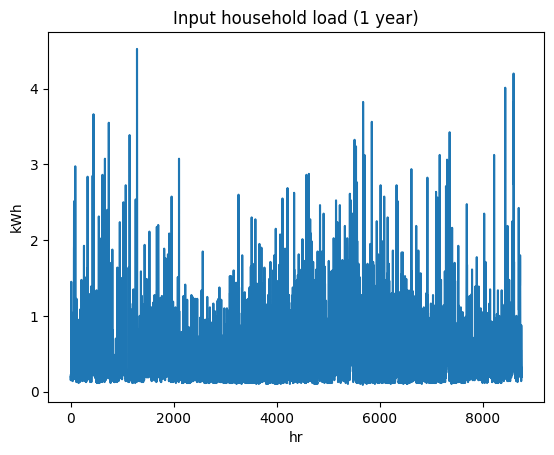

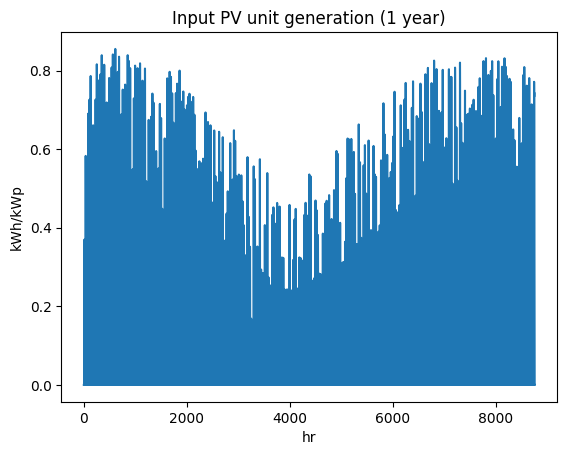

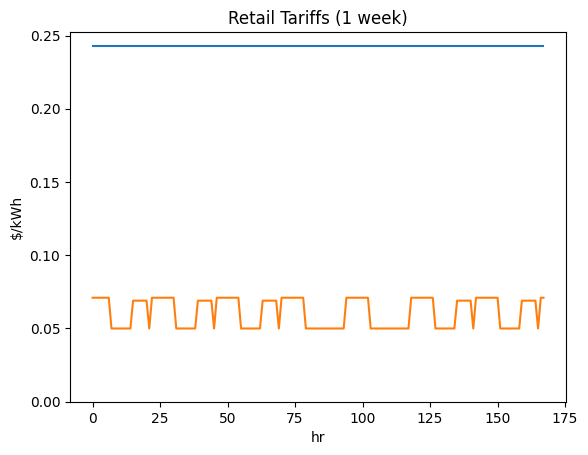

---- Optimising with PV: 1 - 20 kWp, Batt: 0 kWh. Determining PV capacity and dispatch.


************************************ Modell: PV > 1 kWp & BATT > 1 kWh ************************************
{'financial_horizon': 10, 'discount_rate': np.float64(0.06), 'grid_feedin_max': np.float64(5.0), 'pv_eol_capacity': np.float64(0.8), 'pv_eol_years': np.float64(25.0), 'pv_init_soh': np.float64(1.0), 'bess_e2p_ratio': np.float64(2.4), 'bess_roundtrip_eff': np.float64(0.88), 'bess_eol_years': np.float64(10.0), 'bess_eol_capacity': np.float64(0.7), 'bess_eol_cycles': np.float64(10000.0), 'bess_init_soh': np.float64(1.0), 'bess_eff_charge': np.float64(0.938083151964686), 'bess_eff_discharge': np.float64(0.938083151964686), 'scenario_name': 'Scenario_D_+5', 'scenario_set': 'SurfCoast', 'scenario_subset': 'JJP_open', 'year_start': 2022, 'datetime_name': 'DateTime1', 'meter_name': 'pc3058_nmi4593234057', 'solar_name': 'MELB', 'tariff_name_import_wkday': '3_Im_wkday', 'tariff_name_export_wkday': '3_

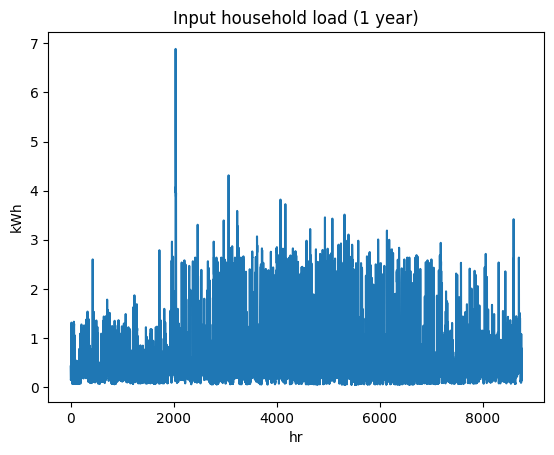

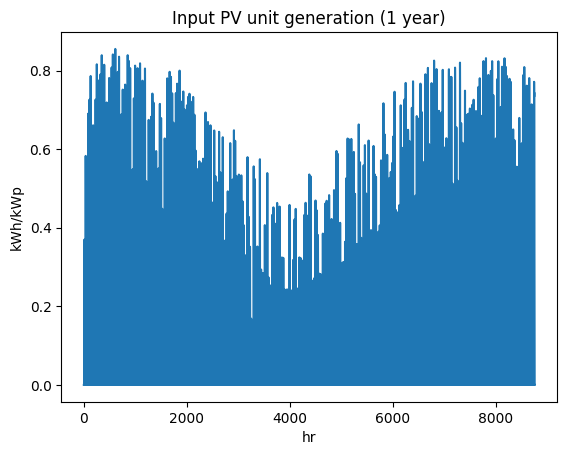

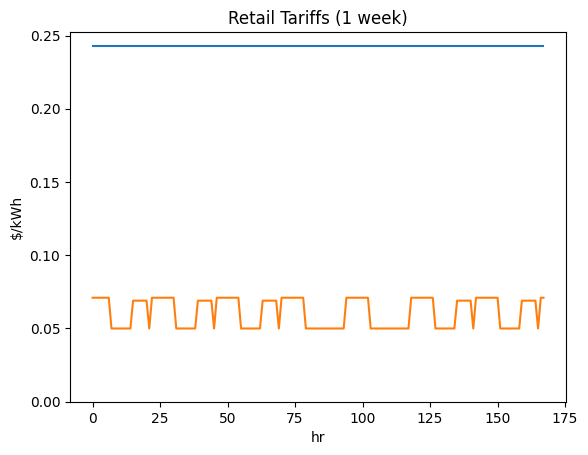

---- Optimising with PV: 1 - 20 kWp, Batt: 0 kWh. Determining PV capacity and dispatch.


************************************ Modell: PV > 1 kWp & BATT > 1 kWh ************************************
{'financial_horizon': 10, 'discount_rate': np.float64(0.06), 'grid_feedin_max': np.float64(5.0), 'pv_eol_capacity': np.float64(0.8), 'pv_eol_years': np.float64(25.0), 'pv_init_soh': np.float64(1.0), 'bess_e2p_ratio': np.float64(2.4), 'bess_roundtrip_eff': np.float64(0.88), 'bess_eol_years': np.float64(10.0), 'bess_eol_capacity': np.float64(0.7), 'bess_eol_cycles': np.float64(10000.0), 'bess_init_soh': np.float64(1.0), 'bess_eff_charge': np.float64(0.938083151964686), 'bess_eff_discharge': np.float64(0.938083151964686), 'scenario_name': 'Scenario_D_+5', 'scenario_set': 'SurfCoast', 'scenario_subset': 'JJP_open', 'year_start': 2022, 'datetime_name': 'DateTime1', 'meter_name': 'pc3058_nmi6410324536', 'solar_name': 'MELB', 'tariff_name_import_wkday': '3_Im_wkday', 'tariff_name_export_wkday': '3_

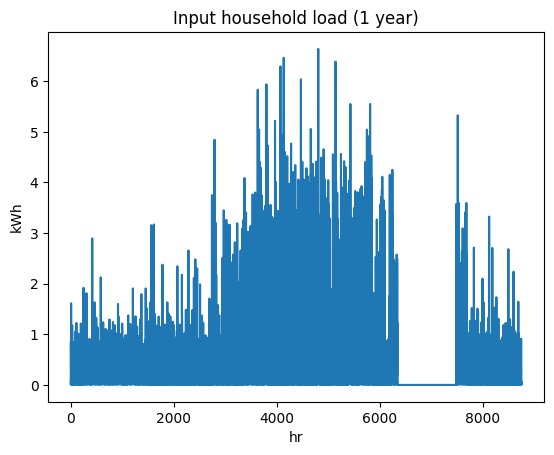

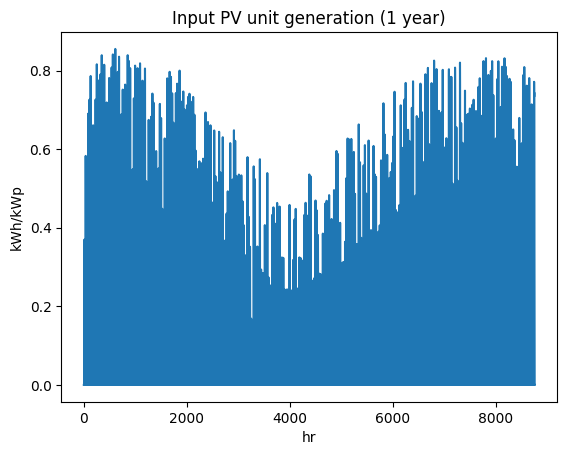

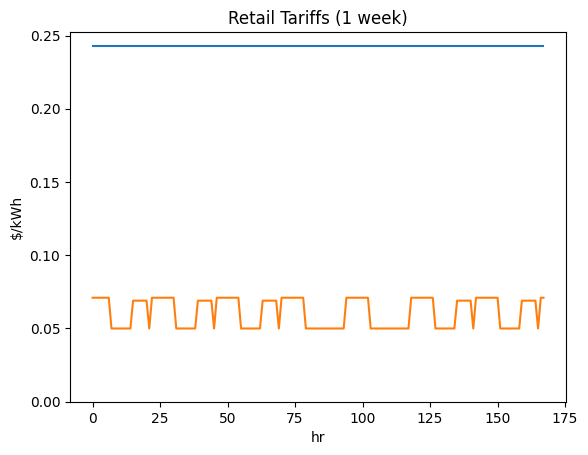

---- Optimising with PV: 1 - 20 kWp, Batt: 0 kWh. Determining PV capacity and dispatch.


************************************ Modell: PV > 1 kWp & BATT > 1 kWh ************************************
{'financial_horizon': 10, 'discount_rate': np.float64(0.06), 'grid_feedin_max': np.float64(5.0), 'pv_eol_capacity': np.float64(0.8), 'pv_eol_years': np.float64(25.0), 'pv_init_soh': np.float64(1.0), 'bess_e2p_ratio': np.float64(2.4), 'bess_roundtrip_eff': np.float64(0.88), 'bess_eol_years': np.float64(10.0), 'bess_eol_capacity': np.float64(0.7), 'bess_eol_cycles': np.float64(10000.0), 'bess_init_soh': np.float64(1.0), 'bess_eff_charge': np.float64(0.938083151964686), 'bess_eff_discharge': np.float64(0.938083151964686), 'scenario_name': 'Scenario_D_+5', 'scenario_set': 'SurfCoast', 'scenario_subset': 'JJP_open', 'year_start': 2022, 'datetime_name': 'DateTime1', 'meter_name': 'pc3058_nmi5916102495', 'solar_name': 'MELB', 'tariff_name_import_wkday': '3_Im_wkday', 'tariff_name_export_wkday': '3_

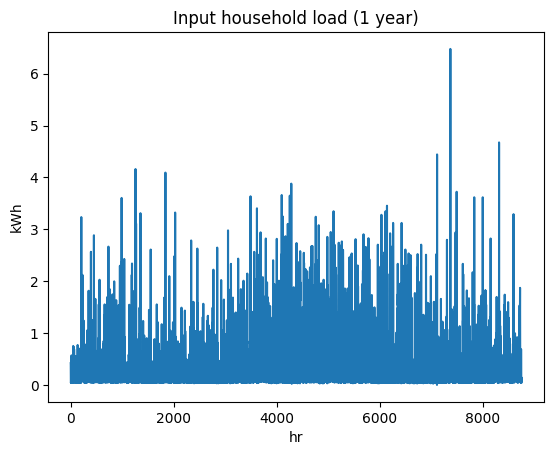

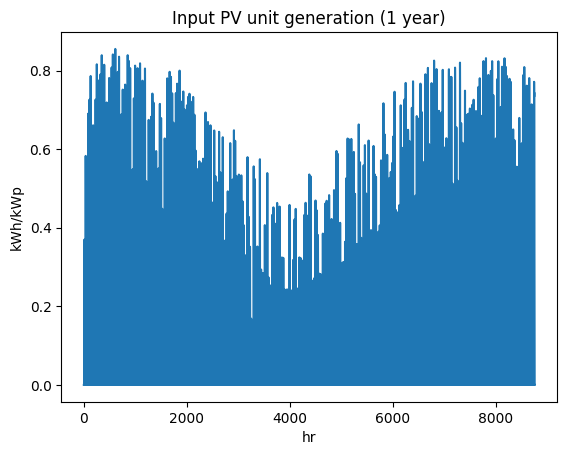

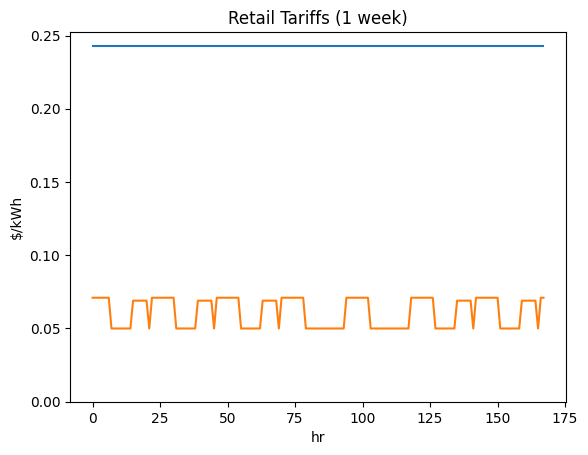

---- Optimising with PV: 1 - 20 kWp, Batt: 0 kWh. Determining PV capacity and dispatch.


************************************ Modell: PV > 1 kWp & BATT > 1 kWh ************************************
{'financial_horizon': 10, 'discount_rate': np.float64(0.06), 'grid_feedin_max': np.float64(5.0), 'pv_eol_capacity': np.float64(0.8), 'pv_eol_years': np.float64(25.0), 'pv_init_soh': np.float64(1.0), 'bess_e2p_ratio': np.float64(2.4), 'bess_roundtrip_eff': np.float64(0.88), 'bess_eol_years': np.float64(10.0), 'bess_eol_capacity': np.float64(0.7), 'bess_eol_cycles': np.float64(10000.0), 'bess_init_soh': np.float64(1.0), 'bess_eff_charge': np.float64(0.938083151964686), 'bess_eff_discharge': np.float64(0.938083151964686), 'scenario_name': 'Scenario_D_+5', 'scenario_set': 'SurfCoast', 'scenario_subset': 'JJP_open', 'year_start': 2022, 'datetime_name': 'DateTime1', 'meter_name': 'pc3040_nmi8689161689', 'solar_name': 'MELB', 'tariff_name_import_wkday': '3_Im_wkday', 'tariff_name_export_wkday': '3_

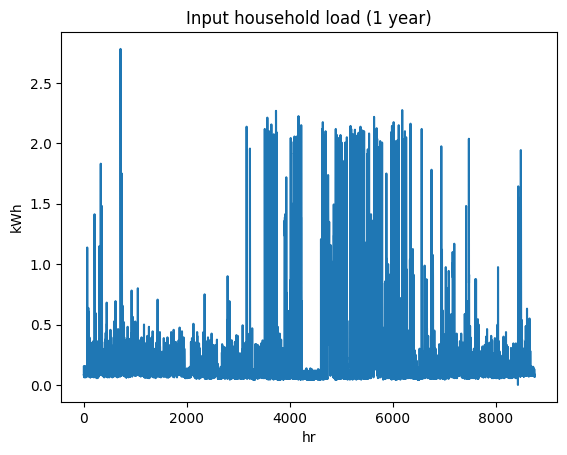

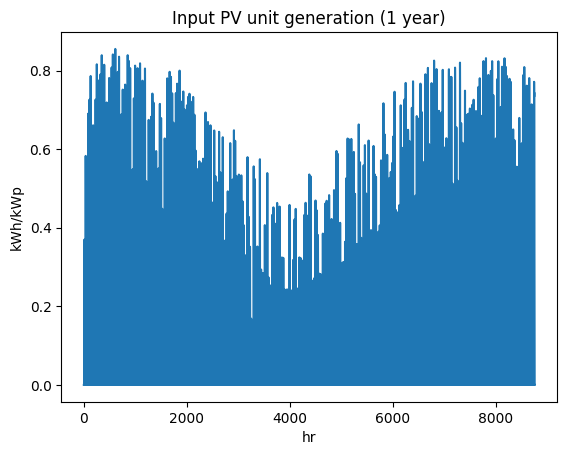

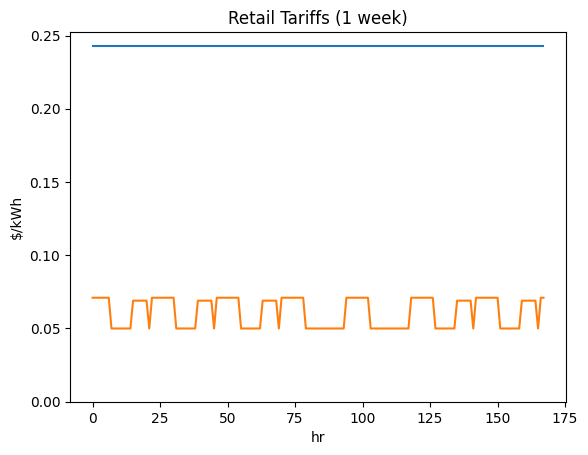

---- Optimising with PV: 1 - 20 kWp, Batt: 0 kWh. Determining PV capacity and dispatch.


************************************ Modell: PV > 1 kWp & BATT > 1 kWh ************************************
{'financial_horizon': 10, 'discount_rate': np.float64(0.06), 'grid_feedin_max': np.float64(5.0), 'pv_eol_capacity': np.float64(0.8), 'pv_eol_years': np.float64(25.0), 'pv_init_soh': np.float64(1.0), 'bess_e2p_ratio': np.float64(2.4), 'bess_roundtrip_eff': np.float64(0.88), 'bess_eol_years': np.float64(10.0), 'bess_eol_capacity': np.float64(0.7), 'bess_eol_cycles': np.float64(10000.0), 'bess_init_soh': np.float64(1.0), 'bess_eff_charge': np.float64(0.938083151964686), 'bess_eff_discharge': np.float64(0.938083151964686), 'scenario_name': 'Scenario_D_+5', 'scenario_set': 'SurfCoast', 'scenario_subset': 'JJP_open', 'year_start': 2022, 'datetime_name': 'DateTime1', 'meter_name': 'pc3072_nmi2738734763', 'solar_name': 'MELB', 'tariff_name_import_wkday': '3_Im_wkday', 'tariff_name_export_wkday': '3_

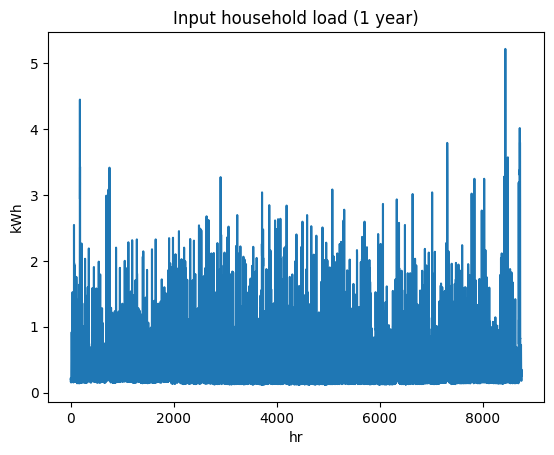

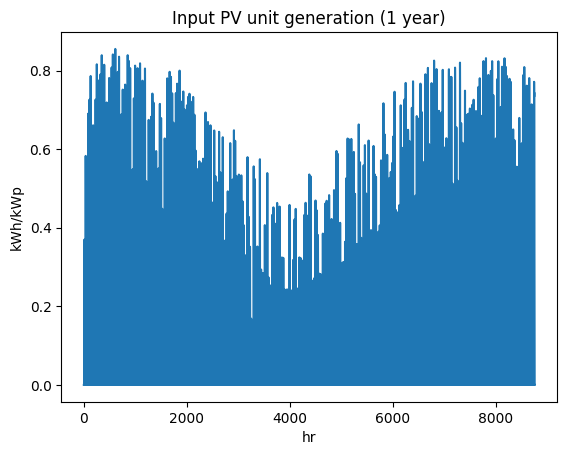

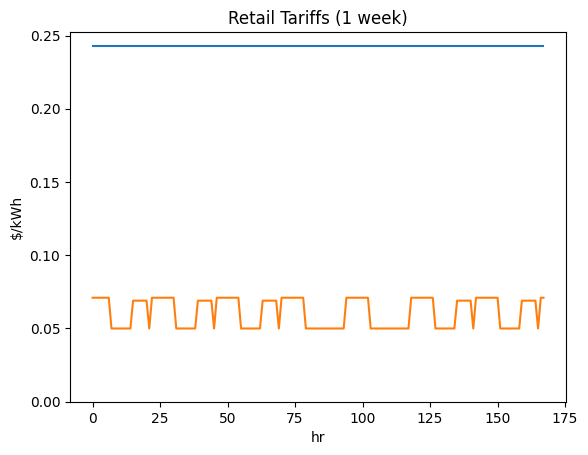

---- Optimising with PV: 1 - 20 kWp, Batt: 0 kWh. Determining PV capacity and dispatch.


************************************ Modell: PV > 1 kWp & BATT > 1 kWh ************************************
{'financial_horizon': 10, 'discount_rate': np.float64(0.06), 'grid_feedin_max': np.float64(5.0), 'pv_eol_capacity': np.float64(0.8), 'pv_eol_years': np.float64(25.0), 'pv_init_soh': np.float64(1.0), 'bess_e2p_ratio': np.float64(2.4), 'bess_roundtrip_eff': np.float64(0.88), 'bess_eol_years': np.float64(10.0), 'bess_eol_capacity': np.float64(0.7), 'bess_eol_cycles': np.float64(10000.0), 'bess_init_soh': np.float64(1.0), 'bess_eff_charge': np.float64(0.938083151964686), 'bess_eff_discharge': np.float64(0.938083151964686), 'scenario_name': 'Scenario_D_+5', 'scenario_set': 'SurfCoast', 'scenario_subset': 'JJP_open', 'year_start': 2022, 'datetime_name': 'DateTime1', 'meter_name': 'pc3039_nmi7202173337', 'solar_name': 'MELB', 'tariff_name_import_wkday': '3_Im_wkday', 'tariff_name_export_wkday': '3_

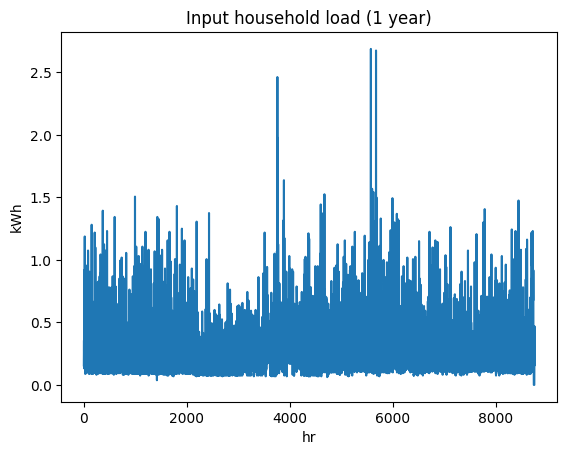

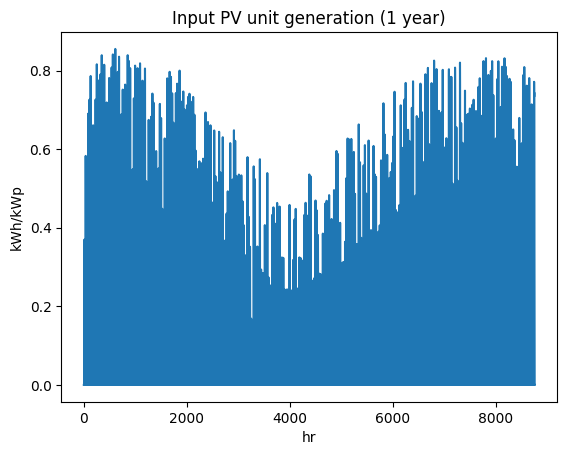

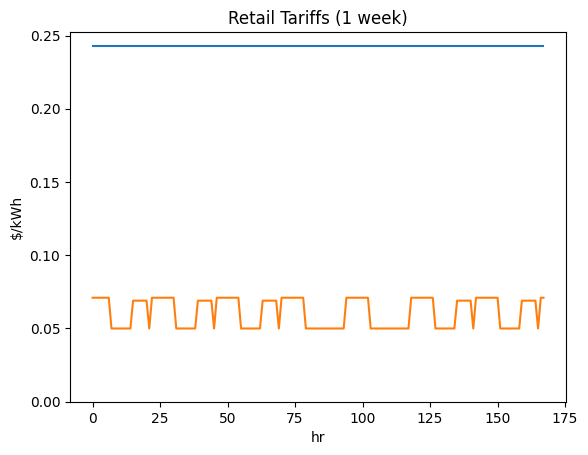

---- Optimising with PV: 1 - 20 kWp, Batt: 0 kWh. Determining PV capacity and dispatch.


************************************ Modell: PV > 1 kWp & BATT > 1 kWh ************************************
{'financial_horizon': 10, 'discount_rate': np.float64(0.06), 'grid_feedin_max': np.float64(5.0), 'pv_eol_capacity': np.float64(0.8), 'pv_eol_years': np.float64(25.0), 'pv_init_soh': np.float64(1.0), 'bess_e2p_ratio': np.float64(2.4), 'bess_roundtrip_eff': np.float64(0.88), 'bess_eol_years': np.float64(10.0), 'bess_eol_capacity': np.float64(0.7), 'bess_eol_cycles': np.float64(10000.0), 'bess_init_soh': np.float64(1.0), 'bess_eff_charge': np.float64(0.938083151964686), 'bess_eff_discharge': np.float64(0.938083151964686), 'scenario_name': 'Scenario_D_+5', 'scenario_set': 'SurfCoast', 'scenario_subset': 'JJP_open', 'year_start': 2022, 'datetime_name': 'DateTime1', 'meter_name': 'pc3033_nmi7684364770', 'solar_name': 'MELB', 'tariff_name_import_wkday': '3_Im_wkday', 'tariff_name_export_wkday': '3_

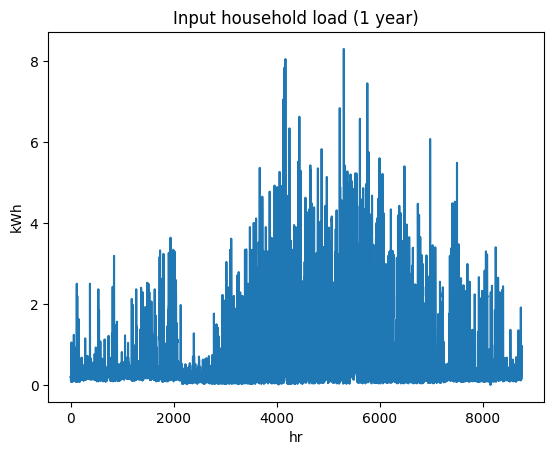

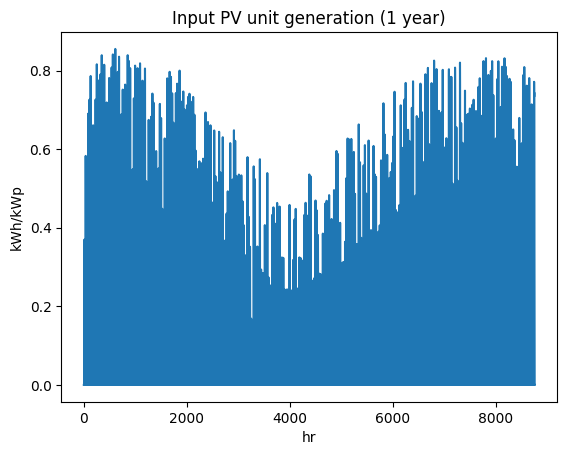

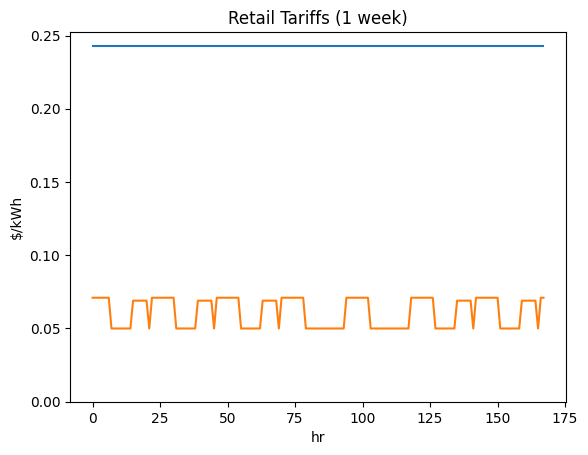

---- Optimising with PV: 1 - 20 kWp, Batt: 0 kWh. Determining PV capacity and dispatch.


************************************ Modell: PV > 1 kWp & BATT > 1 kWh ************************************
{'financial_horizon': 10, 'discount_rate': np.float64(0.06), 'grid_feedin_max': np.float64(5.0), 'pv_eol_capacity': np.float64(0.8), 'pv_eol_years': np.float64(25.0), 'pv_init_soh': np.float64(1.0), 'bess_e2p_ratio': np.float64(2.4), 'bess_roundtrip_eff': np.float64(0.88), 'bess_eol_years': np.float64(10.0), 'bess_eol_capacity': np.float64(0.7), 'bess_eol_cycles': np.float64(10000.0), 'bess_init_soh': np.float64(1.0), 'bess_eff_charge': np.float64(0.938083151964686), 'bess_eff_discharge': np.float64(0.938083151964686), 'scenario_name': 'Scenario_D_+5', 'scenario_set': 'SurfCoast', 'scenario_subset': 'JJP_open', 'year_start': 2022, 'datetime_name': 'DateTime1', 'meter_name': 'pc3011_nmi7190799907', 'solar_name': 'MELB', 'tariff_name_import_wkday': '3_Im_wkday', 'tariff_name_export_wkday': '3_

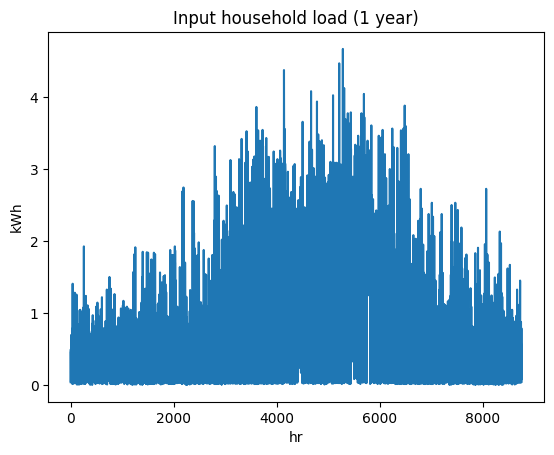

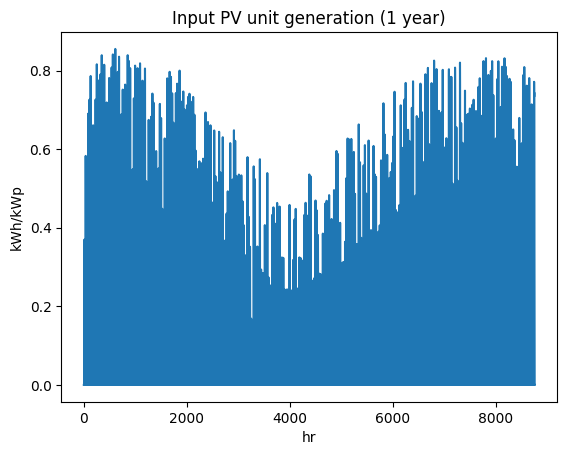

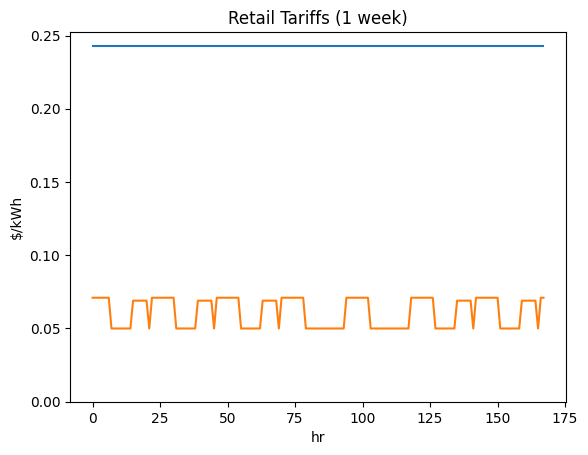

---- Optimising with PV: 1 - 20 kWp, Batt: 0 kWh. Determining PV capacity and dispatch.


************************************ Modell: PV > 1 kWp & BATT > 1 kWh ************************************
{'financial_horizon': 10, 'discount_rate': np.float64(0.06), 'grid_feedin_max': np.float64(5.0), 'pv_eol_capacity': np.float64(0.8), 'pv_eol_years': np.float64(25.0), 'pv_init_soh': np.float64(1.0), 'bess_e2p_ratio': np.float64(2.4), 'bess_roundtrip_eff': np.float64(0.88), 'bess_eol_years': np.float64(10.0), 'bess_eol_capacity': np.float64(0.7), 'bess_eol_cycles': np.float64(10000.0), 'bess_init_soh': np.float64(1.0), 'bess_eff_charge': np.float64(0.938083151964686), 'bess_eff_discharge': np.float64(0.938083151964686), 'scenario_name': 'Scenario_D_+5', 'scenario_set': 'SurfCoast', 'scenario_subset': 'JJP_open', 'year_start': 2022, 'datetime_name': 'DateTime1', 'meter_name': 'pc3040_nmi5849147870', 'solar_name': 'MELB', 'tariff_name_import_wkday': '3_Im_wkday', 'tariff_name_export_wkday': '3_

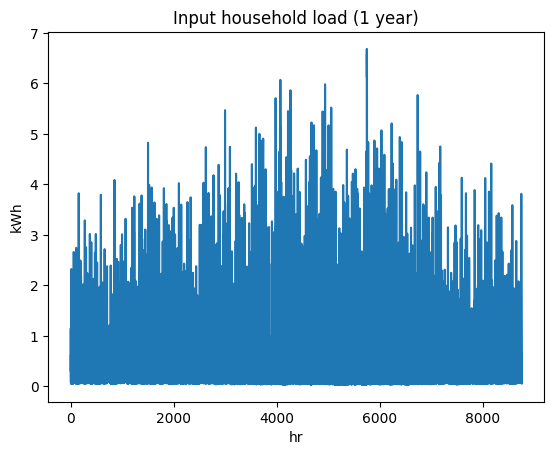

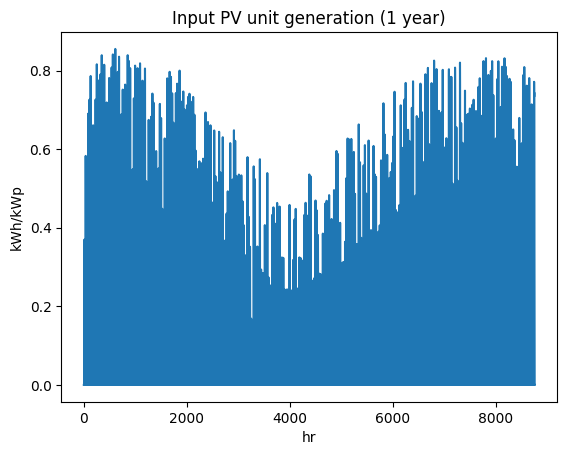

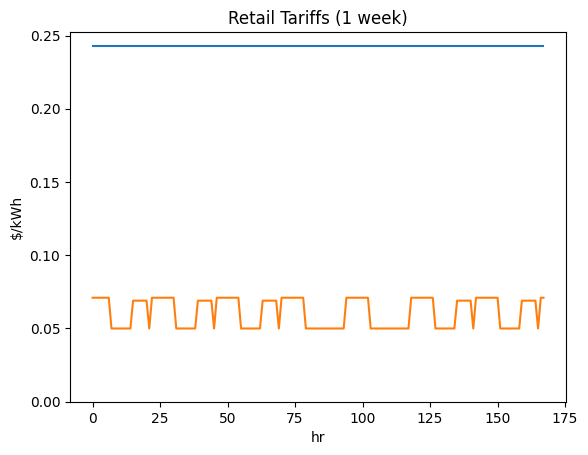

---- Optimising with PV: 1 - 20 kWp, Batt: 0 kWh. Determining PV capacity and dispatch.


************************************ Modell: PV > 1 kWp & BATT > 1 kWh ************************************
{'financial_horizon': 10, 'discount_rate': np.float64(0.06), 'grid_feedin_max': np.float64(5.0), 'pv_eol_capacity': np.float64(0.8), 'pv_eol_years': np.float64(25.0), 'pv_init_soh': np.float64(1.0), 'bess_e2p_ratio': np.float64(2.4), 'bess_roundtrip_eff': np.float64(0.88), 'bess_eol_years': np.float64(10.0), 'bess_eol_capacity': np.float64(0.7), 'bess_eol_cycles': np.float64(10000.0), 'bess_init_soh': np.float64(1.0), 'bess_eff_charge': np.float64(0.938083151964686), 'bess_eff_discharge': np.float64(0.938083151964686), 'scenario_name': 'Scenario_D_+5', 'scenario_set': 'SurfCoast', 'scenario_subset': 'JJP_open', 'year_start': 2022, 'datetime_name': 'DateTime1', 'meter_name': 'pc3033_nmi9605860899', 'solar_name': 'MELB', 'tariff_name_import_wkday': '3_Im_wkday', 'tariff_name_export_wkday': '3_

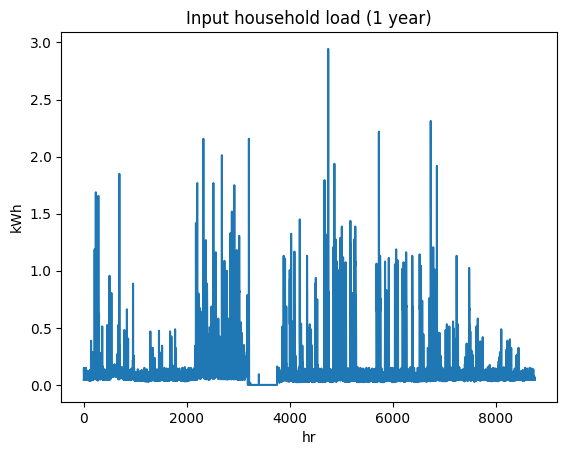

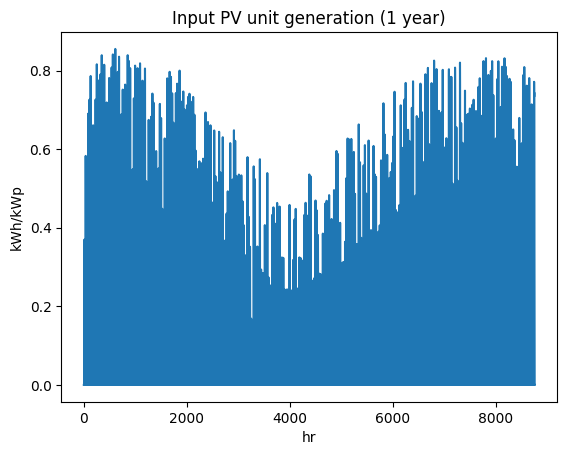

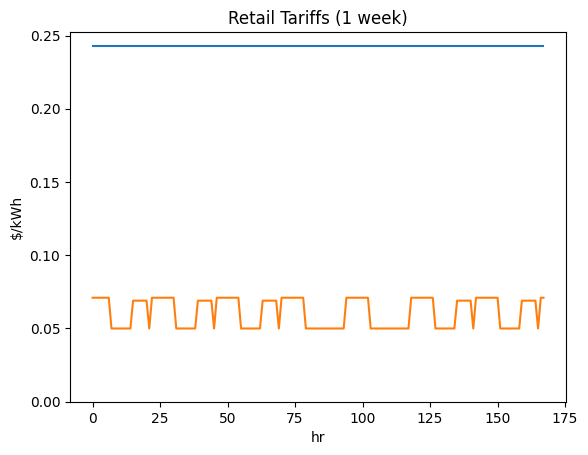

---- Optimising with PV: 1 - 20 kWp, Batt: 0 kWh. Determining PV capacity and dispatch.


************************************ Modell: PV > 1 kWp & BATT > 1 kWh ************************************
{'financial_horizon': 10, 'discount_rate': np.float64(0.06), 'grid_feedin_max': np.float64(5.0), 'pv_eol_capacity': np.float64(0.8), 'pv_eol_years': np.float64(25.0), 'pv_init_soh': np.float64(1.0), 'bess_e2p_ratio': np.float64(2.4), 'bess_roundtrip_eff': np.float64(0.88), 'bess_eol_years': np.float64(10.0), 'bess_eol_capacity': np.float64(0.7), 'bess_eol_cycles': np.float64(10000.0), 'bess_init_soh': np.float64(1.0), 'bess_eff_charge': np.float64(0.938083151964686), 'bess_eff_discharge': np.float64(0.938083151964686), 'scenario_name': 'Scenario_D_+5', 'scenario_set': 'SurfCoast', 'scenario_subset': 'JJP_open', 'year_start': 2022, 'datetime_name': 'DateTime1', 'meter_name': 'pc3012_nmi7204919923', 'solar_name': 'MELB', 'tariff_name_import_wkday': '3_Im_wkday', 'tariff_name_export_wkday': '3_

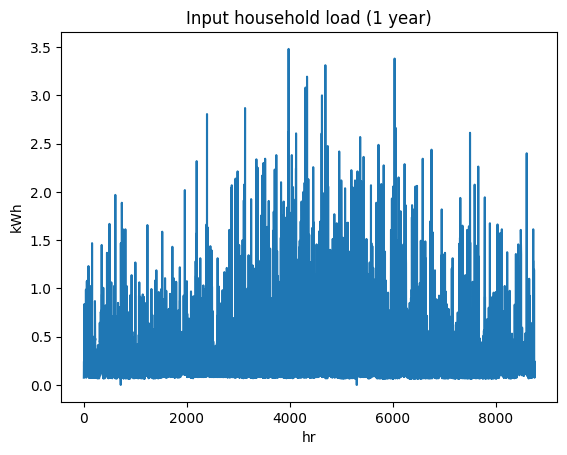

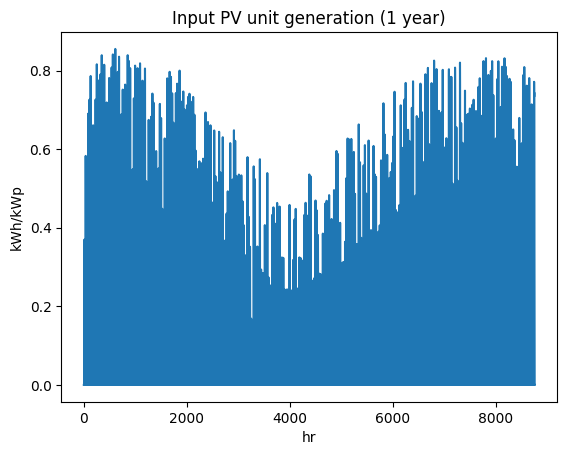

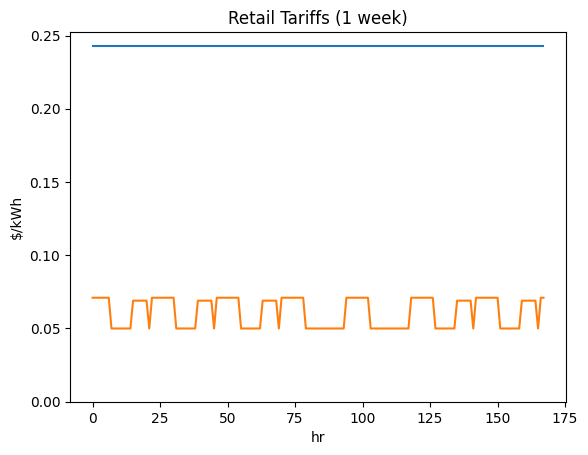

---- Optimising with PV: 1 - 20 kWp, Batt: 0 kWh. Determining PV capacity and dispatch.


************************************ Modell: PV > 1 kWp & BATT > 1 kWh ************************************
{'financial_horizon': 10, 'discount_rate': np.float64(0.06), 'grid_feedin_max': np.float64(5.0), 'pv_eol_capacity': np.float64(0.8), 'pv_eol_years': np.float64(25.0), 'pv_init_soh': np.float64(1.0), 'bess_e2p_ratio': np.float64(2.4), 'bess_roundtrip_eff': np.float64(0.88), 'bess_eol_years': np.float64(10.0), 'bess_eol_capacity': np.float64(0.7), 'bess_eol_cycles': np.float64(10000.0), 'bess_init_soh': np.float64(1.0), 'bess_eff_charge': np.float64(0.938083151964686), 'bess_eff_discharge': np.float64(0.938083151964686), 'scenario_name': 'Scenario_D_+5', 'scenario_set': 'SurfCoast', 'scenario_subset': 'JJP_open', 'year_start': 2022, 'datetime_name': 'DateTime1', 'meter_name': 'pc3012_nmi5324514197', 'solar_name': 'MELB', 'tariff_name_import_wkday': '3_Im_wkday', 'tariff_name_export_wkday': '3_

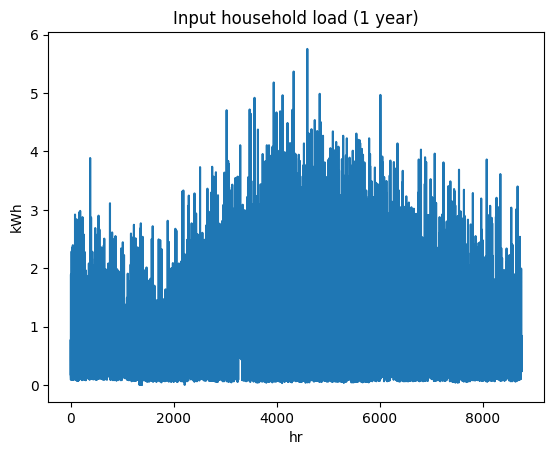

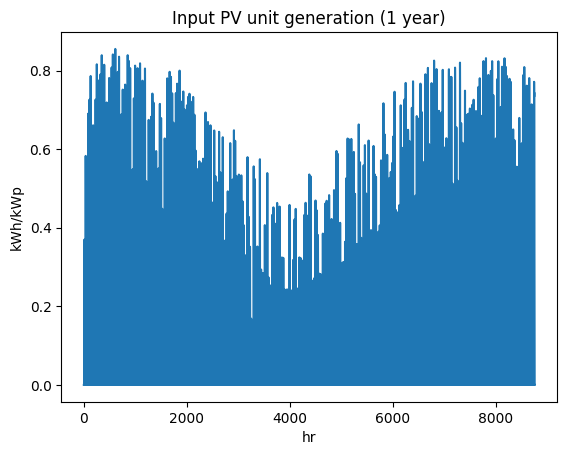

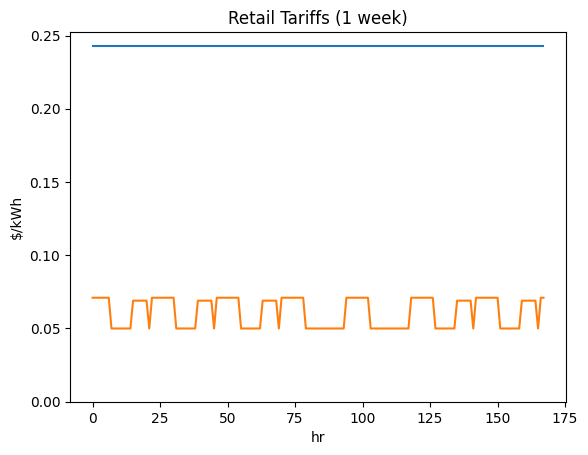

---- Optimising with PV: 1 - 20 kWp, Batt: 0 kWh. Determining PV capacity and dispatch.


************************************ Modell: PV > 1 kWp & BATT > 1 kWh ************************************
{'financial_horizon': 10, 'discount_rate': np.float64(0.06), 'grid_feedin_max': np.float64(5.0), 'pv_eol_capacity': np.float64(0.8), 'pv_eol_years': np.float64(25.0), 'pv_init_soh': np.float64(1.0), 'bess_e2p_ratio': np.float64(2.4), 'bess_roundtrip_eff': np.float64(0.88), 'bess_eol_years': np.float64(10.0), 'bess_eol_capacity': np.float64(0.7), 'bess_eol_cycles': np.float64(10000.0), 'bess_init_soh': np.float64(1.0), 'bess_eff_charge': np.float64(0.938083151964686), 'bess_eff_discharge': np.float64(0.938083151964686), 'scenario_name': 'Scenario_D_+5', 'scenario_set': 'SurfCoast', 'scenario_subset': 'JJP_open', 'year_start': 2022, 'datetime_name': 'DateTime1', 'meter_name': 'pc3072_nmi6909910282', 'solar_name': 'MELB', 'tariff_name_import_wkday': '3_Im_wkday', 'tariff_name_export_wkday': '3_

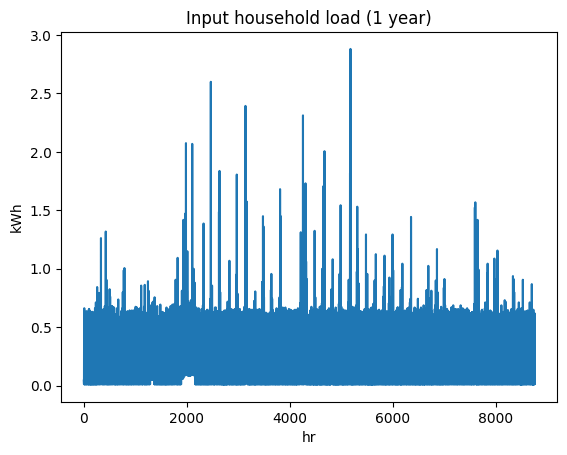

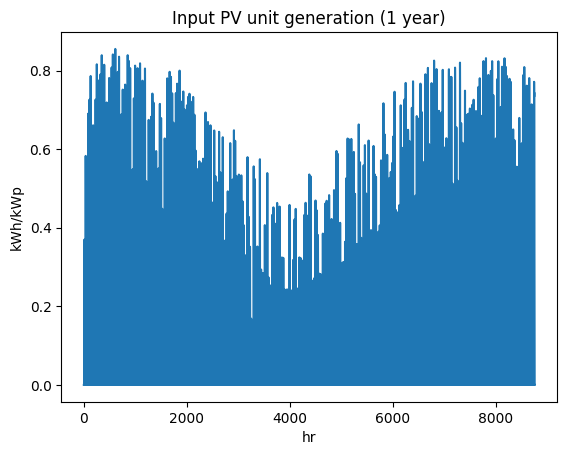

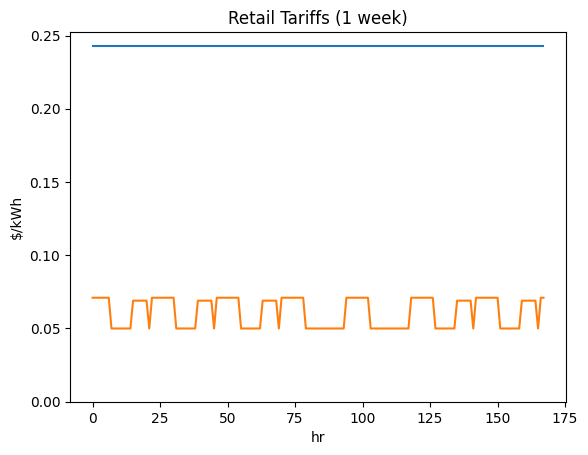

---- Optimising with PV: 1 - 20 kWp, Batt: 0 kWh. Determining PV capacity and dispatch.


************************************ Modell: PV > 1 kWp & BATT > 1 kWh ************************************
{'financial_horizon': 10, 'discount_rate': np.float64(0.06), 'grid_feedin_max': np.float64(5.0), 'pv_eol_capacity': np.float64(0.8), 'pv_eol_years': np.float64(25.0), 'pv_init_soh': np.float64(1.0), 'bess_e2p_ratio': np.float64(2.4), 'bess_roundtrip_eff': np.float64(0.88), 'bess_eol_years': np.float64(10.0), 'bess_eol_capacity': np.float64(0.7), 'bess_eol_cycles': np.float64(10000.0), 'bess_init_soh': np.float64(1.0), 'bess_eff_charge': np.float64(0.938083151964686), 'bess_eff_discharge': np.float64(0.938083151964686), 'scenario_name': 'Scenario_D_+5', 'scenario_set': 'SurfCoast', 'scenario_subset': 'JJP_open', 'year_start': 2022, 'datetime_name': 'DateTime1', 'meter_name': 'pc3011_nmi7978431900', 'solar_name': 'MELB', 'tariff_name_import_wkday': '3_Im_wkday', 'tariff_name_export_wkday': '3_

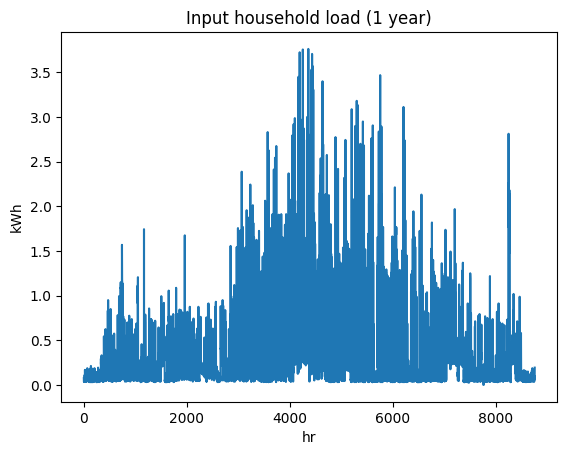

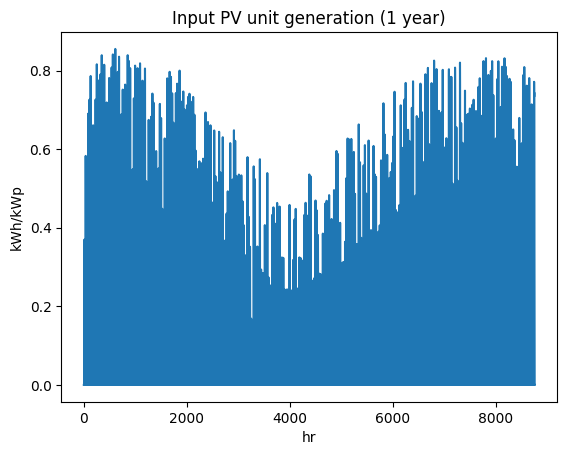

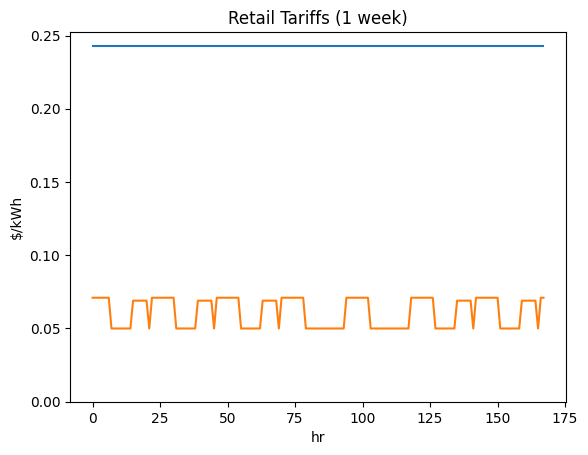

---- Optimising with PV: 1 - 20 kWp, Batt: 0 kWh. Determining PV capacity and dispatch.


************************************ Modell: PV > 1 kWp & BATT > 1 kWh ************************************
{'financial_horizon': 10, 'discount_rate': np.float64(0.06), 'grid_feedin_max': np.float64(5.0), 'pv_eol_capacity': np.float64(0.8), 'pv_eol_years': np.float64(25.0), 'pv_init_soh': np.float64(1.0), 'bess_e2p_ratio': np.float64(2.4), 'bess_roundtrip_eff': np.float64(0.88), 'bess_eol_years': np.float64(10.0), 'bess_eol_capacity': np.float64(0.7), 'bess_eol_cycles': np.float64(10000.0), 'bess_init_soh': np.float64(1.0), 'bess_eff_charge': np.float64(0.938083151964686), 'bess_eff_discharge': np.float64(0.938083151964686), 'scenario_name': 'Scenario_D_+5', 'scenario_set': 'SurfCoast', 'scenario_subset': 'JJP_open', 'year_start': 2022, 'datetime_name': 'DateTime1', 'meter_name': 'pc3058_nmi8531204682', 'solar_name': 'MELB', 'tariff_name_import_wkday': '3_Im_wkday', 'tariff_name_export_wkday': '3_

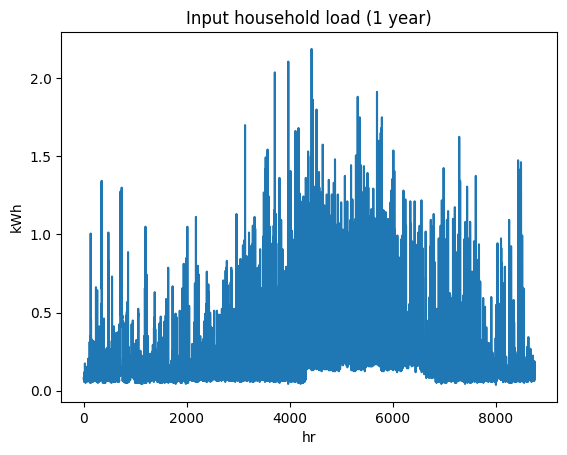

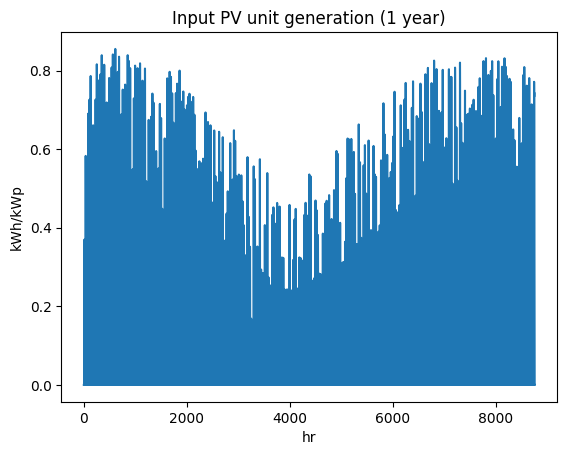

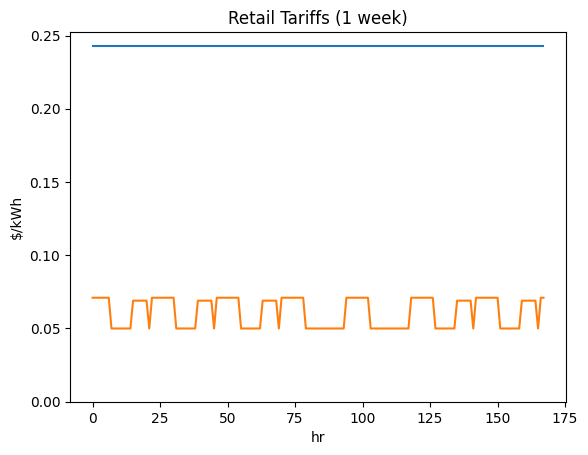

---- Optimising with PV: 1 - 20 kWp, Batt: 0 kWh. Determining PV capacity and dispatch.


************************************ Modell: PV > 1 kWp & BATT > 1 kWh ************************************
{'financial_horizon': 10, 'discount_rate': np.float64(0.06), 'grid_feedin_max': np.float64(5.0), 'pv_eol_capacity': np.float64(0.8), 'pv_eol_years': np.float64(25.0), 'pv_init_soh': np.float64(1.0), 'bess_e2p_ratio': np.float64(2.4), 'bess_roundtrip_eff': np.float64(0.88), 'bess_eol_years': np.float64(10.0), 'bess_eol_capacity': np.float64(0.7), 'bess_eol_cycles': np.float64(10000.0), 'bess_init_soh': np.float64(1.0), 'bess_eff_charge': np.float64(0.938083151964686), 'bess_eff_discharge': np.float64(0.938083151964686), 'scenario_name': 'Scenario_D_+5', 'scenario_set': 'SurfCoast', 'scenario_subset': 'JJP_open', 'year_start': 2022, 'datetime_name': 'DateTime1', 'meter_name': 'pc3058_nmi6404514982', 'solar_name': 'MELB', 'tariff_name_import_wkday': '3_Im_wkday', 'tariff_name_export_wkday': '3_

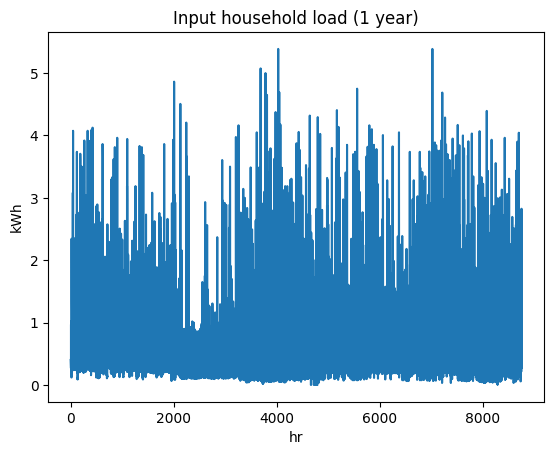

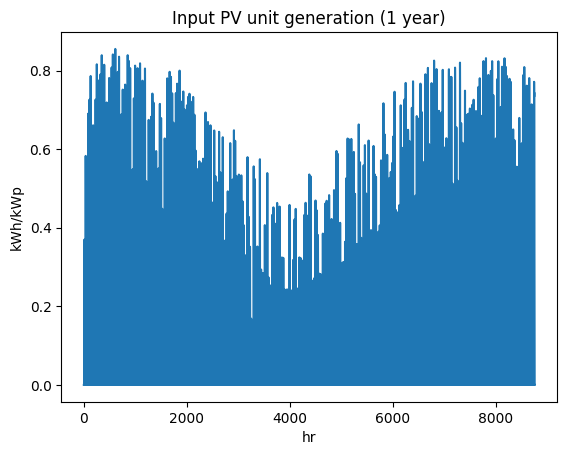

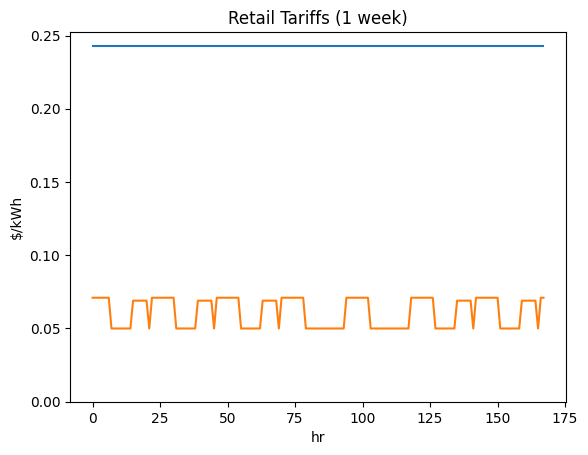

---- Optimising with PV: 1 - 20 kWp, Batt: 0 kWh. Determining PV capacity and dispatch.


************************************ Modell: PV > 1 kWp & BATT > 1 kWh ************************************
{'financial_horizon': 10, 'discount_rate': np.float64(0.06), 'grid_feedin_max': np.float64(5.0), 'pv_eol_capacity': np.float64(0.8), 'pv_eol_years': np.float64(25.0), 'pv_init_soh': np.float64(1.0), 'bess_e2p_ratio': np.float64(2.4), 'bess_roundtrip_eff': np.float64(0.88), 'bess_eol_years': np.float64(10.0), 'bess_eol_capacity': np.float64(0.7), 'bess_eol_cycles': np.float64(10000.0), 'bess_init_soh': np.float64(1.0), 'bess_eff_charge': np.float64(0.938083151964686), 'bess_eff_discharge': np.float64(0.938083151964686), 'scenario_name': 'Scenario_D_+5', 'scenario_set': 'SurfCoast', 'scenario_subset': 'JJP_open', 'year_start': 2022, 'datetime_name': 'DateTime1', 'meter_name': 'pc3011_nmi9421696637', 'solar_name': 'MELB', 'tariff_name_import_wkday': '3_Im_wkday', 'tariff_name_export_wkday': '3_

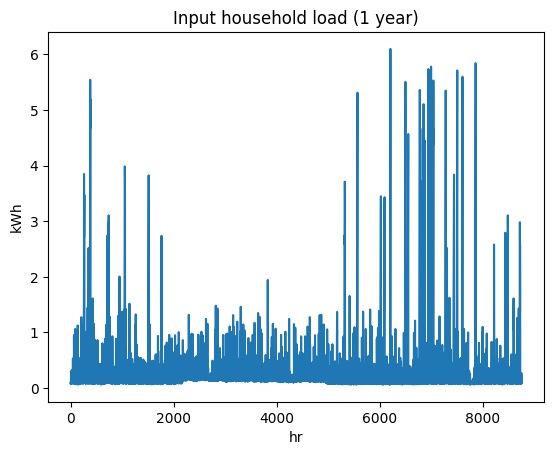

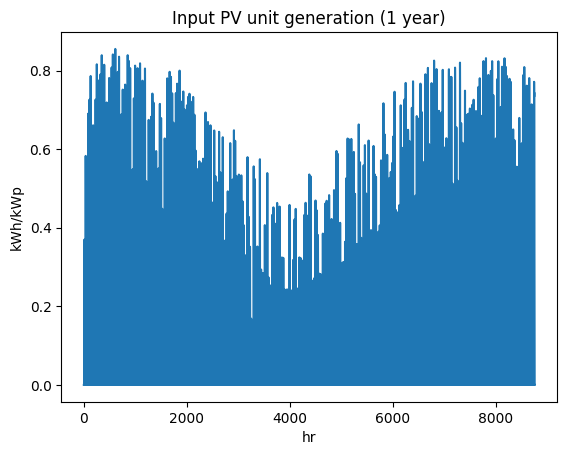

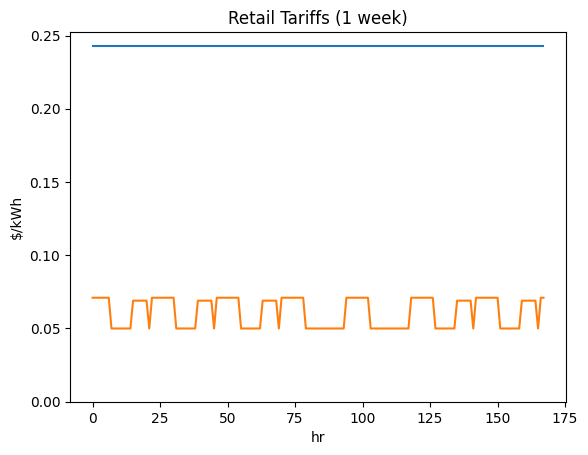

---- Optimising with PV: 1 - 20 kWp, Batt: 0 kWh. Determining PV capacity and dispatch.


************************************ Modell: PV > 1 kWp & BATT > 1 kWh ************************************
{'financial_horizon': 10, 'discount_rate': np.float64(0.06), 'grid_feedin_max': np.float64(5.0), 'pv_eol_capacity': np.float64(0.8), 'pv_eol_years': np.float64(25.0), 'pv_init_soh': np.float64(1.0), 'bess_e2p_ratio': np.float64(2.4), 'bess_roundtrip_eff': np.float64(0.88), 'bess_eol_years': np.float64(10.0), 'bess_eol_capacity': np.float64(0.7), 'bess_eol_cycles': np.float64(10000.0), 'bess_init_soh': np.float64(1.0), 'bess_eff_charge': np.float64(0.938083151964686), 'bess_eff_discharge': np.float64(0.938083151964686), 'scenario_name': 'Scenario_D_+5', 'scenario_set': 'SurfCoast', 'scenario_subset': 'JJP_open', 'year_start': 2022, 'datetime_name': 'DateTime1', 'meter_name': 'pc3040_nmi6334052034', 'solar_name': 'MELB', 'tariff_name_import_wkday': '3_Im_wkday', 'tariff_name_export_wkday': '3_

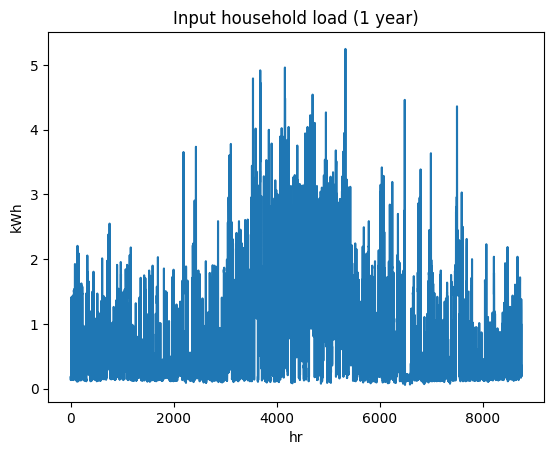

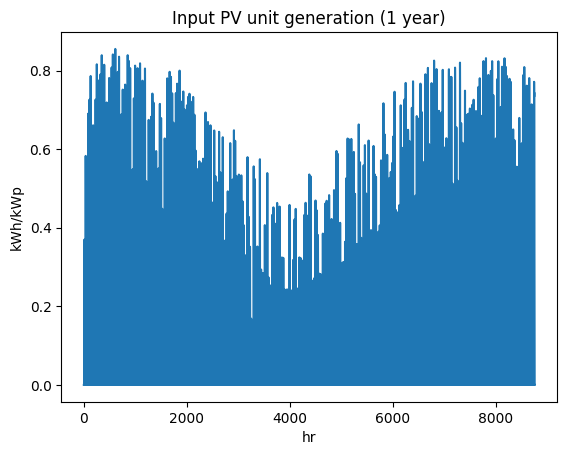

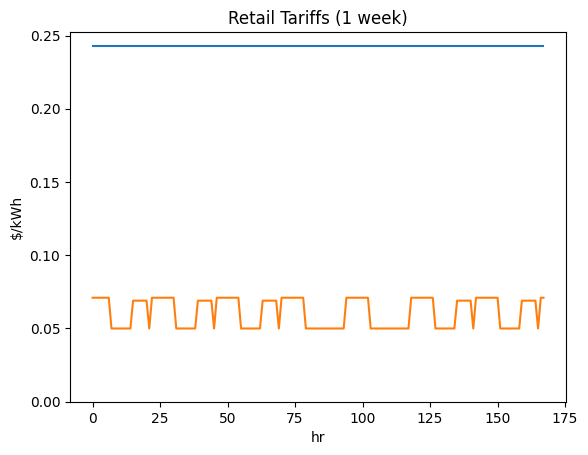

---- Optimising with PV: 1 - 20 kWp, Batt: 0 kWh. Determining PV capacity and dispatch.


************************************ Modell: PV > 1 kWp & BATT > 1 kWh ************************************
{'financial_horizon': 10, 'discount_rate': np.float64(0.06), 'grid_feedin_max': np.float64(5.0), 'pv_eol_capacity': np.float64(0.8), 'pv_eol_years': np.float64(25.0), 'pv_init_soh': np.float64(1.0), 'bess_e2p_ratio': np.float64(2.4), 'bess_roundtrip_eff': np.float64(0.88), 'bess_eol_years': np.float64(10.0), 'bess_eol_capacity': np.float64(0.7), 'bess_eol_cycles': np.float64(10000.0), 'bess_init_soh': np.float64(1.0), 'bess_eff_charge': np.float64(0.938083151964686), 'bess_eff_discharge': np.float64(0.938083151964686), 'scenario_name': 'Scenario_D_+5', 'scenario_set': 'SurfCoast', 'scenario_subset': 'JJP_open', 'year_start': 2022, 'datetime_name': 'DateTime1', 'meter_name': 'pc3072_nmi9103061149', 'solar_name': 'MELB', 'tariff_name_import_wkday': '3_Im_wkday', 'tariff_name_export_wkday': '3_

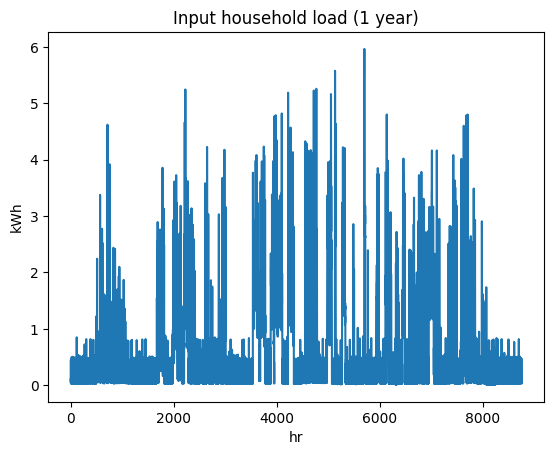

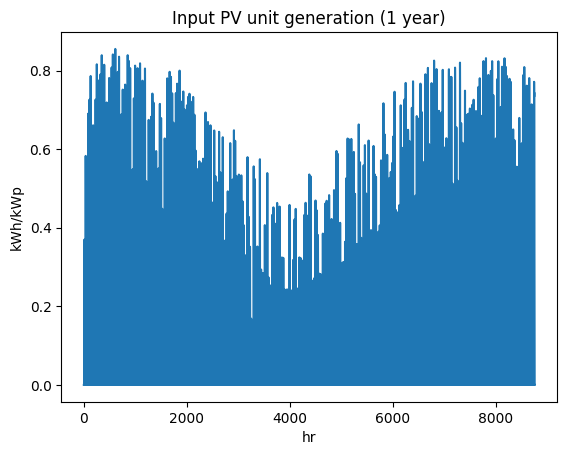

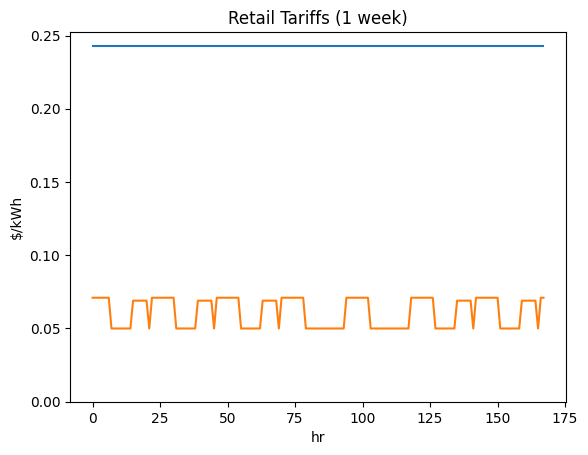

---- Optimising with PV: 1 - 20 kWp, Batt: 0 kWh. Determining PV capacity and dispatch.


************************************ Modell: PV > 1 kWp & BATT > 1 kWh ************************************
{'financial_horizon': 10, 'discount_rate': np.float64(0.06), 'grid_feedin_max': np.float64(5.0), 'pv_eol_capacity': np.float64(0.8), 'pv_eol_years': np.float64(25.0), 'pv_init_soh': np.float64(1.0), 'bess_e2p_ratio': np.float64(2.4), 'bess_roundtrip_eff': np.float64(0.88), 'bess_eol_years': np.float64(10.0), 'bess_eol_capacity': np.float64(0.7), 'bess_eol_cycles': np.float64(10000.0), 'bess_init_soh': np.float64(1.0), 'bess_eff_charge': np.float64(0.938083151964686), 'bess_eff_discharge': np.float64(0.938083151964686), 'scenario_name': 'Scenario_D_+5', 'scenario_set': 'SurfCoast', 'scenario_subset': 'JJP_open', 'year_start': 2022, 'datetime_name': 'DateTime1', 'meter_name': 'pc3040_nmi3769298557', 'solar_name': 'MELB', 'tariff_name_import_wkday': '3_Im_wkday', 'tariff_name_export_wkday': '3_

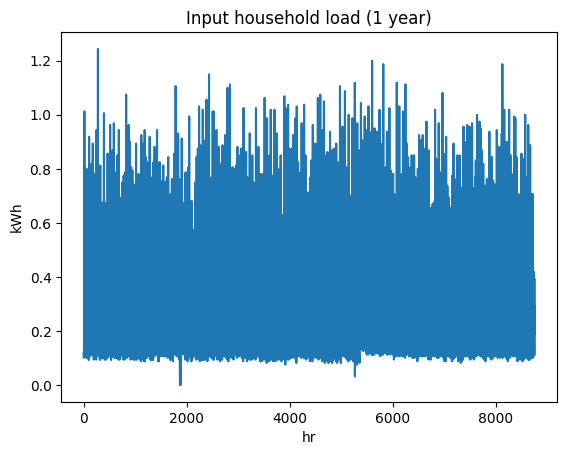

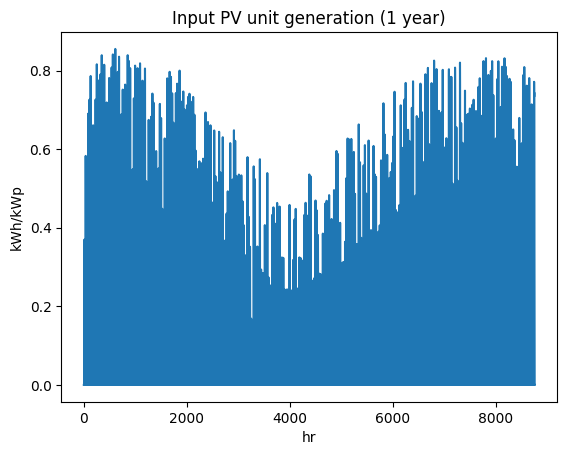

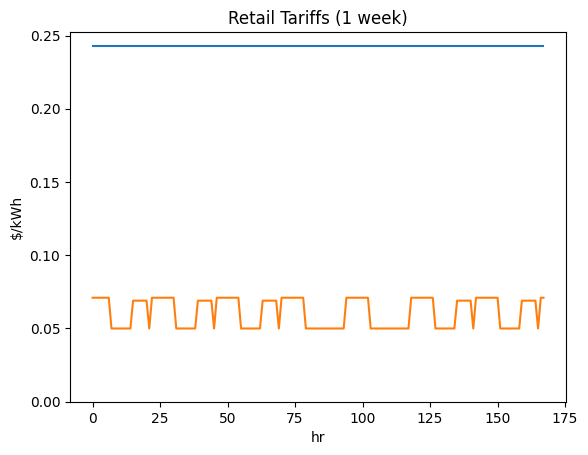

---- Optimising with PV: 1 - 20 kWp, Batt: 0 kWh. Determining PV capacity and dispatch.


************************************ Modell: PV > 1 kWp & BATT > 1 kWh ************************************
{'financial_horizon': 10, 'discount_rate': np.float64(0.06), 'grid_feedin_max': np.float64(5.0), 'pv_eol_capacity': np.float64(0.8), 'pv_eol_years': np.float64(25.0), 'pv_init_soh': np.float64(1.0), 'bess_e2p_ratio': np.float64(2.4), 'bess_roundtrip_eff': np.float64(0.88), 'bess_eol_years': np.float64(10.0), 'bess_eol_capacity': np.float64(0.7), 'bess_eol_cycles': np.float64(10000.0), 'bess_init_soh': np.float64(1.0), 'bess_eff_charge': np.float64(0.938083151964686), 'bess_eff_discharge': np.float64(0.938083151964686), 'scenario_name': 'Scenario_D_+5', 'scenario_set': 'SurfCoast', 'scenario_subset': 'JJP_open', 'year_start': 2022, 'datetime_name': 'DateTime1', 'meter_name': 'pc3072_nmi3106350492', 'solar_name': 'MELB', 'tariff_name_import_wkday': '3_Im_wkday', 'tariff_name_export_wkday': '3_

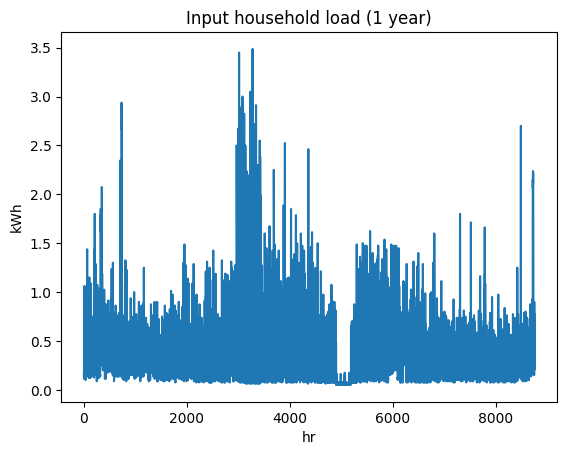

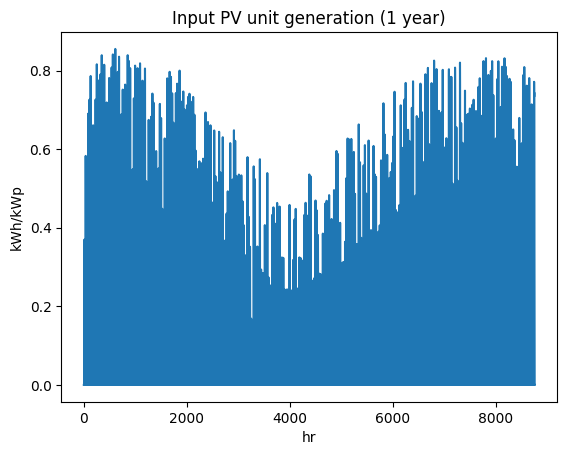

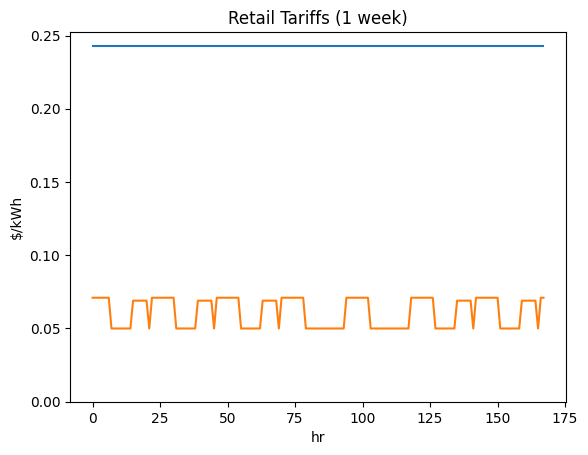

---- Optimising with PV: 1 - 20 kWp, Batt: 0 kWh. Determining PV capacity and dispatch.


************************************ Modell: PV > 1 kWp & BATT > 1 kWh ************************************
{'financial_horizon': 10, 'discount_rate': np.float64(0.06), 'grid_feedin_max': np.float64(5.0), 'pv_eol_capacity': np.float64(0.8), 'pv_eol_years': np.float64(25.0), 'pv_init_soh': np.float64(1.0), 'bess_e2p_ratio': np.float64(2.4), 'bess_roundtrip_eff': np.float64(0.88), 'bess_eol_years': np.float64(10.0), 'bess_eol_capacity': np.float64(0.7), 'bess_eol_cycles': np.float64(10000.0), 'bess_init_soh': np.float64(1.0), 'bess_eff_charge': np.float64(0.938083151964686), 'bess_eff_discharge': np.float64(0.938083151964686), 'scenario_name': 'Scenario_D_+5', 'scenario_set': 'SurfCoast', 'scenario_subset': 'JJP_open', 'year_start': 2022, 'datetime_name': 'DateTime1', 'meter_name': 'pc3079_nmi1181251864', 'solar_name': 'MELB', 'tariff_name_import_wkday': '3_Im_wkday', 'tariff_name_export_wkday': '3_

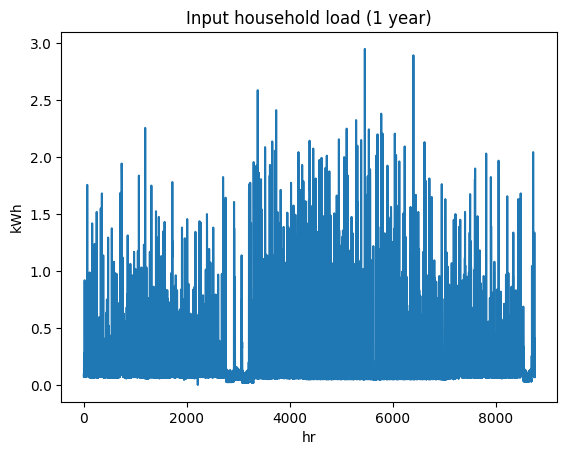

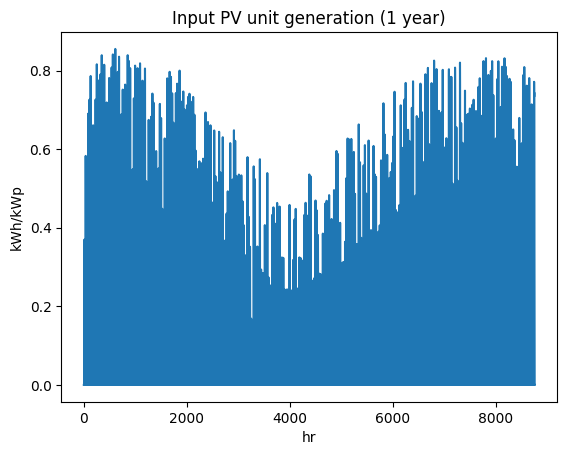

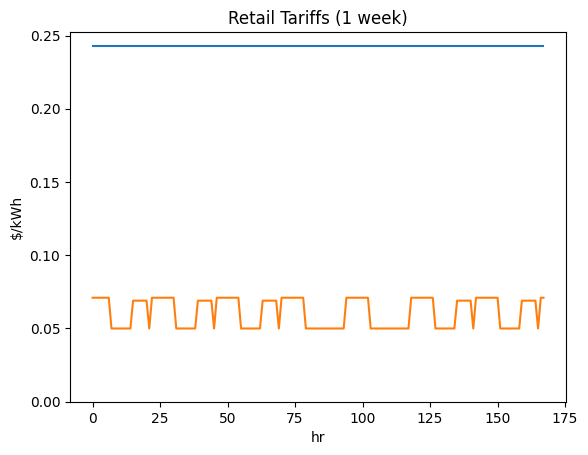

---- Optimising with PV: 1 - 20 kWp, Batt: 0 kWh. Determining PV capacity and dispatch.


************************************ Modell: PV > 1 kWp & BATT > 1 kWh ************************************
{'financial_horizon': 10, 'discount_rate': np.float64(0.06), 'grid_feedin_max': np.float64(5.0), 'pv_eol_capacity': np.float64(0.8), 'pv_eol_years': np.float64(25.0), 'pv_init_soh': np.float64(1.0), 'bess_e2p_ratio': np.float64(2.4), 'bess_roundtrip_eff': np.float64(0.88), 'bess_eol_years': np.float64(10.0), 'bess_eol_capacity': np.float64(0.7), 'bess_eol_cycles': np.float64(10000.0), 'bess_init_soh': np.float64(1.0), 'bess_eff_charge': np.float64(0.938083151964686), 'bess_eff_discharge': np.float64(0.938083151964686), 'scenario_name': 'Scenario_D_+5', 'scenario_set': 'SurfCoast', 'scenario_subset': 'JJP_open', 'year_start': 2022, 'datetime_name': 'DateTime1', 'meter_name': 'pc3072_nmi1045890010', 'solar_name': 'MELB', 'tariff_name_import_wkday': '3_Im_wkday', 'tariff_name_export_wkday': '3_

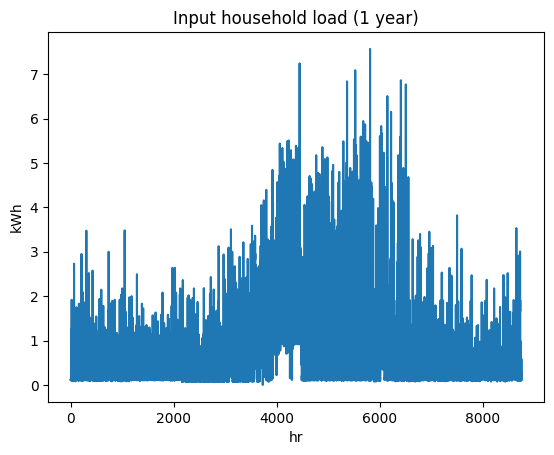

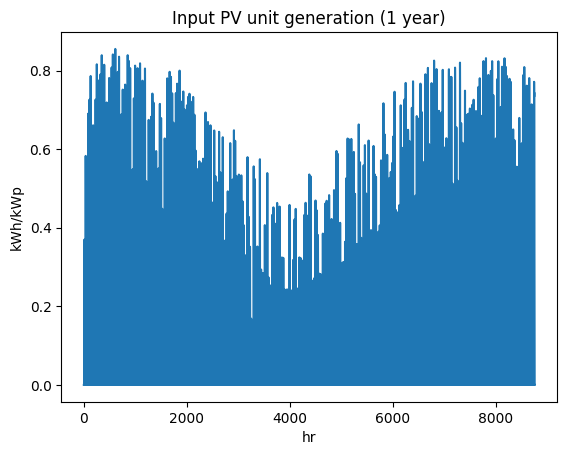

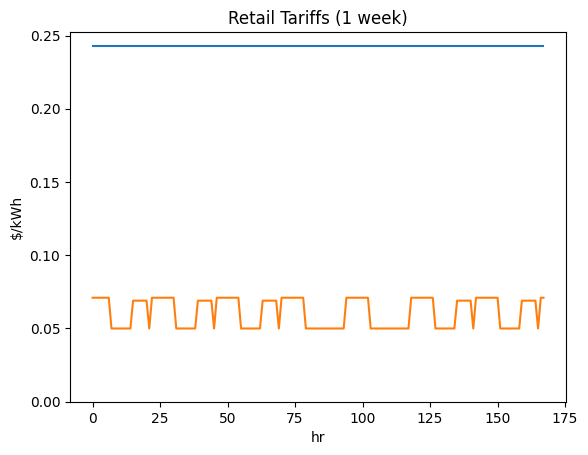

---- Optimising with PV: 1 - 20 kWp, Batt: 0 kWh. Determining PV capacity and dispatch.


************************************ Modell: PV > 1 kWp & BATT > 1 kWh ************************************
{'financial_horizon': 10, 'discount_rate': np.float64(0.06), 'grid_feedin_max': np.float64(5.0), 'pv_eol_capacity': np.float64(0.8), 'pv_eol_years': np.float64(25.0), 'pv_init_soh': np.float64(1.0), 'bess_e2p_ratio': np.float64(2.4), 'bess_roundtrip_eff': np.float64(0.88), 'bess_eol_years': np.float64(10.0), 'bess_eol_capacity': np.float64(0.7), 'bess_eol_cycles': np.float64(10000.0), 'bess_init_soh': np.float64(1.0), 'bess_eff_charge': np.float64(0.938083151964686), 'bess_eff_discharge': np.float64(0.938083151964686), 'scenario_name': 'Scenario_D_+5', 'scenario_set': 'SurfCoast', 'scenario_subset': 'JJP_open', 'year_start': 2022, 'datetime_name': 'DateTime1', 'meter_name': 'pc3079_nmi1505193664', 'solar_name': 'MELB', 'tariff_name_import_wkday': '3_Im_wkday', 'tariff_name_export_wkday': '3_

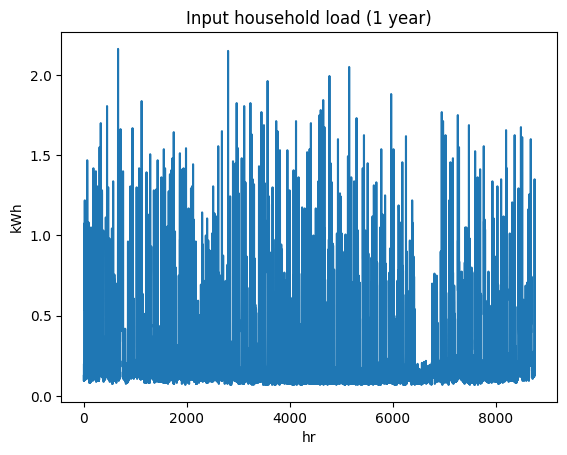

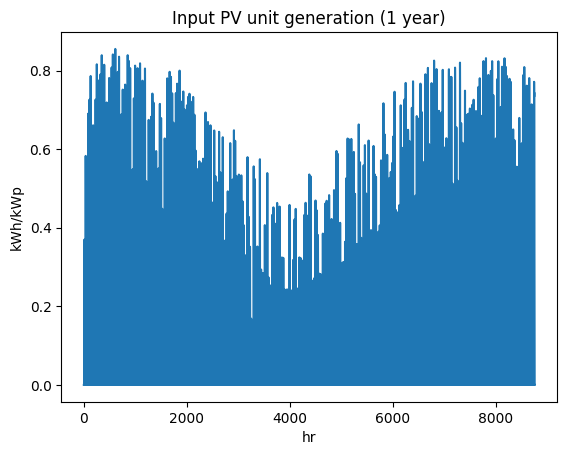

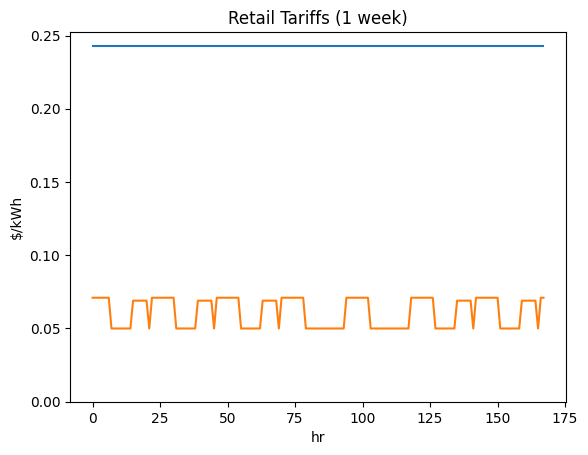

---- Optimising with PV: 1 - 20 kWp, Batt: 0 kWh. Determining PV capacity and dispatch.


************************************ Modell: PV > 1 kWp & BATT > 1 kWh ************************************
{'financial_horizon': 10, 'discount_rate': np.float64(0.06), 'grid_feedin_max': np.float64(5.0), 'pv_eol_capacity': np.float64(0.8), 'pv_eol_years': np.float64(25.0), 'pv_init_soh': np.float64(1.0), 'bess_e2p_ratio': np.float64(2.4), 'bess_roundtrip_eff': np.float64(0.88), 'bess_eol_years': np.float64(10.0), 'bess_eol_capacity': np.float64(0.7), 'bess_eol_cycles': np.float64(10000.0), 'bess_init_soh': np.float64(1.0), 'bess_eff_charge': np.float64(0.938083151964686), 'bess_eff_discharge': np.float64(0.938083151964686), 'scenario_name': 'Scenario_D_+5', 'scenario_set': 'SurfCoast', 'scenario_subset': 'JJP_open', 'year_start': 2022, 'datetime_name': 'DateTime1', 'meter_name': 'pc3079_nmi2558774852', 'solar_name': 'MELB', 'tariff_name_import_wkday': '3_Im_wkday', 'tariff_name_export_wkday': '3_

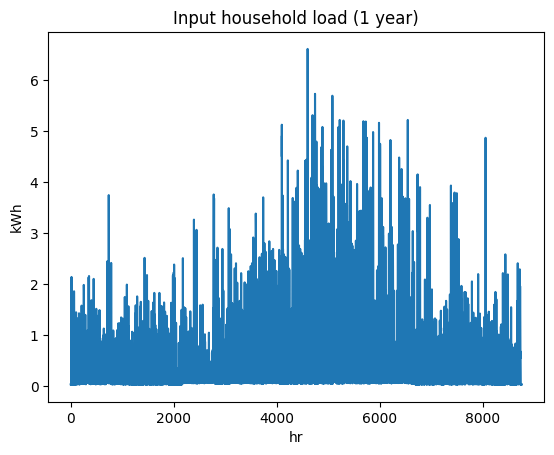

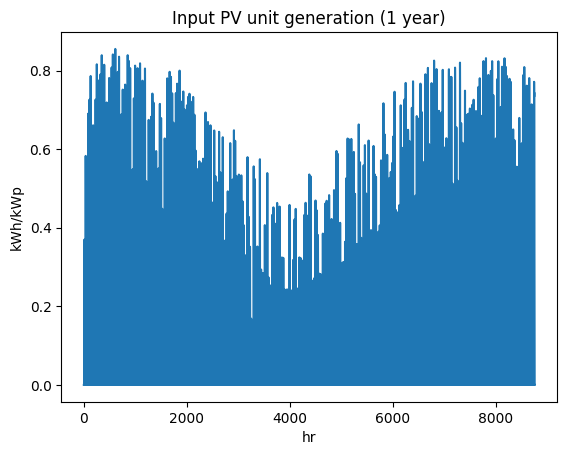

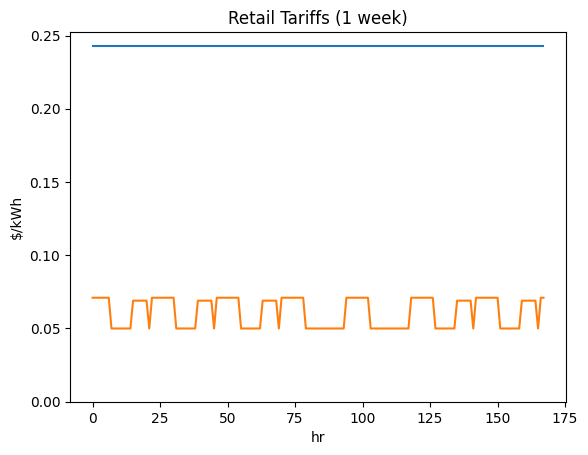

---- Optimising with PV: 1 - 20 kWp, Batt: 0 kWh. Determining PV capacity and dispatch.


************************************ Modell: PV > 1 kWp & BATT > 1 kWh ************************************
{'financial_horizon': 10, 'discount_rate': np.float64(0.06), 'grid_feedin_max': np.float64(5.0), 'pv_eol_capacity': np.float64(0.8), 'pv_eol_years': np.float64(25.0), 'pv_init_soh': np.float64(1.0), 'bess_e2p_ratio': np.float64(2.4), 'bess_roundtrip_eff': np.float64(0.88), 'bess_eol_years': np.float64(10.0), 'bess_eol_capacity': np.float64(0.7), 'bess_eol_cycles': np.float64(10000.0), 'bess_init_soh': np.float64(1.0), 'bess_eff_charge': np.float64(0.938083151964686), 'bess_eff_discharge': np.float64(0.938083151964686), 'scenario_name': 'Scenario_D_+5', 'scenario_set': 'SurfCoast', 'scenario_subset': 'JJP_open', 'year_start': 2022, 'datetime_name': 'DateTime1', 'meter_name': 'pc3072_nmi3195972053', 'solar_name': 'MELB', 'tariff_name_import_wkday': '3_Im_wkday', 'tariff_name_export_wkday': '3_

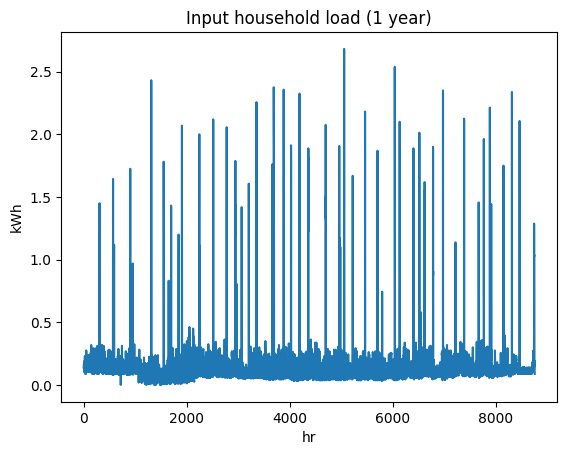

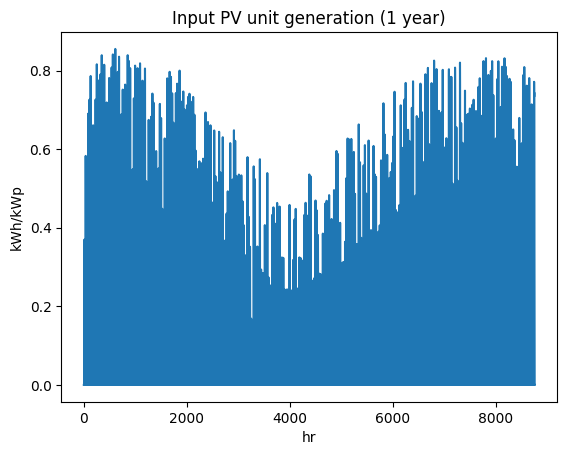

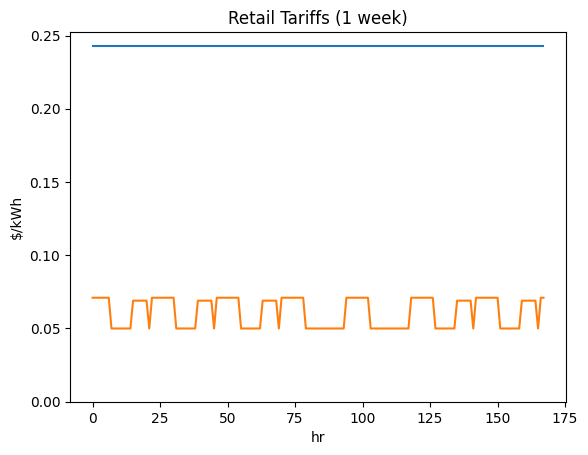

---- Optimising with PV: 1 - 20 kWp, Batt: 0 kWh. Determining PV capacity and dispatch.


************************************ Modell: PV > 1 kWp & BATT > 1 kWh ************************************
{'financial_horizon': 10, 'discount_rate': np.float64(0.06), 'grid_feedin_max': np.float64(5.0), 'pv_eol_capacity': np.float64(0.8), 'pv_eol_years': np.float64(25.0), 'pv_init_soh': np.float64(1.0), 'bess_e2p_ratio': np.float64(2.4), 'bess_roundtrip_eff': np.float64(0.88), 'bess_eol_years': np.float64(10.0), 'bess_eol_capacity': np.float64(0.7), 'bess_eol_cycles': np.float64(10000.0), 'bess_init_soh': np.float64(1.0), 'bess_eff_charge': np.float64(0.938083151964686), 'bess_eff_discharge': np.float64(0.938083151964686), 'scenario_name': 'Scenario_D_+5', 'scenario_set': 'SurfCoast', 'scenario_subset': 'JJP_open', 'year_start': 2022, 'datetime_name': 'DateTime1', 'meter_name': 'pc3072_nmi3842196479', 'solar_name': 'MELB', 'tariff_name_import_wkday': '3_Im_wkday', 'tariff_name_export_wkday': '3_

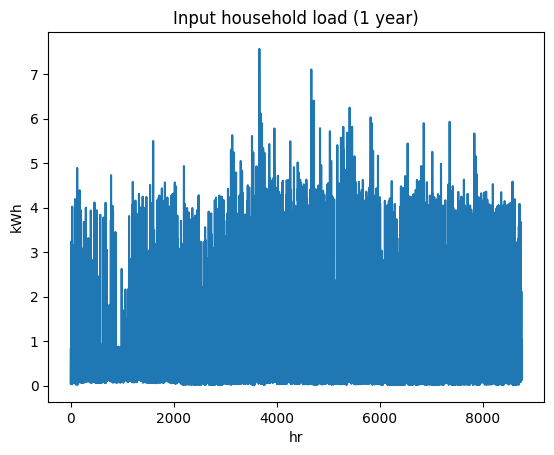

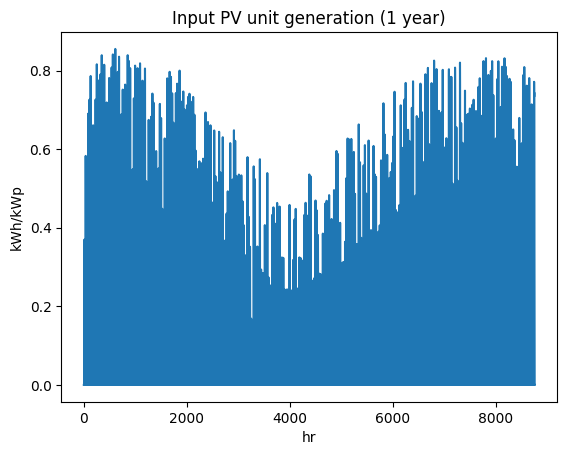

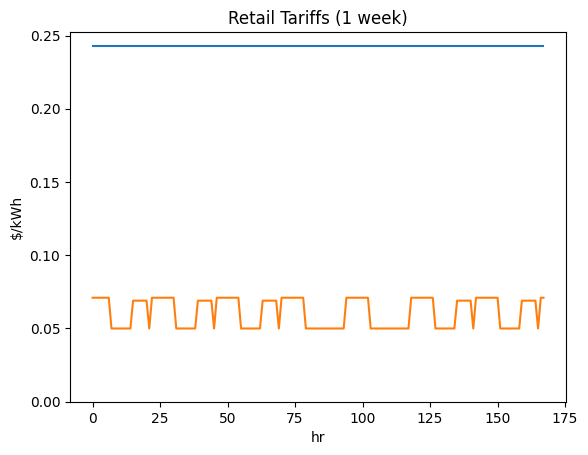

---- Optimising with PV: 1 - 20 kWp, Batt: 0 kWh. Determining PV capacity and dispatch.


************************************ Modell: PV > 1 kWp & BATT > 1 kWh ************************************
{'financial_horizon': 10, 'discount_rate': np.float64(0.06), 'grid_feedin_max': np.float64(5.0), 'pv_eol_capacity': np.float64(0.8), 'pv_eol_years': np.float64(25.0), 'pv_init_soh': np.float64(1.0), 'bess_e2p_ratio': np.float64(2.4), 'bess_roundtrip_eff': np.float64(0.88), 'bess_eol_years': np.float64(10.0), 'bess_eol_capacity': np.float64(0.7), 'bess_eol_cycles': np.float64(10000.0), 'bess_init_soh': np.float64(1.0), 'bess_eff_charge': np.float64(0.938083151964686), 'bess_eff_discharge': np.float64(0.938083151964686), 'scenario_name': 'Scenario_D_+5', 'scenario_set': 'SurfCoast', 'scenario_subset': 'JJP_open', 'year_start': 2022, 'datetime_name': 'DateTime1', 'meter_name': 'pc3039_nmi4961319691', 'solar_name': 'MELB', 'tariff_name_import_wkday': '3_Im_wkday', 'tariff_name_export_wkday': '3_

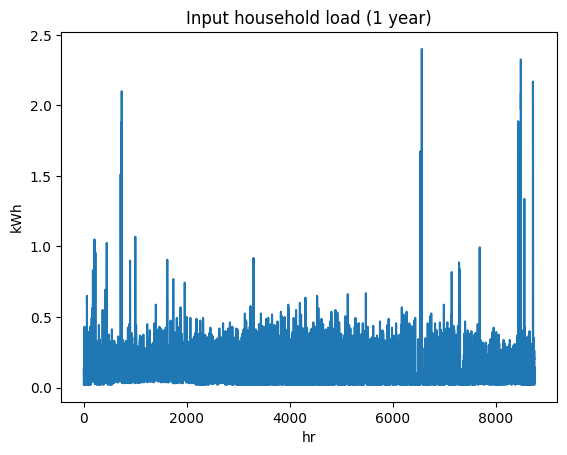

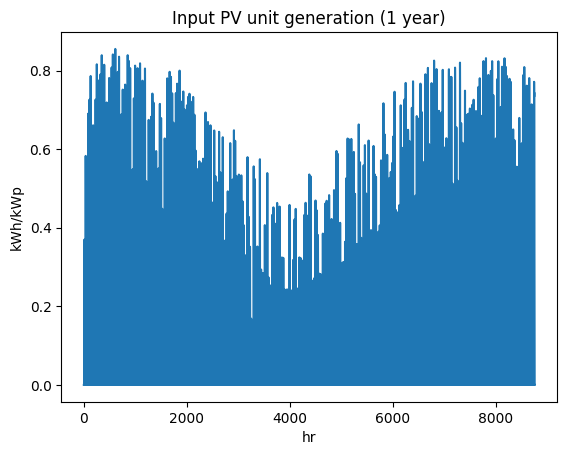

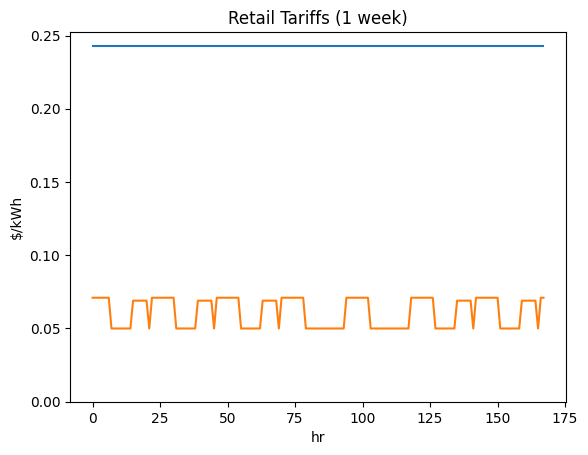

---- Optimising with PV: 1 - 20 kWp, Batt: 0 kWh. Determining PV capacity and dispatch.


************************************ Modell: PV > 1 kWp & BATT > 1 kWh ************************************
{'financial_horizon': 10, 'discount_rate': np.float64(0.06), 'grid_feedin_max': np.float64(5.0), 'pv_eol_capacity': np.float64(0.8), 'pv_eol_years': np.float64(25.0), 'pv_init_soh': np.float64(1.0), 'bess_e2p_ratio': np.float64(2.4), 'bess_roundtrip_eff': np.float64(0.88), 'bess_eol_years': np.float64(10.0), 'bess_eol_capacity': np.float64(0.7), 'bess_eol_cycles': np.float64(10000.0), 'bess_init_soh': np.float64(1.0), 'bess_eff_charge': np.float64(0.938083151964686), 'bess_eff_discharge': np.float64(0.938083151964686), 'scenario_name': 'Scenario_D_+5', 'scenario_set': 'SurfCoast', 'scenario_subset': 'JJP_open', 'year_start': 2022, 'datetime_name': 'DateTime1', 'meter_name': 'pc3012_nmi9008474074', 'solar_name': 'MELB', 'tariff_name_import_wkday': '3_Im_wkday', 'tariff_name_export_wkday': '3_

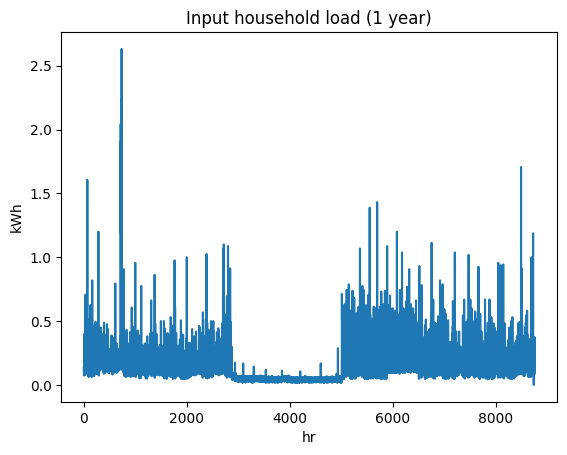

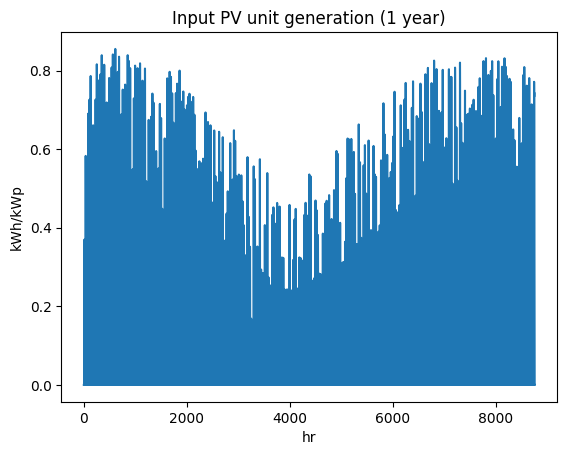

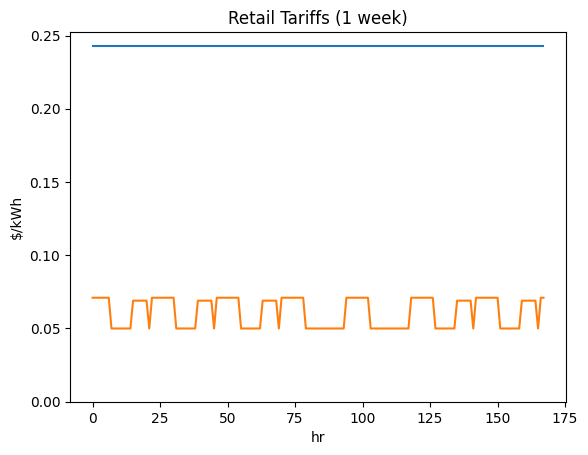

---- Optimising with PV: 1 - 20 kWp, Batt: 0 kWh. Determining PV capacity and dispatch.


************************************ Modell: PV > 1 kWp & BATT > 1 kWh ************************************
{'financial_horizon': 10, 'discount_rate': np.float64(0.06), 'grid_feedin_max': np.float64(5.0), 'pv_eol_capacity': np.float64(0.8), 'pv_eol_years': np.float64(25.0), 'pv_init_soh': np.float64(1.0), 'bess_e2p_ratio': np.float64(2.4), 'bess_roundtrip_eff': np.float64(0.88), 'bess_eol_years': np.float64(10.0), 'bess_eol_capacity': np.float64(0.7), 'bess_eol_cycles': np.float64(10000.0), 'bess_init_soh': np.float64(1.0), 'bess_eff_charge': np.float64(0.938083151964686), 'bess_eff_discharge': np.float64(0.938083151964686), 'scenario_name': 'Scenario_D_+5', 'scenario_set': 'SurfCoast', 'scenario_subset': 'JJP_open', 'year_start': 2022, 'datetime_name': 'DateTime1', 'meter_name': 'pc3033_nmi5076579050', 'solar_name': 'MELB', 'tariff_name_import_wkday': '3_Im_wkday', 'tariff_name_export_wkday': '3_

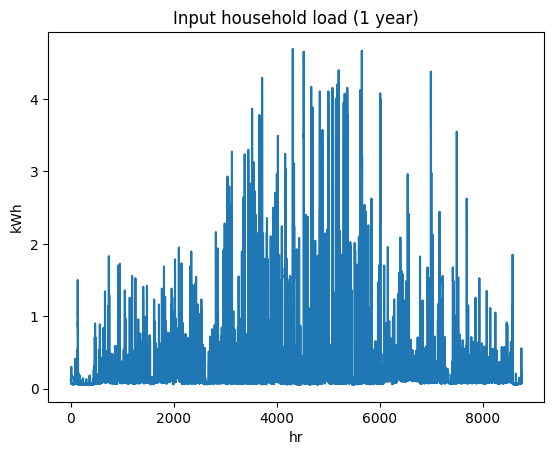

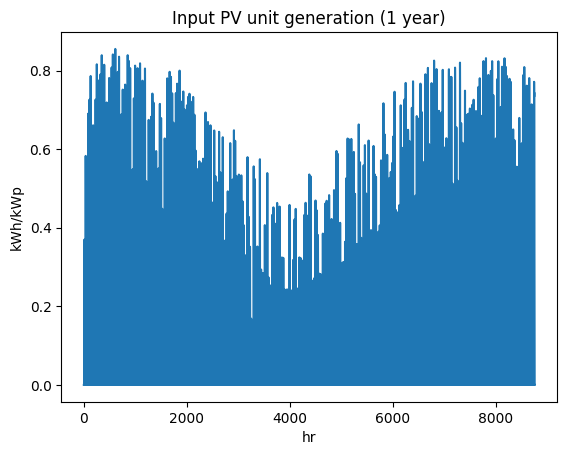

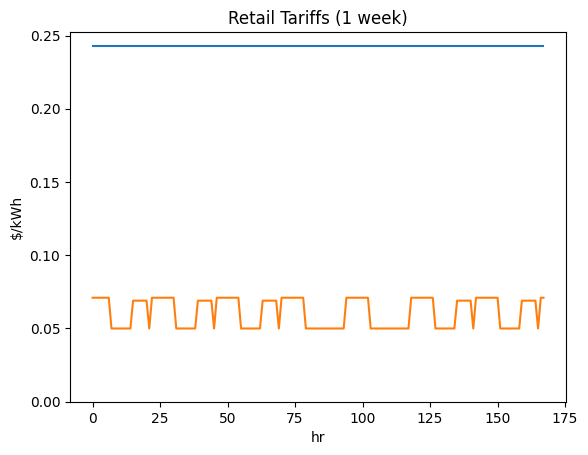

---- Optimising with PV: 1 - 20 kWp, Batt: 0 kWh. Determining PV capacity and dispatch.


************************************ Modell: PV > 1 kWp & BATT > 1 kWh ************************************
{'financial_horizon': 10, 'discount_rate': np.float64(0.06), 'grid_feedin_max': np.float64(5.0), 'pv_eol_capacity': np.float64(0.8), 'pv_eol_years': np.float64(25.0), 'pv_init_soh': np.float64(1.0), 'bess_e2p_ratio': np.float64(2.4), 'bess_roundtrip_eff': np.float64(0.88), 'bess_eol_years': np.float64(10.0), 'bess_eol_capacity': np.float64(0.7), 'bess_eol_cycles': np.float64(10000.0), 'bess_init_soh': np.float64(1.0), 'bess_eff_charge': np.float64(0.938083151964686), 'bess_eff_discharge': np.float64(0.938083151964686), 'scenario_name': 'Scenario_D_+5', 'scenario_set': 'SurfCoast', 'scenario_subset': 'JJP_open', 'year_start': 2022, 'datetime_name': 'DateTime1', 'meter_name': 'pc3032_nmi8339115769', 'solar_name': 'MELB', 'tariff_name_import_wkday': '3_Im_wkday', 'tariff_name_export_wkday': '3_

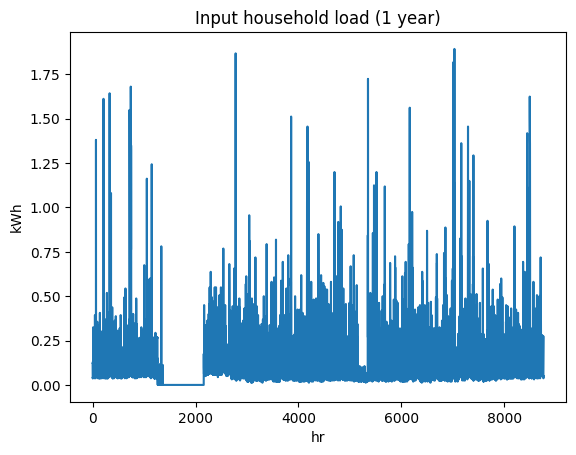

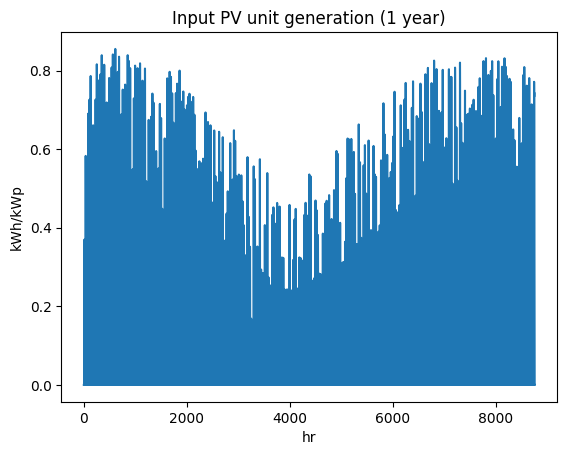

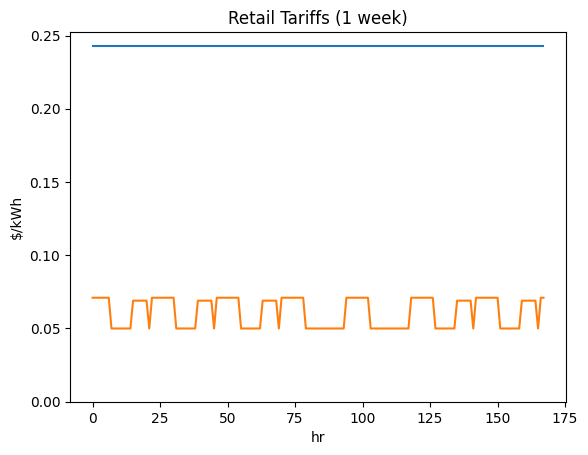

---- Optimising with PV: 1 - 20 kWp, Batt: 0 kWh. Determining PV capacity and dispatch.


************************************ Modell: PV > 1 kWp & BATT > 1 kWh ************************************
{'financial_horizon': 10, 'discount_rate': np.float64(0.06), 'grid_feedin_max': np.float64(5.0), 'pv_eol_capacity': np.float64(0.8), 'pv_eol_years': np.float64(25.0), 'pv_init_soh': np.float64(1.0), 'bess_e2p_ratio': np.float64(2.4), 'bess_roundtrip_eff': np.float64(0.88), 'bess_eol_years': np.float64(10.0), 'bess_eol_capacity': np.float64(0.7), 'bess_eol_cycles': np.float64(10000.0), 'bess_init_soh': np.float64(1.0), 'bess_eff_charge': np.float64(0.938083151964686), 'bess_eff_discharge': np.float64(0.938083151964686), 'scenario_name': 'Scenario_D_+5', 'scenario_set': 'SurfCoast', 'scenario_subset': 'JJP_open', 'year_start': 2022, 'datetime_name': 'DateTime1', 'meter_name': 'pc3040_nmi7236720948', 'solar_name': 'MELB', 'tariff_name_import_wkday': '3_Im_wkday', 'tariff_name_export_wkday': '3_

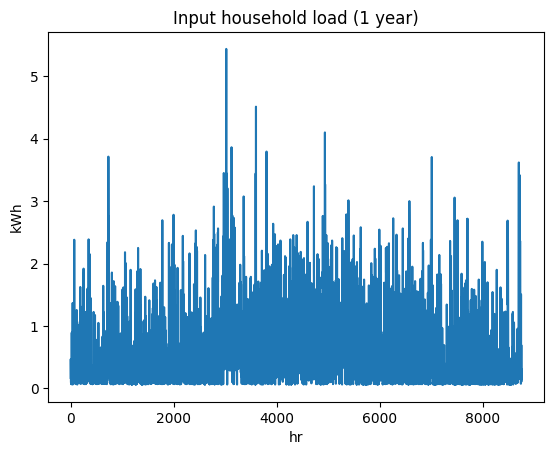

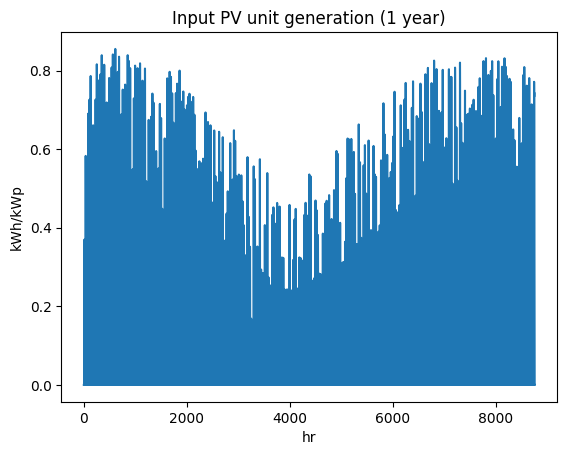

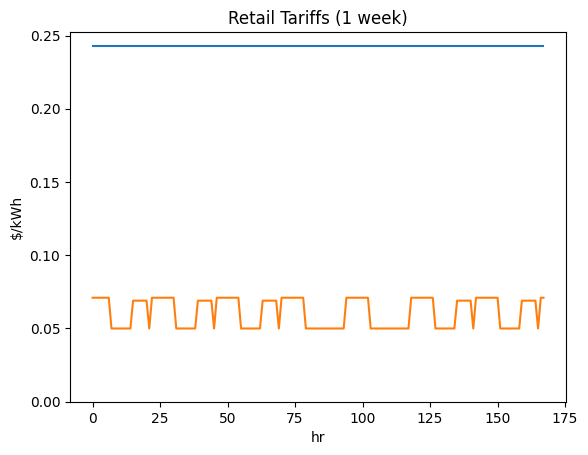

---- Optimising with PV: 1 - 20 kWp, Batt: 0 kWh. Determining PV capacity and dispatch.


************************************ Modell: PV > 1 kWp & BATT > 1 kWh ************************************
{'financial_horizon': 10, 'discount_rate': np.float64(0.06), 'grid_feedin_max': np.float64(5.0), 'pv_eol_capacity': np.float64(0.8), 'pv_eol_years': np.float64(25.0), 'pv_init_soh': np.float64(1.0), 'bess_e2p_ratio': np.float64(2.4), 'bess_roundtrip_eff': np.float64(0.88), 'bess_eol_years': np.float64(10.0), 'bess_eol_capacity': np.float64(0.7), 'bess_eol_cycles': np.float64(10000.0), 'bess_init_soh': np.float64(1.0), 'bess_eff_charge': np.float64(0.938083151964686), 'bess_eff_discharge': np.float64(0.938083151964686), 'scenario_name': 'Scenario_D_+5', 'scenario_set': 'SurfCoast', 'scenario_subset': 'JJP_open', 'year_start': 2022, 'datetime_name': 'DateTime1', 'meter_name': 'pc3084_nmi5884360156', 'solar_name': 'MELB', 'tariff_name_import_wkday': '3_Im_wkday', 'tariff_name_export_wkday': '3_

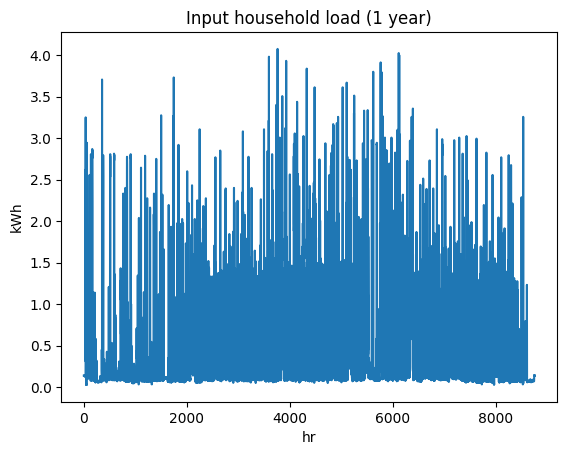

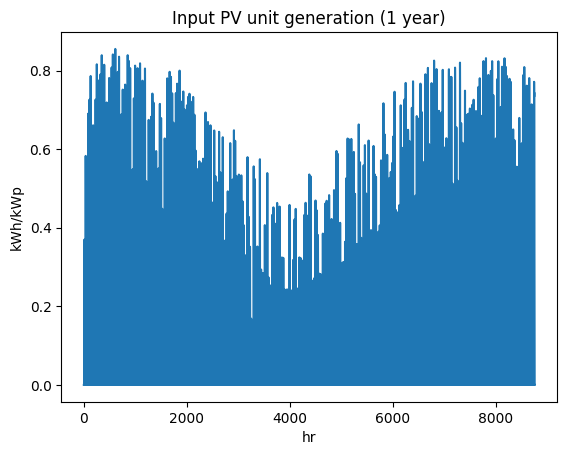

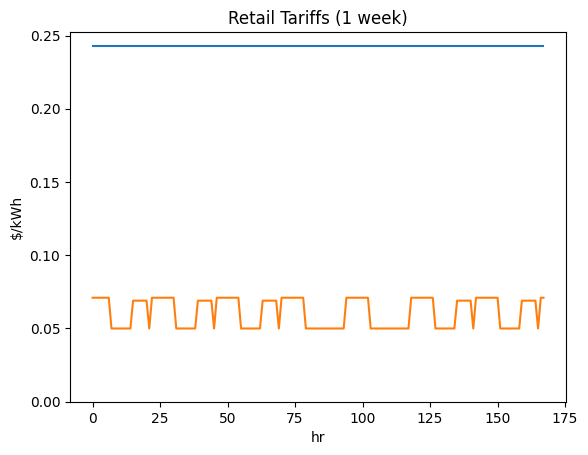

---- Optimising with PV: 1 - 20 kWp, Batt: 0 kWh. Determining PV capacity and dispatch.


************************************ Modell: PV > 1 kWp & BATT > 1 kWh ************************************
{'financial_horizon': 10, 'discount_rate': np.float64(0.06), 'grid_feedin_max': np.float64(5.0), 'pv_eol_capacity': np.float64(0.8), 'pv_eol_years': np.float64(25.0), 'pv_init_soh': np.float64(1.0), 'bess_e2p_ratio': np.float64(2.4), 'bess_roundtrip_eff': np.float64(0.88), 'bess_eol_years': np.float64(10.0), 'bess_eol_capacity': np.float64(0.7), 'bess_eol_cycles': np.float64(10000.0), 'bess_init_soh': np.float64(1.0), 'bess_eff_charge': np.float64(0.938083151964686), 'bess_eff_discharge': np.float64(0.938083151964686), 'scenario_name': 'Scenario_D_+5', 'scenario_set': 'SurfCoast', 'scenario_subset': 'JJP_open', 'year_start': 2022, 'datetime_name': 'DateTime1', 'meter_name': 'pc3072_nmi6054289773', 'solar_name': 'MELB', 'tariff_name_import_wkday': '3_Im_wkday', 'tariff_name_export_wkday': '3_

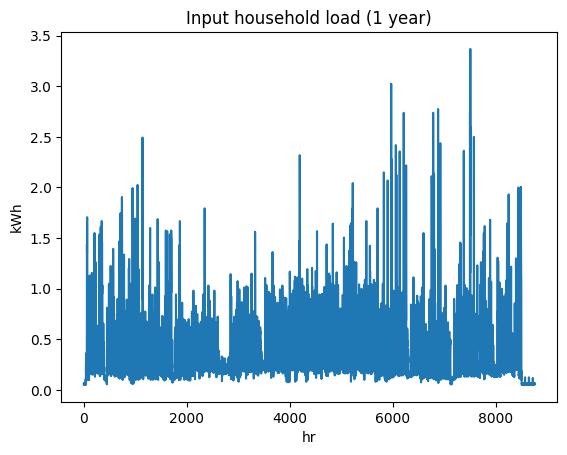

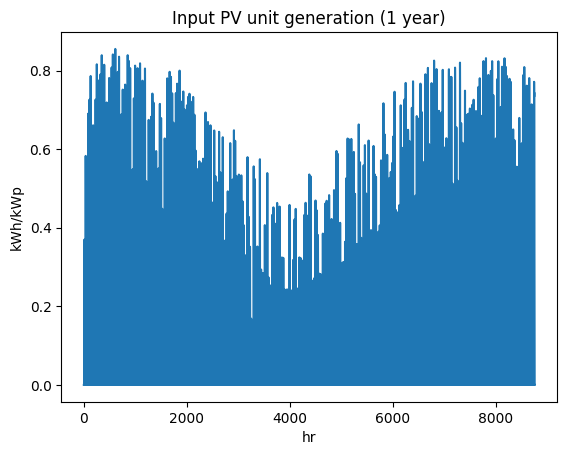

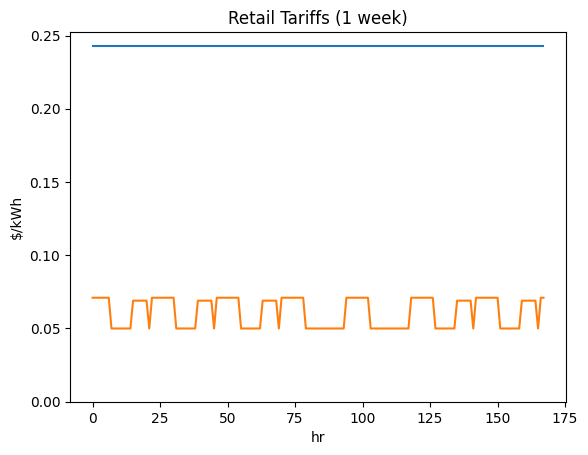

---- Optimising with PV: 1 - 20 kWp, Batt: 0 kWh. Determining PV capacity and dispatch.


************************************ Modell: PV > 1 kWp & BATT > 1 kWh ************************************
{'financial_horizon': 10, 'discount_rate': np.float64(0.06), 'grid_feedin_max': np.float64(5.0), 'pv_eol_capacity': np.float64(0.8), 'pv_eol_years': np.float64(25.0), 'pv_init_soh': np.float64(1.0), 'bess_e2p_ratio': np.float64(2.4), 'bess_roundtrip_eff': np.float64(0.88), 'bess_eol_years': np.float64(10.0), 'bess_eol_capacity': np.float64(0.7), 'bess_eol_cycles': np.float64(10000.0), 'bess_init_soh': np.float64(1.0), 'bess_eff_charge': np.float64(0.938083151964686), 'bess_eff_discharge': np.float64(0.938083151964686), 'scenario_name': 'Scenario_D_+5', 'scenario_set': 'SurfCoast', 'scenario_subset': 'JJP_open', 'year_start': 2022, 'datetime_name': 'DateTime1', 'meter_name': 'pc3032_nmi3389498165', 'solar_name': 'MELB', 'tariff_name_import_wkday': '3_Im_wkday', 'tariff_name_export_wkday': '3_

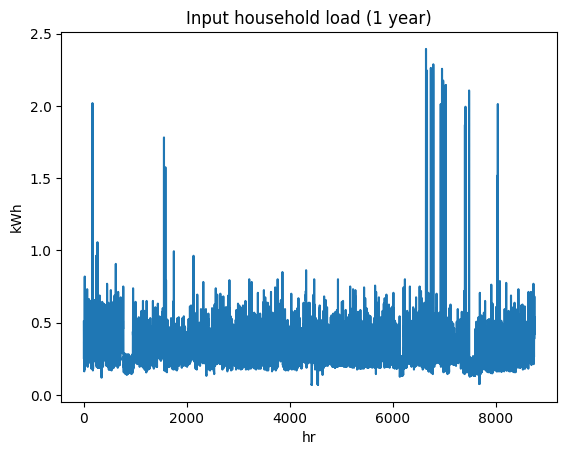

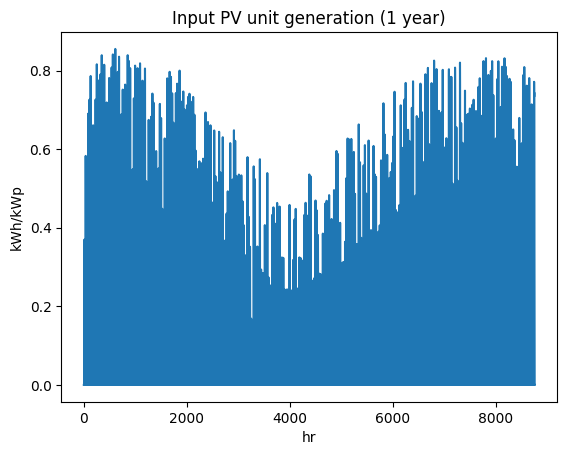

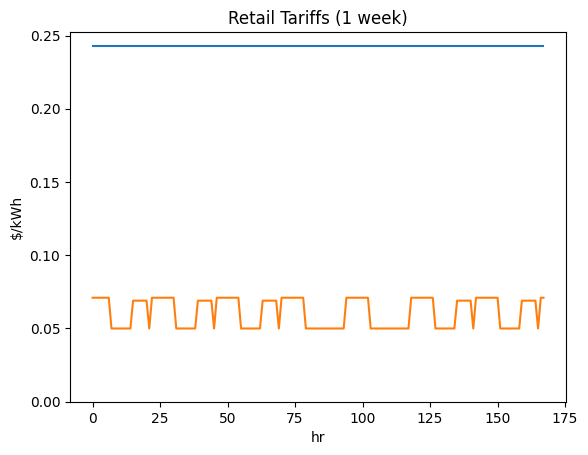

---- Optimising with PV: 1 - 20 kWp, Batt: 0 kWh. Determining PV capacity and dispatch.


************************************ Modell: PV > 1 kWp & BATT > 1 kWh ************************************
{'financial_horizon': 10, 'discount_rate': np.float64(0.06), 'grid_feedin_max': np.float64(5.0), 'pv_eol_capacity': np.float64(0.8), 'pv_eol_years': np.float64(25.0), 'pv_init_soh': np.float64(1.0), 'bess_e2p_ratio': np.float64(2.4), 'bess_roundtrip_eff': np.float64(0.88), 'bess_eol_years': np.float64(10.0), 'bess_eol_capacity': np.float64(0.7), 'bess_eol_cycles': np.float64(10000.0), 'bess_init_soh': np.float64(1.0), 'bess_eff_charge': np.float64(0.938083151964686), 'bess_eff_discharge': np.float64(0.938083151964686), 'scenario_name': 'Scenario_D_+5', 'scenario_set': 'SurfCoast', 'scenario_subset': 'JJP_open', 'year_start': 2022, 'datetime_name': 'DateTime1', 'meter_name': 'pc3012_nmi1970893589', 'solar_name': 'MELB', 'tariff_name_import_wkday': '3_Im_wkday', 'tariff_name_export_wkday': '3_

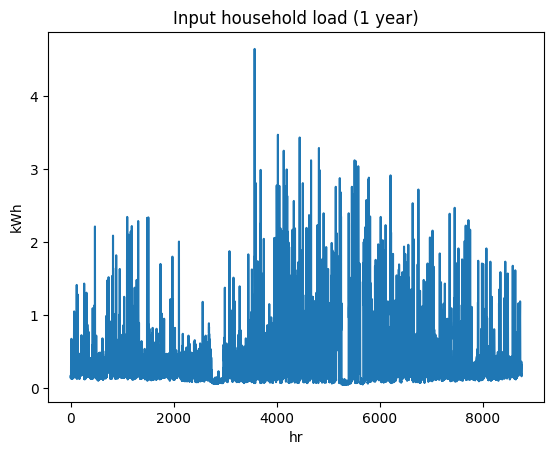

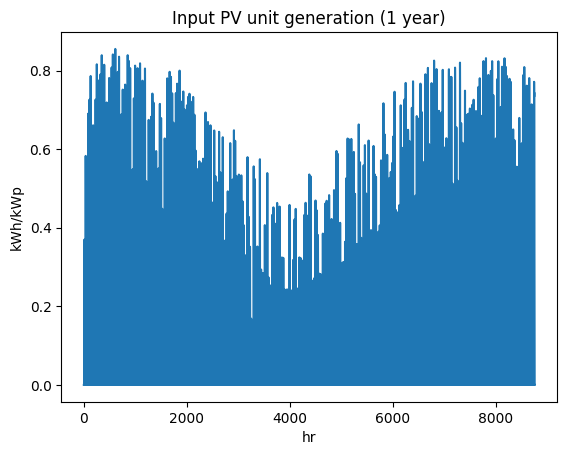

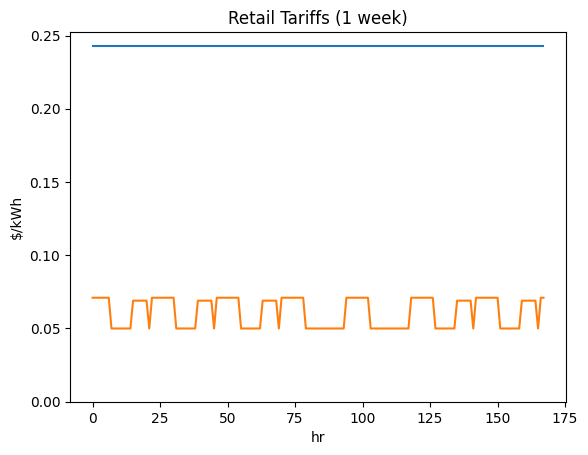

---- Optimising with PV: 1 - 20 kWp, Batt: 0 kWh. Determining PV capacity and dispatch.


************************************ Modell: PV > 1 kWp & BATT > 1 kWh ************************************
{'financial_horizon': 10, 'discount_rate': np.float64(0.06), 'grid_feedin_max': np.float64(5.0), 'pv_eol_capacity': np.float64(0.8), 'pv_eol_years': np.float64(25.0), 'pv_init_soh': np.float64(1.0), 'bess_e2p_ratio': np.float64(2.4), 'bess_roundtrip_eff': np.float64(0.88), 'bess_eol_years': np.float64(10.0), 'bess_eol_capacity': np.float64(0.7), 'bess_eol_cycles': np.float64(10000.0), 'bess_init_soh': np.float64(1.0), 'bess_eff_charge': np.float64(0.938083151964686), 'bess_eff_discharge': np.float64(0.938083151964686), 'scenario_name': 'Scenario_D_+5', 'scenario_set': 'SurfCoast', 'scenario_subset': 'JJP_open', 'year_start': 2022, 'datetime_name': 'DateTime1', 'meter_name': 'pc3072_nmi4443012387', 'solar_name': 'MELB', 'tariff_name_import_wkday': '3_Im_wkday', 'tariff_name_export_wkday': '3_

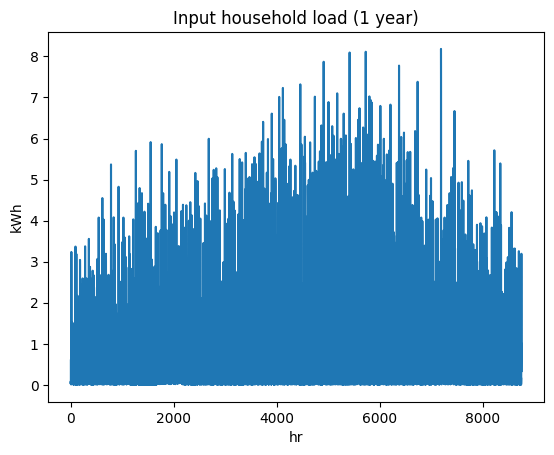

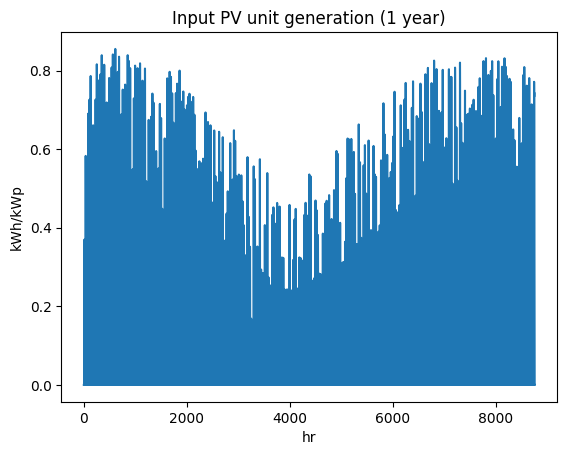

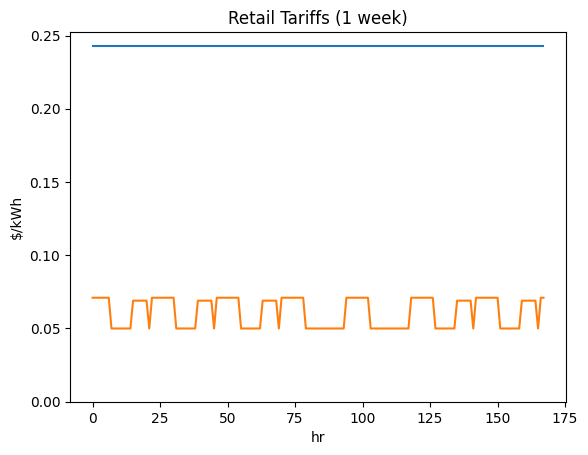

---- Optimising with PV: 1 - 20 kWp, Batt: 0 kWh. Determining PV capacity and dispatch.


************************************ Modell: PV > 1 kWp & BATT > 1 kWh ************************************
{'financial_horizon': 10, 'discount_rate': np.float64(0.06), 'grid_feedin_max': np.float64(5.0), 'pv_eol_capacity': np.float64(0.8), 'pv_eol_years': np.float64(25.0), 'pv_init_soh': np.float64(1.0), 'bess_e2p_ratio': np.float64(2.4), 'bess_roundtrip_eff': np.float64(0.88), 'bess_eol_years': np.float64(10.0), 'bess_eol_capacity': np.float64(0.7), 'bess_eol_cycles': np.float64(10000.0), 'bess_init_soh': np.float64(1.0), 'bess_eff_charge': np.float64(0.938083151964686), 'bess_eff_discharge': np.float64(0.938083151964686), 'scenario_name': 'Scenario_D_+5', 'scenario_set': 'SurfCoast', 'scenario_subset': 'JJP_open', 'year_start': 2022, 'datetime_name': 'DateTime1', 'meter_name': 'pc3011_nmi2465874568', 'solar_name': 'MELB', 'tariff_name_import_wkday': '3_Im_wkday', 'tariff_name_export_wkday': '3_

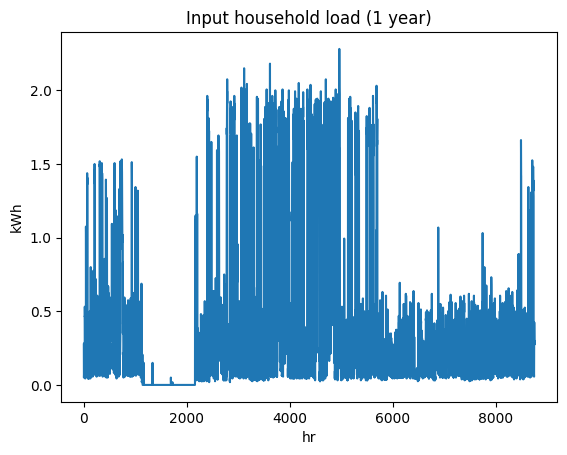

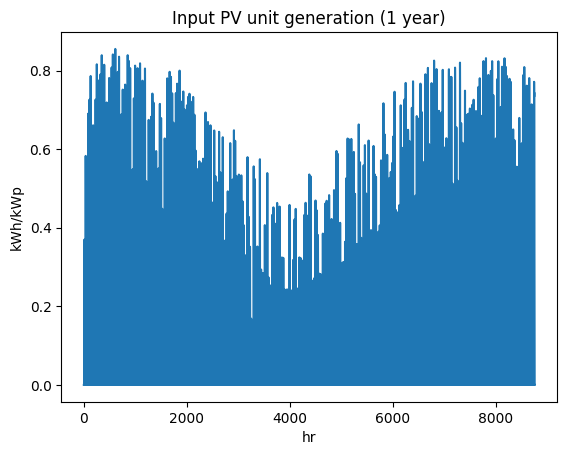

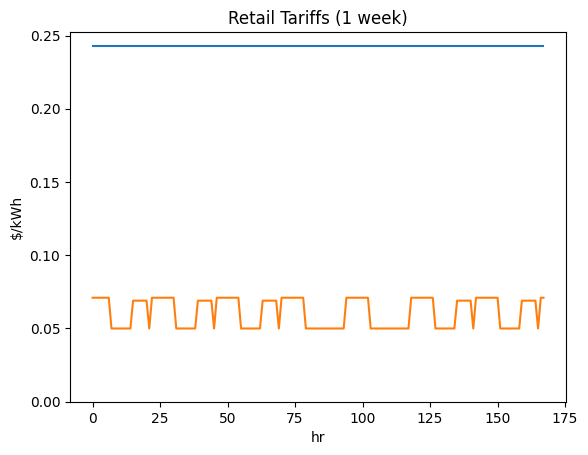

---- Optimising with PV: 1 - 20 kWp, Batt: 0 kWh. Determining PV capacity and dispatch.


************************************ Modell: PV > 1 kWp & BATT > 1 kWh ************************************
{'financial_horizon': 10, 'discount_rate': np.float64(0.06), 'grid_feedin_max': np.float64(5.0), 'pv_eol_capacity': np.float64(0.8), 'pv_eol_years': np.float64(25.0), 'pv_init_soh': np.float64(1.0), 'bess_e2p_ratio': np.float64(2.4), 'bess_roundtrip_eff': np.float64(0.88), 'bess_eol_years': np.float64(10.0), 'bess_eol_capacity': np.float64(0.7), 'bess_eol_cycles': np.float64(10000.0), 'bess_init_soh': np.float64(1.0), 'bess_eff_charge': np.float64(0.938083151964686), 'bess_eff_discharge': np.float64(0.938083151964686), 'scenario_name': 'Scenario_D_+5', 'scenario_set': 'SurfCoast', 'scenario_subset': 'JJP_open', 'year_start': 2022, 'datetime_name': 'DateTime1', 'meter_name': 'pc3058_nmi3533456619', 'solar_name': 'MELB', 'tariff_name_import_wkday': '3_Im_wkday', 'tariff_name_export_wkday': '3_

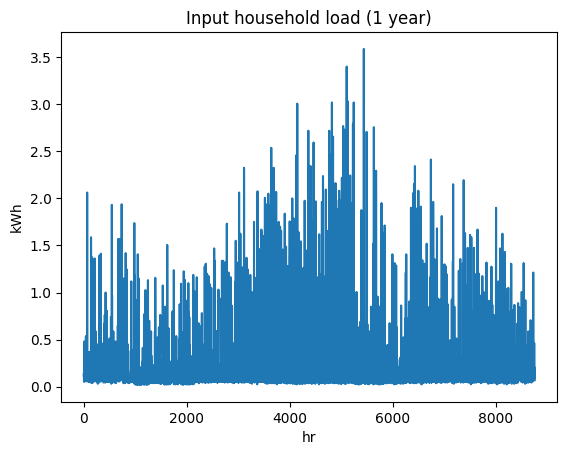

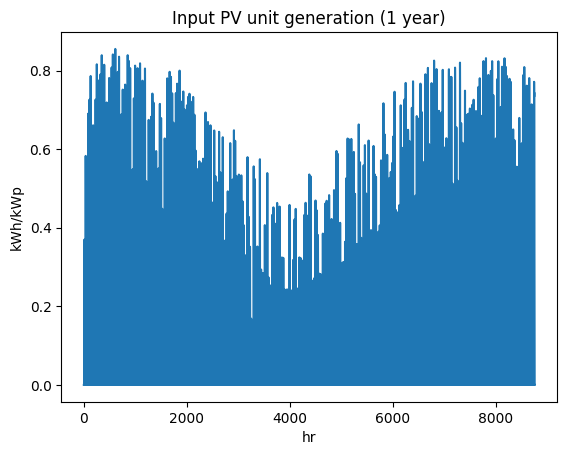

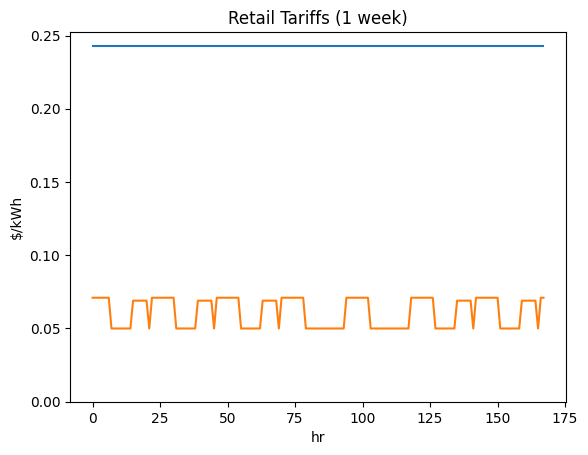

---- Optimising with PV: 1 - 20 kWp, Batt: 0 kWh. Determining PV capacity and dispatch.


************************************ Modell: PV > 1 kWp & BATT > 1 kWh ************************************
{'financial_horizon': 10, 'discount_rate': np.float64(0.06), 'grid_feedin_max': np.float64(5.0), 'pv_eol_capacity': np.float64(0.8), 'pv_eol_years': np.float64(25.0), 'pv_init_soh': np.float64(1.0), 'bess_e2p_ratio': np.float64(2.4), 'bess_roundtrip_eff': np.float64(0.88), 'bess_eol_years': np.float64(10.0), 'bess_eol_capacity': np.float64(0.7), 'bess_eol_cycles': np.float64(10000.0), 'bess_init_soh': np.float64(1.0), 'bess_eff_charge': np.float64(0.938083151964686), 'bess_eff_discharge': np.float64(0.938083151964686), 'scenario_name': 'Scenario_D_+5', 'scenario_set': 'SurfCoast', 'scenario_subset': 'JJP_open', 'year_start': 2022, 'datetime_name': 'DateTime1', 'meter_name': 'pc3012_nmi2745081527', 'solar_name': 'MELB', 'tariff_name_import_wkday': '3_Im_wkday', 'tariff_name_export_wkday': '3_

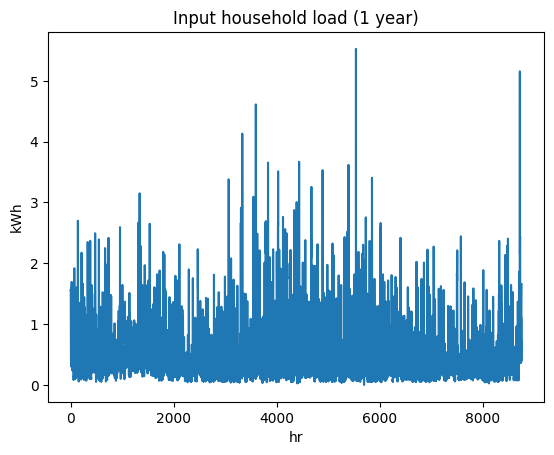

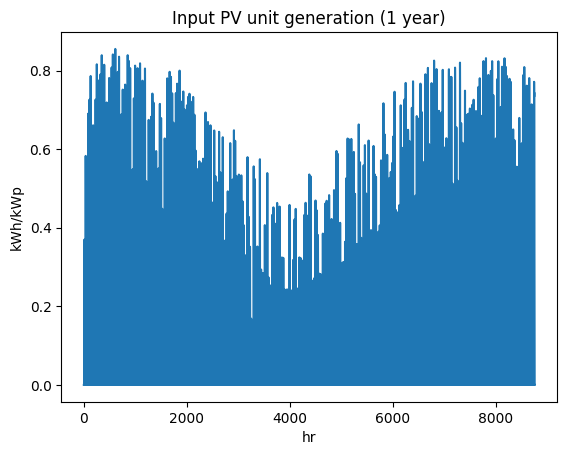

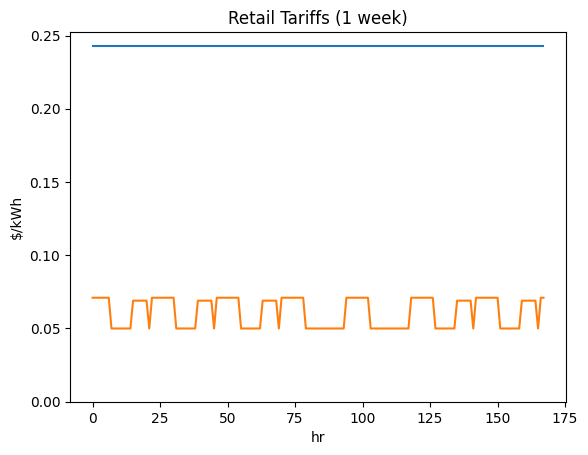

---- Optimising with PV: 1 - 20 kWp, Batt: 0 kWh. Determining PV capacity and dispatch.


************************************ Modell: PV > 1 kWp & BATT > 1 kWh ************************************
{'financial_horizon': 10, 'discount_rate': np.float64(0.06), 'grid_feedin_max': np.float64(5.0), 'pv_eol_capacity': np.float64(0.8), 'pv_eol_years': np.float64(25.0), 'pv_init_soh': np.float64(1.0), 'bess_e2p_ratio': np.float64(2.4), 'bess_roundtrip_eff': np.float64(0.88), 'bess_eol_years': np.float64(10.0), 'bess_eol_capacity': np.float64(0.7), 'bess_eol_cycles': np.float64(10000.0), 'bess_init_soh': np.float64(1.0), 'bess_eff_charge': np.float64(0.938083151964686), 'bess_eff_discharge': np.float64(0.938083151964686), 'scenario_name': 'Scenario_D_+5', 'scenario_set': 'SurfCoast', 'scenario_subset': 'JJP_open', 'year_start': 2022, 'datetime_name': 'DateTime1', 'meter_name': 'pc3016_nmi4120975580', 'solar_name': 'MELB', 'tariff_name_import_wkday': '3_Im_wkday', 'tariff_name_export_wkday': '3_

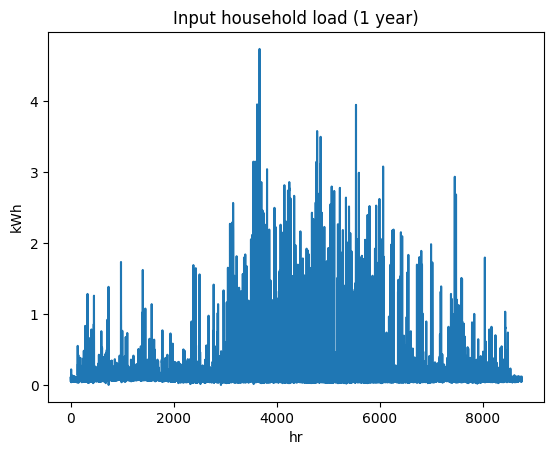

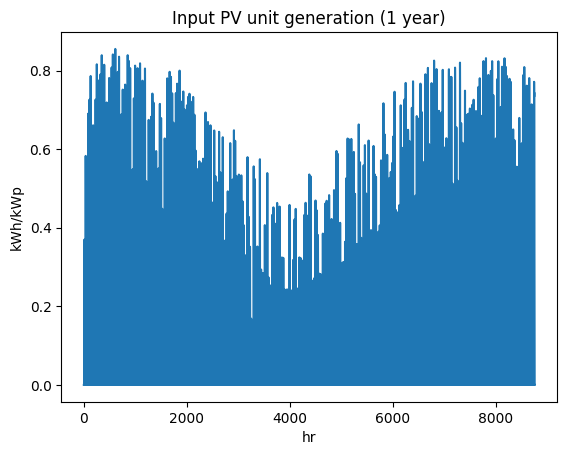

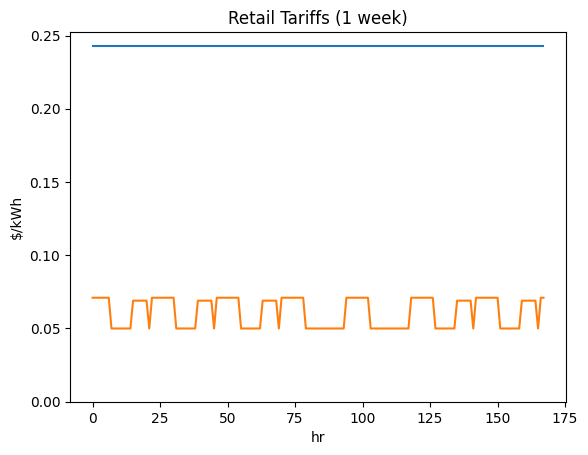

---- Optimising with PV: 1 - 20 kWp, Batt: 0 kWh. Determining PV capacity and dispatch.


************************************ Modell: PV > 1 kWp & BATT > 1 kWh ************************************
{'financial_horizon': 10, 'discount_rate': np.float64(0.06), 'grid_feedin_max': np.float64(5.0), 'pv_eol_capacity': np.float64(0.8), 'pv_eol_years': np.float64(25.0), 'pv_init_soh': np.float64(1.0), 'bess_e2p_ratio': np.float64(2.4), 'bess_roundtrip_eff': np.float64(0.88), 'bess_eol_years': np.float64(10.0), 'bess_eol_capacity': np.float64(0.7), 'bess_eol_cycles': np.float64(10000.0), 'bess_init_soh': np.float64(1.0), 'bess_eff_charge': np.float64(0.938083151964686), 'bess_eff_discharge': np.float64(0.938083151964686), 'scenario_name': 'Scenario_D_+5', 'scenario_set': 'SurfCoast', 'scenario_subset': 'JJP_open', 'year_start': 2022, 'datetime_name': 'DateTime1', 'meter_name': 'pc3072_nmi6443636916', 'solar_name': 'MELB', 'tariff_name_import_wkday': '3_Im_wkday', 'tariff_name_export_wkday': '3_

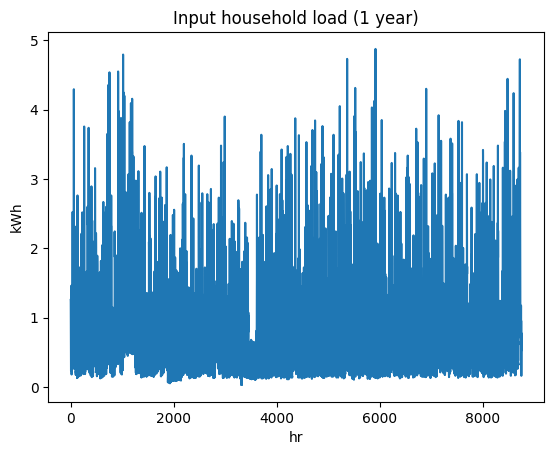

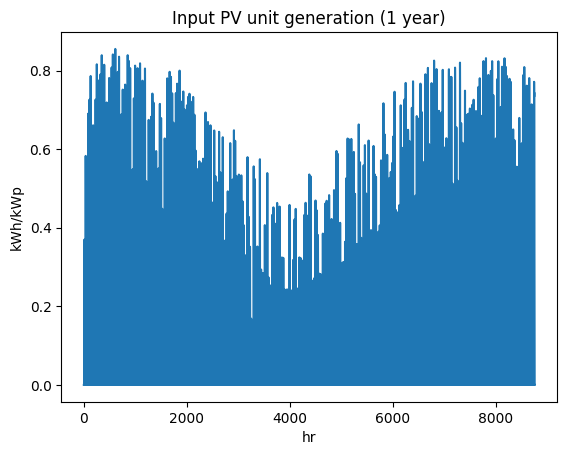

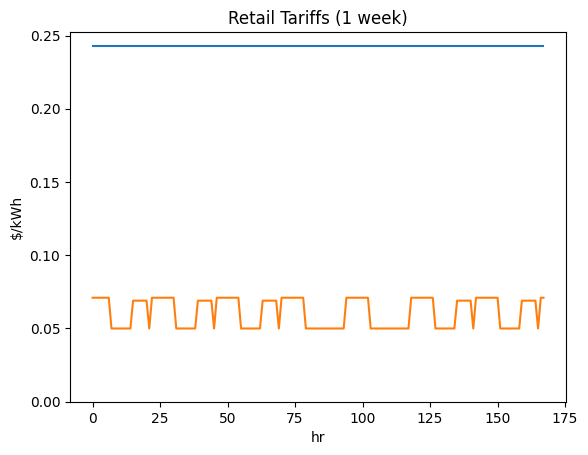

---- Optimising with PV: 1 - 20 kWp, Batt: 0 kWh. Determining PV capacity and dispatch.


************************************ Modell: PV > 1 kWp & BATT > 1 kWh ************************************
{'financial_horizon': 10, 'discount_rate': np.float64(0.06), 'grid_feedin_max': np.float64(5.0), 'pv_eol_capacity': np.float64(0.8), 'pv_eol_years': np.float64(25.0), 'pv_init_soh': np.float64(1.0), 'bess_e2p_ratio': np.float64(2.4), 'bess_roundtrip_eff': np.float64(0.88), 'bess_eol_years': np.float64(10.0), 'bess_eol_capacity': np.float64(0.7), 'bess_eol_cycles': np.float64(10000.0), 'bess_init_soh': np.float64(1.0), 'bess_eff_charge': np.float64(0.938083151964686), 'bess_eff_discharge': np.float64(0.938083151964686), 'scenario_name': 'Scenario_D_+5', 'scenario_set': 'SurfCoast', 'scenario_subset': 'JJP_open', 'year_start': 2022, 'datetime_name': 'DateTime1', 'meter_name': 'pc3012_nmi6785830521', 'solar_name': 'MELB', 'tariff_name_import_wkday': '3_Im_wkday', 'tariff_name_export_wkday': '3_

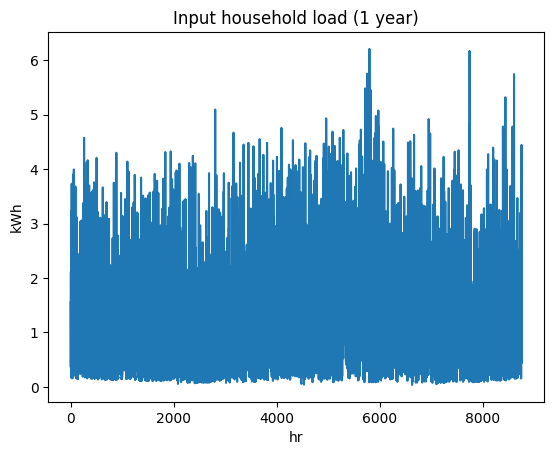

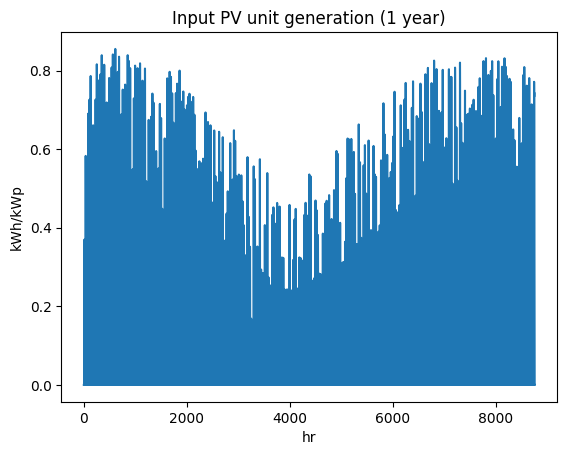

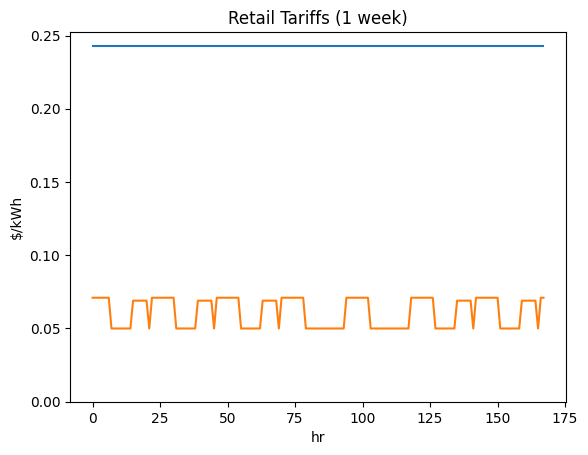

---- Optimising with PV: 1 - 20 kWp, Batt: 0 kWh. Determining PV capacity and dispatch.


************************************ Modell: PV > 1 kWp & BATT > 1 kWh ************************************
{'financial_horizon': 10, 'discount_rate': np.float64(0.06), 'grid_feedin_max': np.float64(5.0), 'pv_eol_capacity': np.float64(0.8), 'pv_eol_years': np.float64(25.0), 'pv_init_soh': np.float64(1.0), 'bess_e2p_ratio': np.float64(2.4), 'bess_roundtrip_eff': np.float64(0.88), 'bess_eol_years': np.float64(10.0), 'bess_eol_capacity': np.float64(0.7), 'bess_eol_cycles': np.float64(10000.0), 'bess_init_soh': np.float64(1.0), 'bess_eff_charge': np.float64(0.938083151964686), 'bess_eff_discharge': np.float64(0.938083151964686), 'scenario_name': 'Scenario_D_+5', 'scenario_set': 'SurfCoast', 'scenario_subset': 'JJP_open', 'year_start': 2022, 'datetime_name': 'DateTime1', 'meter_name': 'pc3032_nmi8266003857', 'solar_name': 'MELB', 'tariff_name_import_wkday': '3_Im_wkday', 'tariff_name_export_wkday': '3_

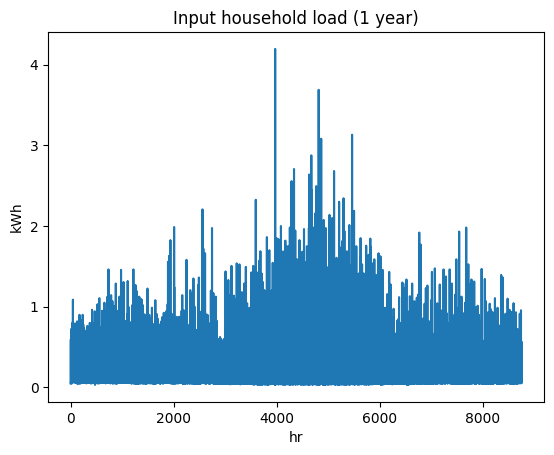

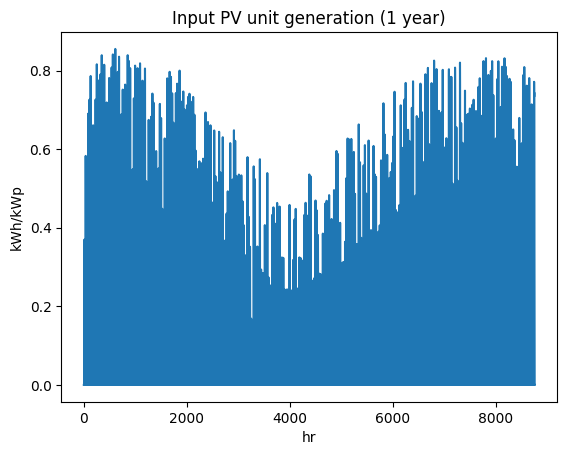

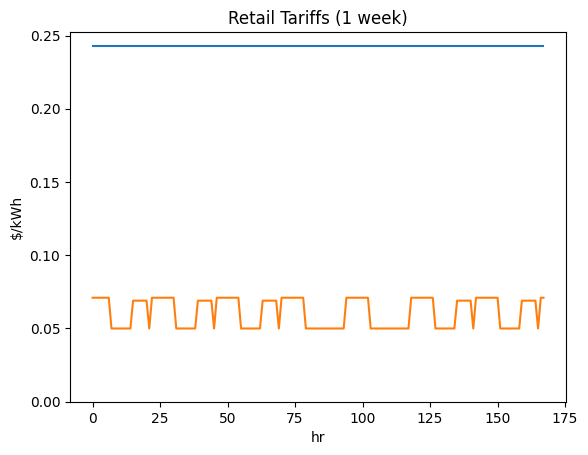

---- Optimising with PV: 1 - 20 kWp, Batt: 0 kWh. Determining PV capacity and dispatch.


************************************ Modell: PV > 1 kWp & BATT > 1 kWh ************************************
{'financial_horizon': 10, 'discount_rate': np.float64(0.06), 'grid_feedin_max': np.float64(5.0), 'pv_eol_capacity': np.float64(0.8), 'pv_eol_years': np.float64(25.0), 'pv_init_soh': np.float64(1.0), 'bess_e2p_ratio': np.float64(2.4), 'bess_roundtrip_eff': np.float64(0.88), 'bess_eol_years': np.float64(10.0), 'bess_eol_capacity': np.float64(0.7), 'bess_eol_cycles': np.float64(10000.0), 'bess_init_soh': np.float64(1.0), 'bess_eff_charge': np.float64(0.938083151964686), 'bess_eff_discharge': np.float64(0.938083151964686), 'scenario_name': 'Scenario_D_+5', 'scenario_set': 'SurfCoast', 'scenario_subset': 'JJP_open', 'year_start': 2022, 'datetime_name': 'DateTime1', 'meter_name': 'pc3032_nmi7947504661', 'solar_name': 'MELB', 'tariff_name_import_wkday': '3_Im_wkday', 'tariff_name_export_wkday': '3_

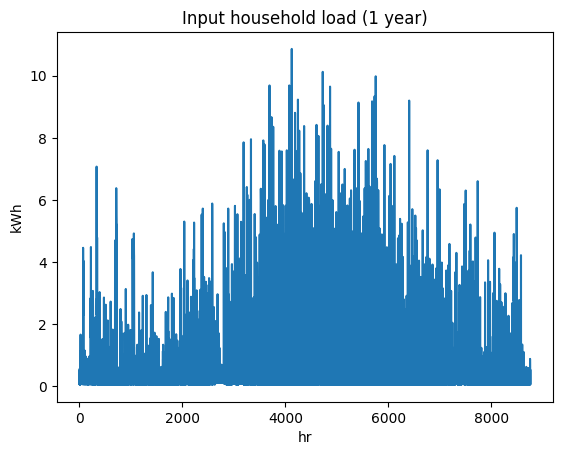

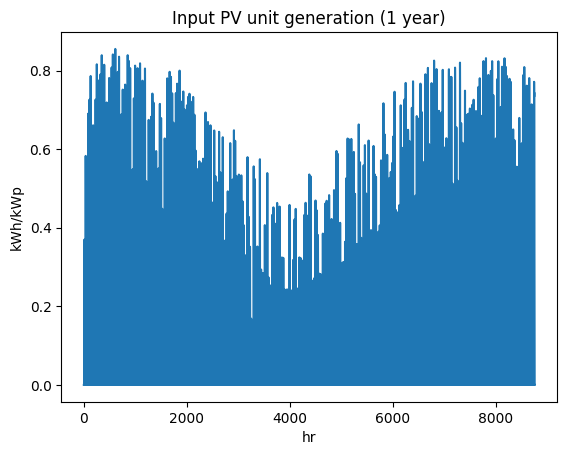

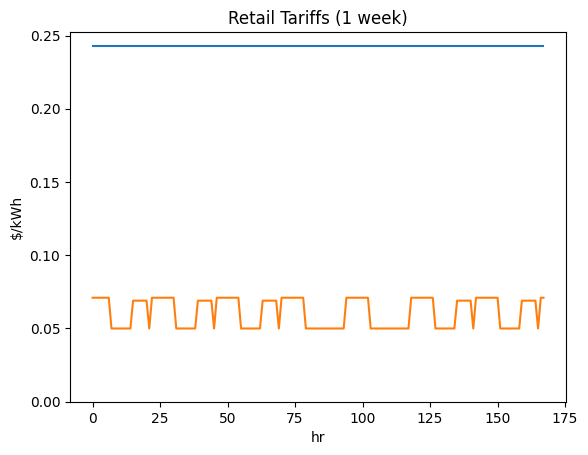

---- Optimising with PV: 1 - 20 kWp, Batt: 0 kWh. Determining PV capacity and dispatch.


************************************ Modell: PV > 1 kWp & BATT > 1 kWh ************************************
{'financial_horizon': 10, 'discount_rate': np.float64(0.06), 'grid_feedin_max': np.float64(5.0), 'pv_eol_capacity': np.float64(0.8), 'pv_eol_years': np.float64(25.0), 'pv_init_soh': np.float64(1.0), 'bess_e2p_ratio': np.float64(2.4), 'bess_roundtrip_eff': np.float64(0.88), 'bess_eol_years': np.float64(10.0), 'bess_eol_capacity': np.float64(0.7), 'bess_eol_cycles': np.float64(10000.0), 'bess_init_soh': np.float64(1.0), 'bess_eff_charge': np.float64(0.938083151964686), 'bess_eff_discharge': np.float64(0.938083151964686), 'scenario_name': 'Scenario_D_+5', 'scenario_set': 'SurfCoast', 'scenario_subset': 'JJP_open', 'year_start': 2022, 'datetime_name': 'DateTime1', 'meter_name': 'pc3032_nmi9916060104', 'solar_name': 'MELB', 'tariff_name_import_wkday': '3_Im_wkday', 'tariff_name_export_wkday': '3_

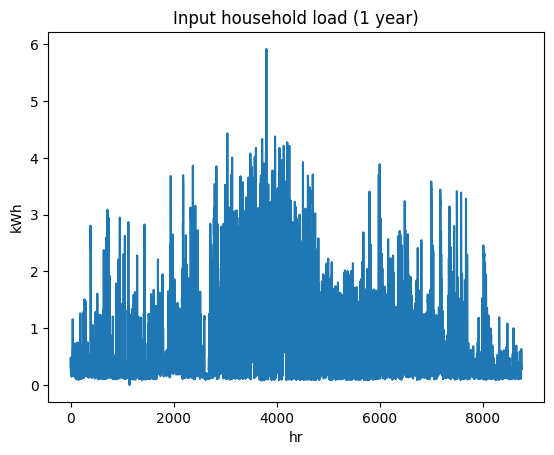

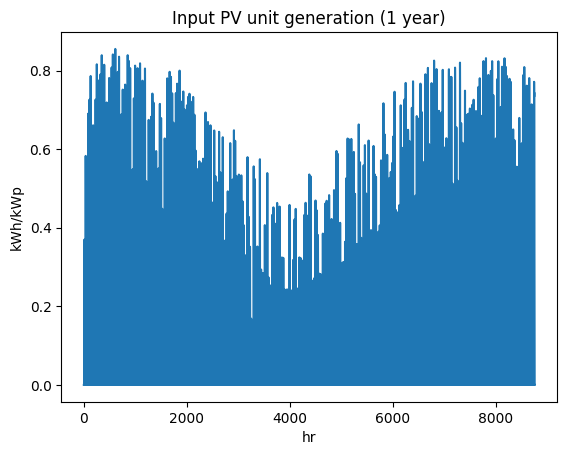

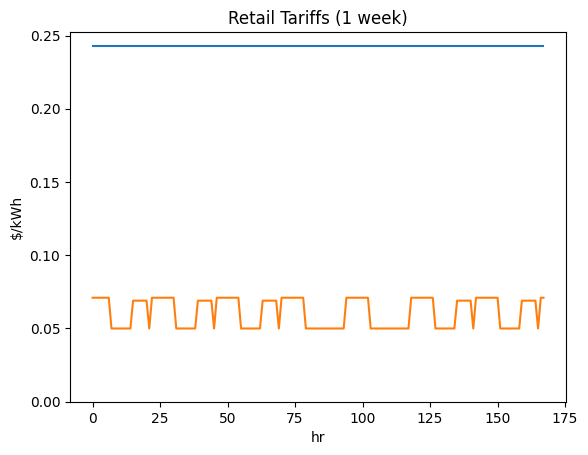

---- Optimising with PV: 1 - 20 kWp, Batt: 0 kWh. Determining PV capacity and dispatch.


************************************ Modell: PV > 1 kWp & BATT > 1 kWh ************************************
{'financial_horizon': 10, 'discount_rate': np.float64(0.06), 'grid_feedin_max': np.float64(5.0), 'pv_eol_capacity': np.float64(0.8), 'pv_eol_years': np.float64(25.0), 'pv_init_soh': np.float64(1.0), 'bess_e2p_ratio': np.float64(2.4), 'bess_roundtrip_eff': np.float64(0.88), 'bess_eol_years': np.float64(10.0), 'bess_eol_capacity': np.float64(0.7), 'bess_eol_cycles': np.float64(10000.0), 'bess_init_soh': np.float64(1.0), 'bess_eff_charge': np.float64(0.938083151964686), 'bess_eff_discharge': np.float64(0.938083151964686), 'scenario_name': 'Scenario_D_+5', 'scenario_set': 'SurfCoast', 'scenario_subset': 'JJP_open', 'year_start': 2022, 'datetime_name': 'DateTime1', 'meter_name': 'pc3084_nmi5778158174', 'solar_name': 'MELB', 'tariff_name_import_wkday': '3_Im_wkday', 'tariff_name_export_wkday': '3_

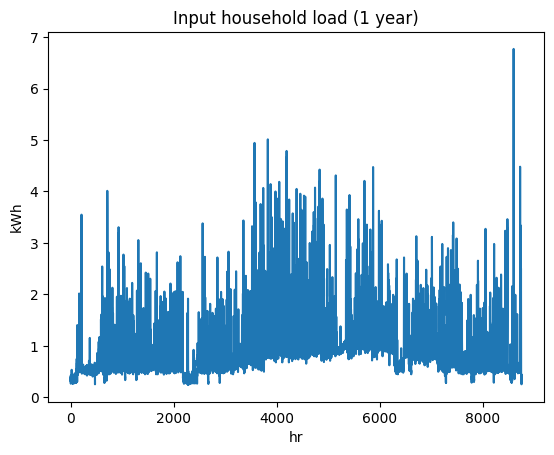

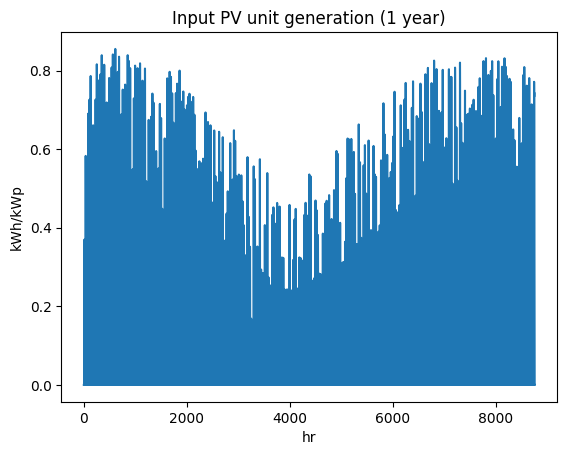

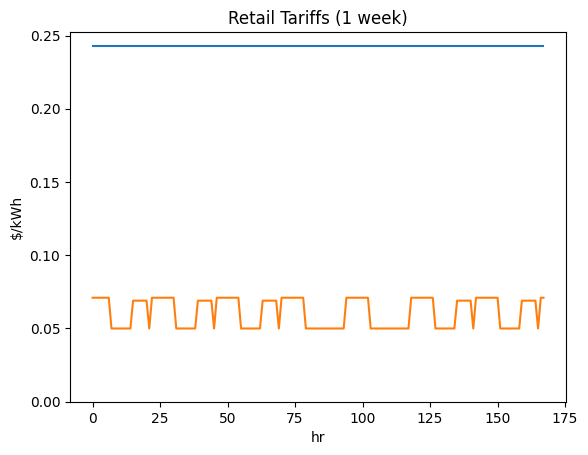

---- Optimising with PV: 1 - 20 kWp, Batt: 0 kWh. Determining PV capacity and dispatch.


************************************ Modell: PV > 1 kWp & BATT > 1 kWh ************************************
{'financial_horizon': 10, 'discount_rate': np.float64(0.06), 'grid_feedin_max': np.float64(5.0), 'pv_eol_capacity': np.float64(0.8), 'pv_eol_years': np.float64(25.0), 'pv_init_soh': np.float64(1.0), 'bess_e2p_ratio': np.float64(2.4), 'bess_roundtrip_eff': np.float64(0.88), 'bess_eol_years': np.float64(10.0), 'bess_eol_capacity': np.float64(0.7), 'bess_eol_cycles': np.float64(10000.0), 'bess_init_soh': np.float64(1.0), 'bess_eff_charge': np.float64(0.938083151964686), 'bess_eff_discharge': np.float64(0.938083151964686), 'scenario_name': 'Scenario_D_+5', 'scenario_set': 'SurfCoast', 'scenario_subset': 'JJP_open', 'year_start': 2022, 'datetime_name': 'DateTime1', 'meter_name': 'pc3032_nmi9923051885', 'solar_name': 'MELB', 'tariff_name_import_wkday': '3_Im_wkday', 'tariff_name_export_wkday': '3_

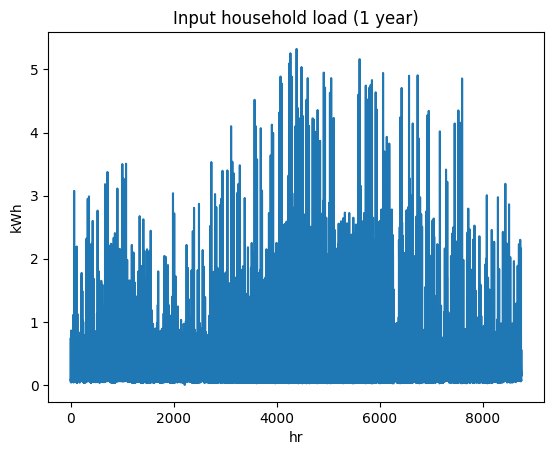

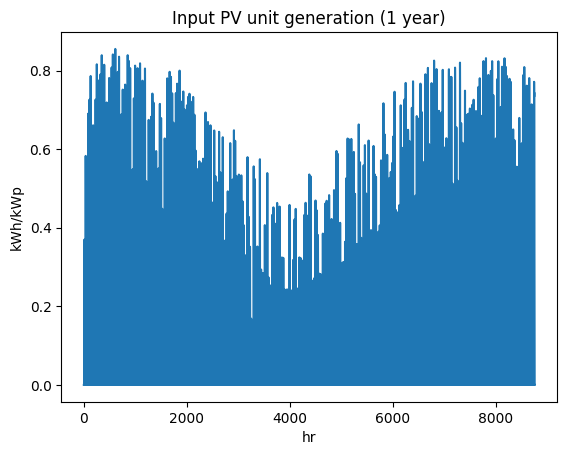

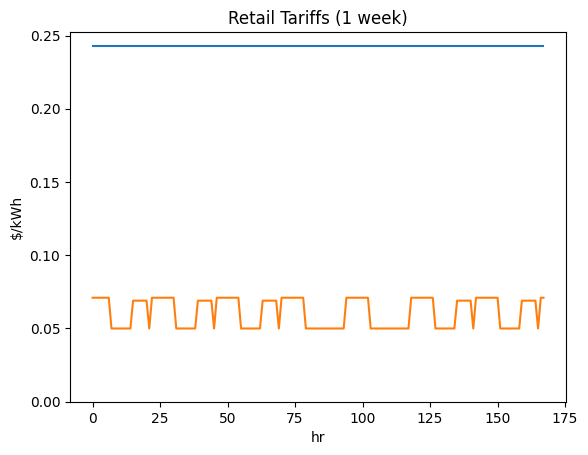

---- Optimising with PV: 1 - 20 kWp, Batt: 0 kWh. Determining PV capacity and dispatch.


************************************ Modell: PV > 1 kWp & BATT > 1 kWh ************************************
{'financial_horizon': 10, 'discount_rate': np.float64(0.06), 'grid_feedin_max': np.float64(5.0), 'pv_eol_capacity': np.float64(0.8), 'pv_eol_years': np.float64(25.0), 'pv_init_soh': np.float64(1.0), 'bess_e2p_ratio': np.float64(2.4), 'bess_roundtrip_eff': np.float64(0.88), 'bess_eol_years': np.float64(10.0), 'bess_eol_capacity': np.float64(0.7), 'bess_eol_cycles': np.float64(10000.0), 'bess_init_soh': np.float64(1.0), 'bess_eff_charge': np.float64(0.938083151964686), 'bess_eff_discharge': np.float64(0.938083151964686), 'scenario_name': 'Scenario_D_+5', 'scenario_set': 'SurfCoast', 'scenario_subset': 'JJP_open', 'year_start': 2022, 'datetime_name': 'DateTime1', 'meter_name': 'pc3072_nmi9341262302', 'solar_name': 'MELB', 'tariff_name_import_wkday': '3_Im_wkday', 'tariff_name_export_wkday': '3_

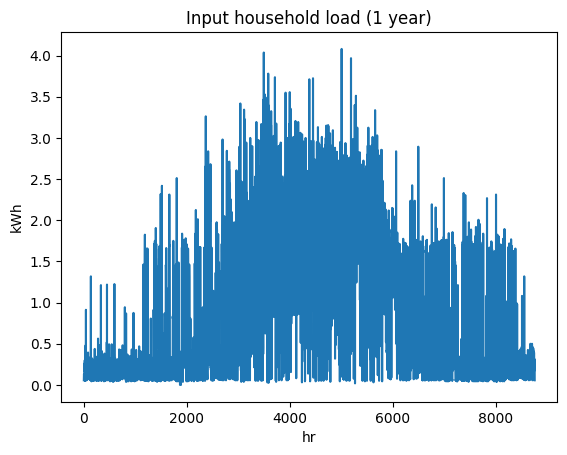

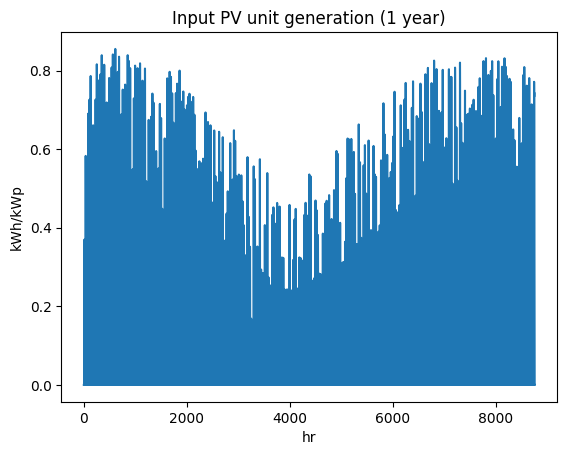

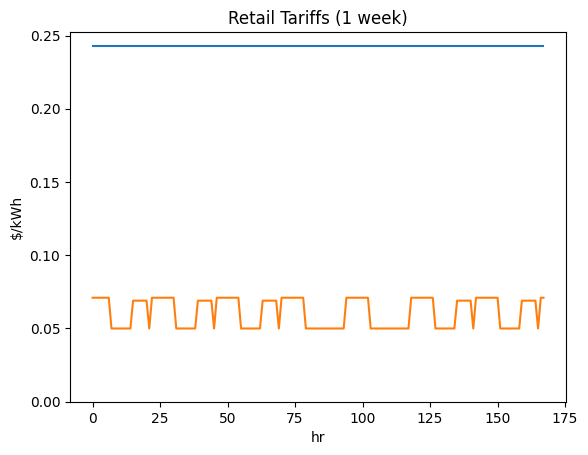

---- Optimising with PV: 1 - 20 kWp, Batt: 0 kWh. Determining PV capacity and dispatch.


************************************ Modell: PV > 1 kWp & BATT > 1 kWh ************************************
{'financial_horizon': 10, 'discount_rate': np.float64(0.06), 'grid_feedin_max': np.float64(5.0), 'pv_eol_capacity': np.float64(0.8), 'pv_eol_years': np.float64(25.0), 'pv_init_soh': np.float64(1.0), 'bess_e2p_ratio': np.float64(2.4), 'bess_roundtrip_eff': np.float64(0.88), 'bess_eol_years': np.float64(10.0), 'bess_eol_capacity': np.float64(0.7), 'bess_eol_cycles': np.float64(10000.0), 'bess_init_soh': np.float64(1.0), 'bess_eff_charge': np.float64(0.938083151964686), 'bess_eff_discharge': np.float64(0.938083151964686), 'scenario_name': 'Scenario_D_+5', 'scenario_set': 'SurfCoast', 'scenario_subset': 'JJP_open', 'year_start': 2022, 'datetime_name': 'DateTime1', 'meter_name': 'pc3072_nmi8482696248', 'solar_name': 'MELB', 'tariff_name_import_wkday': '3_Im_wkday', 'tariff_name_export_wkday': '3_

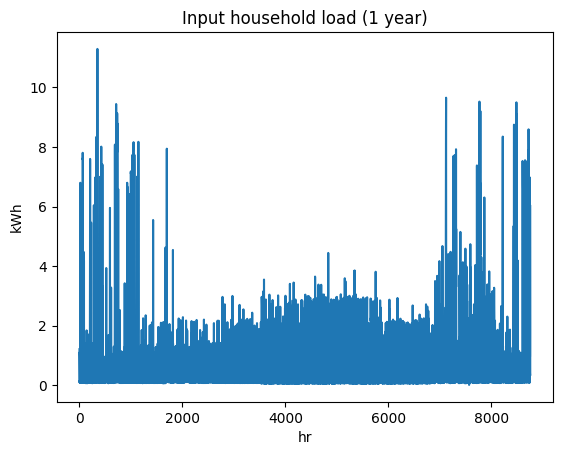

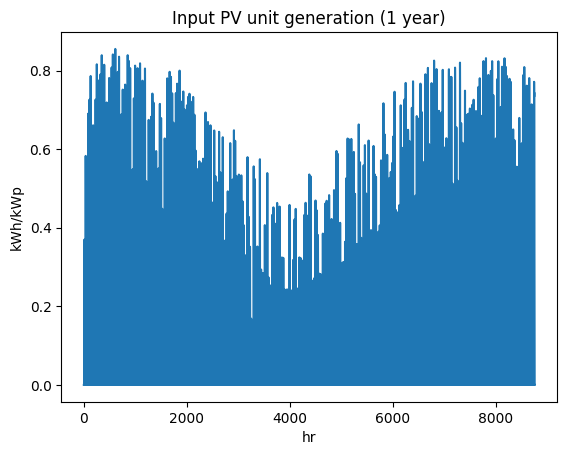

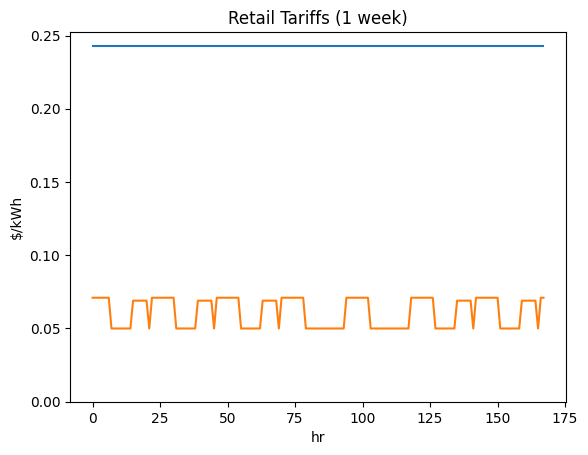

---- Optimising with PV: 1 - 20 kWp, Batt: 0 kWh. Determining PV capacity and dispatch.


************************************ Modell: PV > 1 kWp & BATT > 1 kWh ************************************
{'financial_horizon': 10, 'discount_rate': np.float64(0.06), 'grid_feedin_max': np.float64(5.0), 'pv_eol_capacity': np.float64(0.8), 'pv_eol_years': np.float64(25.0), 'pv_init_soh': np.float64(1.0), 'bess_e2p_ratio': np.float64(2.4), 'bess_roundtrip_eff': np.float64(0.88), 'bess_eol_years': np.float64(10.0), 'bess_eol_capacity': np.float64(0.7), 'bess_eol_cycles': np.float64(10000.0), 'bess_init_soh': np.float64(1.0), 'bess_eff_charge': np.float64(0.938083151964686), 'bess_eff_discharge': np.float64(0.938083151964686), 'scenario_name': 'Scenario_D_+5', 'scenario_set': 'SurfCoast', 'scenario_subset': 'JJP_open', 'year_start': 2022, 'datetime_name': 'DateTime1', 'meter_name': 'pc3032_nmi6143670933', 'solar_name': 'MELB', 'tariff_name_import_wkday': '3_Im_wkday', 'tariff_name_export_wkday': '3_

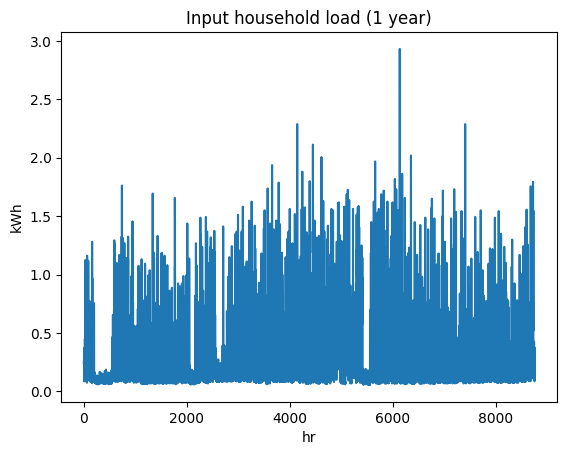

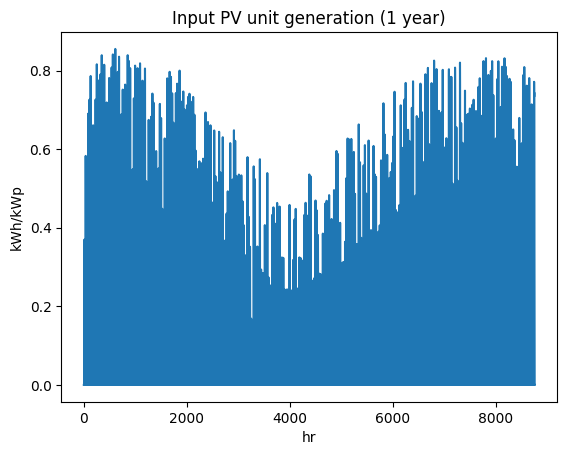

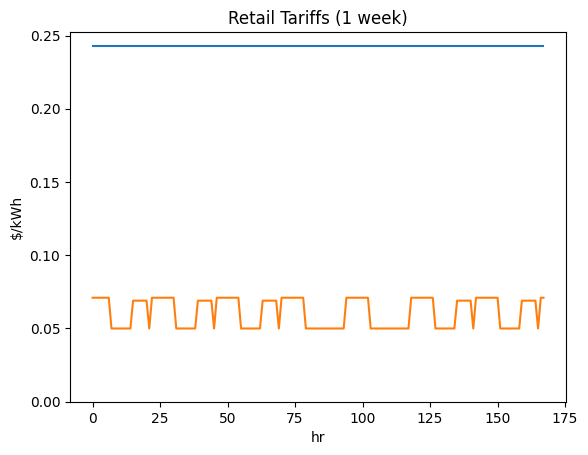

---- Optimising with PV: 1 - 20 kWp, Batt: 0 kWh. Determining PV capacity and dispatch.


************************************ Modell: PV > 1 kWp & BATT > 1 kWh ************************************
{'financial_horizon': 10, 'discount_rate': np.float64(0.06), 'grid_feedin_max': np.float64(5.0), 'pv_eol_capacity': np.float64(0.8), 'pv_eol_years': np.float64(25.0), 'pv_init_soh': np.float64(1.0), 'bess_e2p_ratio': np.float64(2.4), 'bess_roundtrip_eff': np.float64(0.88), 'bess_eol_years': np.float64(10.0), 'bess_eol_capacity': np.float64(0.7), 'bess_eol_cycles': np.float64(10000.0), 'bess_init_soh': np.float64(1.0), 'bess_eff_charge': np.float64(0.938083151964686), 'bess_eff_discharge': np.float64(0.938083151964686), 'scenario_name': 'Scenario_D_+5', 'scenario_set': 'SurfCoast', 'scenario_subset': 'JJP_open', 'year_start': 2022, 'datetime_name': 'DateTime1', 'meter_name': 'pc3079_nmi1519648904', 'solar_name': 'MELB', 'tariff_name_import_wkday': '3_Im_wkday', 'tariff_name_export_wkday': '3_

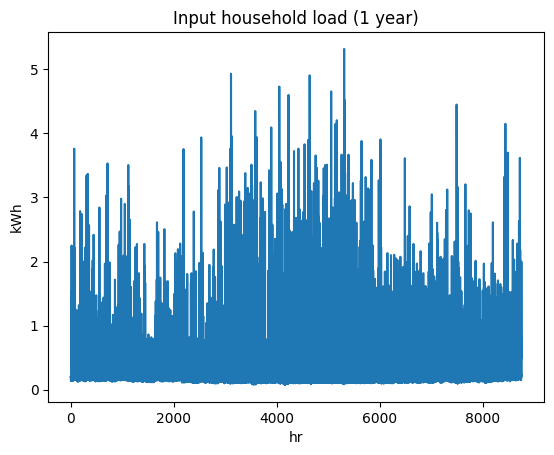

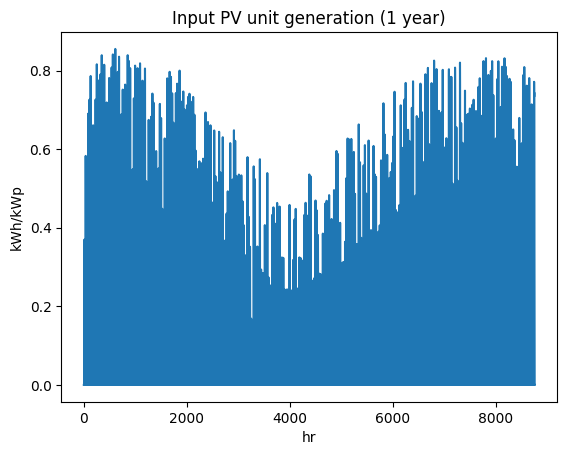

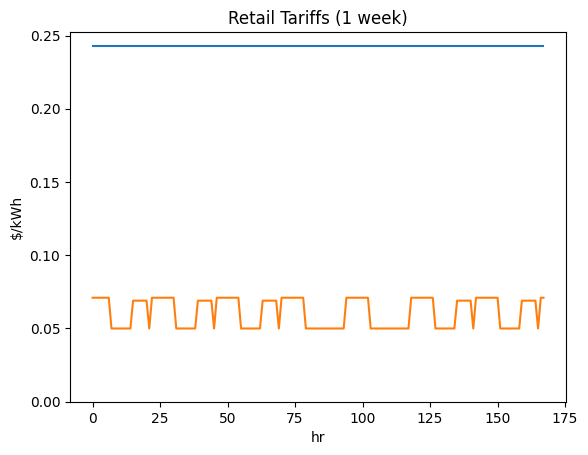

---- Optimising with PV: 1 - 20 kWp, Batt: 0 kWh. Determining PV capacity and dispatch.


************************************ Modell: PV > 1 kWp & BATT > 1 kWh ************************************
{'financial_horizon': 10, 'discount_rate': np.float64(0.06), 'grid_feedin_max': np.float64(5.0), 'pv_eol_capacity': np.float64(0.8), 'pv_eol_years': np.float64(25.0), 'pv_init_soh': np.float64(1.0), 'bess_e2p_ratio': np.float64(2.4), 'bess_roundtrip_eff': np.float64(0.88), 'bess_eol_years': np.float64(10.0), 'bess_eol_capacity': np.float64(0.7), 'bess_eol_cycles': np.float64(10000.0), 'bess_init_soh': np.float64(1.0), 'bess_eff_charge': np.float64(0.938083151964686), 'bess_eff_discharge': np.float64(0.938083151964686), 'scenario_name': 'Scenario_D_+5', 'scenario_set': 'SurfCoast', 'scenario_subset': 'JJP_open', 'year_start': 2022, 'datetime_name': 'DateTime1', 'meter_name': 'pc3032_nmi1399566785', 'solar_name': 'MELB', 'tariff_name_import_wkday': '3_Im_wkday', 'tariff_name_export_wkday': '3_

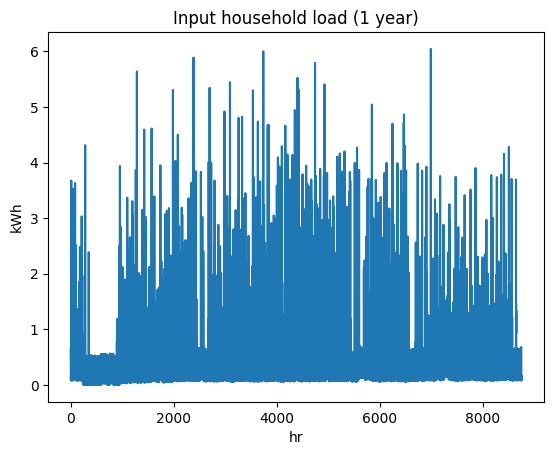

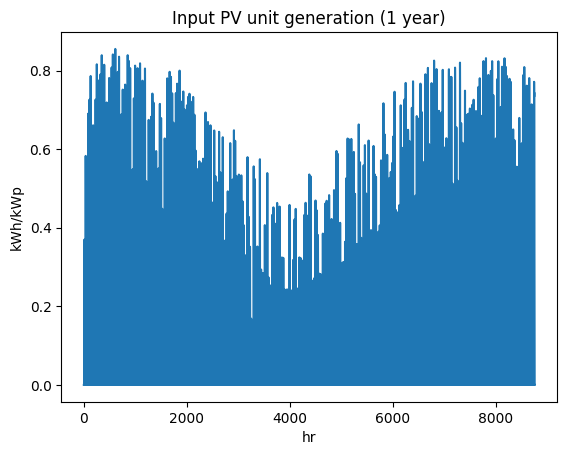

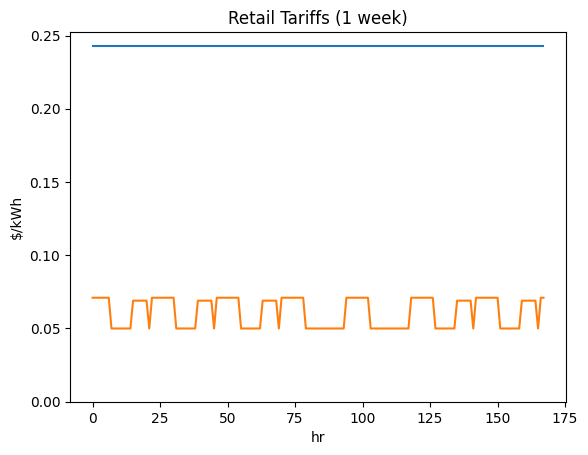

---- Optimising with PV: 1 - 20 kWp, Batt: 0 kWh. Determining PV capacity and dispatch.


************************************ Modell: PV > 1 kWp & BATT > 1 kWh ************************************
{'financial_horizon': 10, 'discount_rate': np.float64(0.06), 'grid_feedin_max': np.float64(5.0), 'pv_eol_capacity': np.float64(0.8), 'pv_eol_years': np.float64(25.0), 'pv_init_soh': np.float64(1.0), 'bess_e2p_ratio': np.float64(2.4), 'bess_roundtrip_eff': np.float64(0.88), 'bess_eol_years': np.float64(10.0), 'bess_eol_capacity': np.float64(0.7), 'bess_eol_cycles': np.float64(10000.0), 'bess_init_soh': np.float64(1.0), 'bess_eff_charge': np.float64(0.938083151964686), 'bess_eff_discharge': np.float64(0.938083151964686), 'scenario_name': 'Scenario_D_+5', 'scenario_set': 'SurfCoast', 'scenario_subset': 'JJP_open', 'year_start': 2022, 'datetime_name': 'DateTime1', 'meter_name': 'pc3032_nmi7247175309', 'solar_name': 'MELB', 'tariff_name_import_wkday': '3_Im_wkday', 'tariff_name_export_wkday': '3_

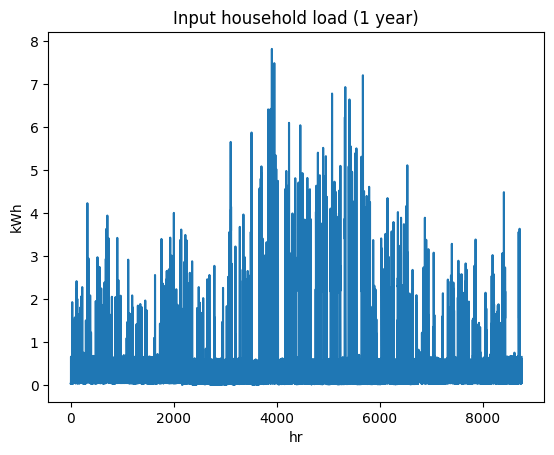

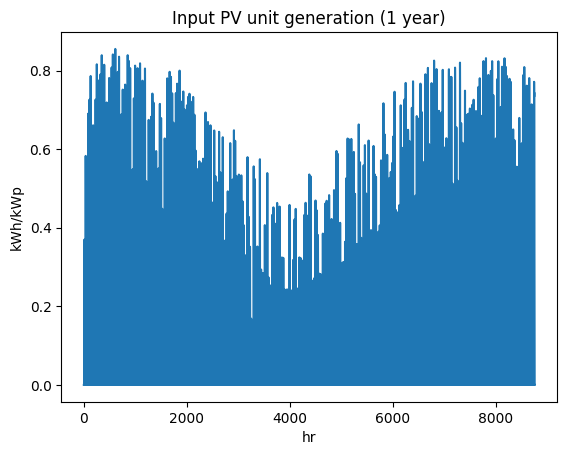

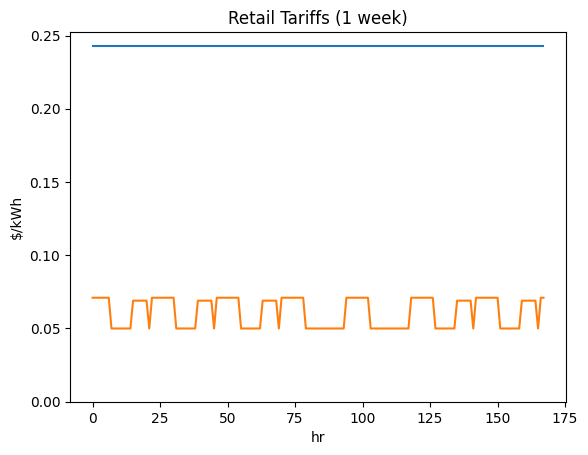

---- Optimising with PV: 1 - 20 kWp, Batt: 0 kWh. Determining PV capacity and dispatch.


************************************ Modell: PV > 1 kWp & BATT > 1 kWh ************************************
{'financial_horizon': 10, 'discount_rate': np.float64(0.06), 'grid_feedin_max': np.float64(5.0), 'pv_eol_capacity': np.float64(0.8), 'pv_eol_years': np.float64(25.0), 'pv_init_soh': np.float64(1.0), 'bess_e2p_ratio': np.float64(2.4), 'bess_roundtrip_eff': np.float64(0.88), 'bess_eol_years': np.float64(10.0), 'bess_eol_capacity': np.float64(0.7), 'bess_eol_cycles': np.float64(10000.0), 'bess_init_soh': np.float64(1.0), 'bess_eff_charge': np.float64(0.938083151964686), 'bess_eff_discharge': np.float64(0.938083151964686), 'scenario_name': 'Scenario_D_+5', 'scenario_set': 'SurfCoast', 'scenario_subset': 'JJP_open', 'year_start': 2022, 'datetime_name': 'DateTime1', 'meter_name': 'pc3032_nmi6843646645', 'solar_name': 'MELB', 'tariff_name_import_wkday': '3_Im_wkday', 'tariff_name_export_wkday': '3_

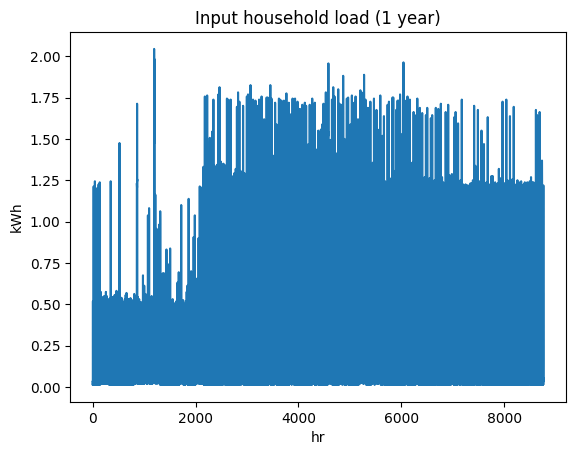

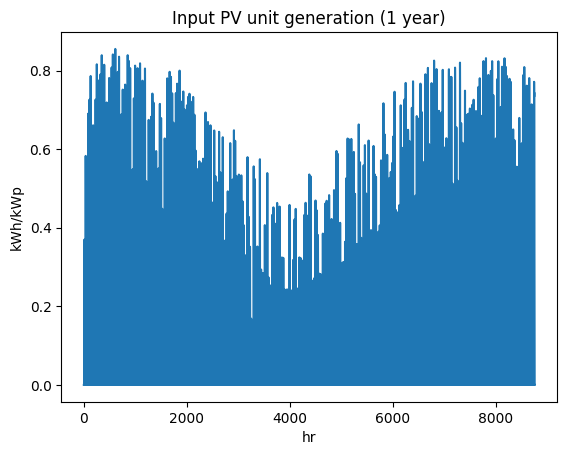

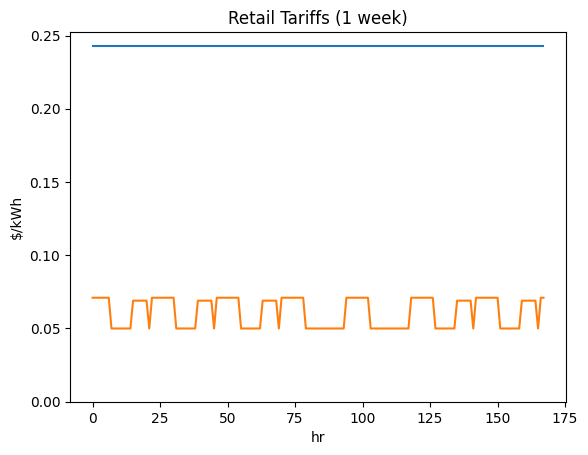

---- Optimising with PV: 1 - 20 kWp, Batt: 0 kWh. Determining PV capacity and dispatch.


************************************ Modell: PV > 1 kWp & BATT > 1 kWh ************************************
{'financial_horizon': 10, 'discount_rate': np.float64(0.06), 'grid_feedin_max': np.float64(5.0), 'pv_eol_capacity': np.float64(0.8), 'pv_eol_years': np.float64(25.0), 'pv_init_soh': np.float64(1.0), 'bess_e2p_ratio': np.float64(2.4), 'bess_roundtrip_eff': np.float64(0.88), 'bess_eol_years': np.float64(10.0), 'bess_eol_capacity': np.float64(0.7), 'bess_eol_cycles': np.float64(10000.0), 'bess_init_soh': np.float64(1.0), 'bess_eff_charge': np.float64(0.938083151964686), 'bess_eff_discharge': np.float64(0.938083151964686), 'scenario_name': 'Scenario_D_+5', 'scenario_set': 'SurfCoast', 'scenario_subset': 'JJP_open', 'year_start': 2022, 'datetime_name': 'DateTime1', 'meter_name': 'pc3032_nmi1624764602', 'solar_name': 'MELB', 'tariff_name_import_wkday': '3_Im_wkday', 'tariff_name_export_wkday': '3_

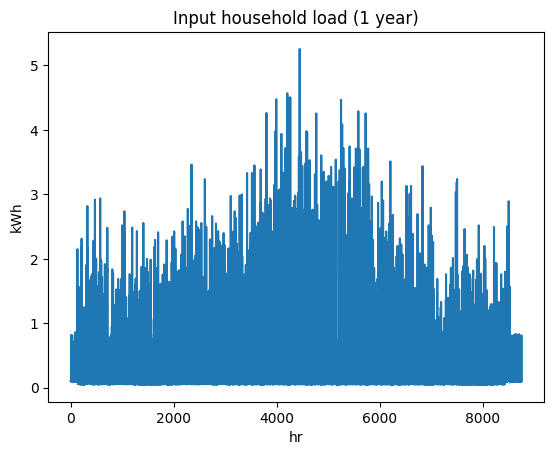

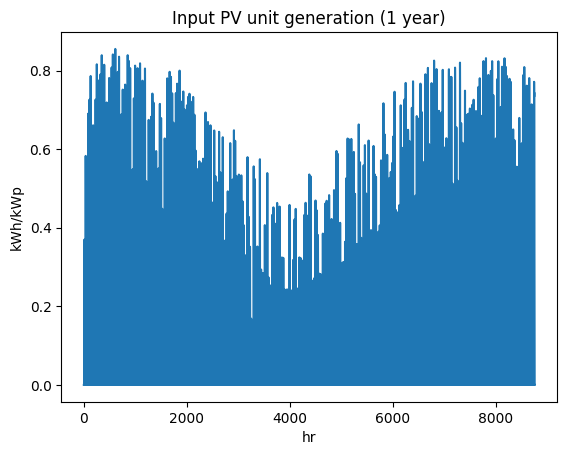

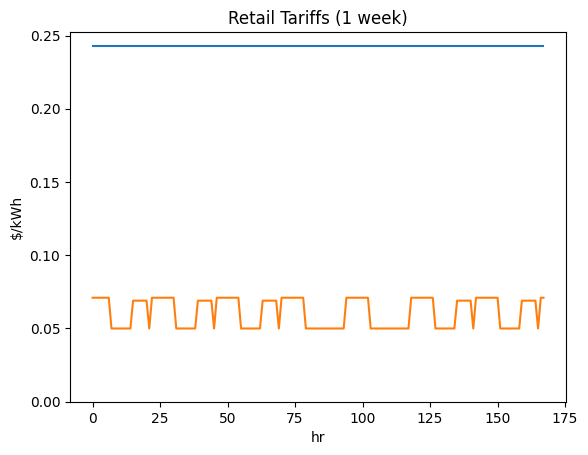

---- Optimising with PV: 1 - 20 kWp, Batt: 0 kWh. Determining PV capacity and dispatch.


************************************ Modell: PV > 1 kWp & BATT > 1 kWh ************************************
{'financial_horizon': 10, 'discount_rate': np.float64(0.06), 'grid_feedin_max': np.float64(5.0), 'pv_eol_capacity': np.float64(0.8), 'pv_eol_years': np.float64(25.0), 'pv_init_soh': np.float64(1.0), 'bess_e2p_ratio': np.float64(2.4), 'bess_roundtrip_eff': np.float64(0.88), 'bess_eol_years': np.float64(10.0), 'bess_eol_capacity': np.float64(0.7), 'bess_eol_cycles': np.float64(10000.0), 'bess_init_soh': np.float64(1.0), 'bess_eff_charge': np.float64(0.938083151964686), 'bess_eff_discharge': np.float64(0.938083151964686), 'scenario_name': 'Scenario_D_+5', 'scenario_set': 'SurfCoast', 'scenario_subset': 'JJP_open', 'year_start': 2022, 'datetime_name': 'DateTime1', 'meter_name': 'pc3031_nmi3447115587', 'solar_name': 'MELB', 'tariff_name_import_wkday': '3_Im_wkday', 'tariff_name_export_wkday': '3_

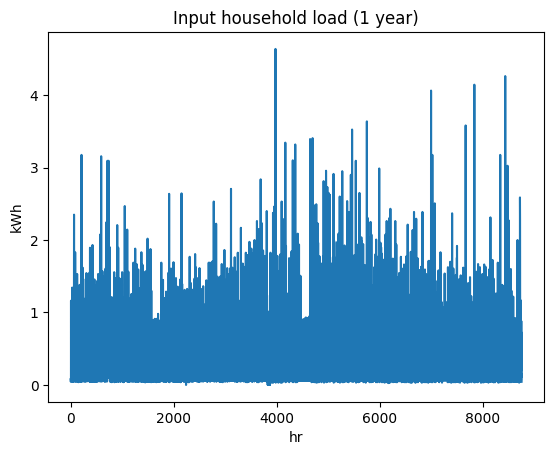

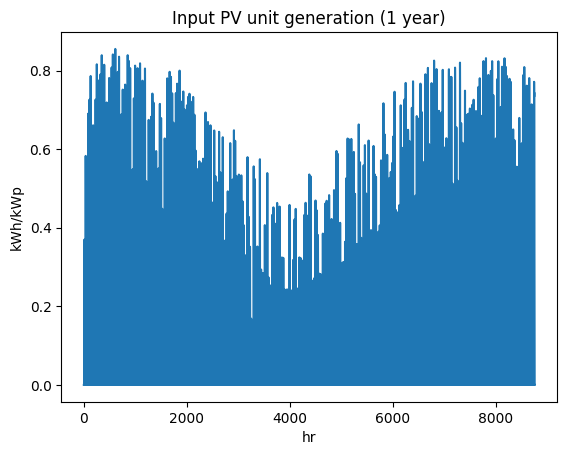

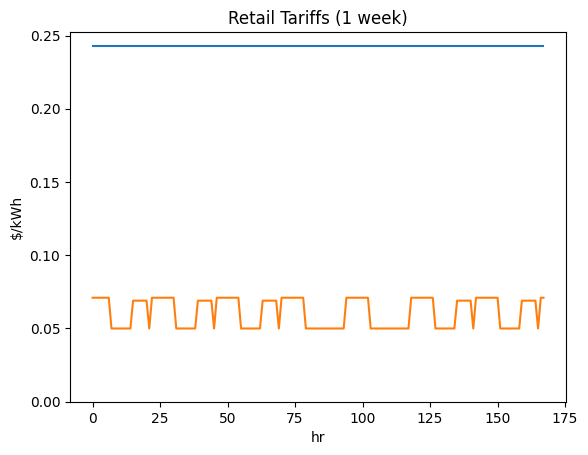

---- Optimising with PV: 1 - 20 kWp, Batt: 0 kWh. Determining PV capacity and dispatch.


************************************ Modell: PV > 1 kWp & BATT > 1 kWh ************************************
{'financial_horizon': 10, 'discount_rate': np.float64(0.06), 'grid_feedin_max': np.float64(5.0), 'pv_eol_capacity': np.float64(0.8), 'pv_eol_years': np.float64(25.0), 'pv_init_soh': np.float64(1.0), 'bess_e2p_ratio': np.float64(2.4), 'bess_roundtrip_eff': np.float64(0.88), 'bess_eol_years': np.float64(10.0), 'bess_eol_capacity': np.float64(0.7), 'bess_eol_cycles': np.float64(10000.0), 'bess_init_soh': np.float64(1.0), 'bess_eff_charge': np.float64(0.938083151964686), 'bess_eff_discharge': np.float64(0.938083151964686), 'scenario_name': 'Scenario_D_+5', 'scenario_set': 'SurfCoast', 'scenario_subset': 'JJP_open', 'year_start': 2022, 'datetime_name': 'DateTime1', 'meter_name': 'pc3031_nmi1892201962', 'solar_name': 'MELB', 'tariff_name_import_wkday': '3_Im_wkday', 'tariff_name_export_wkday': '3_

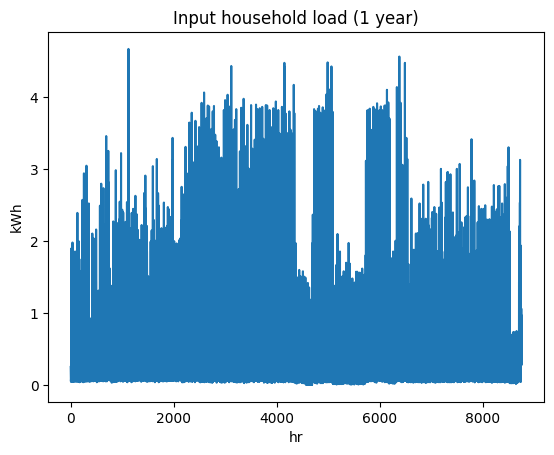

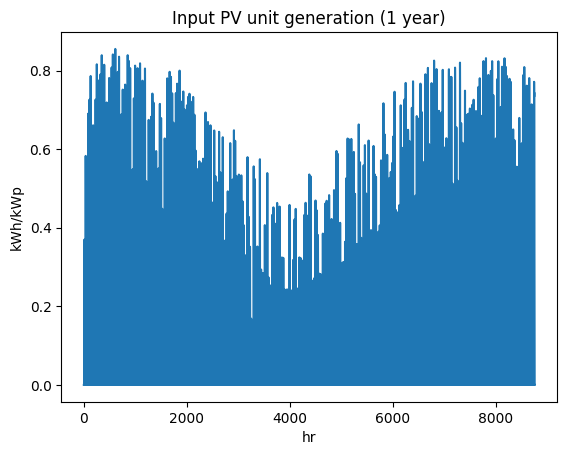

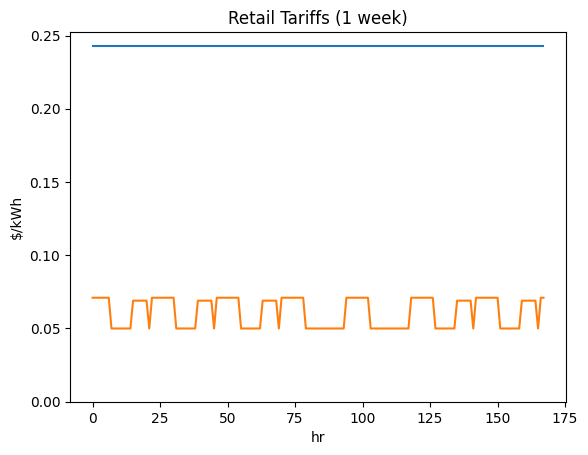

---- Optimising with PV: 1 - 20 kWp, Batt: 0 kWh. Determining PV capacity and dispatch.


************************************ Modell: PV > 1 kWp & BATT > 1 kWh ************************************
{'financial_horizon': 10, 'discount_rate': np.float64(0.06), 'grid_feedin_max': np.float64(5.0), 'pv_eol_capacity': np.float64(0.8), 'pv_eol_years': np.float64(25.0), 'pv_init_soh': np.float64(1.0), 'bess_e2p_ratio': np.float64(2.4), 'bess_roundtrip_eff': np.float64(0.88), 'bess_eol_years': np.float64(10.0), 'bess_eol_capacity': np.float64(0.7), 'bess_eol_cycles': np.float64(10000.0), 'bess_init_soh': np.float64(1.0), 'bess_eff_charge': np.float64(0.938083151964686), 'bess_eff_discharge': np.float64(0.938083151964686), 'scenario_name': 'Scenario_D_+5', 'scenario_set': 'SurfCoast', 'scenario_subset': 'JJP_open', 'year_start': 2022, 'datetime_name': 'DateTime1', 'meter_name': 'pc3031_nmi4076947444', 'solar_name': 'MELB', 'tariff_name_import_wkday': '3_Im_wkday', 'tariff_name_export_wkday': '3_

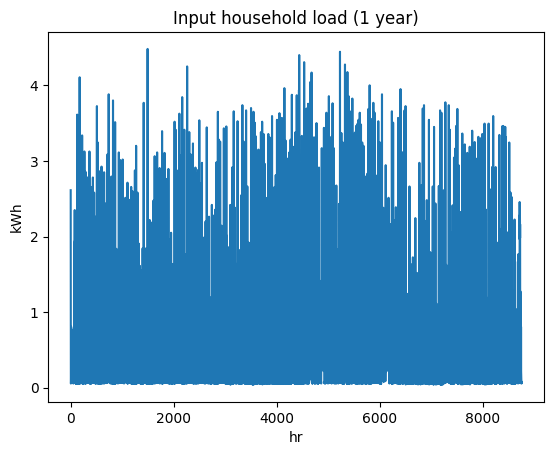

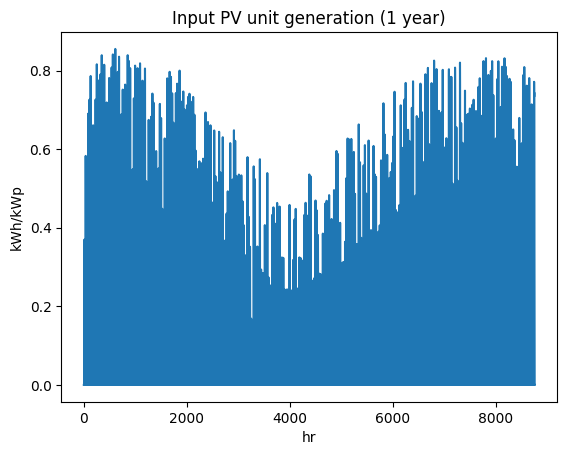

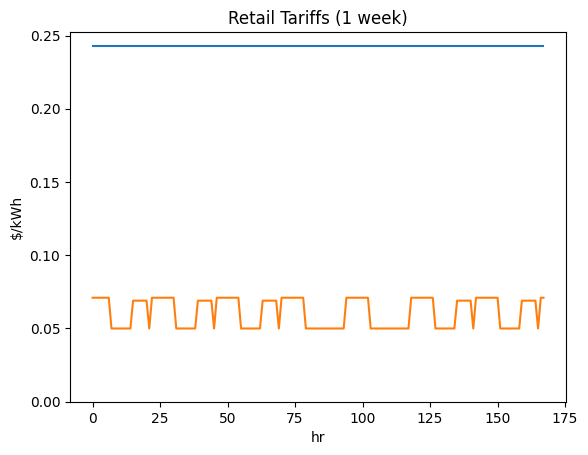

---- Optimising with PV: 1 - 20 kWp, Batt: 0 kWh. Determining PV capacity and dispatch.


************************************ Modell: PV > 1 kWp & BATT > 1 kWh ************************************
{'financial_horizon': 10, 'discount_rate': np.float64(0.06), 'grid_feedin_max': np.float64(5.0), 'pv_eol_capacity': np.float64(0.8), 'pv_eol_years': np.float64(25.0), 'pv_init_soh': np.float64(1.0), 'bess_e2p_ratio': np.float64(2.4), 'bess_roundtrip_eff': np.float64(0.88), 'bess_eol_years': np.float64(10.0), 'bess_eol_capacity': np.float64(0.7), 'bess_eol_cycles': np.float64(10000.0), 'bess_init_soh': np.float64(1.0), 'bess_eff_charge': np.float64(0.938083151964686), 'bess_eff_discharge': np.float64(0.938083151964686), 'scenario_name': 'Scenario_D_+5', 'scenario_set': 'SurfCoast', 'scenario_subset': 'JJP_open', 'year_start': 2022, 'datetime_name': 'DateTime1', 'meter_name': 'pc3031_nmi4147424102', 'solar_name': 'MELB', 'tariff_name_import_wkday': '3_Im_wkday', 'tariff_name_export_wkday': '3_

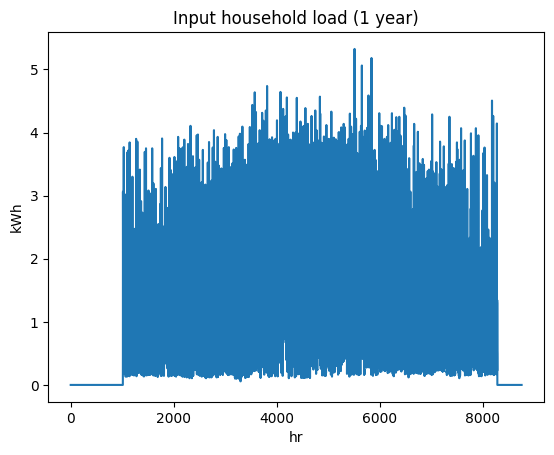

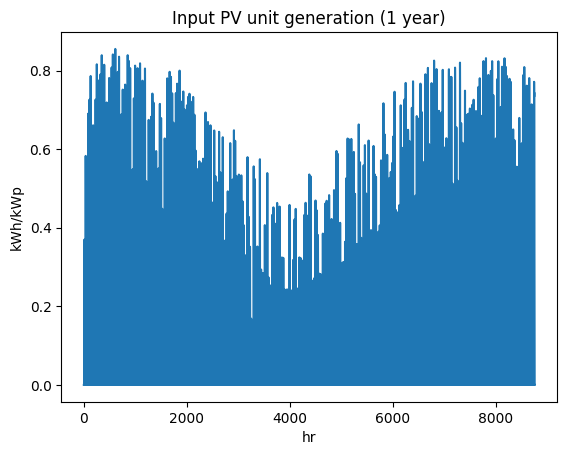

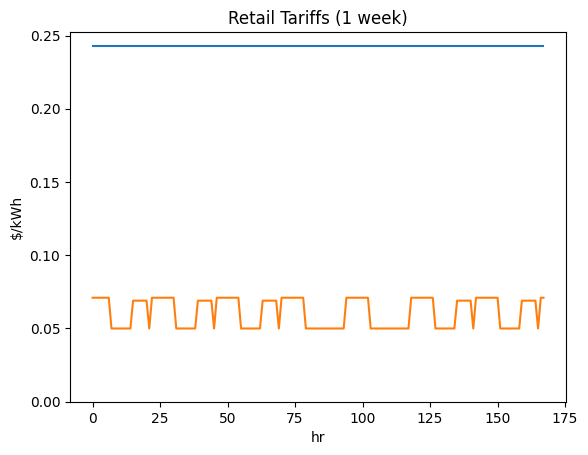

---- Optimising with PV: 1 - 20 kWp, Batt: 0 kWh. Determining PV capacity and dispatch.


************************************ Modell: PV > 1 kWp & BATT > 1 kWh ************************************
{'financial_horizon': 10, 'discount_rate': np.float64(0.06), 'grid_feedin_max': np.float64(5.0), 'pv_eol_capacity': np.float64(0.8), 'pv_eol_years': np.float64(25.0), 'pv_init_soh': np.float64(1.0), 'bess_e2p_ratio': np.float64(2.4), 'bess_roundtrip_eff': np.float64(0.88), 'bess_eol_years': np.float64(10.0), 'bess_eol_capacity': np.float64(0.7), 'bess_eol_cycles': np.float64(10000.0), 'bess_init_soh': np.float64(1.0), 'bess_eff_charge': np.float64(0.938083151964686), 'bess_eff_discharge': np.float64(0.938083151964686), 'scenario_name': 'Scenario_D_+5', 'scenario_set': 'SurfCoast', 'scenario_subset': 'JJP_open', 'year_start': 2022, 'datetime_name': 'DateTime1', 'meter_name': 'pc3031_nmi9607836337', 'solar_name': 'MELB', 'tariff_name_import_wkday': '3_Im_wkday', 'tariff_name_export_wkday': '3_

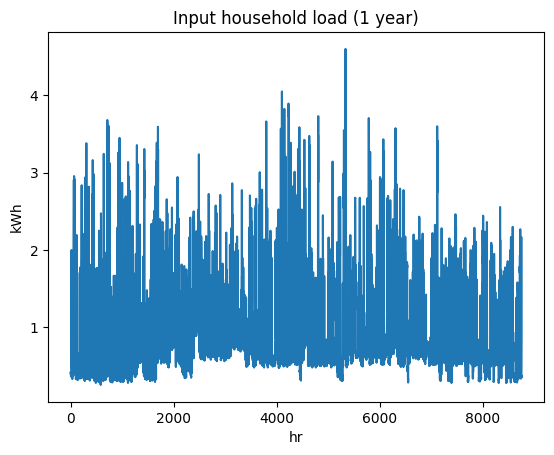

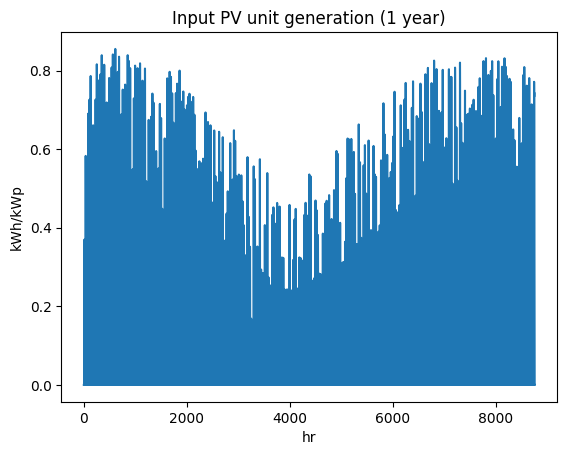

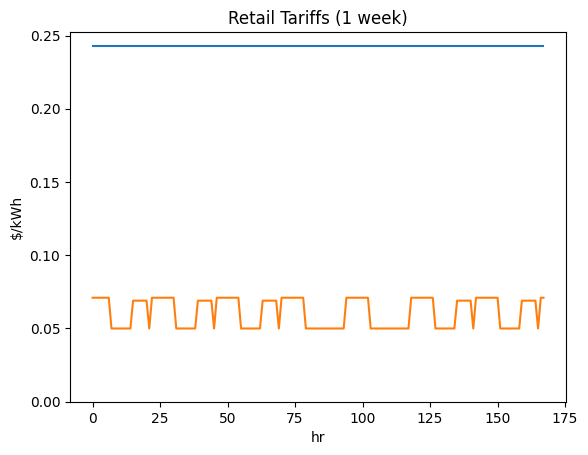

---- Optimising with PV: 1 - 20 kWp, Batt: 0 kWh. Determining PV capacity and dispatch.


************************************ Modell: PV > 1 kWp & BATT > 1 kWh ************************************
{'financial_horizon': 10, 'discount_rate': np.float64(0.06), 'grid_feedin_max': np.float64(5.0), 'pv_eol_capacity': np.float64(0.8), 'pv_eol_years': np.float64(25.0), 'pv_init_soh': np.float64(1.0), 'bess_e2p_ratio': np.float64(2.4), 'bess_roundtrip_eff': np.float64(0.88), 'bess_eol_years': np.float64(10.0), 'bess_eol_capacity': np.float64(0.7), 'bess_eol_cycles': np.float64(10000.0), 'bess_init_soh': np.float64(1.0), 'bess_eff_charge': np.float64(0.938083151964686), 'bess_eff_discharge': np.float64(0.938083151964686), 'scenario_name': 'Scenario_D_+5', 'scenario_set': 'SurfCoast', 'scenario_subset': 'JJP_open', 'year_start': 2022, 'datetime_name': 'DateTime1', 'meter_name': 'pc3012_nmi5825177046', 'solar_name': 'MELB', 'tariff_name_import_wkday': '3_Im_wkday', 'tariff_name_export_wkday': '3_

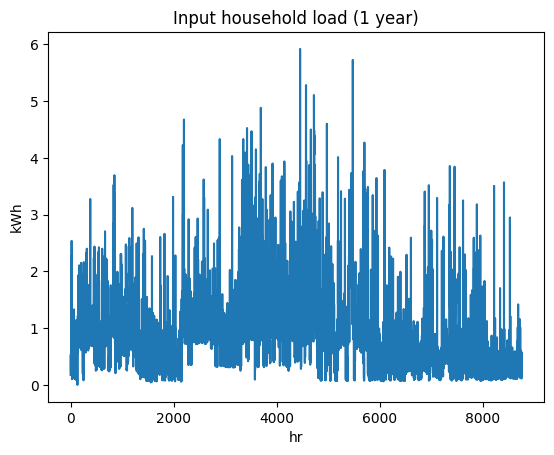

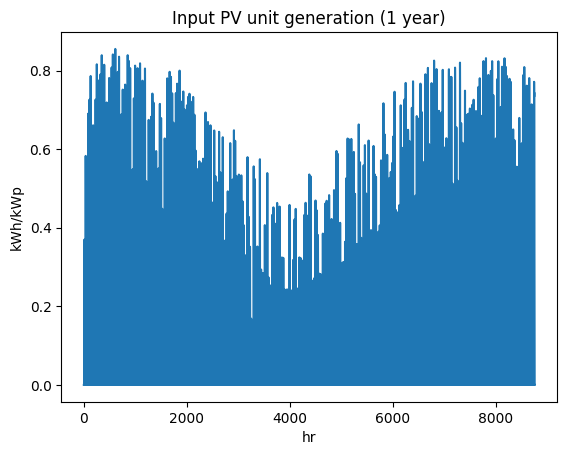

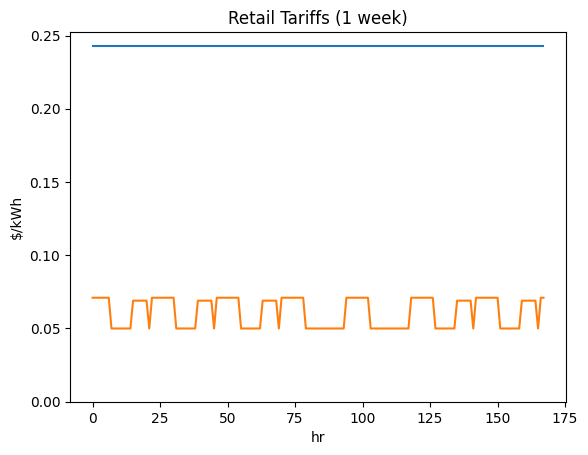

---- Optimising with PV: 1 - 20 kWp, Batt: 0 kWh. Determining PV capacity and dispatch.


************************************ Modell: PV > 1 kWp & BATT > 1 kWh ************************************
{'financial_horizon': 10, 'discount_rate': np.float64(0.06), 'grid_feedin_max': np.float64(5.0), 'pv_eol_capacity': np.float64(0.8), 'pv_eol_years': np.float64(25.0), 'pv_init_soh': np.float64(1.0), 'bess_e2p_ratio': np.float64(2.4), 'bess_roundtrip_eff': np.float64(0.88), 'bess_eol_years': np.float64(10.0), 'bess_eol_capacity': np.float64(0.7), 'bess_eol_cycles': np.float64(10000.0), 'bess_init_soh': np.float64(1.0), 'bess_eff_charge': np.float64(0.938083151964686), 'bess_eff_discharge': np.float64(0.938083151964686), 'scenario_name': 'Scenario_D_+5', 'scenario_set': 'SurfCoast', 'scenario_subset': 'JJP_open', 'year_start': 2022, 'datetime_name': 'DateTime1', 'meter_name': 'pc3012_nmi5006620443', 'solar_name': 'MELB', 'tariff_name_import_wkday': '3_Im_wkday', 'tariff_name_export_wkday': '3_

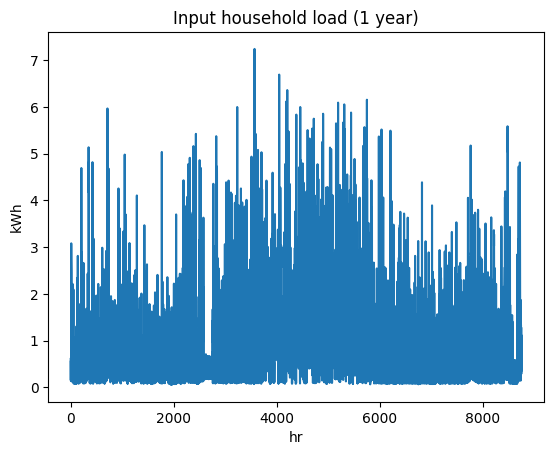

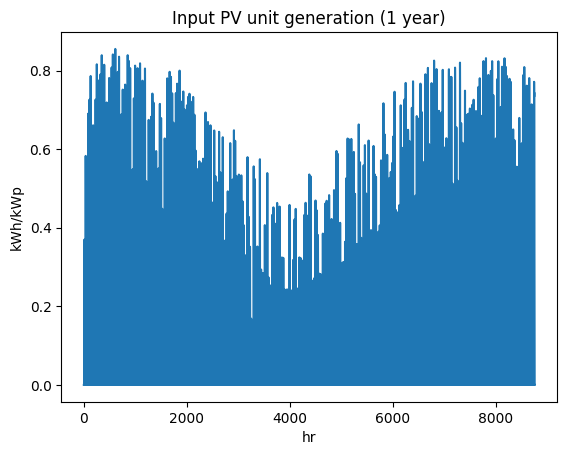

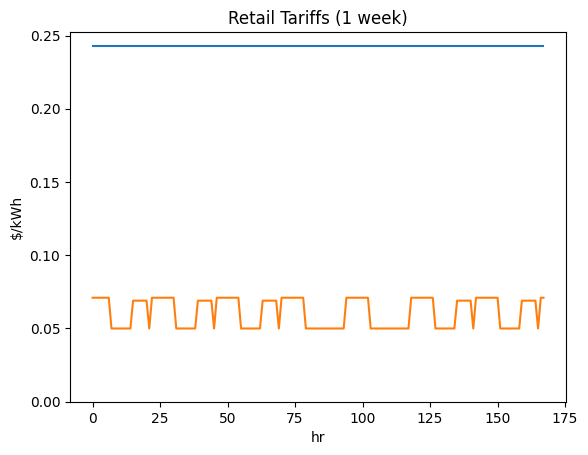

---- Optimising with PV: 1 - 20 kWp, Batt: 0 kWh. Determining PV capacity and dispatch.


************************************ Modell: PV > 1 kWp & BATT > 1 kWh ************************************
{'financial_horizon': 10, 'discount_rate': np.float64(0.06), 'grid_feedin_max': np.float64(5.0), 'pv_eol_capacity': np.float64(0.8), 'pv_eol_years': np.float64(25.0), 'pv_init_soh': np.float64(1.0), 'bess_e2p_ratio': np.float64(2.4), 'bess_roundtrip_eff': np.float64(0.88), 'bess_eol_years': np.float64(10.0), 'bess_eol_capacity': np.float64(0.7), 'bess_eol_cycles': np.float64(10000.0), 'bess_init_soh': np.float64(1.0), 'bess_eff_charge': np.float64(0.938083151964686), 'bess_eff_discharge': np.float64(0.938083151964686), 'scenario_name': 'Scenario_D_+5', 'scenario_set': 'SurfCoast', 'scenario_subset': 'JJP_open', 'year_start': 2022, 'datetime_name': 'DateTime1', 'meter_name': 'pc3079_nmi2139194277', 'solar_name': 'MELB', 'tariff_name_import_wkday': '3_Im_wkday', 'tariff_name_export_wkday': '3_

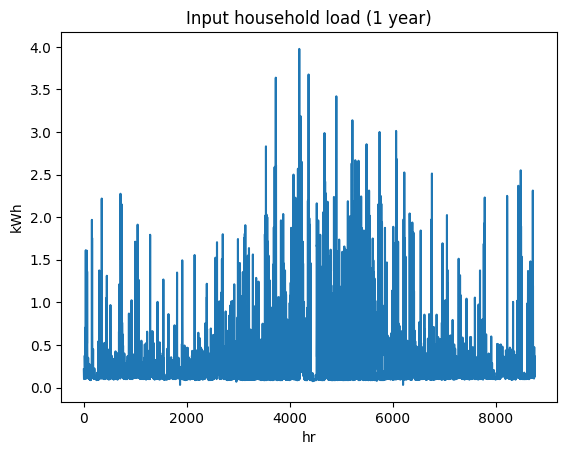

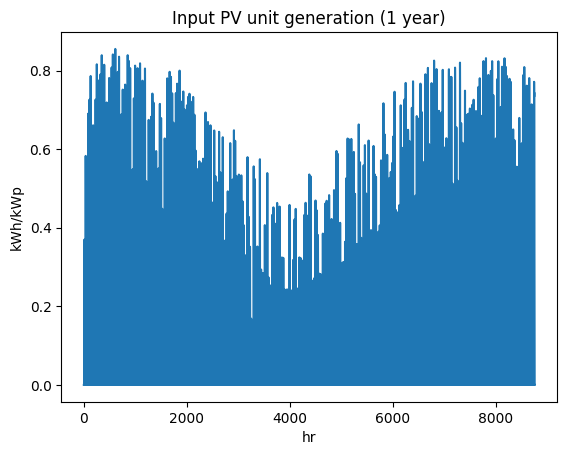

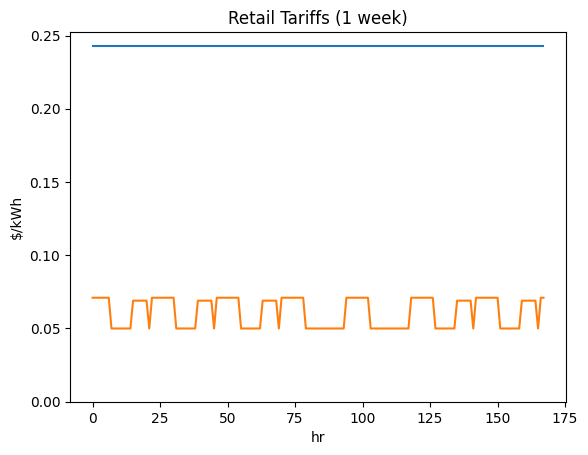

---- Optimising with PV: 1 - 20 kWp, Batt: 0 kWh. Determining PV capacity and dispatch.


************************************ Modell: PV > 1 kWp & BATT > 1 kWh ************************************
{'financial_horizon': 10, 'discount_rate': np.float64(0.06), 'grid_feedin_max': np.float64(5.0), 'pv_eol_capacity': np.float64(0.8), 'pv_eol_years': np.float64(25.0), 'pv_init_soh': np.float64(1.0), 'bess_e2p_ratio': np.float64(2.4), 'bess_roundtrip_eff': np.float64(0.88), 'bess_eol_years': np.float64(10.0), 'bess_eol_capacity': np.float64(0.7), 'bess_eol_cycles': np.float64(10000.0), 'bess_init_soh': np.float64(1.0), 'bess_eff_charge': np.float64(0.938083151964686), 'bess_eff_discharge': np.float64(0.938083151964686), 'scenario_name': 'Scenario_D_+5', 'scenario_set': 'SurfCoast', 'scenario_subset': 'JJP_open', 'year_start': 2022, 'datetime_name': 'DateTime1', 'meter_name': 'pc3081_nmi3718152582', 'solar_name': 'MELB', 'tariff_name_import_wkday': '3_Im_wkday', 'tariff_name_export_wkday': '3_

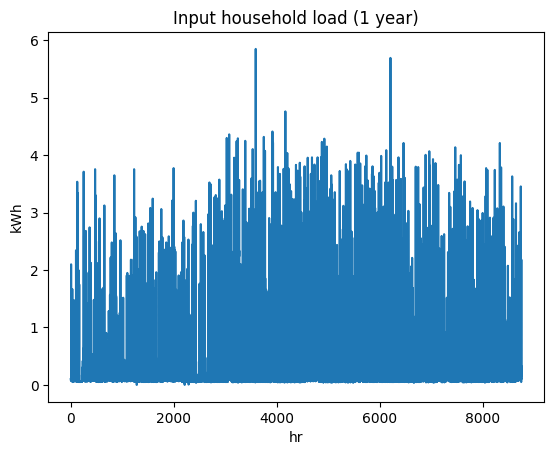

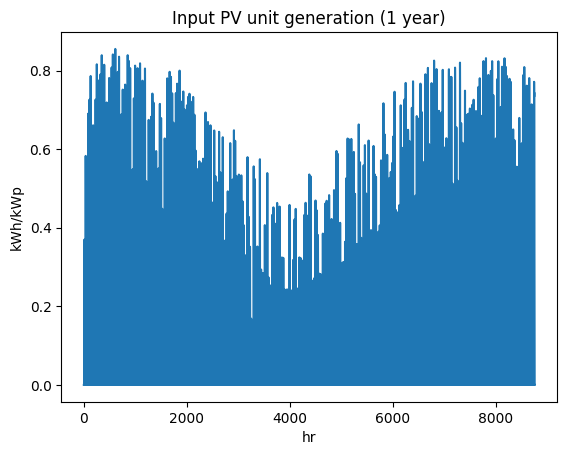

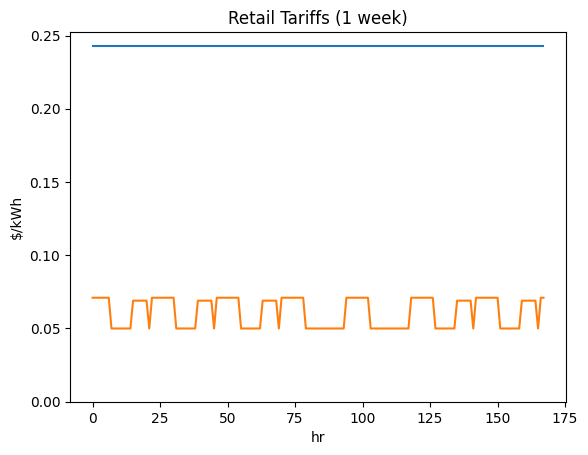

---- Optimising with PV: 1 - 20 kWp, Batt: 0 kWh. Determining PV capacity and dispatch.


************************************ Modell: PV > 1 kWp & BATT > 1 kWh ************************************
{'financial_horizon': 10, 'discount_rate': np.float64(0.06), 'grid_feedin_max': np.float64(5.0), 'pv_eol_capacity': np.float64(0.8), 'pv_eol_years': np.float64(25.0), 'pv_init_soh': np.float64(1.0), 'bess_e2p_ratio': np.float64(2.4), 'bess_roundtrip_eff': np.float64(0.88), 'bess_eol_years': np.float64(10.0), 'bess_eol_capacity': np.float64(0.7), 'bess_eol_cycles': np.float64(10000.0), 'bess_init_soh': np.float64(1.0), 'bess_eff_charge': np.float64(0.938083151964686), 'bess_eff_discharge': np.float64(0.938083151964686), 'scenario_name': 'Scenario_D_+5', 'scenario_set': 'SurfCoast', 'scenario_subset': 'JJP_open', 'year_start': 2022, 'datetime_name': 'DateTime1', 'meter_name': 'pc3072_nmi4146095429', 'solar_name': 'MELB', 'tariff_name_import_wkday': '3_Im_wkday', 'tariff_name_export_wkday': '3_

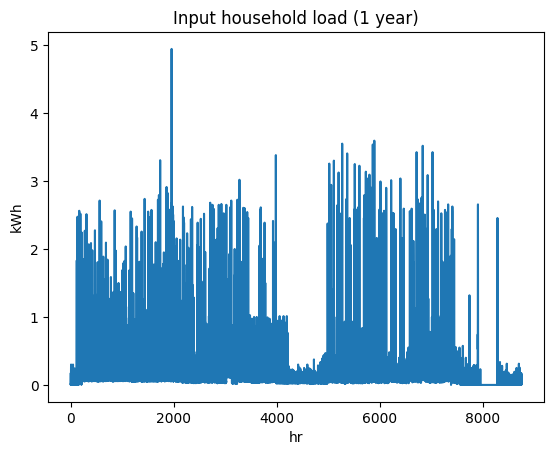

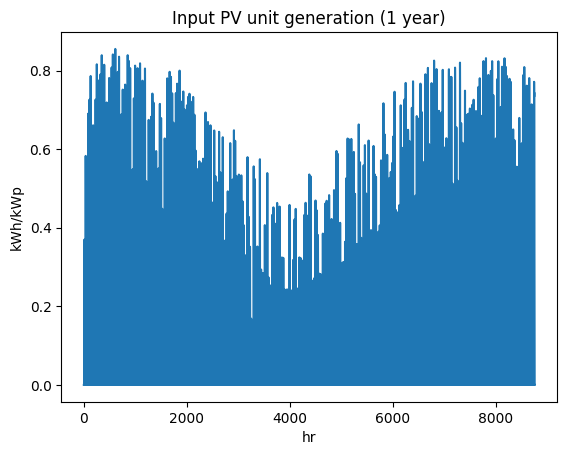

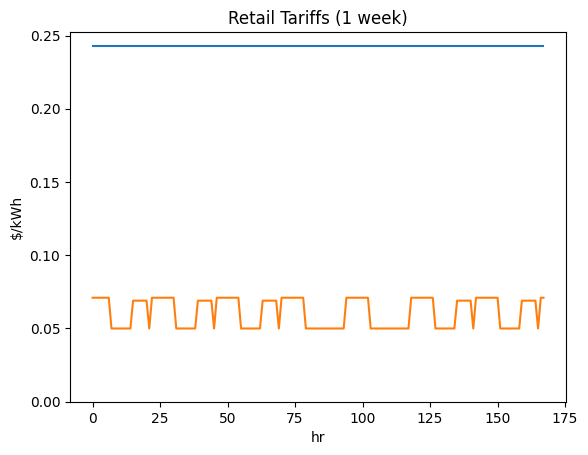

---- Optimising with PV: 1 - 20 kWp, Batt: 0 kWh. Determining PV capacity and dispatch.


************************************ Modell: PV > 1 kWp & BATT > 1 kWh ************************************
{'financial_horizon': 10, 'discount_rate': np.float64(0.06), 'grid_feedin_max': np.float64(5.0), 'pv_eol_capacity': np.float64(0.8), 'pv_eol_years': np.float64(25.0), 'pv_init_soh': np.float64(1.0), 'bess_e2p_ratio': np.float64(2.4), 'bess_roundtrip_eff': np.float64(0.88), 'bess_eol_years': np.float64(10.0), 'bess_eol_capacity': np.float64(0.7), 'bess_eol_cycles': np.float64(10000.0), 'bess_init_soh': np.float64(1.0), 'bess_eff_charge': np.float64(0.938083151964686), 'bess_eff_discharge': np.float64(0.938083151964686), 'scenario_name': 'Scenario_D_+5', 'scenario_set': 'SurfCoast', 'scenario_subset': 'JJP_open', 'year_start': 2022, 'datetime_name': 'DateTime1', 'meter_name': 'pc3058_nmi7077306930', 'solar_name': 'MELB', 'tariff_name_import_wkday': '3_Im_wkday', 'tariff_name_export_wkday': '3_

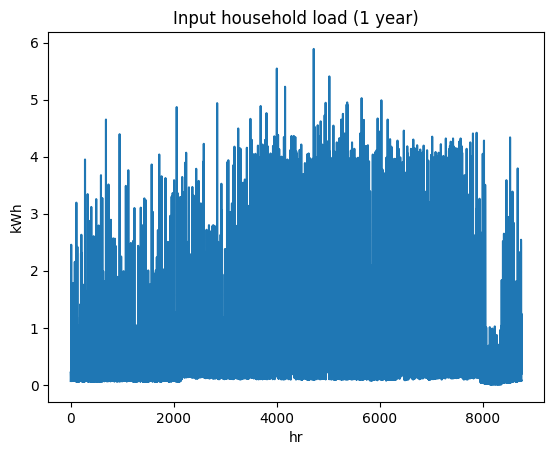

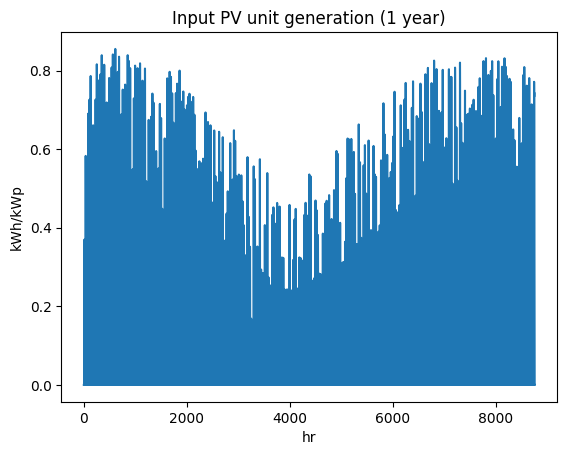

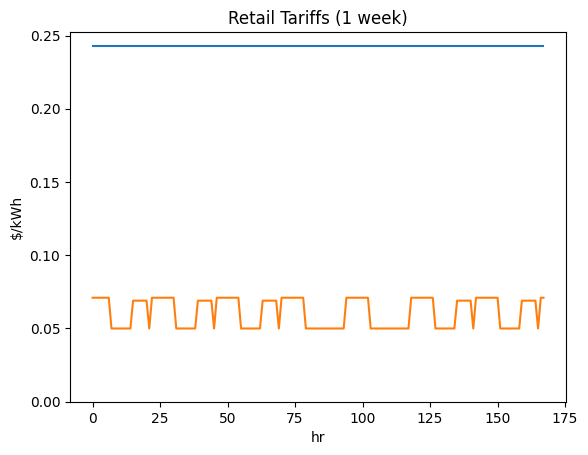

---- Optimising with PV: 1 - 20 kWp, Batt: 0 kWh. Determining PV capacity and dispatch.


************************************ Modell: PV > 1 kWp & BATT > 1 kWh ************************************
{'financial_horizon': 10, 'discount_rate': np.float64(0.06), 'grid_feedin_max': np.float64(5.0), 'pv_eol_capacity': np.float64(0.8), 'pv_eol_years': np.float64(25.0), 'pv_init_soh': np.float64(1.0), 'bess_e2p_ratio': np.float64(2.4), 'bess_roundtrip_eff': np.float64(0.88), 'bess_eol_years': np.float64(10.0), 'bess_eol_capacity': np.float64(0.7), 'bess_eol_cycles': np.float64(10000.0), 'bess_init_soh': np.float64(1.0), 'bess_eff_charge': np.float64(0.938083151964686), 'bess_eff_discharge': np.float64(0.938083151964686), 'scenario_name': 'Scenario_D_+5', 'scenario_set': 'SurfCoast', 'scenario_subset': 'JJP_open', 'year_start': 2022, 'datetime_name': 'DateTime1', 'meter_name': 'pc3031_nmi8264327732', 'solar_name': 'MELB', 'tariff_name_import_wkday': '3_Im_wkday', 'tariff_name_export_wkday': '3_

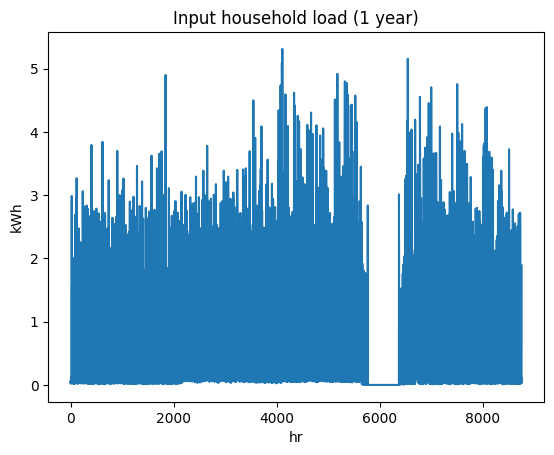

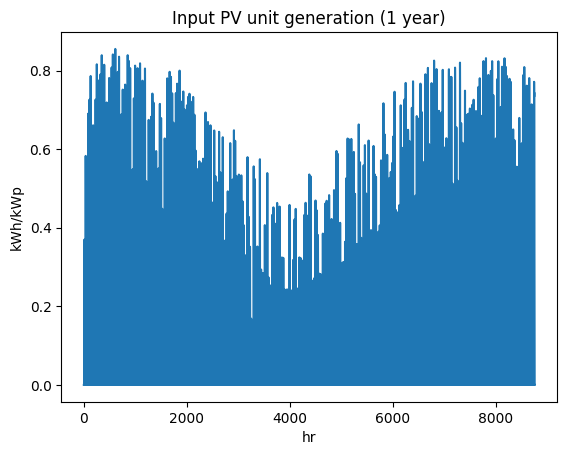

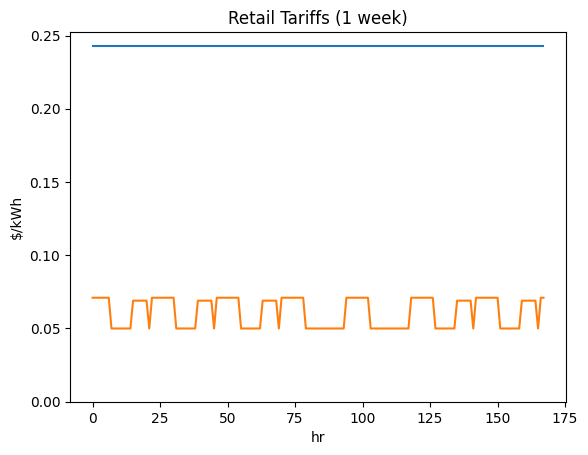

---- Optimising with PV: 1 - 20 kWp, Batt: 0 kWh. Determining PV capacity and dispatch.


************************************ Modell: PV > 1 kWp & BATT > 1 kWh ************************************
{'financial_horizon': 10, 'discount_rate': np.float64(0.06), 'grid_feedin_max': np.float64(5.0), 'pv_eol_capacity': np.float64(0.8), 'pv_eol_years': np.float64(25.0), 'pv_init_soh': np.float64(1.0), 'bess_e2p_ratio': np.float64(2.4), 'bess_roundtrip_eff': np.float64(0.88), 'bess_eol_years': np.float64(10.0), 'bess_eol_capacity': np.float64(0.7), 'bess_eol_cycles': np.float64(10000.0), 'bess_init_soh': np.float64(1.0), 'bess_eff_charge': np.float64(0.938083151964686), 'bess_eff_discharge': np.float64(0.938083151964686), 'scenario_name': 'Scenario_D_+5', 'scenario_set': 'SurfCoast', 'scenario_subset': 'JJP_open', 'year_start': 2022, 'datetime_name': 'DateTime1', 'meter_name': 'pc3032_nmi6403258433', 'solar_name': 'MELB', 'tariff_name_import_wkday': '3_Im_wkday', 'tariff_name_export_wkday': '3_

In [15]:
# %%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
# Start main function
#######################################################################################################################
#######################################################################################################################
#######################################################################################################################

# Setup the common static parameters of the analysis
print("Setup the common static parameters of the analysis")
PARAM = {}
l_attribute_names = df_xls_static_param.index.tolist()
for i in range(len(l_attribute_names)):
    if df_xls_static_param.at[l_attribute_names[i], 'Unit'] == '%':
        PARAM[l_attribute_names[i]] = df_xls_static_param.at[l_attribute_names[i], 'Value'] / 100
    else:
        PARAM[l_attribute_names[i]] = df_xls_static_param.at[l_attribute_names[i], 'Value']

GLOBAL_NAME = df_xls_scenarios_param.loc['scenario_set'].iloc[0]

# Save away all the exogenous parameters used: dataframes
print("Save away all the exogenous parameters used: dataframes")
shutil.copyfile(INPUT_FILE, OUTPUT_DIRECTORY + '/' + INPUT_FILE)

# Save the code used in the project run
print("Save the code used in the project run")

shutil.copyfile(NAME_IPYNB, OUTPUT_DIRECTORY + '/' + NAME_IPYNB)

# Setup output_log.txt
print("Setup output_log.txt")
f = open(output_log_path, "w+")
f.write("\n")
f.close()

# Record the time
time_run_start = time.time()

# Process each scenario
# =====================
print("Process scenario")
num_scenarios = len(df_xls_scenarios_param.columns)
scenario_index = 0

for scenario_index in range(num_scenarios):    # look at all scenarios
    
    df_overview_scenario = pd.DataFrame(columns=['Scenario', 'avg_NPV_$', 'avg_PV_nomCap_kWp', 'avg_Batt_nomCap_kWh', 'avg_Old_bill_discounted', 'avg_New_bill_discounted', 'avg_Upfront_cost'])
    df_sc_new_netloads = pd.DataFrame({})
    
    # Create the parameters for this scenario
    #print("Create the parameters for this scenario")
    SCENARIO_PARAM = PARAM.copy()
    SCENARIO_PARAM['scenario_name'] = df_xls_scenarios_param.columns[scenario_index]
    
    if SCENARIO_PARAM['scenario_name'] in SCENARIO_LIST:
        
        for i in range(len(df_xls_scenarios_param)):
            SCENARIO_PARAM[df_xls_scenarios_param.index[i]] = df_xls_scenarios_param.iat[i, scenario_index]
        SCENARIO_PARAM['financial_horizon'] = int(SCENARIO_PARAM['financial_horizon'])

        # Create the output directory for this scenario
        print("Create the output directory for this scenario")
        SCENARIO_DIRECTORY = OUTPUT_DIRECTORY + "/" + "{num:02d}".format(num = scenario_index) + "-" + SCENARIO_PARAM['scenario_name']
        path = os.path.join(SCENARIO_DIRECTORY)
        if rerun == False:
            os.makedirs(path, exist_ok=True)

        # Setup the annual timestamp used in the analysis based on the datetime column name.
        colname_datetime = SCENARIO_PARAM['datetime_name']
        num_timesteps = df_xls_datetime_ts[colname_datetime].count()
        v_timestamp = np.repeat(0, num_timesteps)
        l_datetime = [None] * num_timesteps
        for time_index in range(num_timesteps):
            v_timestamp[time_index] = int(df_xls_datetime_ts.at[time_index, colname_datetime].timestamp())
            l_datetime[time_index] = datetime.fromtimestamp(v_timestamp[time_index], tz=pytz.timezone('UTC'))
        time_step = v_timestamp[1] - v_timestamp[0]
        df_timestamp = pd.DataFrame({'Timestamp_begin':v_timestamp,
                                    'Datetime_begin':l_datetime,'Timestamp_end':v_timestamp+time_step})
        SCENARIO_PARAM['timestep_seconds'] = time_step
        BASELINE_YEAR = int(SCENARIO_PARAM['year_start'])

        # Obtain the solar PV generation profile (kWh/kWp timeseries)
        colname_solarprofile = SCENARIO_PARAM['solar_name']
        df_solar_profile = df_xls_solar_ts[colname_solarprofile]

        # Obtain the import and export tariffs for each hour
        colname_tariff_import_wkday = SCENARIO_PARAM['tariff_name_import_wkday']
        colname_tariff_export_wkday = SCENARIO_PARAM['tariff_name_export_wkday']
        colname_tariff_import_wkend = SCENARIO_PARAM['tariff_name_import_wkend']
        colname_tariff_export_wkend = SCENARIO_PARAM['tariff_name_export_wkend']

        # Adapt tariffs to weekdays

        timestamp_ref=df_timestamp['Timestamp_begin'][0:] #[0:8760]
        l_sdatetime = []
        l_weekday = []
        for t in range(len(timestamp_ref)):
            l_sdatetime.append(datetime.fromtimestamp(timestamp_ref[t], timezone.utc))
            l_weekday.append(l_sdatetime[-1].weekday())  # 0 = Mon, ...,  6 = Sun

        df_timeseries_data = pd.DataFrame({'sdatetime': l_sdatetime[0:], #[0:8760]
                                           'weekday': l_weekday[0:] #[0:8760]
                                           })
        # Populate the tariff structure
        l_import_tariff = []
        l_export_tariff = []

        for t in range(len(df_timeseries_data)):
            weekday = df_timeseries_data.at[t, 'weekday']
            if (weekday == 5) | (weekday == 6):
                l_import_tariff.append(df_xls_tariff_daily[colname_tariff_import_wkend].iat[t % 24])
                l_export_tariff.append(df_xls_tariff_daily[colname_tariff_export_wkend].iat[t % 24])
            else:
                l_import_tariff.append(df_xls_tariff_daily[colname_tariff_import_wkday].iat[t % 24])
                l_export_tariff.append(df_xls_tariff_daily[colname_tariff_export_wkday].iat[t % 24])
        exo_C_import = l_import_tariff
        exo_C_export = l_export_tariff
        v_tariff_import = l_import_tariff
        v_tariff_export = l_export_tariff
        v_overall_tariff_import=l_import_tariff
        v_overall_tariff_export=l_export_tariff

        df_tariffs = pd.DataFrame({'Import': v_tariff_import,
                                   'Export': v_tariff_export})

        # Define the annual tariff adjustments        
        scaling_factor_tariff = SCENARIO_PARAM['scaling_tariff']
        df_scalingfactors = pd.DataFrame(index = range(BASELINE_YEAR, BASELINE_YEAR+SCENARIO_PARAM['financial_horizon']), columns = ['Tariff_Import', 'Tariff_Export'])
        for i in range(BASELINE_YEAR, BASELINE_YEAR+SCENARIO_PARAM['financial_horizon']):
            df_scalingfactors.loc[i]['Tariff_Import'] = (1+scaling_factor_tariff)**(i-BASELINE_YEAR)
            df_scalingfactors.loc[i]['Tariff_Export'] = (1-scaling_factor_tariff)**(i-BASELINE_YEAR)

        # Log output
        time_scenario_start = time.time()
        localtime = reference.LocalTimezone()
        now = datetime.now()

        
        # Process the meter data
        # ----------------------
        # Declare constants
        timestep_seconds = SCENARIO_PARAM['timestep_seconds']
        convert_energy_to_power = int(SECONDS_PER_HOUR / timestep_seconds)
        convert_power_to_energy = 1 / convert_energy_to_power
        num_annual_steps = int(HOURS_PER_YEAR * SECONDS_PER_HOUR / timestep_seconds)
        ZERO_BAND = 1E-3 # Avoiding floating point arithmatic errors

        # Obtain the meter profile (kWh timeseries)
        df_meter_ts_colnames = df_xls_meter_ts.columns
        #df_overview_households = pd.DataFrame(columns=['household', 'NPV_$', 'PV_nomCap_kWp', 'Batt_nomCap_kWh', 'Old_bill_discounted', 'New_bill_discounted', 'Upfront_cost'])
        col_names = ['household', 'NPV_$', 'PV_nomCap_kWp', 'Batt_nomCap_kWh', 'Old_bill_discounted', 'New_bill_discounted', 'Upfront_cost']
        name_csv_hh_overview_te = SCENARIO_DIRECTORY + "/df_" + str(SCENARIO_PARAM['scenario_name']) + "_overview_hh_" + str(hh_no_min) + "_" + str(hh_no_max) + "_tech_econ.csv"
        name_csv_hh_overview_nn = SCENARIO_DIRECTORY + "/df_" + str(SCENARIO_PARAM['scenario_name']) + "_overview_hh_" + str(hh_no_min) + "_" + str(hh_no_max) + "_new_netloads.csv"
        #df_hh_new_netloads = pd.DataFrame({})

        # -----------------------------------------------------------------------------------------------------------------
        hh_no = 1
        for col in df_meter_ts_colnames:
            if (hh_no_min <= hh_no) and (hh_no <= hh_no_max):
                df_load_profile = df_xls_meter_ts[col]
                SCENARIO_PARAM["meter_name"]=col

                logMessage("=====================================================\n" +
                           "Start optimization - household: " + str(hh_no) + "/100 of " +
                           SCENARIO_PARAM['scenario_name'] + " - profile: " + str(col) + " (" + s_time_postfix + ")\n" +
                           "=====================================================\n" +
                           "Scenario parameters\n" , OUTPUT_DIRECTORY)
                logMessage(SCENARIO_PARAM, OUTPUT_DIRECTORY)

                HOUSEHOLD_DIRECTORY = SCENARIO_DIRECTORY + "/" + '{0:03}'.format(hh_no) + "-" + SCENARIO_PARAM['meter_name']
                path_hh = os.path.join(HOUSEHOLD_DIRECTORY)
                os.makedirs(path_hh, exist_ok=True)

                # Save away all the exogenous parameters used: specifications and scenario parameters
                f = open(HOUSEHOLD_DIRECTORY + "/inputs_" + str(col) + ".txt", "w+")
                f.write("SCENARIO:      " + str(SCENARIO_PARAM['scenario_name']) + "\n")
                f.write("BASELINE_YEAR: " + str(BASELINE_YEAR) + "\n\n")
                f.write(str(SCENARIO_PARAM) + "\n\n")
                f.close()

                # Check that the input data is valid (timestamps, load, pv generation, tariffs)
                v_input_annual_load_kwh = np.asarray(df_load_profile.tolist(), dtype=float)
                v_input_annual_unitgeneration_kwh = np.asarray(df_solar_profile.tolist(), dtype=float)
                v_input_annual_timestamp = np.asarray(df_timestamp['Timestamp_begin'].tolist())
                v_input_annual_tariff_import = np.asarray(df_tariffs['Import'].tolist(), dtype=float)
                v_input_annual_tariff_export = np.asarray(df_tariffs['Export'].tolist(), dtype=float)

                data_is_valid = len(v_input_annual_load_kwh) == num_annual_steps & \
                                len(v_input_annual_unitgeneration_kwh) == num_annual_steps & \
                                len(v_input_annual_timestamp) == num_annual_steps
                if not data_is_valid:
                    logMessage("ERROR: Input data is invalid. Scenario analysis halted!", OUTPUT_DIRECTORY)
                else:

                    # Initialise the household load and generation profile, along with the applicable tariffs
                    financial_horizon = SCENARIO_PARAM['financial_horizon']
                    v_overall_netload_kwh = np.tile(v_input_annual_load_kwh, financial_horizon)
                    v_overall_pvunitgeneration_kwh = np.tile(v_input_annual_unitgeneration_kwh, financial_horizon)
                    v_overall_tariff_export = np.tile(v_input_annual_tariff_export, financial_horizon)
                    v_overall_tariff_import = np.tile(v_input_annual_tariff_import, financial_horizon)
                    
                for i in range(financial_horizon):
                    year_start = int(i * HOURS_PER_YEAR * SECONDS_PER_HOUR / timestep_seconds)
                    year_next = int((i+1) * HOURS_PER_YEAR * SECONDS_PER_HOUR / timestep_seconds)

                    v_overall_tariff_import[year_start:year_next] = [element_im * float(df_scalingfactors.at[i+BASELINE_YEAR,'Tariff_Import']) for element_im in v_overall_tariff_import[year_start:year_next]]
                    v_overall_tariff_export[year_start:year_next] = [element_ex * float(df_scalingfactors.at[i+BASELINE_YEAR,'Tariff_Export']) for element_ex in v_overall_tariff_export[year_start:year_next]]
                
                print(v_overall_tariff_import )
                #Save the outputs
                plot(v_input_annual_load_kwh, "Input household load (1 year)", "hr", "kWh", HOUSEHOLD_DIRECTORY + "/plt_input_annual_load_" + str(col) + ".png")
                plot(v_input_annual_unitgeneration_kwh, "Input PV unit generation (1 year)", "hr", "kWh/kWp", HOUSEHOLD_DIRECTORY + "/plt_input_annual_unitpvgen_kwh_" + str(col) +".png")
                plot2(v_input_annual_tariff_import[0:24*7], v_input_annual_tariff_export[0:24*7], "Retail Tariffs (1 week)","hr", "$/kWh", ["import", "export"], HOUSEHOLD_DIRECTORY + "/plt_input_oneweek_tariff_" + str(col) + ".png")

                pv_min_capacity_kWp = SCENARIO_PARAM['pv_min_capacity']
                pv_max_capacity_kWp = SCENARIO_PARAM['pv_max_capacity']
                batt_min_capacity_kWh = SCENARIO_PARAM['bess_min_capacity']
                batt_max_capacity_kWh = SCENARIO_PARAM['bess_max_capacity']

                b_capexpansion_pv = True
                b_capexpansion_batt = True

                if pv_min_capacity_kWp == pv_max_capacity_kWp:
                    str_pvmsg = str(pv_max_capacity_kWp)
                    b_capexpansion_pv = False
                else:
                    str_pvmsg = "{min} - {max}".format(min = pv_min_capacity_kWp, max = pv_max_capacity_kWp)

                if batt_min_capacity_kWh == batt_max_capacity_kWh:
                    str_battmsg = str(batt_min_capacity_kWh)
                    b_capexpansion_batt = False
                else:
                    str_battmsg = "{min} - {max}".format(min = batt_min_capacity_kWh, max = batt_max_capacity_kWh)

                if b_capexpansion_pv and not b_capexpansion_batt:
                    str_optimisation = "Determining PV capacity and dispatch."
                elif not b_capexpansion_pv and b_capexpansion_pv:
                    str_optimisation = "Determining battery capacity and dispatch."
                elif b_capexpansion_pv and b_capexpansion_pv:
                    str_optimisation = "Determining PV + battery capacity and dispatch."
                else:
                    str_optimisation = "Determining dispatch only."

                logMessage("---- Optimising with PV: {pv} kWp, Batt: {batt} kWh. {type}\n".format(pv = str_pvmsg, batt = str_battmsg, type = str_optimisation), OUTPUT_DIRECTORY)

                time_optimisePVBdispatch_start = time.time()


                df_opt_exogenous_timeseries = pd.DataFrame(index = range(len(v_overall_netload_kwh)),
                                                columns = [
                                                    't',
                                                    'E_netload_kWh',
                                                    'E_pvunitgeneration_kWh',
                                                    'C_tariff_import_$/kWh',
                                                    'C_tariff_export_$/kWh',
                                                ])

                df_opt_exogenous_timeseries['t'] = np.tile(df_timestamp['Datetime_begin'], SCENARIO_PARAM['financial_horizon'])
                df_opt_exogenous_timeseries['E_netload_kWh'] = v_overall_netload_kwh
                df_opt_exogenous_timeseries['E_pvunitgeneration_kWh'] = v_overall_pvunitgeneration_kwh
                df_opt_exogenous_timeseries['C_tariff_import_$/kWh'] = v_overall_tariff_import
                df_opt_exogenous_timeseries['C_tariff_export_$/kWh'] = v_overall_tariff_export

                i_static_param = SCENARIO_PARAM.copy()
                i_static_param_original = i_static_param.copy()
                i_show_output = True

                ################################################ Run model ################################################:
                if dimensioning == True:
                    for PV in [0,1]:
                        for BATT in [0,1]:
                            i_static_param = i_static_param_original.copy()
                            if (PV == 0) and (BATT == 0):
                                print("\n************************************ Modell: PV = 0 kWp & BATT = 0 kWh ************************************")
                                time_run_start = time.time()

                                i_static_param['pv_min_capacity'] = 0
                                i_static_param['pv_max_capacity'] = 0
                                i_static_param['bess_min_capacity'] = 0
                                i_static_param['bess_max_capacity'] = 0

                                print("i_static_param_original")
                                print(i_static_param_original)
                                print("i_static_param")
                                print(i_static_param)

                                [df_dispatch_pvb_0_0, outputs_0_0] = optimisePVB_capacity_dispatch(df_opt_exogenous_timeseries, i_static_param, i_show_output)
                                time_run_end = time.time()

                                print("Run for PV = " + str(PV) + " and BATT " + str(BATT) +" took: " + str(round(time_run_end - time_run_start, 2)) + " seconds.")

                            elif (PV == 1) and (BATT == 0):
                                print("\n************************************ Modell: PV > 1 kWp & BATT = 0 kWh ************************************")
                                time_run_start = time.time()

                                i_static_param['bess_min_capacity'] = 0
                                i_static_param['bess_max_capacity'] = 0

                                print(i_static_param)

                                [df_dispatch_pvb_1_0, outputs_1_0] = optimisePVB_capacity_dispatch(df_opt_exogenous_timeseries, i_static_param, i_show_output)
                                time_run_end = time.time()
                                print("Run for PV = " + str(PV) + " and BATT " + str(BATT) +" took: " + str(round(time_run_end - time_run_start, 2)) + " seconds.")

                            elif (PV == 0) and (BATT == 1):
                                print("\n************************************ Modell: PV = 0 kWp & BATT > 1 kWh ************************************")
                                time_run_start = time.time()

                                i_static_param['pv_min_capacity'] = 0
                                i_static_param['pv_max_capacity'] = 0

                                print(i_static_param)

                                [df_dispatch_pvb_0_1, outputs_0_1] = optimisePVB_capacity_dispatch(df_opt_exogenous_timeseries, i_static_param, i_show_output)

                                time_run_end = time.time()
                                print("Run for PV = " + str(PV) + " and BATT " + str(BATT) +" took: " + str(round(time_run_end - time_run_start, 2)) + " seconds.")

                            else: 
                                print("\n************************************ Modell: PV > 1 kWp & BATT > 1 kWh ************************************")
                                time_run_start = time.time()

                                if no_sol_found == True:                            
                                    i_static_param['pv_min_capacity'] = 1
                                    i_static_param['pv_max_capacity'] = 21
                                    i_static_param['bess_min_capacity'] = 3
                                    i_static_param['bess_max_capacity'] = 21

                                print(i_static_param)
                                [df_dispatch_pvb_1_1, outputs_1_1] = optimisePVB_capacity_dispatch(df_opt_exogenous_timeseries, i_static_param, i_show_output)
                                time_run_end = time.time()
                                print("Run for PV = " + str(PV) + " and BATT " + str(BATT) +" took: " + str(round(time_run_end - time_run_start, 2)) + " seconds.")
                
                else: 
                    print("\n************************************ Modell: PV > 1 kWp & BATT > 1 kWh ************************************")
                    time_run_start = time.time()

                    if no_sol_found == True:                            
                        i_static_param['pv_min_capacity'] = 1
                        i_static_param['pv_max_capacity'] = 21
                        i_static_param['bess_min_capacity'] = 3
                        i_static_param['bess_max_capacity'] = 21

                    print(i_static_param)
                    [df_dispatch_pvb_1_1, outputs_1_1] = optimisePVB_capacity_dispatch(df_opt_exogenous_timeseries, i_static_param, i_show_output)
                    time_run_end = time.time()
                    print("Run took: " + str(round(time_run_end - time_run_start, 2)) + " seconds.")
                    

                #[df_dispatch_pvb, outputs] = optimisePVB_capacity_dispatch(df_opt_exogenous_timeseries, i_static_param, i_show_output)
                
                if dimensioning == True:
                    if (outputs_0_0['NPV'] >= outputs_1_0['NPV']) and (outputs_0_0['NPV'] >= outputs_0_1['NPV']) and (outputs_0_0['NPV'] >= outputs_1_1['NPV']):
                        outputs = outputs_0_0
                        df_dispatch_pvb = df_dispatch_pvb_0_0
                    elif (outputs_1_0['NPV'] >= outputs_0_0['NPV']) and (outputs_1_0['NPV'] >= outputs_0_1['NPV']) and (outputs_1_0['NPV'] >= outputs_1_1['NPV']):
                        outputs = outputs_1_0
                        df_dispatch_pvb = df_dispatch_pvb_1_0
                    elif (outputs_0_1['NPV'] >= outputs_0_0['NPV']) and (outputs_0_1['NPV'] >= outputs_1_0['NPV']) and (outputs_0_1['NPV'] >= outputs_1_1['NPV']):
                        outputs = outputs_0_1
                        df_dispatch_pvb = df_dispatch_pvb_0_1
                    elif (outputs_1_1['NPV'] >= outputs_0_0['NPV']) and (outputs_1_1['NPV'] >= outputs_1_0['NPV']) and (outputs_1_1['NPV'] >= outputs_0_1['NPV']):
                        outputs = outputs_1_1
                        df_dispatch_pvb = df_dispatch_pvb_1_1
                    else:
                        print("ERROR")
                else:
                    outputs = outputs_1_1
                    df_dispatch_pvb = df_dispatch_pvb_1_1
                        
                time_optimisePVBdispatch_end = time.time()
                time_optimisePVBdispatch_str = str(round(time_optimisePVBdispatch_end - time_optimisePVBdispatch_start, 2)) + " seconds | " + str(round((time_optimisePVBdispatch_end - time_optimisePVBdispatch_start)/60, 2)) + " minutes | " +  str(round((time_optimisePVBdispatch_end - time_optimisePVBdispatch_start)/3600, 2)) + " hours"
                logMessage("---- optimisePVB_capacity_dispatch() completed in " + time_optimisePVBdispatch_str + " \n", OUTPUT_DIRECTORY)

                if not np.isnan(outputs['NPV']):

                    # Update the household's residual load (internal residual load includes curtailed energy)
                    v_overall_netload_kWh = df_dispatch_pvb.E_residual_netload - df_dispatch_pvb.E_residual_curtail
                    pv_cap_end_soh = df_dispatch_pvb.P_pv_cap_soh[len(df_dispatch_pvb)-1]
                    batt_cap_end_soh = df_dispatch_pvb.E_batt_soh[len(df_dispatch_pvb)-1]

                    PV_nomcap = outputs['P_pv_nomcapacity_kWp']
                    Batt_nomCap = outputs['E_batt_nomcapacity_kWh']

                    # Save the output data
                    df_dispatch_pvb.to_csv(HOUSEHOLD_DIRECTORY + "/df_dispatch_pvb_" + str(col) + ".csv")

                else:
                    logMessage("Solution not found\n", OUTPUT_DIRECTORY)

                new_row = {'household': col, 'NPV_$': outputs['NPV'], 'PV_nomCap_kWp': outputs['P_pv_nomcapacity_kWp'], 'Batt_nomCap_kWh': outputs['E_batt_nomcapacity_kWh'], 'Old_bill_discounted': outputs['Baseline_bill'], 'New_bill_discounted': outputs['Optimised_bill'], 'Upfront_cost': outputs['Upfront_cost']}

                
                # ============== Write to CSV =============
                if hh_no == hh_no_min:
                    with open(name_csv_hh_overview_te, 'w') as file:
                        dw = csv.DictWriter(file, delimiter=',', fieldnames=col_names)
                        dw.writeheader()
                        dict_object = csv.DictWriter(file, fieldnames=col_names) 
                        dict_object.writerow(new_row)

                    
                else:
                    with open(name_csv_hh_overview_te, 'a') as file:
                        dict_object = csv.DictWriter(file, fieldnames=col_names) 
                        dict_object.writerow(new_row)

                
                # ============== End writing to CSV =============
                        
                        
                # Log the scenario completion
                # ---------------------------
                time_scenario_end = time.time()
                str_final_time_msg = ("Scenario run in total took " + str(round(time_scenario_end - time_scenario_start, 2)) + " seconds, or\n" + str(round((time_scenario_end - time_scenario_start)/SECONDS_PER_MINUTE, 2)) + " minutes | " +str(round((time_scenario_end - time_scenario_start)/SECONDS_PER_HOUR, 2)) + " hours\n")
                logMessage("#####################################################\n" + str_final_time_msg + "#####################################################\n", OUTPUT_DIRECTORY)
            hh_no += 1
                # END IF data_is_valid

# Log the run completion
print("Log the run completion")
# ----------------------
time_run_end = time.time()
str_final_time_msg = ("Total run took " + str(round(time_run_end - time_run_start, 2)) + " seconds, or\n" + str(round((time_run_end - time_run_start)/SECONDS_PER_MINUTE, 2)) + " minutes | " + str(round((time_run_end - time_run_start)/SECONDS_PER_HOUR, 2)) + " hours\n")
logMessage("#####################################################\n" + str_final_time_msg + "#####################################################\n",OUTPUT_DIRECTORY)

In [ ]:
SCENARIO_LIST = ["Proof"]  # Add your actual scenario name

In [ ]:
print("SCENARIO_LIST:", SCENARIO_LIST)
print("Scenario name:", SCENARIO_PARAM['scenario_name'])
print("Scenario in list?", SCENARIO_PARAM['scenario_name'] in SCENARIO_LIST)

In [ ]:
df_hh_new_netloads = pd.DataFrame({})
#SCENARIO_DIRECTORY = "Results/230324_0614-Scenario_A_100/00-Scenario_A_100"
sc_name = SCENARIO_DIRECTORY.split("Scenario_")[1][:str(SCENARIO_DIRECTORY.split("Scenario_")[1]).index("/")]
name_csv_hh_overview_nn = SCENARIO_DIRECTORY + "/df_Scenario_" + str(sc_name) + "_overview_hh_" + str(hh_no_min) + "_" + str(hh_no_max) + "_new_netloads.csv"
files = os.listdir(SCENARIO_DIRECTORY) #all files in hh-directory
files.sort()
for file in files:
    if 'pc' in file:
        full_path_results = SCENARIO_DIRECTORY + "/" + file
        res_file = os.listdir(full_path_results)
        for result in res_file:
            if ".csv" in result:
                full_path_hh_dispatch_pvb = full_path_results+"/"+result
                df_dispatch_pvb = pd.read_csv(full_path_hh_dispatch_pvb)
                hh_name = full_path_hh_dispatch_pvb.split("dispatch_")[1][:str(full_path_hh_dispatch_pvb.split("dispatch_")[1]).index(".csv")]
                v_overall_netload_kwh = df_dispatch_pvb['E_residual_netload'] - df_dispatch_pvb['E_residual_curtail']
                df_hh_new_netloads[hh_name] = v_overall_netload_kwh
df_hh_new_netloads.to_csv(name_csv_hh_overview_nn)

/tmp/ipykernel_2564105/1241675321.py:17: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  df_hh_new_netloads[hh_name] = v_overall_netload_kwh
/tmp/ipykernel_2564105/1241675321.py:17: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  df_hh_new_netloads[hh_name] = v_overall_netload_kwh
/tmp/ipykernel_2564105/1241675321.py:17: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead